In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()
gpu_devices = tf.config.experimental.list_physical_devices("GPU")
for device in gpu_devices:
    tf.config.experimental.set_memory_growth(device, True)

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

xtrain_file = "xtrain.csv"
ytrain_file = "ytrain.csv"
xval_file = "xval.csv"
yval_file = "yval.csv"
xtest_file = "xtest.csv"
ytest_file = "ytest.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
# fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

xtrain = pd.read_csv(xtrain_file, index_col=False)
ytrain = pd.read_csv(ytrain_file, index_col=False)
xval = pd.read_csv(xval_file, index_col=False)
yval = pd.read_csv(yval_file, index_col=False)
xtest = pd.read_csv(xtest_file, index_col=False)
ytest = pd.read_csv(ytest_file, index_col=False)

In [8]:
#Load Hyperparameters Obtained by BayesOpt

matlab_file = 'P2_3.mat'
mat = spio.loadmat(matlab_file, squeeze_me=True)
lr = mat['lr']
ep = mat['ep']
epochs = mat['epochs']
batch = mat['batch']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [9]:
#Xtrain to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,4)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain = ytrain.to_numpy()
ytrain = ytrain.reshape(278,24,1)

In [11]:
#Xval to Numpy multidimensional array

xval = xval.to_numpy()
xval = xval.reshape(34,24,4)

In [12]:
#Yval to Numpy multidimensional array

yval = yval.to_numpy()
yval = yval.reshape(34,24,1)

In [13]:
#Xtest to Numpy multidimensional array

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,4)

In [14]:
#Ground truth to Numpy multidimensional array

ytest = ytest.to_numpy()
ytest = ytest.reshape(34,24,1)

In [15]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros((278,1))
for i in range(278):
    ytrain2[i] =  ytrain[i][0]
    
ytrain2=ytrain2.reshape(278,)

In [16]:
#Yval2 to Numpy multidimensional array - for SHAP

yval2 = np.zeros((34,1))
for i in range(34):
    yval2[i] =  yval[i][0]
    
yval2 =yval2.reshape(34,)

In [17]:
#Set ytrain, yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [18]:
import sklearn
import math
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display
from sklearn import metrics

In [19]:
#Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

# Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [20]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)


model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 24, 4)]      0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 24, 626)      1580024     input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 24, 365)      228855      lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 24, 2)        732         dense[0][0]                      
_______________________________________________________________________________________

In [21]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Real Gas Turbine/LSTM-P2_2/model checkpoint/P2_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [22]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [23]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [24]:
# Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 50103724.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00002: val_loss improved from 50103724.00000 to 36448352.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00003: val_loss improved from 36448352.00000 to 32986706.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00004: val_loss improved from 32986706.00000 to 31550844.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00005: val_loss improved from 31550844.00000 to 30867036.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model 


Epoch 00074: val_loss did not improve from 7870063.00000

Epoch 00075: val_loss improved from 7870063.00000 to 6436519.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00076: val_loss improved from 6436519.00000 to 5113183.00000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00077: val_loss did not improve from 5113183.00000

Epoch 00078: val_loss did not improve from 5113183.00000

Epoch 00079: val_loss improved from 5113183.00000 to 4689666.50000, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00080: val_loss did not improve from 4689666.50000

Epoch 00081: val_loss did not improve from 4689666.50000

Epoch 00082: val_loss did not improve from 4689666.50000

Epoch 00083: val_loss did not improve from 4689666.50000

Epoch 00084: val_loss did not improve from 4689666


Epoch 00180: val_loss did not improve from 953966.25000

Epoch 00181: val_loss did not improve from 953966.25000

Epoch 00182: val_loss did not improve from 953966.25000

Epoch 00183: val_loss improved from 953966.25000 to 946556.43750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00184: val_loss did not improve from 946556.43750

Epoch 00185: val_loss did not improve from 946556.43750

Epoch 00186: val_loss did not improve from 946556.43750

Epoch 00187: val_loss did not improve from 946556.43750

Epoch 00188: val_loss did not improve from 946556.43750

Epoch 00189: val_loss did not improve from 946556.43750

Epoch 00190: val_loss did not improve from 946556.43750

Epoch 00191: val_loss did not improve from 946556.43750

Epoch 00192: val_loss did not improve from 946556.43750

Epoch 00193: val_loss improved from 946556.43750 to 939158.12500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS


Epoch 00297: val_loss improved from 821528.87500 to 788070.12500, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00298: val_loss did not improve from 788070.12500

Epoch 00299: val_loss did not improve from 788070.12500

Epoch 00300: val_loss did not improve from 788070.12500

Epoch 00301: val_loss did not improve from 788070.12500

Epoch 00302: val_loss did not improve from 788070.12500

Epoch 00303: val_loss did not improve from 788070.12500

Epoch 00304: val_loss did not improve from 788070.12500

Epoch 00305: val_loss did not improve from 788070.12500

Epoch 00306: val_loss improved from 788070.12500 to 779433.06250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00307: val_loss did not improve from 779433.06250

Epoch 00308: val_loss did not improve from 779433.06250

Epoch 00309: val_loss did not improve from 779433.06250

Epoch 00310: v


Epoch 00398: val_loss did not improve from 642913.12500

Epoch 00399: val_loss did not improve from 642913.12500

Epoch 00400: val_loss did not improve from 642913.12500

Epoch 00401: val_loss did not improve from 642913.12500

Epoch 00402: val_loss did not improve from 642913.12500

Epoch 00403: val_loss improved from 642913.12500 to 633081.93750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00404: val_loss did not improve from 633081.93750

Epoch 00405: val_loss did not improve from 633081.93750

Epoch 00406: val_loss did not improve from 633081.93750

Epoch 00407: val_loss did not improve from 633081.93750

Epoch 00408: val_loss did not improve from 633081.93750

Epoch 00409: val_loss did not improve from 633081.93750

Epoch 00410: val_loss did not improve from 633081.93750

Epoch 00411: val_loss did not improve from 633081.93750

Epoch 00412: val_loss did not improve from 633081.93750

Epoch 00413: val_loss 


Epoch 00514: val_loss did not improve from 478375.81250

Epoch 00515: val_loss improved from 478375.81250 to 469222.18750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00516: val_loss did not improve from 469222.18750

Epoch 00517: val_loss did not improve from 469222.18750

Epoch 00518: val_loss did not improve from 469222.18750

Epoch 00519: val_loss did not improve from 469222.18750

Epoch 00520: val_loss did not improve from 469222.18750

Epoch 00521: val_loss did not improve from 469222.18750

Epoch 00522: val_loss improved from 469222.18750 to 461462.09375, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00523: val_loss did not improve from 461462.09375

Epoch 00524: val_loss did not improve from 461462.09375

Epoch 00525: val_loss did not improve from 461462.09375

Epoch 00526: val_loss did not improve from 461462.09375

Epoch 00527: v


Epoch 00618: val_loss improved from 333948.12500 to 331844.68750, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00619: val_loss did not improve from 331844.68750

Epoch 00620: val_loss did not improve from 331844.68750

Epoch 00621: val_loss did not improve from 331844.68750

Epoch 00622: val_loss did not improve from 331844.68750

Epoch 00623: val_loss did not improve from 331844.68750

Epoch 00624: val_loss did not improve from 331844.68750

Epoch 00625: val_loss did not improve from 331844.68750

Epoch 00626: val_loss did not improve from 331844.68750

Epoch 00627: val_loss did not improve from 331844.68750

Epoch 00628: val_loss did not improve from 331844.68750

Epoch 00629: val_loss did not improve from 331844.68750

Epoch 00630: val_loss did not improve from 331844.68750

Epoch 00631: val_loss did not improve from 331844.68750

Epoch 00632: val_loss did not improve from 331844.68750

Epoch 00633: val_loss 


Epoch 00730: val_loss did not improve from 205952.78125

Epoch 00731: val_loss did not improve from 205952.78125

Epoch 00732: val_loss did not improve from 205952.78125

Epoch 00733: val_loss did not improve from 205952.78125

Epoch 00734: val_loss did not improve from 205952.78125

Epoch 00735: val_loss did not improve from 205952.78125

Epoch 00736: val_loss did not improve from 205952.78125

Epoch 00737: val_loss did not improve from 205952.78125

Epoch 00738: val_loss did not improve from 205952.78125

Epoch 00739: val_loss did not improve from 205952.78125

Epoch 00740: val_loss did not improve from 205952.78125

Epoch 00741: val_loss did not improve from 205952.78125

Epoch 00742: val_loss did not improve from 205952.78125

Epoch 00743: val_loss did not improve from 205952.78125

Epoch 00744: val_loss did not improve from 205952.78125

Epoch 00745: val_loss improved from 205952.78125 to 190004.31250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New fol


Epoch 00847: val_loss did not improve from 93749.52344

Epoch 00848: val_loss did not improve from 93749.52344

Epoch 00849: val_loss did not improve from 93749.52344

Epoch 00850: val_loss did not improve from 93749.52344

Epoch 00851: val_loss improved from 93749.52344 to 92502.31250, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00852: val_loss did not improve from 92502.31250

Epoch 00853: val_loss did not improve from 92502.31250

Epoch 00854: val_loss did not improve from 92502.31250

Epoch 00855: val_loss did not improve from 92502.31250

Epoch 00856: val_loss did not improve from 92502.31250

Epoch 00857: val_loss did not improve from 92502.31250

Epoch 00858: val_loss did not improve from 92502.31250

Epoch 00859: val_loss did not improve from 92502.31250

Epoch 00860: val_loss did not improve from 92502.31250

Epoch 00861: val_loss did not improve from 92502.31250

Epoch 00862: val_loss improved from 92


Epoch 00964: val_loss did not improve from 7499.77734

Epoch 00965: val_loss did not improve from 7499.77734

Epoch 00966: val_loss improved from 7499.77734 to 7189.24072, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00967: val_loss did not improve from 7189.24072

Epoch 00968: val_loss did not improve from 7189.24072

Epoch 00969: val_loss did not improve from 7189.24072

Epoch 00970: val_loss did not improve from 7189.24072

Epoch 00971: val_loss did not improve from 7189.24072

Epoch 00972: val_loss did not improve from 7189.24072

Epoch 00973: val_loss did not improve from 7189.24072

Epoch 00974: val_loss improved from 7189.24072 to 6669.44727, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 00975: val_loss did not improve from 6669.44727

Epoch 00976: val_loss improved from 6669.44727 to 6287.27344, saving model to C:/Users/Asus/OneDriv


Epoch 01103: val_loss did not improve from 5453.37549

Epoch 01104: val_loss did not improve from 5453.37549

Epoch 01105: val_loss did not improve from 5453.37549

Epoch 01106: val_loss did not improve from 5453.37549

Epoch 01107: val_loss did not improve from 5453.37549

Epoch 01108: val_loss did not improve from 5453.37549

Epoch 01109: val_loss did not improve from 5453.37549

Epoch 01110: val_loss did not improve from 5453.37549

Epoch 01111: val_loss did not improve from 5453.37549

Epoch 01112: val_loss did not improve from 5453.37549

Epoch 01113: val_loss did not improve from 5453.37549

Epoch 01114: val_loss did not improve from 5453.37549

Epoch 01115: val_loss did not improve from 5453.37549

Epoch 01116: val_loss did not improve from 5453.37549

Epoch 01117: val_loss did not improve from 5453.37549

Epoch 01118: val_loss did not improve from 5453.37549

Epoch 01119: val_loss did not improve from 5453.37549

Epoch 01120: val_loss did not improve from 5453.37549

Epoch 011


Epoch 01253: val_loss did not improve from 5453.37549

Epoch 01254: val_loss did not improve from 5453.37549

Epoch 01255: val_loss did not improve from 5453.37549

Epoch 01256: val_loss did not improve from 5453.37549

Epoch 01257: val_loss did not improve from 5453.37549

Epoch 01258: val_loss did not improve from 5453.37549

Epoch 01259: val_loss did not improve from 5453.37549

Epoch 01260: val_loss did not improve from 5453.37549

Epoch 01261: val_loss did not improve from 5453.37549

Epoch 01262: val_loss did not improve from 5453.37549

Epoch 01263: val_loss did not improve from 5453.37549

Epoch 01264: val_loss did not improve from 5453.37549

Epoch 01265: val_loss did not improve from 5453.37549

Epoch 01266: val_loss did not improve from 5453.37549

Epoch 01267: val_loss did not improve from 5453.37549

Epoch 01268: val_loss did not improve from 5453.37549

Epoch 01269: val_loss did not improve from 5453.37549

Epoch 01270: val_loss did not improve from 5453.37549

Epoch 012


Epoch 01403: val_loss did not improve from 5453.37549

Epoch 01404: val_loss did not improve from 5453.37549

Epoch 01405: val_loss did not improve from 5453.37549

Epoch 01406: val_loss did not improve from 5453.37549

Epoch 01407: val_loss did not improve from 5453.37549

Epoch 01408: val_loss did not improve from 5453.37549

Epoch 01409: val_loss did not improve from 5453.37549

Epoch 01410: val_loss did not improve from 5453.37549

Epoch 01411: val_loss did not improve from 5453.37549

Epoch 01412: val_loss did not improve from 5453.37549

Epoch 01413: val_loss did not improve from 5453.37549

Epoch 01414: val_loss did not improve from 5453.37549

Epoch 01415: val_loss did not improve from 5453.37549

Epoch 01416: val_loss did not improve from 5453.37549

Epoch 01417: val_loss did not improve from 5453.37549

Epoch 01418: val_loss did not improve from 5453.37549

Epoch 01419: val_loss did not improve from 5453.37549

Epoch 01420: val_loss did not improve from 5453.37549

Epoch 014


Epoch 01552: val_loss did not improve from 5453.37549

Epoch 01553: val_loss did not improve from 5453.37549

Epoch 01554: val_loss did not improve from 5453.37549

Epoch 01555: val_loss did not improve from 5453.37549

Epoch 01556: val_loss improved from 5453.37549 to 5265.83594, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 01557: val_loss did not improve from 5265.83594

Epoch 01558: val_loss did not improve from 5265.83594

Epoch 01559: val_loss did not improve from 5265.83594

Epoch 01560: val_loss did not improve from 5265.83594

Epoch 01561: val_loss did not improve from 5265.83594

Epoch 01562: val_loss did not improve from 5265.83594

Epoch 01563: val_loss did not improve from 5265.83594

Epoch 01564: val_loss did not improve from 5265.83594

Epoch 01565: val_loss did not improve from 5265.83594

Epoch 01566: val_loss did not improve from 5265.83594

Epoch 01567: val_loss did not improve from 5265.83594



Epoch 01697: val_loss did not improve from 5207.13672

Epoch 01698: val_loss did not improve from 5207.13672

Epoch 01699: val_loss did not improve from 5207.13672

Epoch 01700: val_loss did not improve from 5207.13672

Epoch 01701: val_loss did not improve from 5207.13672

Epoch 01702: val_loss did not improve from 5207.13672

Epoch 01703: val_loss did not improve from 5207.13672

Epoch 01704: val_loss did not improve from 5207.13672

Epoch 01705: val_loss did not improve from 5207.13672

Epoch 01706: val_loss did not improve from 5207.13672

Epoch 01707: val_loss did not improve from 5207.13672

Epoch 01708: val_loss did not improve from 5207.13672

Epoch 01709: val_loss did not improve from 5207.13672

Epoch 01710: val_loss did not improve from 5207.13672

Epoch 01711: val_loss did not improve from 5207.13672

Epoch 01712: val_loss did not improve from 5207.13672

Epoch 01713: val_loss did not improve from 5207.13672

Epoch 01714: val_loss did not improve from 5207.13672

Epoch 017


Epoch 01847: val_loss did not improve from 5207.13672

Epoch 01848: val_loss did not improve from 5207.13672

Epoch 01849: val_loss did not improve from 5207.13672

Epoch 01850: val_loss did not improve from 5207.13672

Epoch 01851: val_loss did not improve from 5207.13672

Epoch 01852: val_loss did not improve from 5207.13672

Epoch 01853: val_loss did not improve from 5207.13672

Epoch 01854: val_loss did not improve from 5207.13672

Epoch 01855: val_loss did not improve from 5207.13672

Epoch 01856: val_loss did not improve from 5207.13672

Epoch 01857: val_loss did not improve from 5207.13672

Epoch 01858: val_loss did not improve from 5207.13672

Epoch 01859: val_loss did not improve from 5207.13672

Epoch 01860: val_loss did not improve from 5207.13672

Epoch 01861: val_loss did not improve from 5207.13672

Epoch 01862: val_loss did not improve from 5207.13672

Epoch 01863: val_loss did not improve from 5207.13672

Epoch 01864: val_loss did not improve from 5207.13672

Epoch 018


Epoch 01997: val_loss did not improve from 5207.13672

Epoch 01998: val_loss did not improve from 5207.13672

Epoch 01999: val_loss did not improve from 5207.13672

Epoch 02000: val_loss did not improve from 5207.13672

Epoch 02001: val_loss did not improve from 5207.13672

Epoch 02002: val_loss did not improve from 5207.13672

Epoch 02003: val_loss did not improve from 5207.13672

Epoch 02004: val_loss did not improve from 5207.13672

Epoch 02005: val_loss did not improve from 5207.13672

Epoch 02006: val_loss did not improve from 5207.13672

Epoch 02007: val_loss did not improve from 5207.13672

Epoch 02008: val_loss improved from 5207.13672 to 5158.98877, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 02009: val_loss did not improve from 5158.98877

Epoch 02010: val_loss did not improve from 5158.98877

Epoch 02011: val_loss did not improve from 5158.98877

Epoch 02012: val_loss did not improve from 5158.98877



Epoch 02141: val_loss did not improve from 5014.51172

Epoch 02142: val_loss did not improve from 5014.51172

Epoch 02143: val_loss did not improve from 5014.51172

Epoch 02144: val_loss did not improve from 5014.51172

Epoch 02145: val_loss did not improve from 5014.51172

Epoch 02146: val_loss did not improve from 5014.51172

Epoch 02147: val_loss did not improve from 5014.51172

Epoch 02148: val_loss did not improve from 5014.51172

Epoch 02149: val_loss did not improve from 5014.51172

Epoch 02150: val_loss did not improve from 5014.51172

Epoch 02151: val_loss did not improve from 5014.51172

Epoch 02152: val_loss did not improve from 5014.51172

Epoch 02153: val_loss did not improve from 5014.51172

Epoch 02154: val_loss did not improve from 5014.51172

Epoch 02155: val_loss did not improve from 5014.51172

Epoch 02156: val_loss did not improve from 5014.51172

Epoch 02157: val_loss did not improve from 5014.51172

Epoch 02158: val_loss did not improve from 5014.51172

Epoch 021


Epoch 02291: val_loss did not improve from 5014.51172

Epoch 02292: val_loss did not improve from 5014.51172

Epoch 02293: val_loss did not improve from 5014.51172

Epoch 02294: val_loss did not improve from 5014.51172

Epoch 02295: val_loss did not improve from 5014.51172

Epoch 02296: val_loss did not improve from 5014.51172

Epoch 02297: val_loss did not improve from 5014.51172

Epoch 02298: val_loss did not improve from 5014.51172

Epoch 02299: val_loss did not improve from 5014.51172

Epoch 02300: val_loss did not improve from 5014.51172

Epoch 02301: val_loss did not improve from 5014.51172

Epoch 02302: val_loss did not improve from 5014.51172

Epoch 02303: val_loss did not improve from 5014.51172

Epoch 02304: val_loss did not improve from 5014.51172

Epoch 02305: val_loss did not improve from 5014.51172

Epoch 02306: val_loss did not improve from 5014.51172

Epoch 02307: val_loss did not improve from 5014.51172

Epoch 02308: val_loss did not improve from 5014.51172

Epoch 023


Epoch 02438: val_loss did not improve from 4909.81982

Epoch 02439: val_loss did not improve from 4909.81982

Epoch 02440: val_loss did not improve from 4909.81982

Epoch 02441: val_loss did not improve from 4909.81982

Epoch 02442: val_loss did not improve from 4909.81982

Epoch 02443: val_loss did not improve from 4909.81982

Epoch 02444: val_loss did not improve from 4909.81982

Epoch 02445: val_loss did not improve from 4909.81982

Epoch 02446: val_loss did not improve from 4909.81982

Epoch 02447: val_loss did not improve from 4909.81982

Epoch 02448: val_loss did not improve from 4909.81982

Epoch 02449: val_loss did not improve from 4909.81982

Epoch 02450: val_loss did not improve from 4909.81982

Epoch 02451: val_loss did not improve from 4909.81982

Epoch 02452: val_loss did not improve from 4909.81982

Epoch 02453: val_loss did not improve from 4909.81982

Epoch 02454: val_loss did not improve from 4909.81982

Epoch 02455: val_loss did not improve from 4909.81982

Epoch 024


Epoch 02586: val_loss did not improve from 4848.16113

Epoch 02587: val_loss did not improve from 4848.16113

Epoch 02588: val_loss improved from 4848.16113 to 4700.04443, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/New folder/P2/model checkpoint\P2_2_ckpt

Epoch 02589: val_loss did not improve from 4700.04443

Epoch 02590: val_loss did not improve from 4700.04443

Epoch 02591: val_loss did not improve from 4700.04443

Epoch 02592: val_loss did not improve from 4700.04443

Epoch 02593: val_loss did not improve from 4700.04443

Epoch 02594: val_loss did not improve from 4700.04443

Epoch 02595: val_loss did not improve from 4700.04443

Epoch 02596: val_loss did not improve from 4700.04443

Epoch 02597: val_loss did not improve from 4700.04443

Epoch 02598: val_loss did not improve from 4700.04443

Epoch 02599: val_loss did not improve from 4700.04443

Epoch 02600: val_loss did not improve from 4700.04443

Epoch 02601: val_loss did not improve from 4700.04443



Epoch 02733: val_loss did not improve from 4700.04443

Epoch 02734: val_loss did not improve from 4700.04443

Epoch 02735: val_loss did not improve from 4700.04443

Epoch 02736: val_loss did not improve from 4700.04443

Epoch 02737: val_loss did not improve from 4700.04443

Epoch 02738: val_loss did not improve from 4700.04443

Epoch 02739: val_loss did not improve from 4700.04443

Epoch 02740: val_loss did not improve from 4700.04443

Epoch 02741: val_loss did not improve from 4700.04443

Epoch 02742: val_loss did not improve from 4700.04443

Epoch 02743: val_loss did not improve from 4700.04443

Epoch 02744: val_loss did not improve from 4700.04443

Epoch 02745: val_loss did not improve from 4700.04443

Epoch 02746: val_loss did not improve from 4700.04443

Epoch 02747: val_loss did not improve from 4700.04443

Epoch 02748: val_loss did not improve from 4700.04443

Epoch 02749: val_loss did not improve from 4700.04443

Epoch 02750: val_loss did not improve from 4700.04443

Epoch 027


Epoch 02881: val_loss did not improve from 4666.89160

Epoch 02882: val_loss did not improve from 4666.89160

Epoch 02883: val_loss did not improve from 4666.89160

Epoch 02884: val_loss did not improve from 4666.89160

Epoch 02885: val_loss did not improve from 4666.89160

Epoch 02886: val_loss did not improve from 4666.89160

Epoch 02887: val_loss did not improve from 4666.89160

Epoch 02888: val_loss did not improve from 4666.89160

Epoch 02889: val_loss did not improve from 4666.89160

Epoch 02890: val_loss did not improve from 4666.89160

Epoch 02891: val_loss did not improve from 4666.89160

Epoch 02892: val_loss did not improve from 4666.89160

Epoch 02893: val_loss did not improve from 4666.89160

Epoch 02894: val_loss did not improve from 4666.89160

Epoch 02895: val_loss did not improve from 4666.89160

Epoch 02896: val_loss did not improve from 4666.89160

Epoch 02897: val_loss did not improve from 4666.89160

Epoch 02898: val_loss did not improve from 4666.89160

Epoch 028


Epoch 03031: val_loss did not improve from 4666.89160

Epoch 03032: val_loss did not improve from 4666.89160

Epoch 03033: val_loss did not improve from 4666.89160

Epoch 03034: val_loss did not improve from 4666.89160

Epoch 03035: val_loss did not improve from 4666.89160

Epoch 03036: val_loss did not improve from 4666.89160

Epoch 03037: val_loss did not improve from 4666.89160

Epoch 03038: val_loss did not improve from 4666.89160

Epoch 03039: val_loss did not improve from 4666.89160

Epoch 03040: val_loss did not improve from 4666.89160

Epoch 03041: val_loss did not improve from 4666.89160

Epoch 03042: val_loss did not improve from 4666.89160

Epoch 03043: val_loss did not improve from 4666.89160

Epoch 03044: val_loss did not improve from 4666.89160

Epoch 03045: val_loss did not improve from 4666.89160

Epoch 03046: val_loss did not improve from 4666.89160

Epoch 03047: val_loss did not improve from 4666.89160

Epoch 03048: val_loss improved from 4666.89160 to 4580.65039, sa


Epoch 03179: val_loss did not improve from 4580.65039

Epoch 03180: val_loss did not improve from 4580.65039

Epoch 03181: val_loss did not improve from 4580.65039

Epoch 03182: val_loss did not improve from 4580.65039

Epoch 03183: val_loss did not improve from 4580.65039

Epoch 03184: val_loss did not improve from 4580.65039

Epoch 03185: val_loss did not improve from 4580.65039

Epoch 03186: val_loss did not improve from 4580.65039

Epoch 03187: val_loss did not improve from 4580.65039

Epoch 03188: val_loss did not improve from 4580.65039

Epoch 03189: val_loss did not improve from 4580.65039

Epoch 03190: val_loss did not improve from 4580.65039

Epoch 03191: val_loss did not improve from 4580.65039

Epoch 03192: val_loss did not improve from 4580.65039

Epoch 03193: val_loss did not improve from 4580.65039

Epoch 03194: val_loss did not improve from 4580.65039

Epoch 03195: val_loss did not improve from 4580.65039

Epoch 03196: val_loss did not improve from 4580.65039

Epoch 031


Epoch 03328: val_loss did not improve from 4580.65039

Epoch 03329: val_loss did not improve from 4580.65039

Epoch 03330: val_loss did not improve from 4580.65039

Epoch 03331: val_loss did not improve from 4580.65039

Epoch 03332: val_loss did not improve from 4580.65039

Epoch 03333: val_loss did not improve from 4580.65039

Epoch 03334: val_loss did not improve from 4580.65039

Epoch 03335: val_loss did not improve from 4580.65039

Epoch 03336: val_loss did not improve from 4580.65039

Epoch 03337: val_loss did not improve from 4580.65039

Epoch 03338: val_loss did not improve from 4580.65039

Epoch 03339: val_loss did not improve from 4580.65039

Epoch 03340: val_loss did not improve from 4580.65039

Epoch 03341: val_loss did not improve from 4580.65039

Epoch 03342: val_loss did not improve from 4580.65039

Epoch 03343: val_loss did not improve from 4580.65039

Epoch 03344: val_loss did not improve from 4580.65039

Epoch 03345: val_loss did not improve from 4580.65039

Epoch 033


Epoch 03476: val_loss did not improve from 4531.48047

Epoch 03477: val_loss did not improve from 4531.48047

Epoch 03478: val_loss did not improve from 4531.48047

Epoch 03479: val_loss did not improve from 4531.48047

Epoch 03480: val_loss did not improve from 4531.48047

Epoch 03481: val_loss did not improve from 4531.48047

Epoch 03482: val_loss did not improve from 4531.48047

Epoch 03483: val_loss did not improve from 4531.48047

Epoch 03484: val_loss did not improve from 4531.48047

Epoch 03485: val_loss did not improve from 4531.48047

Epoch 03486: val_loss did not improve from 4531.48047

Epoch 03487: val_loss did not improve from 4531.48047

Epoch 03488: val_loss did not improve from 4531.48047

Epoch 03489: val_loss did not improve from 4531.48047

Epoch 03490: val_loss did not improve from 4531.48047

Epoch 03491: val_loss did not improve from 4531.48047

Epoch 03492: val_loss did not improve from 4531.48047

Epoch 03493: val_loss did not improve from 4531.48047

Epoch 034


Epoch 03623: val_loss did not improve from 4481.33838

Epoch 03624: val_loss did not improve from 4481.33838

Epoch 03625: val_loss did not improve from 4481.33838

Epoch 03626: val_loss did not improve from 4481.33838

Epoch 03627: val_loss did not improve from 4481.33838

Epoch 03628: val_loss did not improve from 4481.33838

Epoch 03629: val_loss did not improve from 4481.33838

Epoch 03630: val_loss did not improve from 4481.33838

Epoch 03631: val_loss did not improve from 4481.33838

Epoch 03632: val_loss did not improve from 4481.33838

Epoch 03633: val_loss did not improve from 4481.33838

Epoch 03634: val_loss did not improve from 4481.33838

Epoch 03635: val_loss did not improve from 4481.33838

Epoch 03636: val_loss did not improve from 4481.33838

Epoch 03637: val_loss did not improve from 4481.33838

Epoch 03638: val_loss did not improve from 4481.33838

Epoch 03639: val_loss did not improve from 4481.33838

Epoch 03640: val_loss did not improve from 4481.33838

Epoch 036


Epoch 03773: val_loss did not improve from 4481.33838

Epoch 03774: val_loss did not improve from 4481.33838

Epoch 03775: val_loss did not improve from 4481.33838

Epoch 03776: val_loss did not improve from 4481.33838

Epoch 03777: val_loss did not improve from 4481.33838

Epoch 03778: val_loss did not improve from 4481.33838

Epoch 03779: val_loss did not improve from 4481.33838

Epoch 03780: val_loss did not improve from 4481.33838

Epoch 03781: val_loss did not improve from 4481.33838

Epoch 03782: val_loss did not improve from 4481.33838

Epoch 03783: val_loss did not improve from 4481.33838

Epoch 03784: val_loss did not improve from 4481.33838

Epoch 03785: val_loss did not improve from 4481.33838

Epoch 03786: val_loss did not improve from 4481.33838

Epoch 03787: val_loss did not improve from 4481.33838

Epoch 03788: val_loss did not improve from 4481.33838

Epoch 03789: val_loss did not improve from 4481.33838

Epoch 03790: val_loss did not improve from 4481.33838

Epoch 037


Epoch 03923: val_loss did not improve from 4481.33838

Epoch 03924: val_loss did not improve from 4481.33838

Epoch 03925: val_loss did not improve from 4481.33838

Epoch 03926: val_loss did not improve from 4481.33838

Epoch 03927: val_loss did not improve from 4481.33838

Epoch 03928: val_loss did not improve from 4481.33838

Epoch 03929: val_loss did not improve from 4481.33838

Epoch 03930: val_loss did not improve from 4481.33838

Epoch 03931: val_loss did not improve from 4481.33838

Epoch 03932: val_loss did not improve from 4481.33838

Epoch 03933: val_loss did not improve from 4481.33838

Epoch 03934: val_loss did not improve from 4481.33838

Epoch 03935: val_loss did not improve from 4481.33838

Epoch 03936: val_loss did not improve from 4481.33838

Epoch 03937: val_loss did not improve from 4481.33838

Epoch 03938: val_loss did not improve from 4481.33838

Epoch 03939: val_loss did not improve from 4481.33838

Epoch 03940: val_loss did not improve from 4481.33838

Epoch 039


Epoch 04073: val_loss did not improve from 4481.33838

Epoch 04074: val_loss did not improve from 4481.33838

Epoch 04075: val_loss did not improve from 4481.33838

Epoch 04076: val_loss did not improve from 4481.33838

Epoch 04077: val_loss did not improve from 4481.33838

Epoch 04078: val_loss did not improve from 4481.33838

Epoch 04079: val_loss did not improve from 4481.33838

Epoch 04080: val_loss did not improve from 4481.33838

Epoch 04081: val_loss did not improve from 4481.33838

Epoch 04082: val_loss did not improve from 4481.33838

Epoch 04083: val_loss did not improve from 4481.33838

Epoch 04084: val_loss did not improve from 4481.33838

Epoch 04085: val_loss did not improve from 4481.33838

Epoch 04086: val_loss did not improve from 4481.33838

Epoch 04087: val_loss did not improve from 4481.33838

Epoch 04088: val_loss did not improve from 4481.33838

Epoch 04089: val_loss did not improve from 4481.33838

Epoch 04090: val_loss did not improve from 4481.33838

Epoch 040


Epoch 04223: val_loss did not improve from 4481.33838

Epoch 04224: val_loss did not improve from 4481.33838

Epoch 04225: val_loss did not improve from 4481.33838

Epoch 04226: val_loss did not improve from 4481.33838

Epoch 04227: val_loss did not improve from 4481.33838

Epoch 04228: val_loss did not improve from 4481.33838

Epoch 04229: val_loss did not improve from 4481.33838

Epoch 04230: val_loss did not improve from 4481.33838

Epoch 04231: val_loss did not improve from 4481.33838

Epoch 04232: val_loss did not improve from 4481.33838

Epoch 04233: val_loss did not improve from 4481.33838

Epoch 04234: val_loss did not improve from 4481.33838

Epoch 04235: val_loss did not improve from 4481.33838

Epoch 04236: val_loss did not improve from 4481.33838

Epoch 04237: val_loss did not improve from 4481.33838

Epoch 04238: val_loss did not improve from 4481.33838

Epoch 04239: val_loss did not improve from 4481.33838

Epoch 04240: val_loss did not improve from 4481.33838

Epoch 042


Epoch 04373: val_loss did not improve from 4481.33838

Epoch 04374: val_loss did not improve from 4481.33838

Epoch 04375: val_loss did not improve from 4481.33838

Epoch 04376: val_loss did not improve from 4481.33838

Epoch 04377: val_loss did not improve from 4481.33838

Epoch 04378: val_loss did not improve from 4481.33838

Epoch 04379: val_loss did not improve from 4481.33838

Epoch 04380: val_loss did not improve from 4481.33838

Epoch 04381: val_loss did not improve from 4481.33838

Epoch 04382: val_loss did not improve from 4481.33838

Epoch 04383: val_loss did not improve from 4481.33838

Epoch 04384: val_loss did not improve from 4481.33838

Epoch 04385: val_loss did not improve from 4481.33838

Epoch 04386: val_loss did not improve from 4481.33838

Epoch 04387: val_loss did not improve from 4481.33838

Epoch 04388: val_loss did not improve from 4481.33838

Epoch 04389: val_loss did not improve from 4481.33838

Epoch 04390: val_loss did not improve from 4481.33838

Epoch 043


Epoch 04523: val_loss did not improve from 4481.33838

Epoch 04524: val_loss did not improve from 4481.33838

Epoch 04525: val_loss did not improve from 4481.33838

Epoch 04526: val_loss did not improve from 4481.33838

Epoch 04527: val_loss did not improve from 4481.33838

Epoch 04528: val_loss did not improve from 4481.33838

Epoch 04529: val_loss did not improve from 4481.33838

Epoch 04530: val_loss did not improve from 4481.33838

Epoch 04531: val_loss did not improve from 4481.33838

Epoch 04532: val_loss did not improve from 4481.33838

Epoch 04533: val_loss did not improve from 4481.33838

Epoch 04534: val_loss did not improve from 4481.33838

Epoch 04535: val_loss did not improve from 4481.33838

Epoch 04536: val_loss did not improve from 4481.33838

Epoch 04537: val_loss did not improve from 4481.33838

Epoch 04538: val_loss did not improve from 4481.33838

Epoch 04539: val_loss did not improve from 4481.33838

Epoch 04540: val_loss did not improve from 4481.33838

Epoch 045


Epoch 04673: val_loss did not improve from 4481.33838

Epoch 04674: val_loss did not improve from 4481.33838

Epoch 04675: val_loss did not improve from 4481.33838

Epoch 04676: val_loss did not improve from 4481.33838

Epoch 04677: val_loss did not improve from 4481.33838

Epoch 04678: val_loss did not improve from 4481.33838

Epoch 04679: val_loss did not improve from 4481.33838

Epoch 04680: val_loss did not improve from 4481.33838

Epoch 04681: val_loss did not improve from 4481.33838

Epoch 04682: val_loss did not improve from 4481.33838

Epoch 04683: val_loss did not improve from 4481.33838

Epoch 04684: val_loss did not improve from 4481.33838

Epoch 04685: val_loss did not improve from 4481.33838

Epoch 04686: val_loss did not improve from 4481.33838

Epoch 04687: val_loss did not improve from 4481.33838

Epoch 04688: val_loss did not improve from 4481.33838

Epoch 04689: val_loss did not improve from 4481.33838

Epoch 04690: val_loss did not improve from 4481.33838

Epoch 046


Epoch 04823: val_loss did not improve from 4481.33838

Epoch 04824: val_loss did not improve from 4481.33838

Epoch 04825: val_loss did not improve from 4481.33838

Epoch 04826: val_loss did not improve from 4481.33838

Epoch 04827: val_loss did not improve from 4481.33838

Epoch 04828: val_loss did not improve from 4481.33838

Epoch 04829: val_loss did not improve from 4481.33838

Epoch 04830: val_loss did not improve from 4481.33838

Epoch 04831: val_loss did not improve from 4481.33838

Epoch 04832: val_loss did not improve from 4481.33838

Epoch 04833: val_loss did not improve from 4481.33838

Epoch 04834: val_loss did not improve from 4481.33838

Epoch 04835: val_loss did not improve from 4481.33838

Epoch 04836: val_loss did not improve from 4481.33838

Epoch 04837: val_loss did not improve from 4481.33838

Epoch 04838: val_loss did not improve from 4481.33838

Epoch 04839: val_loss did not improve from 4481.33838

Epoch 04840: val_loss did not improve from 4481.33838

Epoch 048


Epoch 04972: val_loss did not improve from 4481.33838

Epoch 04973: val_loss did not improve from 4481.33838

Epoch 04974: val_loss did not improve from 4481.33838

Epoch 04975: val_loss did not improve from 4481.33838

Epoch 04976: val_loss did not improve from 4481.33838

Epoch 04977: val_loss did not improve from 4481.33838

Epoch 04978: val_loss did not improve from 4481.33838

Epoch 04979: val_loss did not improve from 4481.33838

Epoch 04980: val_loss did not improve from 4481.33838

Epoch 04981: val_loss did not improve from 4481.33838

Epoch 04982: val_loss did not improve from 4481.33838

Epoch 04983: val_loss did not improve from 4481.33838

Epoch 04984: val_loss did not improve from 4481.33838

Epoch 04985: val_loss did not improve from 4481.33838

Epoch 04986: val_loss did not improve from 4481.33838

Epoch 04987: val_loss did not improve from 4481.33838

Epoch 04988: val_loss did not improve from 4481.33838

Epoch 04989: val_loss did not improve from 4481.33838

Epoch 049


Epoch 05122: val_loss did not improve from 4481.33838

Epoch 05123: val_loss did not improve from 4481.33838

Epoch 05124: val_loss did not improve from 4481.33838

Epoch 05125: val_loss did not improve from 4481.33838

Epoch 05126: val_loss did not improve from 4481.33838

Epoch 05127: val_loss did not improve from 4481.33838

Epoch 05128: val_loss did not improve from 4481.33838

Epoch 05129: val_loss did not improve from 4481.33838

Epoch 05130: val_loss did not improve from 4481.33838

Epoch 05131: val_loss did not improve from 4481.33838

Epoch 05132: val_loss did not improve from 4481.33838

Epoch 05133: val_loss did not improve from 4481.33838

Epoch 05134: val_loss did not improve from 4481.33838

Epoch 05135: val_loss did not improve from 4481.33838

Epoch 05136: val_loss did not improve from 4481.33838

Epoch 05137: val_loss did not improve from 4481.33838

Epoch 05138: val_loss did not improve from 4481.33838

Epoch 05139: val_loss did not improve from 4481.33838

Epoch 051


Epoch 05271: val_loss did not improve from 4481.33838

Epoch 05272: val_loss did not improve from 4481.33838

Epoch 05273: val_loss did not improve from 4481.33838

Epoch 05274: val_loss did not improve from 4481.33838

Epoch 05275: val_loss did not improve from 4481.33838

Epoch 05276: val_loss did not improve from 4481.33838

Epoch 05277: val_loss did not improve from 4481.33838

Epoch 05278: val_loss did not improve from 4481.33838

Epoch 05279: val_loss did not improve from 4481.33838

Epoch 05280: val_loss did not improve from 4481.33838

Epoch 05281: val_loss did not improve from 4481.33838

Epoch 05282: val_loss did not improve from 4481.33838

Epoch 05283: val_loss did not improve from 4481.33838

Epoch 05284: val_loss did not improve from 4481.33838

Epoch 05285: val_loss did not improve from 4481.33838

Epoch 05286: val_loss did not improve from 4481.33838

Epoch 05287: val_loss did not improve from 4481.33838

Epoch 05288: val_loss did not improve from 4481.33838

Epoch 052


Epoch 05421: val_loss did not improve from 4481.33838

Epoch 05422: val_loss did not improve from 4481.33838

Epoch 05423: val_loss did not improve from 4481.33838

Epoch 05424: val_loss did not improve from 4481.33838

Epoch 05425: val_loss did not improve from 4481.33838

Epoch 05426: val_loss did not improve from 4481.33838

Epoch 05427: val_loss did not improve from 4481.33838

Epoch 05428: val_loss did not improve from 4481.33838

Epoch 05429: val_loss did not improve from 4481.33838

Epoch 05430: val_loss did not improve from 4481.33838

Epoch 05431: val_loss did not improve from 4481.33838

Epoch 05432: val_loss did not improve from 4481.33838

Epoch 05433: val_loss did not improve from 4481.33838

Epoch 05434: val_loss did not improve from 4481.33838

Epoch 05435: val_loss did not improve from 4481.33838

Epoch 05436: val_loss did not improve from 4481.33838

Epoch 05437: val_loss did not improve from 4481.33838

Epoch 05438: val_loss did not improve from 4481.33838

Epoch 054


Epoch 05571: val_loss did not improve from 4481.33838

Epoch 05572: val_loss did not improve from 4481.33838

Epoch 05573: val_loss did not improve from 4481.33838

Epoch 05574: val_loss did not improve from 4481.33838

Epoch 05575: val_loss did not improve from 4481.33838

Epoch 05576: val_loss did not improve from 4481.33838

Epoch 05577: val_loss did not improve from 4481.33838

Epoch 05578: val_loss did not improve from 4481.33838

Epoch 05579: val_loss did not improve from 4481.33838

Epoch 05580: val_loss did not improve from 4481.33838

Epoch 05581: val_loss did not improve from 4481.33838

Epoch 05582: val_loss did not improve from 4481.33838

Epoch 05583: val_loss did not improve from 4481.33838

Epoch 05584: val_loss did not improve from 4481.33838

Epoch 05585: val_loss did not improve from 4481.33838

Epoch 05586: val_loss did not improve from 4481.33838

Epoch 05587: val_loss did not improve from 4481.33838

Epoch 05588: val_loss did not improve from 4481.33838

Epoch 055


Epoch 05721: val_loss did not improve from 4481.33838

Epoch 05722: val_loss did not improve from 4481.33838

Epoch 05723: val_loss did not improve from 4481.33838

Epoch 05724: val_loss did not improve from 4481.33838

Epoch 05725: val_loss did not improve from 4481.33838

Epoch 05726: val_loss did not improve from 4481.33838

Epoch 05727: val_loss did not improve from 4481.33838

Epoch 05728: val_loss did not improve from 4481.33838

Epoch 05729: val_loss did not improve from 4481.33838

Epoch 05730: val_loss did not improve from 4481.33838

Epoch 05731: val_loss did not improve from 4481.33838

Epoch 05732: val_loss did not improve from 4481.33838

Epoch 05733: val_loss did not improve from 4481.33838

Epoch 05734: val_loss did not improve from 4481.33838

Epoch 05735: val_loss did not improve from 4481.33838

Epoch 05736: val_loss did not improve from 4481.33838

Epoch 05737: val_loss did not improve from 4481.33838

Epoch 05738: val_loss did not improve from 4481.33838

Epoch 057


Epoch 05871: val_loss did not improve from 4481.33838

Epoch 05872: val_loss did not improve from 4481.33838

Epoch 05873: val_loss did not improve from 4481.33838

Epoch 05874: val_loss did not improve from 4481.33838

Epoch 05875: val_loss did not improve from 4481.33838

Epoch 05876: val_loss did not improve from 4481.33838

Epoch 05877: val_loss did not improve from 4481.33838

Epoch 05878: val_loss did not improve from 4481.33838

Epoch 05879: val_loss did not improve from 4481.33838

Epoch 05880: val_loss did not improve from 4481.33838

Epoch 05881: val_loss did not improve from 4481.33838

Epoch 05882: val_loss did not improve from 4481.33838

Epoch 05883: val_loss did not improve from 4481.33838

Epoch 05884: val_loss did not improve from 4481.33838

Epoch 05885: val_loss did not improve from 4481.33838

Epoch 05886: val_loss did not improve from 4481.33838

Epoch 05887: val_loss did not improve from 4481.33838

Epoch 05888: val_loss did not improve from 4481.33838

Epoch 058


Epoch 06021: val_loss did not improve from 4481.33838

Epoch 06022: val_loss did not improve from 4481.33838

Epoch 06023: val_loss did not improve from 4481.33838

Epoch 06024: val_loss did not improve from 4481.33838

Epoch 06025: val_loss did not improve from 4481.33838

Epoch 06026: val_loss did not improve from 4481.33838

Epoch 06027: val_loss did not improve from 4481.33838

Epoch 06028: val_loss did not improve from 4481.33838

Epoch 06029: val_loss did not improve from 4481.33838

Epoch 06030: val_loss did not improve from 4481.33838

Epoch 06031: val_loss did not improve from 4481.33838

Epoch 06032: val_loss did not improve from 4481.33838

Epoch 06033: val_loss did not improve from 4481.33838

Epoch 06034: val_loss did not improve from 4481.33838

Epoch 06035: val_loss did not improve from 4481.33838

Epoch 06036: val_loss did not improve from 4481.33838

Epoch 06037: val_loss did not improve from 4481.33838

Epoch 06038: val_loss did not improve from 4481.33838

Epoch 060


Epoch 06171: val_loss did not improve from 4481.33838

Epoch 06172: val_loss did not improve from 4481.33838

Epoch 06173: val_loss did not improve from 4481.33838

Epoch 06174: val_loss did not improve from 4481.33838

Epoch 06175: val_loss did not improve from 4481.33838

Epoch 06176: val_loss did not improve from 4481.33838

Epoch 06177: val_loss did not improve from 4481.33838

Epoch 06178: val_loss did not improve from 4481.33838

Epoch 06179: val_loss did not improve from 4481.33838

Epoch 06180: val_loss did not improve from 4481.33838

Epoch 06181: val_loss did not improve from 4481.33838

Epoch 06182: val_loss did not improve from 4481.33838

Epoch 06183: val_loss did not improve from 4481.33838

Epoch 06184: val_loss did not improve from 4481.33838

Epoch 06185: val_loss did not improve from 4481.33838

Epoch 06186: val_loss did not improve from 4481.33838

Epoch 06187: val_loss did not improve from 4481.33838

Epoch 06188: val_loss did not improve from 4481.33838

Epoch 061


Epoch 06320: val_loss did not improve from 4481.33838

Epoch 06321: val_loss did not improve from 4481.33838

Epoch 06322: val_loss did not improve from 4481.33838

Epoch 06323: val_loss did not improve from 4481.33838

Epoch 06324: val_loss did not improve from 4481.33838

Epoch 06325: val_loss did not improve from 4481.33838

Epoch 06326: val_loss did not improve from 4481.33838

Epoch 06327: val_loss did not improve from 4481.33838

Epoch 06328: val_loss did not improve from 4481.33838

Epoch 06329: val_loss did not improve from 4481.33838

Epoch 06330: val_loss did not improve from 4481.33838

Epoch 06331: val_loss did not improve from 4481.33838

Epoch 06332: val_loss did not improve from 4481.33838

Epoch 06333: val_loss did not improve from 4481.33838

Epoch 06334: val_loss did not improve from 4481.33838

Epoch 06335: val_loss did not improve from 4481.33838

Epoch 06336: val_loss did not improve from 4481.33838

Epoch 06337: val_loss did not improve from 4481.33838

Epoch 063


Epoch 06470: val_loss did not improve from 4481.33838

Epoch 06471: val_loss did not improve from 4481.33838

Epoch 06472: val_loss did not improve from 4481.33838

Epoch 06473: val_loss did not improve from 4481.33838

Epoch 06474: val_loss did not improve from 4481.33838

Epoch 06475: val_loss did not improve from 4481.33838

Epoch 06476: val_loss did not improve from 4481.33838

Epoch 06477: val_loss did not improve from 4481.33838

Epoch 06478: val_loss did not improve from 4481.33838

Epoch 06479: val_loss did not improve from 4481.33838

Epoch 06480: val_loss did not improve from 4481.33838

Epoch 06481: val_loss did not improve from 4481.33838

Epoch 06482: val_loss did not improve from 4481.33838

Epoch 06483: val_loss did not improve from 4481.33838

Epoch 06484: val_loss did not improve from 4481.33838

Epoch 06485: val_loss did not improve from 4481.33838

Epoch 06486: val_loss did not improve from 4481.33838

Epoch 06487: val_loss did not improve from 4481.33838

Epoch 064


Epoch 06620: val_loss did not improve from 4481.33838

Epoch 06621: val_loss did not improve from 4481.33838

Epoch 06622: val_loss did not improve from 4481.33838

Epoch 06623: val_loss did not improve from 4481.33838

Epoch 06624: val_loss did not improve from 4481.33838

Epoch 06625: val_loss did not improve from 4481.33838

Epoch 06626: val_loss did not improve from 4481.33838

Epoch 06627: val_loss did not improve from 4481.33838

Epoch 06628: val_loss did not improve from 4481.33838

Epoch 06629: val_loss did not improve from 4481.33838

Epoch 06630: val_loss did not improve from 4481.33838

Epoch 06631: val_loss did not improve from 4481.33838

Epoch 06632: val_loss did not improve from 4481.33838

Epoch 06633: val_loss did not improve from 4481.33838

Epoch 06634: val_loss did not improve from 4481.33838

Epoch 06635: val_loss did not improve from 4481.33838

Epoch 06636: val_loss did not improve from 4481.33838

Epoch 06637: val_loss did not improve from 4481.33838

Epoch 066


Epoch 06770: val_loss did not improve from 4481.33838

Epoch 06771: val_loss did not improve from 4481.33838

Epoch 06772: val_loss did not improve from 4481.33838

Epoch 06773: val_loss did not improve from 4481.33838

Epoch 06774: val_loss did not improve from 4481.33838

Epoch 06775: val_loss did not improve from 4481.33838

Epoch 06776: val_loss did not improve from 4481.33838

Epoch 06777: val_loss did not improve from 4481.33838

Epoch 06778: val_loss did not improve from 4481.33838

Epoch 06779: val_loss did not improve from 4481.33838

Epoch 06780: val_loss did not improve from 4481.33838

Epoch 06781: val_loss did not improve from 4481.33838

Epoch 06782: val_loss did not improve from 4481.33838

Epoch 06783: val_loss did not improve from 4481.33838

Epoch 06784: val_loss did not improve from 4481.33838

Epoch 06785: val_loss did not improve from 4481.33838

Epoch 06786: val_loss did not improve from 4481.33838

Epoch 06787: val_loss did not improve from 4481.33838

Epoch 067


Epoch 06920: val_loss did not improve from 4481.33838

Epoch 06921: val_loss did not improve from 4481.33838

Epoch 06922: val_loss did not improve from 4481.33838

Epoch 06923: val_loss did not improve from 4481.33838

Epoch 06924: val_loss did not improve from 4481.33838

Epoch 06925: val_loss did not improve from 4481.33838

Epoch 06926: val_loss did not improve from 4481.33838

Epoch 06927: val_loss did not improve from 4481.33838

Epoch 06928: val_loss did not improve from 4481.33838

Epoch 06929: val_loss did not improve from 4481.33838

Epoch 06930: val_loss did not improve from 4481.33838

Epoch 06931: val_loss did not improve from 4481.33838

Epoch 06932: val_loss did not improve from 4481.33838

Epoch 06933: val_loss did not improve from 4481.33838

Epoch 06934: val_loss did not improve from 4481.33838

Epoch 06935: val_loss did not improve from 4481.33838

Epoch 06936: val_loss did not improve from 4481.33838

Epoch 06937: val_loss did not improve from 4481.33838

Epoch 069


Epoch 07068: val_loss did not improve from 4480.44141

Epoch 07069: val_loss did not improve from 4480.44141

Epoch 07070: val_loss did not improve from 4480.44141

Epoch 07071: val_loss did not improve from 4480.44141

Epoch 07072: val_loss did not improve from 4480.44141

Epoch 07073: val_loss did not improve from 4480.44141

Epoch 07074: val_loss did not improve from 4480.44141

Epoch 07075: val_loss did not improve from 4480.44141

Epoch 07076: val_loss did not improve from 4480.44141

Epoch 07077: val_loss did not improve from 4480.44141

Epoch 07078: val_loss did not improve from 4480.44141

Epoch 07079: val_loss did not improve from 4480.44141

Epoch 07080: val_loss did not improve from 4480.44141

Epoch 07081: val_loss did not improve from 4480.44141

Epoch 07082: val_loss did not improve from 4480.44141

Epoch 07083: val_loss did not improve from 4480.44141

Epoch 07084: val_loss did not improve from 4480.44141

Epoch 07085: val_loss did not improve from 4480.44141

Epoch 070


Epoch 07218: val_loss did not improve from 4480.44141

Epoch 07219: val_loss did not improve from 4480.44141

Epoch 07220: val_loss did not improve from 4480.44141

Epoch 07221: val_loss did not improve from 4480.44141

Epoch 07222: val_loss did not improve from 4480.44141

Epoch 07223: val_loss did not improve from 4480.44141

Epoch 07224: val_loss did not improve from 4480.44141

Epoch 07225: val_loss did not improve from 4480.44141

Epoch 07226: val_loss did not improve from 4480.44141

Epoch 07227: val_loss did not improve from 4480.44141

Epoch 07228: val_loss did not improve from 4480.44141

Epoch 07229: val_loss did not improve from 4480.44141

Epoch 07230: val_loss did not improve from 4480.44141

Epoch 07231: val_loss did not improve from 4480.44141

Epoch 07232: val_loss did not improve from 4480.44141

Epoch 07233: val_loss did not improve from 4480.44141

Epoch 07234: val_loss did not improve from 4480.44141

Epoch 07235: val_loss did not improve from 4480.44141

Epoch 072


Epoch 07368: val_loss did not improve from 4480.44141

Epoch 07369: val_loss did not improve from 4480.44141

Epoch 07370: val_loss did not improve from 4480.44141

Epoch 07371: val_loss did not improve from 4480.44141

Epoch 07372: val_loss did not improve from 4480.44141

Epoch 07373: val_loss did not improve from 4480.44141

Epoch 07374: val_loss did not improve from 4480.44141

Epoch 07375: val_loss did not improve from 4480.44141

Epoch 07376: val_loss did not improve from 4480.44141

Epoch 07377: val_loss did not improve from 4480.44141

Epoch 07378: val_loss did not improve from 4480.44141

Epoch 07379: val_loss did not improve from 4480.44141

Epoch 07380: val_loss did not improve from 4480.44141

Epoch 07381: val_loss did not improve from 4480.44141

Epoch 07382: val_loss did not improve from 4480.44141

Epoch 07383: val_loss did not improve from 4480.44141

Epoch 07384: val_loss did not improve from 4480.44141

Epoch 07385: val_loss did not improve from 4480.44141

Epoch 073


Epoch 07518: val_loss did not improve from 4480.44141

Epoch 07519: val_loss did not improve from 4480.44141

Epoch 07520: val_loss did not improve from 4480.44141

Epoch 07521: val_loss did not improve from 4480.44141

Epoch 07522: val_loss did not improve from 4480.44141

Epoch 07523: val_loss did not improve from 4480.44141

Epoch 07524: val_loss did not improve from 4480.44141

Epoch 07525: val_loss did not improve from 4480.44141

Epoch 07526: val_loss did not improve from 4480.44141

Epoch 07527: val_loss did not improve from 4480.44141

Epoch 07528: val_loss did not improve from 4480.44141

Epoch 07529: val_loss did not improve from 4480.44141

Epoch 07530: val_loss did not improve from 4480.44141

Epoch 07531: val_loss did not improve from 4480.44141

Epoch 07532: val_loss did not improve from 4480.44141

Epoch 07533: val_loss did not improve from 4480.44141

Epoch 07534: val_loss did not improve from 4480.44141

Epoch 07535: val_loss did not improve from 4480.44141

Epoch 075


Epoch 07668: val_loss did not improve from 4480.44141

Epoch 07669: val_loss did not improve from 4480.44141

Epoch 07670: val_loss did not improve from 4480.44141

Epoch 07671: val_loss did not improve from 4480.44141

Epoch 07672: val_loss did not improve from 4480.44141

Epoch 07673: val_loss did not improve from 4480.44141

Epoch 07674: val_loss did not improve from 4480.44141

Epoch 07675: val_loss did not improve from 4480.44141

Epoch 07676: val_loss did not improve from 4480.44141

Epoch 07677: val_loss did not improve from 4480.44141

Epoch 07678: val_loss did not improve from 4480.44141

Epoch 07679: val_loss did not improve from 4480.44141

Epoch 07680: val_loss did not improve from 4480.44141

Epoch 07681: val_loss did not improve from 4480.44141

Epoch 07682: val_loss did not improve from 4480.44141

Epoch 07683: val_loss did not improve from 4480.44141

Epoch 07684: val_loss did not improve from 4480.44141

Epoch 07685: val_loss did not improve from 4480.44141

Epoch 076


Epoch 07818: val_loss did not improve from 4480.44141

Epoch 07819: val_loss did not improve from 4480.44141

Epoch 07820: val_loss did not improve from 4480.44141

Epoch 07821: val_loss did not improve from 4480.44141

Epoch 07822: val_loss did not improve from 4480.44141

Epoch 07823: val_loss did not improve from 4480.44141

Epoch 07824: val_loss did not improve from 4480.44141

Epoch 07825: val_loss did not improve from 4480.44141

Epoch 07826: val_loss did not improve from 4480.44141

Epoch 07827: val_loss did not improve from 4480.44141

Epoch 07828: val_loss did not improve from 4480.44141

Epoch 07829: val_loss did not improve from 4480.44141

Epoch 07830: val_loss did not improve from 4480.44141

Epoch 07831: val_loss did not improve from 4480.44141

Epoch 07832: val_loss did not improve from 4480.44141

Epoch 07833: val_loss did not improve from 4480.44141

Epoch 07834: val_loss did not improve from 4480.44141

Epoch 07835: val_loss did not improve from 4480.44141

Epoch 078


Epoch 07968: val_loss did not improve from 4480.44141

Epoch 07969: val_loss did not improve from 4480.44141

Epoch 07970: val_loss did not improve from 4480.44141

Epoch 07971: val_loss did not improve from 4480.44141

Epoch 07972: val_loss did not improve from 4480.44141

Epoch 07973: val_loss did not improve from 4480.44141

Epoch 07974: val_loss did not improve from 4480.44141

Epoch 07975: val_loss did not improve from 4480.44141

Epoch 07976: val_loss did not improve from 4480.44141

Epoch 07977: val_loss did not improve from 4480.44141

Epoch 07978: val_loss did not improve from 4480.44141

Epoch 07979: val_loss did not improve from 4480.44141

Epoch 07980: val_loss did not improve from 4480.44141

Epoch 07981: val_loss did not improve from 4480.44141

Epoch 07982: val_loss did not improve from 4480.44141

Epoch 07983: val_loss did not improve from 4480.44141

Epoch 07984: val_loss did not improve from 4480.44141

Epoch 07985: val_loss did not improve from 4480.44141

Epoch 079


Epoch 08117: val_loss did not improve from 4480.44141

Epoch 08118: val_loss did not improve from 4480.44141

Epoch 08119: val_loss did not improve from 4480.44141

Epoch 08120: val_loss did not improve from 4480.44141

Epoch 08121: val_loss did not improve from 4480.44141

Epoch 08122: val_loss did not improve from 4480.44141

Epoch 08123: val_loss did not improve from 4480.44141

Epoch 08124: val_loss did not improve from 4480.44141

Epoch 08125: val_loss did not improve from 4480.44141

Epoch 08126: val_loss did not improve from 4480.44141

Epoch 08127: val_loss did not improve from 4480.44141

Epoch 08128: val_loss did not improve from 4480.44141

Epoch 08129: val_loss did not improve from 4480.44141

Epoch 08130: val_loss did not improve from 4480.44141

Epoch 08131: val_loss did not improve from 4480.44141

Epoch 08132: val_loss did not improve from 4480.44141

Epoch 08133: val_loss did not improve from 4480.44141

Epoch 08134: val_loss did not improve from 4480.44141

Epoch 081


Epoch 08267: val_loss did not improve from 4480.44141

Epoch 08268: val_loss did not improve from 4480.44141

Epoch 08269: val_loss did not improve from 4480.44141

Epoch 08270: val_loss did not improve from 4480.44141

Epoch 08271: val_loss did not improve from 4480.44141

Epoch 08272: val_loss did not improve from 4480.44141

Epoch 08273: val_loss did not improve from 4480.44141

Epoch 08274: val_loss did not improve from 4480.44141

Epoch 08275: val_loss did not improve from 4480.44141

Epoch 08276: val_loss did not improve from 4480.44141

Epoch 08277: val_loss did not improve from 4480.44141

Epoch 08278: val_loss did not improve from 4480.44141

Epoch 08279: val_loss did not improve from 4480.44141

Epoch 08280: val_loss did not improve from 4480.44141

Epoch 08281: val_loss did not improve from 4480.44141

Epoch 08282: val_loss did not improve from 4480.44141

Epoch 08283: val_loss did not improve from 4480.44141

Epoch 08284: val_loss did not improve from 4480.44141

Epoch 082


Epoch 08417: val_loss did not improve from 4480.44141

Epoch 08418: val_loss did not improve from 4480.44141

Epoch 08419: val_loss did not improve from 4480.44141

Epoch 08420: val_loss did not improve from 4480.44141

Epoch 08421: val_loss did not improve from 4480.44141

Epoch 08422: val_loss did not improve from 4480.44141

Epoch 08423: val_loss did not improve from 4480.44141

Epoch 08424: val_loss did not improve from 4480.44141

Epoch 08425: val_loss did not improve from 4480.44141

Epoch 08426: val_loss did not improve from 4480.44141

Epoch 08427: val_loss did not improve from 4480.44141

Epoch 08428: val_loss did not improve from 4480.44141

Epoch 08429: val_loss did not improve from 4480.44141

Epoch 08430: val_loss did not improve from 4480.44141

Epoch 08431: val_loss did not improve from 4480.44141

Epoch 08432: val_loss did not improve from 4480.44141

Epoch 08433: val_loss did not improve from 4480.44141

Epoch 08434: val_loss did not improve from 4480.44141

Epoch 084


Epoch 08567: val_loss did not improve from 4480.44141

Epoch 08568: val_loss did not improve from 4480.44141

Epoch 08569: val_loss did not improve from 4480.44141

Epoch 08570: val_loss did not improve from 4480.44141

Epoch 08571: val_loss did not improve from 4480.44141

Epoch 08572: val_loss did not improve from 4480.44141

Epoch 08573: val_loss did not improve from 4480.44141

Epoch 08574: val_loss did not improve from 4480.44141

Epoch 08575: val_loss did not improve from 4480.44141

Epoch 08576: val_loss did not improve from 4480.44141

Epoch 08577: val_loss did not improve from 4480.44141

Epoch 08578: val_loss did not improve from 4480.44141

Epoch 08579: val_loss did not improve from 4480.44141

Epoch 08580: val_loss did not improve from 4480.44141

Epoch 08581: val_loss did not improve from 4480.44141

Epoch 08582: val_loss did not improve from 4480.44141

Epoch 08583: val_loss did not improve from 4480.44141

Epoch 08584: val_loss did not improve from 4480.44141

Epoch 085


Epoch 08717: val_loss did not improve from 4480.44141

Epoch 08718: val_loss did not improve from 4480.44141

Epoch 08719: val_loss did not improve from 4480.44141

Epoch 08720: val_loss did not improve from 4480.44141

Epoch 08721: val_loss did not improve from 4480.44141

Epoch 08722: val_loss did not improve from 4480.44141

Epoch 08723: val_loss did not improve from 4480.44141

Epoch 08724: val_loss did not improve from 4480.44141

Epoch 08725: val_loss did not improve from 4480.44141

Epoch 08726: val_loss did not improve from 4480.44141

Epoch 08727: val_loss did not improve from 4480.44141

Epoch 08728: val_loss did not improve from 4480.44141

Epoch 08729: val_loss did not improve from 4480.44141

Epoch 08730: val_loss did not improve from 4480.44141

Epoch 08731: val_loss did not improve from 4480.44141

Epoch 08732: val_loss did not improve from 4480.44141

Epoch 08733: val_loss did not improve from 4480.44141

Epoch 08734: val_loss did not improve from 4480.44141

Epoch 087


Epoch 08867: val_loss did not improve from 4480.44141

Epoch 08868: val_loss did not improve from 4480.44141

Epoch 08869: val_loss did not improve from 4480.44141

Epoch 08870: val_loss did not improve from 4480.44141

Epoch 08871: val_loss did not improve from 4480.44141

Epoch 08872: val_loss did not improve from 4480.44141

Epoch 08873: val_loss did not improve from 4480.44141

Epoch 08874: val_loss did not improve from 4480.44141

Epoch 08875: val_loss did not improve from 4480.44141

Epoch 08876: val_loss did not improve from 4480.44141

Epoch 08877: val_loss did not improve from 4480.44141

Epoch 08878: val_loss did not improve from 4480.44141

Epoch 08879: val_loss did not improve from 4480.44141

Epoch 08880: val_loss did not improve from 4480.44141

Epoch 08881: val_loss did not improve from 4480.44141

Epoch 08882: val_loss did not improve from 4480.44141

Epoch 08883: val_loss did not improve from 4480.44141

Epoch 08884: val_loss did not improve from 4480.44141

Epoch 088


Epoch 09016: val_loss did not improve from 4480.44141

Epoch 09017: val_loss did not improve from 4480.44141

Epoch 09018: val_loss did not improve from 4480.44141

Epoch 09019: val_loss did not improve from 4480.44141

Epoch 09020: val_loss did not improve from 4480.44141

Epoch 09021: val_loss did not improve from 4480.44141

Epoch 09022: val_loss did not improve from 4480.44141

Epoch 09023: val_loss did not improve from 4480.44141

Epoch 09024: val_loss did not improve from 4480.44141

Epoch 09025: val_loss did not improve from 4480.44141

Epoch 09026: val_loss did not improve from 4480.44141

Epoch 09027: val_loss did not improve from 4480.44141

Epoch 09028: val_loss did not improve from 4480.44141

Epoch 09029: val_loss did not improve from 4480.44141

Epoch 09030: val_loss did not improve from 4480.44141

Epoch 09031: val_loss did not improve from 4480.44141

Epoch 09032: val_loss did not improve from 4480.44141

Epoch 09033: val_loss did not improve from 4480.44141

Epoch 090


Epoch 09166: val_loss did not improve from 4480.44141

Epoch 09167: val_loss did not improve from 4480.44141

Epoch 09168: val_loss did not improve from 4480.44141

Epoch 09169: val_loss did not improve from 4480.44141

Epoch 09170: val_loss did not improve from 4480.44141

Epoch 09171: val_loss did not improve from 4480.44141

Epoch 09172: val_loss did not improve from 4480.44141

Epoch 09173: val_loss did not improve from 4480.44141

Epoch 09174: val_loss did not improve from 4480.44141

Epoch 09175: val_loss did not improve from 4480.44141

Epoch 09176: val_loss did not improve from 4480.44141

Epoch 09177: val_loss did not improve from 4480.44141

Epoch 09178: val_loss did not improve from 4480.44141

Epoch 09179: val_loss did not improve from 4480.44141

Epoch 09180: val_loss did not improve from 4480.44141

Epoch 09181: val_loss did not improve from 4480.44141

Epoch 09182: val_loss did not improve from 4480.44141

Epoch 09183: val_loss did not improve from 4480.44141

Epoch 091


Epoch 09316: val_loss did not improve from 4480.44141

Epoch 09317: val_loss did not improve from 4480.44141

Epoch 09318: val_loss did not improve from 4480.44141

Epoch 09319: val_loss did not improve from 4480.44141

Epoch 09320: val_loss did not improve from 4480.44141

Epoch 09321: val_loss did not improve from 4480.44141

Epoch 09322: val_loss did not improve from 4480.44141

Epoch 09323: val_loss did not improve from 4480.44141

Epoch 09324: val_loss did not improve from 4480.44141

Epoch 09325: val_loss did not improve from 4480.44141

Epoch 09326: val_loss did not improve from 4480.44141

Epoch 09327: val_loss did not improve from 4480.44141

Epoch 09328: val_loss did not improve from 4480.44141

Epoch 09329: val_loss did not improve from 4480.44141

Epoch 09330: val_loss did not improve from 4480.44141

Epoch 09331: val_loss did not improve from 4480.44141

Epoch 09332: val_loss did not improve from 4480.44141

Epoch 09333: val_loss did not improve from 4480.44141

Epoch 093


Epoch 09466: val_loss did not improve from 4480.44141

Epoch 09467: val_loss did not improve from 4480.44141

Epoch 09468: val_loss did not improve from 4480.44141

Epoch 09469: val_loss did not improve from 4480.44141

Epoch 09470: val_loss did not improve from 4480.44141

Epoch 09471: val_loss did not improve from 4480.44141

Epoch 09472: val_loss did not improve from 4480.44141

Epoch 09473: val_loss did not improve from 4480.44141

Epoch 09474: val_loss did not improve from 4480.44141

Epoch 09475: val_loss did not improve from 4480.44141

Epoch 09476: val_loss did not improve from 4480.44141

Epoch 09477: val_loss did not improve from 4480.44141

Epoch 09478: val_loss did not improve from 4480.44141

Epoch 09479: val_loss did not improve from 4480.44141

Epoch 09480: val_loss did not improve from 4480.44141

Epoch 09481: val_loss did not improve from 4480.44141

Epoch 09482: val_loss did not improve from 4480.44141

Epoch 09483: val_loss did not improve from 4480.44141

Epoch 094


Epoch 09616: val_loss did not improve from 4480.44141

Epoch 09617: val_loss did not improve from 4480.44141

Epoch 09618: val_loss did not improve from 4480.44141

Epoch 09619: val_loss did not improve from 4480.44141

Epoch 09620: val_loss did not improve from 4480.44141

Epoch 09621: val_loss did not improve from 4480.44141

Epoch 09622: val_loss did not improve from 4480.44141

Epoch 09623: val_loss did not improve from 4480.44141

Epoch 09624: val_loss did not improve from 4480.44141

Epoch 09625: val_loss did not improve from 4480.44141

Epoch 09626: val_loss did not improve from 4480.44141

Epoch 09627: val_loss did not improve from 4480.44141

Epoch 09628: val_loss did not improve from 4480.44141

Epoch 09629: val_loss did not improve from 4480.44141

Epoch 09630: val_loss did not improve from 4480.44141

Epoch 09631: val_loss did not improve from 4480.44141

Epoch 09632: val_loss did not improve from 4480.44141

Epoch 09633: val_loss did not improve from 4480.44141

Epoch 096


Epoch 09766: val_loss did not improve from 4480.44141

Epoch 09767: val_loss did not improve from 4480.44141

Epoch 09768: val_loss did not improve from 4480.44141

Epoch 09769: val_loss did not improve from 4480.44141

Epoch 09770: val_loss did not improve from 4480.44141

Epoch 09771: val_loss did not improve from 4480.44141

Epoch 09772: val_loss did not improve from 4480.44141

Epoch 09773: val_loss did not improve from 4480.44141

Epoch 09774: val_loss did not improve from 4480.44141

Epoch 09775: val_loss did not improve from 4480.44141

Epoch 09776: val_loss did not improve from 4480.44141

Epoch 09777: val_loss did not improve from 4480.44141

Epoch 09778: val_loss did not improve from 4480.44141

Epoch 09779: val_loss did not improve from 4480.44141

Epoch 09780: val_loss did not improve from 4480.44141

Epoch 09781: val_loss did not improve from 4480.44141

Epoch 09782: val_loss did not improve from 4480.44141

Epoch 09783: val_loss did not improve from 4480.44141

Epoch 097


Epoch 09916: val_loss did not improve from 4480.44141

Epoch 09917: val_loss did not improve from 4480.44141

Epoch 09918: val_loss did not improve from 4480.44141

Epoch 09919: val_loss did not improve from 4480.44141

Epoch 09920: val_loss did not improve from 4480.44141

Epoch 09921: val_loss did not improve from 4480.44141

Epoch 09922: val_loss did not improve from 4480.44141

Epoch 09923: val_loss did not improve from 4480.44141

Epoch 09924: val_loss did not improve from 4480.44141

Epoch 09925: val_loss did not improve from 4480.44141

Epoch 09926: val_loss did not improve from 4480.44141

Epoch 09927: val_loss did not improve from 4480.44141

Epoch 09928: val_loss did not improve from 4480.44141

Epoch 09929: val_loss did not improve from 4480.44141

Epoch 09930: val_loss did not improve from 4480.44141

Epoch 09931: val_loss did not improve from 4480.44141

Epoch 09932: val_loss did not improve from 4480.44141

Epoch 09933: val_loss did not improve from 4480.44141

Epoch 099

In [24]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [25]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(24,4),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 24, 4)]           0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 24, 626)           1580024   
_________________________________________________________________
dense_3 (Dense)              (None, 24, 365)           228855    
_________________________________________________________________
dense_4 (Dense)              (None, 24, 1)             366       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 1,809,245
Trainable params: 1,809,245
Non-trainable params: 0
_________________________________________________________________


In [26]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [27]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [28]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [29]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2', 'MF'], dtype='<U2')

In [30]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(xtrain_file, index_col=False)

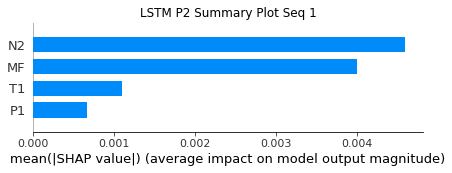

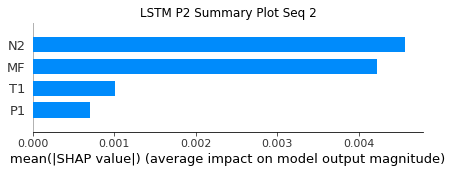

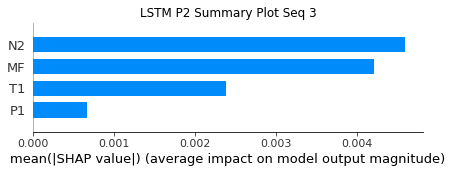

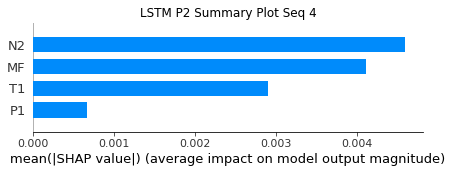

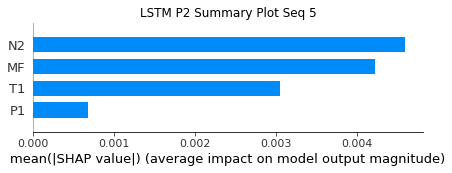

...

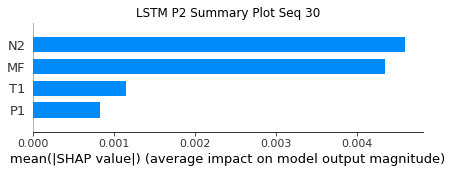

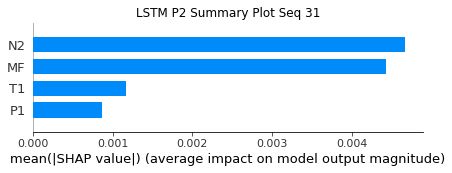

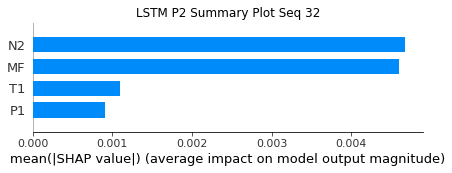

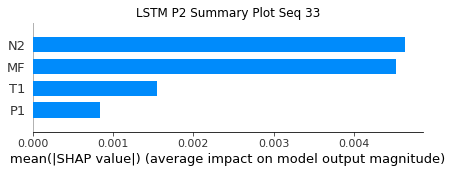

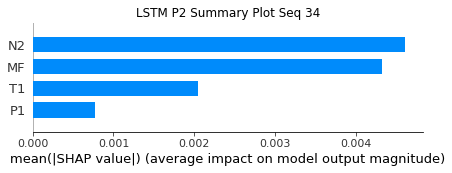

In [31]:
#SHAP Summmary Plot

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(34):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(7, 2),plot_type="bar")
    plt.title("LSTM P2 Summary Plot Seq %i" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure
    plt.show()

Contribution: [-0.01300738 -0.02142382 -0.06788444 -0.04628381]


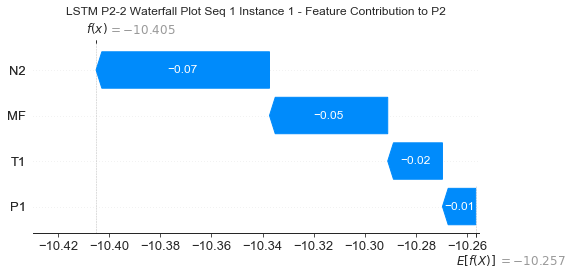

None

Contribution: [0.00047395 0.00010619 0.00159888 0.0014646 ]


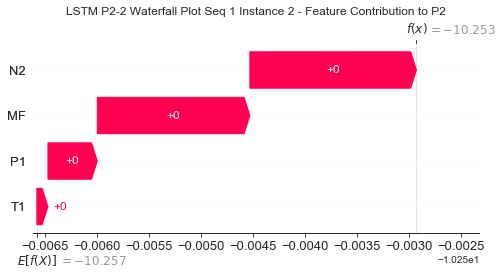

None

Contribution: [-1.01167900e-05 -1.89294038e-05 -1.33853848e-04 -1.31718613e-04]


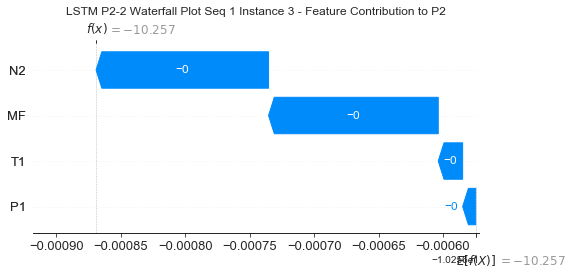

None

Contribution: [-3.33052528e-05 -5.94441921e-05 -2.16342197e-04 -2.15643764e-04]


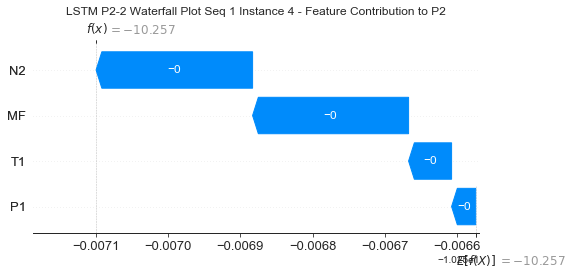

None

Contribution: [-3.17699972e-05 -4.78066197e-05 -1.87885048e-04 -1.85814426e-04]


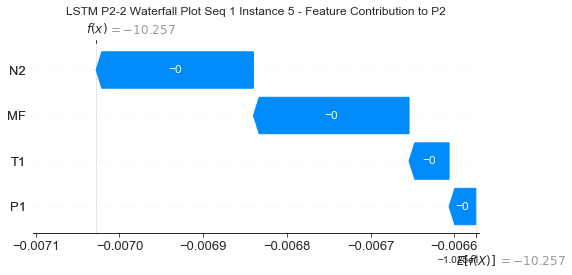

None

Contribution: [-2.96310920e-05 -4.05368737e-05 -1.65529888e-04 -1.62478172e-04]


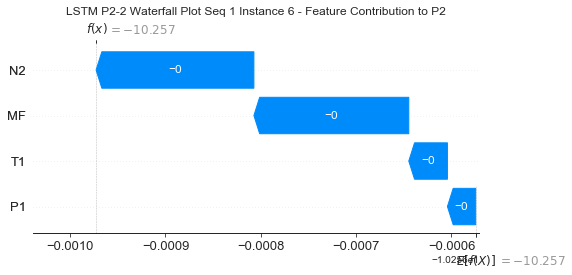

None

Contribution: [-1.97336193e-05 -3.25381459e-05 -1.44638373e-04 -1.17285823e-04]


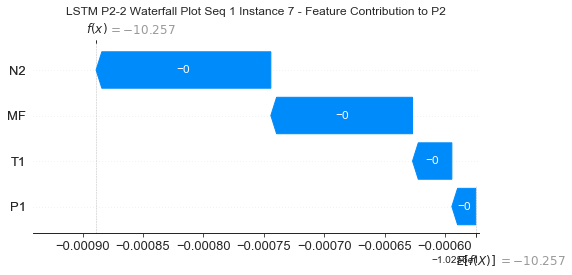

None

Contribution: [-1.39062077e-05 -2.52803392e-05 -1.28191224e-04 -8.09929805e-05]


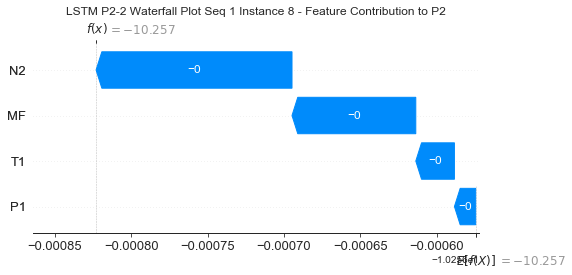

None

Contribution: [-1.88586191e-05 -2.52883269e-05 -1.26271488e-04 -9.55695602e-05]


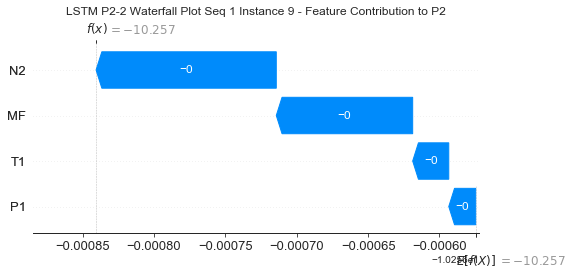

None

Contribution: [-3.16467973e-05 -2.54906044e-05 -1.26195256e-04 -1.08857259e-04]


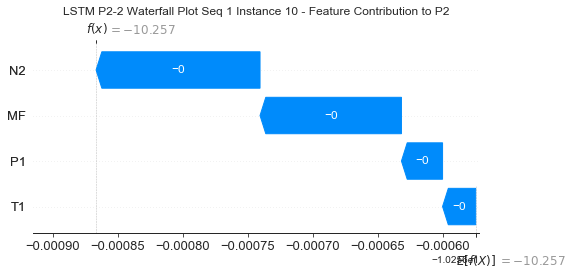

None

Contribution: [-3.52623619e-05 -2.70868686e-05 -1.31022376e-04 -1.19848621e-04]


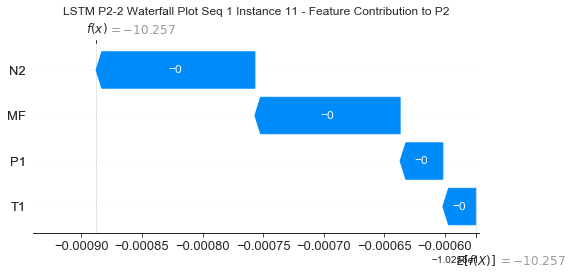

None

Contribution: [-3.57217802e-05 -2.76620033e-05 -1.36110724e-04 -1.25615789e-04]


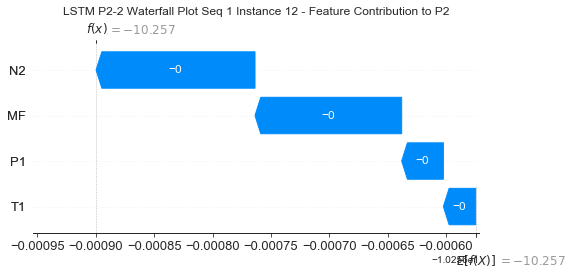

None

Contribution: [-3.47983294e-05 -2.92156971e-05 -1.42118334e-04 -1.32764395e-04]


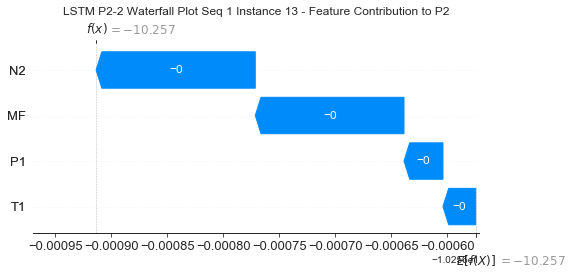

None

Contribution: [-2.89200154e-05 -2.77601189e-05 -1.44120825e-04 -1.25275491e-04]


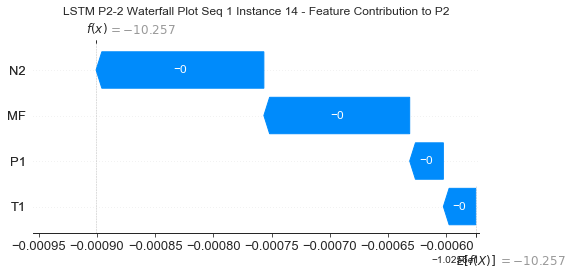

None

Contribution: [-3.39729692e-05 -3.14366279e-05 -1.52154878e-04 -1.44948342e-04]


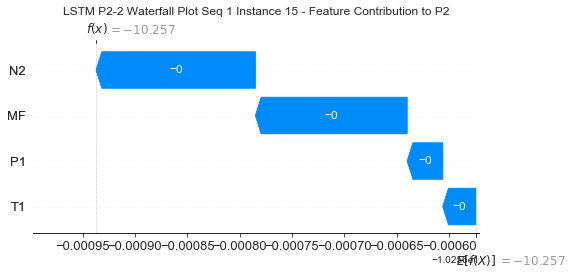

None

Contribution: [-3.40558894e-05 -3.09290152e-05 -1.51708116e-04 -1.44470478e-04]


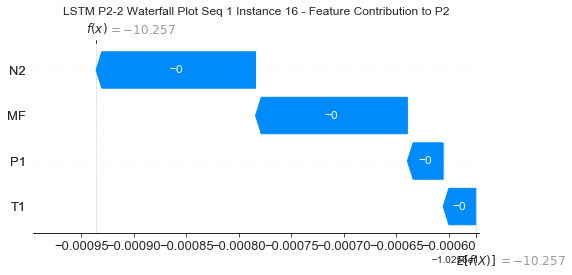

None

Contribution: [-3.36807961e-05 -2.93427172e-05 -1.48014627e-04 -1.39567009e-04]


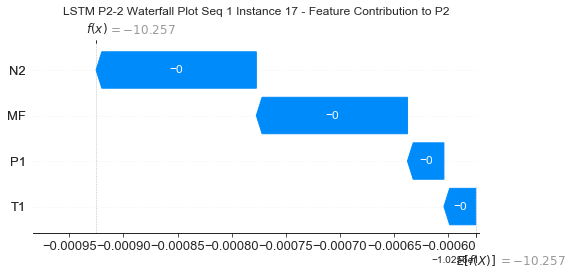

None

Contribution: [-3.16860881e-05 -3.38596304e-05 -1.71499022e-04 -1.69914685e-04]


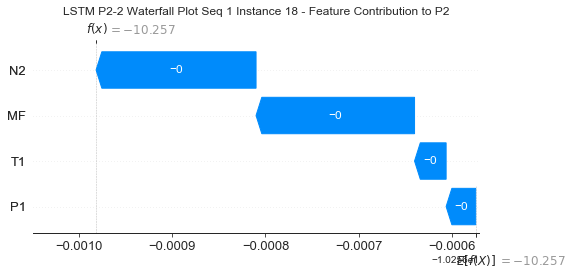

None

Contribution: [-1.76229590e-05 -6.30536705e-05 -2.76745328e-04 -2.99751463e-04]


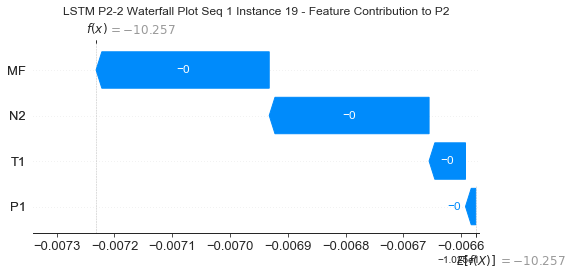

None

Contribution: [-1.00018551e-05 -8.83714817e-05 -3.41810930e-04 -3.73668152e-04]


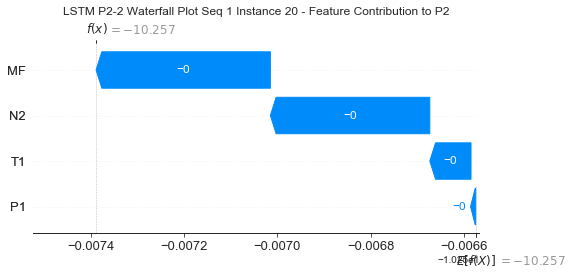

None

Contribution: [-8.20326089e-05  5.99124637e-05  2.50762198e-04  3.93991209e-04]


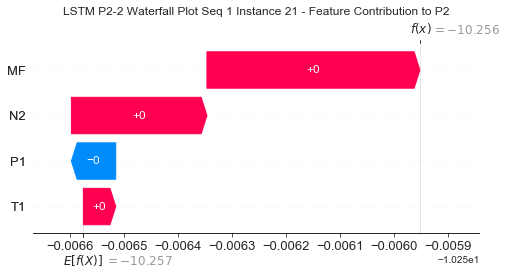

None

Contribution: [-0.00036972  0.00051416  0.00202345  0.00259541]


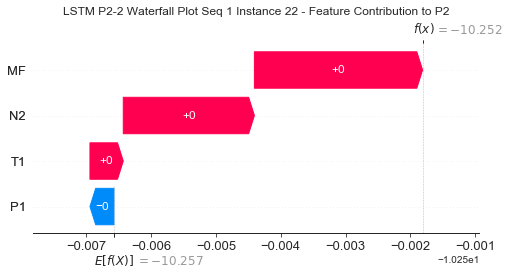

None

Contribution: [ 0.00075661 -0.00140016 -0.00650416 -0.00831444]


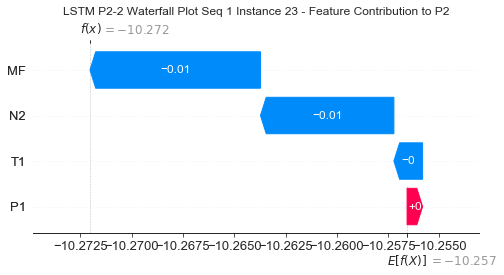

None

Contribution: [ 0.00077167 -0.00224285 -0.02877431 -0.03401733]


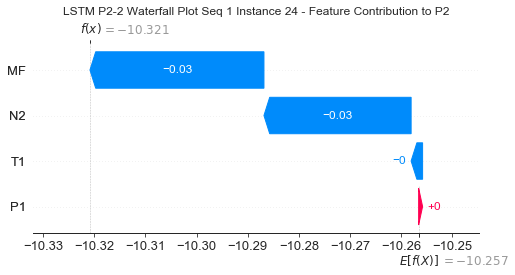

None

Contribution: [-0.01435932 -0.01563451 -0.06742616 -0.04821405]


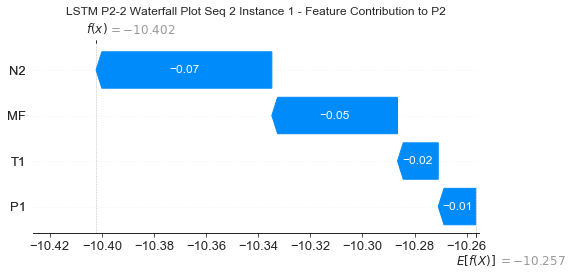

None

Contribution: [0.00048406 0.0001153  0.00158006 0.00147978]


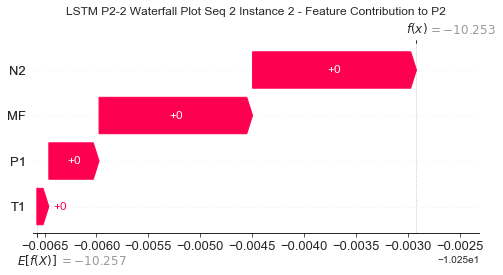

None

Contribution: [-1.04432991e-05 -2.03626300e-05 -1.32892579e-04 -1.33175040e-04]


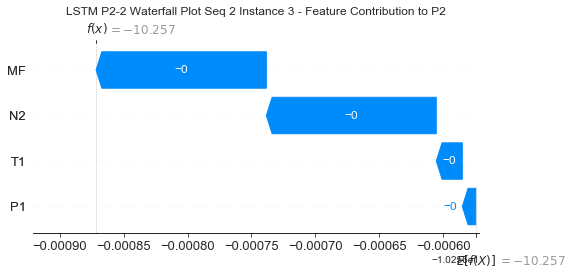

None

Contribution: [-3.40197230e-05 -6.37347051e-05 -2.15096205e-04 -2.17252446e-04]


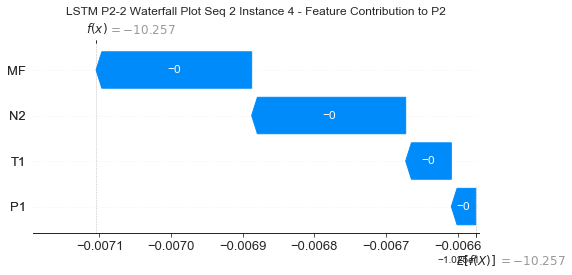

None

Contribution: [-3.22885446e-05 -5.09700785e-05 -1.86587788e-04 -1.87020602e-04]


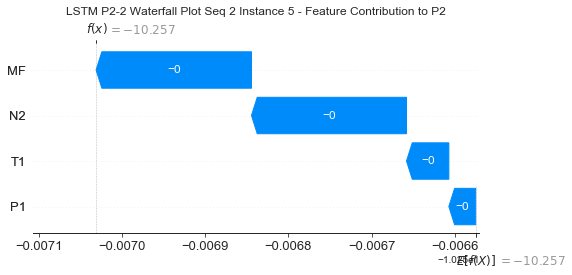

None

Contribution: [-3.02601089e-05 -4.27940214e-05 -1.64793405e-04 -1.63188989e-04]


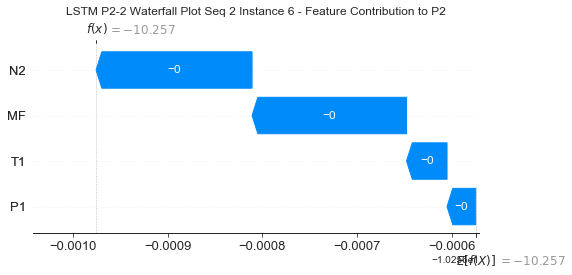

None

Contribution: [-1.98872274e-05 -3.32192327e-05 -1.43514580e-04 -1.16909789e-04]


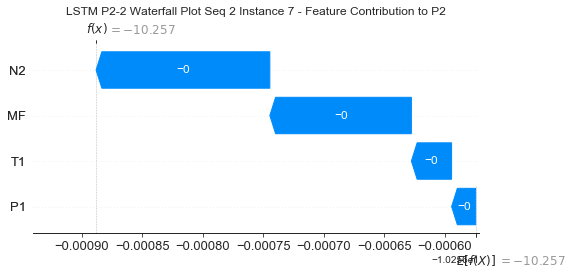

None

Contribution: [-1.44629957e-05 -2.51817076e-05 -1.27056872e-04 -8.01860436e-05]


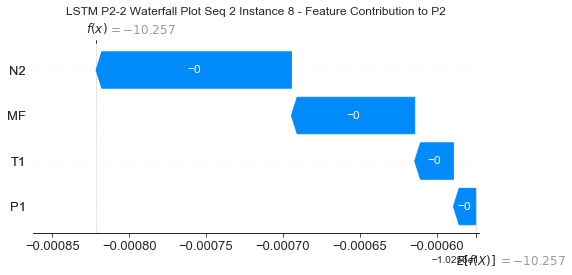

None

Contribution: [-1.96546182e-05 -2.52313196e-05 -1.25178820e-04 -9.45802317e-05]


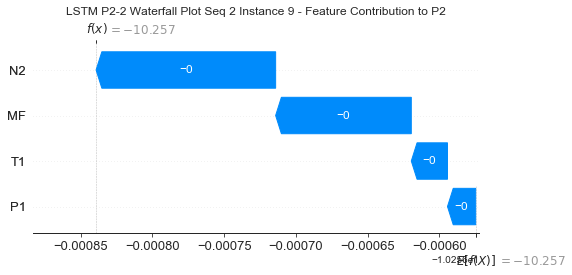

None

Contribution: [-3.21417930e-05 -2.68324456e-05 -1.25497815e-04 -1.08899271e-04]


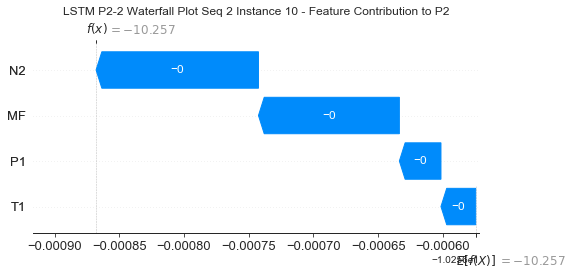

None

Contribution: [-3.56012670e-05 -2.85991990e-05 -1.30315137e-04 -1.19933255e-04]


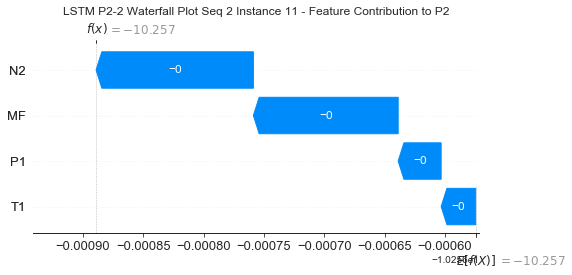

None

Contribution: [-3.57225288e-05 -2.86846284e-05 -1.35384967e-04 -1.25948504e-04]


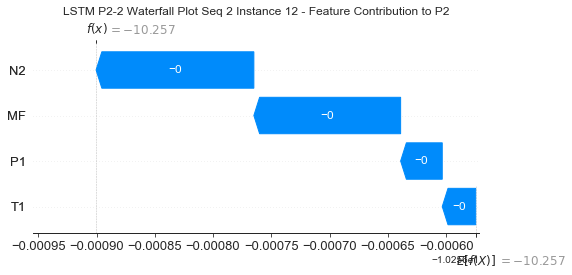

None

Contribution: [-3.50888453e-05 -3.05344908e-05 -1.41474773e-04 -1.32907284e-04]


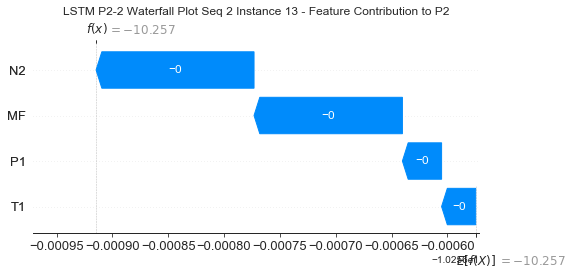

None

Contribution: [-2.93204776e-05 -2.91271128e-05 -1.43547772e-04 -1.26110180e-04]


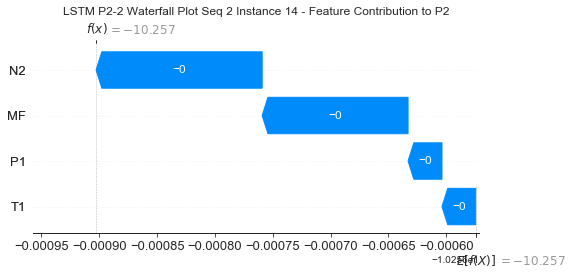

None

Contribution: [-3.40493288e-05 -3.28954625e-05 -1.51345352e-04 -1.44816276e-04]


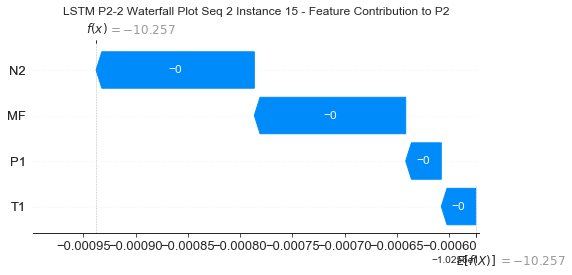

None

Contribution: [-3.41955542e-05 -3.22907638e-05 -1.50575664e-04 -1.43793869e-04]


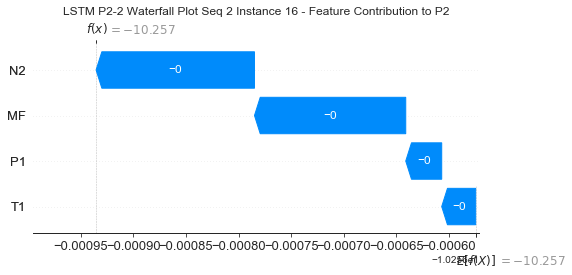

None

Contribution: [-3.35241172e-05 -2.97788556e-05 -1.47135336e-04 -1.37935805e-04]


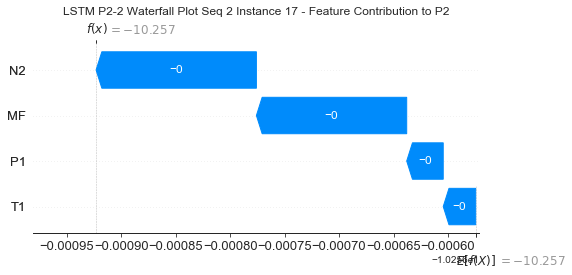

None

Contribution: [-3.16278636e-05 -3.49196049e-05 -1.70875223e-04 -1.69953681e-04]


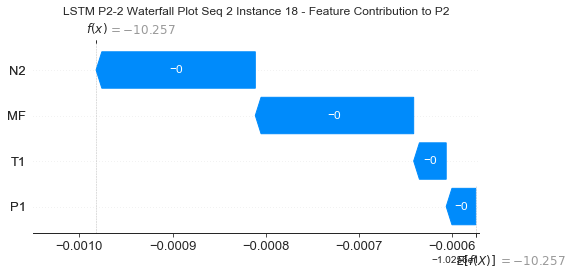

None

Contribution: [-1.76041289e-05 -6.56189447e-05 -2.75684897e-04 -3.00268268e-04]


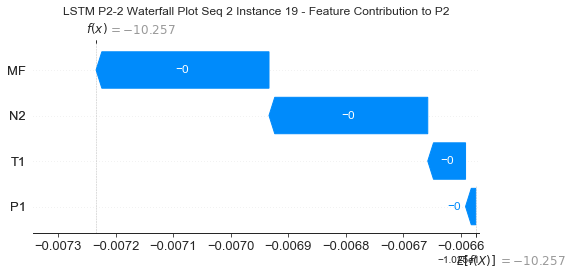

None

Contribution: [-1.02969790e-05 -9.02445086e-05 -3.38022840e-04 -3.71979282e-04]


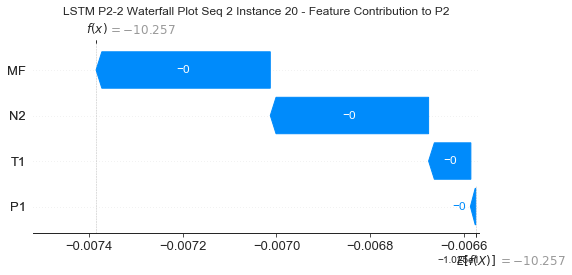

None

Contribution: [-8.35578612e-05  6.55322391e-05  2.61003602e-04  4.08394369e-04]


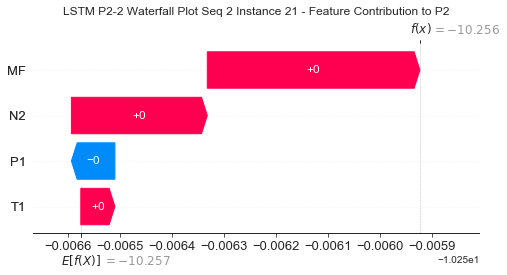

None

Contribution: [-0.00037412  0.00055882  0.00202414  0.00259134]


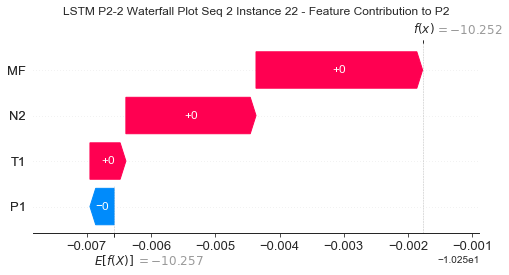

None

Contribution: [ 0.00074338 -0.00137952 -0.00652535 -0.00821166]


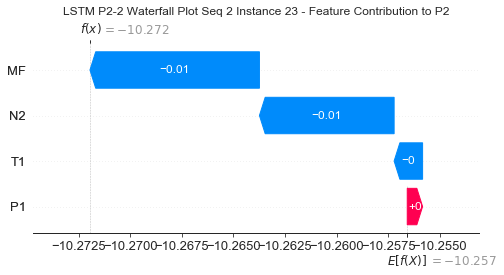

None

Contribution: [ 0.00041136  0.00576592 -0.02874398 -0.03763353]


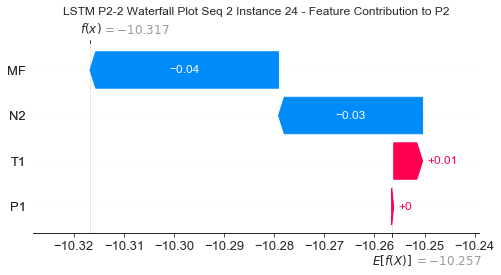

None

Contribution: [-0.01358936 -0.03899882 -0.06810748 -0.05147595]


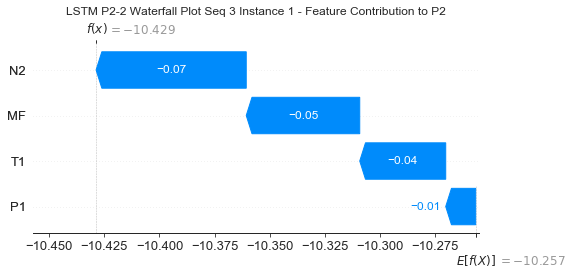

None

Contribution: [4.79247750e-04 9.09220361e-05 1.59723111e-03 1.50080489e-03]


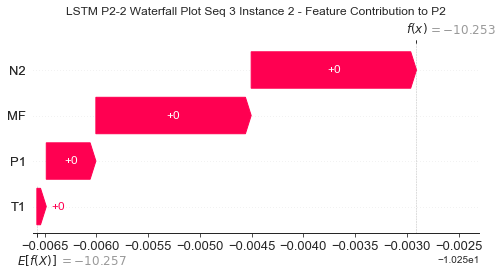

None

Contribution: [-1.01935253e-05 -1.33632577e-05 -1.33362937e-04 -1.33248263e-04]


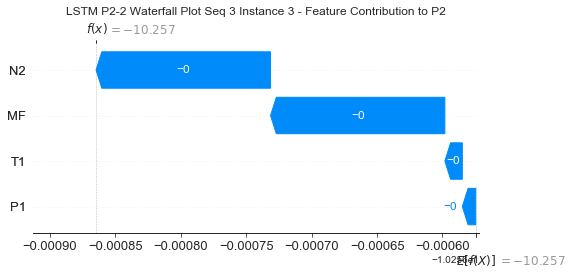

None

Contribution: [-3.35476716e-05 -4.63135421e-05 -2.16233237e-04 -2.17931236e-04]


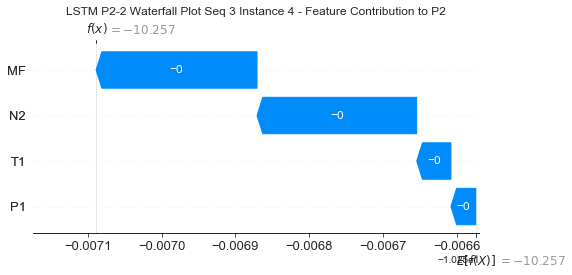

None

Contribution: [-3.18296168e-05 -3.83123534e-05 -1.87809202e-04 -1.87291684e-04]


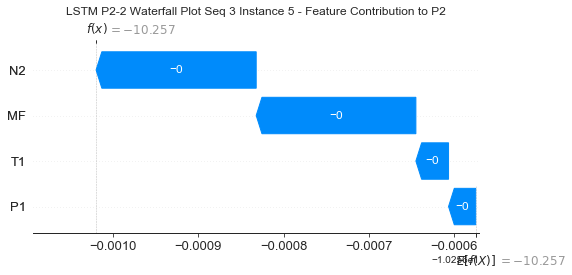

None

Contribution: [-2.98120732e-05 -3.27365677e-05 -1.64958098e-04 -1.62890056e-04]


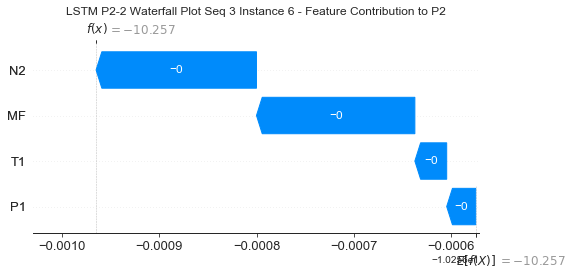

None

Contribution: [-1.84316785e-05 -2.65112169e-05 -1.43050051e-04 -1.15097094e-04]


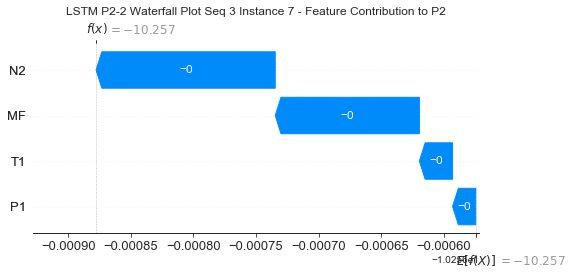

None

Contribution: [-1.41818592e-05 -1.99661412e-05 -1.26401906e-04 -7.81957990e-05]


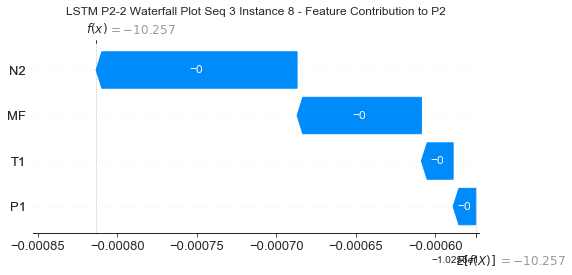

None

Contribution: [-1.82497077e-05 -2.04875296e-05 -1.24693324e-04 -9.32581622e-05]


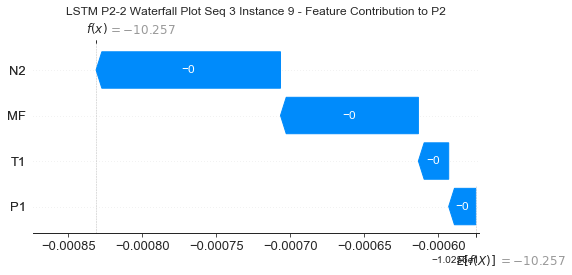

None

Contribution: [-3.16279937e-05 -2.08630794e-05 -1.25102895e-04 -1.07765844e-04]


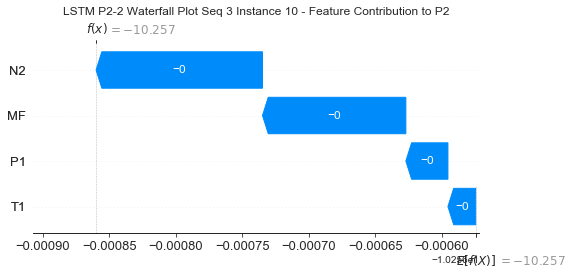

None

Contribution: [-3.52099481e-05 -2.22795214e-05 -1.29974881e-04 -1.19096303e-04]


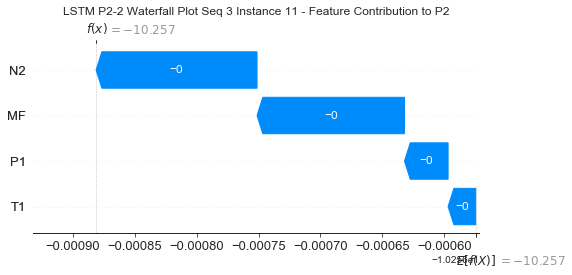

None

Contribution: [-3.52384993e-05 -2.26603680e-05 -1.34972785e-04 -1.24621516e-04]


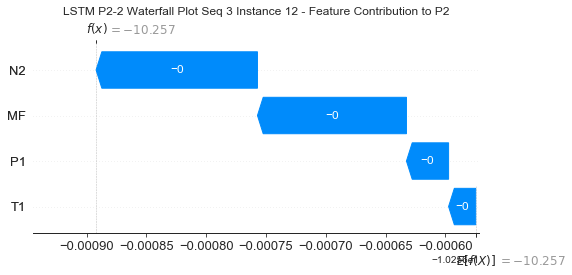

None

Contribution: [-3.45831549e-05 -2.40747264e-05 -1.41305312e-04 -1.32163578e-04]


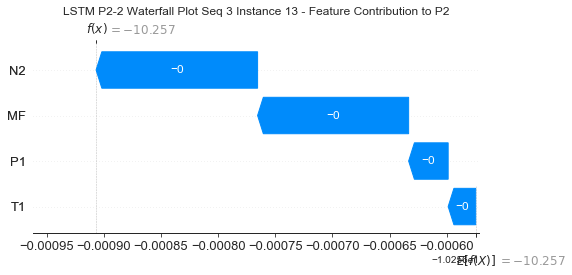

None

Contribution: [-2.96312775e-05 -2.31877929e-05 -1.43102767e-04 -1.24551081e-04]


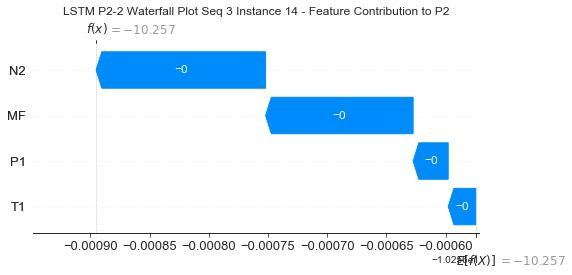

None

Contribution: [-3.35374601e-05 -2.57895896e-05 -1.51228775e-04 -1.44160288e-04]


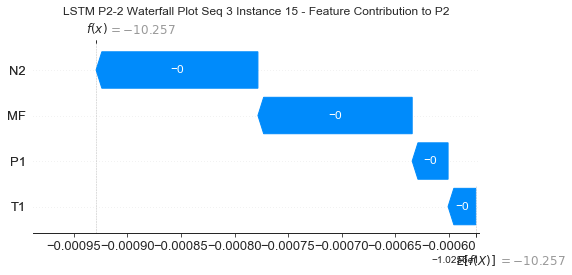

None

Contribution: [-3.37196293e-05 -2.52361740e-05 -1.50542401e-04 -1.43312958e-04]


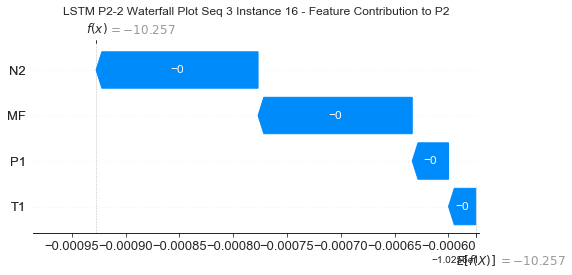

None

Contribution: [-3.40603177e-05 -2.44252430e-05 -1.46632470e-04 -1.37755823e-04]


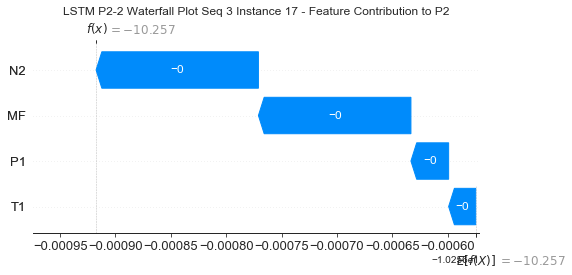

None

Contribution: [-3.08443239e-05 -2.86622257e-05 -1.71826290e-04 -1.70644333e-04]


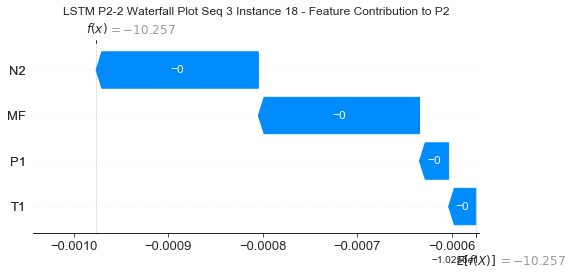

None

Contribution: [-1.66653360e-05 -5.11102610e-05 -2.80224057e-04 -3.04498534e-04]


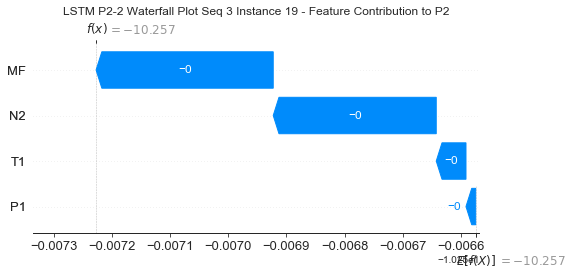

None

Contribution: [-1.00609166e-05 -6.76606519e-05 -3.39307542e-04 -3.70528882e-04]


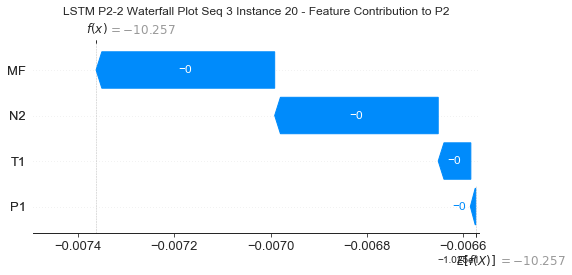

None

Contribution: [-8.45418224e-05  5.11376681e-05  2.86578887e-04  4.39868251e-04]


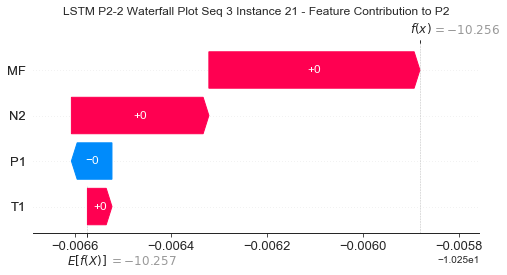

None

Contribution: [-0.00037116  0.00033995  0.00207855  0.00265156]


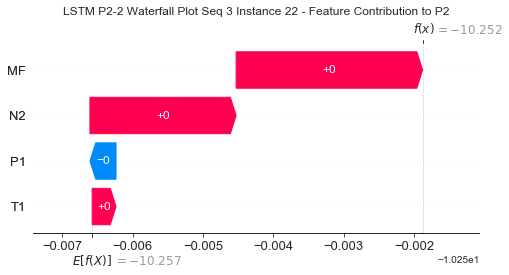

None

Contribution: [ 0.00077291 -0.00064681 -0.00671262 -0.00850202]


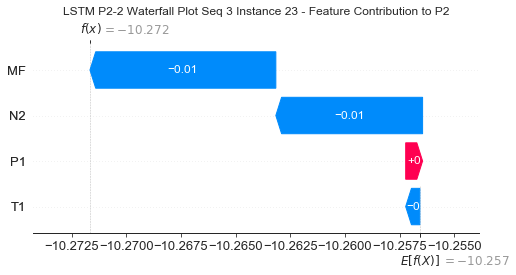

None

Contribution: [ 0.00035042  0.01646673 -0.02822558 -0.03341417]


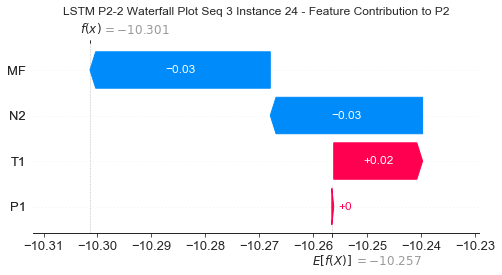

None

Contribution: [-0.01337137 -0.05189759 -0.0679254  -0.04775486]


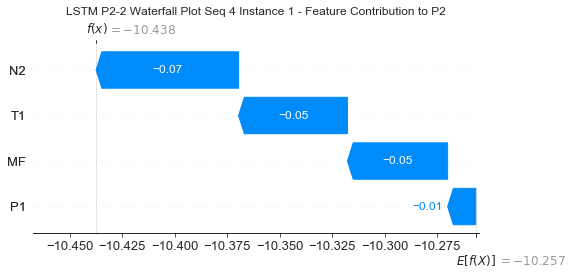

None

Contribution: [4.80942179e-04 8.06126995e-05 1.61619476e-03 1.50163018e-03]


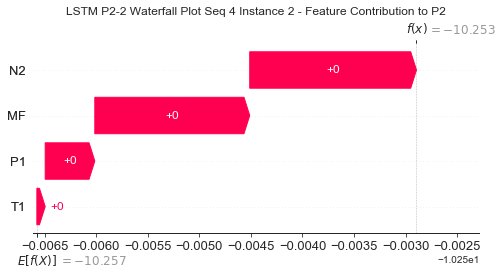

None

Contribution: [-1.00826547e-05 -1.34876799e-05 -1.33235875e-04 -1.31714813e-04]


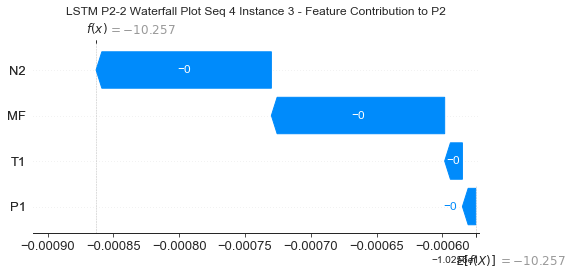

None

Contribution: [-3.35698573e-05 -4.62742813e-05 -2.16103419e-04 -2.16123949e-04]


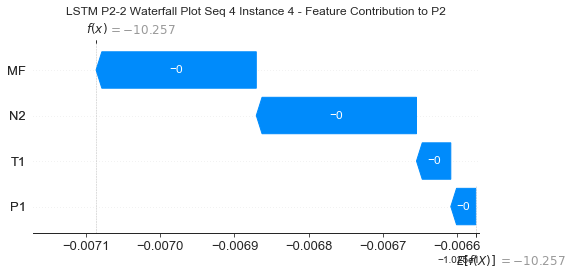

None

Contribution: [-3.20088970e-05 -4.07690536e-05 -1.87325989e-04 -1.86003627e-04]


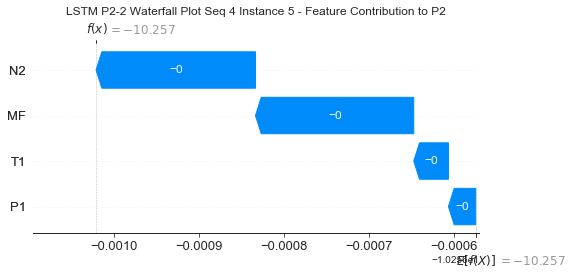

None

Contribution: [-2.98594911e-05 -3.28273262e-05 -1.65025788e-04 -1.62191956e-04]


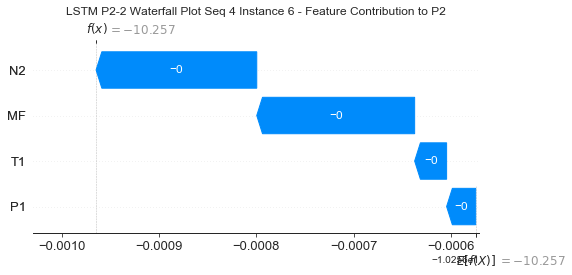

None

Contribution: [-1.95001420e-05 -2.64475348e-05 -1.43587545e-04 -1.15111917e-04]


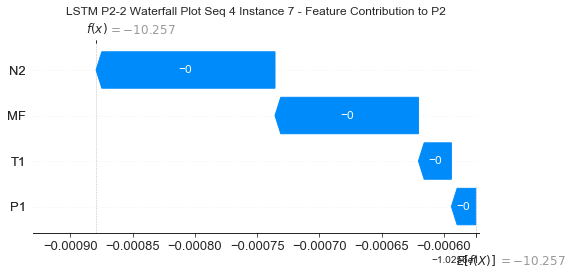

None

Contribution: [-1.41057219e-05 -2.06480989e-05 -1.27197800e-04 -7.93065867e-05]


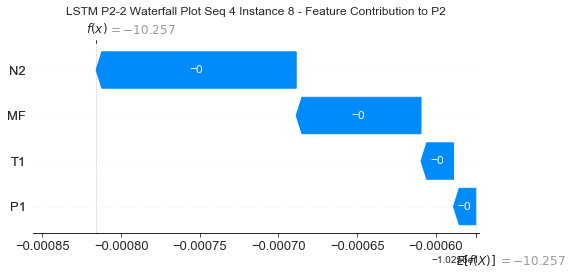

None

Contribution: [-1.83906736e-05 -2.10569636e-05 -1.25368949e-04 -9.40132059e-05]


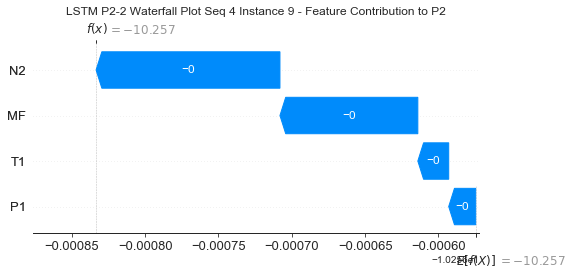

None

Contribution: [-3.18020180e-05 -2.09754123e-05 -1.25495766e-04 -1.08235148e-04]


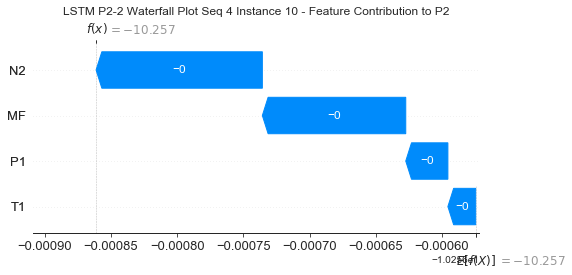

None

Contribution: [-3.55761689e-05 -2.21346267e-05 -1.30151096e-04 -1.19196563e-04]


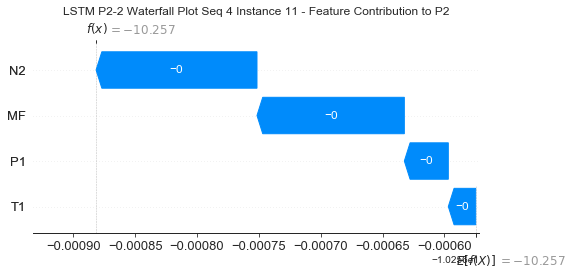

None

Contribution: [-3.39811183e-05 -2.20745742e-05 -1.35333764e-04 -1.24770631e-04]


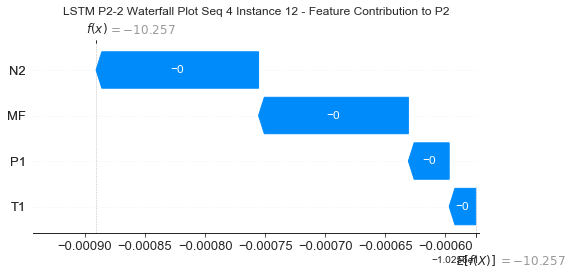

None

Contribution: [-3.48430458e-05 -2.38164259e-05 -1.41538550e-04 -1.32413355e-04]


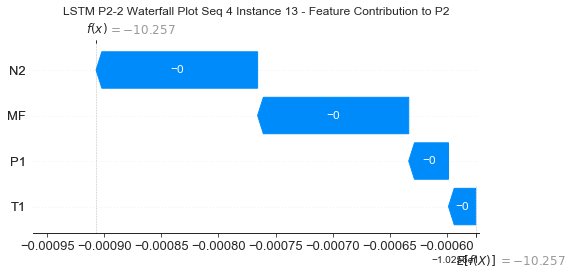

None

Contribution: [-3.01120218e-05 -2.23187254e-05 -1.43536068e-04 -1.24909476e-04]


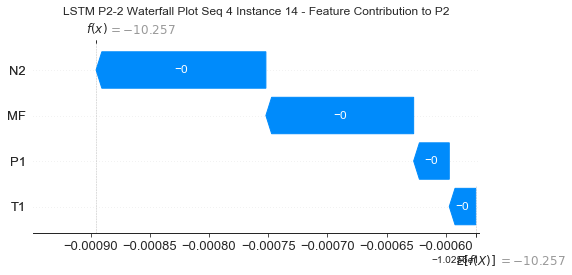

None

Contribution: [-3.39853082e-05 -2.53049969e-05 -1.51530896e-04 -1.44466639e-04]


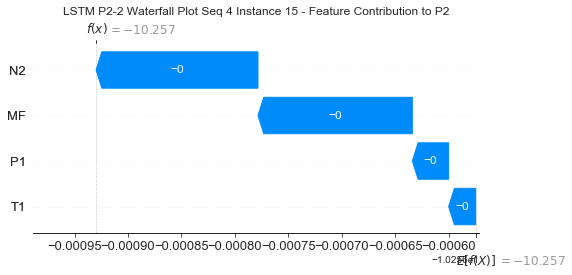

None

Contribution: [-3.40074269e-05 -2.48928702e-05 -1.50896690e-04 -1.43636418e-04]


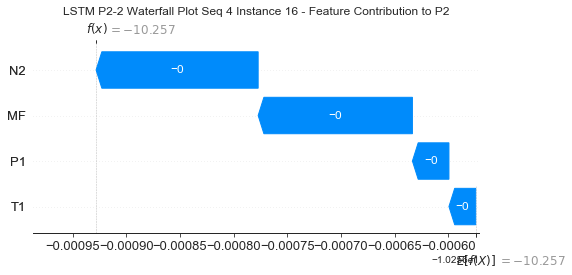

None

Contribution: [-3.47258064e-05 -2.40357223e-05 -1.46910713e-04 -1.37929922e-04]


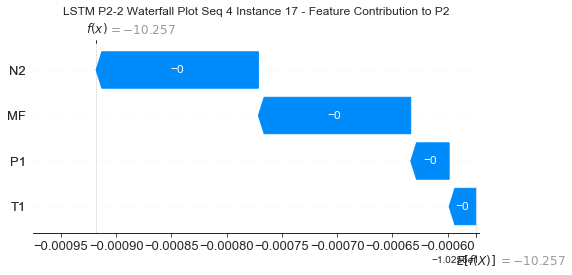

None

Contribution: [-3.13849548e-05 -2.78059958e-05 -1.71736982e-04 -1.70167654e-04]


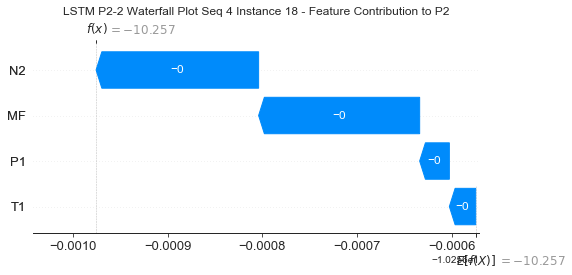

None

Contribution: [-1.69747876e-05 -4.93520727e-05 -2.79795218e-04 -3.03114431e-04]


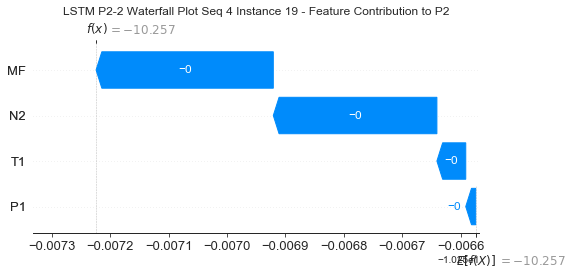

None

Contribution: [-9.99612068e-06 -6.51386750e-05 -3.40795367e-04 -3.71291455e-04]


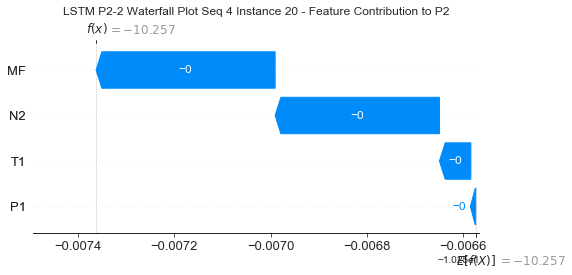

None

Contribution: [-8.36017372e-05  4.78073311e-05  2.77014610e-04  4.27567746e-04]


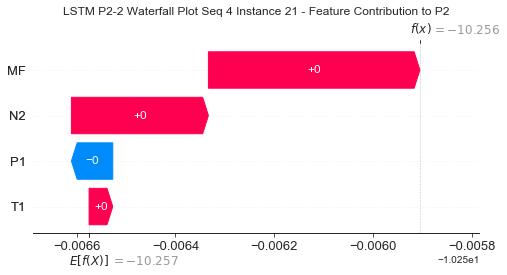

None

Contribution: [-0.00036792  0.00032532  0.00206236  0.00262312]


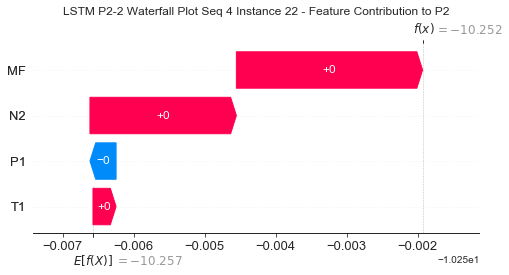

None

Contribution: [ 0.00077628 -0.00074924 -0.00667014 -0.00846285]


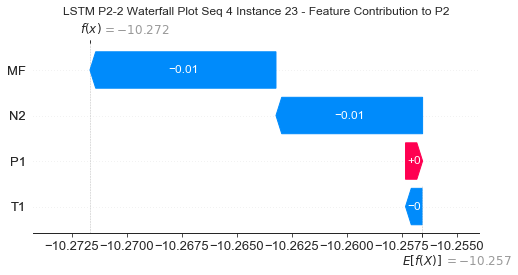

None

Contribution: [ 0.0005451   0.01597972 -0.02861879 -0.03511081]


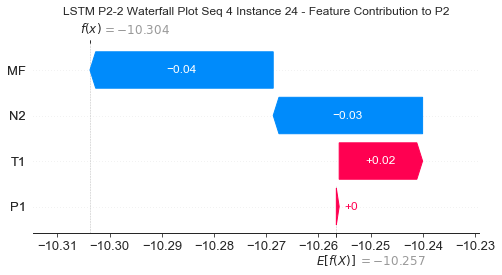

None

Contribution: [-0.01391229 -0.05558009 -0.06797276 -0.04902392]


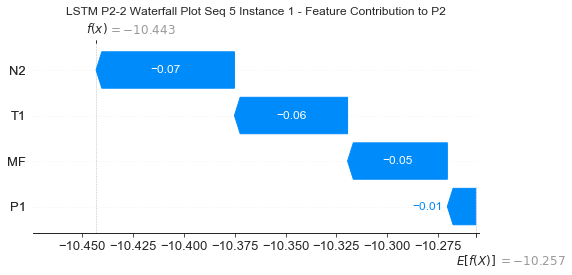

None

Contribution: [4.85444876e-04 7.17521325e-05 1.60649072e-03 1.50208590e-03]


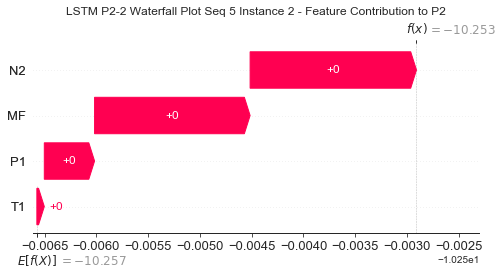

None

Contribution: [-1.00904720e-05 -1.10741824e-05 -1.33197323e-04 -1.33500963e-04]


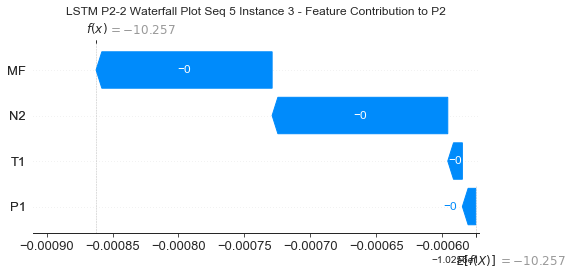

None

Contribution: [-3.35585896e-05 -4.15882852e-05 -2.16071038e-04 -2.18679149e-04]


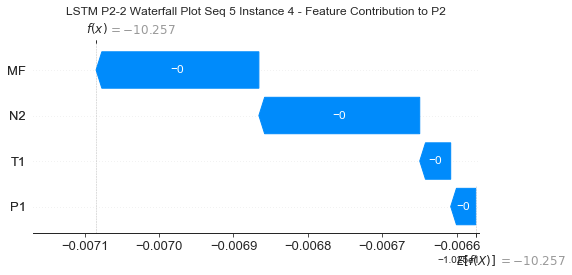

None

Contribution: [-3.22379448e-05 -3.45664805e-05 -1.87424826e-04 -1.87794995e-04]


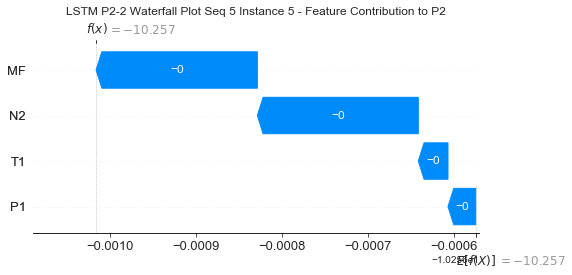

None

Contribution: [-2.98329995e-05 -3.03573673e-05 -1.65283912e-04 -1.63658332e-04]


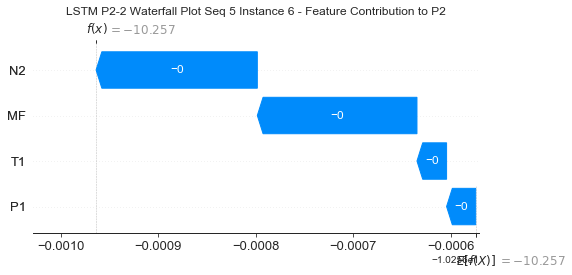

None

Contribution: [-1.92558601e-05 -2.50434287e-05 -1.43823296e-04 -1.15773202e-04]


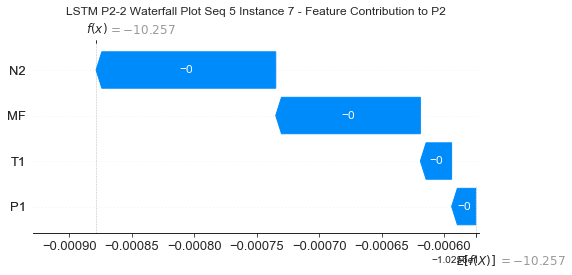

None

Contribution: [-1.33077364e-05 -2.00280938e-05 -1.27511203e-04 -7.98559292e-05]


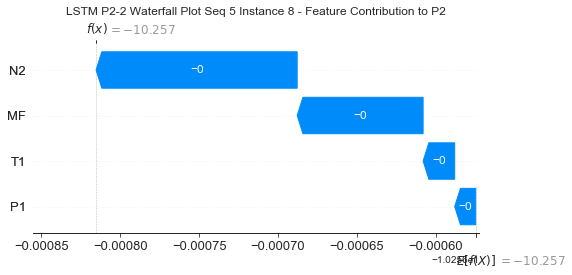

None

Contribution: [-1.87215959e-05 -2.04793770e-05 -1.25874917e-04 -9.53565746e-05]


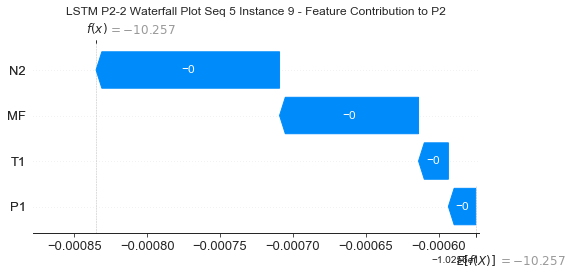

None

Contribution: [-3.20357716e-05 -2.03091479e-05 -1.25990401e-04 -1.09327712e-04]


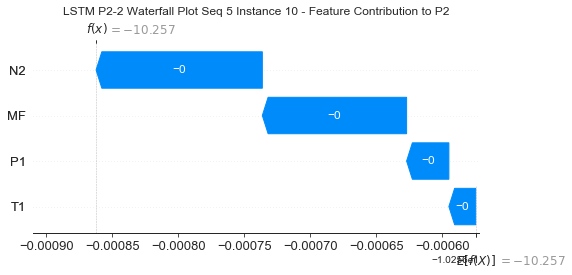

None

Contribution: [-3.56066548e-05 -2.14448981e-05 -1.30888806e-04 -1.20491613e-04]


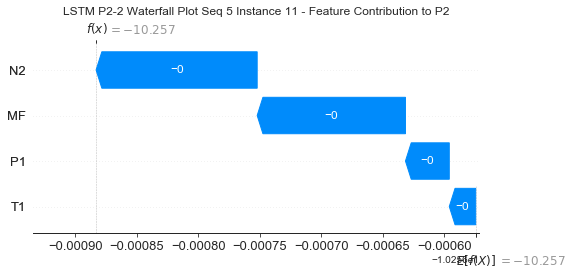

None

Contribution: [-3.46106050e-05 -2.24183034e-05 -1.36015585e-04 -1.26312236e-04]


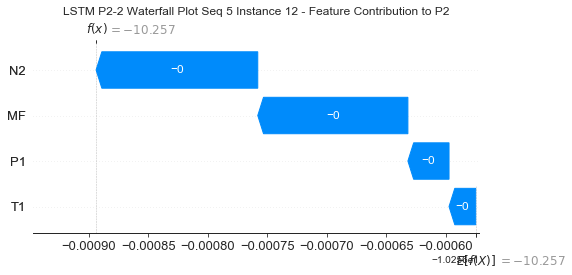

None

Contribution: [-3.49952588e-05 -2.33111898e-05 -1.42105810e-04 -1.33608347e-04]


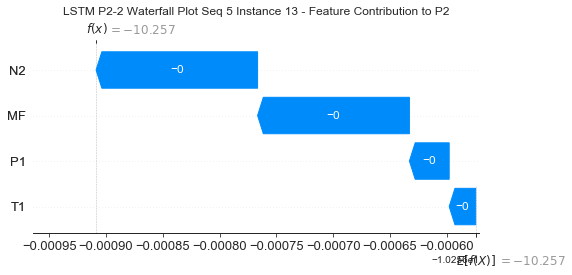

None

Contribution: [-3.02067805e-05 -2.23950225e-05 -1.43911928e-04 -1.25082220e-04]


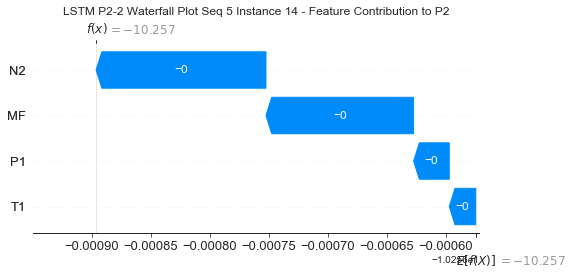

None

Contribution: [-3.40423508e-05 -2.48035724e-05 -1.52039092e-04 -1.45529824e-04]


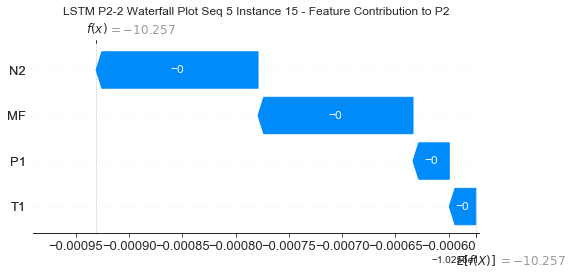

None

Contribution: [-3.39738387e-05 -2.43389855e-05 -1.51367978e-04 -1.44615815e-04]


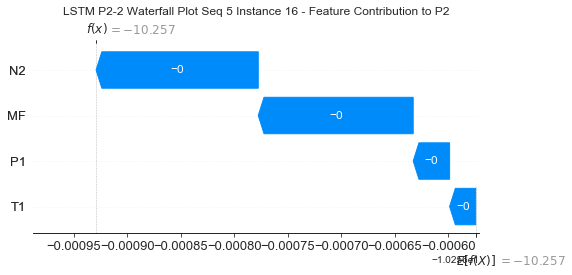

None

Contribution: [-3.34765578e-05 -2.32995961e-05 -1.47485151e-04 -1.39075897e-04]


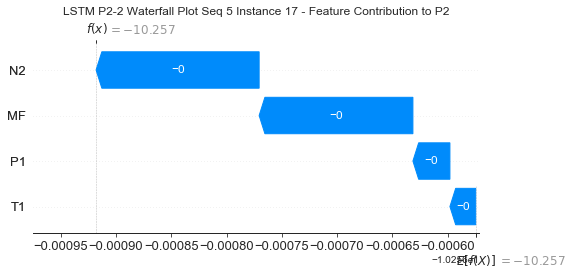

None

Contribution: [-3.10436904e-05 -2.71205007e-05 -1.71975260e-04 -1.70860429e-04]


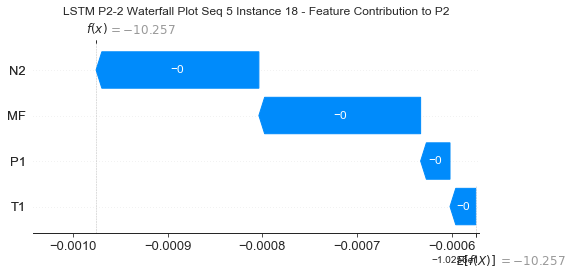

None

Contribution: [-1.69134802e-05 -4.74585825e-05 -2.78818901e-04 -3.03121921e-04]


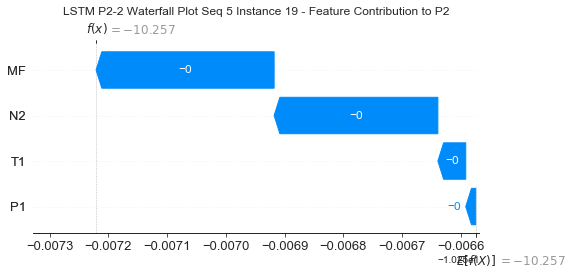

None

Contribution: [-9.96482345e-06 -6.31794719e-05 -3.40379756e-04 -3.73242522e-04]


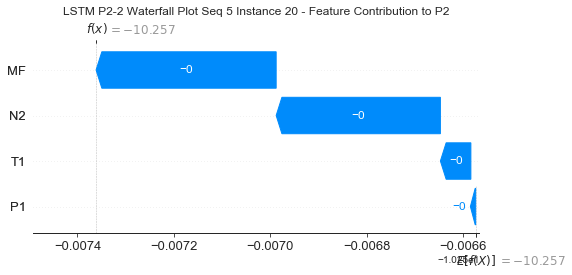

None

Contribution: [-8.23787862e-05  4.52763520e-05  2.68234392e-04  4.18742951e-04]


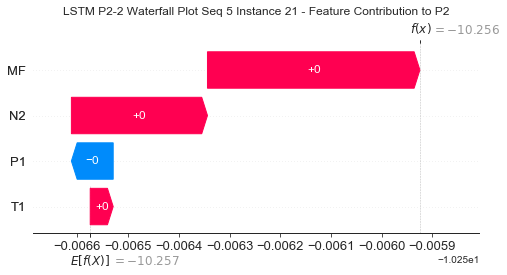

None

Contribution: [-0.00036284  0.00031364  0.00204114  0.00262295]


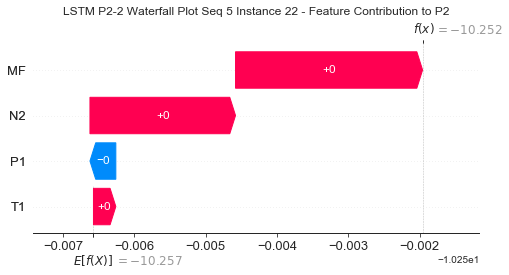

None

Contribution: [ 0.0007418  -0.00075798 -0.00663371 -0.00846154]


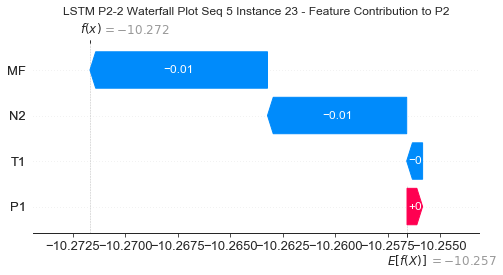

None

Contribution: [ 0.0001512   0.01594707 -0.0284695  -0.03617687]


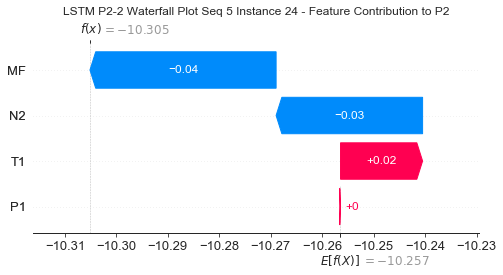

None

Contribution: [-0.01323836 -0.05197069 -0.06785118 -0.05079104]


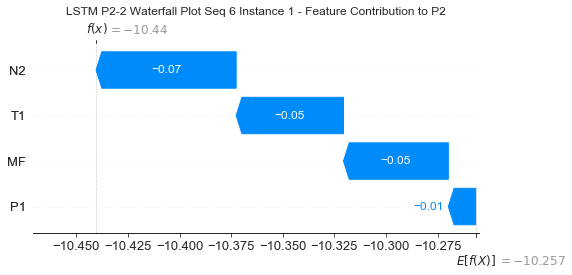

None

Contribution: [4.82285562e-04 7.54037872e-05 1.60106770e-03 1.52408466e-03]


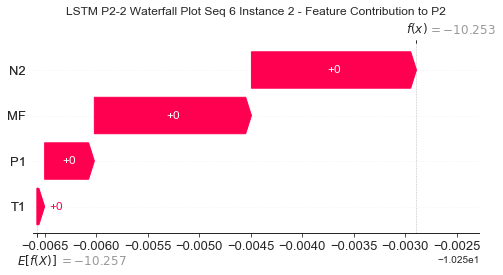

None

Contribution: [-9.98445974e-06 -1.24717677e-05 -1.32409615e-04 -1.32148382e-04]


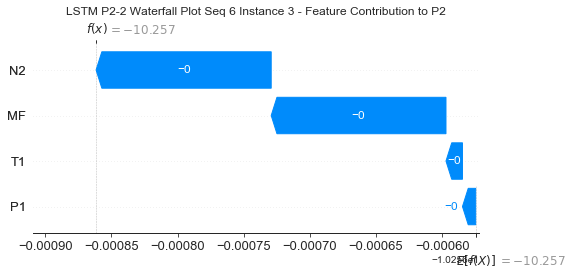

None

Contribution: [-3.33373734e-05 -4.45178611e-05 -2.15167577e-04 -2.17151136e-04]


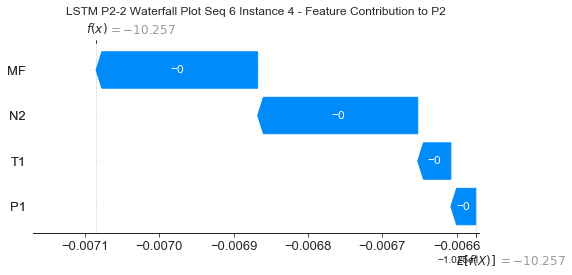

None

Contribution: [-3.09749181e-05 -3.73171822e-05 -1.86816926e-04 -1.86251122e-04]


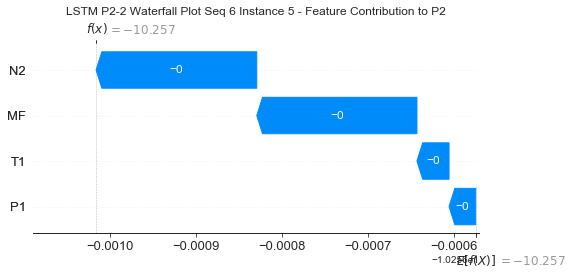

None

Contribution: [-2.96880809e-05 -3.20883104e-05 -1.64894965e-04 -1.63020240e-04]


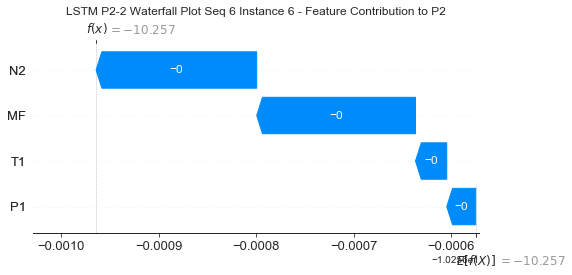

None

Contribution: [-1.87853060e-05 -2.61532274e-05 -1.43742305e-04 -1.15591459e-04]


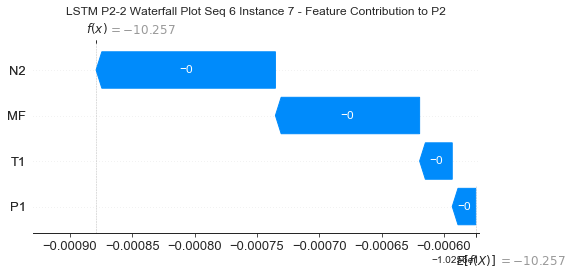

None

Contribution: [-1.30546056e-05 -2.10850130e-05 -1.27748560e-04 -8.10461191e-05]


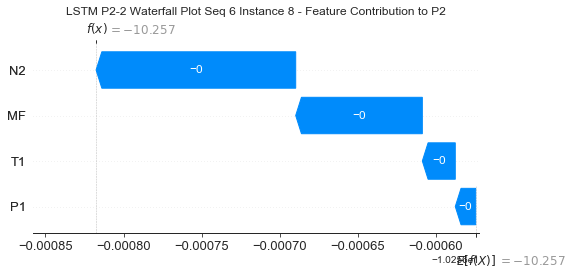

None

Contribution: [-1.86127029e-05 -2.09049458e-05 -1.25884178e-04 -9.51110363e-05]


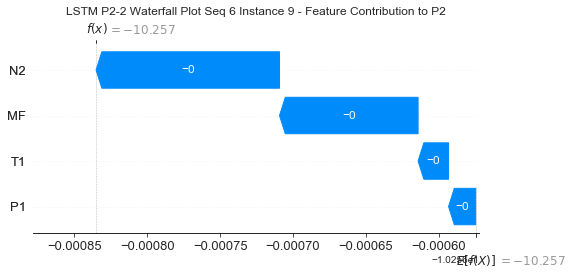

None

Contribution: [-3.16633372e-05 -2.09442959e-05 -1.26028839e-04 -1.09590605e-04]


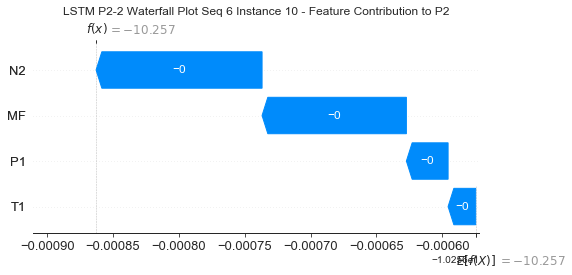

None

Contribution: [-3.52261841e-05 -2.22696841e-05 -1.30989463e-04 -1.20811417e-04]


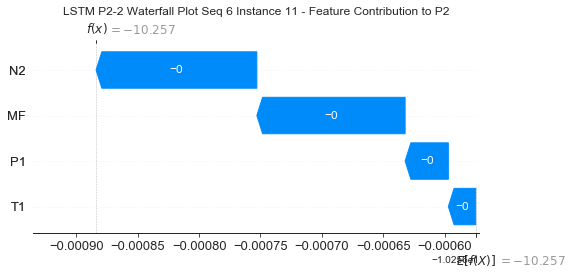

None

Contribution: [-3.58416114e-05 -2.30394697e-05 -1.35940887e-04 -1.26787239e-04]


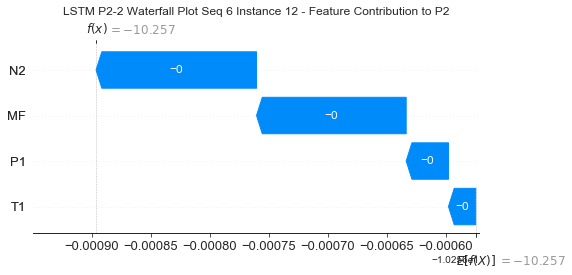

None

Contribution: [-3.47001780e-05 -2.40852285e-05 -1.42096616e-04 -1.33725711e-04]


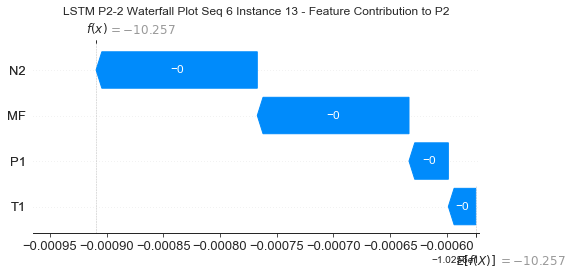

None

Contribution: [-2.98237830e-05 -2.27107334e-05 -1.43739462e-04 -1.25789647e-04]


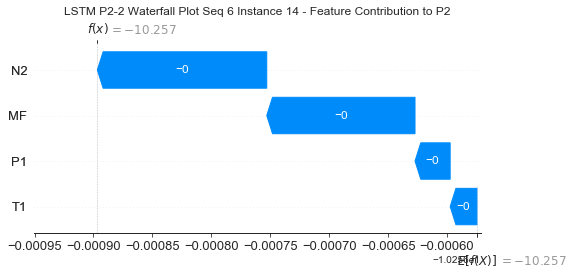

None

Contribution: [-3.38048707e-05 -2.57261214e-05 -1.52062570e-04 -1.45612299e-04]


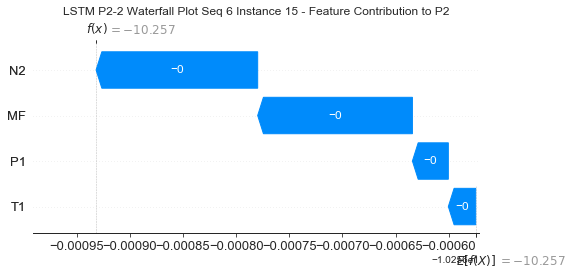

None

Contribution: [-3.40890136e-05 -2.53981661e-05 -1.51510465e-04 -1.44865579e-04]


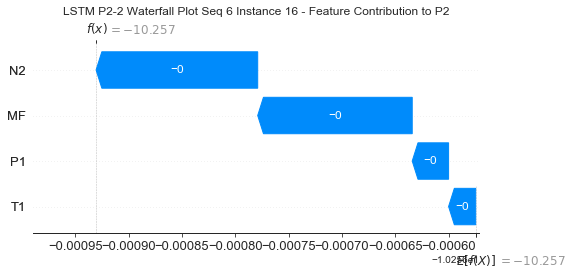

None

Contribution: [-3.36759063e-05 -2.47463657e-05 -1.47662280e-04 -1.39156245e-04]


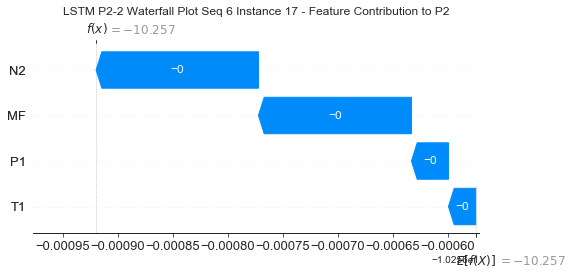

None

Contribution: [-3.13176881e-05 -2.85631184e-05 -1.71756599e-04 -1.70440740e-04]


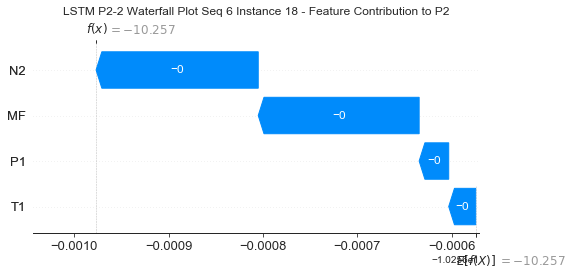

None

Contribution: [-1.73271989e-05 -5.08135331e-05 -2.77641259e-04 -3.01380951e-04]


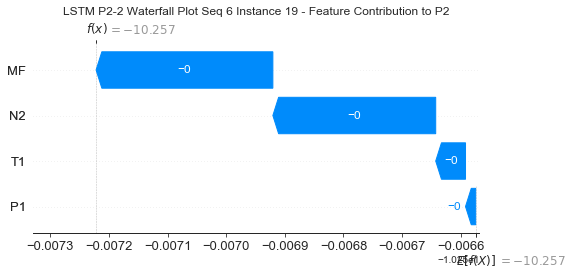

None

Contribution: [-1.01778503e-05 -6.87123773e-05 -3.39569310e-04 -3.71835798e-04]


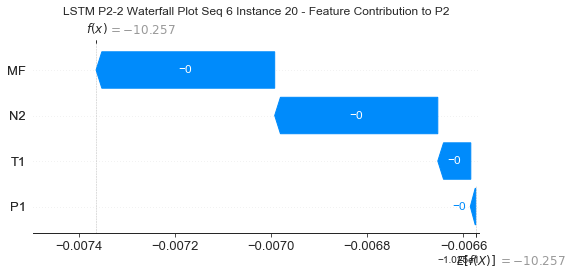

None

Contribution: [-8.34440557e-05  4.83853913e-05  2.64383951e-04  4.13456928e-04]


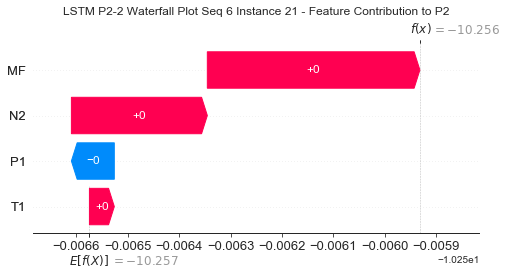

None

Contribution: [-0.00036908  0.00035578  0.00203594  0.00260608]


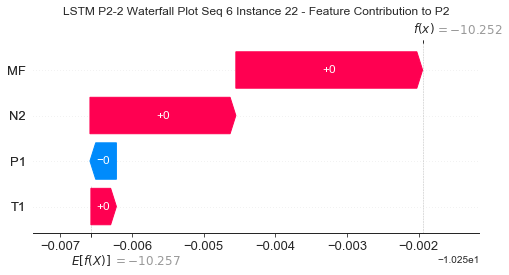

None

Contribution: [ 0.00075557 -0.00085193 -0.00663807 -0.008332  ]


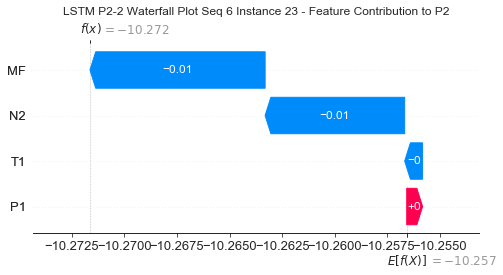

None

Contribution: [ 0.00062309  0.01244736 -0.02887454 -0.03545923]


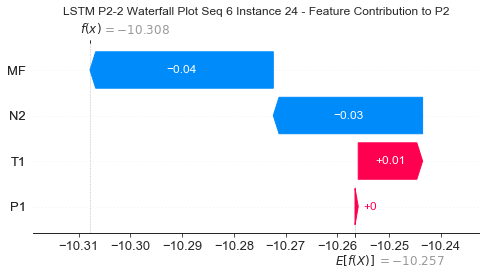

None

Contribution: [-0.01356026 -0.04726128 -0.06844071 -0.04917293]


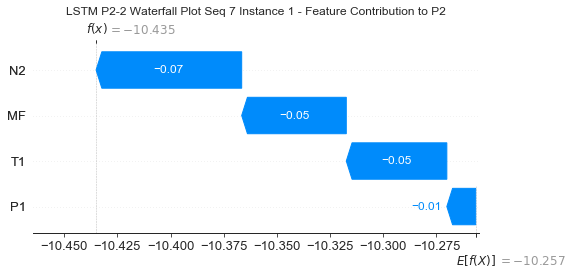

None

Contribution: [4.81719687e-04 7.85666233e-05 1.60652713e-03 1.48311409e-03]


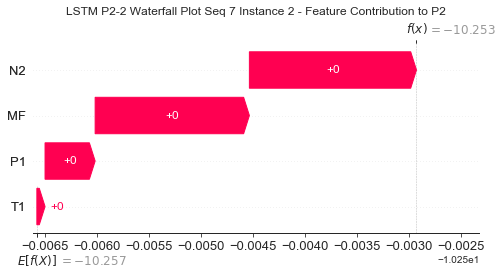

None

Contribution: [-1.01735458e-05 -1.20183301e-05 -1.33713863e-04 -1.32682076e-04]


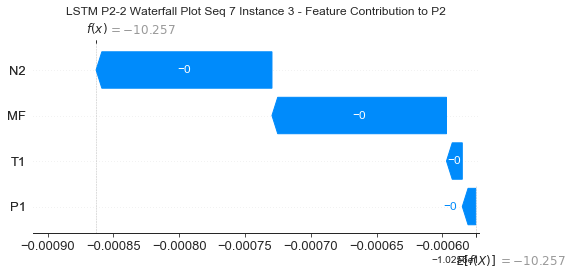

None

Contribution: [-3.37076315e-05 -4.28534804e-05 -2.16805286e-04 -2.17216479e-04]


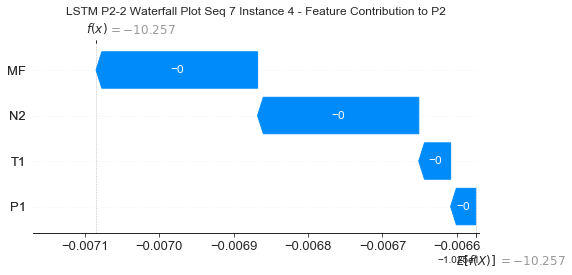

None

Contribution: [-3.15846794e-05 -3.66519167e-05 -1.87421303e-04 -1.87138563e-04]


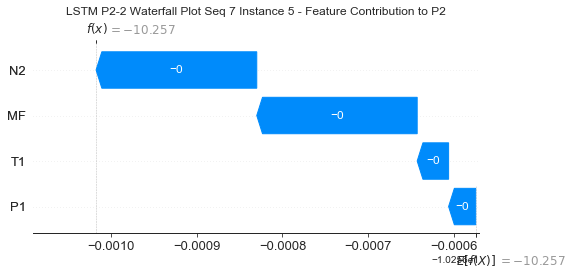

None

Contribution: [-2.99265902e-05 -3.05797806e-05 -1.64913710e-04 -1.62189689e-04]


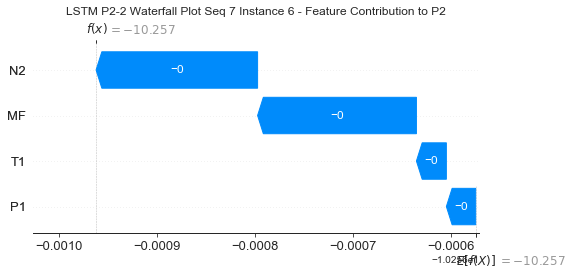

None

Contribution: [-1.86461179e-05 -2.42721748e-05 -1.42921466e-04 -1.14319712e-04]


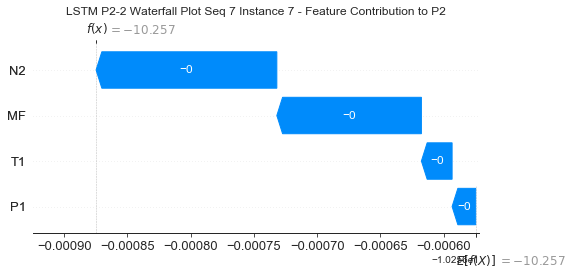

None

Contribution: [-1.39990545e-05 -2.03155279e-05 -1.26695616e-04 -7.86923739e-05]


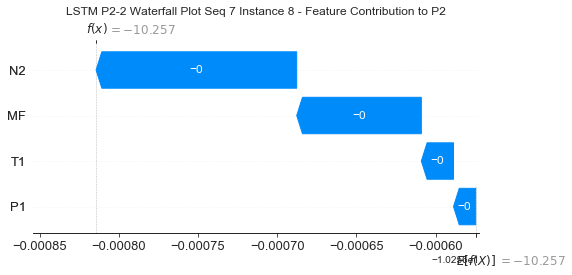

None

Contribution: [-1.84602200e-05 -2.01586015e-05 -1.24761195e-04 -9.33867235e-05]


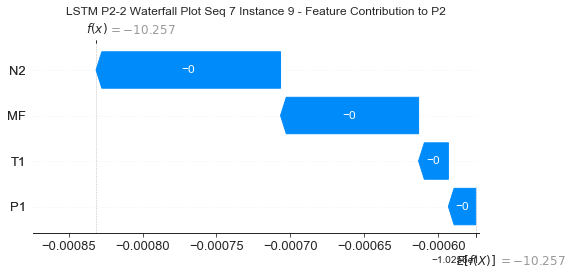

None

Contribution: [-3.19381333e-05 -1.94200807e-05 -1.25233595e-04 -1.07698587e-04]


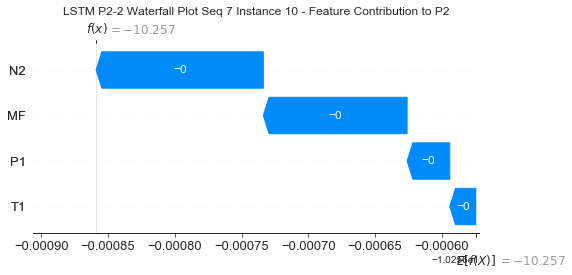

None

Contribution: [-3.55818357e-05 -2.03602977e-05 -1.30024408e-04 -1.18871315e-04]


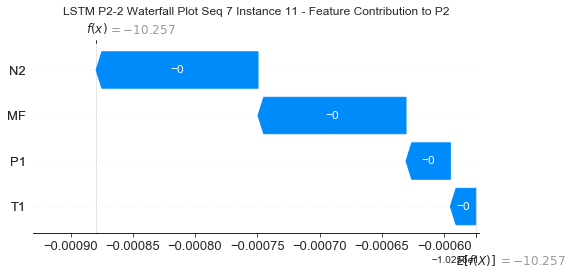

None

Contribution: [-3.56763515e-05 -2.00057533e-05 -1.35241699e-04 -1.24524981e-04]


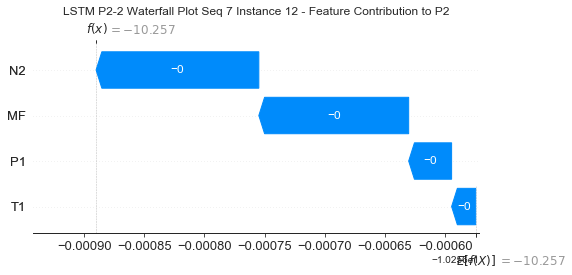

None

Contribution: [-3.48784451e-05 -2.19220567e-05 -1.41386380e-04 -1.32060245e-04]


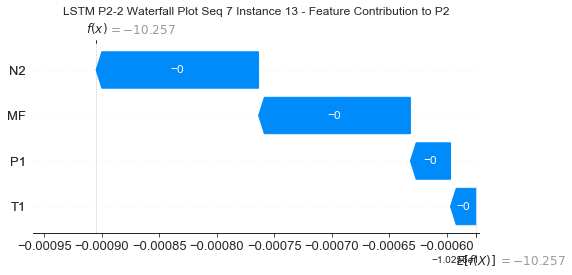

None

Contribution: [-2.99185113e-05 -2.04134864e-05 -1.43482139e-04 -1.24376900e-04]


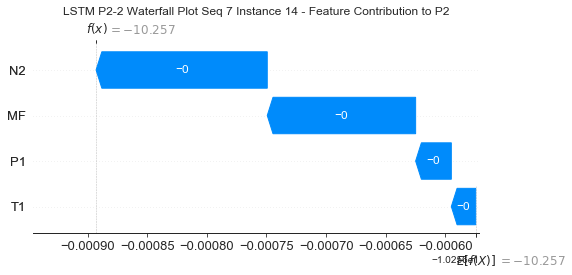

None

Contribution: [-3.38199357e-05 -2.30619897e-05 -1.51490089e-04 -1.44109077e-04]


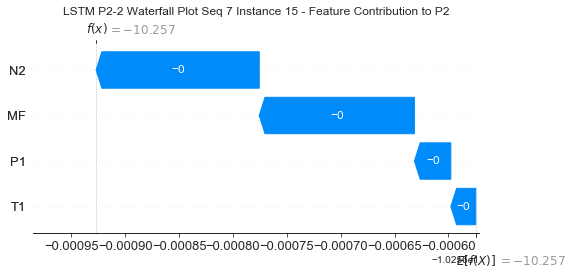

None

Contribution: [-3.40031461e-05 -2.26965534e-05 -1.50624321e-04 -1.42913273e-04]


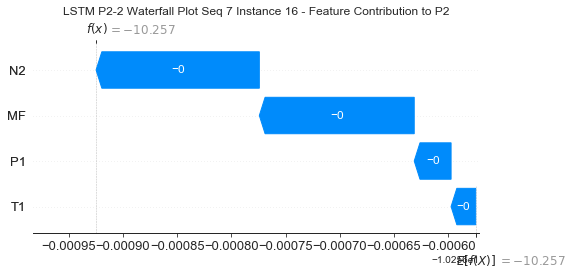

None

Contribution: [-3.43055608e-05 -2.18975559e-05 -1.46478415e-04 -1.36786747e-04]


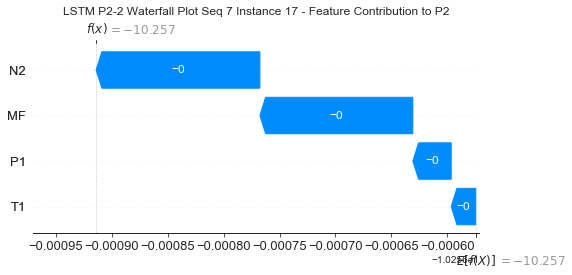

None

Contribution: [-3.08887124e-05 -2.56628437e-05 -1.72259545e-04 -1.70546602e-04]


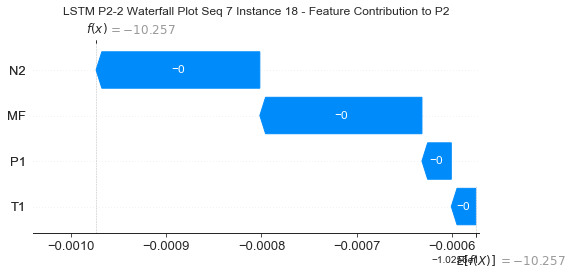

None

Contribution: [-1.64726270e-05 -4.44941978e-05 -2.82820576e-04 -3.06108900e-04]


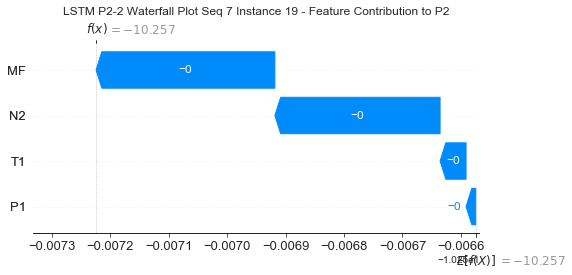

None

Contribution: [-9.80158398e-06 -5.74057323e-05 -3.42660777e-04 -3.72754426e-04]


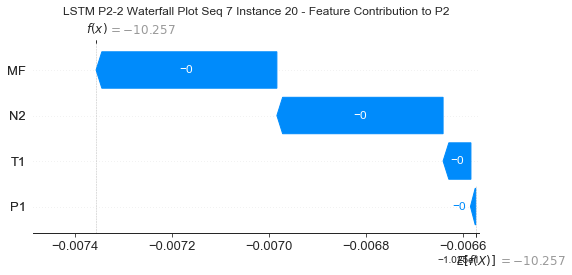

None

Contribution: [-8.48444886e-05  4.32495931e-05  2.90159388e-04  4.43577415e-04]


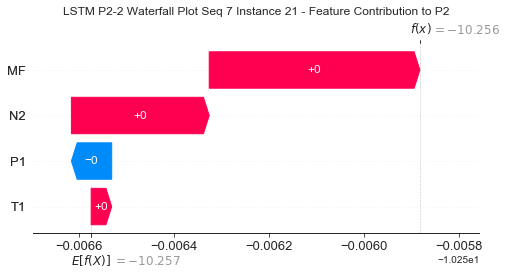

None

Contribution: [-0.00036952  0.0002643   0.00209264  0.0026527 ]


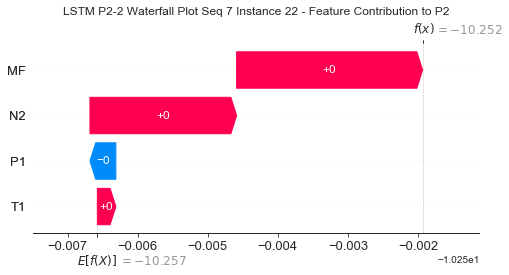

None

Contribution: [ 0.00077009 -0.00049907 -0.00673193 -0.00860039]


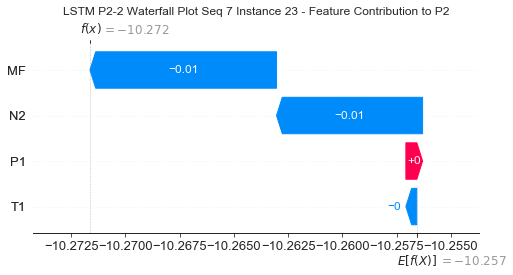

None

Contribution: [ 0.00042238  0.02195634 -0.02910494 -0.03687649]


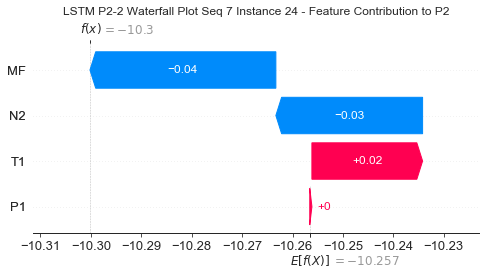

None

Contribution: [-0.01335815 -0.06667734 -0.06875758 -0.05126942]


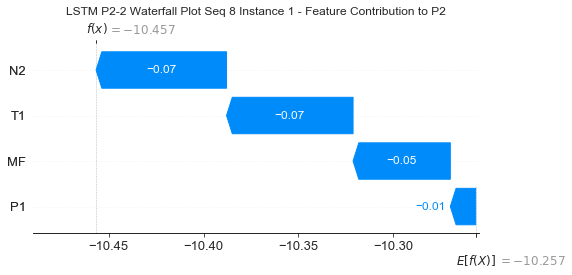

None

Contribution: [4.77957340e-04 6.69056639e-05 1.62742447e-03 1.53495900e-03]


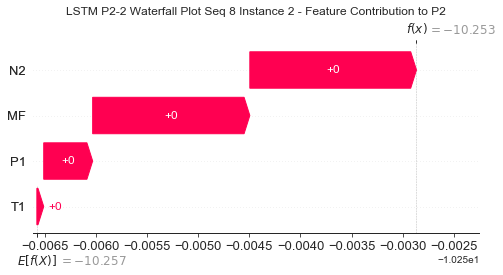

None

Contribution: [-1.00799236e-05 -8.47938469e-06 -1.32440594e-04 -1.32013050e-04]


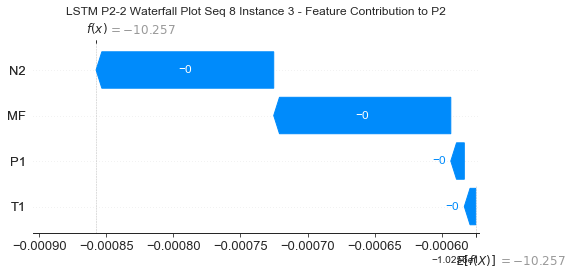

None

Contribution: [-3.33602205e-05 -3.52236575e-05 -2.15258807e-04 -2.15686270e-04]


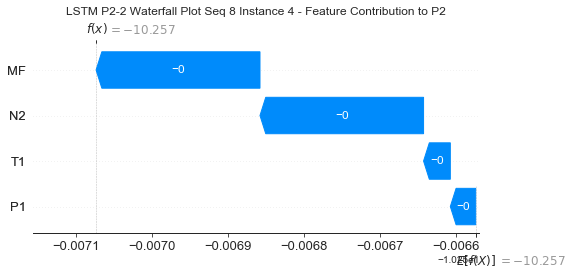

None

Contribution: [-3.19961154e-05 -3.35785271e-05 -1.86344689e-04 -1.86165818e-04]


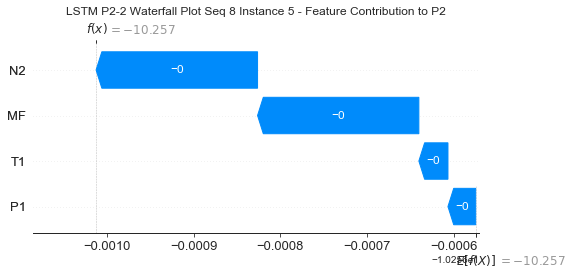

None

Contribution: [-2.96283739e-05 -2.71223162e-05 -1.63969840e-04 -1.60956587e-04]


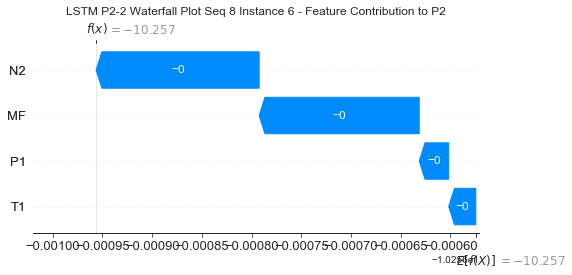

None

Contribution: [-1.87482146e-05 -2.38849232e-05 -1.42605357e-04 -1.14355376e-04]


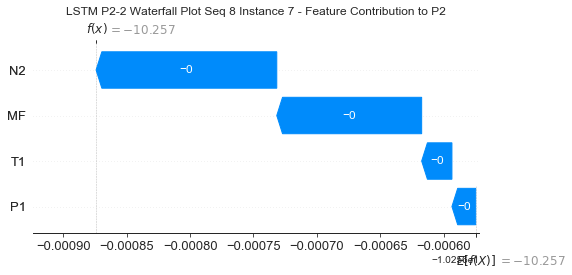

None

Contribution: [-1.32243253e-05 -1.86804883e-05 -1.26113890e-04 -7.79919091e-05]


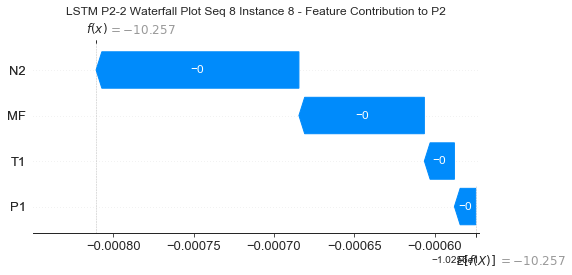

None

Contribution: [-1.78722666e-05 -1.94002599e-05 -1.24134397e-04 -9.25412166e-05]


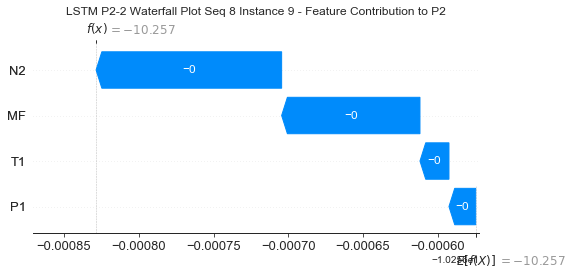

None

Contribution: [-3.17986596e-05 -1.83662209e-05 -1.24098792e-04 -1.06392680e-04]


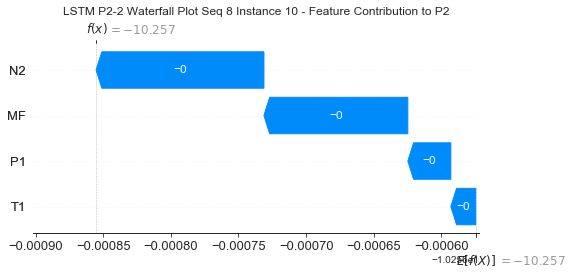

None

Contribution: [-3.55213341e-05 -1.93669551e-05 -1.28879479e-04 -1.17652264e-04]


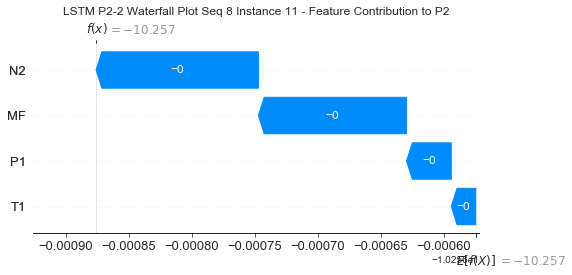

None

Contribution: [-3.47895095e-05 -1.98439998e-05 -1.34196344e-04 -1.23258529e-04]


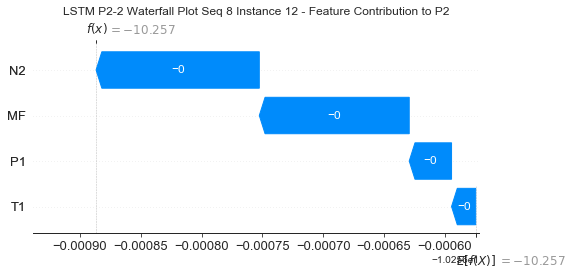

None

Contribution: [-3.52476470e-05 -2.13376326e-05 -1.40498585e-04 -1.31396825e-04]


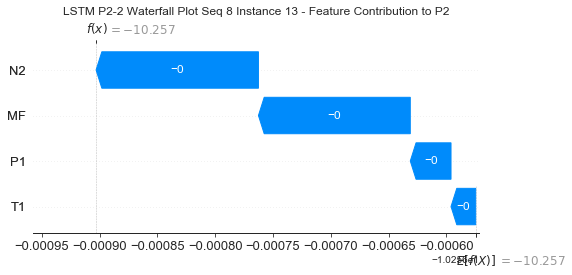

None

Contribution: [-3.03405330e-05 -1.98009423e-05 -1.42430402e-04 -1.23343704e-04]


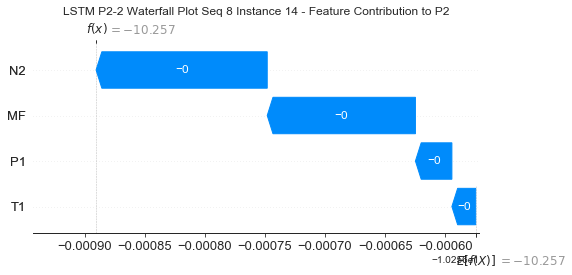

None

Contribution: [-3.38226642e-05 -2.25896699e-05 -1.50359565e-04 -1.42936945e-04]


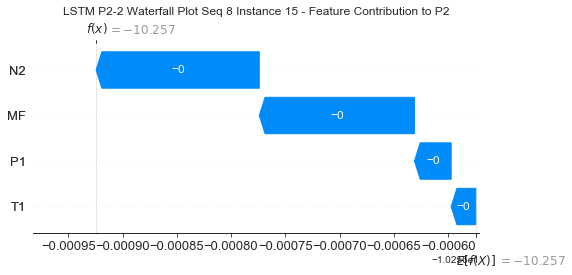

None

Contribution: [-3.31263952e-05 -2.20947264e-05 -1.49728421e-04 -1.41442121e-04]


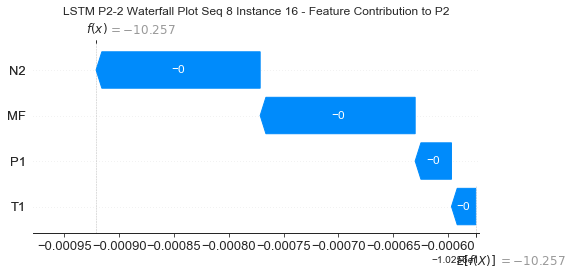

None

Contribution: [-3.32486610e-05 -2.19332805e-05 -1.46095319e-04 -1.36816104e-04]


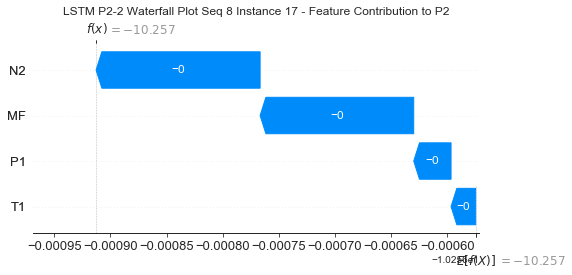

None

Contribution: [-3.08509645e-05 -2.54935573e-05 -1.71913910e-04 -1.70010754e-04]


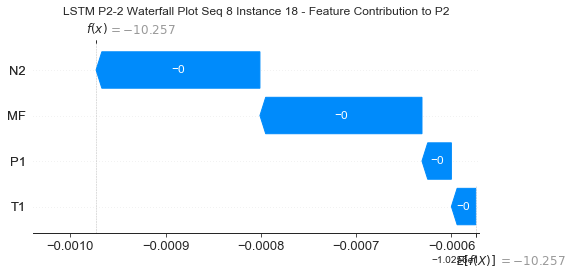

None

Contribution: [-1.64834909e-05 -4.39016927e-05 -2.80604740e-04 -3.02041369e-04]


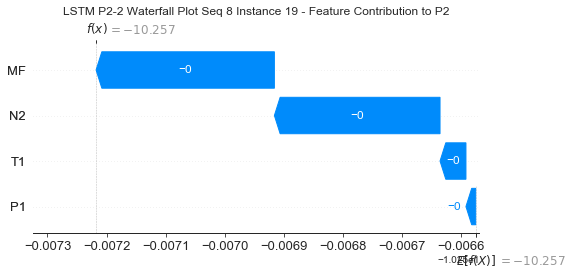

None

Contribution: [-1.09730517e-05 -5.71599073e-05 -3.34605334e-04 -3.63177990e-04]


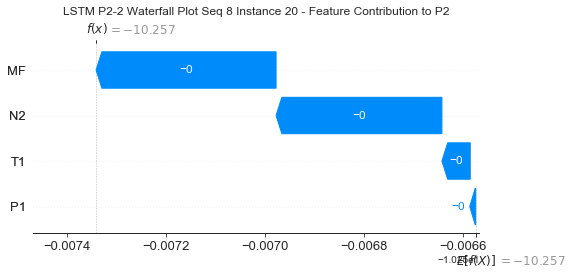

None

Contribution: [-8.55662633e-05  4.72937420e-05  3.05949725e-04  4.61278153e-04]


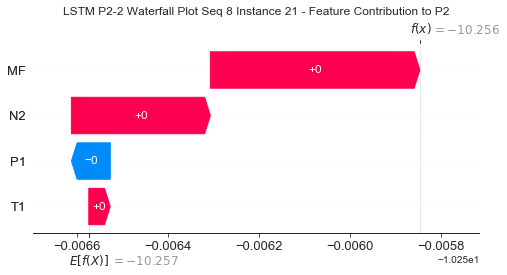

None

Contribution: [-0.00037599  0.00026603  0.00211132  0.00272542]


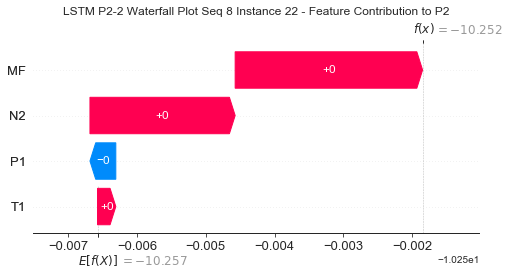

None

Contribution: [ 0.00074387 -0.00044625 -0.00679802 -0.00868186]


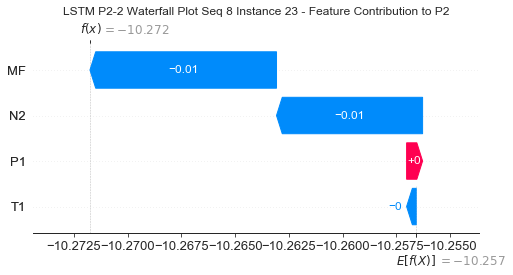

None

Contribution: [-0.00103848  0.02394292 -0.02694249 -0.01734553]


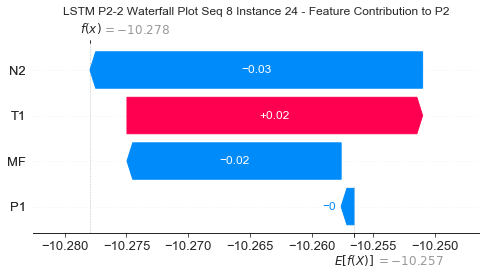

None

Contribution: [-0.01418839 -0.06030014 -0.06805762 -0.04566583]


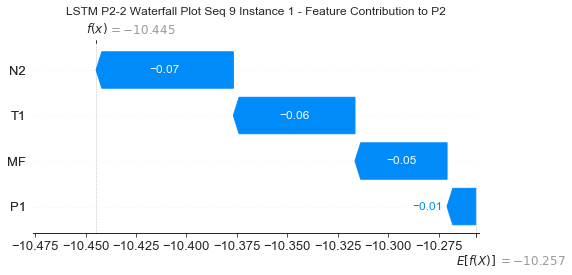

None

Contribution: [4.78293404e-04 5.98128396e-05 1.61701084e-03 1.49047982e-03]


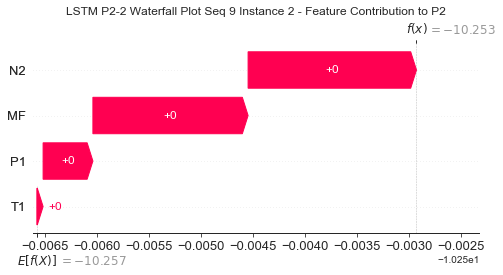

None

Contribution: [-9.45960464e-06 -1.01875612e-05 -1.33607036e-04 -1.33394786e-04]


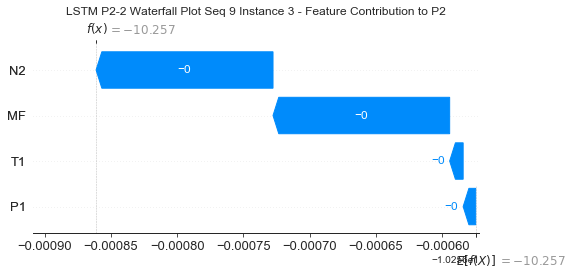

None

Contribution: [-3.24947930e-05 -4.04937494e-05 -2.16079459e-04 -2.18311165e-04]


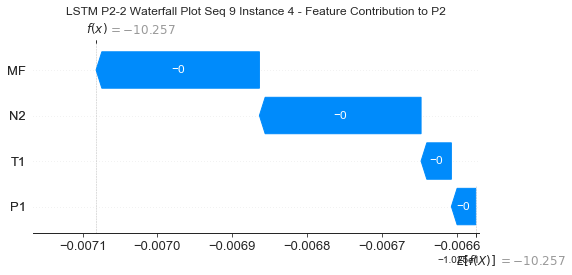

None

Contribution: [-2.88128979e-05 -3.17365207e-05 -1.86980355e-04 -1.83046477e-04]


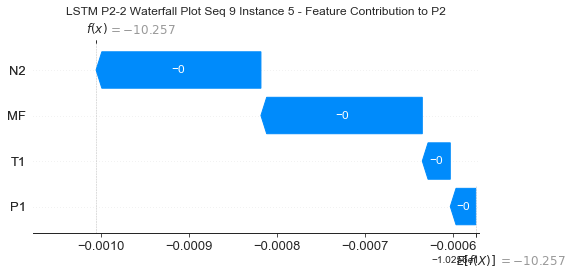

None

Contribution: [-2.90337754e-05 -3.07592691e-05 -1.65818608e-04 -1.64152893e-04]


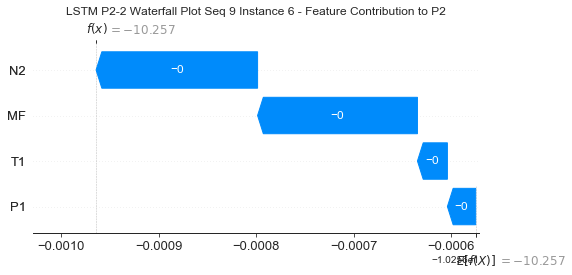

None

Contribution: [-1.92176940e-05 -2.83438300e-05 -1.45127019e-04 -1.18349419e-04]


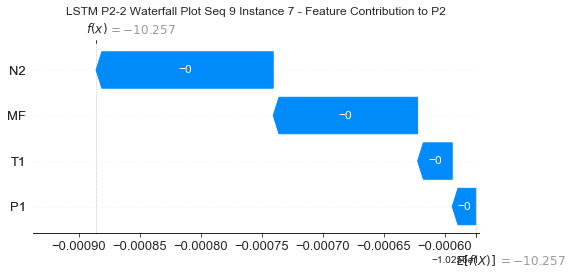

None

Contribution: [-1.46112150e-05 -2.30723615e-05 -1.29102311e-04 -8.34205873e-05]


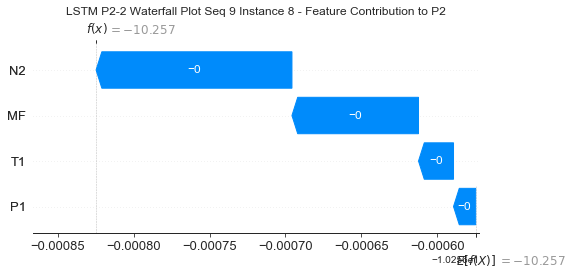

None

Contribution: [-1.94234507e-05 -2.18768846e-05 -1.26926575e-04 -9.70460534e-05]


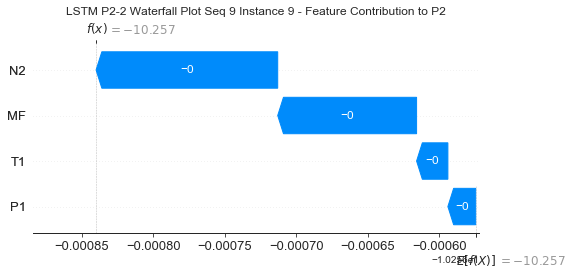

None

Contribution: [-3.22278192e-05 -2.12299399e-05 -1.26905953e-04 -1.10548775e-04]


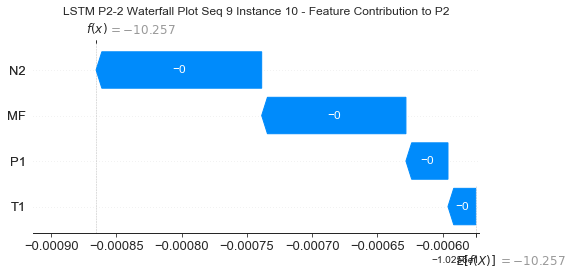

None

Contribution: [-3.56948431e-05 -2.27347395e-05 -1.31652122e-04 -1.21456751e-04]


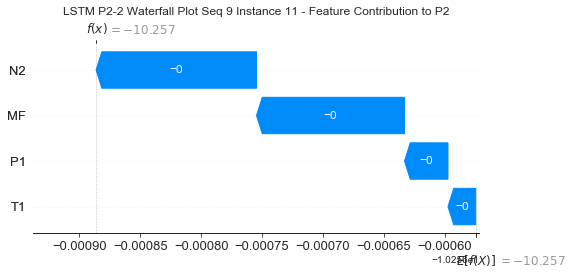

None

Contribution: [-3.50752570e-05 -2.37050218e-05 -1.36567981e-04 -1.26543622e-04]


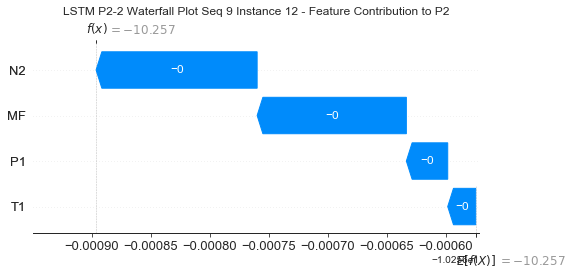

None

Contribution: [-3.52370524e-05 -2.46828354e-05 -1.42781903e-04 -1.34209066e-04]


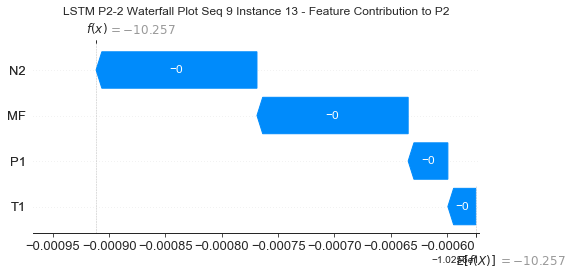

None

Contribution: [-3.04811747e-05 -2.32767233e-05 -1.44871647e-04 -1.26756716e-04]


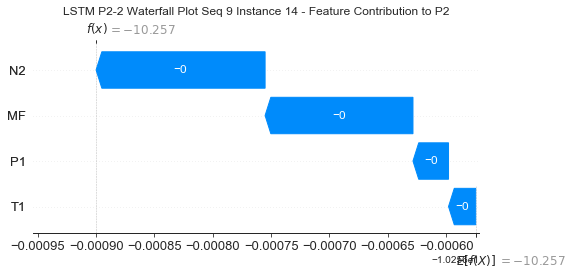

None

Contribution: [-3.45503031e-05 -2.72011693e-05 -1.52871126e-04 -1.46290812e-04]


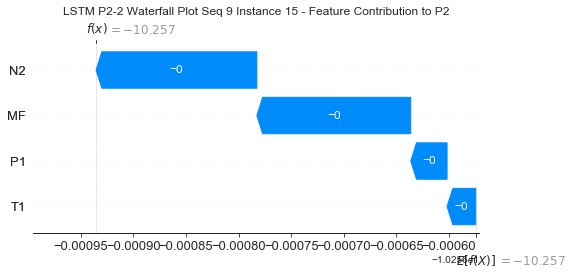

None

Contribution: [-3.48885926e-05 -2.69948105e-05 -1.52322871e-04 -1.45731329e-04]


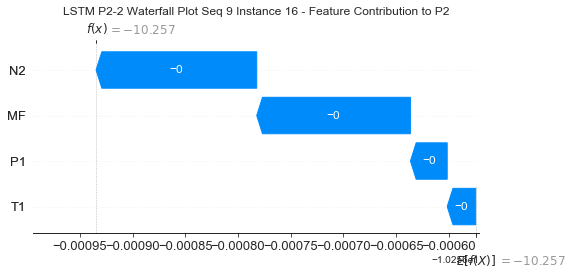

None

Contribution: [-3.35802487e-05 -2.63322731e-05 -1.48410617e-04 -1.39607288e-04]


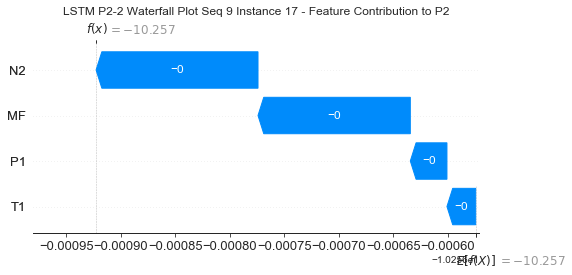

None

Contribution: [-3.15454371e-05 -2.97448984e-05 -1.71858179e-04 -1.70099494e-04]


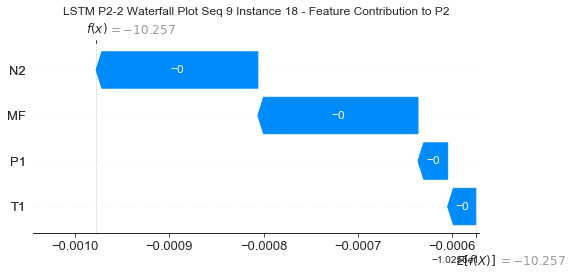

None

Contribution: [-1.76757261e-05 -5.33285969e-05 -2.76788774e-04 -2.99338566e-04]


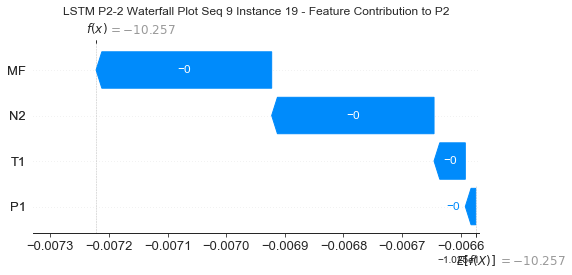

None

Contribution: [-9.95797967e-06 -7.22669077e-05 -3.41903338e-04 -3.72001217e-04]


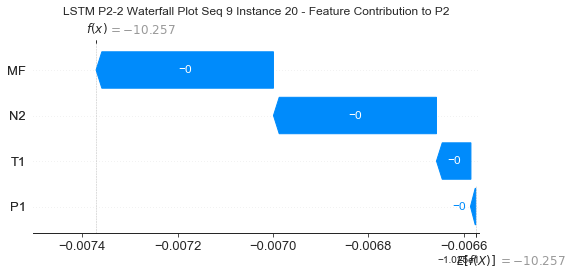

None

Contribution: [-8.34569810e-05  4.84276163e-05  2.48842990e-04  3.91382564e-04]


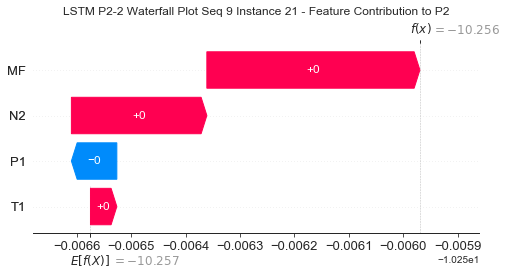

None

Contribution: [-0.00036949  0.00038004  0.00201019  0.00253901]


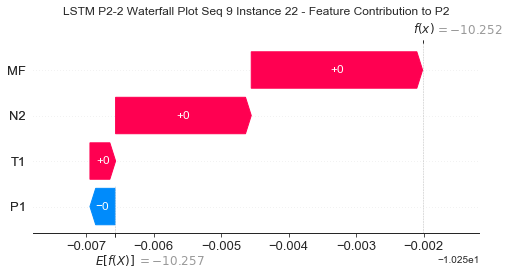

None

Contribution: [ 0.00073719 -0.00106949 -0.00653855 -0.00819442]


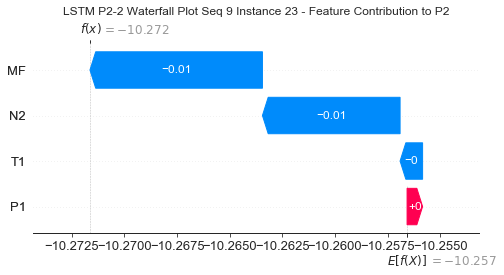

None

Contribution: [ 0.00069645  0.00721578 -0.02852823 -0.03747387]


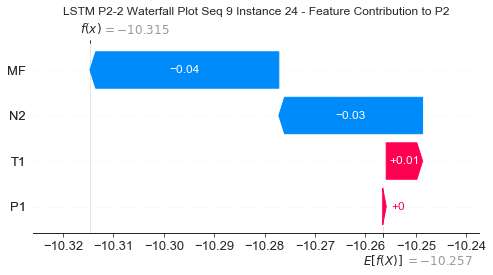

None

Contribution: [-0.01309955 -0.04016861 -0.06756766 -0.0483016 ]


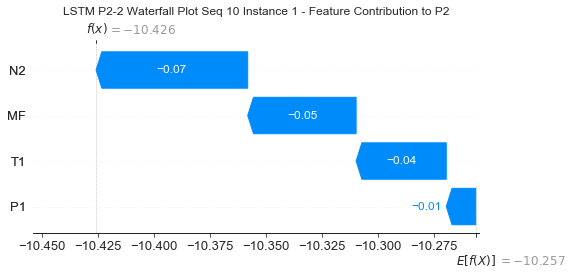

None

Contribution: [4.71528320e-04 8.80825139e-05 1.60374555e-03 1.49409642e-03]


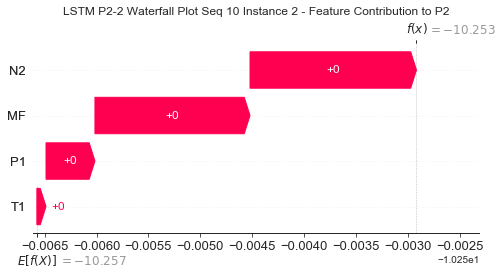

None

Contribution: [-1.03749737e-05 -1.41514256e-05 -1.33199492e-04 -1.32643289e-04]


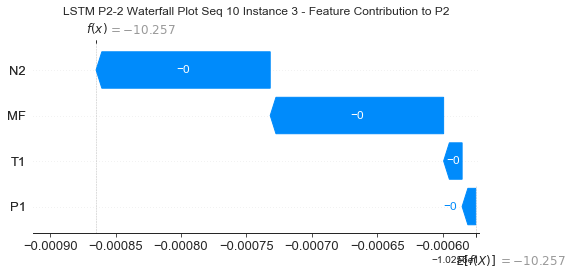

None

Contribution: [-3.42571947e-05 -4.81593857e-05 -2.15969239e-04 -2.17583870e-04]


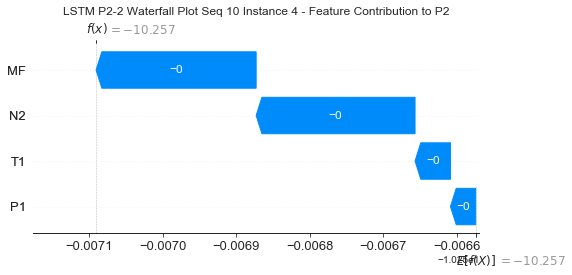

None

Contribution: [-3.21640706e-05 -4.11769808e-05 -1.87298931e-04 -1.89358115e-04]


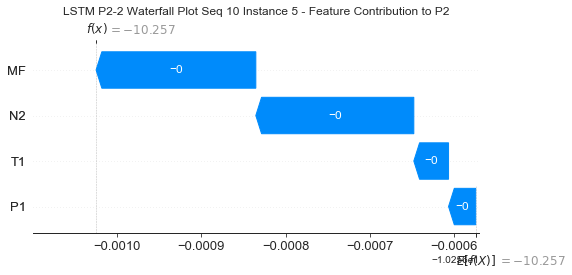

None

Contribution: [-3.04229900e-05 -3.37356960e-05 -1.64765365e-04 -1.62715495e-04]


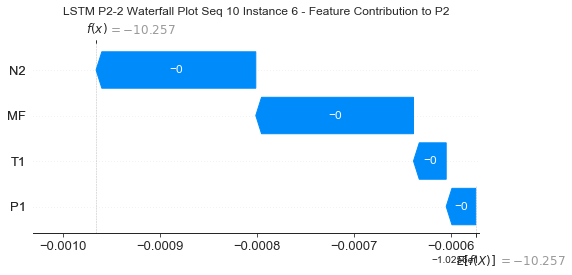

None

Contribution: [-1.87047230e-05 -2.71402350e-05 -1.43591987e-04 -1.14680615e-04]


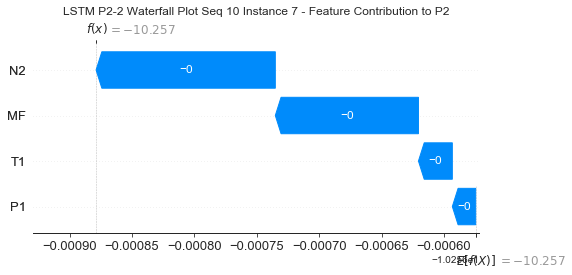

None

Contribution: [-1.59115783e-05 -2.16813273e-05 -1.27655055e-04 -8.12148136e-05]


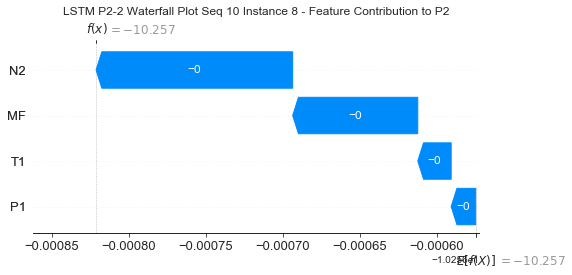

None

Contribution: [-1.91424544e-05 -2.15838922e-05 -1.25693754e-04 -9.49848507e-05]


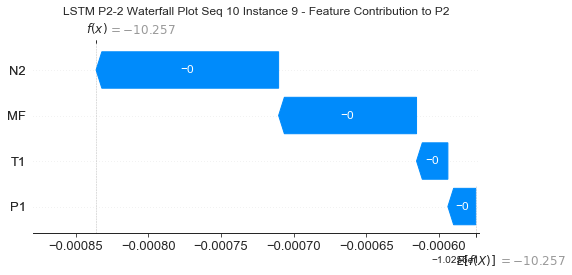

None

Contribution: [-3.29094355e-05 -2.15327927e-05 -1.25782862e-04 -1.09253693e-04]


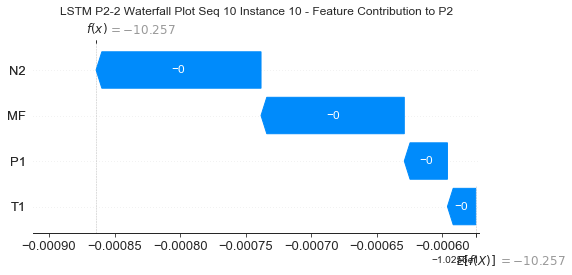

None

Contribution: [-3.63957715e-05 -2.27309569e-05 -1.30344723e-04 -1.19844984e-04]


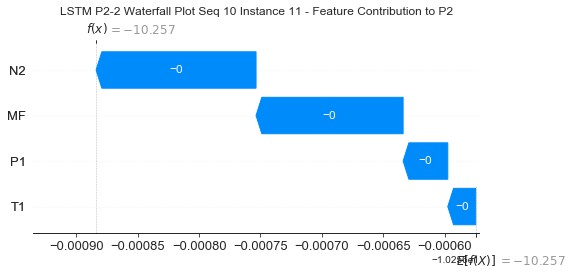

None

Contribution: [-3.59114846e-05 -2.26362827e-05 -1.35485001e-04 -1.25256104e-04]


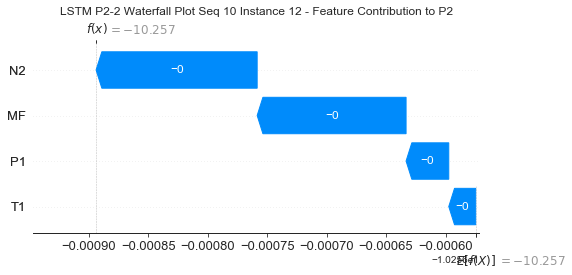

None

Contribution: [-3.58993535e-05 -2.45568814e-05 -1.41983677e-04 -1.33647436e-04]


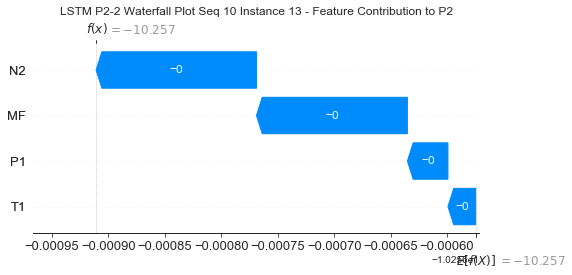

None

Contribution: [-3.05750527e-05 -2.40122953e-05 -1.43930313e-04 -1.26542635e-04]


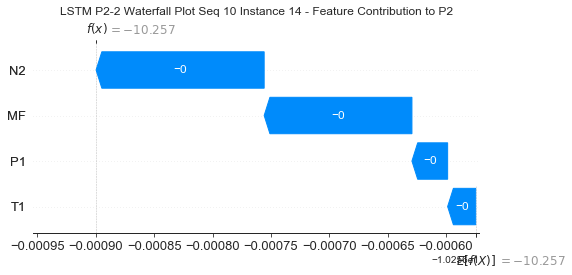

None

Contribution: [-3.49763667e-05 -2.63096803e-05 -1.51930388e-04 -1.45502275e-04]


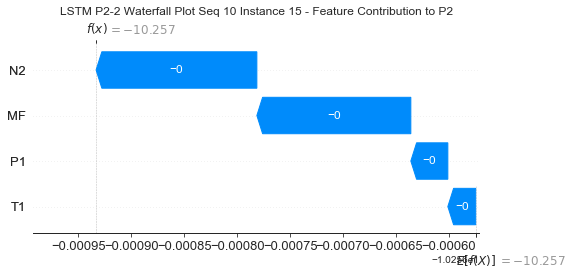

None

Contribution: [-3.51497026e-05 -2.58026624e-05 -1.51136097e-04 -1.44418356e-04]


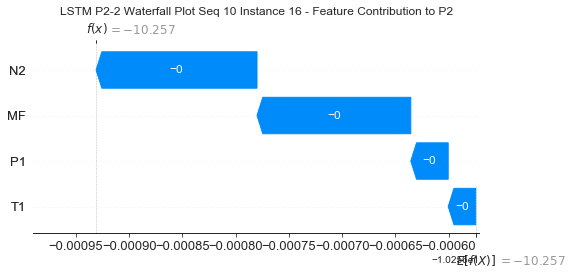

None

Contribution: [-3.49660389e-05 -2.45624580e-05 -1.47111449e-04 -1.38384787e-04]


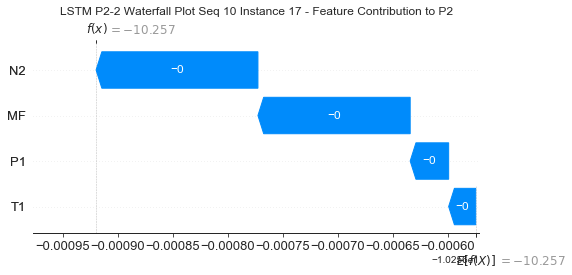

None

Contribution: [-3.23244907e-05 -2.86012316e-05 -1.71502423e-04 -1.70267678e-04]


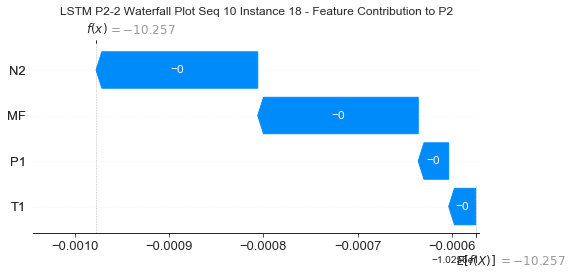

None

Contribution: [-1.77757209e-05 -5.10130441e-05 -2.79013211e-04 -3.03667737e-04]


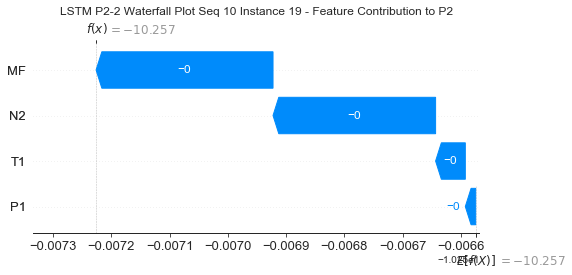

None

Contribution: [-1.03338429e-05 -6.75329069e-05 -3.41472568e-04 -3.75813127e-04]


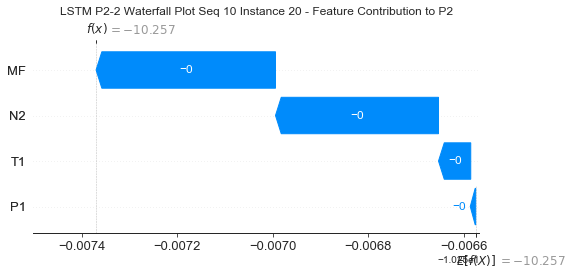

None

Contribution: [-8.64652435e-05  4.85048199e-05  2.70426543e-04  4.23875612e-04]


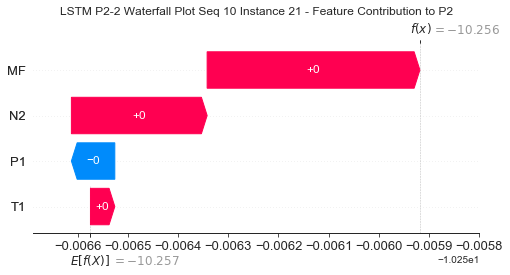

None

Contribution: [-0.00038494  0.00034415  0.00205896  0.00265801]


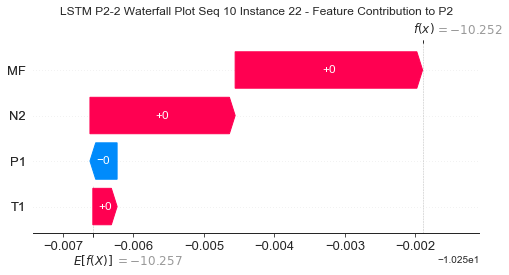

None

Contribution: [ 0.00079724 -0.00087241 -0.0066559  -0.00835225]


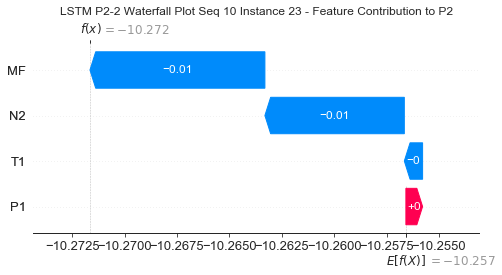

None

Contribution: [ 0.00127954  0.01089308 -0.02919088 -0.03782786]


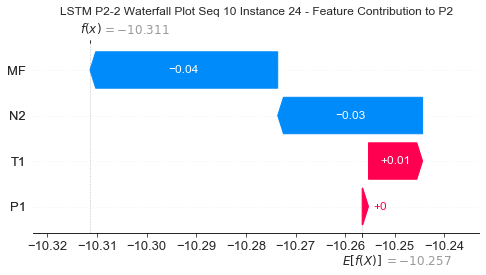

None

Contribution: [-0.01556897 -0.04382233 -0.06730724 -0.05123498]


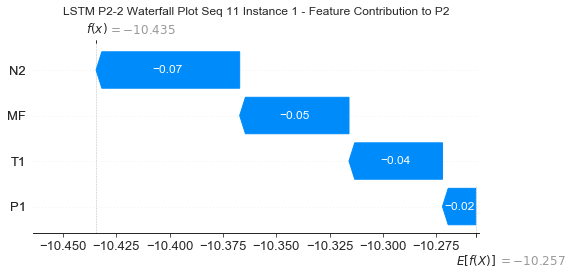

None

Contribution: [5.04852456e-04 8.97250398e-05 1.57044637e-03 1.49622966e-03]


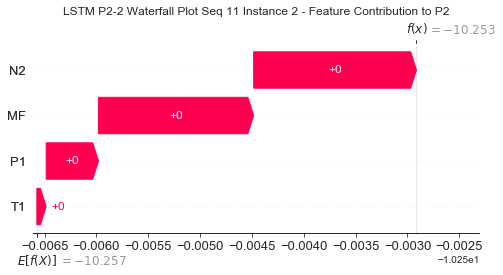

None

Contribution: [-1.13025005e-05 -1.23719756e-05 -1.32172996e-04 -1.35944484e-04]


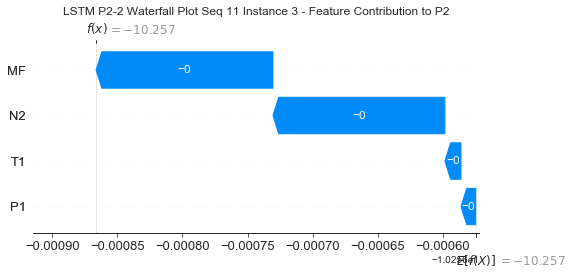

None

Contribution: [-3.61047873e-05 -4.26477600e-05 -2.15312715e-04 -2.22694626e-04]


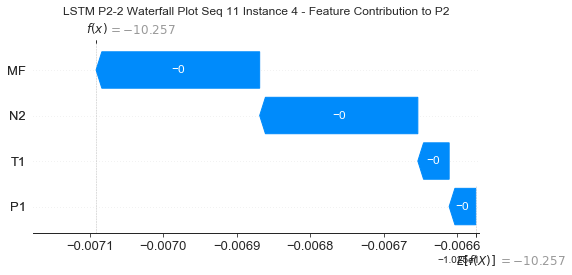

None

Contribution: [-3.48385730e-05 -4.21314768e-05 -1.88341906e-04 -1.91834807e-04]


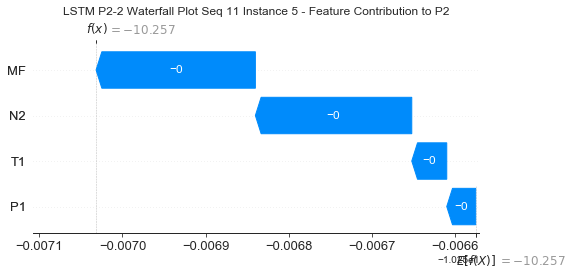

None

Contribution: [-3.22224595e-05 -3.20086560e-05 -1.66246133e-04 -1.67214376e-04]


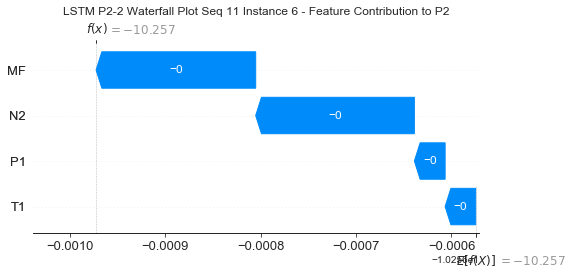

None

Contribution: [-2.21764843e-05 -2.89433815e-05 -1.45851796e-04 -1.20724284e-04]


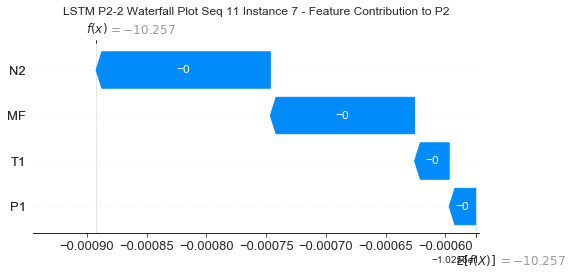

None

Contribution: [-1.74437184e-05 -2.25841839e-05 -1.29917065e-04 -8.51649797e-05]


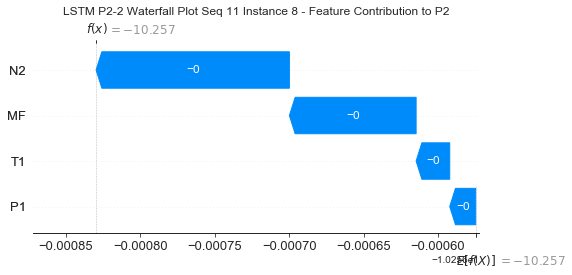

None

Contribution: [-2.18418024e-05 -2.28893545e-05 -1.27295459e-04 -9.82358643e-05]


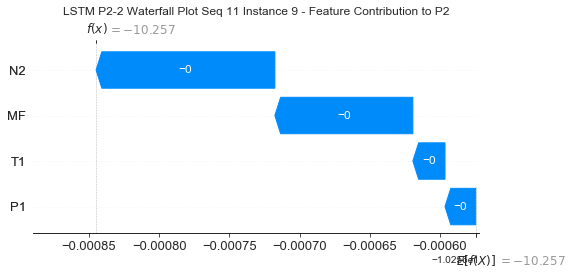

None

Contribution: [-3.42357343e-05 -1.74443183e-05 -1.26856863e-04 -1.11200443e-04]


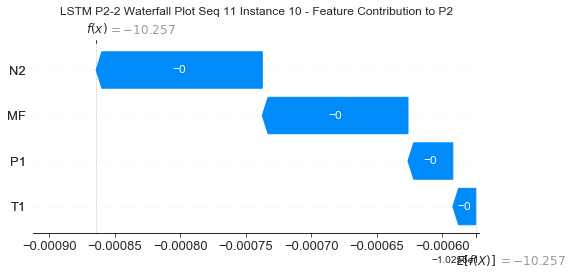

None

Contribution: [-3.78013969e-05 -1.84795274e-05 -1.31272990e-04 -1.21874738e-04]


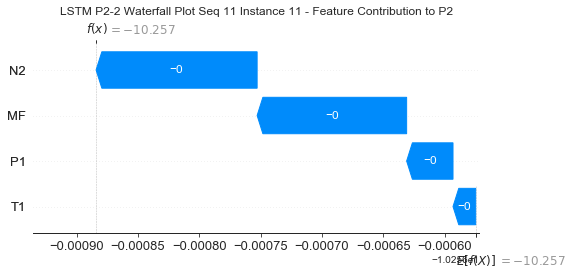

None

Contribution: [-3.66605056e-05 -1.58516003e-05 -1.36794536e-04 -1.28314443e-04]


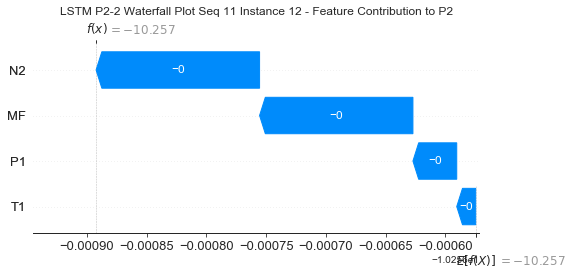

None

Contribution: [-3.69729465e-05 -1.99102184e-05 -1.42714824e-04 -1.35020484e-04]


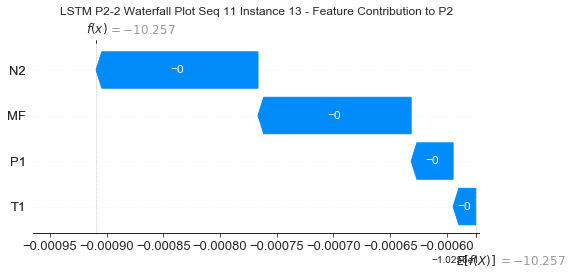

None

Contribution: [-3.15375878e-05 -1.64997713e-05 -1.45264751e-04 -1.28245448e-04]


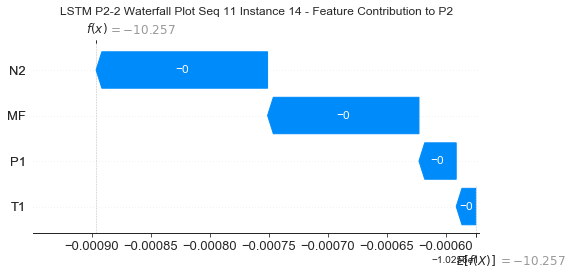

None

Contribution: [-3.58383380e-05 -2.14708782e-05 -1.53080694e-04 -1.47210525e-04]


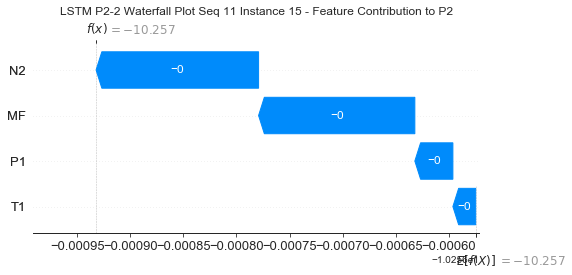

None

Contribution: [-3.59818614e-05 -2.21689620e-05 -1.52887000e-04 -1.46850776e-04]


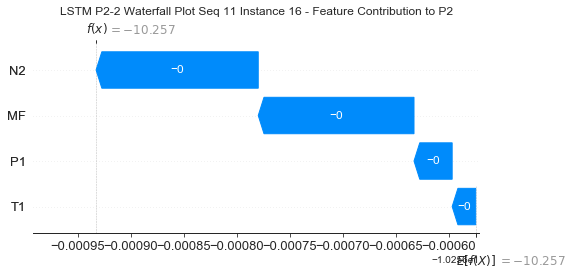

None

Contribution: [-3.66225402e-05 -2.33822733e-05 -1.48914275e-04 -1.42082420e-04]


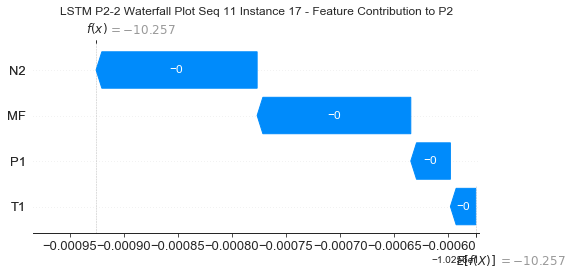

None

Contribution: [-3.34787219e-05 -2.76552800e-05 -1.72872241e-04 -1.72208172e-04]


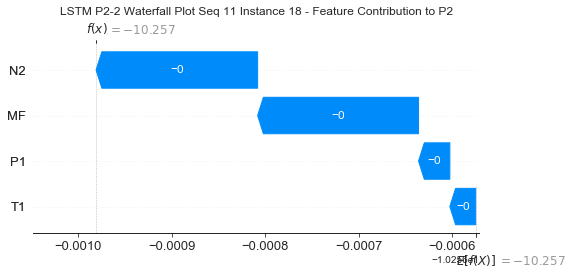

None

Contribution: [-1.84295593e-05 -4.89872900e-05 -2.79786552e-04 -3.04970541e-04]


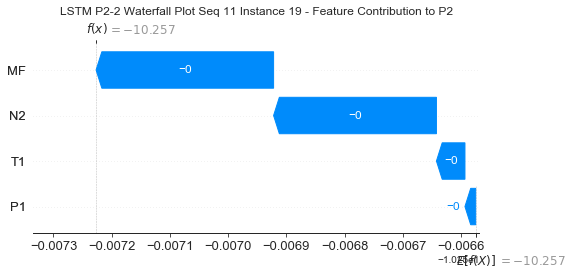

None

Contribution: [-9.75316364e-06 -6.68055498e-05 -3.47102299e-04 -3.82277375e-04]


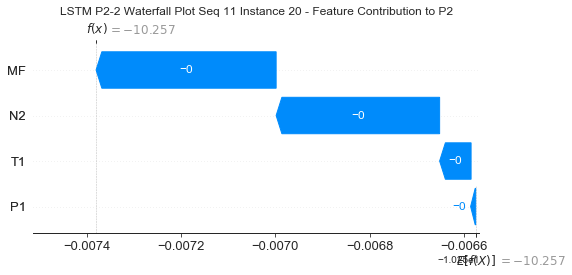

None

Contribution: [-8.55985757e-05  3.95340504e-05  2.44439499e-04  3.88265985e-04]


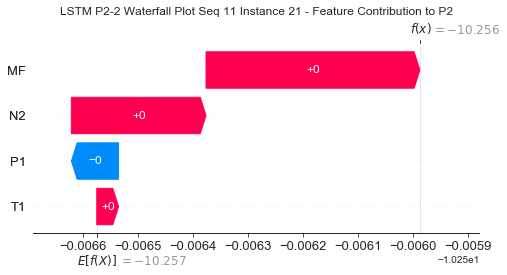

None

Contribution: [-0.00038949  0.00033136  0.00201296  0.00258259]


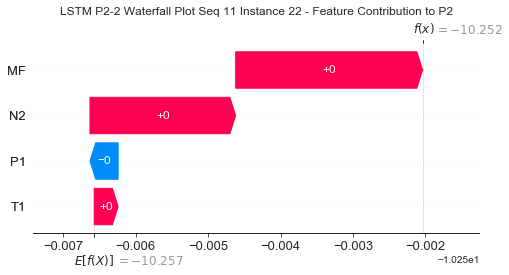

None

Contribution: [ 0.00084479 -0.00112471 -0.00645989 -0.00842675]


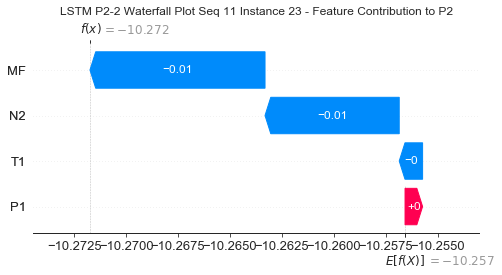

None

Contribution: [ 0.00225547  0.00437586 -0.02932378 -0.04092221]


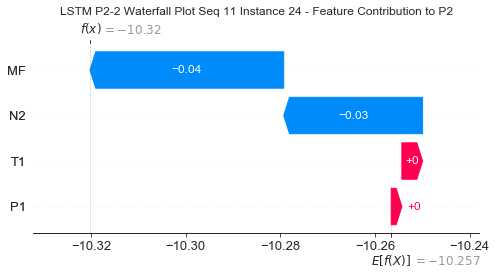

None

Contribution: [-0.01692198 -0.03531235 -0.06707355 -0.05191354]


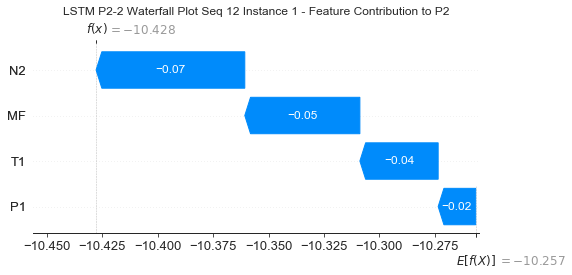

None

Contribution: [5.01175363e-04 9.66955391e-05 1.55115845e-03 1.45914771e-03]


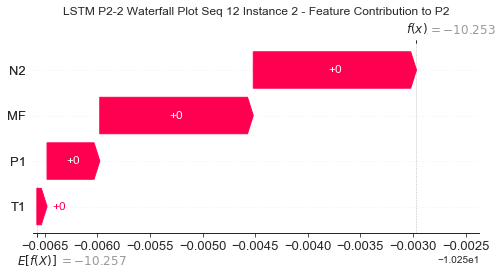

None

Contribution: [-1.14016883e-05 -1.54865136e-05 -1.30983106e-04 -1.31792426e-04]


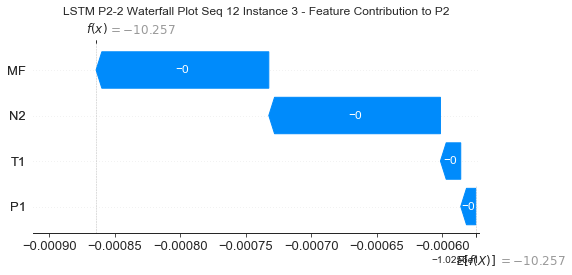

None

Contribution: [-3.64184874e-05 -5.34903215e-05 -2.13336889e-04 -2.17084696e-04]


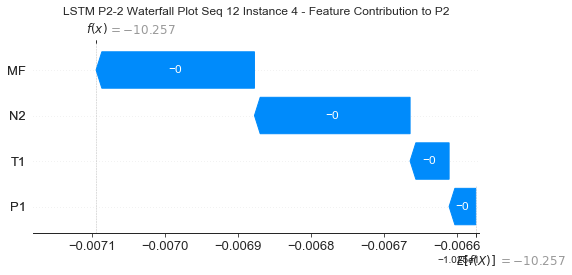

None

Contribution: [-3.34927156e-05 -4.46329794e-05 -1.87274919e-04 -1.87962599e-04]


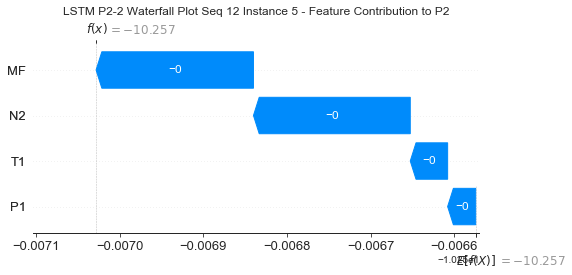

None

Contribution: [-3.26026796e-05 -3.78549949e-05 -1.65514344e-04 -1.65175270e-04]


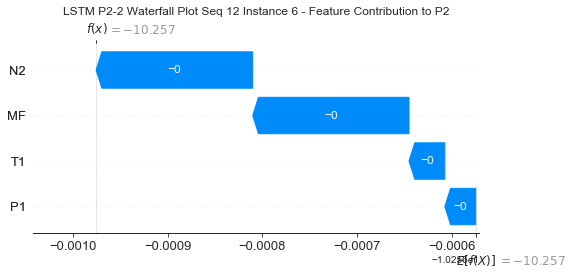

None

Contribution: [-2.37155999e-05 -3.09167189e-05 -1.44929822e-04 -1.21031317e-04]


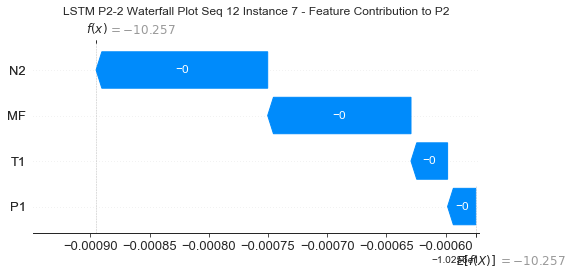

None

Contribution: [-1.82394698e-05 -2.34150991e-05 -1.28500829e-04 -8.32161649e-05]


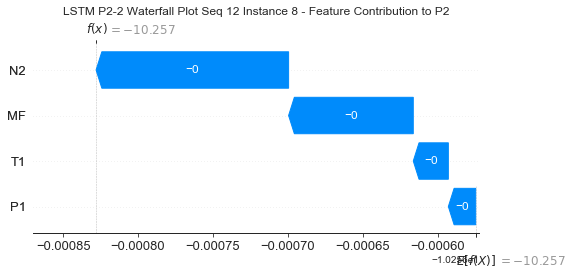

None

Contribution: [-2.25512382e-05 -2.38582460e-05 -1.26791674e-04 -9.79263907e-05]


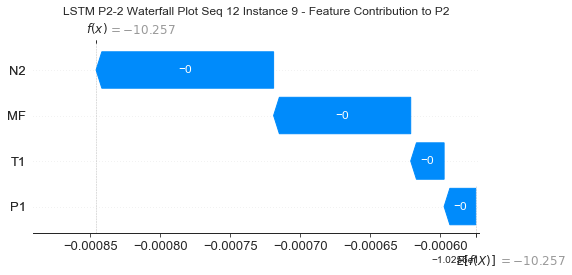

None

Contribution: [-3.53296148e-05 -2.47178086e-05 -1.26852536e-04 -1.11799179e-04]


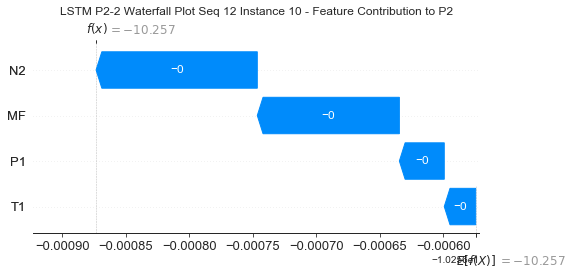

None

Contribution: [-3.89335201e-05 -2.62261540e-05 -1.31391035e-04 -1.22582537e-04]


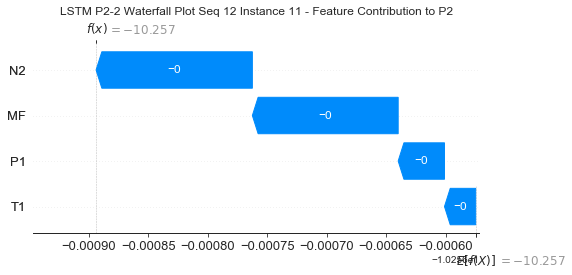

None

Contribution: [-3.71447190e-05 -2.69201110e-05 -1.36284998e-04 -1.27365992e-04]


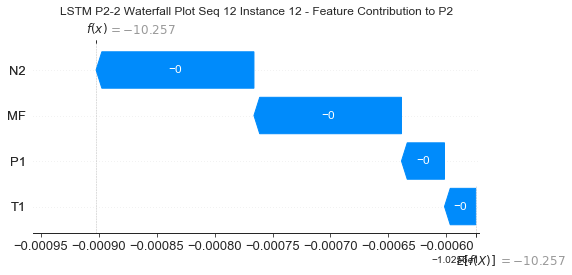

None

Contribution: [-3.80110694e-05 -2.86253905e-05 -1.43155262e-04 -1.36613216e-04]


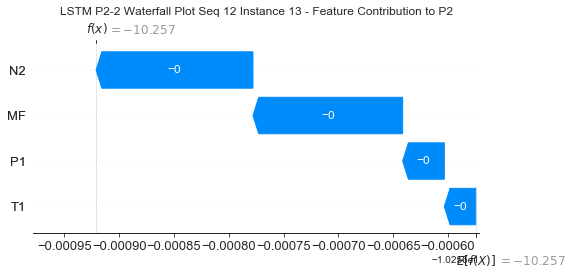

None

Contribution: [-3.40543022e-05 -2.78294081e-05 -1.45096530e-04 -1.31344809e-04]


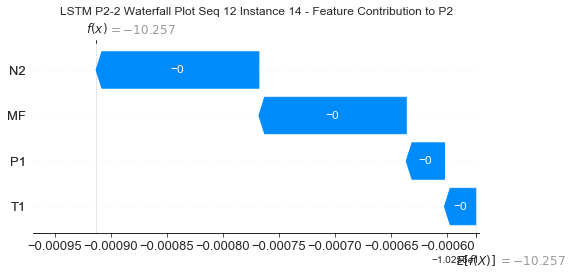

None

Contribution: [-3.71784752e-05 -3.08175970e-05 -1.52833254e-04 -1.48676638e-04]


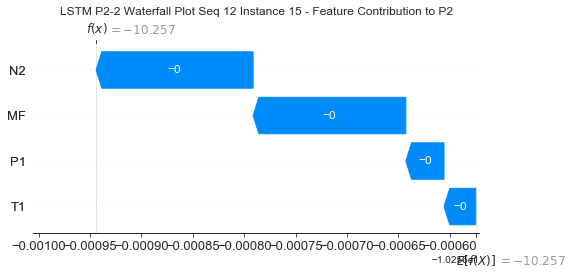

None

Contribution: [-3.71767841e-05 -3.01997736e-05 -1.52195311e-04 -1.47505789e-04]


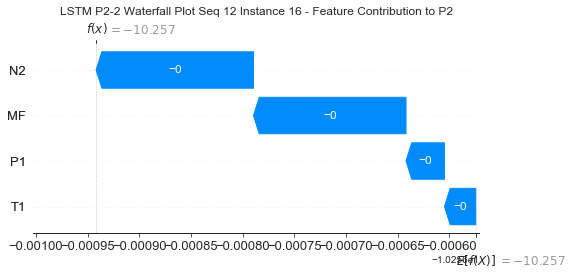

None

Contribution: [-3.65769502e-05 -2.81995861e-05 -1.48783807e-04 -1.41438164e-04]


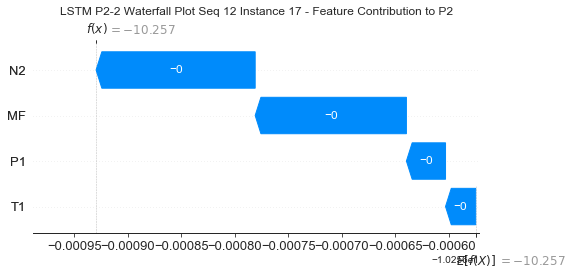

None

Contribution: [-3.46228687e-05 -3.30735206e-05 -1.71321156e-04 -1.72238721e-04]


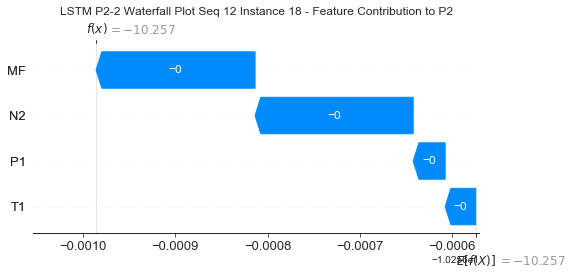

None

Contribution: [-1.97826647e-05 -6.01375536e-05 -2.72957637e-04 -3.01141640e-04]


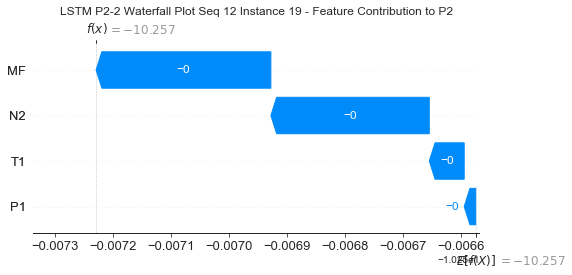

None

Contribution: [-1.08920892e-05 -8.42021502e-05 -3.38363377e-04 -3.79422258e-04]


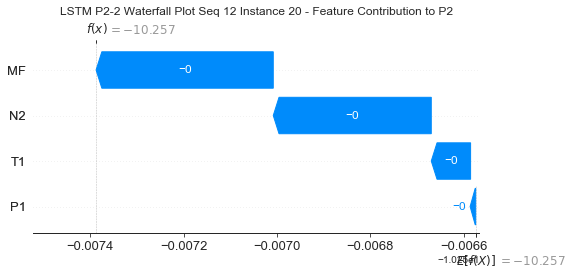

None

Contribution: [-8.61001157e-05  5.31707996e-05  2.33352717e-04  3.78751995e-04]


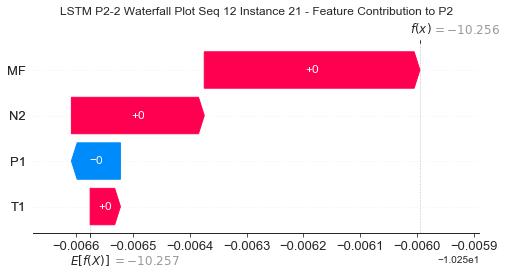

None

Contribution: [-0.00039283  0.0004709   0.00197049  0.00259681]


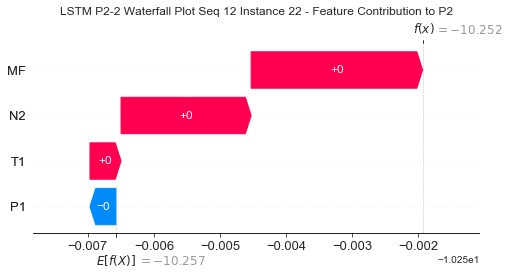

None

Contribution: [ 0.00083301 -0.00127696 -0.00640545 -0.00832725]


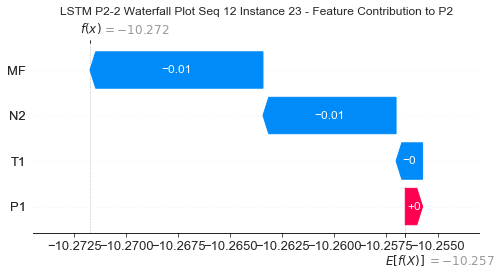

None

Contribution: [ 2.12852135e-03 -6.73588845e-05 -2.88653331e-02 -3.86723811e-02]


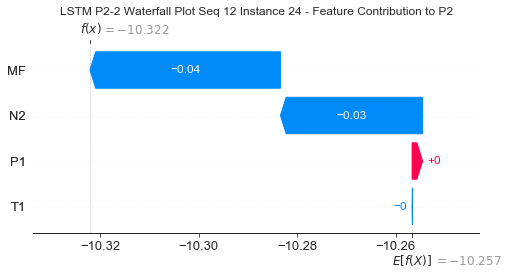

None

Contribution: [-0.01709791 -0.02117452 -0.06639384 -0.05243759]


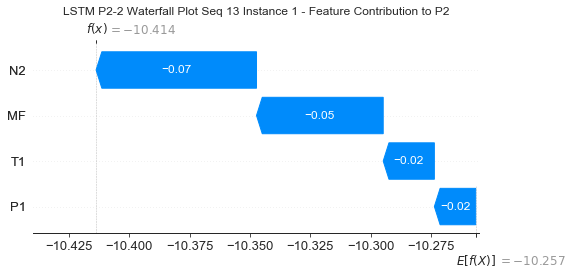

None

Contribution: [0.0005092  0.00010181 0.00154653 0.00148186]


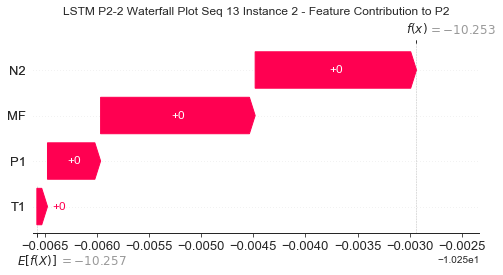

None

Contribution: [-1.13748465e-05 -1.59505932e-05 -1.31674565e-04 -1.34682553e-04]


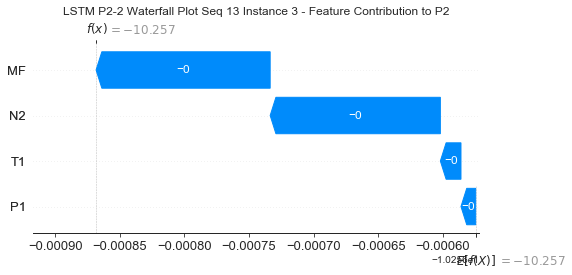

None

Contribution: [-3.63044143e-05 -5.34846790e-05 -2.14412863e-04 -2.21768784e-04]


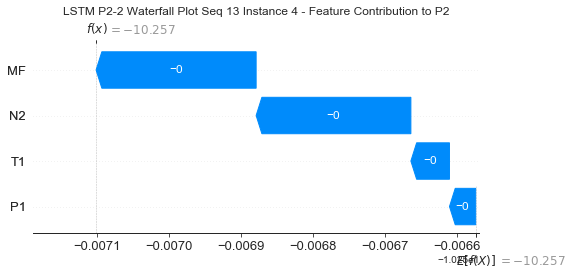

None

Contribution: [-3.53179619e-05 -4.48041450e-05 -1.87830114e-04 -1.92304663e-04]


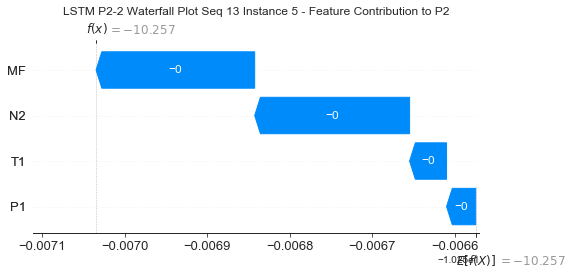

None

Contribution: [-3.23853001e-05 -3.70760670e-05 -1.65031887e-04 -1.65772082e-04]


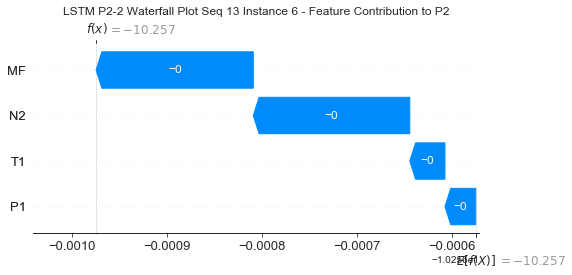

None

Contribution: [-2.08449032e-05 -2.89613304e-05 -1.43445917e-04 -1.16235516e-04]


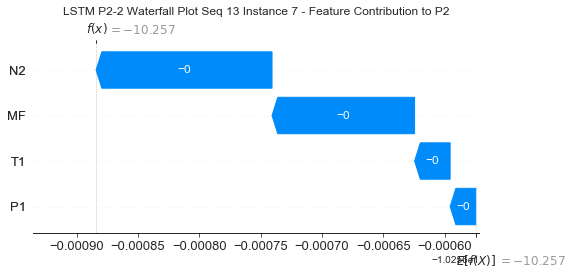

None

Contribution: [-1.64925641e-05 -2.20362726e-05 -1.27364143e-04 -8.12534637e-05]


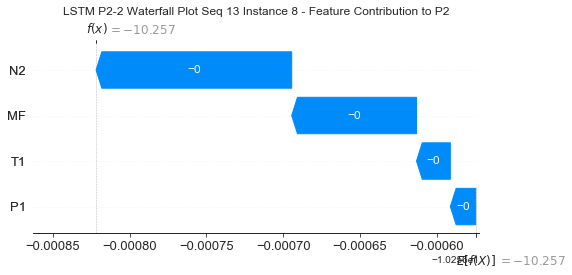

None

Contribution: [-2.14052378e-05 -2.27227562e-05 -1.25845738e-04 -9.61770560e-05]


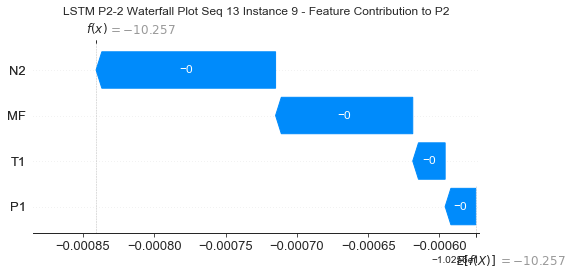

None

Contribution: [-3.55798800e-05 -2.33293826e-05 -1.26567861e-04 -1.12061713e-04]


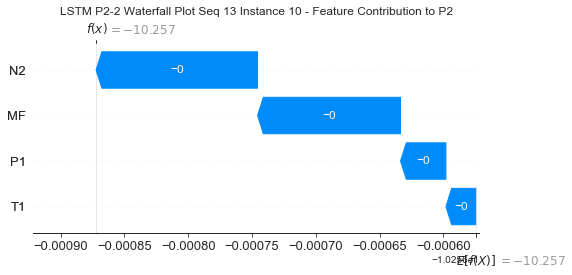

None

Contribution: [-3.87534099e-05 -2.48855113e-05 -1.31596576e-04 -1.23149776e-04]


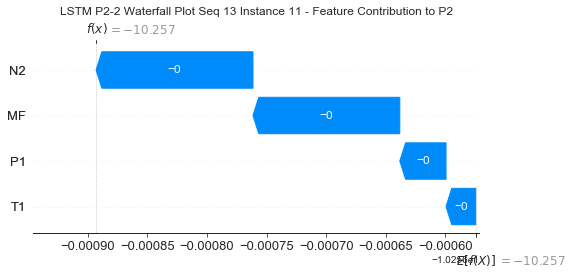

None

Contribution: [-3.86407128e-05 -2.56812368e-05 -1.36607524e-04 -1.29460293e-04]


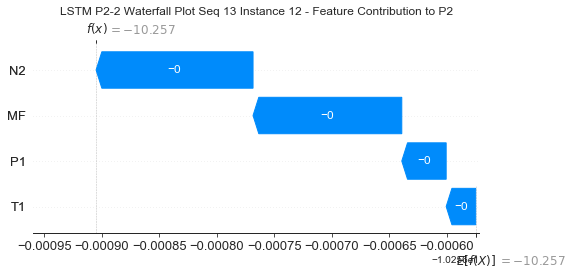

None

Contribution: [-3.81849394e-05 -2.68047688e-05 -1.42603365e-04 -1.36010072e-04]


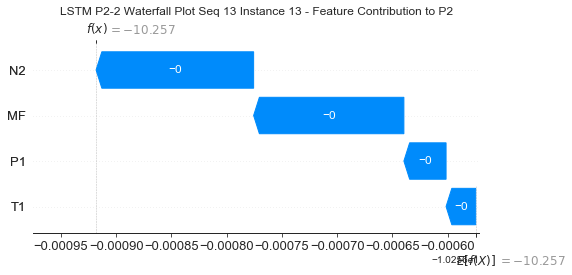

None

Contribution: [-3.23654561e-05 -2.52340526e-05 -1.44616354e-04 -1.27755241e-04]


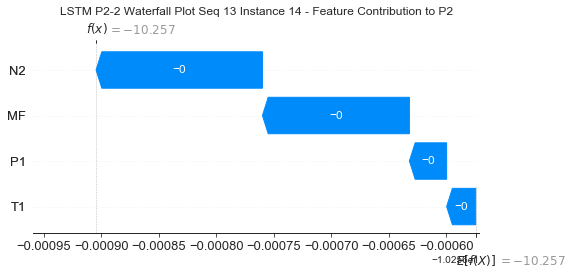

None

Contribution: [-3.69211997e-05 -2.86718241e-05 -1.52656691e-04 -1.47939989e-04]


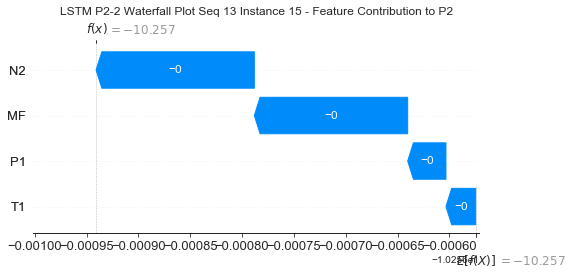

None

Contribution: [-3.68998478e-05 -2.83368270e-05 -1.52369845e-04 -1.47358001e-04]


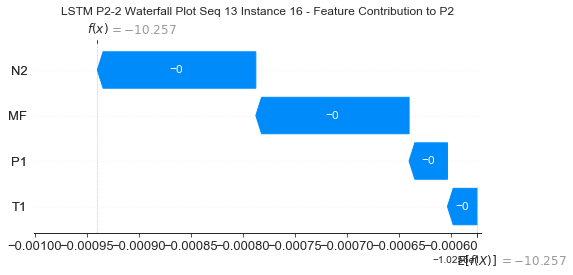

None

Contribution: [-3.68490134e-05 -2.81152096e-05 -1.48472542e-04 -1.41308568e-04]


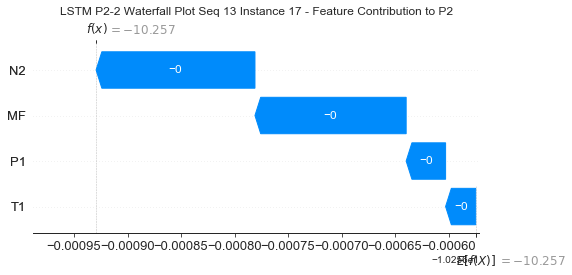

None

Contribution: [-3.36672768e-05 -3.17412348e-05 -1.71958817e-04 -1.71676302e-04]


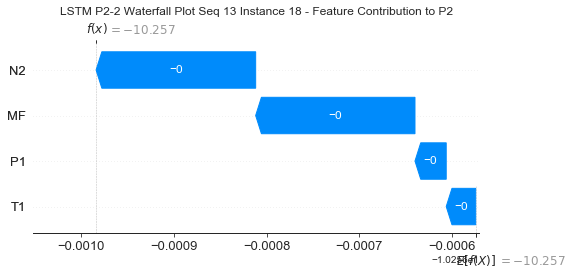

None

Contribution: [-1.88930199e-05 -5.77510117e-05 -2.76676922e-04 -3.03053025e-04]


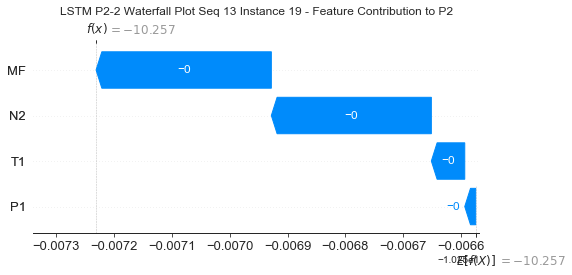

None

Contribution: [-1.05098357e-05 -8.05229966e-05 -3.41610289e-04 -3.79074663e-04]


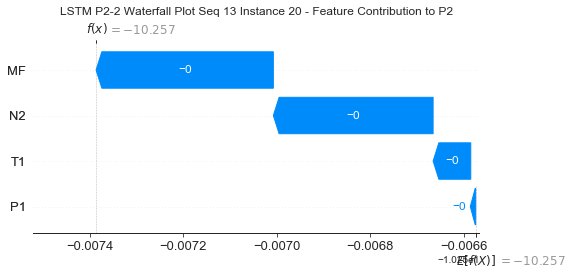

None

Contribution: [-8.72404311e-05  5.28253946e-05  2.47898450e-04  3.96852224e-04]


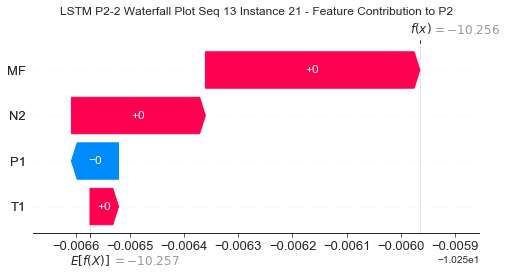

None

Contribution: [-0.00039352  0.00045587  0.00201368  0.00262641]


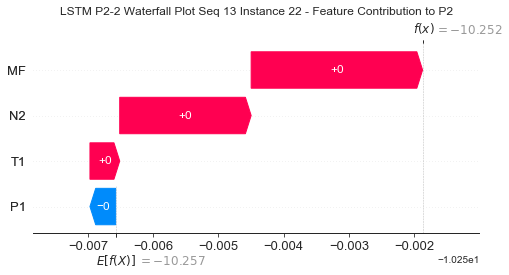

None

Contribution: [ 0.00079563 -0.00129263 -0.00645963 -0.00833738]


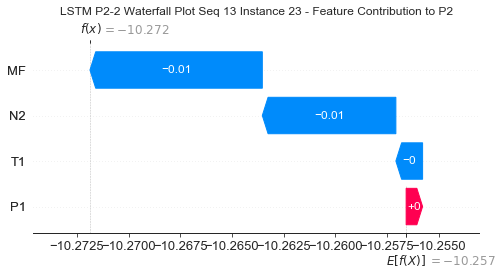

None

Contribution: [ 0.00158301  0.00298828 -0.02907073 -0.03907059]


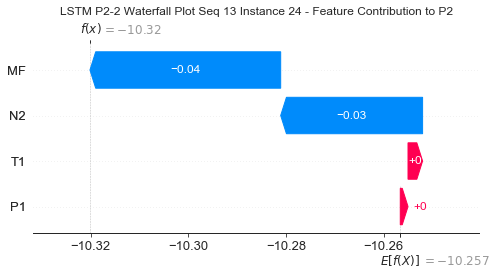

None

Contribution: [-0.01584594 -0.02537438 -0.06673163 -0.05046191]


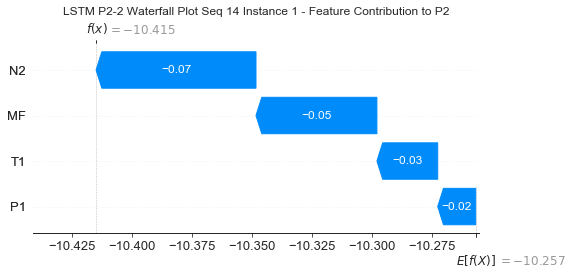

None

Contribution: [4.91231404e-04 9.93977484e-05 1.55412806e-03 1.45077340e-03]


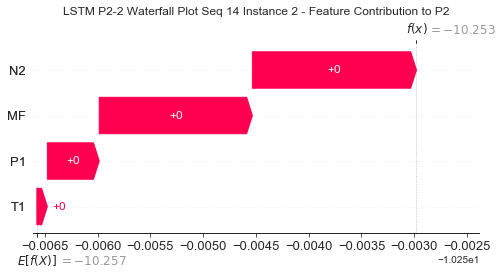

None

Contribution: [-1.12418781e-05 -1.56193784e-05 -1.32139004e-04 -1.33936595e-04]


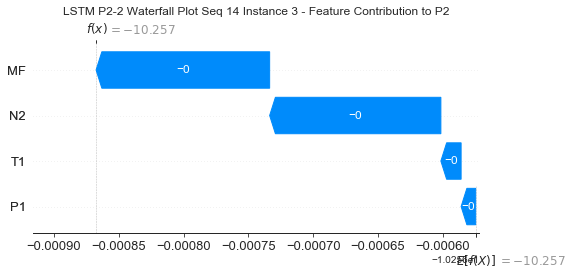

None

Contribution: [-3.58137707e-05 -5.37262663e-05 -2.14454032e-04 -2.19749894e-04]


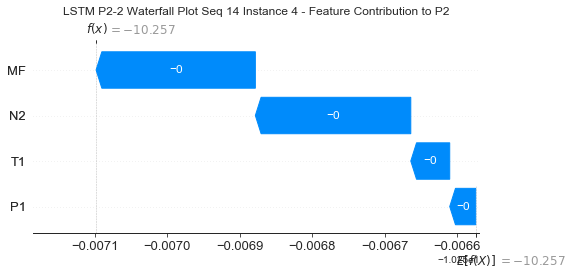

None

Contribution: [-3.35437986e-05 -4.05548258e-05 -1.87240810e-04 -1.88729069e-04]


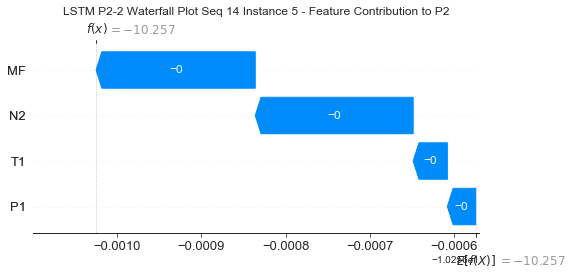

None

Contribution: [-3.18222171e-05 -3.78696623e-05 -1.65465745e-04 -1.65459906e-04]


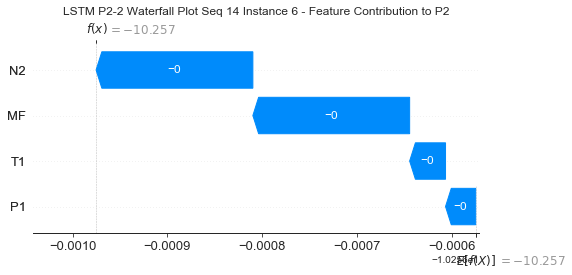

None

Contribution: [-2.12782641e-05 -3.07697626e-05 -1.44706544e-04 -1.18700272e-04]


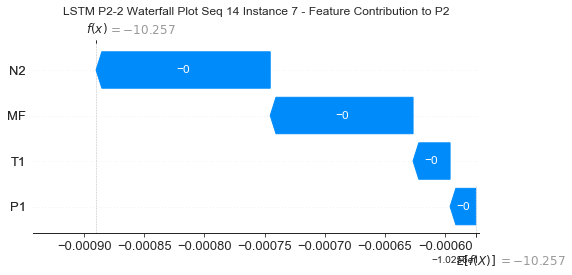

None

Contribution: [-1.64110588e-05 -2.45547680e-05 -1.28768869e-04 -8.35465558e-05]


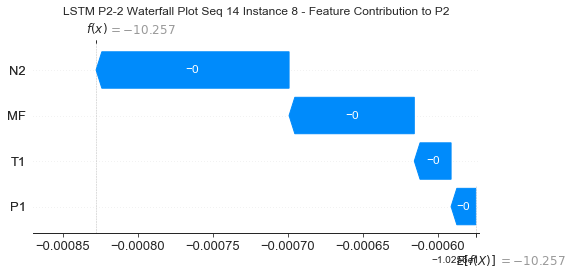

None

Contribution: [-2.11725092e-05 -2.48064919e-05 -1.26863385e-04 -9.76934208e-05]


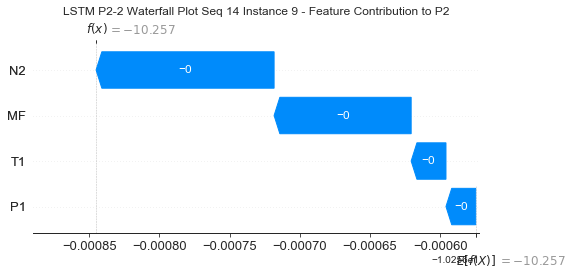

None

Contribution: [-3.39874894e-05 -2.48424918e-05 -1.26998702e-04 -1.11509779e-04]


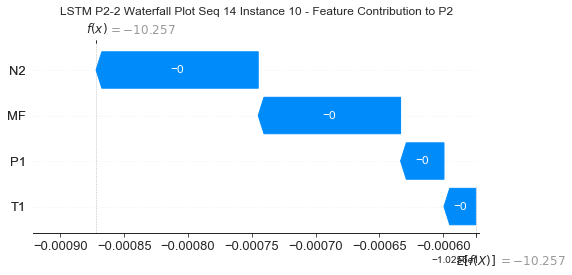

None

Contribution: [-3.73191321e-05 -2.63866594e-05 -1.31996570e-04 -1.22634650e-04]


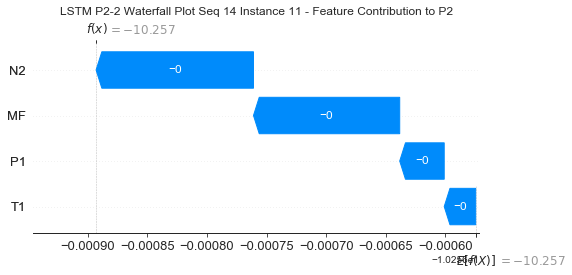

None

Contribution: [-3.66173515e-05 -2.75226179e-05 -1.37218445e-04 -1.29243083e-04]


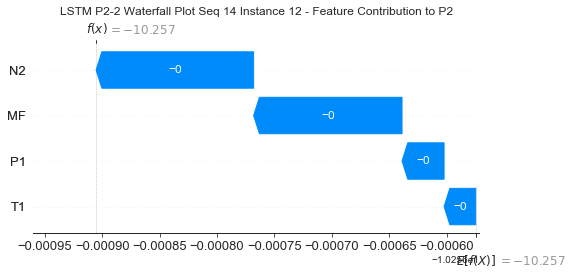

None

Contribution: [-3.66112941e-05 -2.87928711e-05 -1.43162341e-04 -1.35675574e-04]


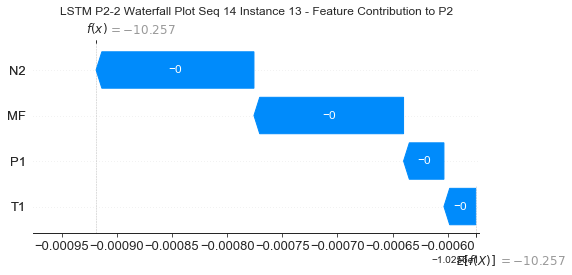

None

Contribution: [-3.09406674e-05 -2.69761123e-05 -1.45313230e-04 -1.28953783e-04]


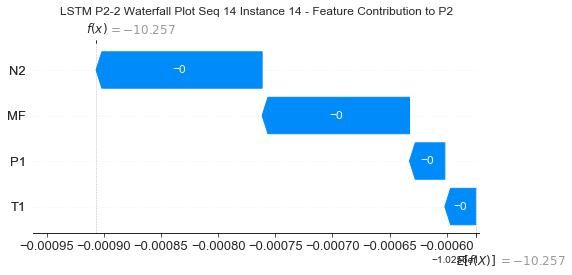

None

Contribution: [-3.54195127e-05 -3.10139002e-05 -1.53162150e-04 -1.47833501e-04]


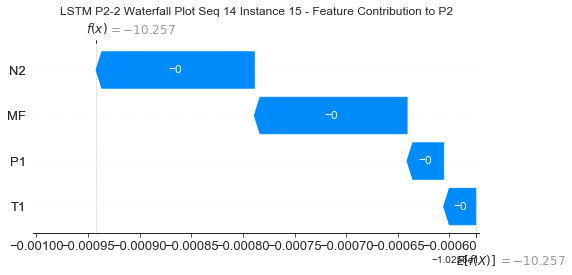

None

Contribution: [-3.55047147e-05 -3.07368533e-05 -1.52734707e-04 -1.47435853e-04]


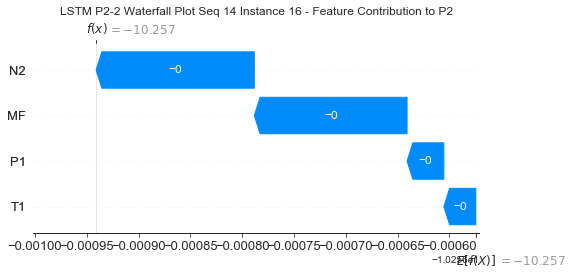

None

Contribution: [-3.54679030e-05 -2.79910300e-05 -1.49410627e-04 -1.42469441e-04]


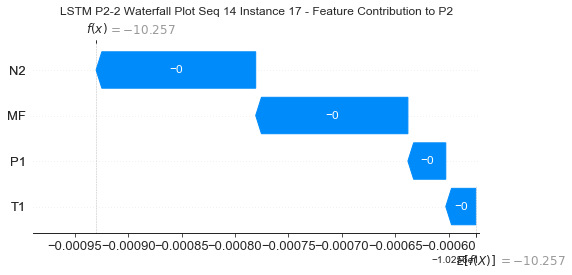

None

Contribution: [-3.29706372e-05 -3.37033970e-05 -1.71741120e-04 -1.71699840e-04]


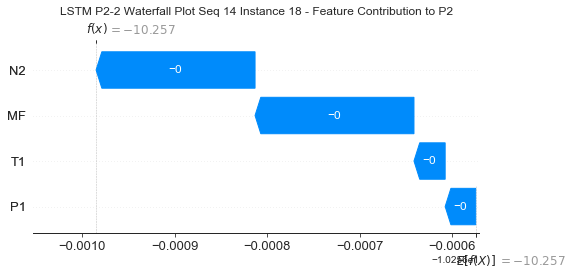

None

Contribution: [-1.88878827e-05 -6.20321434e-05 -2.73303866e-04 -2.99691425e-04]


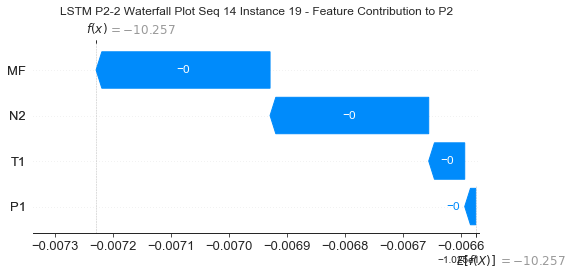

None

Contribution: [-1.04277351e-05 -8.90509093e-05 -3.40618555e-04 -3.78989900e-04]


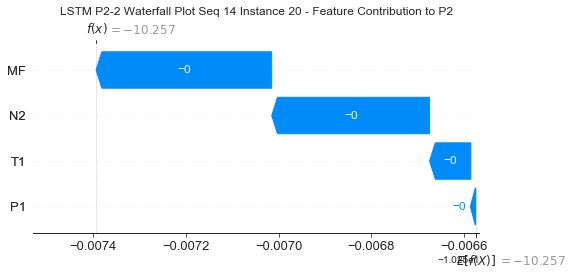

None

Contribution: [-8.20616046e-05  5.40851824e-05  2.24258452e-04  3.65586586e-04]


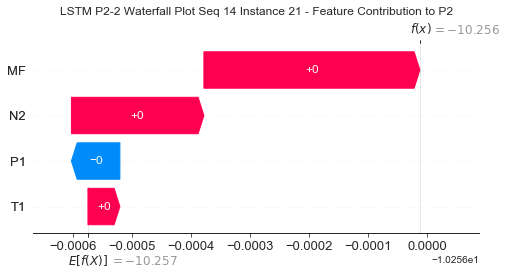

None

Contribution: [-0.00037853  0.00052057  0.00196555  0.00258774]


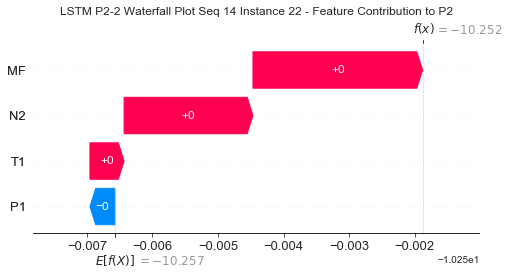

None

Contribution: [ 0.00080481 -0.00149248 -0.00634312 -0.00837513]


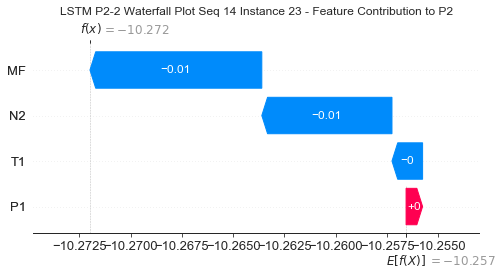

None

Contribution: [ 0.00172932 -0.00437197 -0.02880662 -0.03911453]


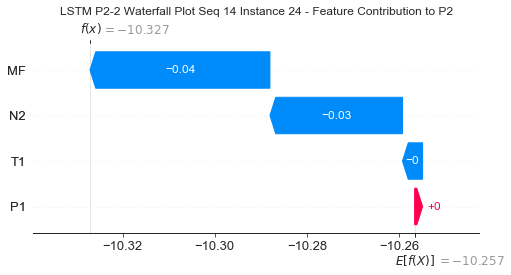

None

Contribution: [-0.01619539 -0.01054589 -0.06653481 -0.05045758]


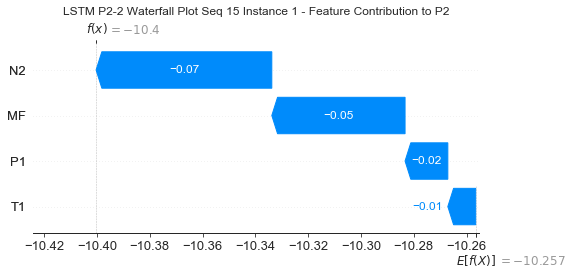

None

Contribution: [0.00049946 0.00011129 0.00154995 0.00147112]


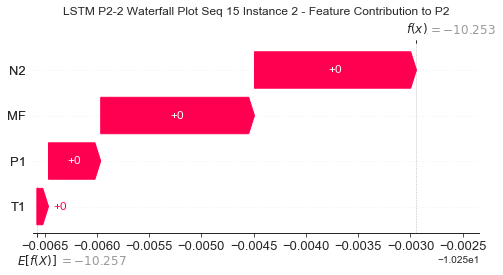

None

Contribution: [-1.10642350e-05 -1.92405233e-05 -1.32110852e-04 -1.32907747e-04]


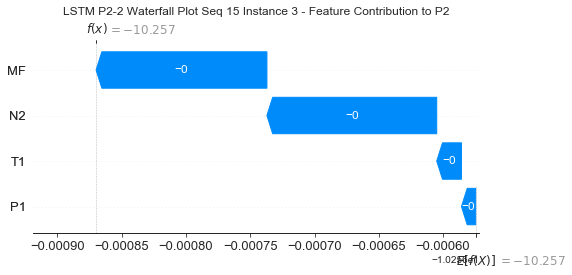

None

Contribution: [-3.54066902e-05 -6.08779571e-05 -2.14671221e-04 -2.18426214e-04]


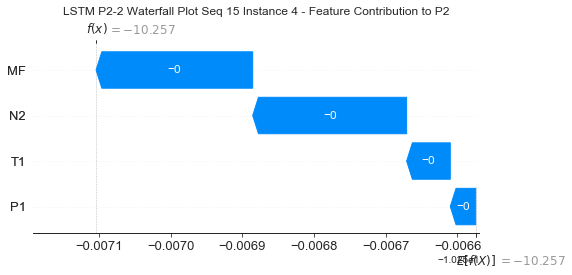

None

Contribution: [-3.39400536e-05 -5.05283971e-05 -1.87473351e-04 -1.89682558e-04]


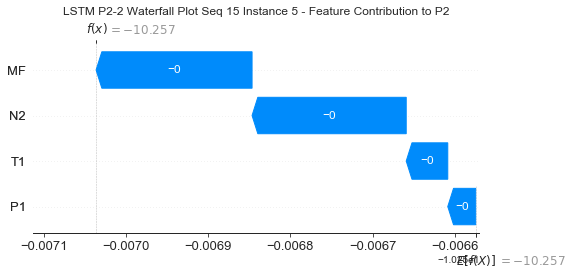

None

Contribution: [-3.15302528e-05 -4.11581117e-05 -1.64983427e-04 -1.64150429e-04]


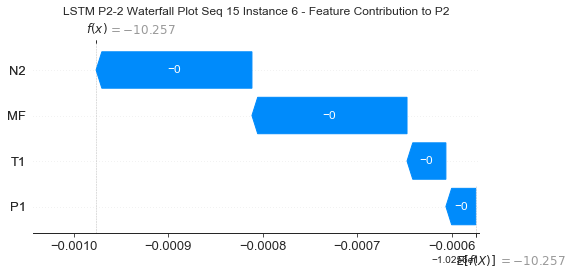

None

Contribution: [-2.04350045e-05 -3.18149942e-05 -1.43969676e-04 -1.17210619e-04]


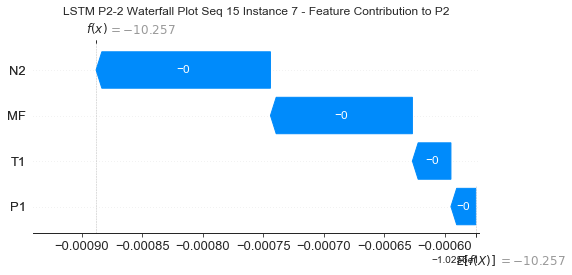

None

Contribution: [-1.68772144e-05 -2.44869405e-05 -1.27872250e-04 -8.22186632e-05]


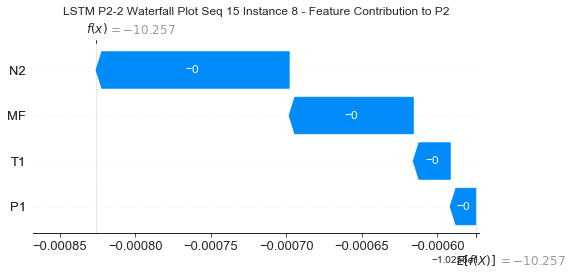

None

Contribution: [-2.07101352e-05 -2.49334125e-05 -1.25924616e-04 -9.57925939e-05]


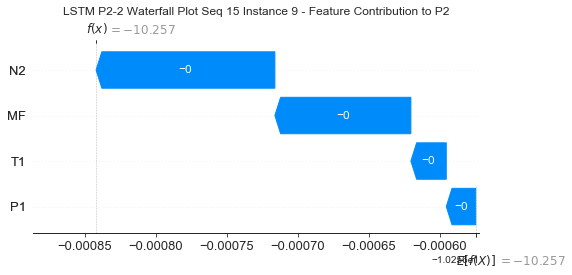

None

Contribution: [-3.40871859e-05 -2.52814171e-05 -1.26384679e-04 -1.10775585e-04]


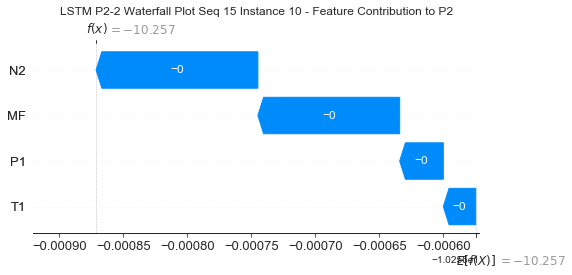

None

Contribution: [-3.73766635e-05 -2.68348547e-05 -1.31367721e-04 -1.21921339e-04]


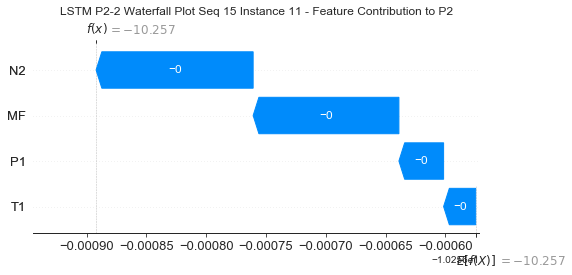

None

Contribution: [-3.71117196e-05 -2.78285601e-05 -1.36517479e-04 -1.28188102e-04]


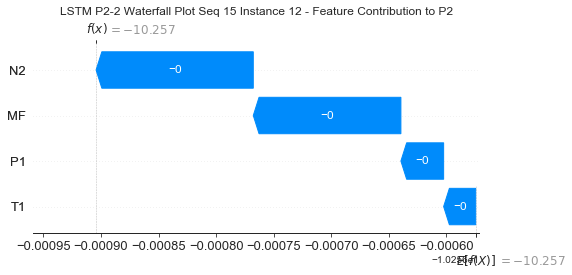

None

Contribution: [-3.68508473e-05 -2.87499838e-05 -1.42575590e-04 -1.35034865e-04]


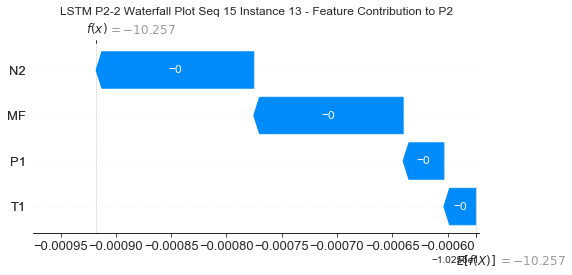

None

Contribution: [-3.20786087e-05 -2.66736530e-05 -1.44754697e-04 -1.28303988e-04]


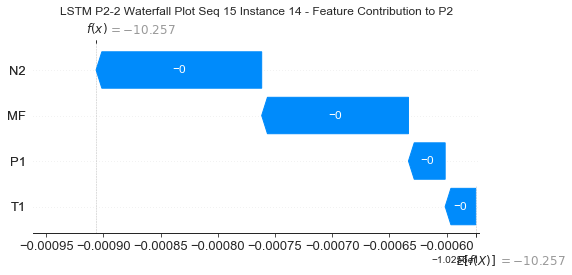

None

Contribution: [-3.57902033e-05 -3.05513458e-05 -1.52517582e-04 -1.47049419e-04]


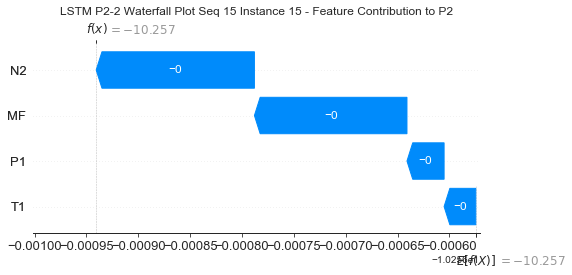

None

Contribution: [-3.59029024e-05 -3.01040934e-05 -1.51918507e-04 -1.46145545e-04]


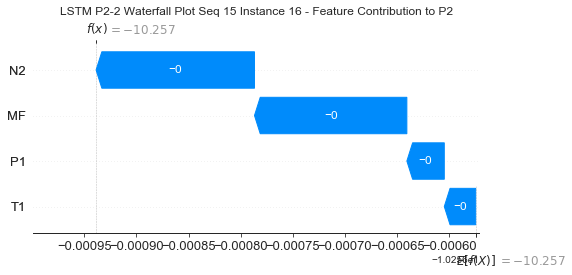

None

Contribution: [-3.60617346e-05 -2.81839207e-05 -1.48094060e-04 -1.40302487e-04]


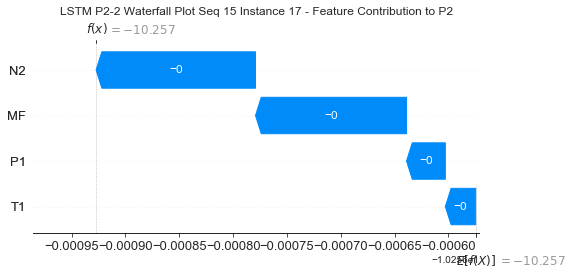

None

Contribution: [-3.30625777e-05 -3.30382359e-05 -1.71574229e-04 -1.71128972e-04]


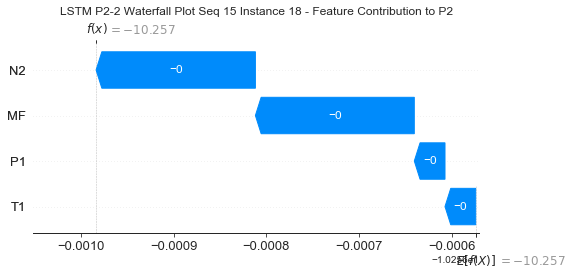

None

Contribution: [-1.84427533e-05 -6.12789096e-05 -2.76902176e-04 -3.02925640e-04]


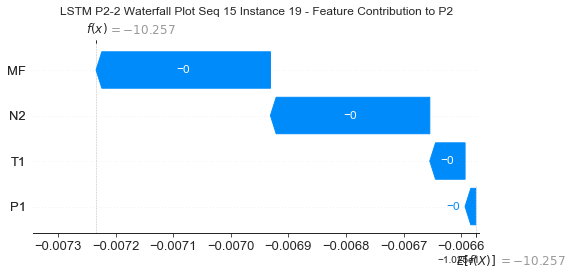

None

Contribution: [-1.01811970e-05 -8.55183182e-05 -3.42588043e-04 -3.79514437e-04]


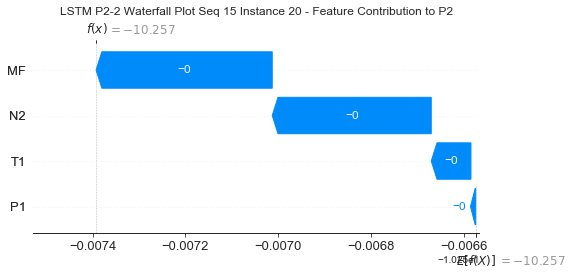

None

Contribution: [-8.56343071e-05  5.66824906e-05  2.49046617e-04  3.96520191e-04]


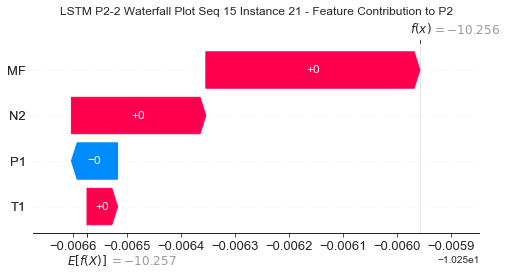

None

Contribution: [-0.00038732  0.00048358  0.00202112  0.00261875]


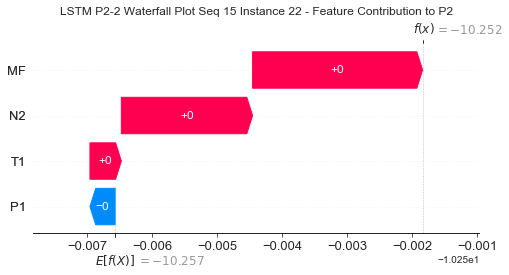

None

Contribution: [ 0.00079362 -0.00126237 -0.00648316 -0.00833823]


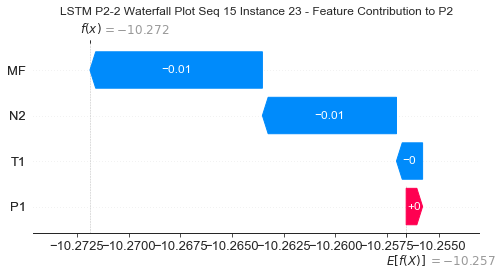

None

Contribution: [ 0.00170885 -0.00049741 -0.02932421 -0.04045672]


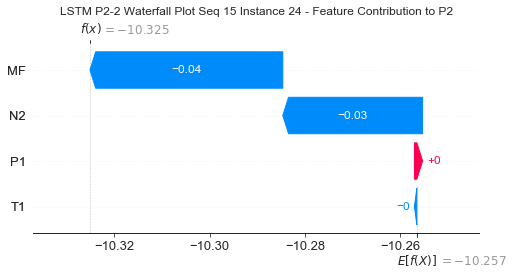

None

Contribution: [-0.01618256 -0.02230795 -0.0669207  -0.05224215]


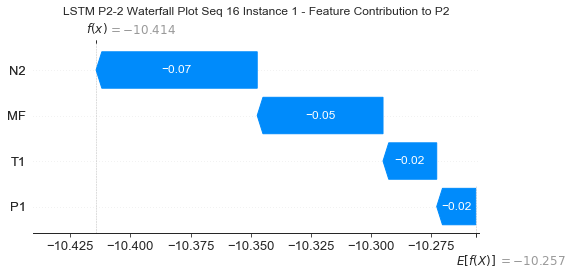

None

Contribution: [0.00050542 0.00010349 0.00155271 0.00147391]


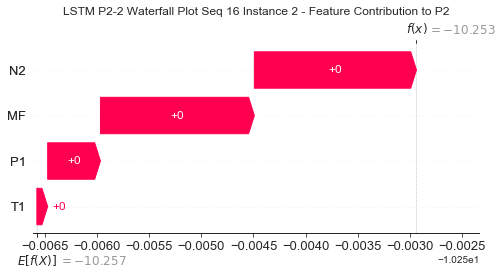

None

Contribution: [-1.08624316e-05 -1.69095988e-05 -1.31495177e-04 -1.32287885e-04]


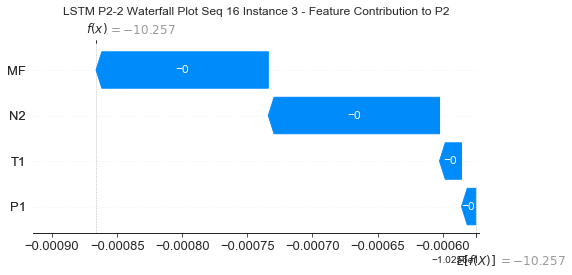

None

Contribution: [-3.50147333e-05 -5.65859304e-05 -2.14110169e-04 -2.18006467e-04]


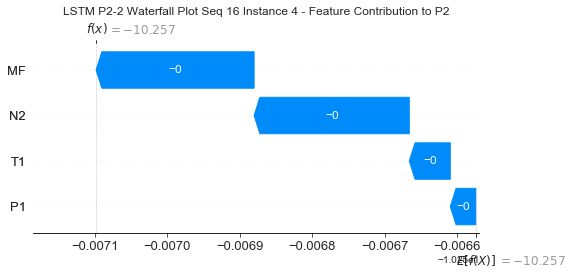

None

Contribution: [-3.38850287e-05 -4.71016381e-05 -1.87493408e-04 -1.90149989e-04]


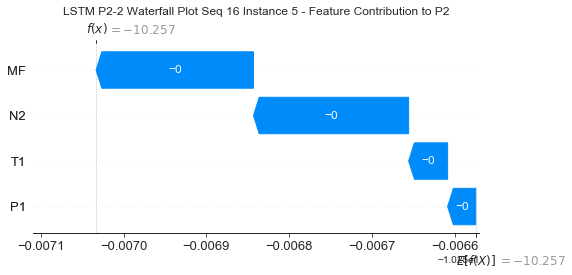

None

Contribution: [-3.13231178e-05 -3.92190956e-05 -1.65205050e-04 -1.64590927e-04]


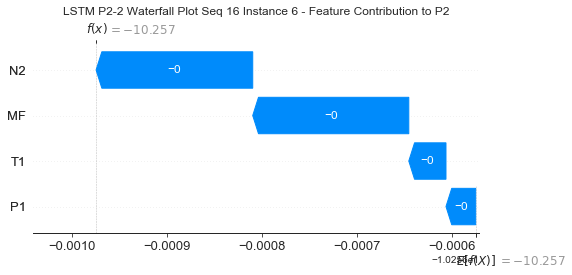

None

Contribution: [-2.10529898e-05 -3.11571555e-05 -1.44338101e-04 -1.18676770e-04]


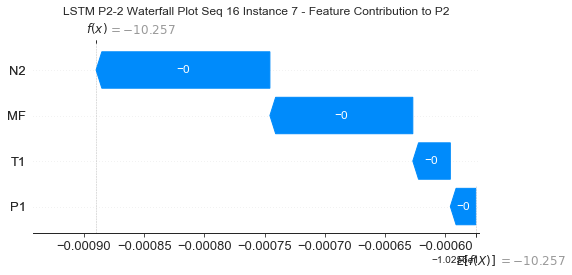

None

Contribution: [-1.60820786e-05 -2.45821373e-05 -1.28142797e-04 -8.25411067e-05]


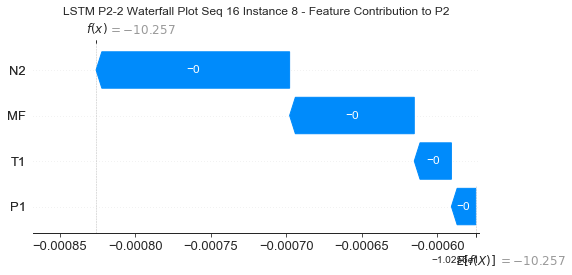

None

Contribution: [-2.12159969e-05 -2.43944177e-05 -1.26452711e-04 -9.71552954e-05]


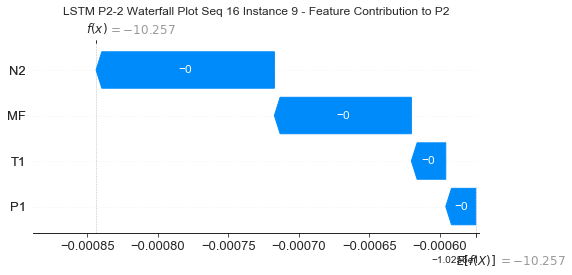

None

Contribution: [-3.40918064e-05 -2.52697743e-05 -1.26723979e-04 -1.11321136e-04]


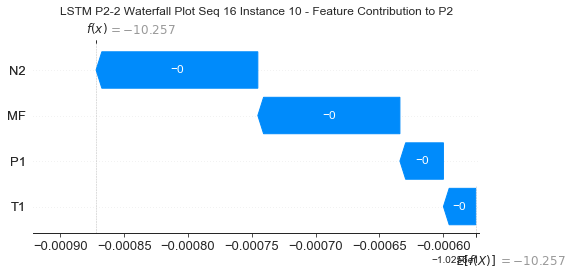

None

Contribution: [-3.73322731e-05 -2.68615723e-05 -1.31639744e-04 -1.22346631e-04]


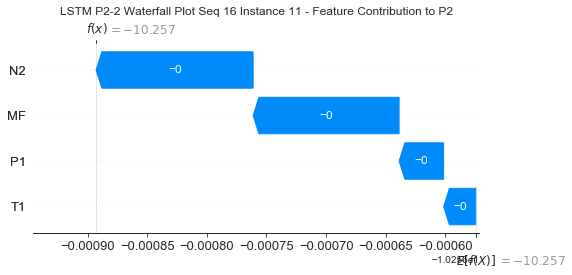

None

Contribution: [-3.69810330e-05 -2.85108923e-05 -1.36629701e-04 -1.27822336e-04]


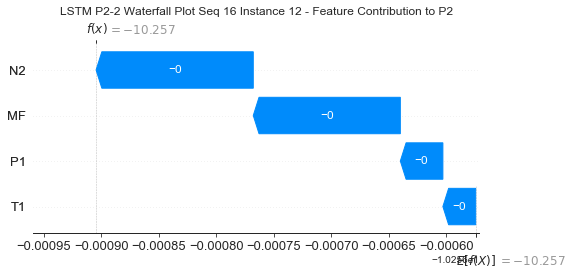

None

Contribution: [-3.67985679e-05 -2.90731565e-05 -1.42899557e-04 -1.35623461e-04]


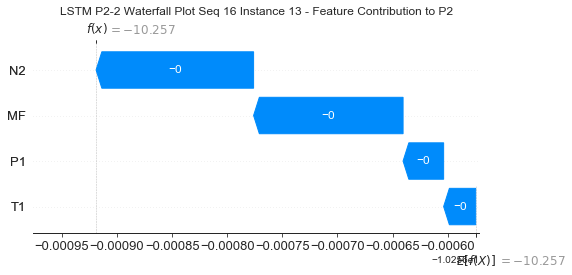

None

Contribution: [-3.20530044e-05 -2.78628391e-05 -1.44892031e-04 -1.28327370e-04]


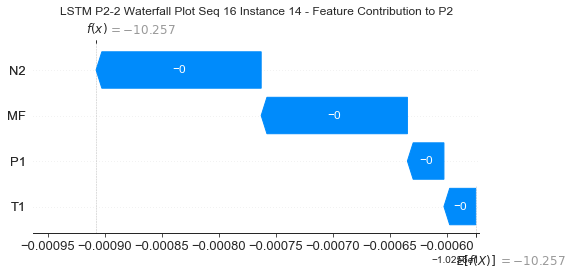

None

Contribution: [-3.57232927e-05 -3.11572769e-05 -1.52824296e-04 -1.47739934e-04]


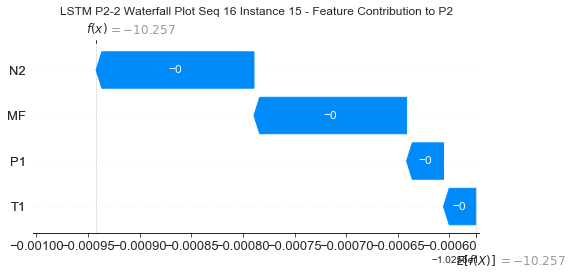

None

Contribution: [-3.57134325e-05 -3.06064471e-05 -1.52318226e-04 -1.46874231e-04]


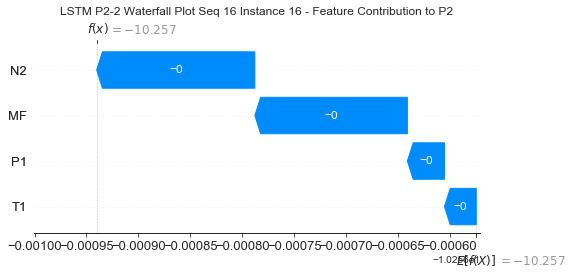

None

Contribution: [-3.59592408e-05 -2.83882996e-05 -1.48759367e-04 -1.41115389e-04]


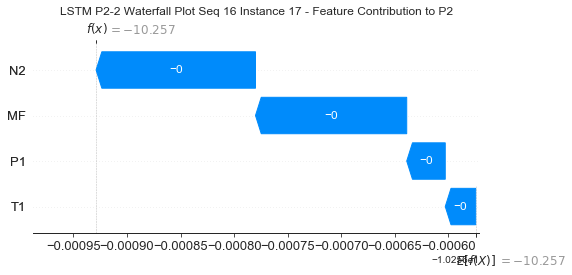

None

Contribution: [-3.27482828e-05 -3.33865821e-05 -1.71600864e-04 -1.71444254e-04]


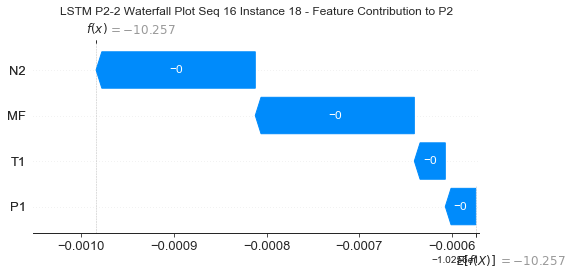

None

Contribution: [-1.85428402e-05 -6.13057526e-05 -2.74521248e-04 -3.00546576e-04]


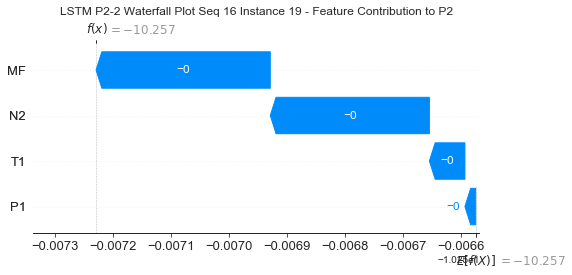

None

Contribution: [-1.04359834e-05 -8.61647087e-05 -3.39706411e-04 -3.76913429e-04]


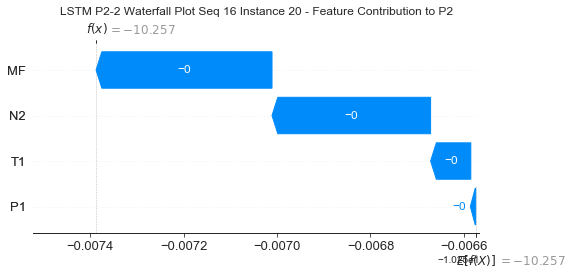

None

Contribution: [-8.40399609e-05  5.62338192e-05  2.40250205e-04  3.85413986e-04]


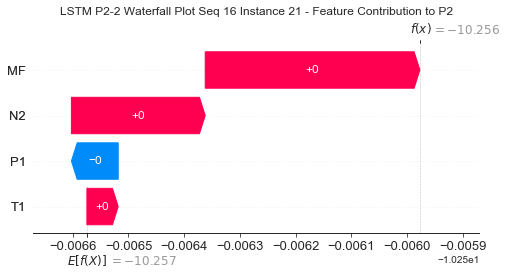

None

Contribution: [-0.00038051  0.00050742  0.00199506  0.00259365]


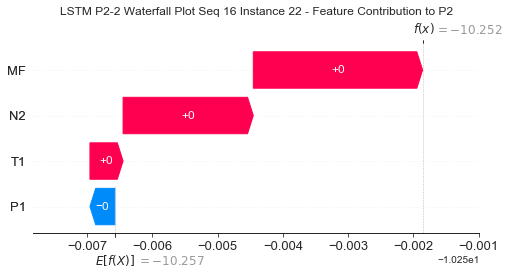

None

Contribution: [ 0.0008073  -0.00141774 -0.00643966 -0.00823894]


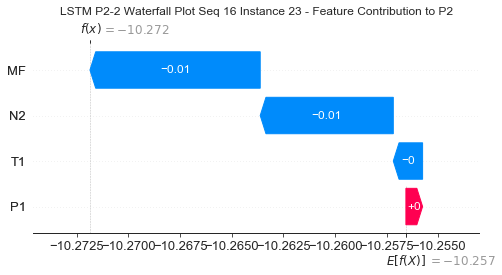

None

Contribution: [ 0.00174919  0.00073889 -0.02901294 -0.03910645]


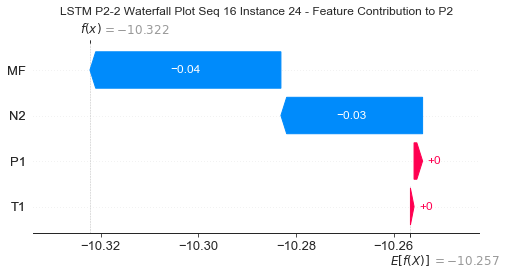

None

Contribution: [-0.01644441 -0.022311   -0.06689225 -0.05229807]


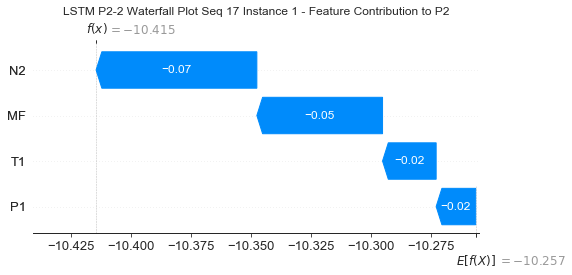

None

Contribution: [0.00050546 0.00010007 0.00155785 0.00149775]


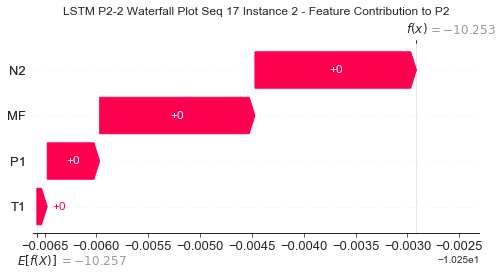

None

Contribution: [-1.10500142e-05 -1.57627958e-05 -1.31836363e-04 -1.33597784e-04]


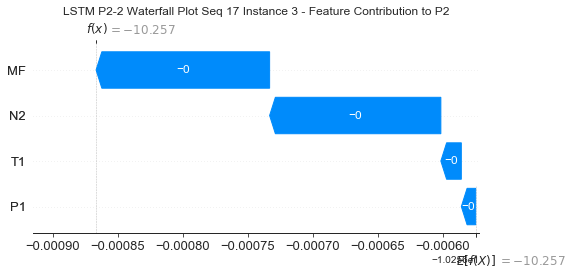

None

Contribution: [-3.53040786e-05 -5.34979675e-05 -2.14490879e-04 -2.19222082e-04]


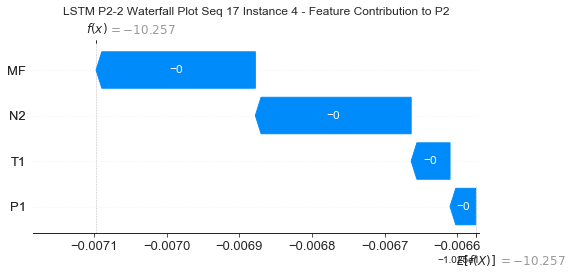

None

Contribution: [-3.37296725e-05 -4.61501945e-05 -1.87490596e-04 -1.89866167e-04]


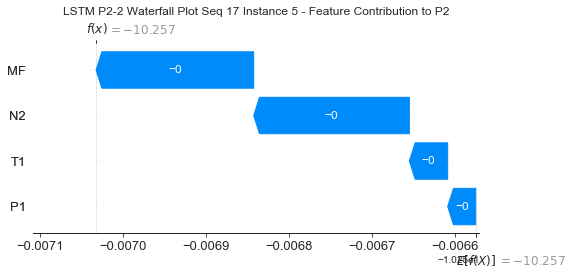

None

Contribution: [-3.15161720e-05 -3.76139987e-05 -1.65299246e-04 -1.65019373e-04]


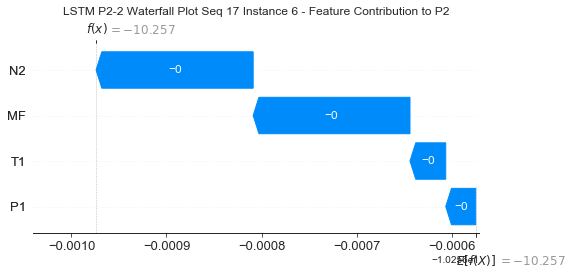

None

Contribution: [-2.11513148e-05 -3.10518866e-05 -1.44446433e-04 -1.18884920e-04]


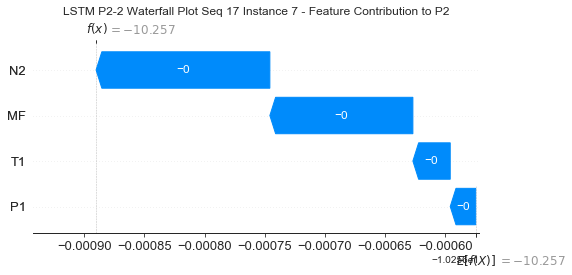

None

Contribution: [-1.63889990e-05 -2.37885611e-05 -1.28349748e-04 -8.32399134e-05]


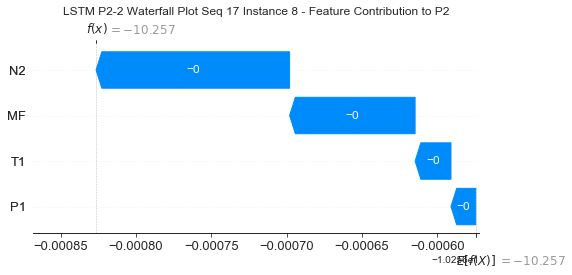

None

Contribution: [-2.06613205e-05 -2.38642260e-05 -1.26157532e-04 -9.64351906e-05]


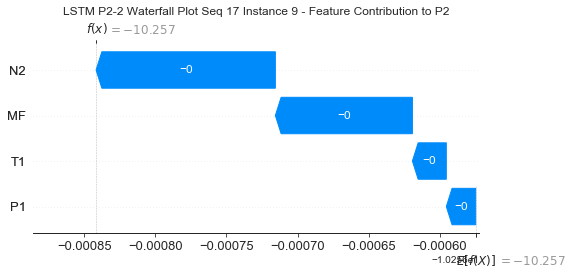

None

Contribution: [-3.37114607e-05 -2.39005169e-05 -1.26307816e-04 -1.10313262e-04]


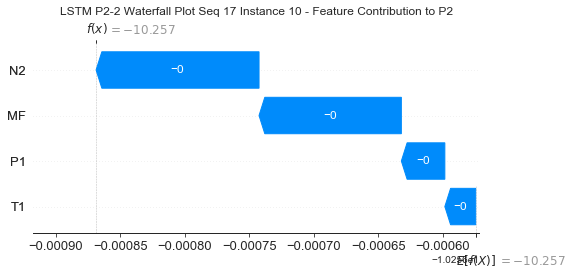

None

Contribution: [-3.71711970e-05 -2.55148731e-05 -1.31295253e-04 -1.21567672e-04]


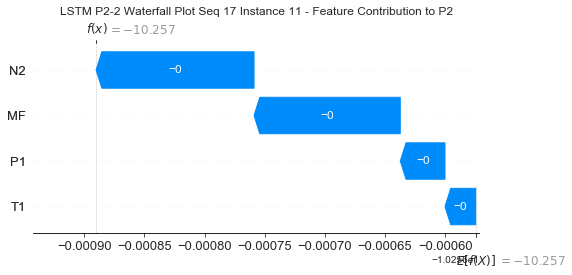

None

Contribution: [-3.68343894e-05 -2.70389704e-05 -1.36413692e-04 -1.27481799e-04]


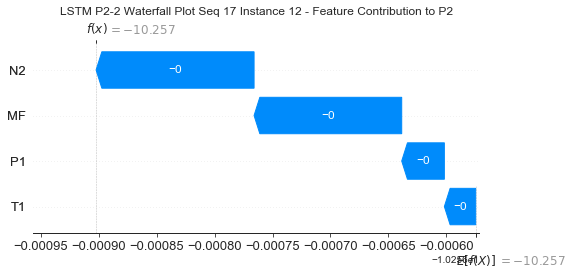

None

Contribution: [-3.65456508e-05 -2.77011554e-05 -1.42699228e-04 -1.34776117e-04]


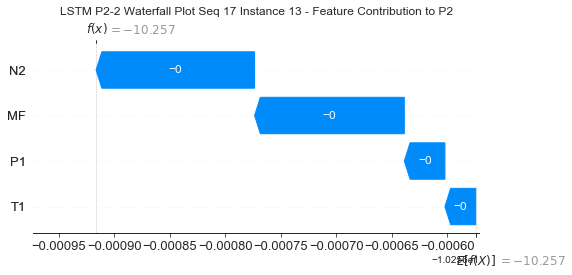

None

Contribution: [-3.20727664e-05 -2.63560764e-05 -1.44567685e-04 -1.28796529e-04]


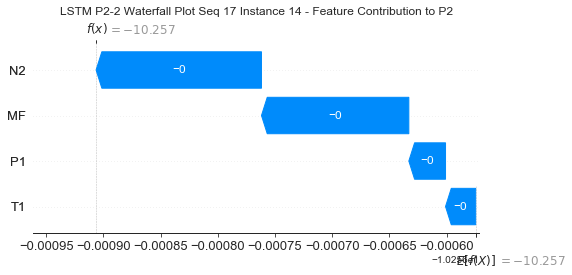

None

Contribution: [-3.55494087e-05 -2.97560196e-05 -1.52545656e-04 -1.46621624e-04]


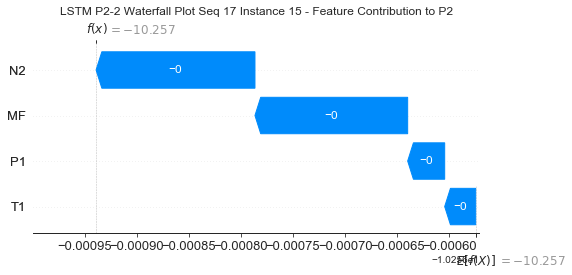

None

Contribution: [-3.56135329e-05 -2.92743117e-05 -1.52170723e-04 -1.46121310e-04]


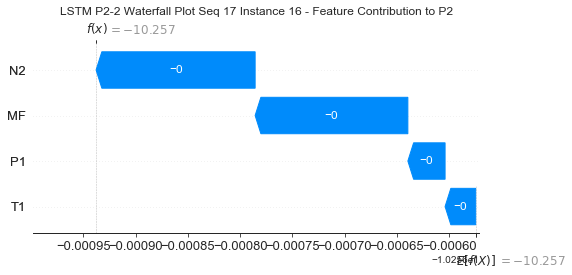

None

Contribution: [-3.59022772e-05 -2.77531574e-05 -1.48313250e-04 -1.41351655e-04]


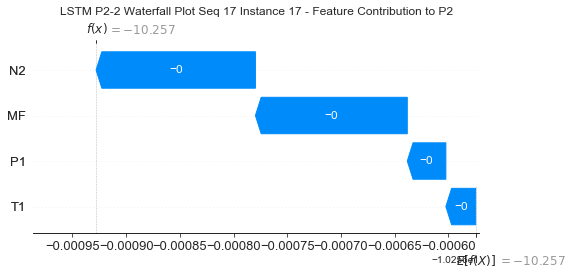

None

Contribution: [-3.31294951e-05 -3.24989515e-05 -1.71970259e-04 -1.71525576e-04]


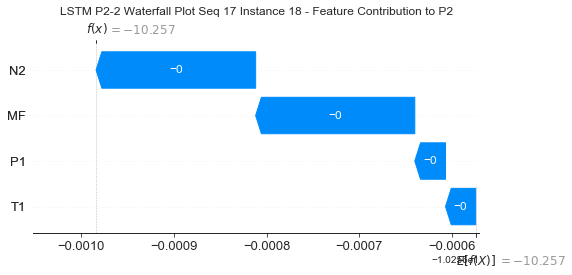

None

Contribution: [-1.85436545e-05 -5.94541544e-05 -2.76550716e-04 -3.02099986e-04]


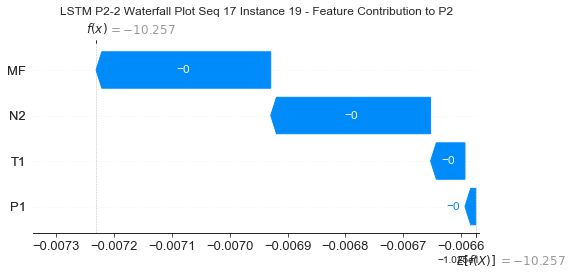

None

Contribution: [-1.03680802e-05 -8.27613562e-05 -3.41369947e-04 -3.77006087e-04]


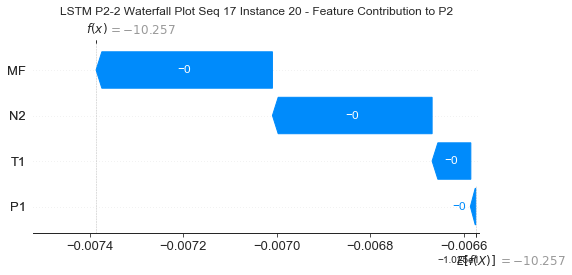

None

Contribution: [-8.51174617e-05  5.50139220e-05  2.47747695e-04  3.93216561e-04]


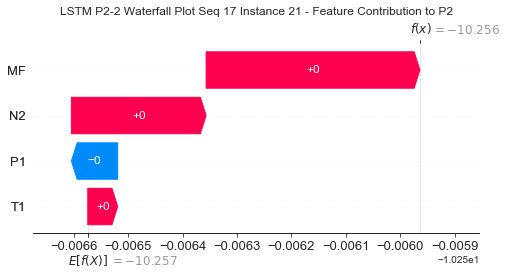

None

Contribution: [-0.00038897  0.0004713   0.00201528  0.0026167 ]


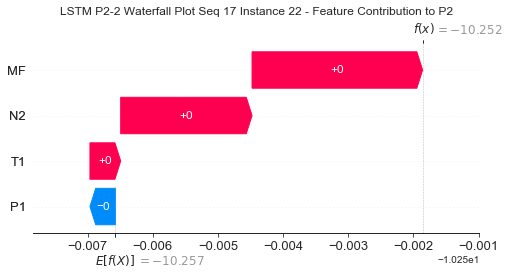

None

Contribution: [ 0.00083621 -0.00122583 -0.00647396 -0.00851424]


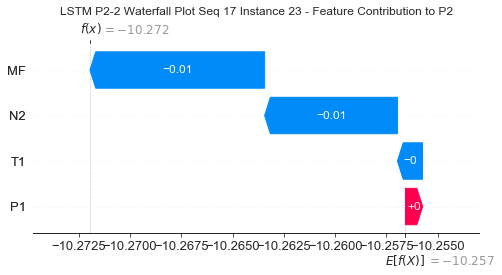

None

Contribution: [ 0.00164941  0.0037538  -0.02894225 -0.03860686]


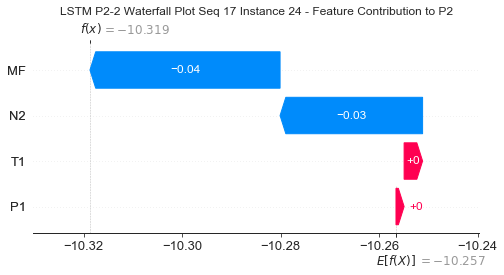

None

Contribution: [-0.01629616 -0.02804892 -0.066758   -0.05026412]


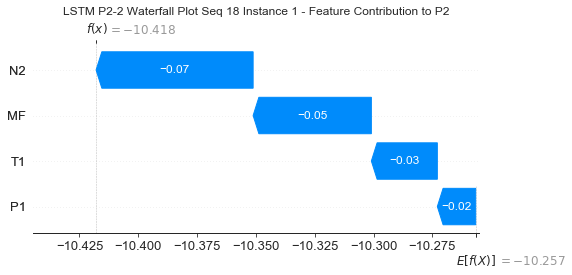

None

Contribution: [5.05055473e-04 9.71368149e-05 1.56323107e-03 1.47164168e-03]


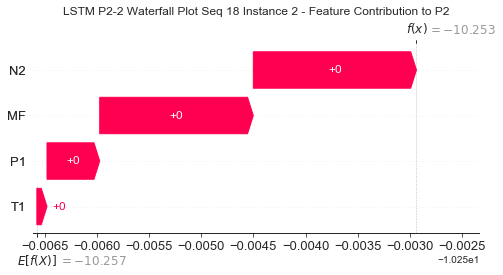

None

Contribution: [-1.10304070e-05 -1.48813891e-05 -1.32321813e-04 -1.33311331e-04]


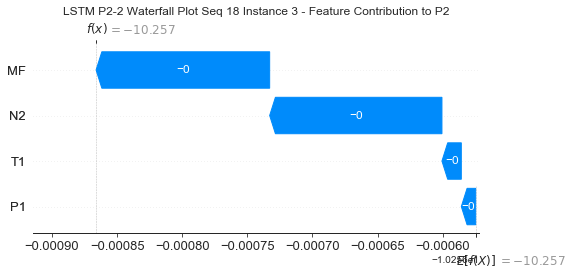

None

Contribution: [-3.54036666e-05 -5.13658914e-05 -2.14952094e-04 -2.18261198e-04]


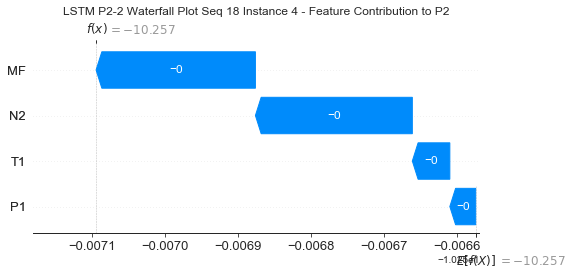

None

Contribution: [-3.34813114e-05 -4.41530762e-05 -1.87805003e-04 -1.88683074e-04]


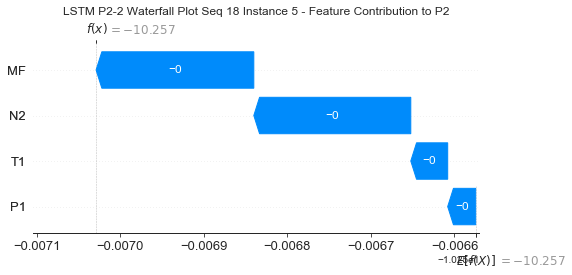

None

Contribution: [-3.15290372e-05 -3.61166585e-05 -1.65149531e-04 -1.63896229e-04]


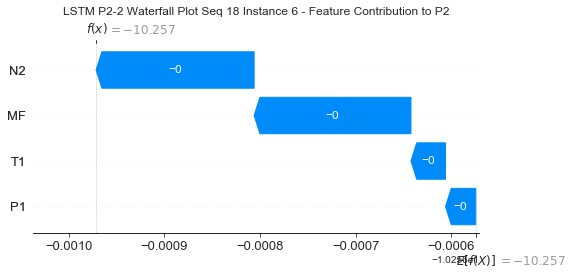

None

Contribution: [-2.04696744e-05 -2.88122956e-05 -1.44030008e-04 -1.16704323e-04]


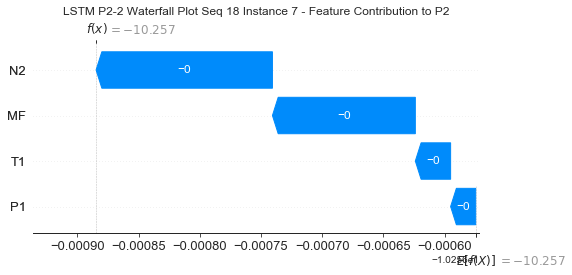

None

Contribution: [-1.63819582e-05 -2.25278831e-05 -1.27922586e-04 -8.17558507e-05]


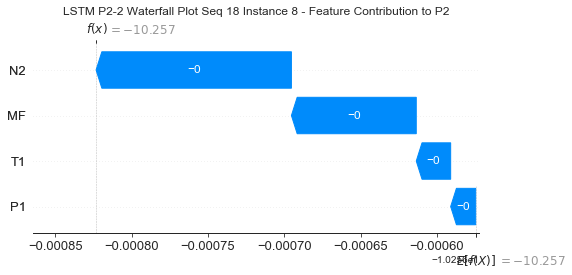

None

Contribution: [-2.03204511e-05 -2.28154362e-05 -1.26038308e-04 -9.55671025e-05]


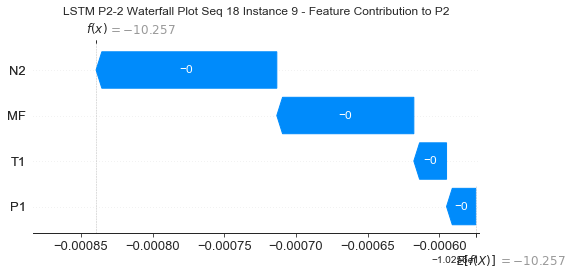

None

Contribution: [-3.39531335e-05 -2.35434968e-05 -1.26464243e-04 -1.10170264e-04]


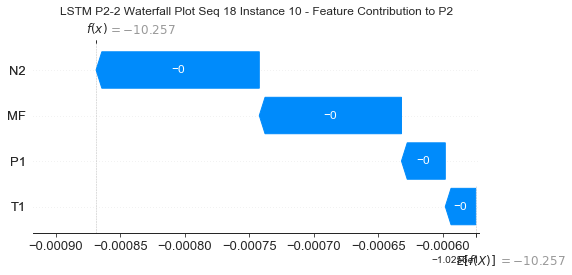

None

Contribution: [-3.74337173e-05 -2.49866560e-05 -1.31323931e-04 -1.21210861e-04]


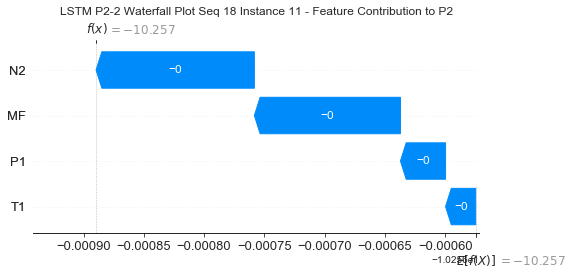

None

Contribution: [-3.70035778e-05 -2.60217460e-05 -1.36274461e-04 -1.26718598e-04]


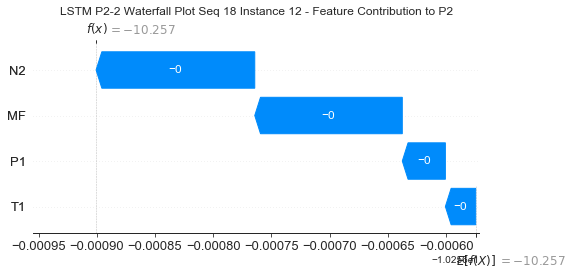

None

Contribution: [-3.68613074e-05 -2.72419423e-05 -1.42841762e-04 -1.34700486e-04]


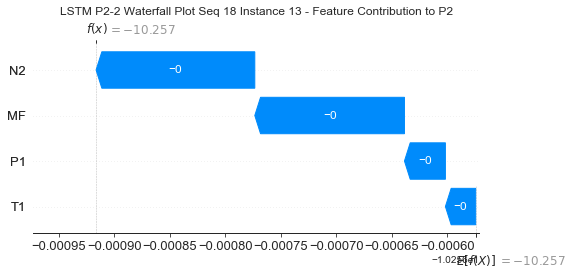

None

Contribution: [-3.20511378e-05 -2.66117837e-05 -1.44812513e-04 -1.27296173e-04]


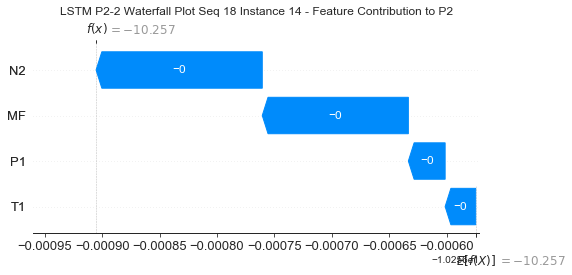

None

Contribution: [-3.59198325e-05 -2.93046963e-05 -1.52764889e-04 -1.46531277e-04]


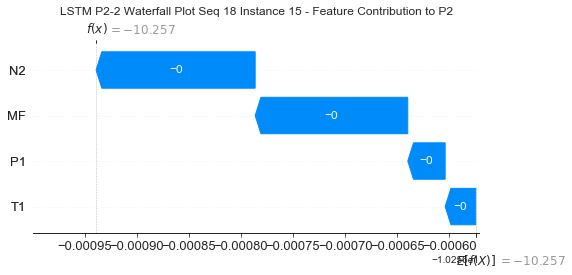

None

Contribution: [-3.60413539e-05 -2.87695706e-05 -1.52071731e-04 -1.45508933e-04]


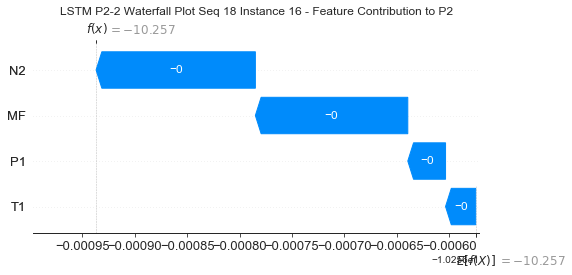

None

Contribution: [-3.58387396e-05 -2.67287540e-05 -1.48402520e-04 -1.40020426e-04]


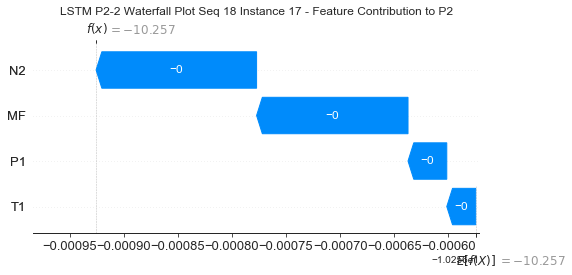

None

Contribution: [-3.34932728e-05 -3.17100443e-05 -1.71933094e-04 -1.71110830e-04]


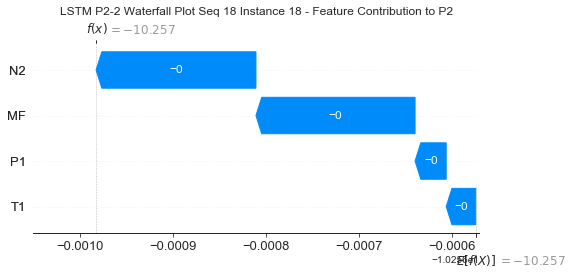

None

Contribution: [-1.87667633e-05 -5.79472180e-05 -2.76924737e-04 -3.01634985e-04]


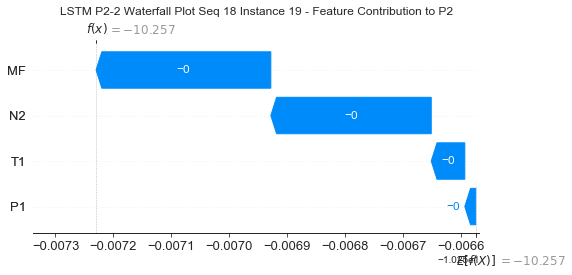

None

Contribution: [-1.05049475e-05 -8.03507903e-05 -3.41934918e-04 -3.77447023e-04]


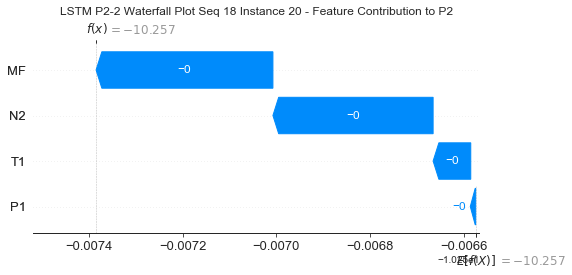

None

Contribution: [-8.61976224e-05  5.38318729e-05  2.49111092e-04  3.94312988e-04]


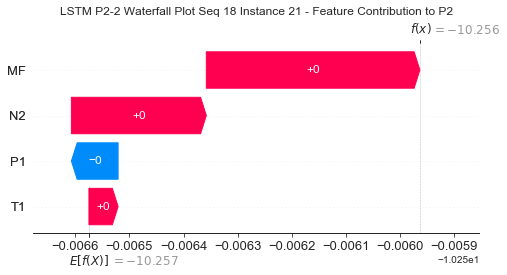

None

Contribution: [-0.00039126  0.00044871  0.00201921  0.00260875]


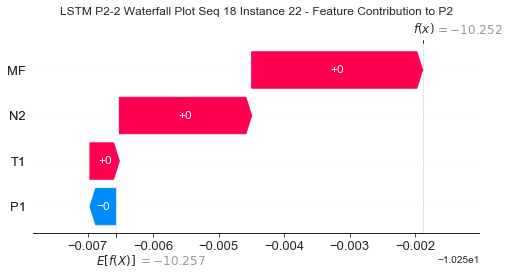

None

Contribution: [ 0.00081085 -0.00114271 -0.00651281 -0.00838951]


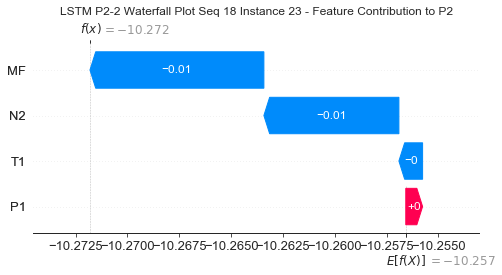

None

Contribution: [ 0.00170752  0.00358673 -0.02937588 -0.03929213]


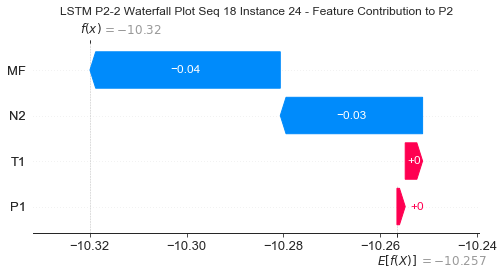

None

Contribution: [-0.01641255 -0.02803505 -0.06717564 -0.05317477]


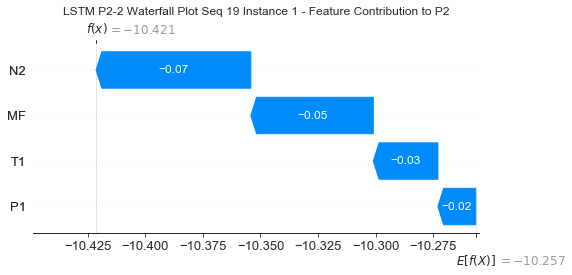

None

Contribution: [5.07089077e-04 9.68923491e-05 1.55133638e-03 1.48780873e-03]


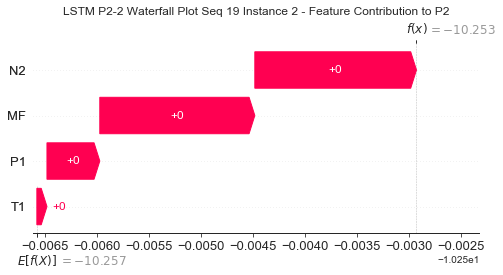

None

Contribution: [-1.11932950e-05 -1.61559100e-05 -1.31258915e-04 -1.33522837e-04]


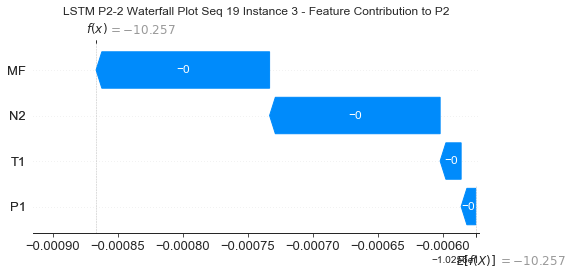

None

Contribution: [-3.57057146e-05 -5.49977268e-05 -2.13889646e-04 -2.19297423e-04]


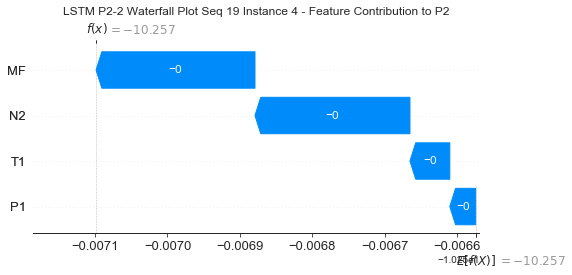

None

Contribution: [-3.45256829e-05 -4.49984318e-05 -1.87581184e-04 -1.89740267e-04]


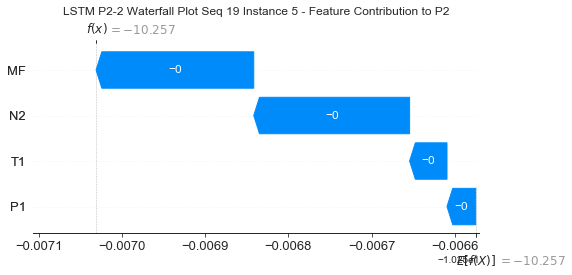

None

Contribution: [-3.19850925e-05 -3.84407704e-05 -1.65577393e-04 -1.65729518e-04]


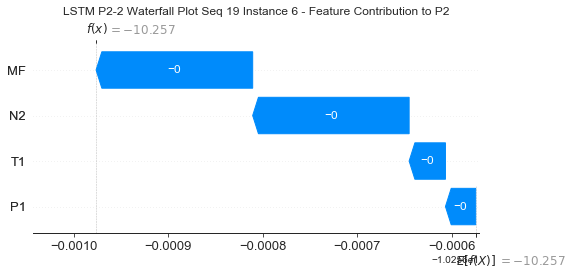

None

Contribution: [-2.23063265e-05 -3.10739302e-05 -1.45152527e-04 -1.20448424e-04]


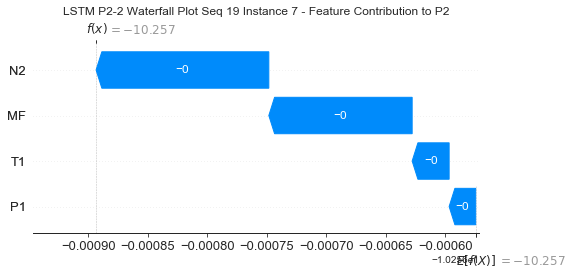

None

Contribution: [-1.80266527e-05 -2.39563422e-05 -1.29114462e-04 -8.51411657e-05]


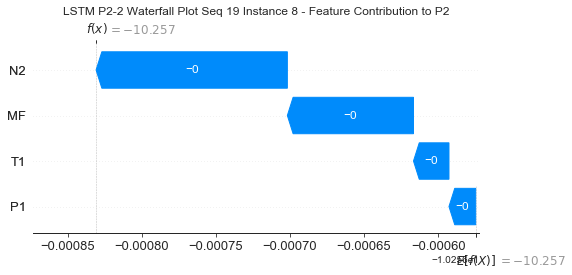

None

Contribution: [-2.16676697e-05 -2.46972494e-05 -1.26884880e-04 -9.78425612e-05]


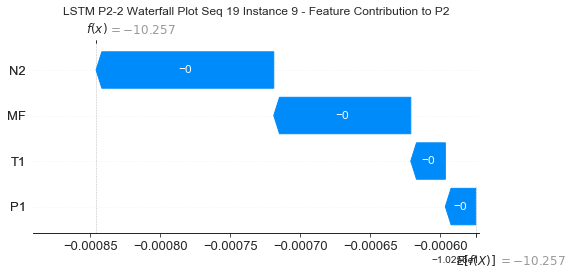

None

Contribution: [-3.44884854e-05 -2.48740706e-05 -1.27023761e-04 -1.11568950e-04]


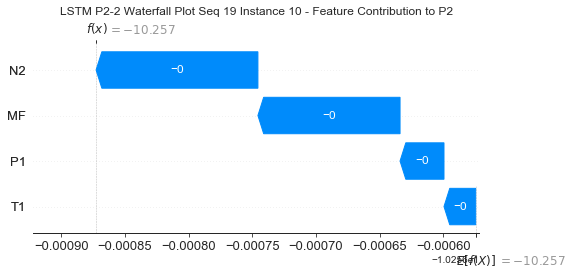

None

Contribution: [-3.78783224e-05 -2.63233995e-05 -1.32058244e-04 -1.22788872e-04]


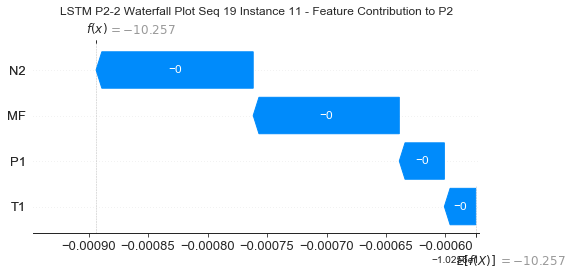

None

Contribution: [-3.81110739e-05 -2.72631178e-05 -1.37200267e-04 -1.29273777e-04]


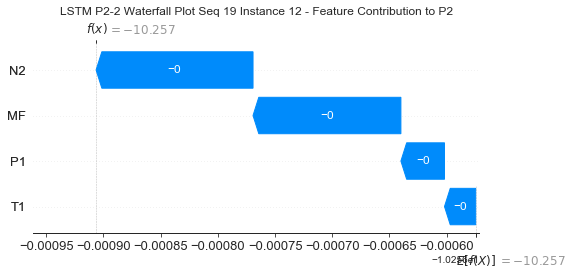

None

Contribution: [-3.72182811e-05 -2.84449805e-05 -1.43245419e-04 -1.35650133e-04]


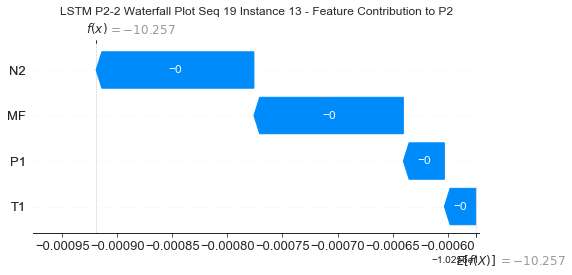

None

Contribution: [-3.25596680e-05 -2.68178076e-05 -1.45232405e-04 -1.29100368e-04]


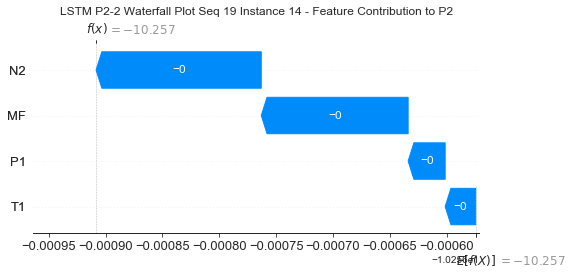

None

Contribution: [-3.61177477e-05 -3.01451540e-05 -1.53026407e-04 -1.47227639e-04]


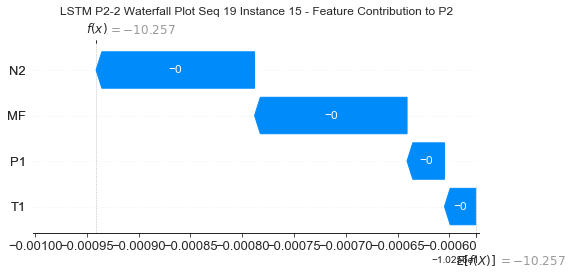

None

Contribution: [-3.60480892e-05 -2.96049048e-05 -1.52682338e-04 -1.46687411e-04]


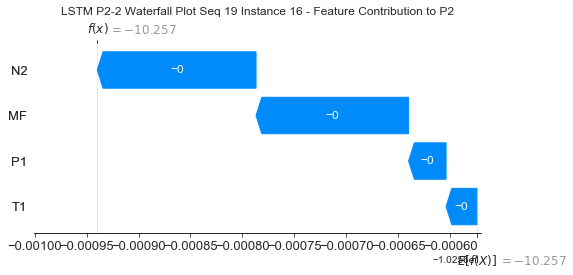

None

Contribution: [-3.63578925e-05 -2.79497733e-05 -1.49035574e-04 -1.41829092e-04]


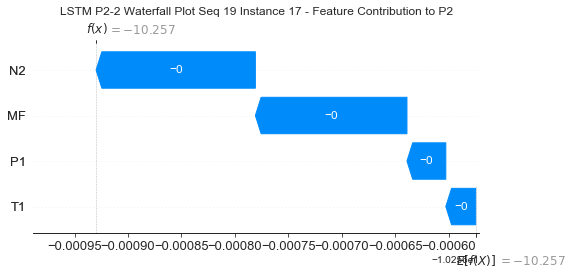

None

Contribution: [-3.34300199e-05 -3.21207494e-05 -1.72052401e-04 -1.71286843e-04]


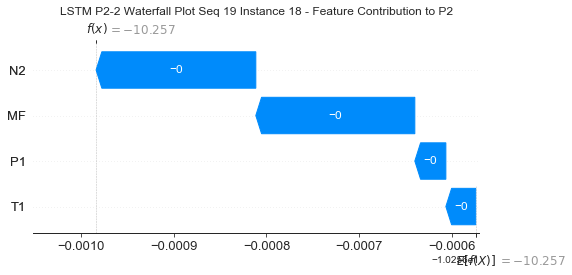

None

Contribution: [-1.87310798e-05 -5.86334876e-05 -2.76258719e-04 -3.00830324e-04]


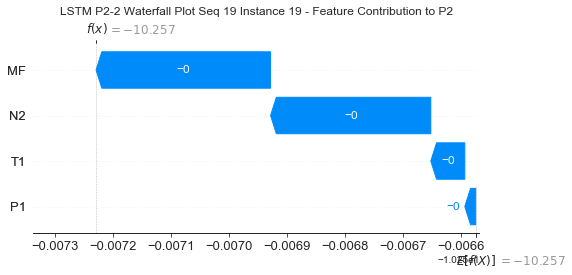

None

Contribution: [-1.02336386e-05 -8.23408219e-05 -3.42574702e-04 -3.77173492e-04]


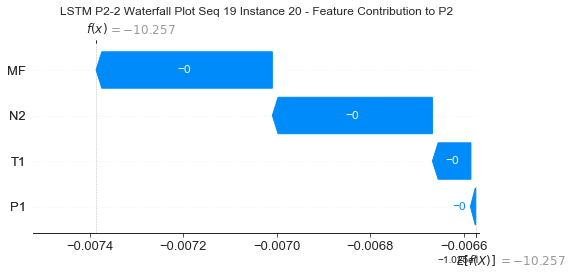

None

Contribution: [-8.50326323e-05  5.29886856e-05  2.40413052e-04  3.82196179e-04]


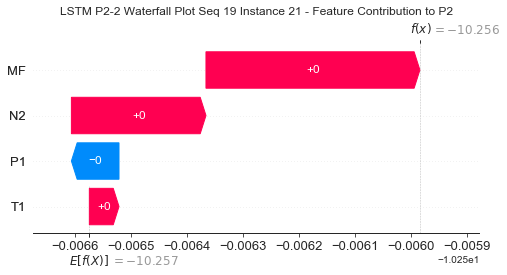

None

Contribution: [-0.00038659  0.00046085  0.00200137  0.00256454]


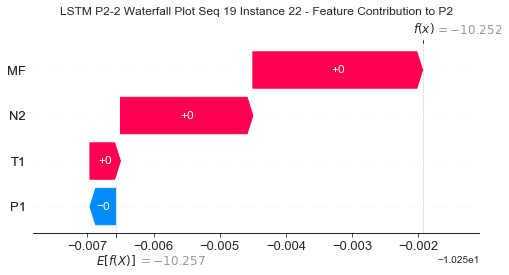

None

Contribution: [ 0.00081716 -0.00121167 -0.00646435 -0.00835777]


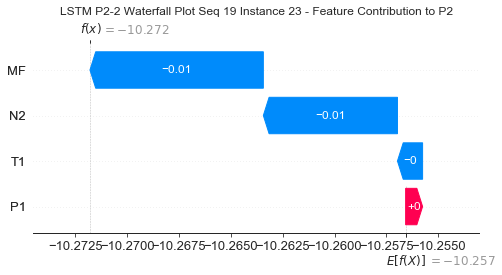

None

Contribution: [ 0.00193943  0.00264645 -0.02938749 -0.04088011]


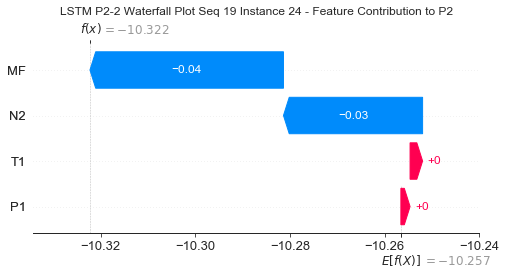

None

Contribution: [-0.01682598 -0.02605943 -0.06697281 -0.05162906]


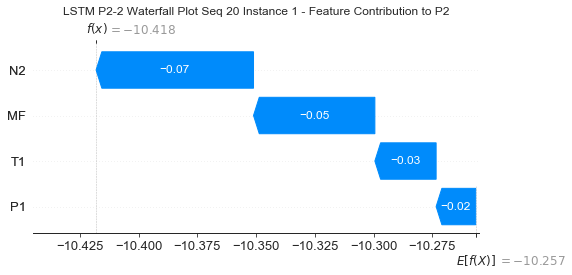

None

Contribution: [4.95958257e-04 9.57151845e-05 1.54894002e-03 1.44938652e-03]


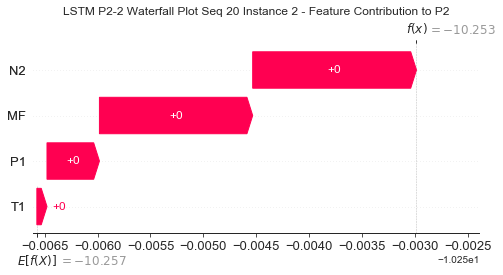

None

Contribution: [-1.11496960e-05 -1.55310882e-05 -1.31789679e-04 -1.32823237e-04]


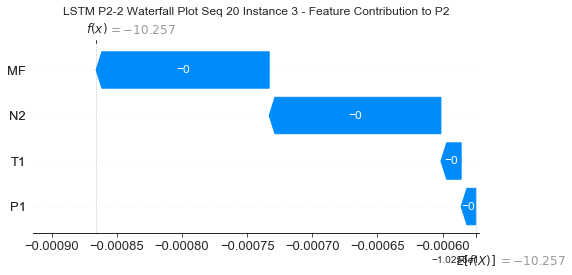

None

Contribution: [-3.57338323e-05 -5.33357361e-05 -2.14446731e-04 -2.18704798e-04]


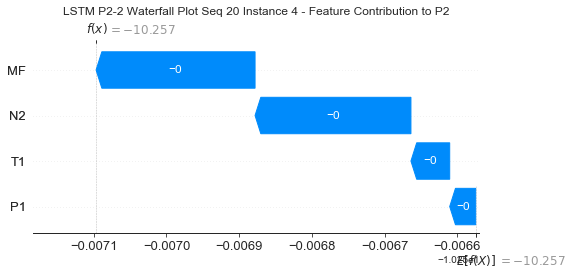

None

Contribution: [-3.42352110e-05 -4.47737912e-05 -1.87604853e-04 -1.88845378e-04]


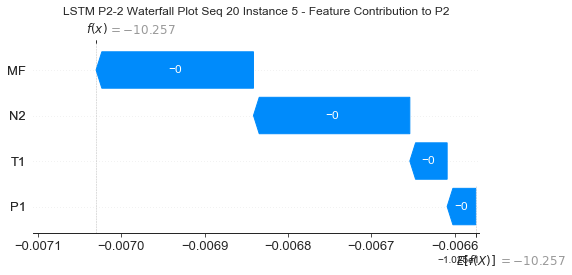

None

Contribution: [-3.19388224e-05 -3.73209294e-05 -1.65389708e-04 -1.64950134e-04]


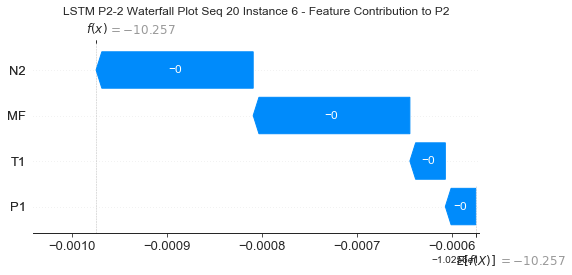

None

Contribution: [-2.17506168e-05 -2.97593433e-05 -1.44582639e-04 -1.19059138e-04]


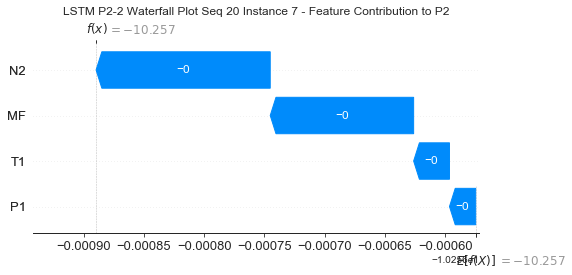

None

Contribution: [-1.71133264e-05 -2.34164216e-05 -1.28454507e-04 -8.27751731e-05]


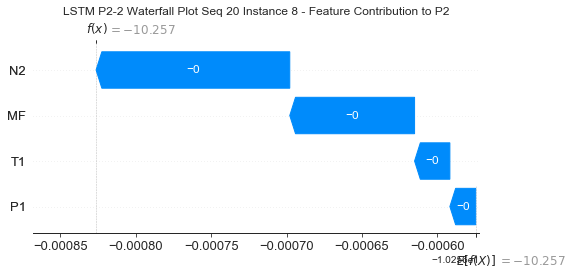

None

Contribution: [-2.16949373e-05 -2.36960972e-05 -1.26613547e-04 -9.72680506e-05]


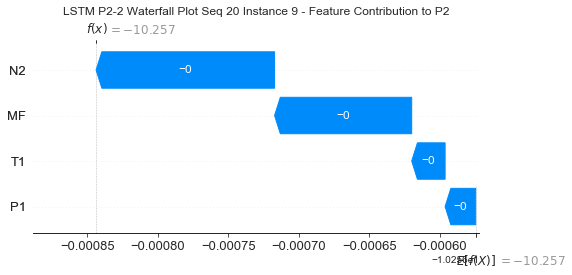

None

Contribution: [-3.44127454e-05 -2.41347951e-05 -1.26591514e-04 -1.10633564e-04]


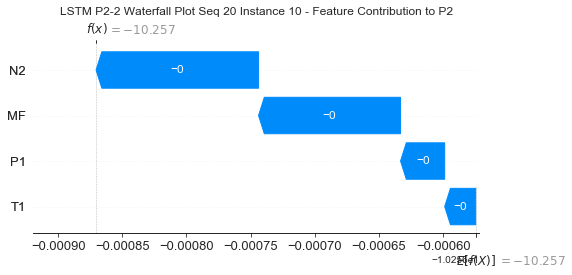

None

Contribution: [-3.77949994e-05 -2.55891843e-05 -1.31569400e-04 -1.21866174e-04]


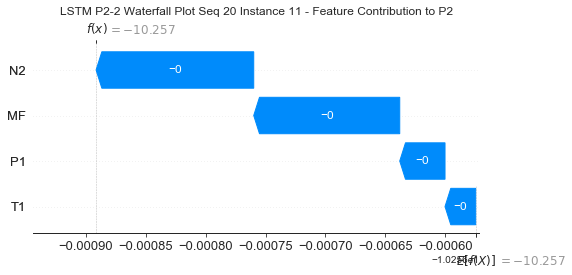

None

Contribution: [-3.79096323e-05 -2.74063804e-05 -1.36284240e-04 -1.27425712e-04]


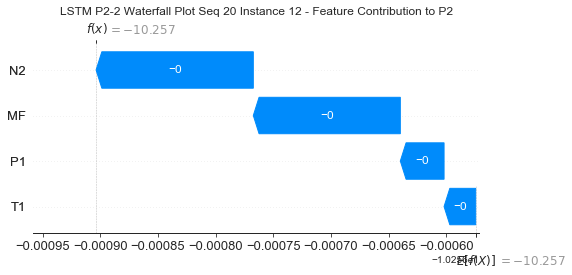

None

Contribution: [-3.71955468e-05 -2.76751926e-05 -1.42645424e-04 -1.34660398e-04]


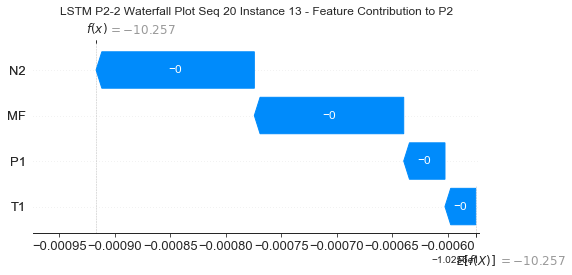

None

Contribution: [-3.19185376e-05 -2.64422296e-05 -1.44657681e-04 -1.27344291e-04]


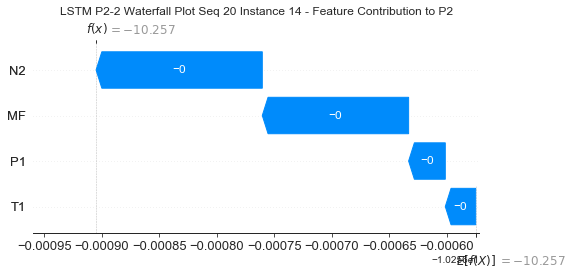

None

Contribution: [-3.62796843e-05 -2.96272334e-05 -1.52662552e-04 -1.46980366e-04]


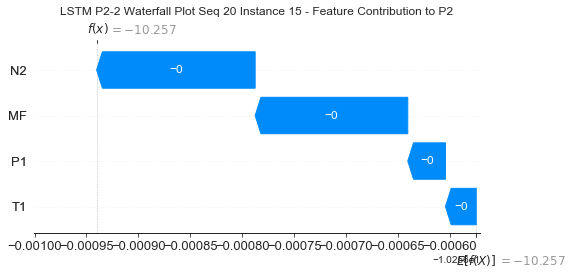

None

Contribution: [-3.64398996e-05 -2.91378020e-05 -1.52161067e-04 -1.46461793e-04]


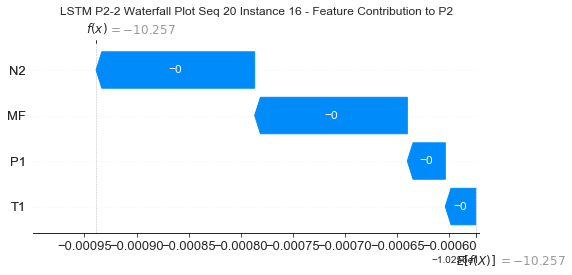

None

Contribution: [-3.69316416e-05 -2.73010246e-05 -1.48262955e-04 -1.40853037e-04]


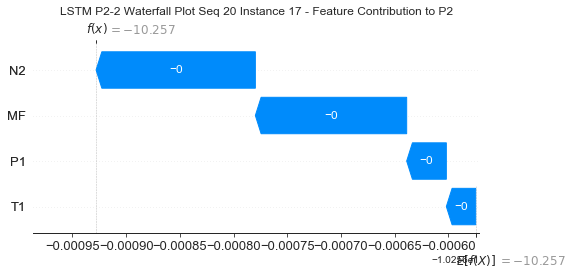

None

Contribution: [-3.36670711e-05 -3.17976626e-05 -1.71735343e-04 -1.71441107e-04]


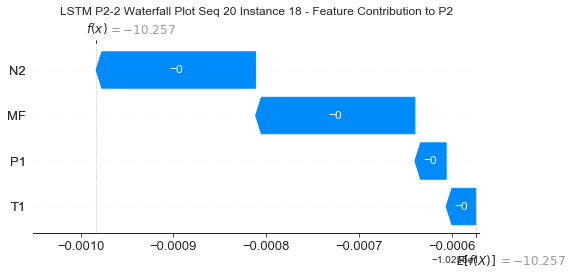

None

Contribution: [-1.88112938e-05 -5.81837293e-05 -2.76488762e-04 -3.02489940e-04]


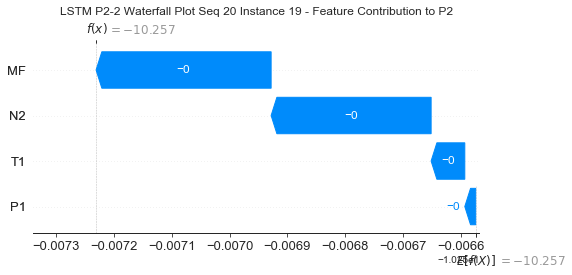

None

Contribution: [-1.02870307e-05 -8.10237144e-05 -3.41761783e-04 -3.77032516e-04]


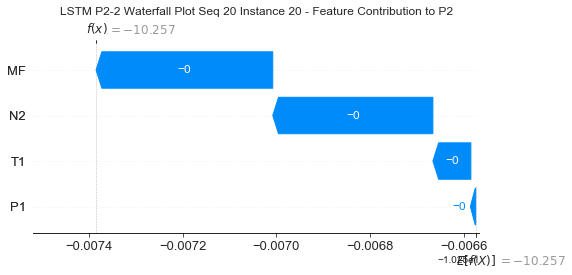

None

Contribution: [-8.64488604e-05  5.38186637e-05  2.47030656e-04  3.92431398e-04]


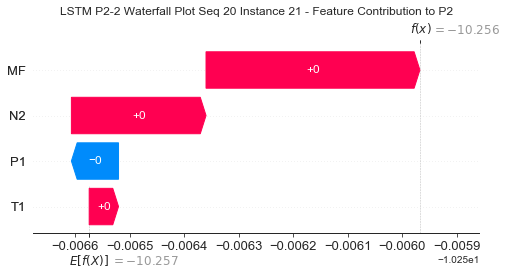

None

Contribution: [-0.00039108  0.00045516  0.00200905  0.00258401]


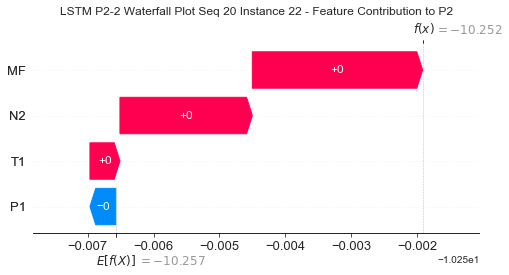

None

Contribution: [ 0.00081587 -0.00126814 -0.00648541 -0.00821117]


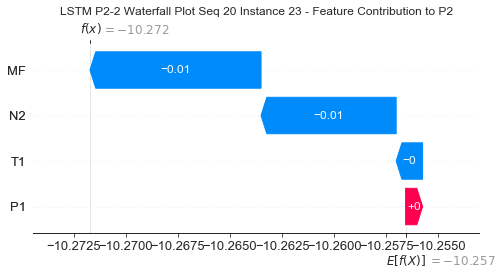

None

Contribution: [ 0.00191375  0.00146616 -0.02911412 -0.03917401]


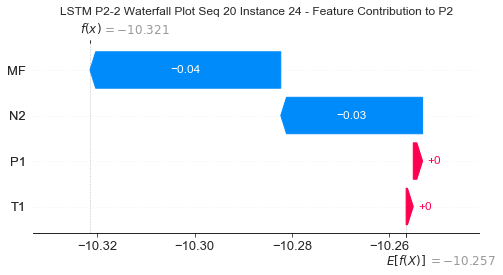

None

Contribution: [-0.01655391 -0.02417905 -0.06684434 -0.04943732]


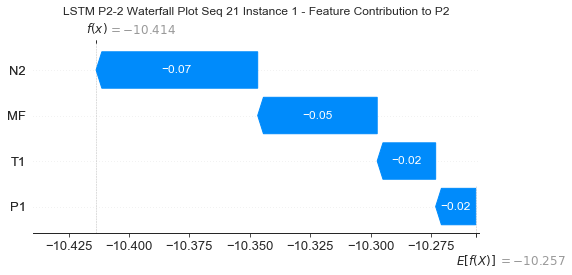

None

Contribution: [0.00051873 0.00010124 0.00157058 0.00149725]


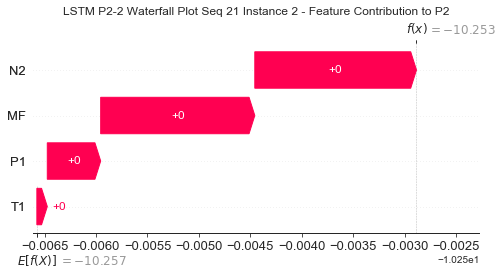

None

Contribution: [-1.10965727e-05 -1.59936827e-05 -1.32330716e-04 -1.32929170e-04]


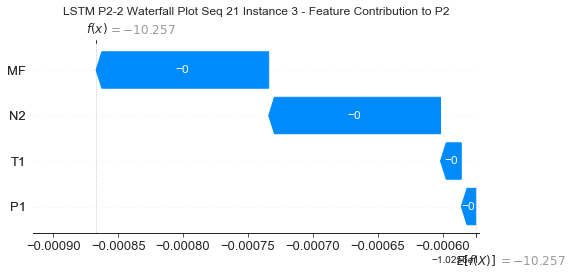

None

Contribution: [-3.56108925e-05 -5.39850657e-05 -2.14823724e-04 -2.18202735e-04]


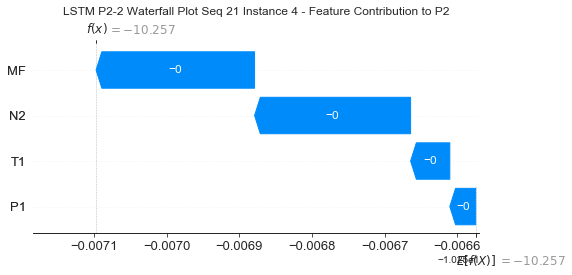

None

Contribution: [-3.45911712e-05 -4.22743558e-05 -1.86965090e-04 -1.89165674e-04]


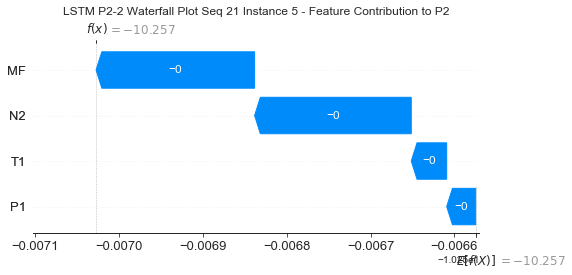

None

Contribution: [-3.18582492e-05 -3.77413459e-05 -1.65104842e-04 -1.64336453e-04]


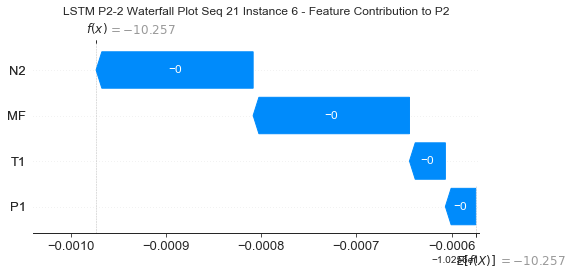

None

Contribution: [-2.21876107e-05 -3.08824856e-05 -1.44233091e-04 -1.18530048e-04]


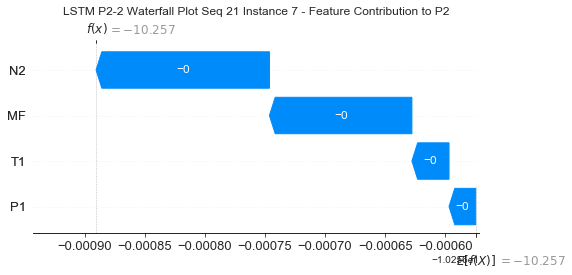

None

Contribution: [-1.73250337e-05 -2.44263907e-05 -1.28149580e-04 -8.27319054e-05]


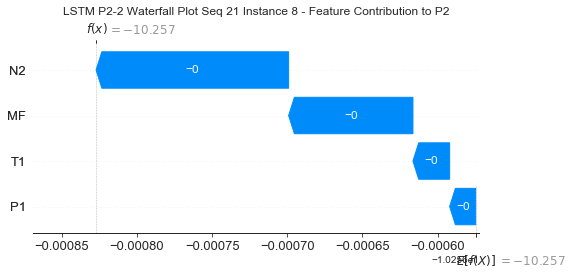

None

Contribution: [-2.16575084e-05 -2.44416421e-05 -1.26012634e-04 -9.65398871e-05]


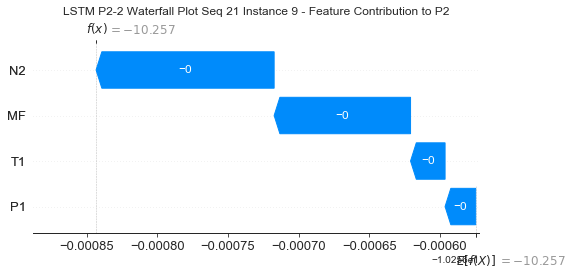

None

Contribution: [-3.39475507e-05 -2.41254827e-05 -1.26150213e-04 -1.09909445e-04]


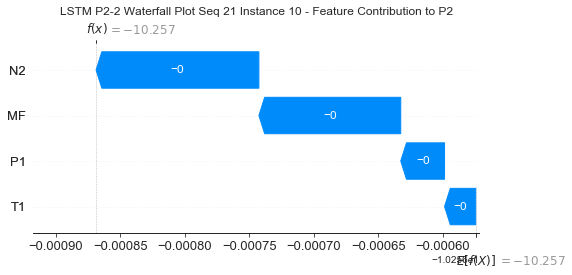

None

Contribution: [-3.74937304e-05 -2.56866508e-05 -1.31239926e-04 -1.21322377e-04]


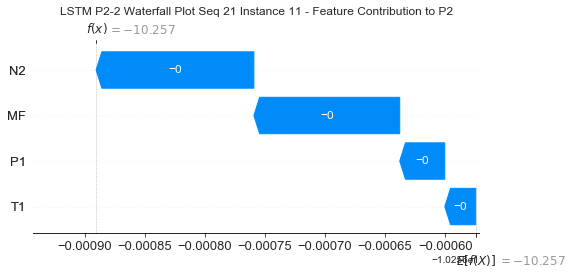

None

Contribution: [-3.83401355e-05 -2.67418683e-05 -1.36394886e-04 -1.28354488e-04]


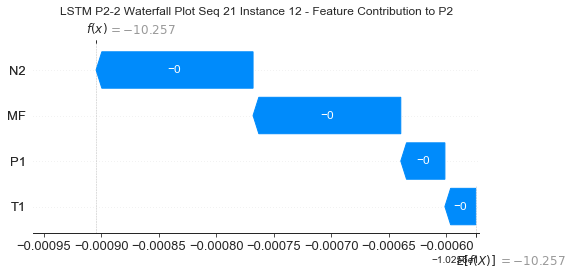

None

Contribution: [-3.69960055e-05 -2.78551188e-05 -1.42434500e-04 -1.34536410e-04]


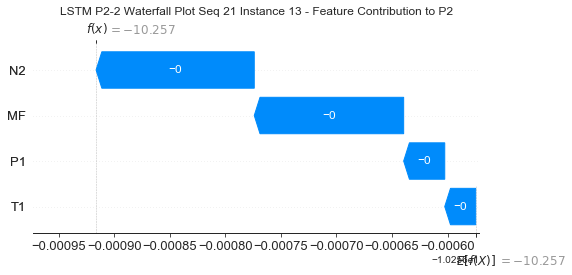

None

Contribution: [-3.27474196e-05 -2.67258770e-05 -1.44454466e-04 -1.27566923e-04]


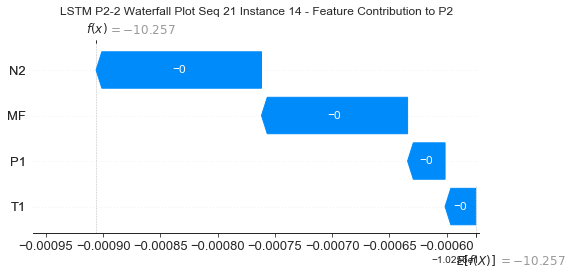

None

Contribution: [-3.68876427e-05 -2.90300637e-05 -1.52476537e-04 -1.47524807e-04]


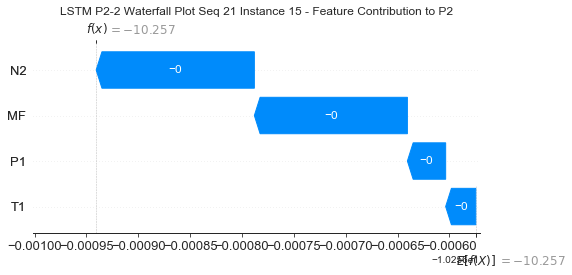

None

Contribution: [-3.67344610e-05 -2.85680305e-05 -1.51882332e-04 -1.46099523e-04]


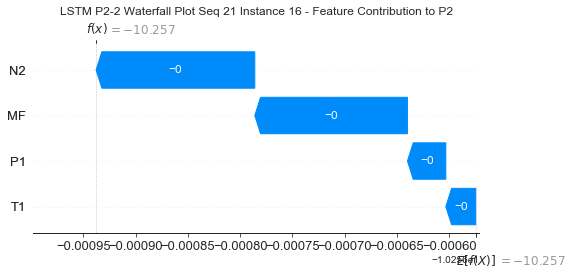

None

Contribution: [-3.68193110e-05 -2.68535527e-05 -1.48044446e-04 -1.40308934e-04]


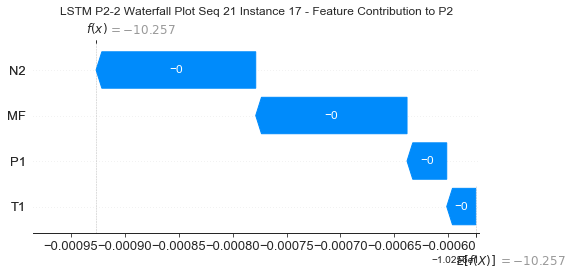

None

Contribution: [-3.42394943e-05 -3.14644643e-05 -1.71699307e-04 -1.71567617e-04]


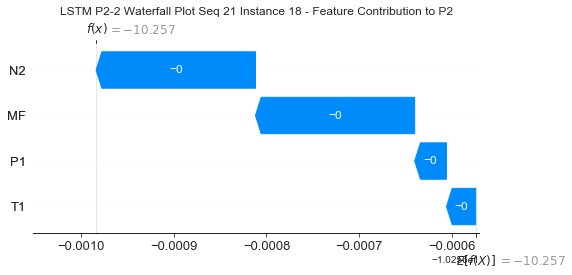

None

Contribution: [-1.87416400e-05 -5.65470686e-05 -2.77850885e-04 -3.03758728e-04]


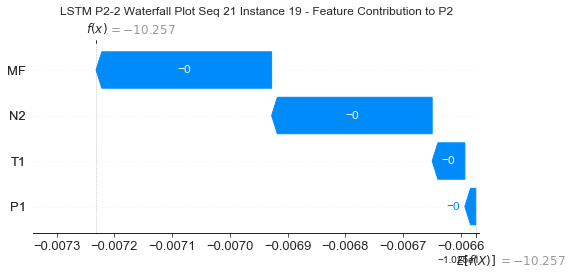

None

Contribution: [-1.03887183e-05 -7.76139679e-05 -3.42664122e-04 -3.78438089e-04]


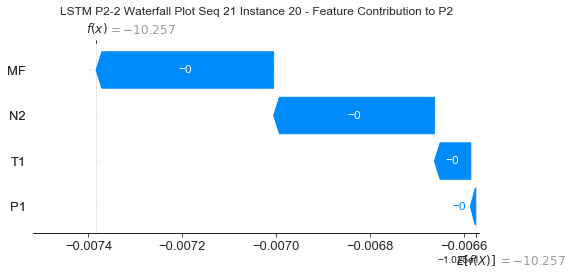

None

Contribution: [-8.69272311e-05  5.30958671e-05  2.56680609e-04  4.05233172e-04]


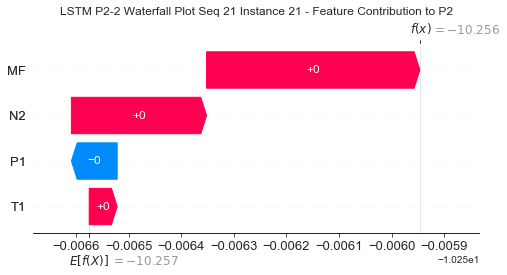

None

Contribution: [-0.00039286  0.00041779  0.00203803  0.00263161]


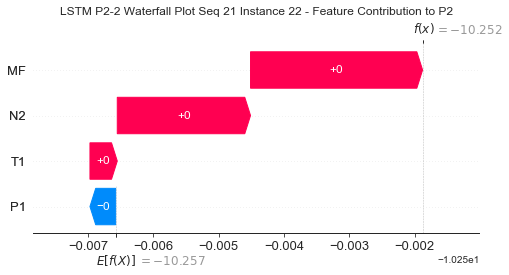

None

Contribution: [ 0.00083323 -0.0010065  -0.00656055 -0.0084382 ]


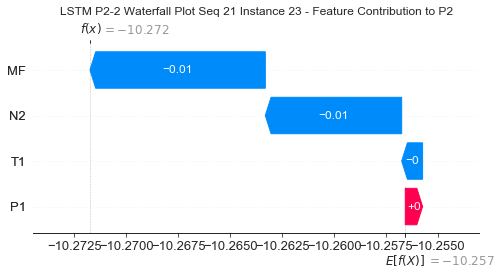

None

Contribution: [ 0.00223743  0.00598357 -0.02969862 -0.04176845]


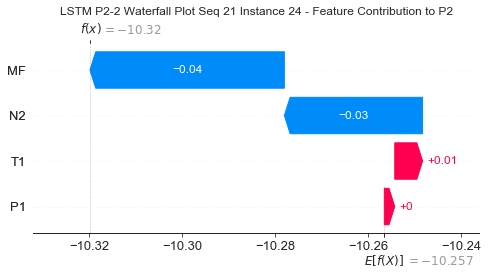

None

Contribution: [-0.01661525 -0.03523799 -0.06689322 -0.05277749]


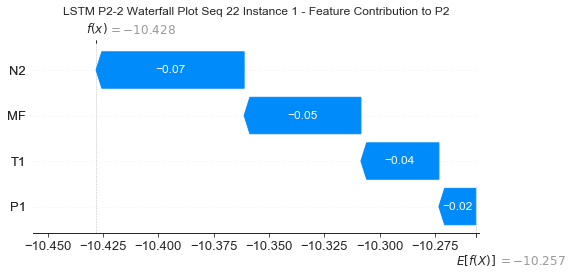

None

Contribution: [5.08708983e-04 8.83521707e-05 1.55397783e-03 1.49543643e-03]


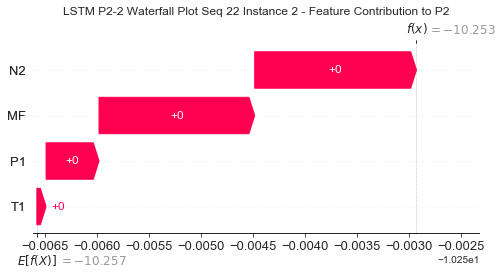

None

Contribution: [-1.12300639e-05 -1.29559182e-05 -1.30644776e-04 -1.33633287e-04]


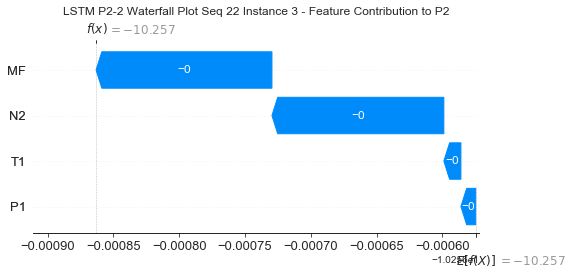

None

Contribution: [-3.55783744e-05 -5.11953301e-05 -2.12621671e-04 -2.18480207e-04]


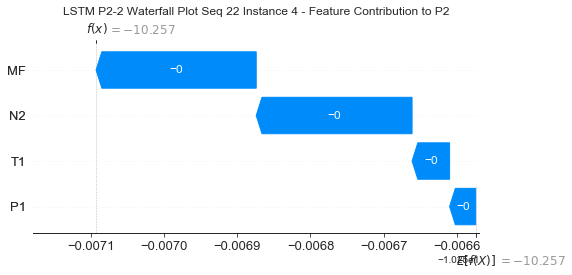

None

Contribution: [-3.39099365e-05 -4.28480029e-05 -1.86398781e-04 -1.89254141e-04]


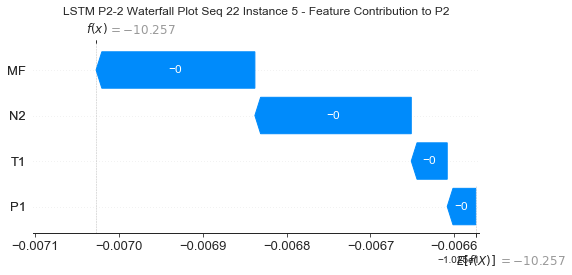

None

Contribution: [-3.22099391e-05 -3.71817925e-05 -1.64617466e-04 -1.64075650e-04]


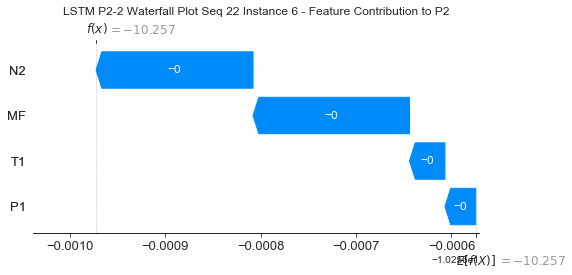

None

Contribution: [-2.18647446e-05 -3.00055401e-05 -1.44271145e-04 -1.19591588e-04]


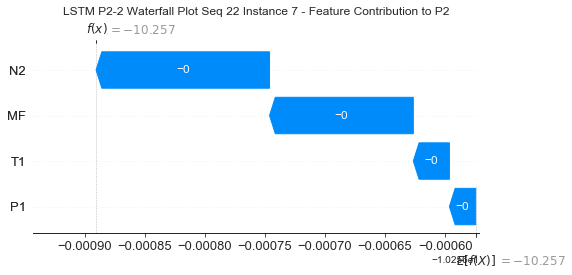

None

Contribution: [-1.75523283e-05 -2.43777563e-05 -1.28518076e-04 -8.45335257e-05]


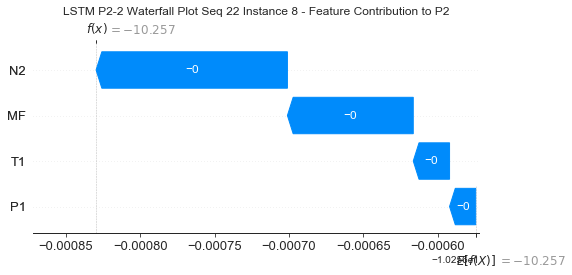

None

Contribution: [-2.21717189e-05 -2.40896238e-05 -1.26462865e-04 -9.81084531e-05]


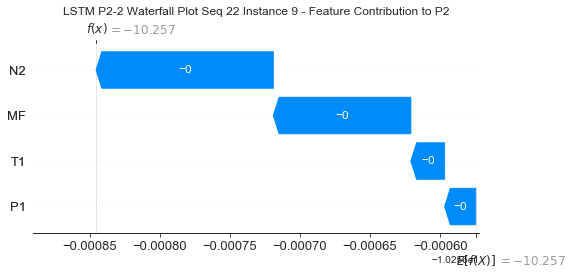

None

Contribution: [-3.41867843e-05 -2.45768691e-05 -1.26493015e-04 -1.11896414e-04]


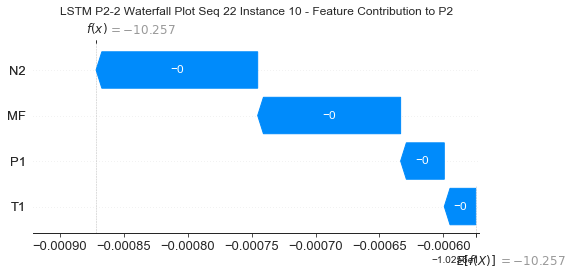

None

Contribution: [-3.74930376e-05 -2.56295776e-05 -1.31284245e-04 -1.22380251e-04]


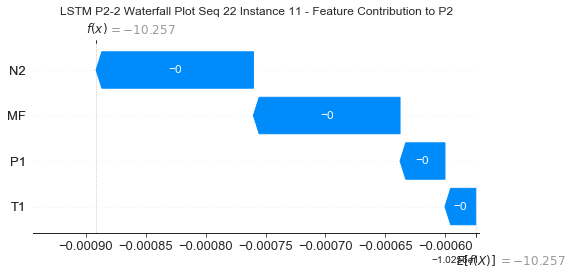

None

Contribution: [-3.73733660e-05 -2.67633147e-05 -1.36721545e-04 -1.28799414e-04]


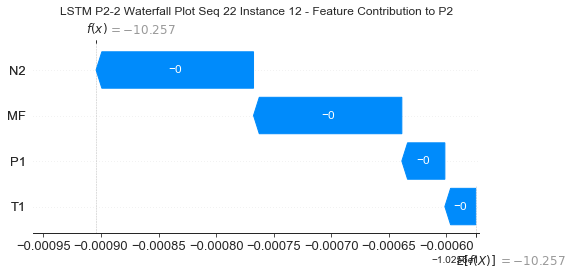

None

Contribution: [-3.78240978e-05 -2.79412921e-05 -1.42944495e-04 -1.37772729e-04]


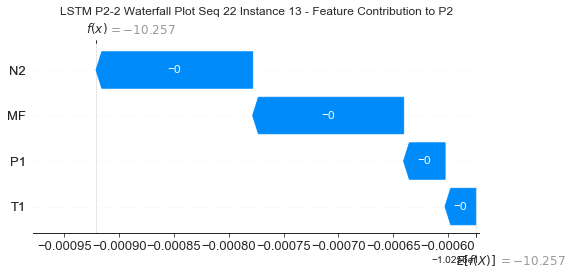

None

Contribution: [-3.21534831e-05 -2.67134555e-05 -1.44659456e-04 -1.28638611e-04]


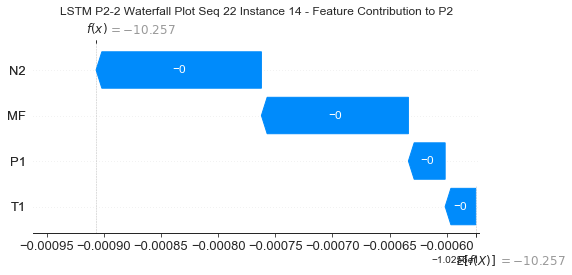

None

Contribution: [-3.58859308e-05 -2.99761703e-05 -1.52601487e-04 -1.47166412e-04]


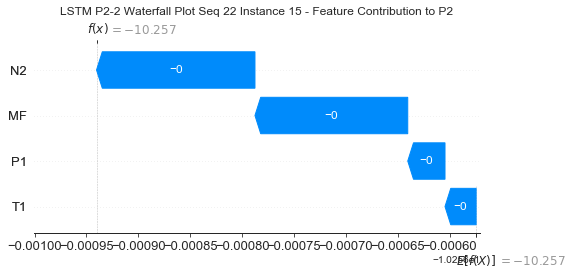

None

Contribution: [-3.63045866e-05 -2.98100769e-05 -1.52372821e-04 -1.47323436e-04]


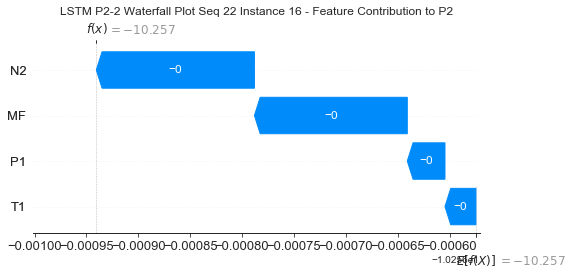

None

Contribution: [-3.64613422e-05 -2.81771515e-05 -1.48880402e-04 -1.42125758e-04]


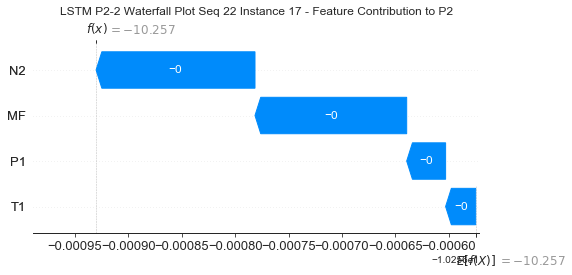

None

Contribution: [-3.45442746e-05 -3.26335939e-05 -1.71623157e-04 -1.71978047e-04]


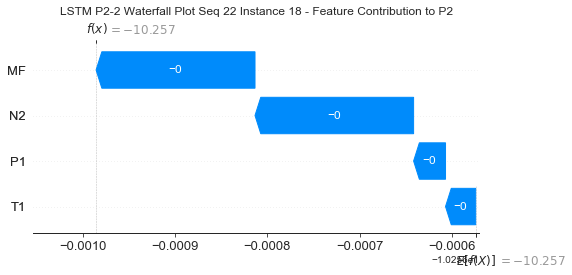

None

Contribution: [-1.92985861e-05 -5.90154269e-05 -2.74051099e-04 -3.01108777e-04]


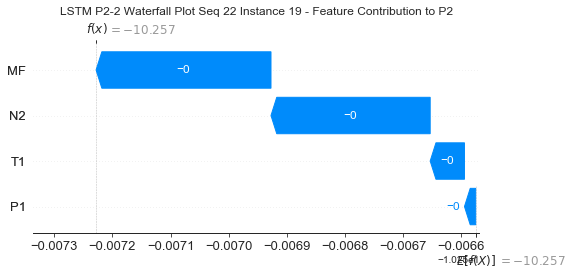

None

Contribution: [-1.09519243e-05 -8.18968770e-05 -3.38170554e-04 -3.76831332e-04]


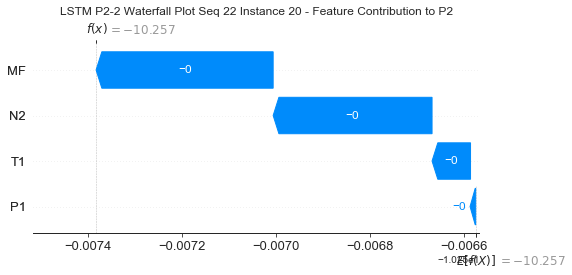

None

Contribution: [-8.54956620e-05  5.39946395e-05  2.43007983e-04  3.89430234e-04]


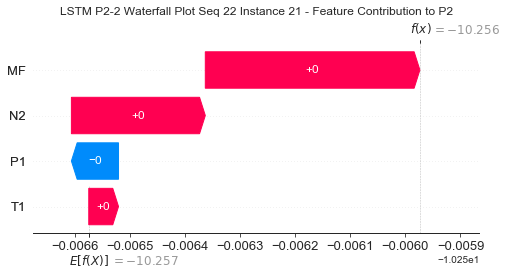

None

Contribution: [-0.00038785  0.00045971  0.00199614  0.00261247]


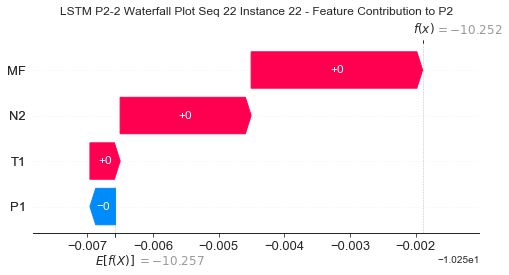

None

Contribution: [ 0.00081276 -0.00114827 -0.00649317 -0.00841925]


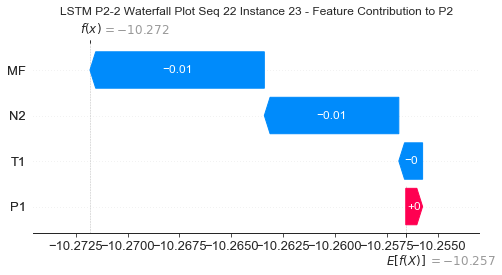

None

Contribution: [ 0.00122986  0.00573179 -0.0289201  -0.03819039]


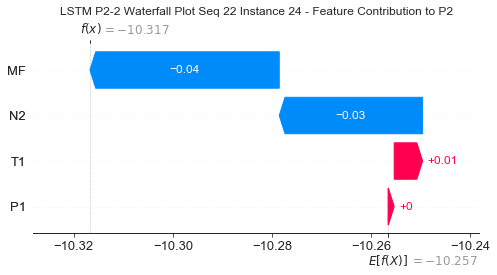

None

Contribution: [-0.01681857 -0.02859661 -0.06686229 -0.05346781]


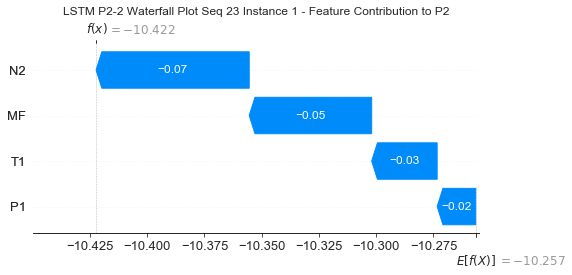

None

Contribution: [5.06300323e-04 9.40312778e-05 1.54793335e-03 1.47733675e-03]


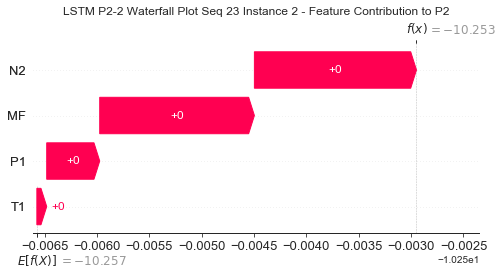

None

Contribution: [-1.13705809e-05 -1.49809689e-05 -1.31305087e-04 -1.33293984e-04]


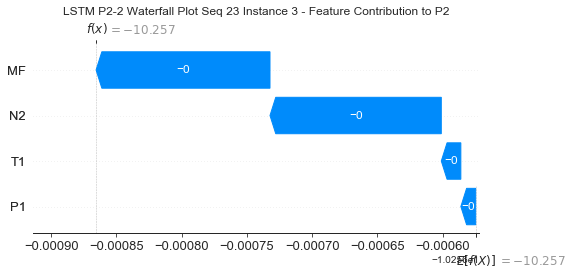

None

Contribution: [-3.57712196e-05 -5.32036262e-05 -2.13961825e-04 -2.17559646e-04]


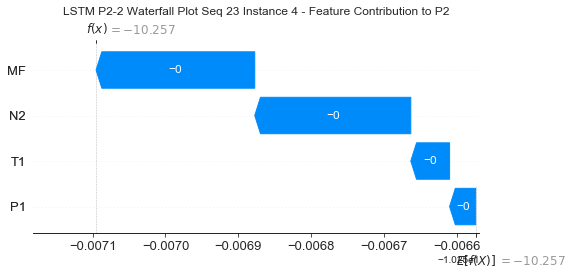

None

Contribution: [-3.40591436e-05 -4.42820009e-05 -1.87499949e-04 -1.88842727e-04]


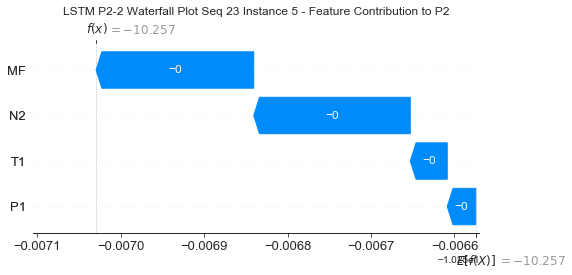

None

Contribution: [-3.26643383e-05 -3.77017881e-05 -1.65473758e-04 -1.65330013e-04]


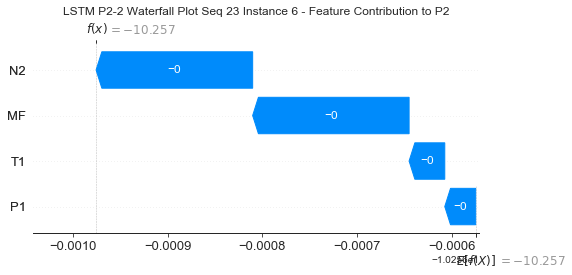

None

Contribution: [-2.20476206e-05 -3.04641276e-05 -1.44648209e-04 -1.19022835e-04]


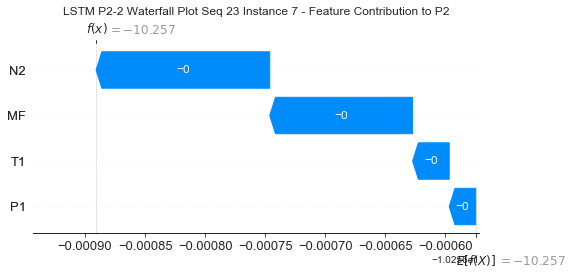

None

Contribution: [-1.78429501e-05 -2.36009551e-05 -1.28525359e-04 -8.35513643e-05]


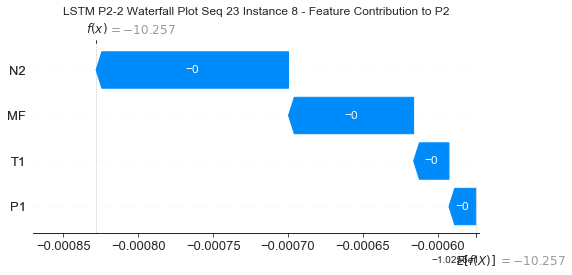

None

Contribution: [-2.20106476e-05 -2.43278508e-05 -1.26665116e-04 -9.69783026e-05]


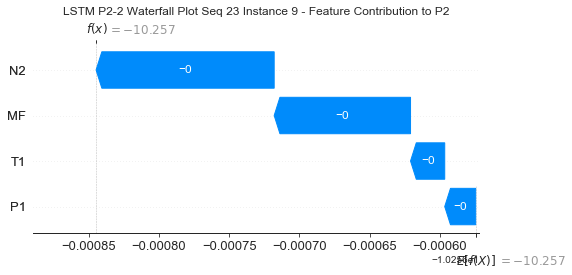

None

Contribution: [-3.47614358e-05 -2.46257846e-05 -1.27043337e-04 -1.12047592e-04]


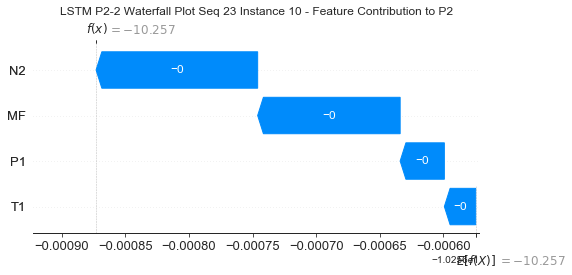

None

Contribution: [-3.78877130e-05 -2.60319863e-05 -1.31794048e-04 -1.22360273e-04]


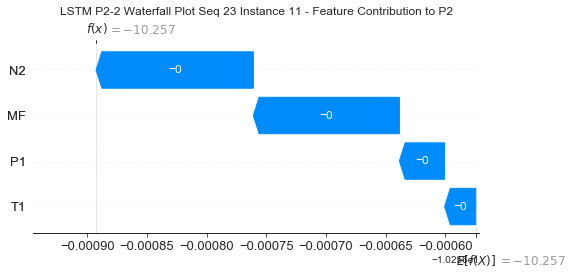

None

Contribution: [-3.77249361e-05 -2.68755956e-05 -1.36956878e-04 -1.28260736e-04]


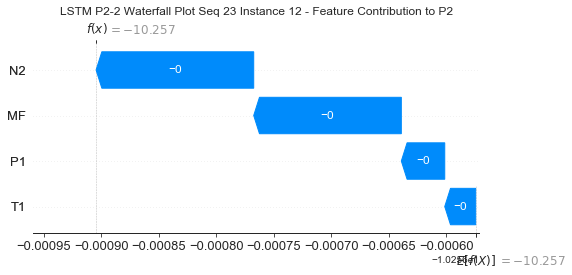

None

Contribution: [-3.76040295e-05 -2.82004249e-05 -1.43032458e-04 -1.35426001e-04]


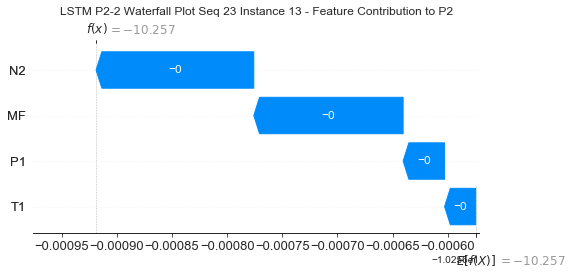

None

Contribution: [-3.25444250e-05 -2.68123601e-05 -1.44903805e-04 -1.28221863e-04]


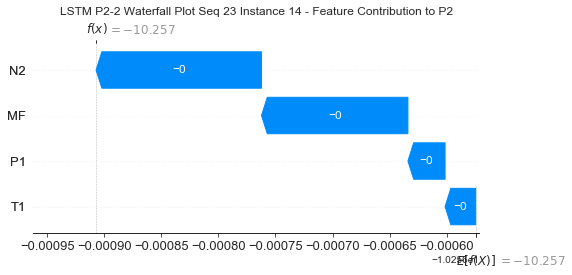

None

Contribution: [-3.64840922e-05 -2.97130981e-05 -1.52779015e-04 -1.46032964e-04]


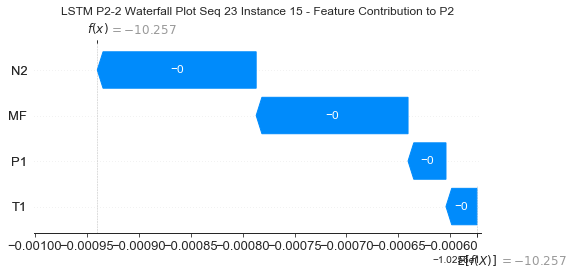

None

Contribution: [-3.65604835e-05 -2.95718862e-05 -1.52537338e-04 -1.46642123e-04]


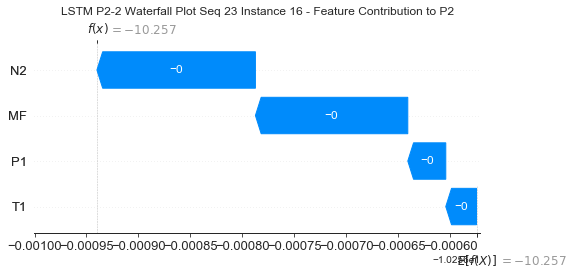

None

Contribution: [-3.66849391e-05 -2.78877478e-05 -1.48722693e-04 -1.41132112e-04]


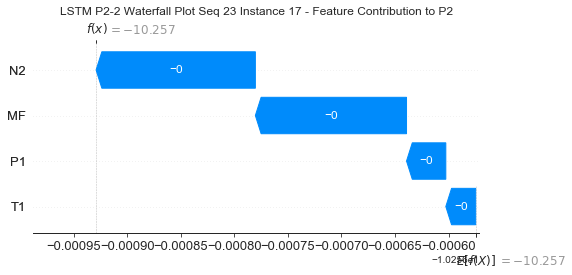

None

Contribution: [-3.36656293e-05 -3.20210888e-05 -1.71923373e-04 -1.70933719e-04]


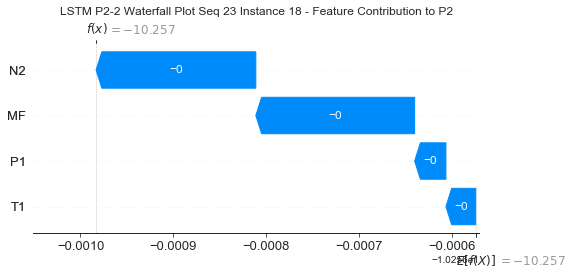

None

Contribution: [-1.91775381e-05 -5.83996057e-05 -2.75937155e-04 -3.00666037e-04]


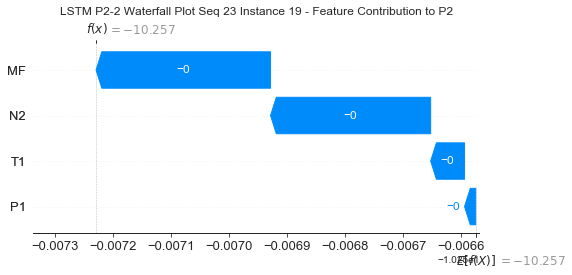

None

Contribution: [-1.06439626e-05 -8.13945447e-05 -3.41134866e-04 -3.76103145e-04]


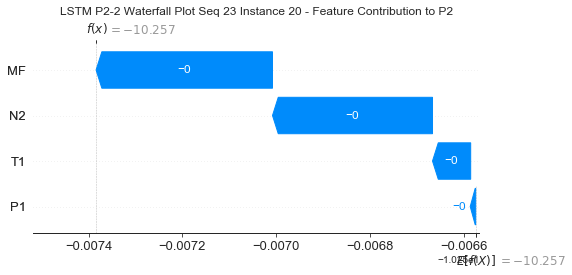

None

Contribution: [-8.66712120e-05  5.36897738e-05  2.44513361e-04  3.87940436e-04]


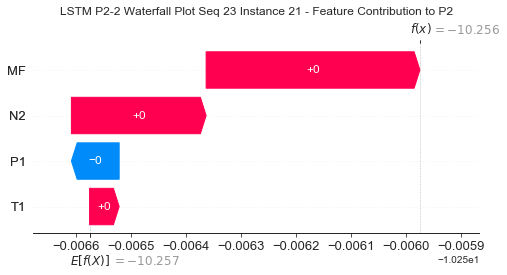

None

Contribution: [-0.00039412  0.00045984  0.00200745  0.00259448]


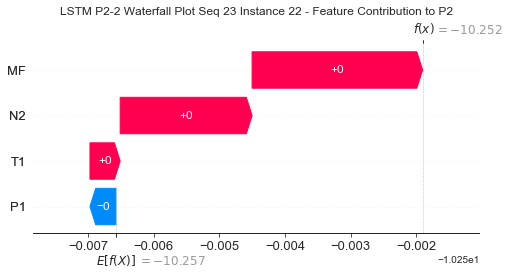

None

Contribution: [ 0.0008433  -0.00116574 -0.00649134 -0.00836046]


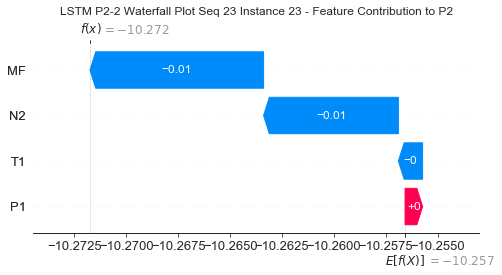

None

Contribution: [ 0.00239824  0.00416529 -0.02951912 -0.040848  ]


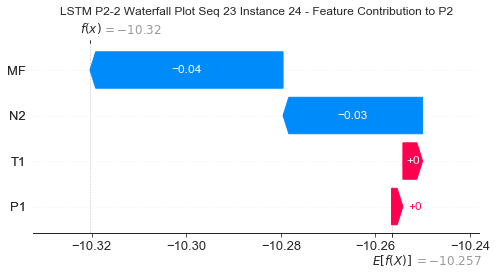

None

Contribution: [-0.01717803 -0.02983563 -0.06713115 -0.0510719 ]


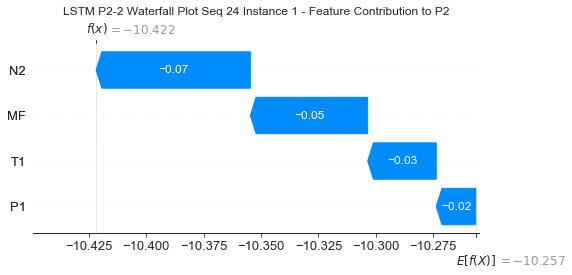

None

Contribution: [5.17270356e-04 9.39586540e-05 1.55892145e-03 1.47141585e-03]


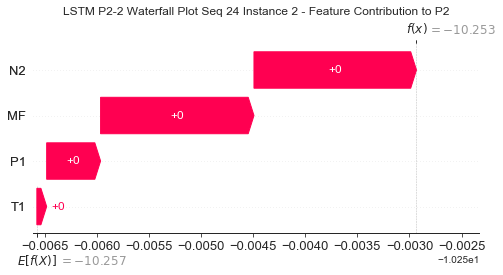

None

Contribution: [-1.12328125e-05 -1.46398835e-05 -1.31546598e-04 -1.32031377e-04]


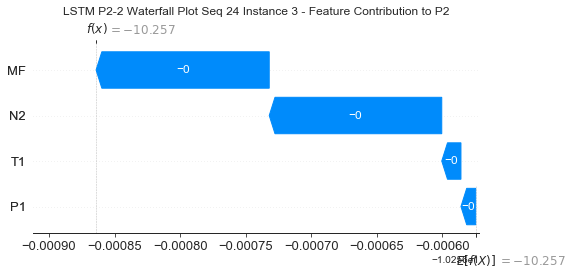

None

Contribution: [-3.59877577e-05 -5.08029280e-05 -2.14380776e-04 -2.18233714e-04]


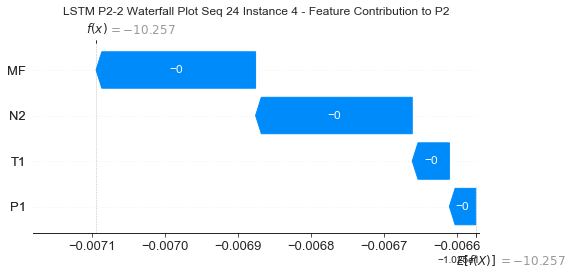

None

Contribution: [-3.41919001e-05 -4.28068438e-05 -1.87418160e-04 -1.88667629e-04]


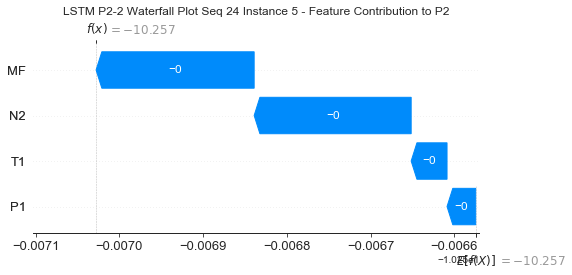

None

Contribution: [-3.24021425e-05 -3.61623411e-05 -1.65317151e-04 -1.65550261e-04]


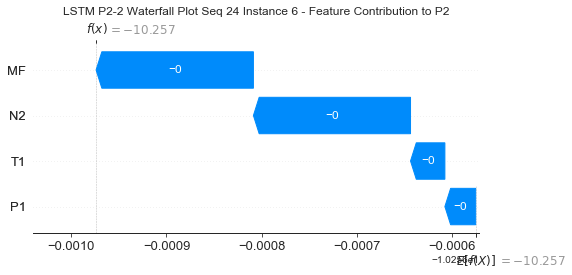

None

Contribution: [-2.20402453e-05 -2.96969184e-05 -1.44367313e-04 -1.18372602e-04]


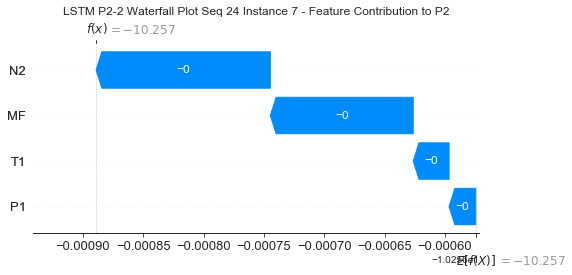

None

Contribution: [-1.74609013e-05 -2.27991814e-05 -1.28105692e-04 -8.25765411e-05]


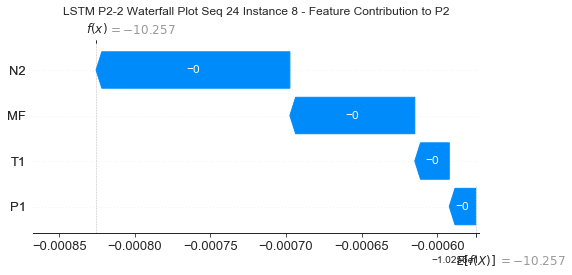

None

Contribution: [-2.16507388e-05 -2.31182643e-05 -1.26126734e-04 -9.63836634e-05]


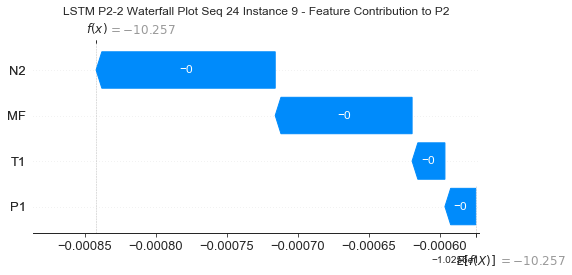

None

Contribution: [-3.48509855e-05 -2.35506303e-05 -1.26520379e-04 -1.10517602e-04]


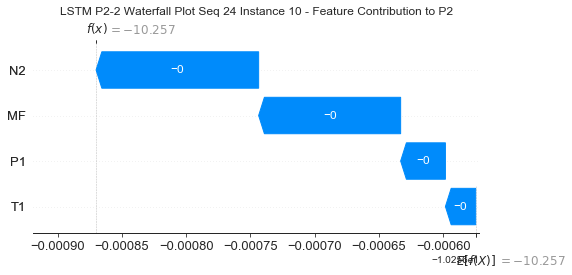

None

Contribution: [-3.81636133e-05 -2.58714966e-05 -1.31525677e-04 -1.22058389e-04]


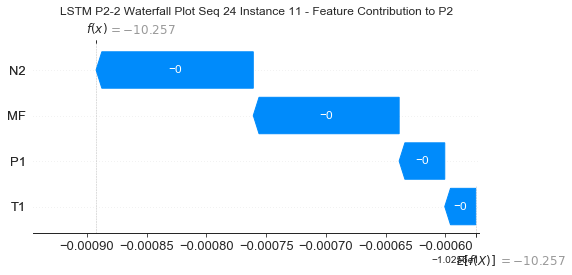

None

Contribution: [-3.79559544e-05 -2.68638953e-05 -1.36755756e-04 -1.28189643e-04]


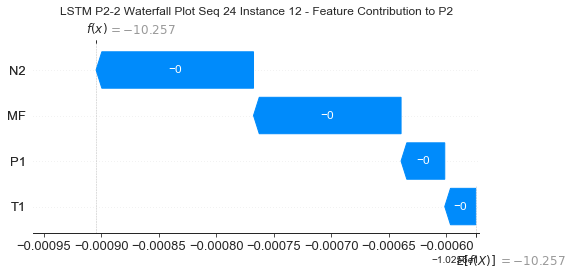

None

Contribution: [-3.75462992e-05 -2.85463380e-05 -1.42819892e-04 -1.35451795e-04]


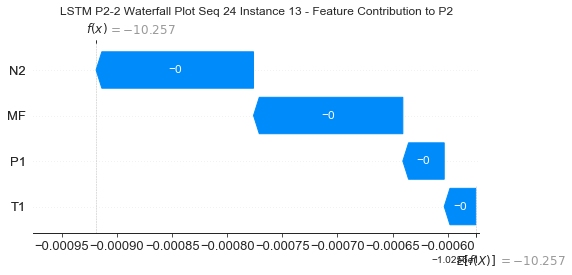

None

Contribution: [-3.28826092e-05 -2.71533045e-05 -1.44991103e-04 -1.28627722e-04]


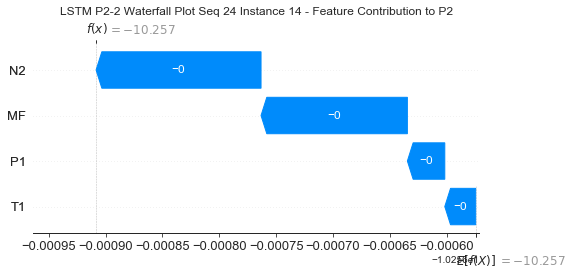

None

Contribution: [-3.64729949e-05 -3.08428236e-05 -1.53149692e-04 -1.47480250e-04]


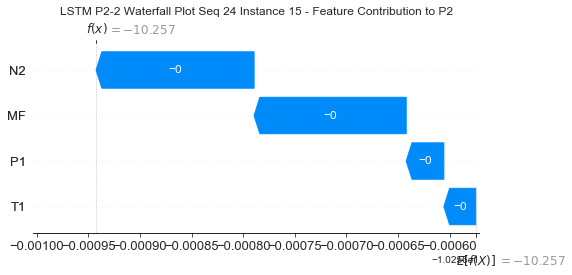

None

Contribution: [-3.68106976e-05 -3.02986385e-05 -1.52578637e-04 -1.47175833e-04]


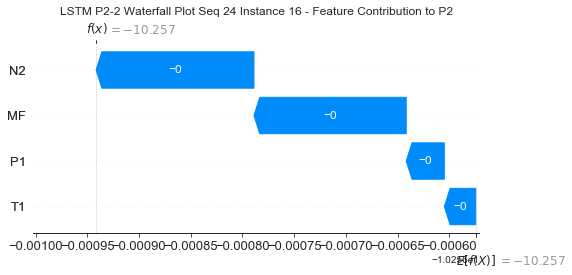

None

Contribution: [-3.67722912e-05 -2.87349786e-05 -1.48961076e-04 -1.41695257e-04]


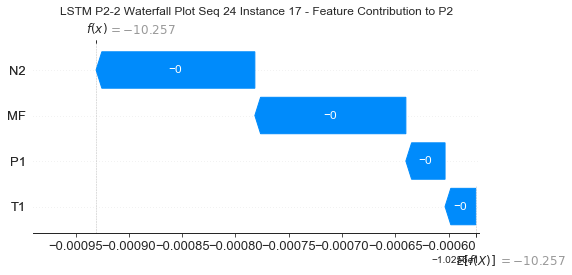

None

Contribution: [-3.43111552e-05 -3.37161569e-05 -1.71633722e-04 -1.71801124e-04]


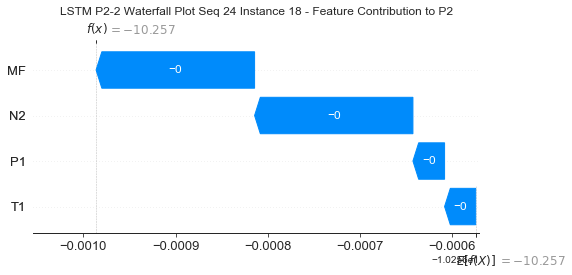

None

Contribution: [-1.94860922e-05 -6.07010044e-05 -2.74659694e-04 -3.01052888e-04]


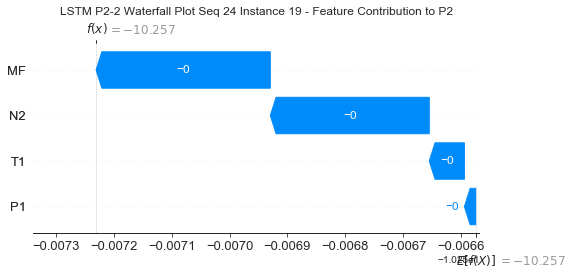

None

Contribution: [-1.09064506e-05 -8.52754017e-05 -3.39482323e-04 -3.76559171e-04]


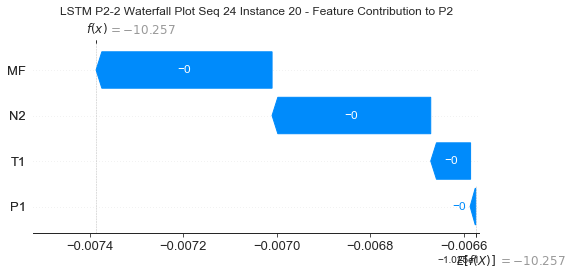

None

Contribution: [-8.69509593e-05  5.63681609e-05  2.41924036e-04  3.87230355e-04]


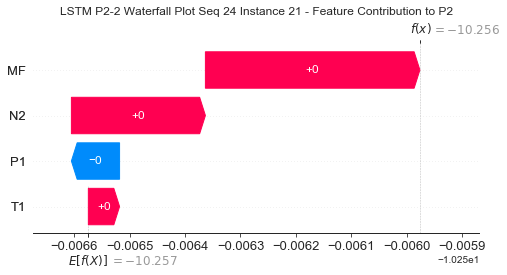

None

Contribution: [-0.00039565  0.00049791  0.00199817  0.00260014]


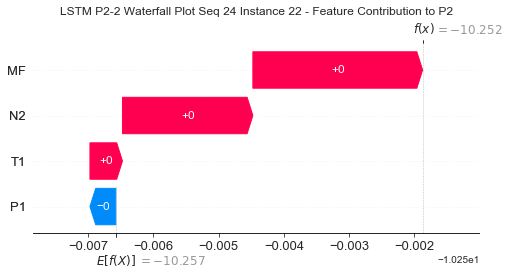

None

Contribution: [ 0.00084828 -0.00127794 -0.00646381 -0.00843453]


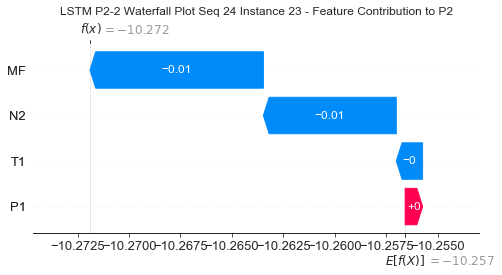

None

Contribution: [ 0.00158256  0.00352529 -0.02908476 -0.03776054]


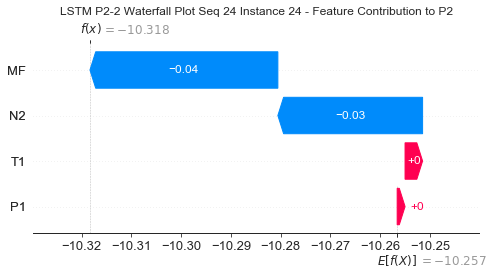

None

Contribution: [-0.01574715 -0.02376083 -0.06681826 -0.04718876]


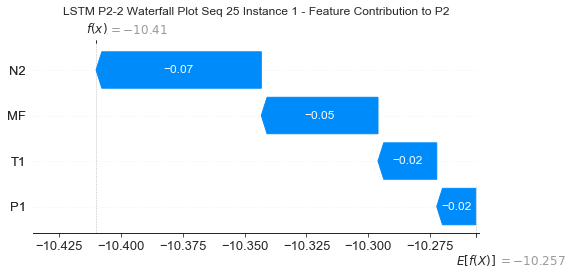

None

Contribution: [0.00051527 0.00010196 0.0015788  0.00148077]


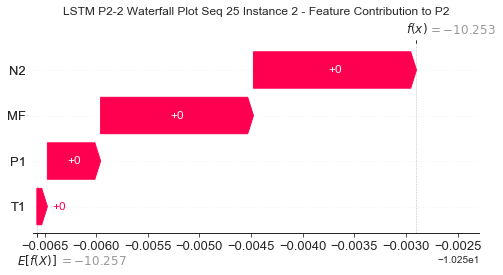

None

Contribution: [-1.11883422e-05 -1.66346809e-05 -1.32789088e-04 -1.33370386e-04]


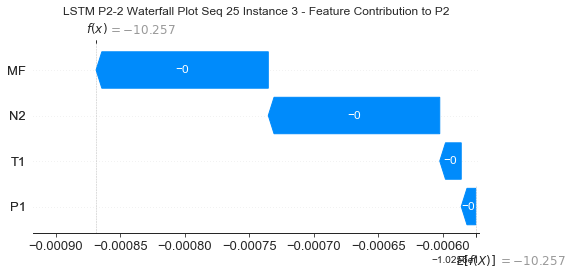

None

Contribution: [-3.62778320e-05 -5.45740107e-05 -2.15508981e-04 -2.21009738e-04]


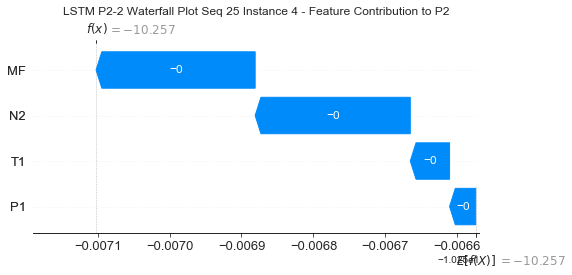

None

Contribution: [-3.42942372e-05 -4.49041483e-05 -1.87472791e-04 -1.89453595e-04]


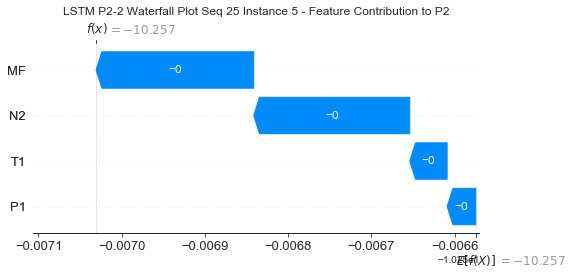

None

Contribution: [-3.10701216e-05 -3.70374446e-05 -1.65176035e-04 -1.62703264e-04]


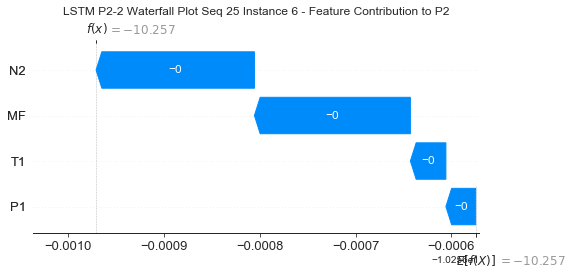

None

Contribution: [-2.20236980e-05 -3.08293243e-05 -1.44501994e-04 -1.18724852e-04]


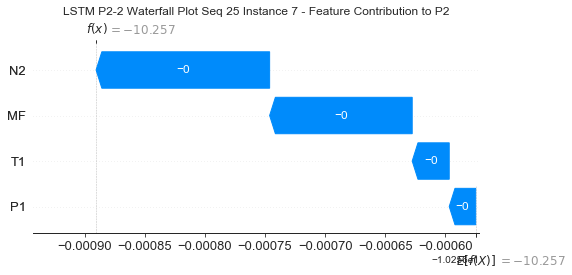

None

Contribution: [-1.71233610e-05 -2.37316480e-05 -1.28259158e-04 -8.24369468e-05]


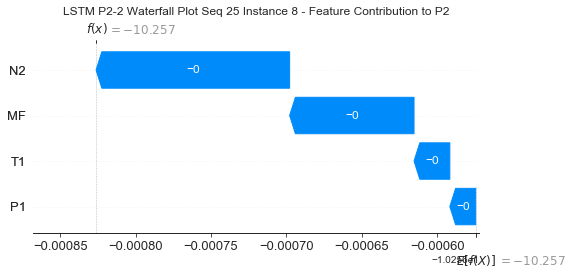

None

Contribution: [-2.15780970e-05 -2.40409581e-05 -1.26332854e-04 -9.66195686e-05]


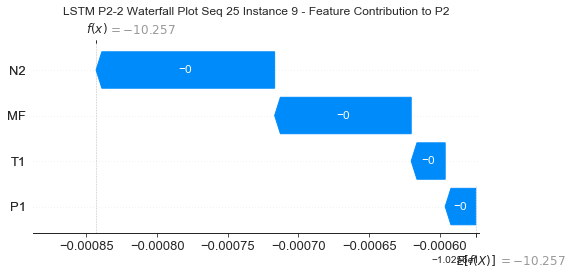

None

Contribution: [-3.49239911e-05 -2.46213663e-05 -1.26516825e-04 -1.10398378e-04]


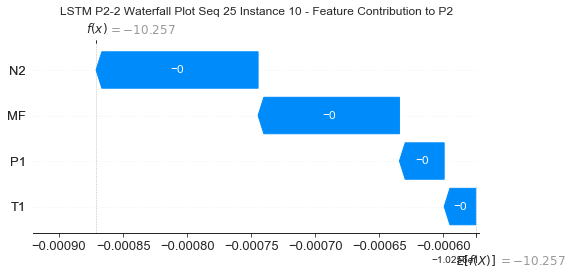

None

Contribution: [-3.76698577e-05 -2.60979674e-05 -1.31318954e-04 -1.21434743e-04]


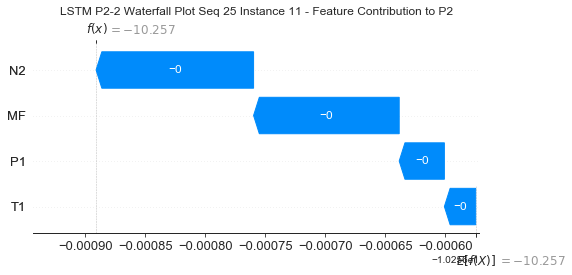

None

Contribution: [-3.74762147e-05 -2.70707010e-05 -1.36387752e-04 -1.27389614e-04]


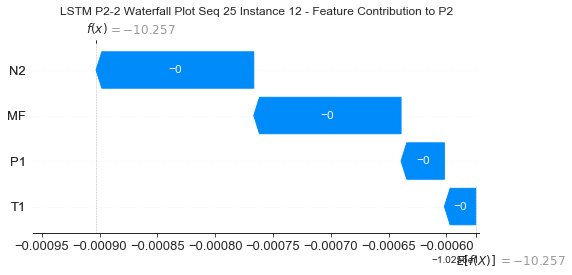

None

Contribution: [-3.64959150e-05 -2.82813207e-05 -1.42636184e-04 -1.34302085e-04]


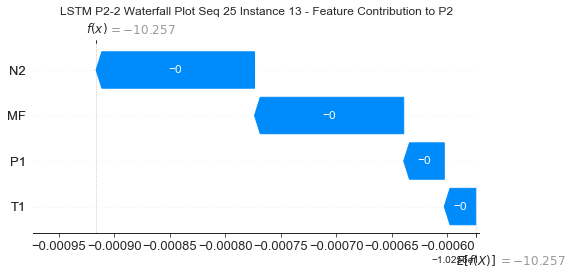

None

Contribution: [-3.21872959e-05 -2.73242833e-05 -1.44800722e-04 -1.27879050e-04]


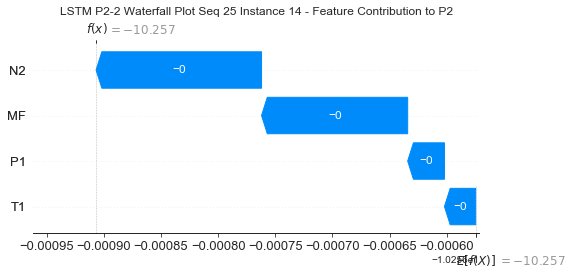

None

Contribution: [-3.70008146e-05 -3.08680861e-05 -1.52701479e-04 -1.47339433e-04]


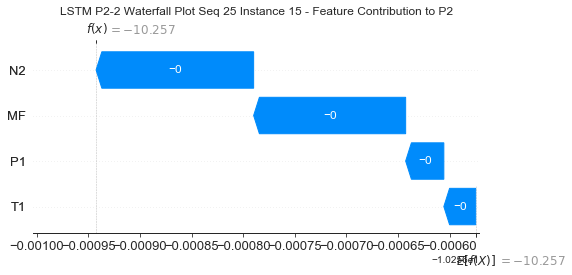

None

Contribution: [-3.61217421e-05 -3.03972007e-05 -1.52300080e-04 -1.46208852e-04]


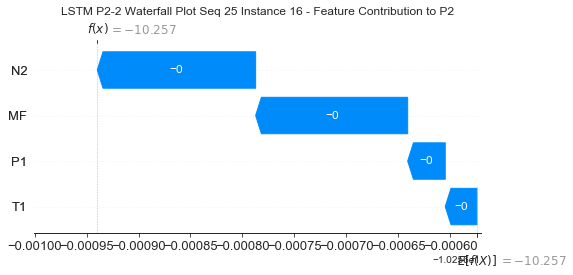

None

Contribution: [-3.63779108e-05 -2.88950500e-05 -1.48745198e-04 -1.41165175e-04]


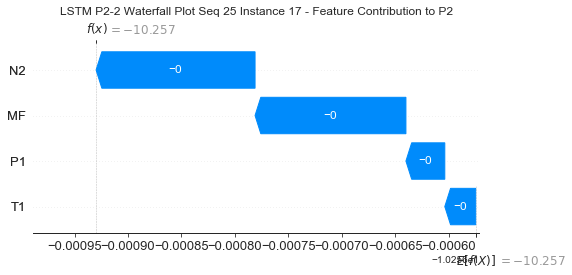

None

Contribution: [-3.43609140e-05 -3.41778143e-05 -1.71436546e-04 -1.71788765e-04]


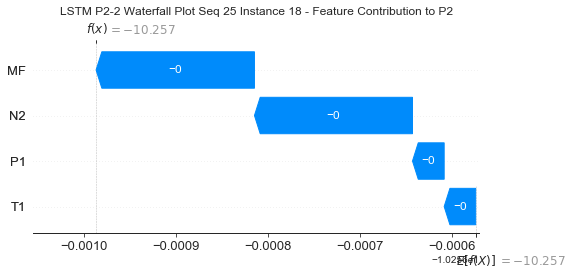

None

Contribution: [-1.93254574e-05 -6.22380252e-05 -2.74796081e-04 -3.01278401e-04]


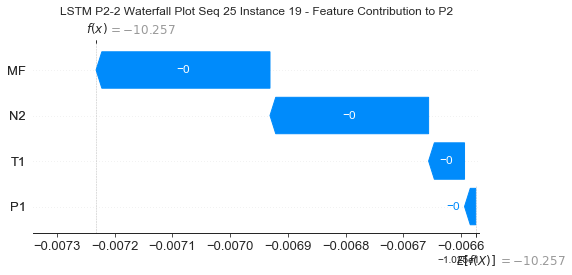

None

Contribution: [-1.06639103e-05 -8.82690119e-05 -3.41522933e-04 -3.79940271e-04]


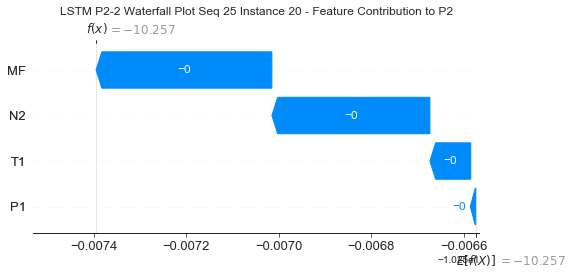

None

Contribution: [-8.57403422e-05  5.65809521e-05  2.36753177e-04  3.81601830e-04]


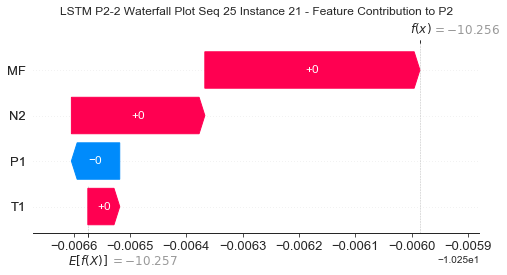

None

Contribution: [-0.00039269  0.00051238  0.00199704  0.00260408]


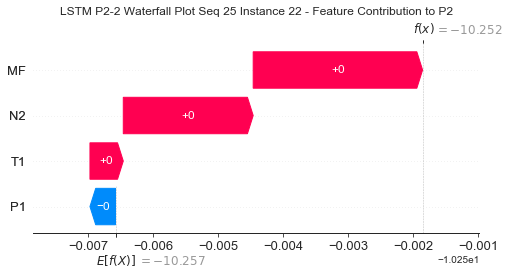

None

Contribution: [ 0.00083528 -0.00136021 -0.00644053 -0.00840538]


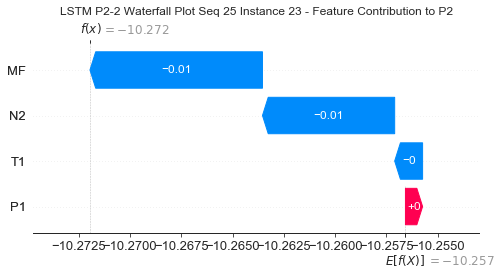

None

Contribution: [ 0.00202927 -0.0007713  -0.0295886  -0.04043874]


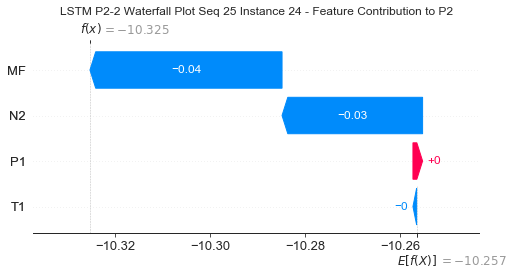

None

Contribution: [-0.01701388 -0.01847862 -0.06672291 -0.05180716]


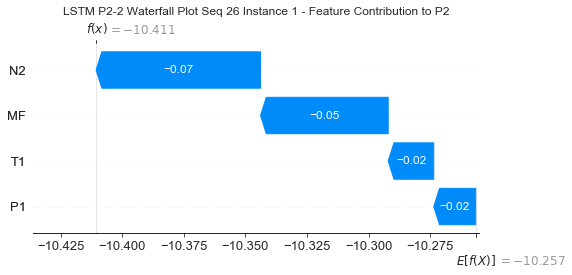

None

Contribution: [0.0005099  0.00010418 0.00154631 0.00147157]


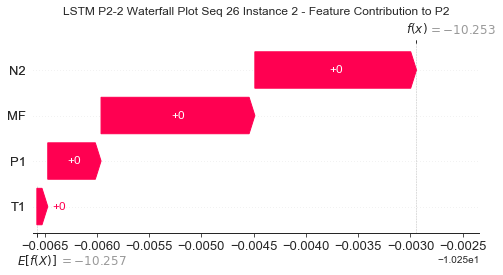

None

Contribution: [-1.13109886e-05 -1.74220155e-05 -1.31663966e-04 -1.33220904e-04]


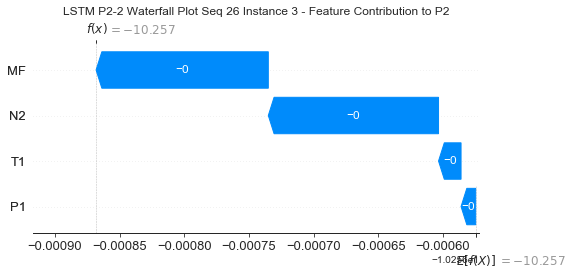

None

Contribution: [-3.51856199e-05 -5.62451848e-05 -2.14182541e-04 -2.16743804e-04]


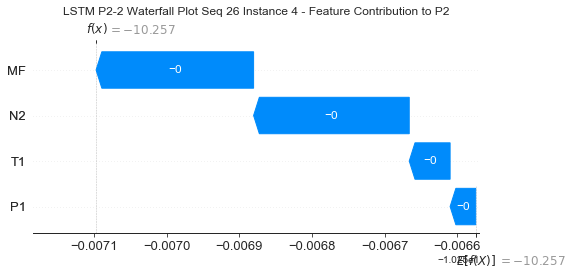

None

Contribution: [-3.35867289e-05 -4.63370537e-05 -1.87435512e-04 -1.88125399e-04]


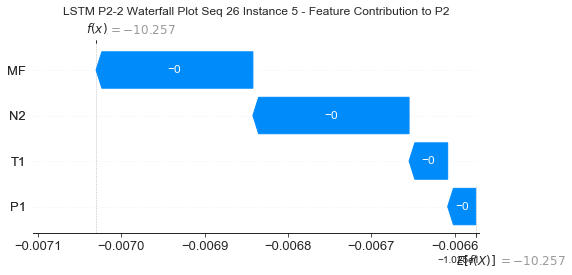

None

Contribution: [-3.19561088e-05 -3.92582940e-05 -1.65439781e-04 -1.65333790e-04]


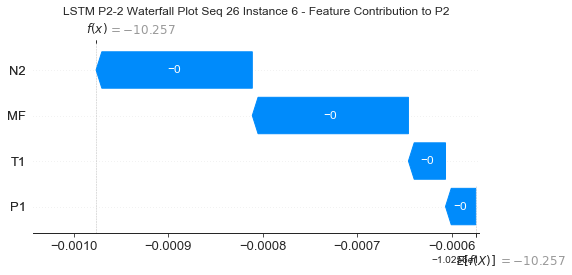

None

Contribution: [-2.16022915e-05 -3.14797046e-05 -1.44601719e-04 -1.18708488e-04]


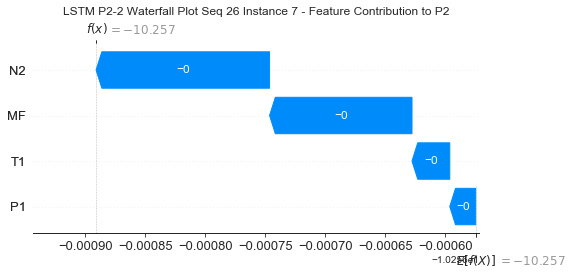

None

Contribution: [-1.72756565e-05 -2.42623075e-05 -1.28787214e-04 -8.37679584e-05]


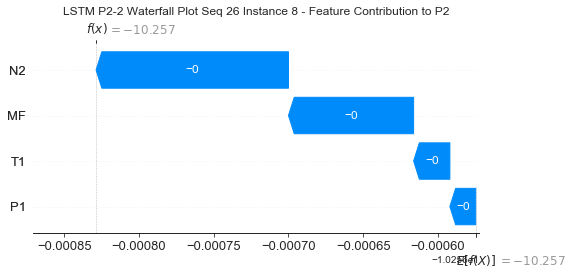

None

Contribution: [-2.29295164e-05 -2.45088419e-05 -1.27057710e-04 -9.86872021e-05]


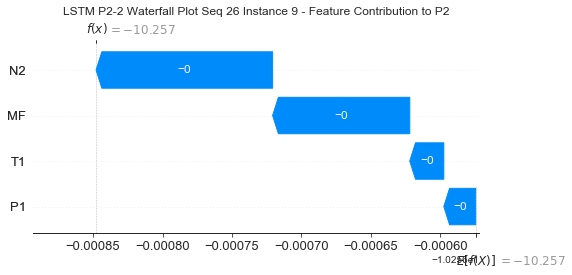

None

Contribution: [-3.50596819e-05 -2.52218351e-05 -1.27066633e-04 -1.11952311e-04]


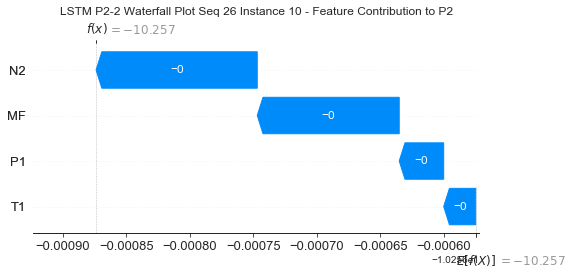

None

Contribution: [-3.75161550e-05 -2.66751624e-05 -1.31791024e-04 -1.22430006e-04]


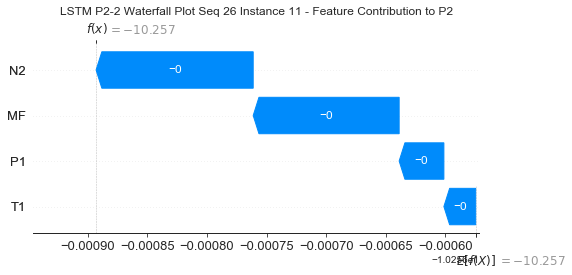

None

Contribution: [-3.72260942e-05 -2.76810455e-05 -1.37159841e-04 -1.28647724e-04]


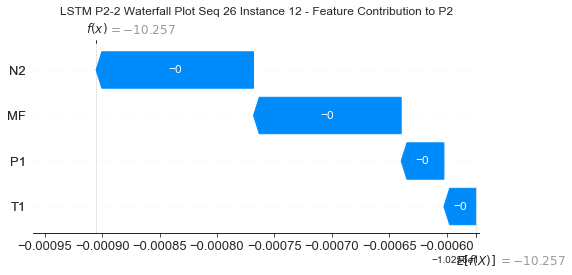

None

Contribution: [-3.75330350e-05 -2.97333338e-05 -1.43267435e-04 -1.36471721e-04]


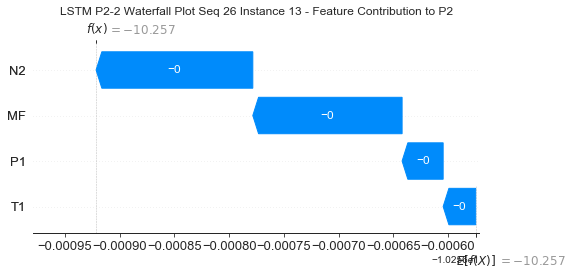

None

Contribution: [-3.22101538e-05 -2.77776665e-05 -1.45327851e-04 -1.29232925e-04]


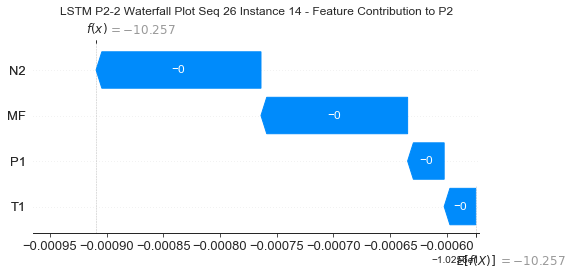

None

Contribution: [-3.63190418e-05 -3.15075813e-05 -1.53113841e-04 -1.48053106e-04]


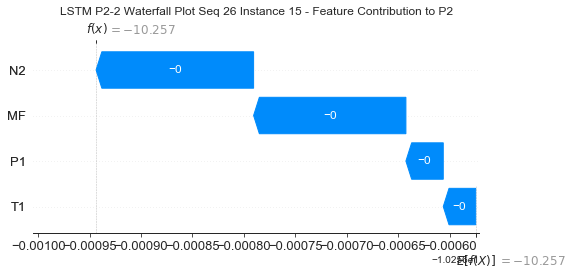

None

Contribution: [-3.62535810e-05 -3.06708008e-05 -1.52829829e-04 -1.47648816e-04]


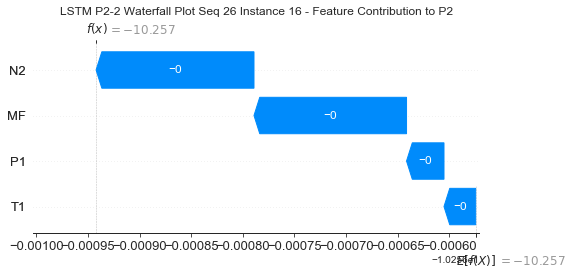

None

Contribution: [-3.64775058e-05 -2.88396279e-05 -1.49055399e-04 -1.42024712e-04]


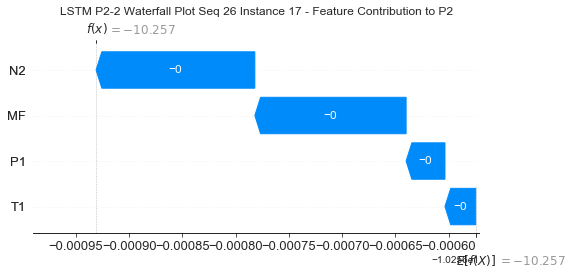

None

Contribution: [-3.38210193e-05 -3.35090836e-05 -1.71826075e-04 -1.71462851e-04]


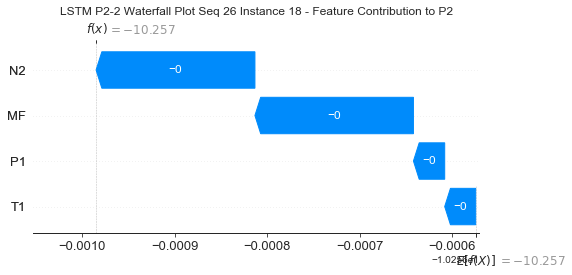

None

Contribution: [-1.91767054e-05 -6.10344314e-05 -2.74861033e-04 -3.02021475e-04]


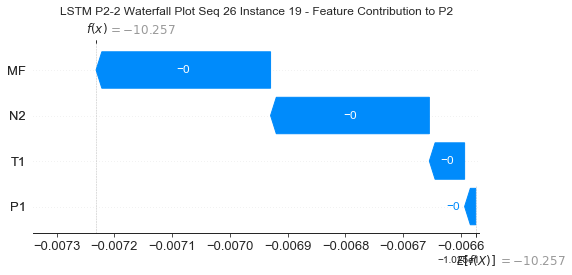

None

Contribution: [-1.04901853e-05 -8.58648257e-05 -3.41795107e-04 -3.81221472e-04]


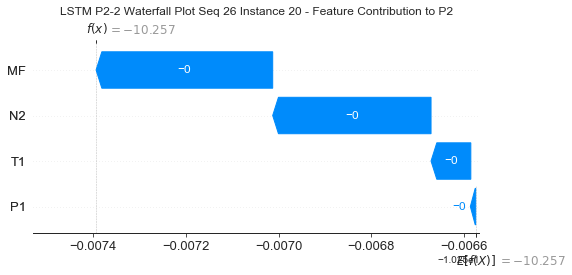

None

Contribution: [-8.50880996e-05  5.39719042e-05  2.33663278e-04  3.78633799e-04]


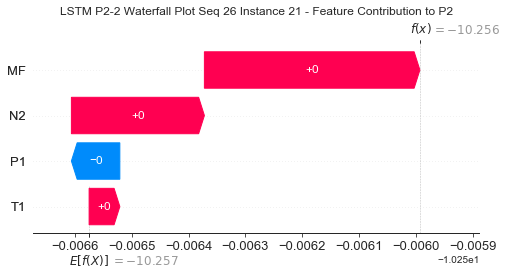

None

Contribution: [-0.00039298  0.00048857  0.00198858  0.00261584]


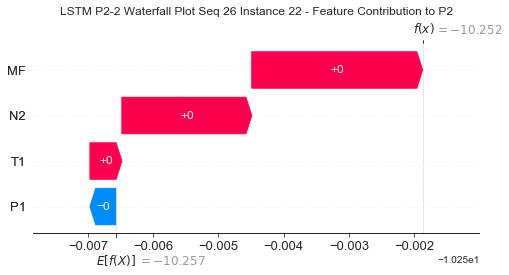

None

Contribution: [ 0.00083958 -0.00129828 -0.0064053  -0.00849466]


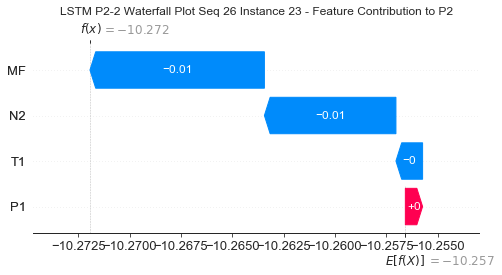

None

Contribution: [ 0.00204039  0.00054105 -0.02944851 -0.04239881]


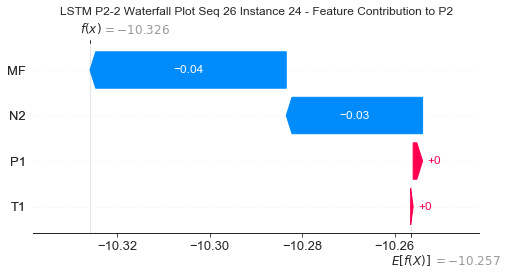

None

Contribution: [-0.01611287 -0.02727746 -0.06683127 -0.0494014 ]


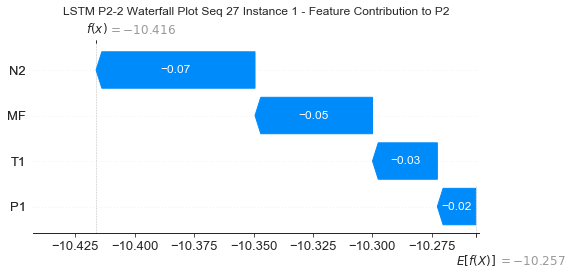

None

Contribution: [0.0005076  0.0001001  0.00156853 0.0014905 ]


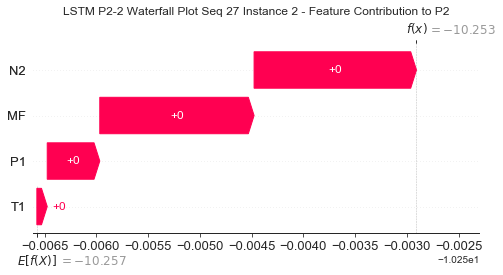

None

Contribution: [-1.11088245e-05 -1.70373281e-05 -1.32152381e-04 -1.34271441e-04]


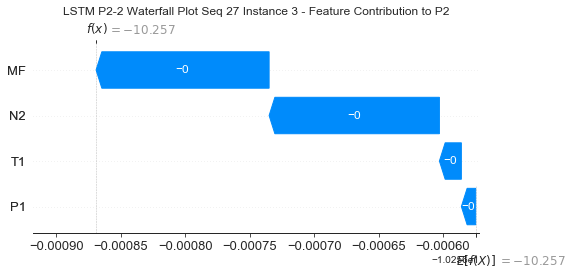

None

Contribution: [-3.58720757e-05 -5.54361368e-05 -2.14654762e-04 -2.18251081e-04]


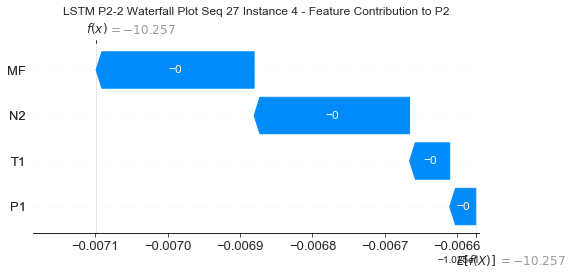

None

Contribution: [-3.40293312e-05 -4.58219082e-05 -1.87470250e-04 -1.88700971e-04]


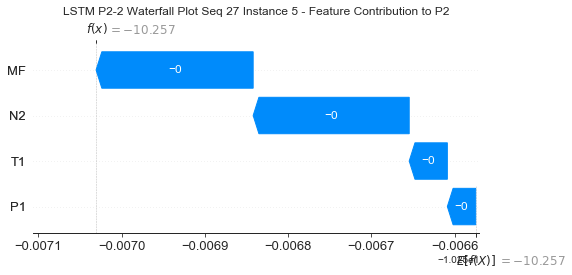

None

Contribution: [-3.17764343e-05 -3.83873160e-05 -1.65424711e-04 -1.64321306e-04]


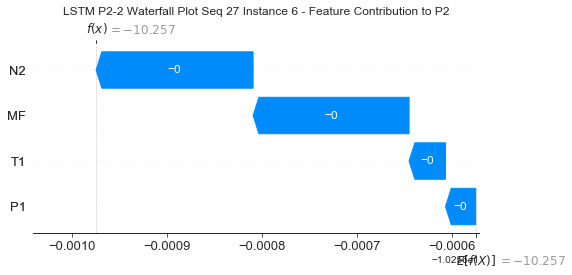

None

Contribution: [-2.17452723e-05 -3.11775345e-05 -1.44526001e-04 -1.18590852e-04]


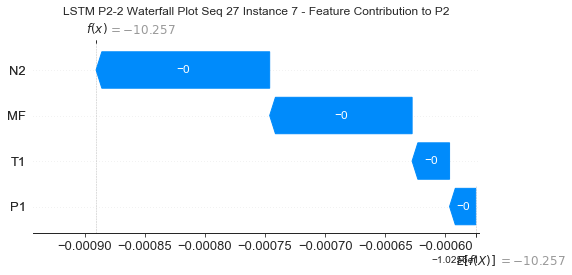

None

Contribution: [-1.67716838e-05 -2.36272844e-05 -1.27917849e-04 -8.21976823e-05]


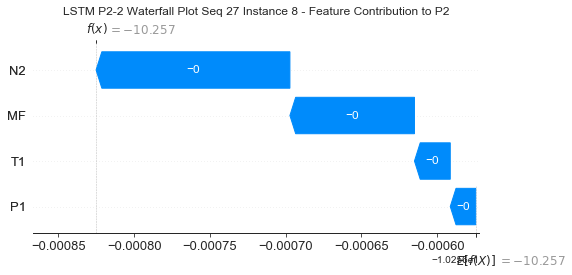

None

Contribution: [-2.05389130e-05 -2.26954046e-05 -1.25902914e-04 -9.55583520e-05]


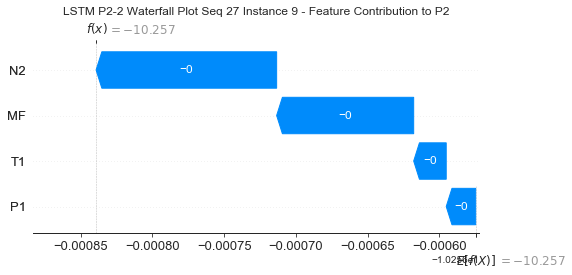

None

Contribution: [-3.37049804e-05 -2.45963495e-05 -1.26561096e-04 -1.10445236e-04]


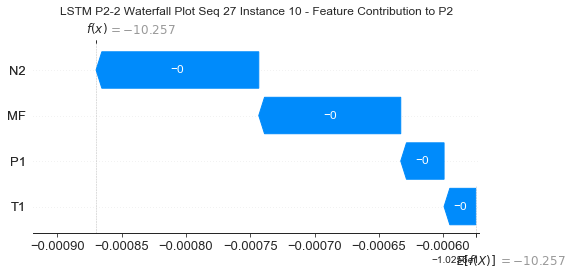

None

Contribution: [-3.78204264e-05 -2.68133684e-05 -1.31619648e-04 -1.22153125e-04]


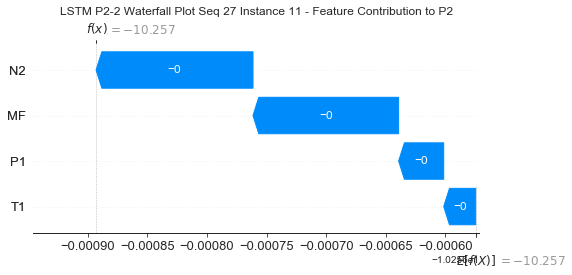

None

Contribution: [-3.76539759e-05 -2.77434658e-05 -1.36684507e-04 -1.28062542e-04]


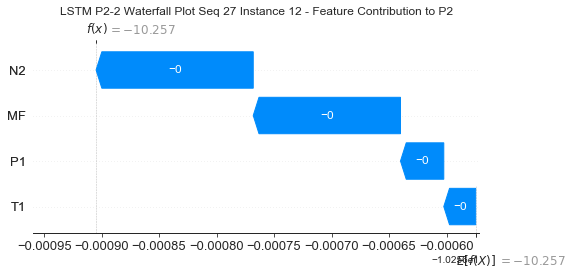

None

Contribution: [-3.68401093e-05 -2.92390414e-05 -1.42723499e-04 -1.34466573e-04]


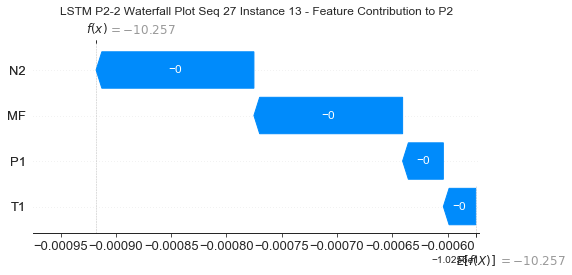

None

Contribution: [-3.22393117e-05 -2.78688157e-05 -1.44810360e-04 -1.28210878e-04]


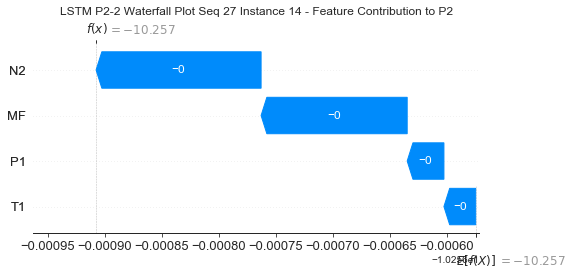

None

Contribution: [-3.62459384e-05 -3.12886540e-05 -1.52618758e-04 -1.46652120e-04]


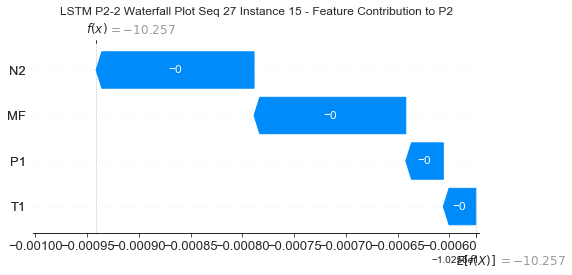

None

Contribution: [-3.61461503e-05 -3.09041491e-05 -1.52354524e-04 -1.46686604e-04]


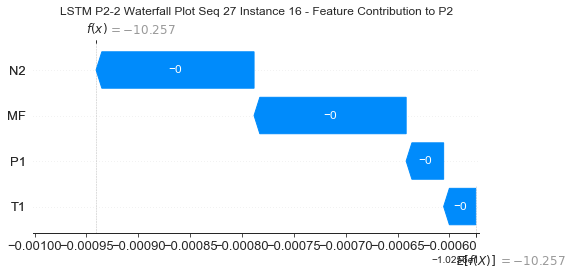

None

Contribution: [-3.61372972e-05 -2.91682675e-05 -1.48863046e-04 -1.41523446e-04]


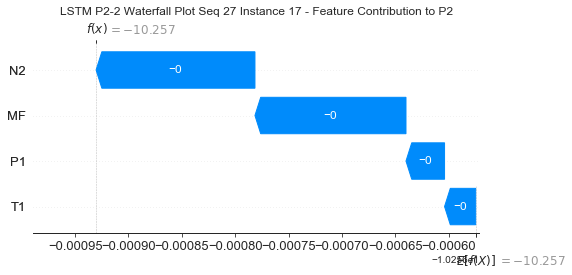

None

Contribution: [-3.40899513e-05 -3.43229046e-05 -1.71468866e-04 -1.72444543e-04]


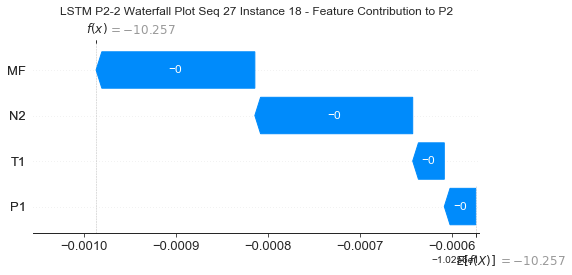

None

Contribution: [-1.87658562e-05 -6.18458692e-05 -2.74727031e-04 -3.00066275e-04]


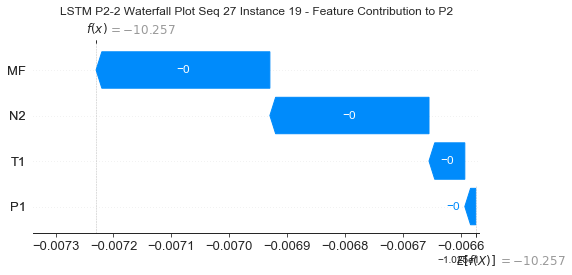

None

Contribution: [-1.04045856e-05 -8.69999726e-05 -3.40329287e-04 -3.76024515e-04]


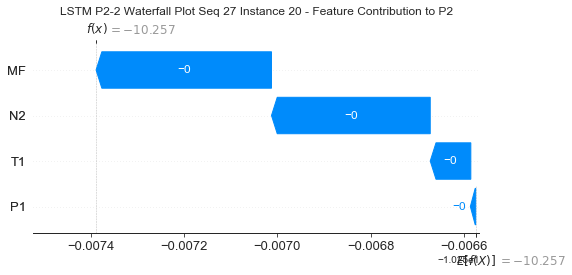

None

Contribution: [-8.38355285e-05  5.63913672e-05  2.39797794e-04  3.81999375e-04]


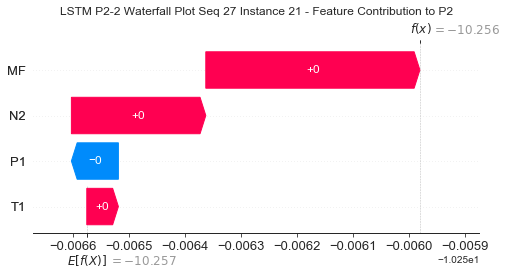

None

Contribution: [-0.00038168  0.00050198  0.00199268  0.00257466]


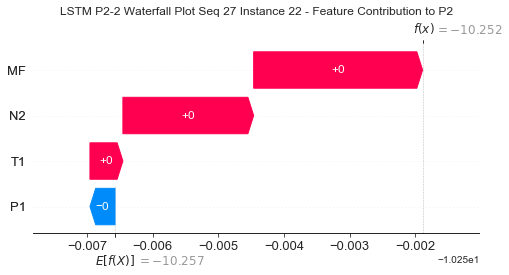

None

Contribution: [ 0.0007901  -0.00131799 -0.00644792 -0.00824342]


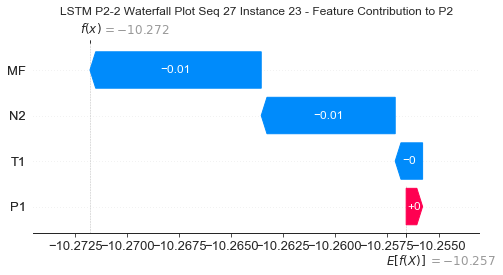

None

Contribution: [ 0.00206569  0.00030472 -0.02905972 -0.04084148]


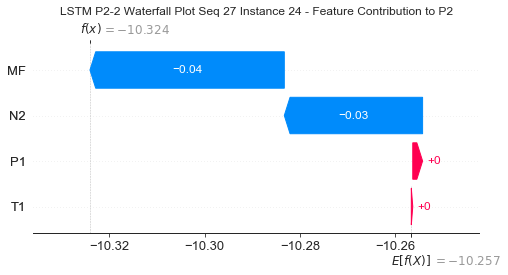

None

Contribution: [-0.0179955  -0.02207398 -0.06651935 -0.05448615]


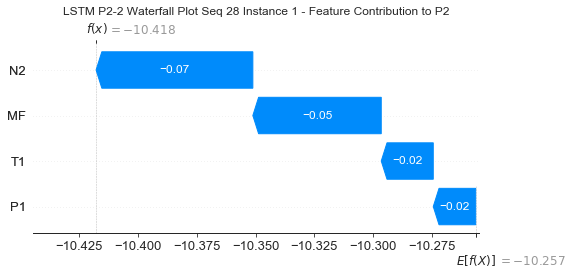

None

Contribution: [0.00051924 0.00010298 0.00154328 0.00149018]


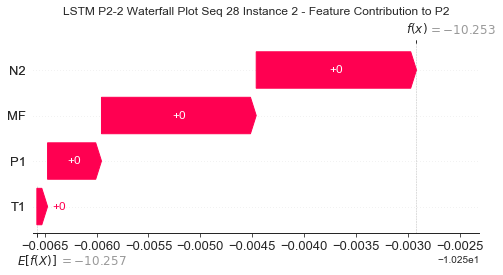

None

Contribution: [-1.14127640e-05 -1.71942705e-05 -1.30965143e-04 -1.35451237e-04]


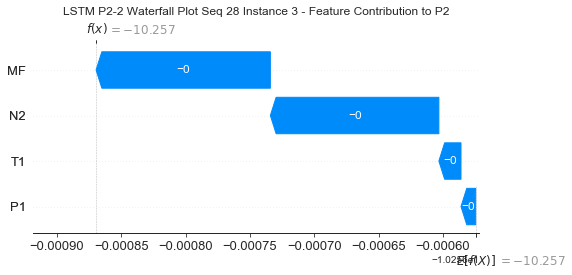

None

Contribution: [-3.61202896e-05 -6.05837162e-05 -2.13779725e-04 -2.18671961e-04]


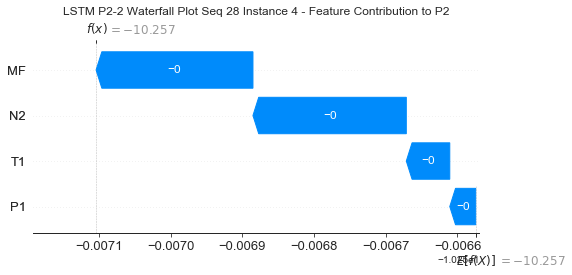

None

Contribution: [-3.41985649e-05 -4.89453146e-05 -1.87519882e-04 -1.88948868e-04]


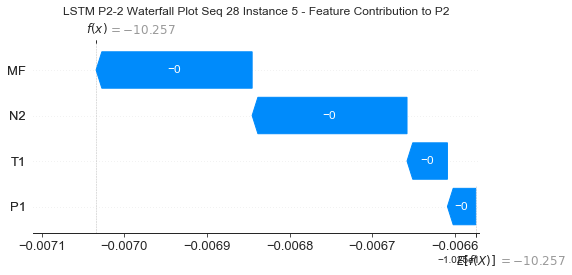

None

Contribution: [-3.30518971e-05 -4.20298943e-05 -1.65281985e-04 -1.66775198e-04]


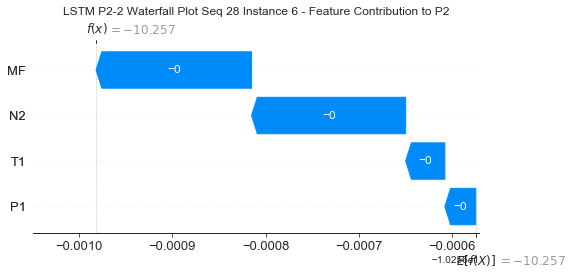

None

Contribution: [-2.23608158e-05 -3.18114494e-05 -1.44003919e-04 -1.18229260e-04]


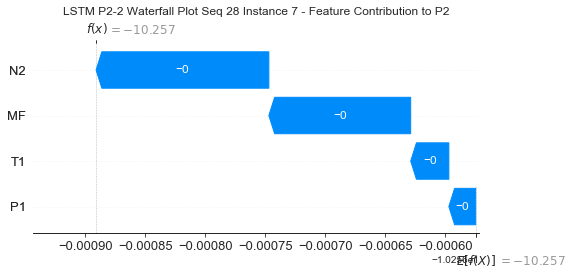

None

Contribution: [-1.77140703e-05 -2.38731348e-05 -1.27517630e-04 -8.20074322e-05]


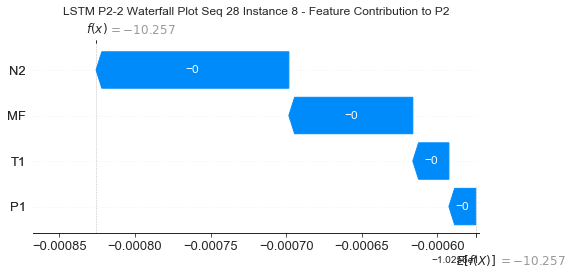

None

Contribution: [-2.20857677e-05 -2.38663790e-05 -1.25490856e-04 -9.64231281e-05]


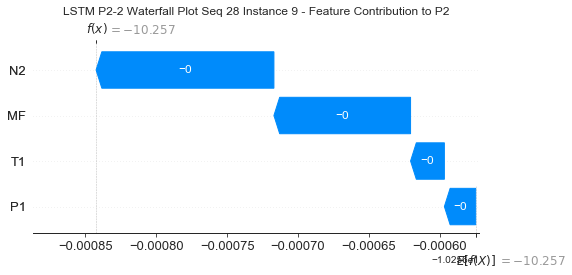

None

Contribution: [-3.43985054e-05 -2.42228867e-05 -1.25817605e-04 -1.09548470e-04]


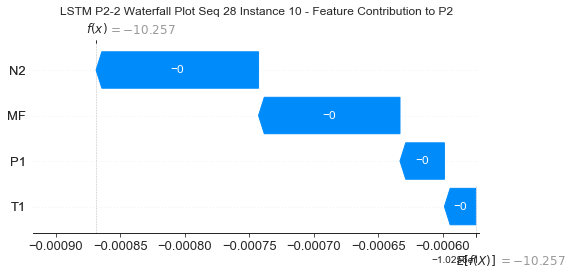

None

Contribution: [-3.85405309e-05 -2.66773437e-05 -1.30837231e-04 -1.21494707e-04]


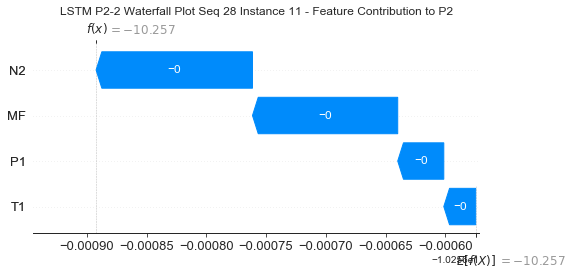

None

Contribution: [-3.87256363e-05 -2.71346778e-05 -1.35797858e-04 -1.27406724e-04]


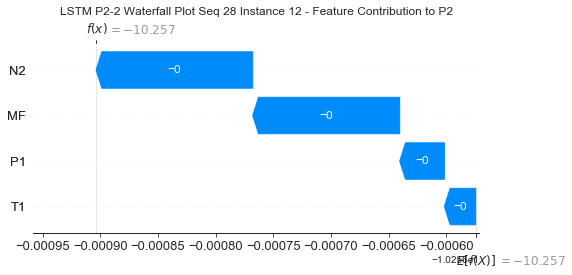

None

Contribution: [-3.63491647e-05 -2.84326019e-05 -1.41845481e-04 -1.33782268e-04]


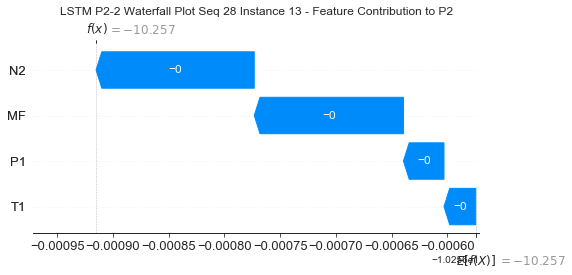

None

Contribution: [-3.42561989e-05 -2.60045328e-05 -1.43894366e-04 -1.27801764e-04]


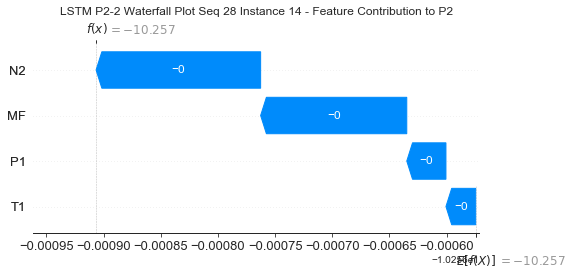

None

Contribution: [-3.64878913e-05 -2.84456891e-05 -1.51905469e-04 -1.46519095e-04]


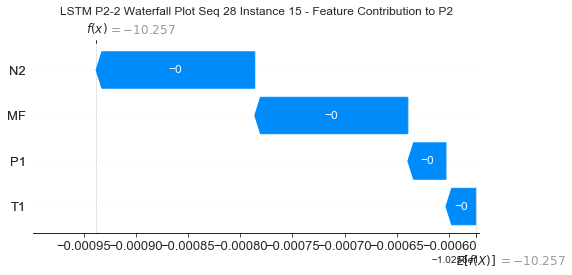

None

Contribution: [-3.88870893e-05 -2.72907599e-05 -1.51201243e-04 -1.46189146e-04]


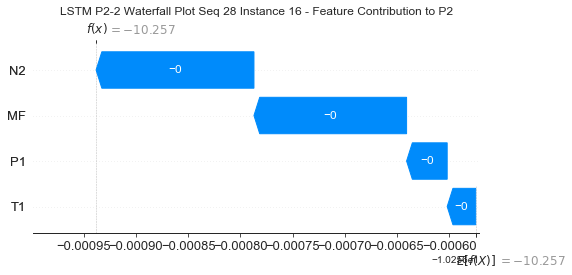

None

Contribution: [-3.91926314e-05 -2.48236150e-05 -1.46934836e-04 -1.39548812e-04]


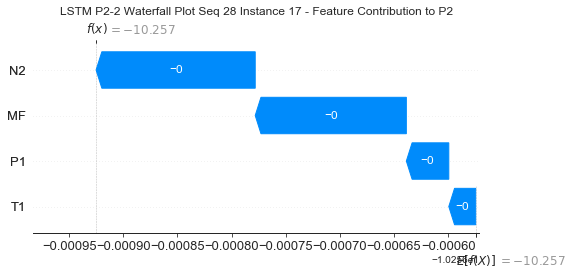

None

Contribution: [-3.24672588e-05 -3.17012286e-05 -1.71481599e-04 -1.69070977e-04]


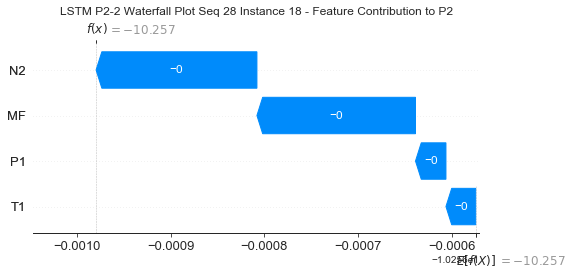

None

Contribution: [-2.11031736e-05 -4.67832310e-05 -2.81074630e-04 -3.13322408e-04]


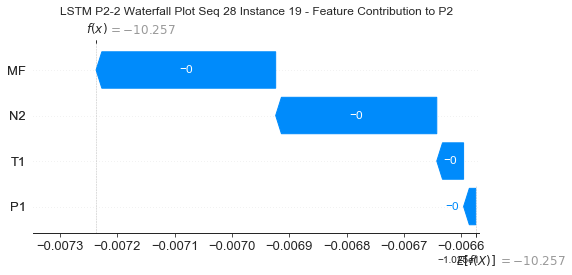

None

Contribution: [-1.15360570e-05 -5.90254508e-05 -3.44573651e-04 -3.89556902e-04]


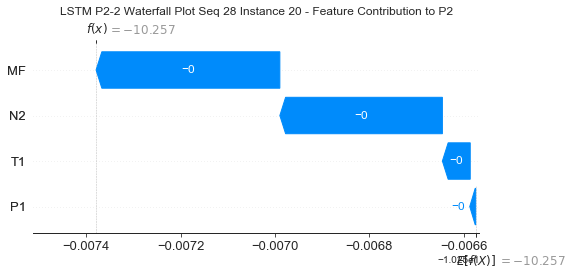

None

Contribution: [-1.02236812e-04  4.13457871e-05  2.79408715e-04  4.47620218e-04]


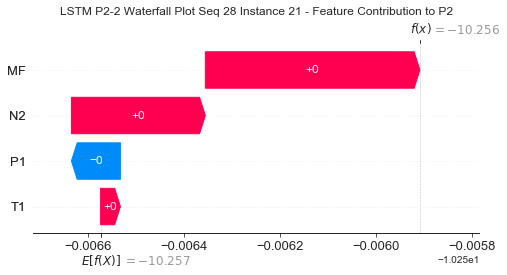

None

Contribution: [-0.00045576  0.0002555   0.00210111  0.00280038]


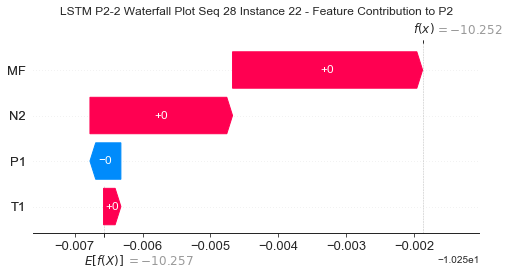

None

Contribution: [ 0.00104653 -0.00035736 -0.00668171 -0.00911976]


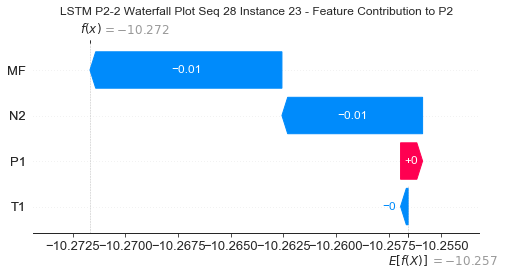

None

Contribution: [ 0.00500546  0.02303814 -0.03133534 -0.05006099]


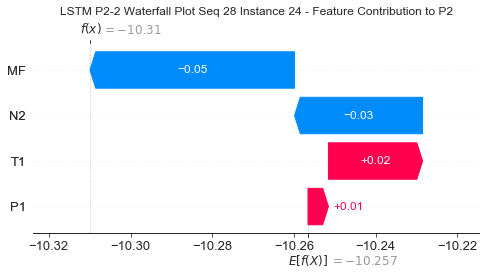

None

Contribution: [-0.02186281 -0.07192493 -0.06772335 -0.05248688]


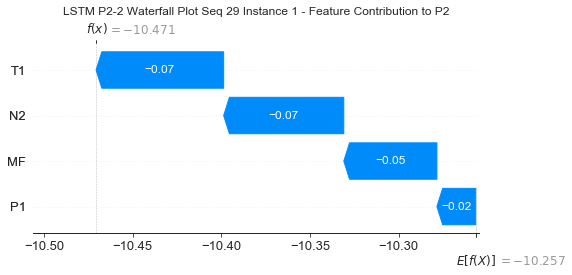

None

Contribution: [6.01481358e-04 5.33186881e-05 1.56669121e-03 1.53771151e-03]


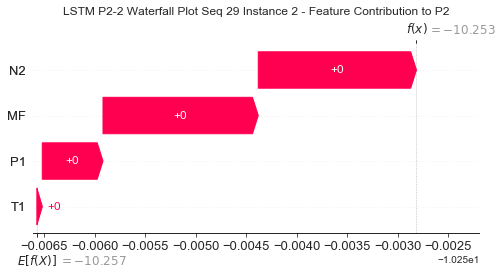

None

Contribution: [-1.29658503e-05 -6.21370020e-06 -1.30779630e-04 -1.35852572e-04]


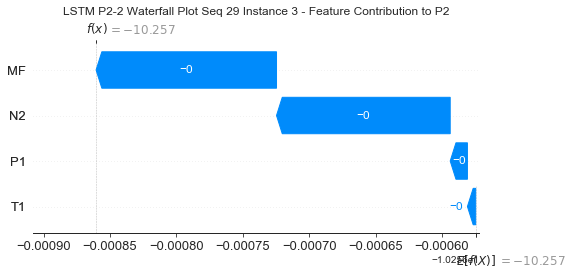

None

Contribution: [-4.07977597e-05 -2.66583047e-05 -2.14335080e-04 -2.23752710e-04]


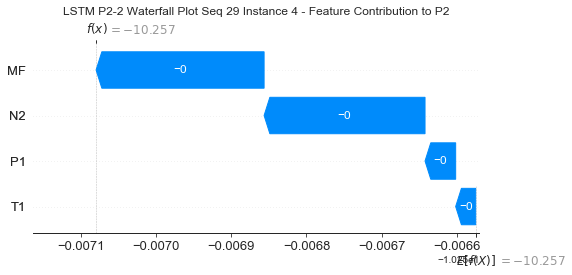

None

Contribution: [-3.90565599e-05 -2.63186223e-05 -1.88178177e-04 -1.93145577e-04]


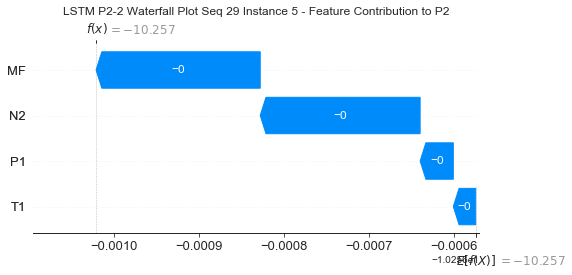

None

Contribution: [-3.37608406e-05 -2.37216394e-05 -1.65563305e-04 -1.64116291e-04]


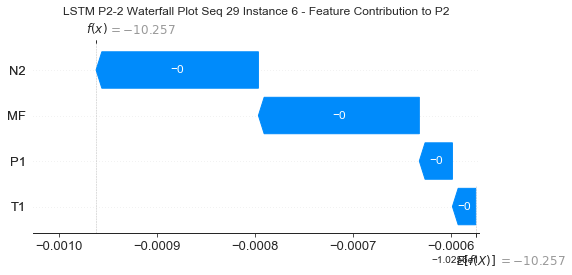

None

Contribution: [-2.66364518e-05 -2.14714544e-05 -1.45027075e-04 -1.20695673e-04]


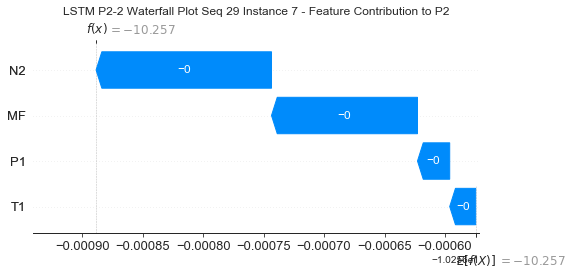

None

Contribution: [-2.23634601e-05 -1.74537158e-05 -1.29303109e-04 -8.49691098e-05]


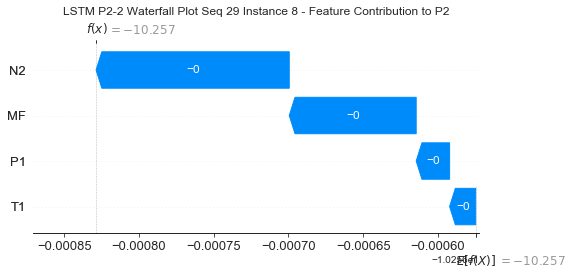

None

Contribution: [-2.92214898e-05 -1.77441957e-05 -1.27846819e-04 -1.01436981e-04]


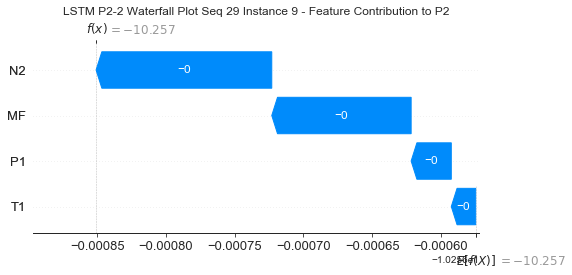

None

Contribution: [-4.17925116e-05 -1.72118165e-05 -1.27838784e-04 -1.14423809e-04]


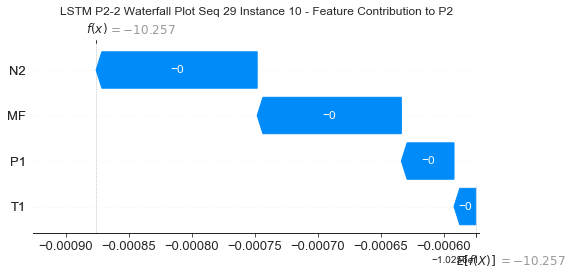

None

Contribution: [-4.31624228e-05 -1.89524136e-05 -1.32610052e-04 -1.25044602e-04]


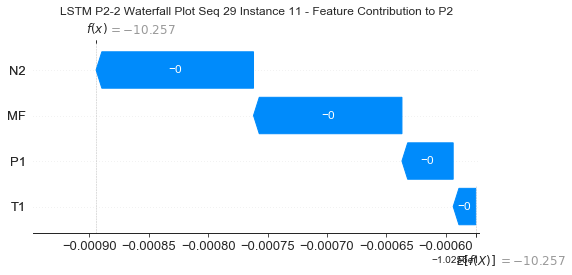

None

Contribution: [-4.22014660e-05 -2.00192634e-05 -1.37848137e-04 -1.30871392e-04]


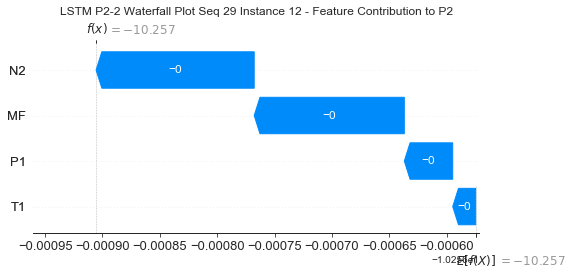

None

Contribution: [-4.27474753e-05 -2.01518297e-05 -1.44313615e-04 -1.39180565e-04]


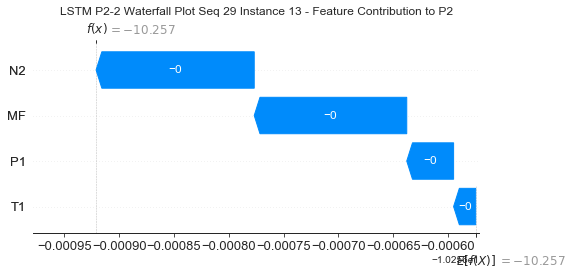

None

Contribution: [-3.64484027e-05 -2.13243172e-05 -1.46127087e-04 -1.31158161e-04]


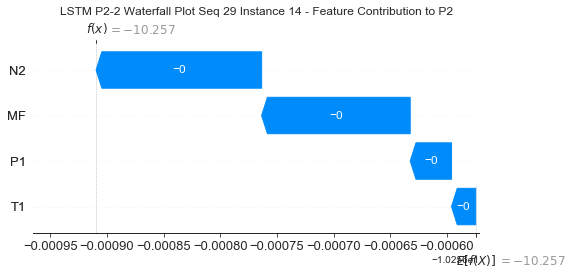

None

Contribution: [-3.75897490e-05 -2.75713581e-05 -1.53687135e-04 -1.48456283e-04]


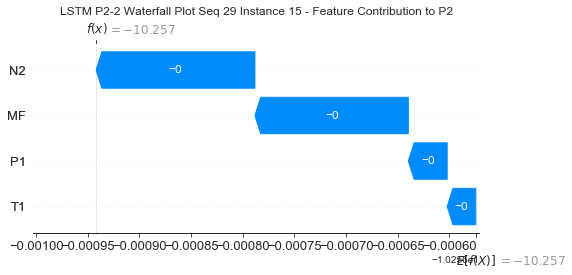

None

Contribution: [-3.89083508e-05 -2.53879532e-05 -1.54022331e-04 -1.49510920e-04]


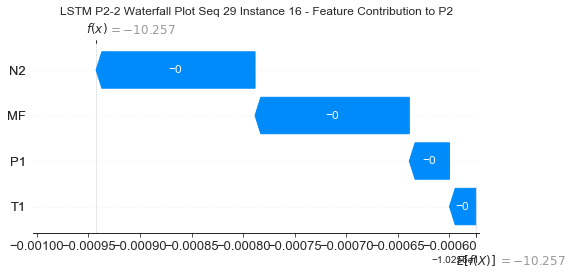

None

Contribution: [-3.82996823e-05 -2.55163664e-05 -1.50433437e-04 -1.43801577e-04]


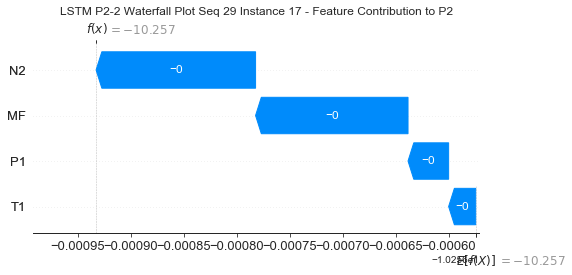

None

Contribution: [-3.16616704e-05 -3.17659062e-05 -1.72319563e-04 -1.70578165e-04]


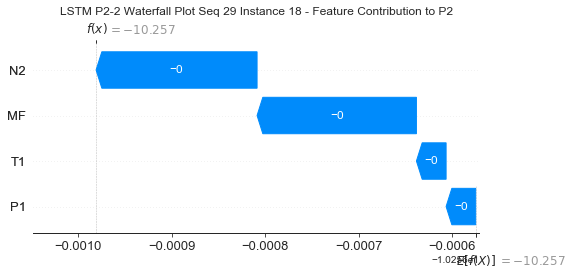

None

Contribution: [-1.94095747e-05 -5.45349234e-05 -2.71593196e-04 -2.95240703e-04]


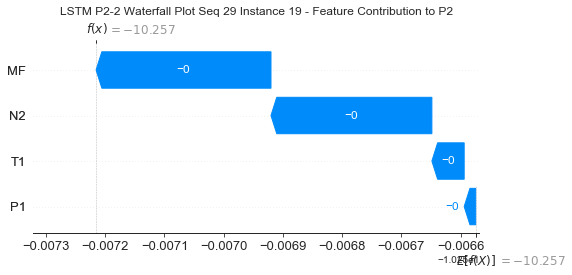

None

Contribution: [-1.11906427e-05 -7.67210022e-05 -3.35291197e-04 -3.68951952e-04]


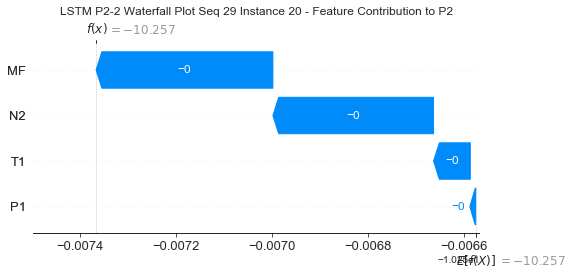

None

Contribution: [-8.31769047e-05  4.79062320e-05  2.26548430e-04  3.65506820e-04]


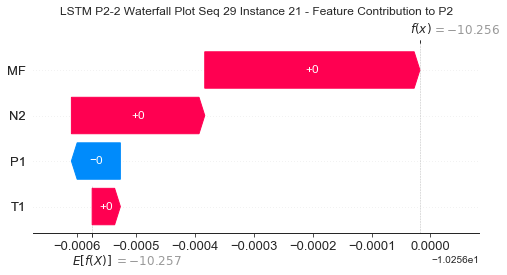

None

Contribution: [-0.00038156  0.00043662  0.00194734  0.00253087]


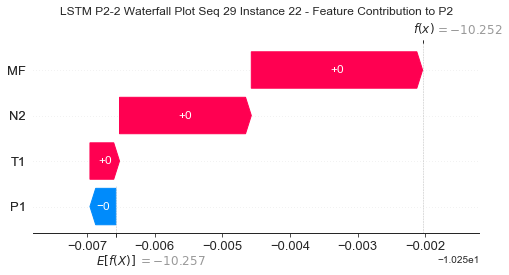

None

Contribution: [ 0.0007899  -0.00114531 -0.0064627  -0.00828052]


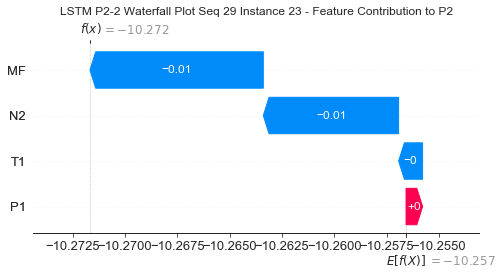

None

Contribution: [ 0.00062891  0.00940795 -0.02882925 -0.03398513]


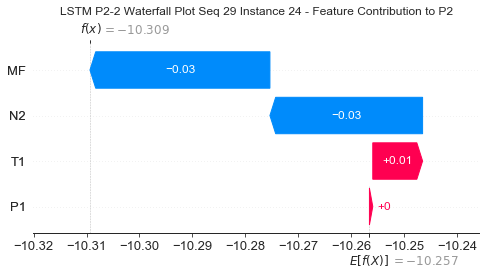

None

Contribution: [-0.01628324 -0.02487493 -0.06717086 -0.05131877]


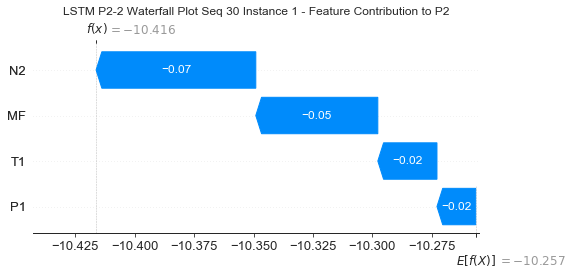

None

Contribution: [5.15459885e-04 9.51406610e-05 1.56238329e-03 1.49798875e-03]


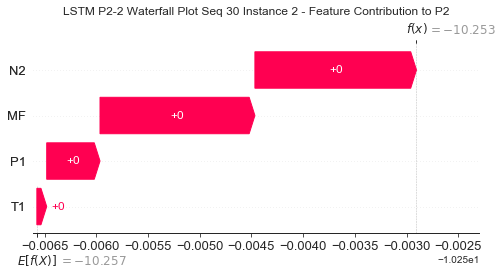

None

Contribution: [-1.13797135e-05 -1.76229563e-05 -1.31978343e-04 -1.33206983e-04]


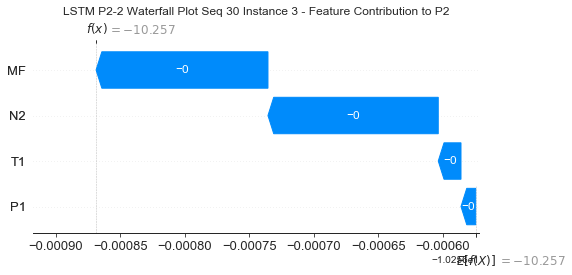

None

Contribution: [-3.54995670e-05 -5.78181411e-05 -2.14624552e-04 -2.17516085e-04]


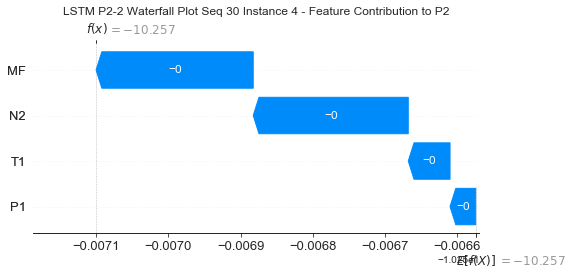

None

Contribution: [-3.37188335e-05 -4.68948516e-05 -1.87621823e-04 -1.88156891e-04]


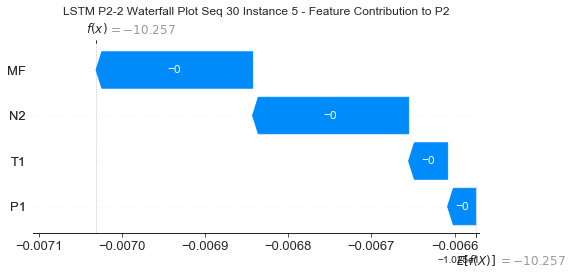

None

Contribution: [-3.21390440e-05 -3.84466783e-05 -1.65654119e-04 -1.64174269e-04]


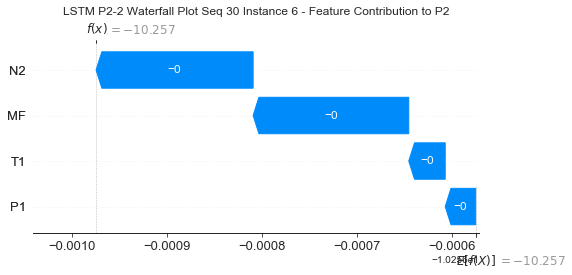

None

Contribution: [-2.15767161e-05 -3.15451503e-05 -1.44554602e-04 -1.18240037e-04]


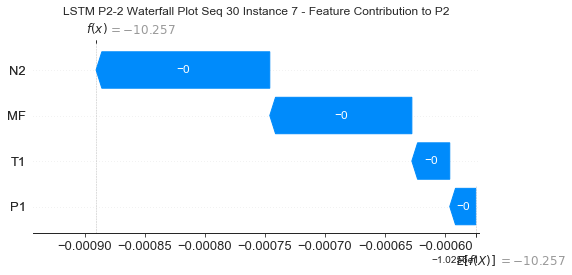

None

Contribution: [-1.66619973e-05 -2.34697351e-05 -1.28075146e-04 -8.17623797e-05]


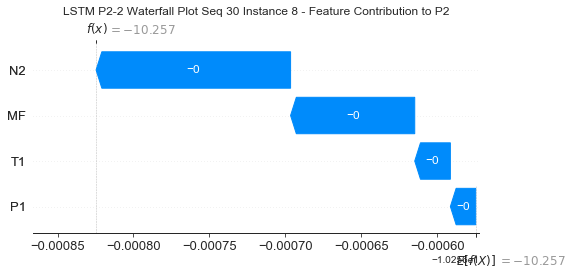

None

Contribution: [-2.07515907e-05 -2.32594846e-05 -1.26106193e-04 -9.57561968e-05]


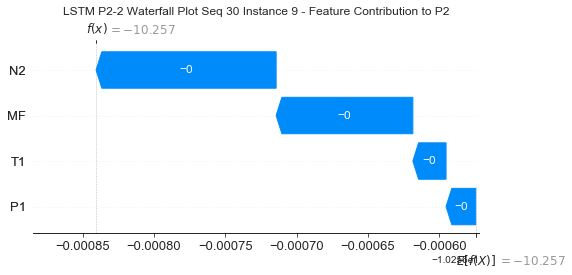

None

Contribution: [-3.40520716e-05 -2.38761534e-05 -1.26451700e-04 -1.09360168e-04]


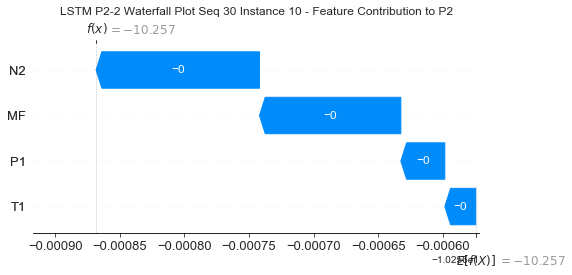

None

Contribution: [-3.73448152e-05 -2.59890193e-05 -1.31511514e-04 -1.21530022e-04]


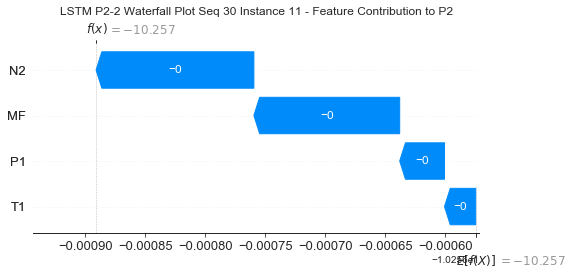

None

Contribution: [-3.71952073e-05 -2.69944833e-05 -1.36520659e-04 -1.27399445e-04]


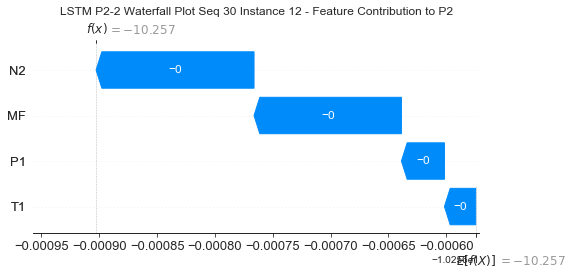

None

Contribution: [-3.65596832e-05 -2.77845583e-05 -1.42716432e-04 -1.33650364e-04]


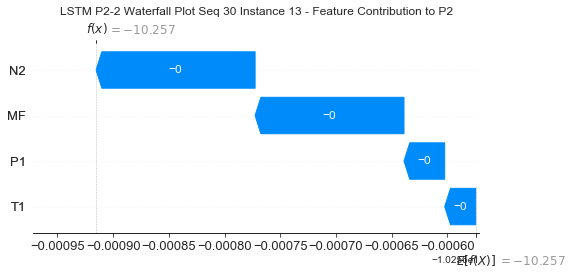

None

Contribution: [-3.18459815e-05 -2.70343869e-05 -1.44999682e-04 -1.27876265e-04]


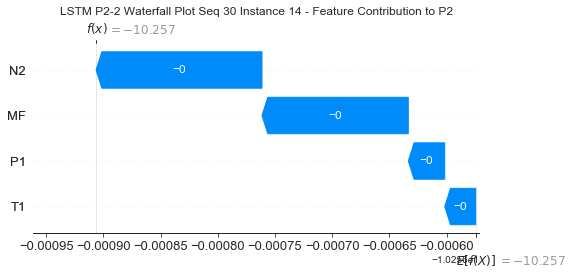

None

Contribution: [-3.62804980e-05 -3.11612238e-05 -1.52823291e-04 -1.46917024e-04]


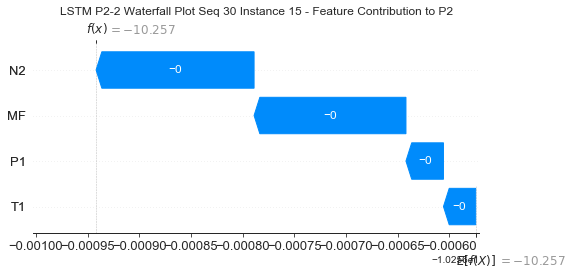

None

Contribution: [-3.58916148e-05 -2.99479782e-05 -1.52521665e-04 -1.46312041e-04]


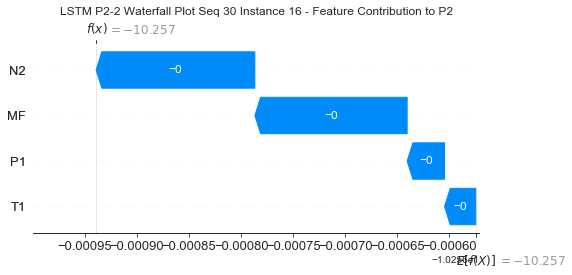

None

Contribution: [-3.61594651e-05 -2.83491218e-05 -1.48685560e-04 -1.40951381e-04]


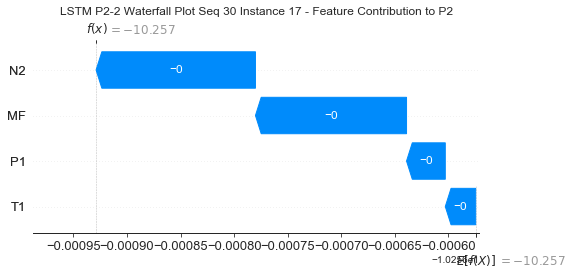

None

Contribution: [-3.37080704e-05 -3.25274976e-05 -1.71897328e-04 -1.70618068e-04]


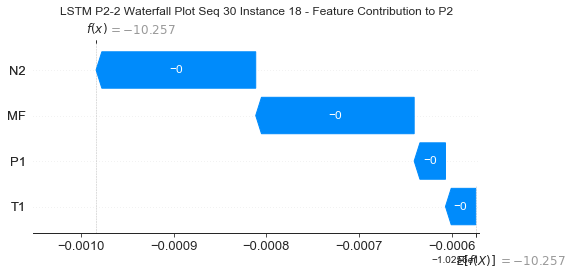

None

Contribution: [-1.89610769e-05 -6.15229495e-05 -2.75465574e-04 -3.00580194e-04]


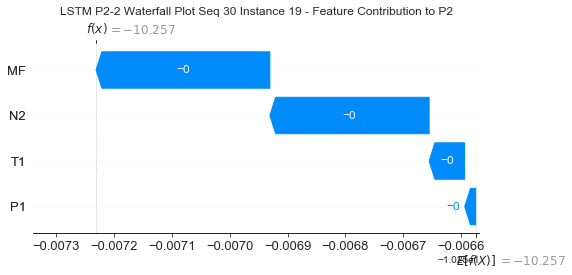

None

Contribution: [-1.05879597e-05 -8.64479256e-05 -3.41325201e-04 -3.77359634e-04]


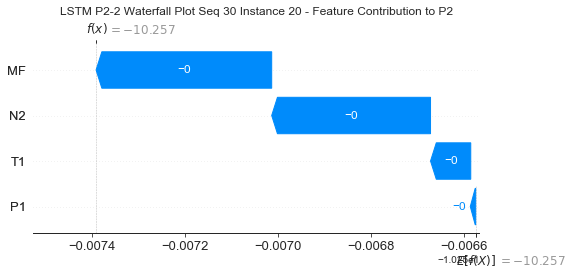

None

Contribution: [-8.53094060e-05  5.63113998e-05  2.41805626e-04  3.85191218e-04]


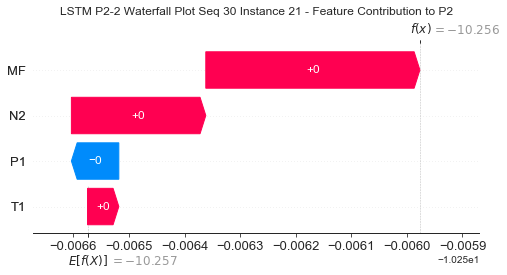

None

Contribution: [-0.00038925  0.00048529  0.00200563  0.00259153]


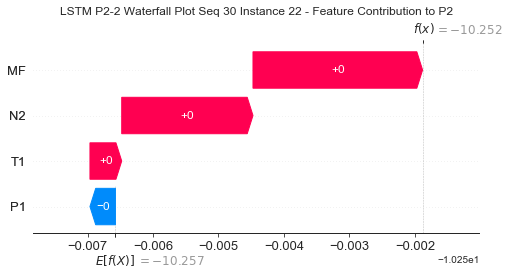

None

Contribution: [ 0.00081502 -0.00130677 -0.00648091 -0.00830304]


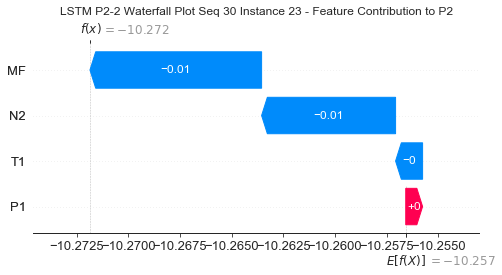

None

Contribution: [ 0.00143102  0.00014803 -0.02961199 -0.03720769]


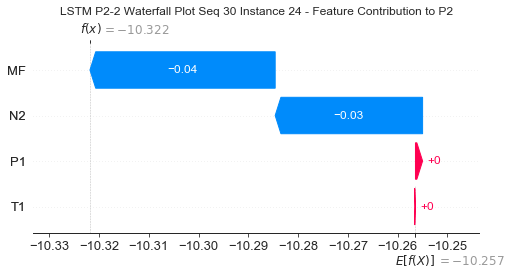

None

Contribution: [-0.01669227 -0.02467111 -0.06767582 -0.05195538]


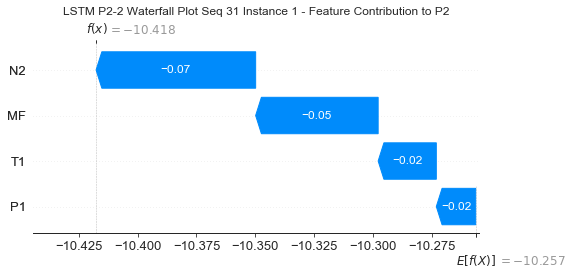

None

Contribution: [4.98824001e-04 9.83633324e-05 1.55233443e-03 1.45571204e-03]


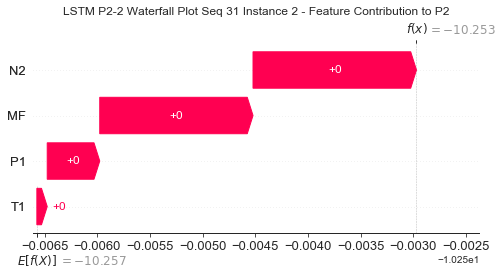

None

Contribution: [-1.08148227e-05 -1.67173164e-05 -1.31485267e-04 -1.30060727e-04]


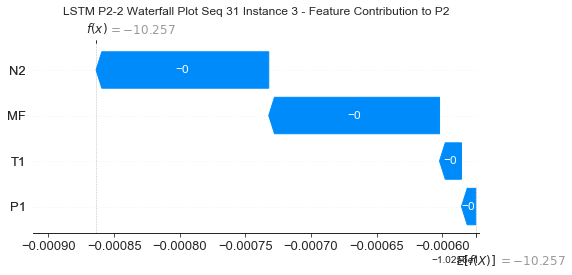

None

Contribution: [-3.61423997e-05 -5.68332937e-05 -2.15133285e-04 -2.19799985e-04]


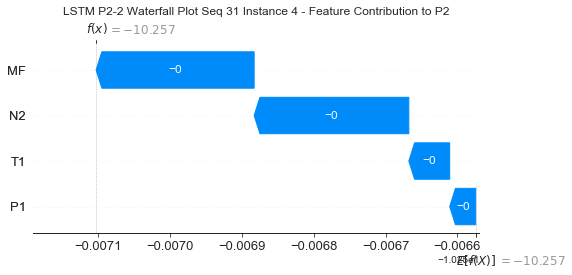

None

Contribution: [-3.43344562e-05 -4.67495877e-05 -1.88402827e-04 -1.90107609e-04]


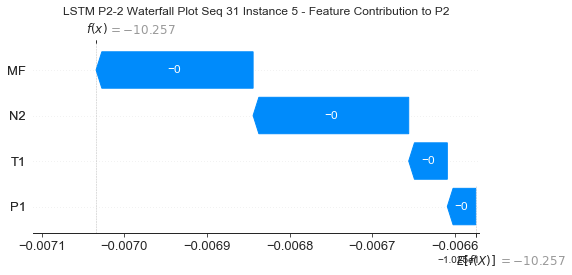

None

Contribution: [-3.22259071e-05 -3.95723365e-05 -1.65903554e-04 -1.64986334e-04]


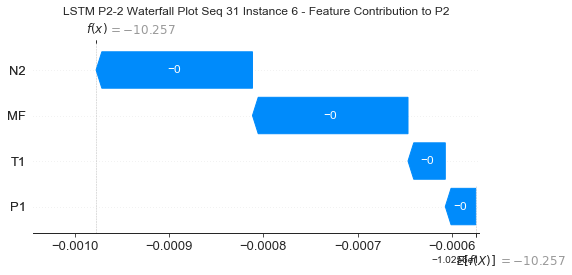

None

Contribution: [-2.20833512e-05 -3.15469548e-05 -1.44929062e-04 -1.19264346e-04]


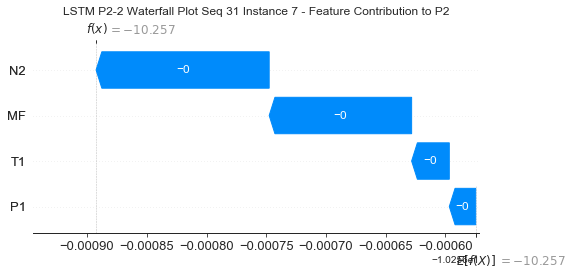

None

Contribution: [-1.64349377e-05 -2.34411462e-05 -1.28020981e-04 -8.19866593e-05]


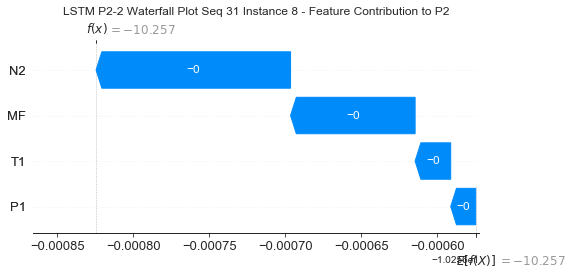

None

Contribution: [-2.02276562e-05 -2.36301601e-05 -1.26004958e-04 -9.48994307e-05]


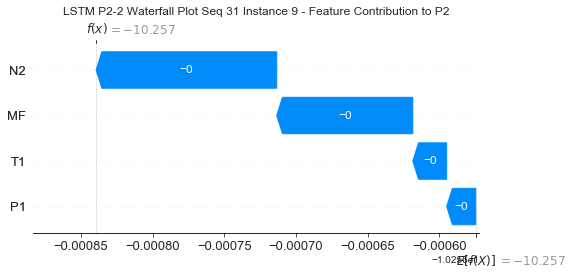

None

Contribution: [-3.36687613e-05 -2.41532488e-05 -1.26855443e-04 -1.10728197e-04]


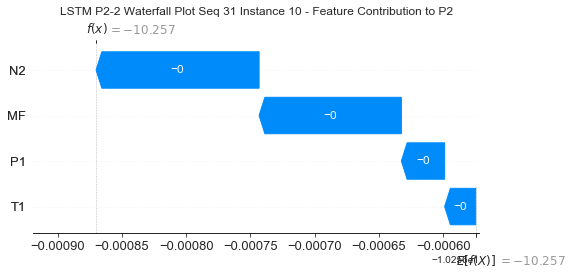

None

Contribution: [-3.79679193e-05 -2.66842404e-05 -1.32025650e-04 -1.22402805e-04]


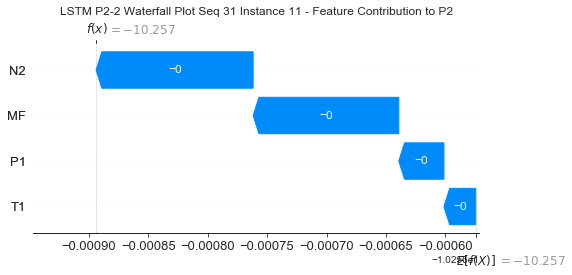

None

Contribution: [-3.77298570e-05 -2.76553331e-05 -1.37225119e-04 -1.28378284e-04]


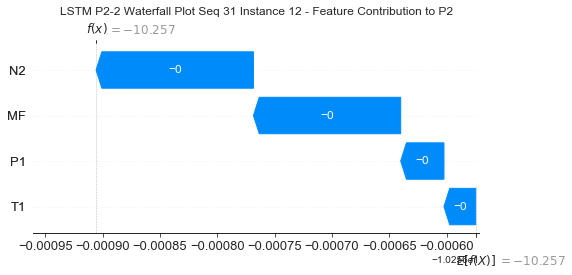

None

Contribution: [-3.72741626e-05 -2.86514683e-05 -1.43322057e-04 -1.35937305e-04]


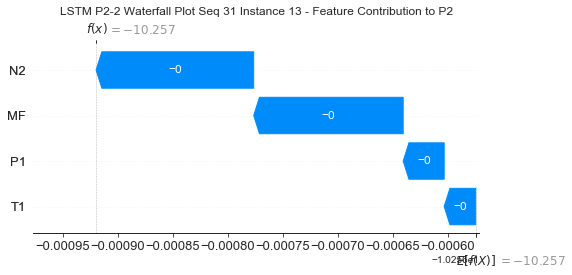

None

Contribution: [-3.24628515e-05 -2.73509699e-05 -1.45173839e-04 -1.28429592e-04]


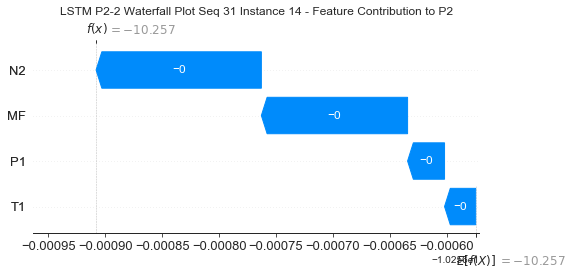

None

Contribution: [-3.57151107e-05 -3.06390738e-05 -1.53208331e-04 -1.45960749e-04]


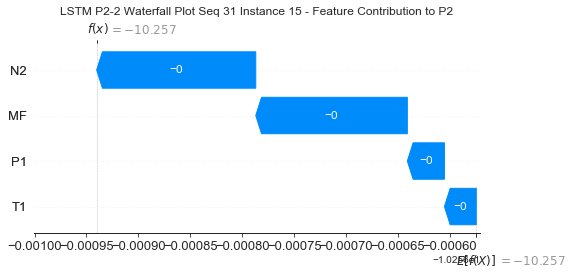

None

Contribution: [-3.62494663e-05 -3.00943794e-05 -1.52639678e-04 -1.46521613e-04]


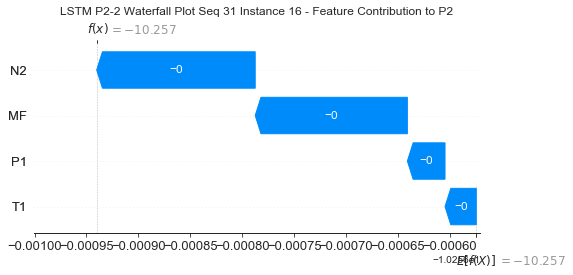

None

Contribution: [-3.62382108e-05 -2.85473332e-05 -1.49098305e-04 -1.41419272e-04]


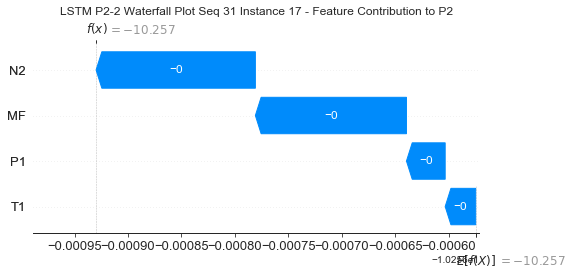

None

Contribution: [-3.44200887e-05 -3.36804122e-05 -1.71851534e-04 -1.72221104e-04]


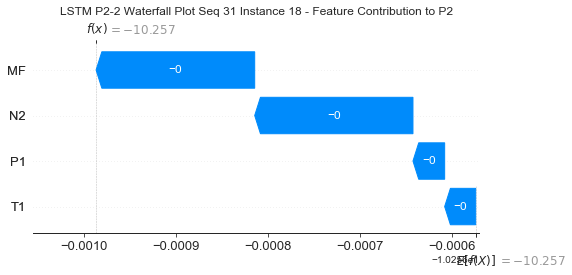

None

Contribution: [-1.88386659e-05 -5.98225430e-05 -2.75677506e-04 -3.00469104e-04]


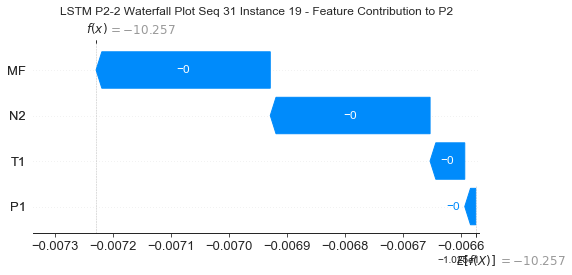

None

Contribution: [-1.04141461e-05 -8.37656407e-05 -3.41357993e-04 -3.76510607e-04]


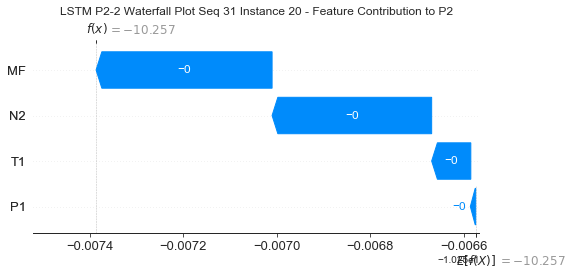

None

Contribution: [-8.49218911e-05  5.39776938e-05  2.41663712e-04  3.85017756e-04]


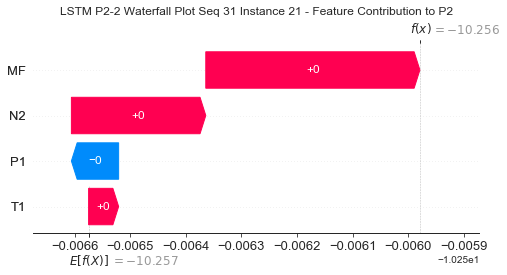

None

Contribution: [-0.00038643  0.00046884  0.00200193  0.00258758]


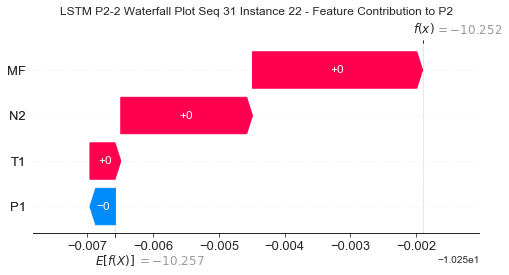

None

Contribution: [ 0.00080668 -0.00120068 -0.00648639 -0.00828671]


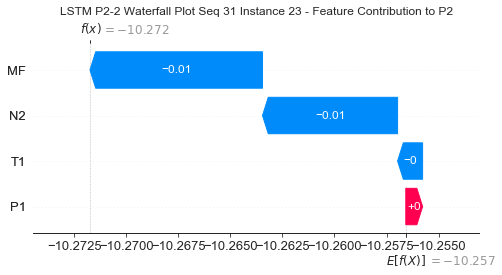

None

Contribution: [ 0.0018926   0.00094206 -0.03085281 -0.03875864]


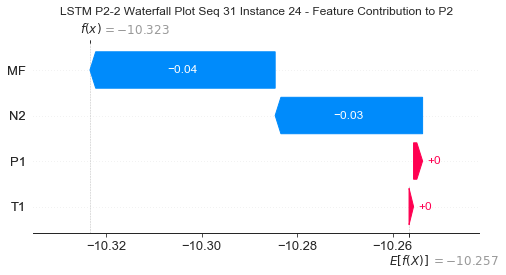

None

Contribution: [-0.01760811 -0.02371093 -0.06803037 -0.05471516]


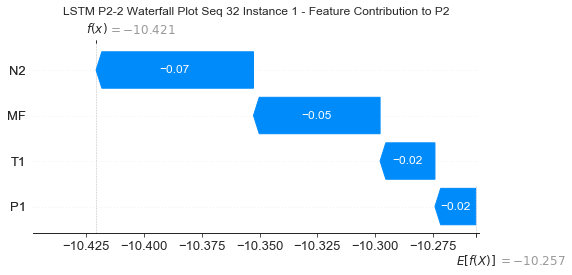

None

Contribution: [5.14541288e-04 9.41051426e-05 1.54350138e-03 1.48586917e-03]


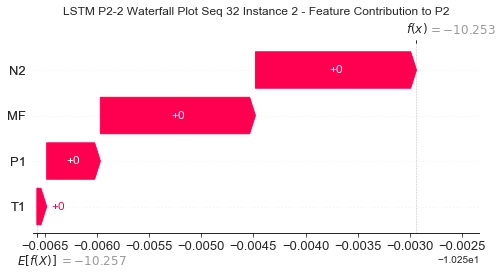

None

Contribution: [-1.15247826e-05 -1.45479946e-05 -1.32372946e-04 -1.35306796e-04]


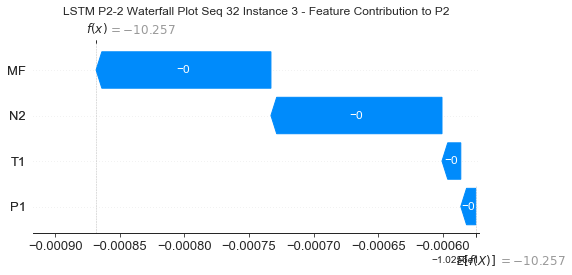

None

Contribution: [-3.53448024e-05 -5.46782115e-05 -2.14617143e-04 -2.17126134e-04]


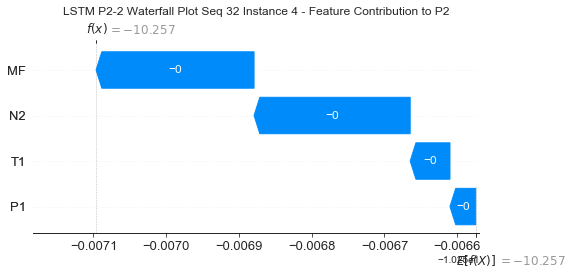

None

Contribution: [-3.37606854e-05 -4.53342083e-05 -1.88162276e-04 -1.88317935e-04]


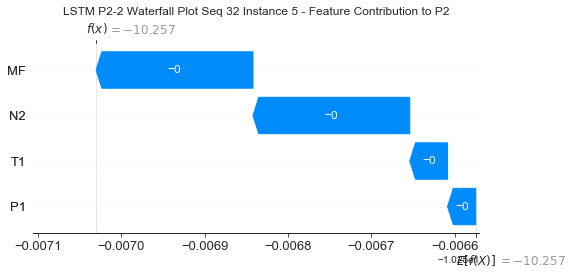

None

Contribution: [-3.07467168e-05 -3.85704912e-05 -1.65138981e-04 -1.62904214e-04]


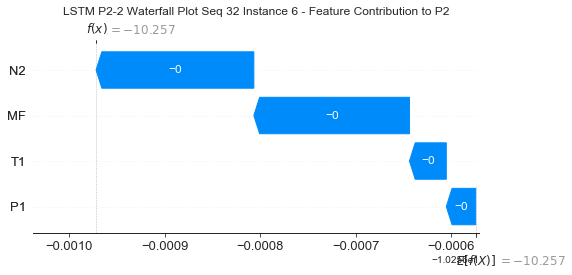

None

Contribution: [-2.17088555e-05 -3.11319003e-05 -1.45480040e-04 -1.19707098e-04]


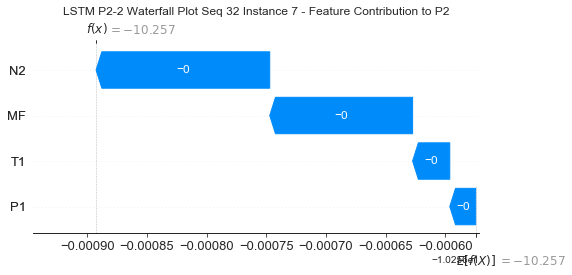

None

Contribution: [-1.74040679e-05 -2.44444543e-05 -1.29862649e-04 -8.56758576e-05]


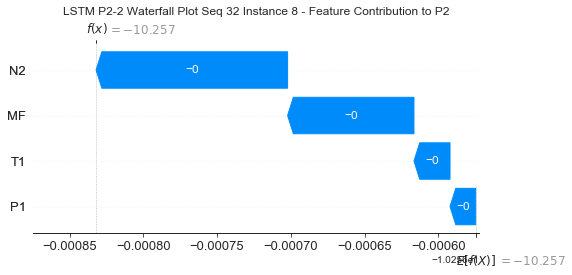

None

Contribution: [-2.21096953e-05 -2.50100210e-05 -1.28071052e-04 -1.00363406e-04]


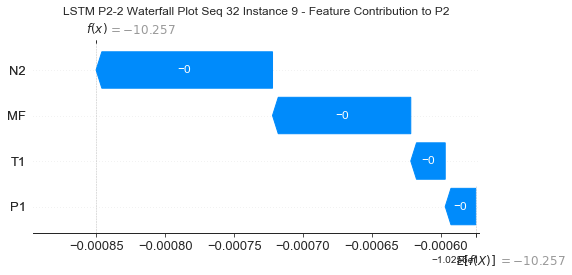

None

Contribution: [-3.41743182e-05 -2.54890519e-05 -1.28190957e-04 -1.12736439e-04]


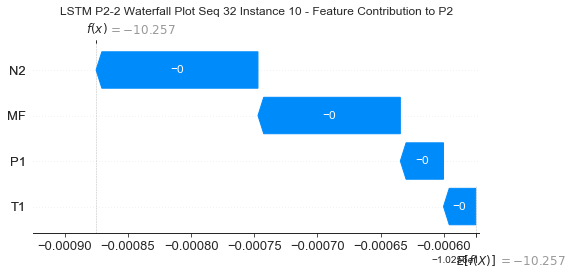

None

Contribution: [-3.73705510e-05 -2.63417490e-05 -1.32840843e-04 -1.23138967e-04]


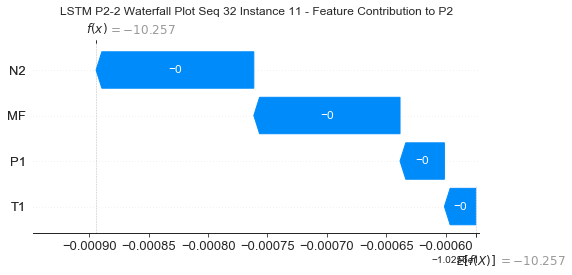

None

Contribution: [-3.72391342e-05 -2.70771909e-05 -1.37876610e-04 -1.29030726e-04]


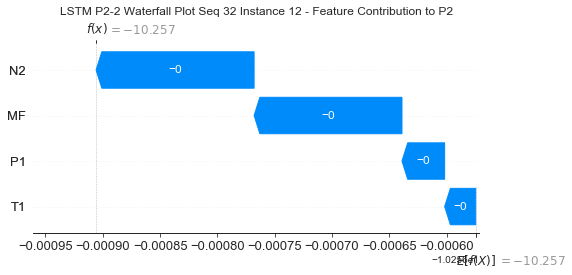

None

Contribution: [-3.63135002e-05 -2.79797168e-05 -1.44021795e-04 -1.35329369e-04]


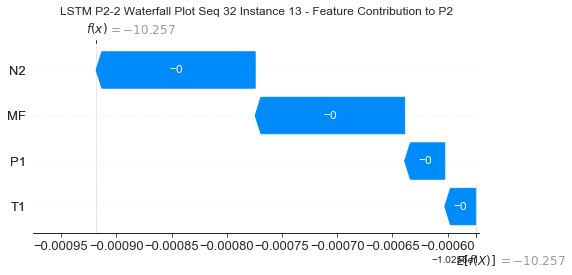

None

Contribution: [-3.20184742e-05 -2.68631950e-05 -1.45811314e-04 -1.29087775e-04]


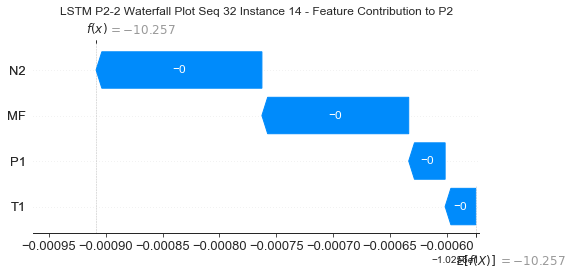

None

Contribution: [-3.42144460e-05 -2.87616826e-05 -1.53728473e-04 -1.47487997e-04]


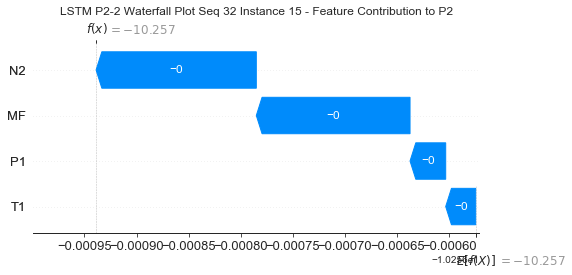

None

Contribution: [-3.58975037e-05 -2.95820724e-05 -1.53660414e-04 -1.47682921e-04]


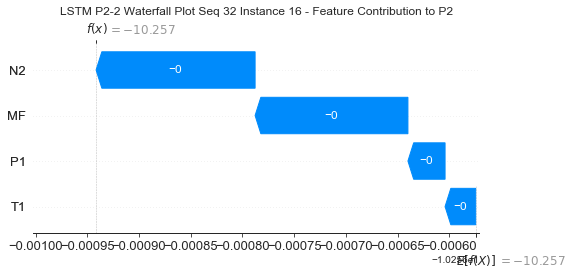

None

Contribution: [-3.59797353e-05 -2.79891989e-05 -1.49957280e-04 -1.42201013e-04]


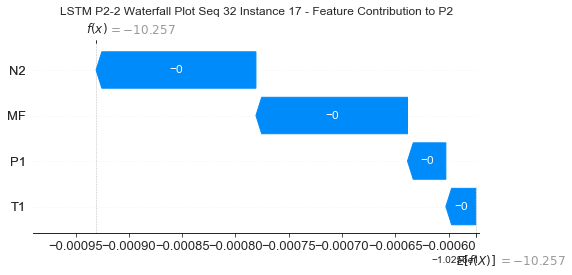

None

Contribution: [-3.33511000e-05 -3.18392356e-05 -1.72916585e-04 -1.72341173e-04]


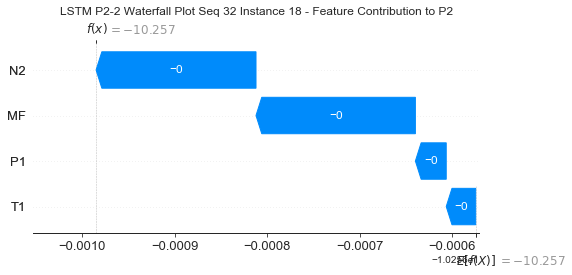

None

Contribution: [-1.89040745e-05 -5.75770502e-05 -2.76402138e-04 -3.01046207e-04]


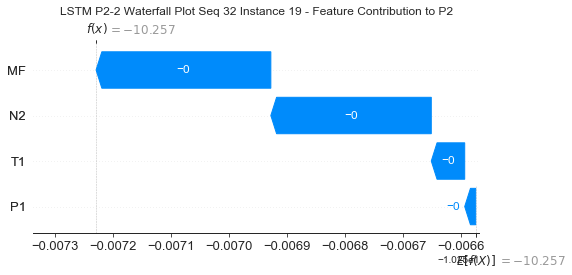

None

Contribution: [-1.03382543e-05 -8.04232718e-05 -3.43810977e-04 -3.78760181e-04]


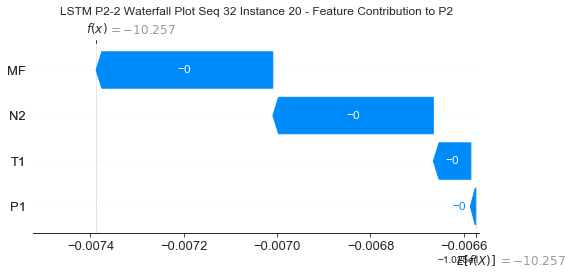

None

Contribution: [-8.43201548e-05  4.99796272e-05  2.35136770e-04  3.76253360e-04]


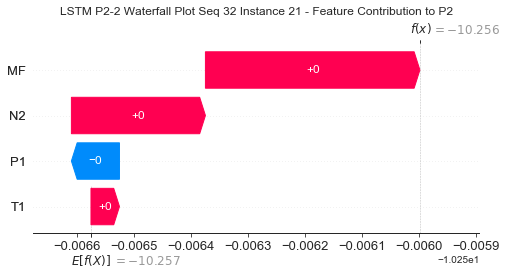

None

Contribution: [-0.00038543  0.00044312  0.00200266  0.00257914]


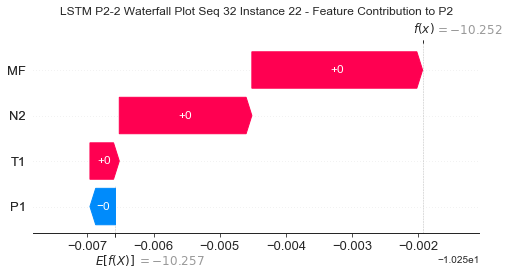

None

Contribution: [ 0.00081519 -0.00114322 -0.00650575 -0.00832995]


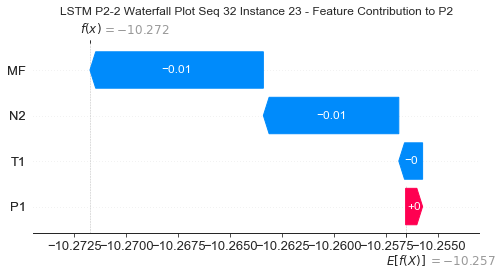

None

Contribution: [ 0.00185906  0.0002637  -0.03069461 -0.03987497]


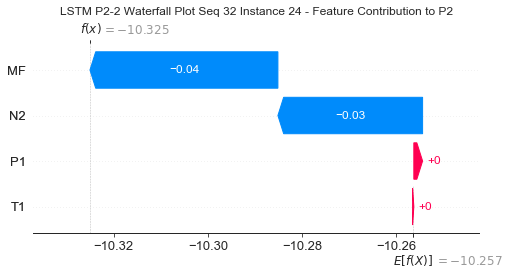

None

Contribution: [-0.01652982 -0.02670084 -0.06852411 -0.05205649]


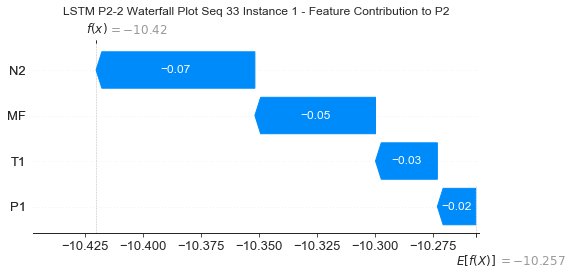

None

Contribution: [5.09602292e-04 9.57374841e-05 1.56952387e-03 1.49184245e-03]


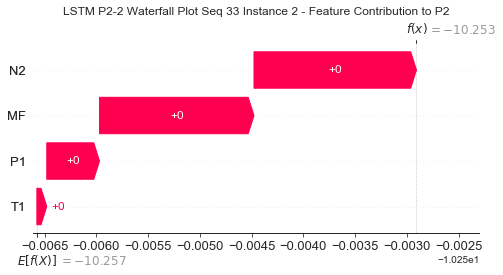

None

Contribution: [-1.11510449e-05 -1.54916499e-05 -1.33131574e-04 -1.33786935e-04]


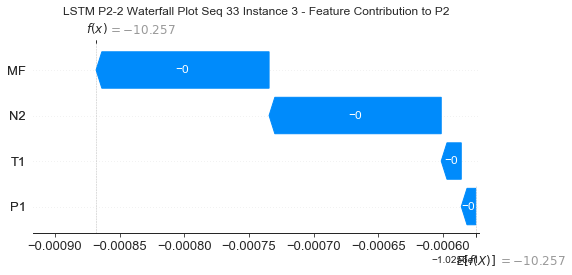

None

Contribution: [-3.46987766e-05 -5.20582368e-05 -2.15805330e-04 -2.18332748e-04]


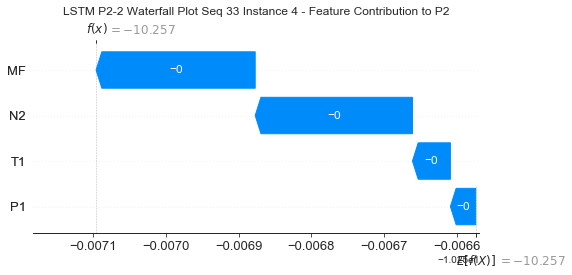

None

Contribution: [-3.29632097e-05 -4.29005003e-05 -1.88132457e-04 -1.88206449e-04]


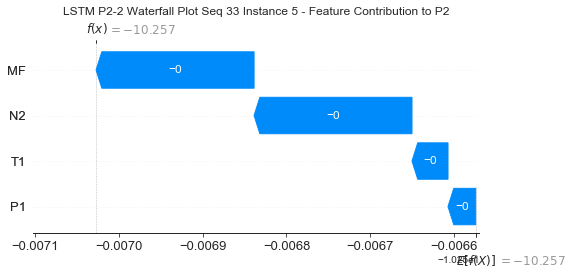

None

Contribution: [-3.10113132e-05 -3.75033971e-05 -1.65338051e-04 -1.63098171e-04]


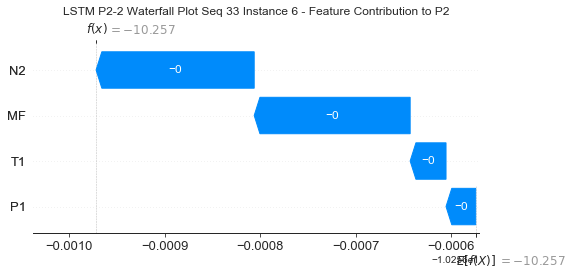

None

Contribution: [-2.06635879e-05 -2.93988033e-05 -1.44631116e-04 -1.17780476e-04]


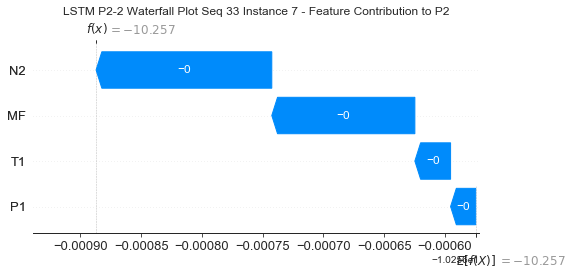

None

Contribution: [-1.66857728e-05 -2.23348995e-05 -1.28364899e-04 -8.19072765e-05]


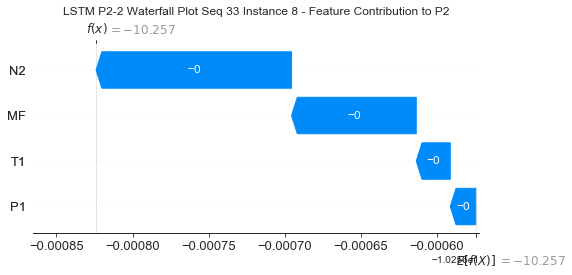

None

Contribution: [-2.13199860e-05 -2.34385328e-05 -1.26277819e-04 -9.67360148e-05]


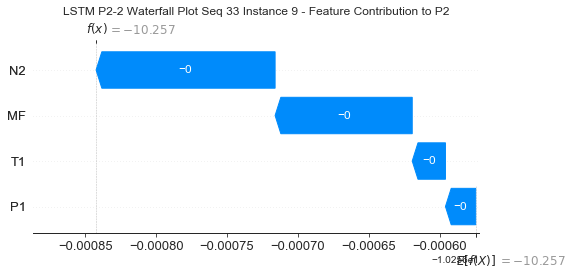

None

Contribution: [-3.39686651e-05 -2.25298309e-05 -1.26515717e-04 -1.09782530e-04]


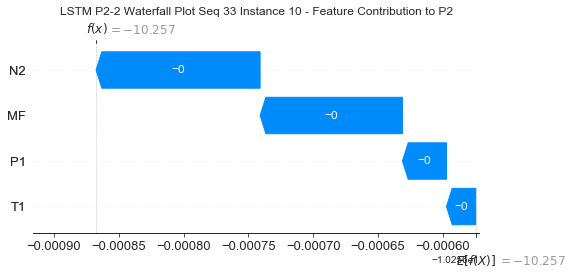

None

Contribution: [-3.67905138e-05 -2.46536395e-05 -1.31528451e-04 -1.21471711e-04]


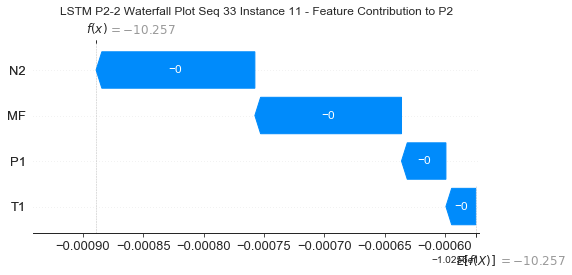

None

Contribution: [-3.66169871e-05 -2.55848143e-05 -1.36918776e-04 -1.27717867e-04]


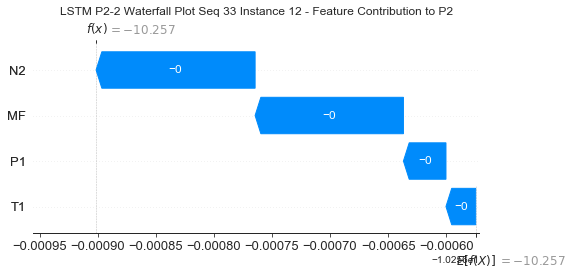

None

Contribution: [-3.72609132e-05 -2.68388797e-05 -1.42915616e-04 -1.35332505e-04]


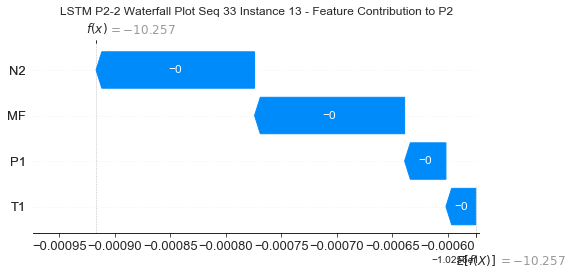

None

Contribution: [-3.15003049e-05 -2.53126579e-05 -1.44755063e-04 -1.27616159e-04]


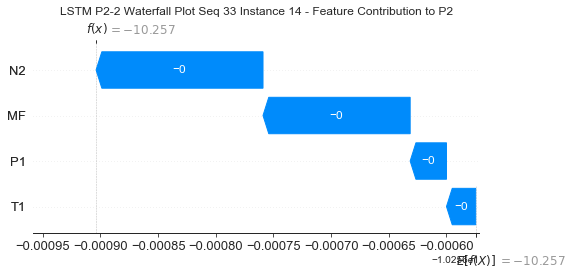

None

Contribution: [-3.48612608e-05 -2.82319032e-05 -1.52539125e-04 -1.45433234e-04]


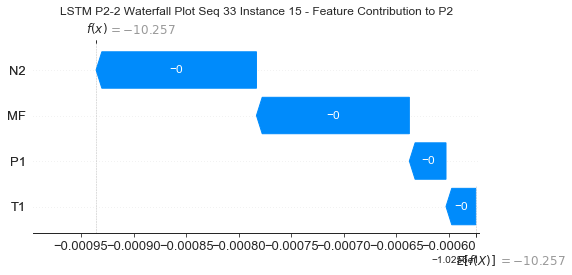

None

Contribution: [-3.54212065e-05 -2.78335313e-05 -1.52132557e-04 -1.45696782e-04]


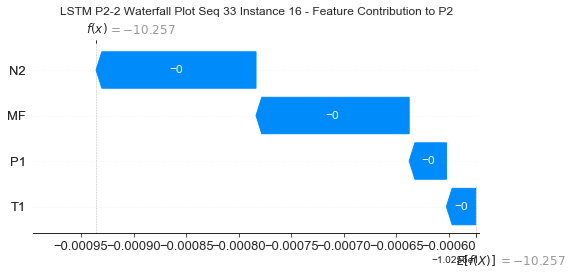

None

Contribution: [-3.52242583e-05 -2.64316508e-05 -1.48474577e-04 -1.40359733e-04]


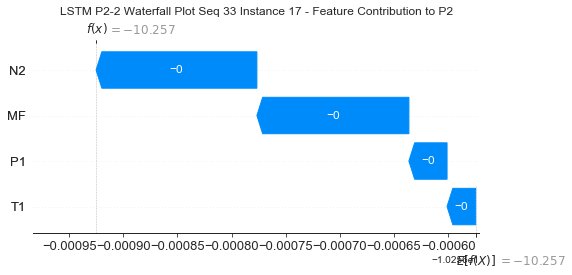

None

Contribution: [-3.37616995e-05 -3.03898554e-05 -1.72263484e-04 -1.72364164e-04]


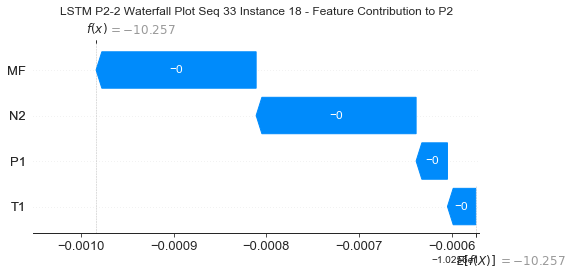

None

Contribution: [-1.80859479e-05 -5.51181715e-05 -2.78009870e-04 -3.03129138e-04]


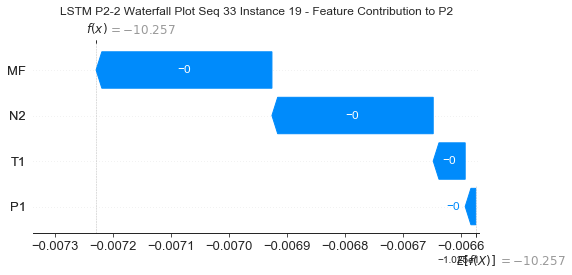

None

Contribution: [-1.01229474e-05 -7.54212141e-05 -3.42421157e-04 -3.77290146e-04]


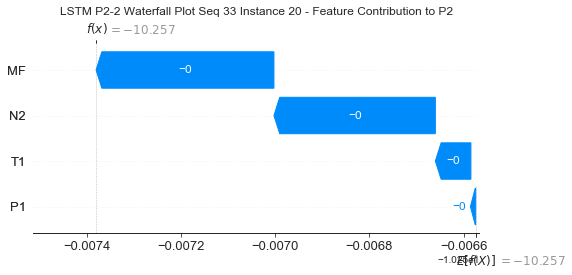

None

Contribution: [-8.52090254e-05  5.09696900e-05  2.54709834e-04  4.03403330e-04]


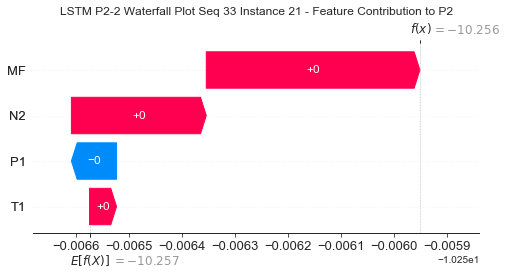

None

Contribution: [-0.00038232  0.00040061  0.00202767  0.00262461]


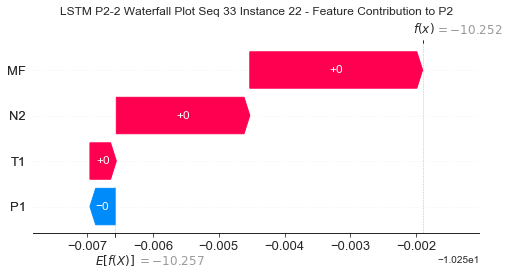

None

Contribution: [ 0.00080647 -0.00095302 -0.00654531 -0.00852571]


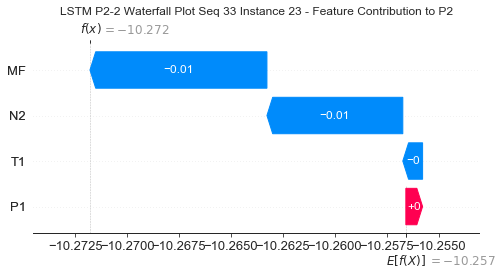

None

Contribution: [ 0.00129432  0.00841438 -0.02918233 -0.0404414 ]


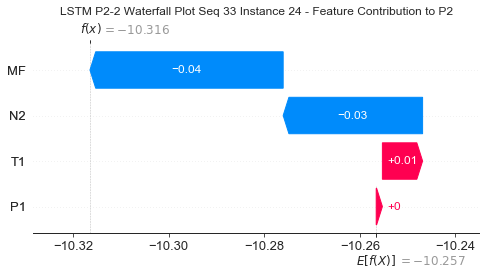

None

Contribution: [-0.01487262 -0.0375494  -0.06756189 -0.04894327]


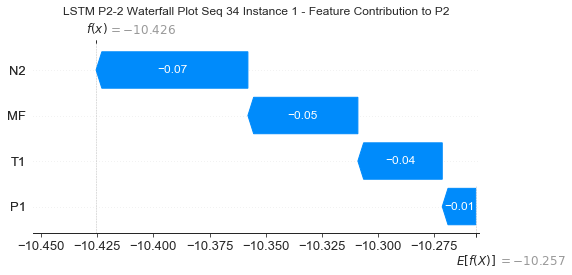

None

Contribution: [5.10658843e-04 8.75784572e-05 1.59256692e-03 1.50576501e-03]


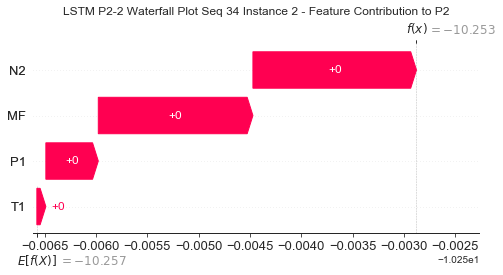

None

Contribution: [-1.06799863e-05 -1.36148260e-05 -1.32641582e-04 -1.31057788e-04]


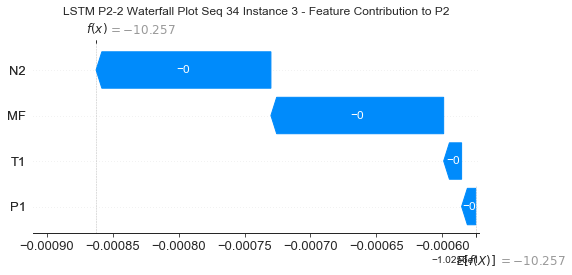

None

Contribution: [-3.46290303e-05 -4.87847744e-05 -2.16332727e-04 -2.20777248e-04]


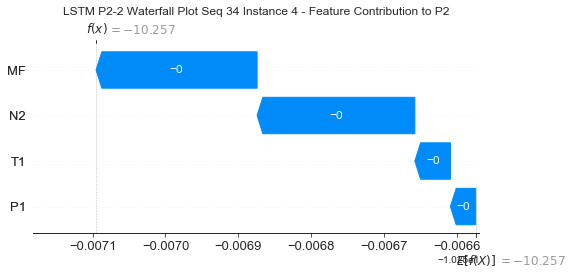

None

Contribution: [-3.26740157e-05 -4.03757960e-05 -1.87878283e-04 -1.88746110e-04]


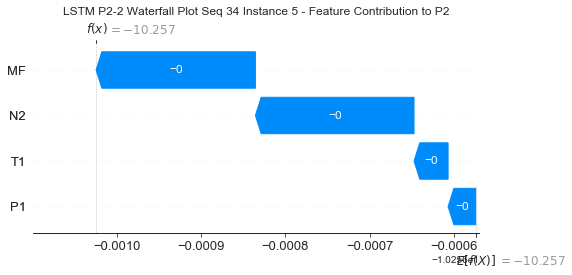

None

Contribution: [-2.97674684e-05 -3.38049773e-05 -1.65679490e-04 -1.64191414e-04]


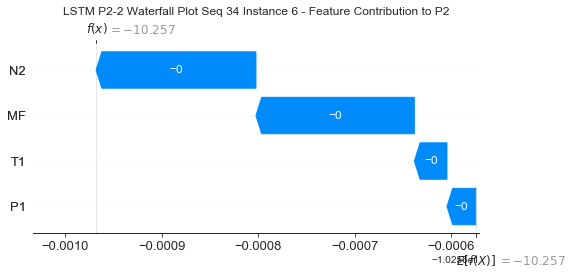

None

Contribution: [-2.00104149e-05 -2.82007569e-05 -1.44673454e-04 -1.18024770e-04]


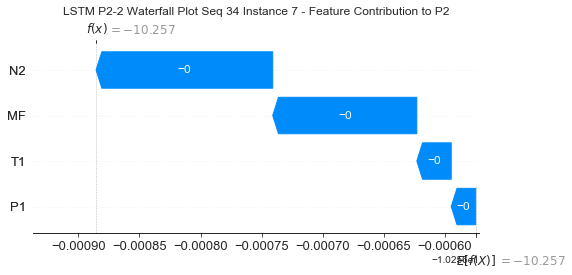

None

Contribution: [-1.43593085e-05 -2.21095295e-05 -1.28182066e-04 -8.20032130e-05]


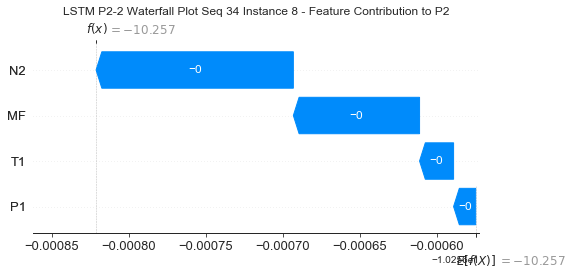

None

Contribution: [-1.72608468e-05 -2.18929881e-05 -1.25944030e-04 -9.50036345e-05]


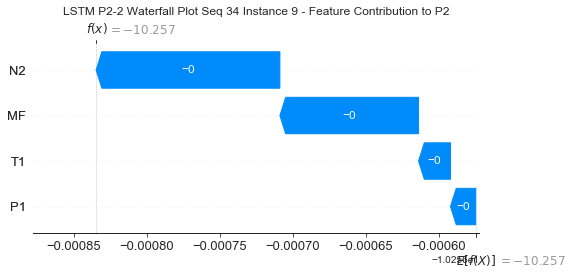

None

Contribution: [-3.08864852e-05 -2.21828995e-05 -1.26220474e-04 -1.08648649e-04]


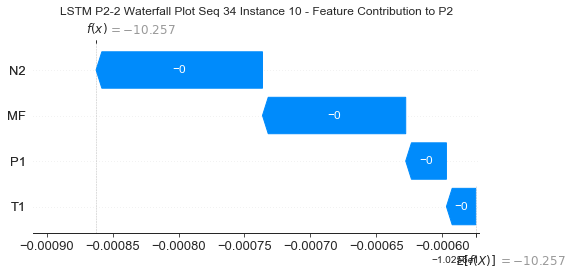

None

Contribution: [-3.60602448e-05 -2.36060833e-05 -1.31233323e-04 -1.20640394e-04]


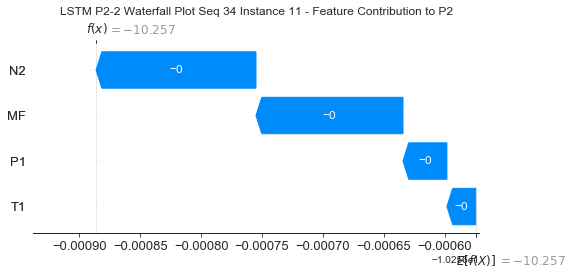

None

Contribution: [-3.60862124e-05 -2.45208304e-05 -1.36462636e-04 -1.26949764e-04]


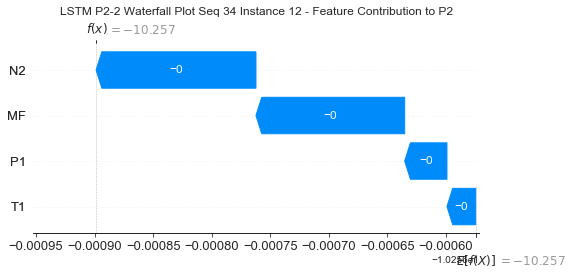

None

Contribution: [-3.51874794e-05 -2.62351002e-05 -1.42596778e-04 -1.33541363e-04]


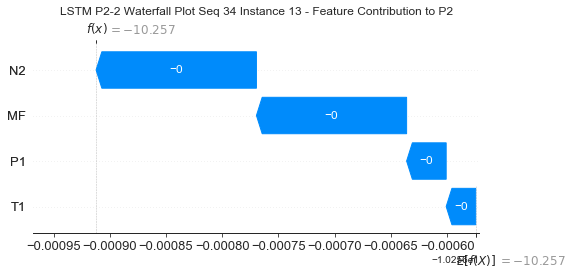

None

Contribution: [-3.07160532e-05 -2.44675248e-05 -1.44346080e-04 -1.26525974e-04]


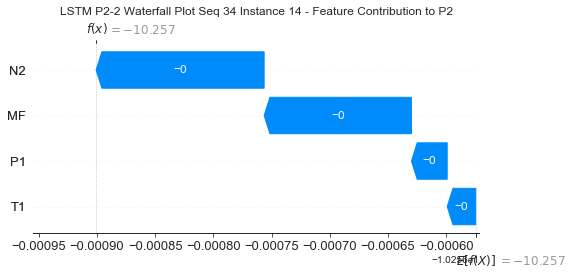

None

Contribution: [-3.38168332e-05 -2.69965594e-05 -1.52349286e-04 -1.44992631e-04]


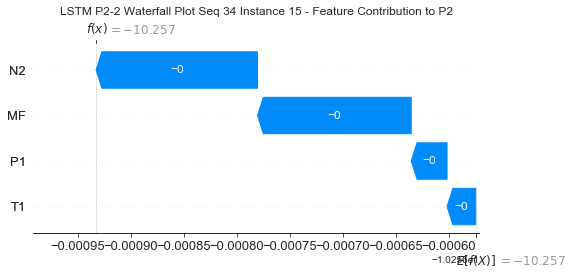

None

Contribution: [-3.49038913e-05 -2.69814041e-05 -1.51849661e-04 -1.45037031e-04]


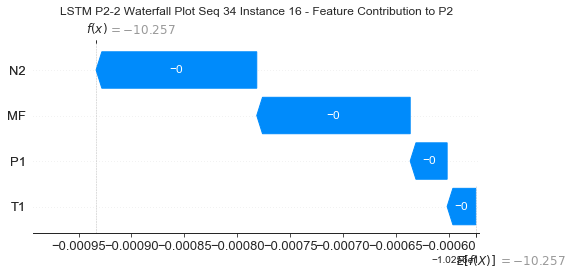

None

Contribution: [-3.48791566e-05 -2.56927626e-05 -1.48149251e-04 -1.39683806e-04]


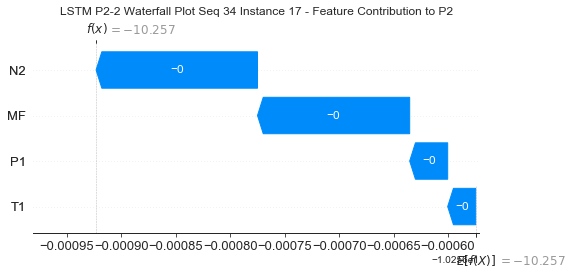

None

Contribution: [-3.27333902e-05 -3.05290079e-05 -1.71963635e-04 -1.71651719e-04]


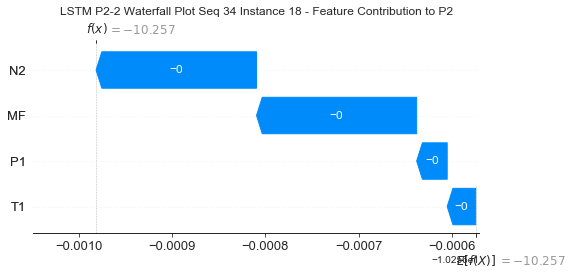

None

Contribution: [-1.80562554e-05 -5.41213486e-05 -2.78245320e-04 -3.03839400e-04]


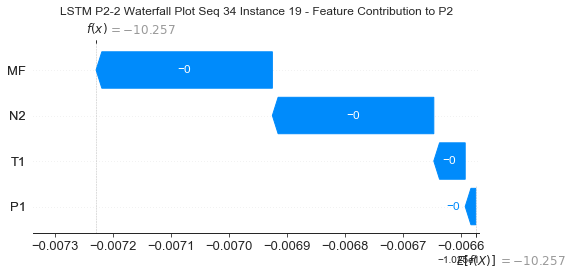

None

Contribution: [-1.02071933e-05 -7.37816854e-05 -3.42405851e-04 -3.77118754e-04]


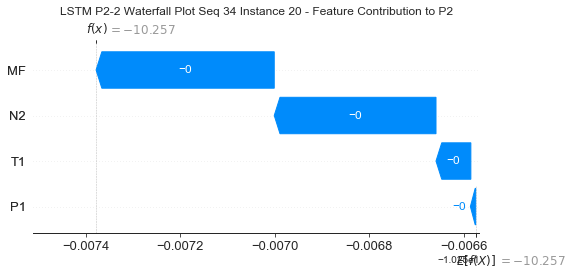

None

Contribution: [-8.51741547e-05  5.14092357e-05  2.59608862e-04  4.08226281e-04]


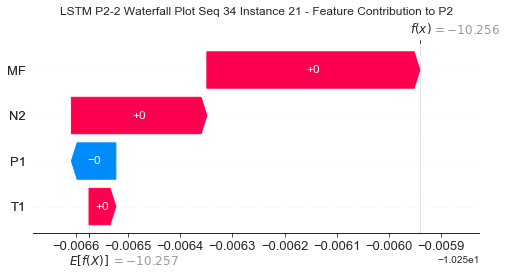

None

Contribution: [-0.00037834  0.00039238  0.00204014  0.00260809]


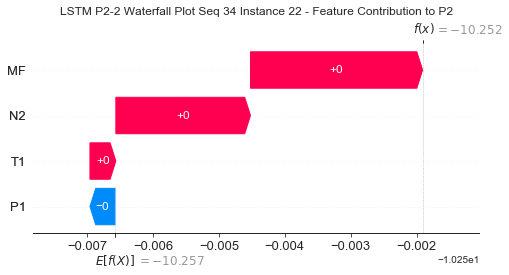

None

Contribution: [ 0.00079683 -0.00093695 -0.00659509 -0.00845413]


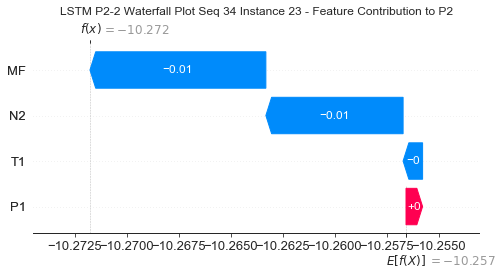

None

Contribution: [ 0.00123031  0.00964987 -0.02946732 -0.03884877]


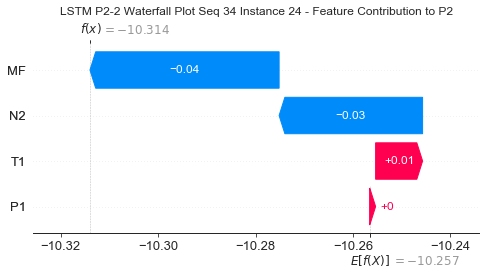

None

In [34]:
#Waterfall Plot for Local Accuracy & Consistency metrics
for s in range(0,34):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P2-2 Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P2" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [39]:
#Define New LSTM without probabilistic layers for Consistency metrics

inputs = tf.keras.Input(shape=(24,3),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model3 = tf.keras.Model(inputs=inputs, outputs=layer4)
model3.summary()

Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 24, 3)]           0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 24, 626)           1577520   
_________________________________________________________________
dense_7 (Dense)              (None, 24, 365)           228855    
_________________________________________________________________
dense_8 (Dense)              (None, 24, 1)             366       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 1,806,741
Trainable params: 1,806,741
Non-trainable params: 0
_________________________________________________________________


In [41]:
#Extract only weights for 3 variables excluding MF

a = model2.layers[1].get_weights()[0][0:3]
a = [a,model2.layers[1].get_weights()[1],model2.layers[1].get_weights()[2]]

In [42]:
#Transfer weights from previous LSTM to new LSTM with only Aleatoric Layer Output

model3.layers[0].set_weights(model2.layers[0].get_weights())
model3.layers[1].set_weights(a)
model3.layers[2].set_weights(model2.layers[2].get_weights())
model3.layers[3].set_weights(model2.layers[3].get_weights())
model3.layers[4].set_weights(model2.layers[4].get_weights())

In [43]:
#Load xtest and delete MF

xtrain_file = "xtrain.csv"
xtrain = pd.read_csv(xtrain_file, index_col=False)
xtrain = xtrain.drop(['MF'],axis=1)

#Load xtest and delete MF

xtest_file = "xtest.csv"
xtest = pd.read_csv(xtest_file, index_col=False)
xtest = xtest.drop(['MF'],axis=1)

#Xtest to Numpy multidimensional array

xtrain = xtrain.to_numpy()
xtrain = xtrain.reshape(278,24,3)

xtest = xtest.to_numpy()
xtest = xtest.reshape(34,24,3)

In [44]:
#Prediction with features excluding MF 

preds3 = model3(xtest)
y4 = preds3
y4 = tf.keras.backend.get_value(y4)
tens_draw4 = y4

In [45]:
#Extract Feature Names

features = pd.read_csv(xtrain_file, index_col=False)
features = features.drop(['MF'],axis=1)
features = np.array(list(features.columns))
features

array(['P1', 'T1', 'N2'], dtype='<U2')

Contribution: [ 0.0300113  -0.00722138 -0.07900922]


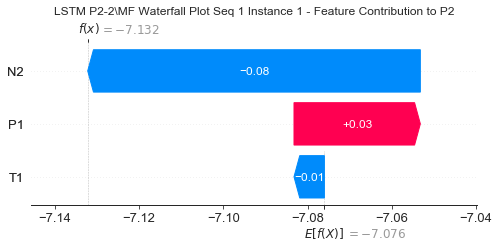

None

Contribution: [-0.00047535 -0.00025076  0.0005041 ]


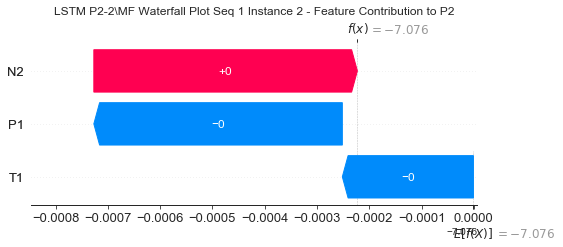

None

Contribution: [ 0.00037911  0.00114137 -0.00038631]


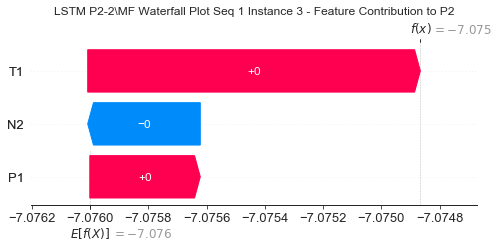

None

Contribution: [ 0.00030776  0.00062744 -0.00020552]


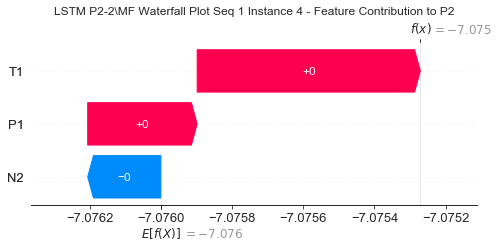

None

Contribution: [ 1.80511918e-05  9.32838505e-05 -4.72155117e-05]


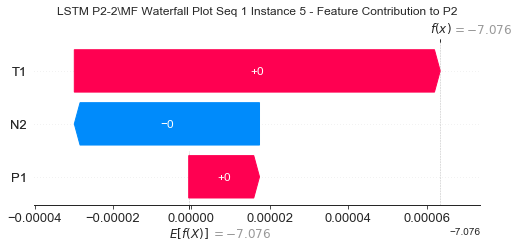

None

Contribution: [ 3.60435087e-06  3.39115784e-05 -2.94014489e-05]


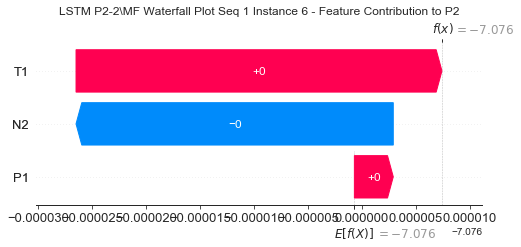

None

Contribution: [-3.42409097e-06  3.66042500e-05 -3.62804678e-05]


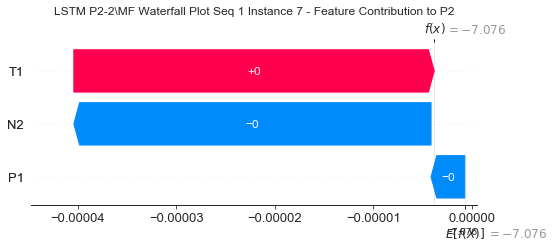

None

Contribution: [-7.13762835e-06  3.39373045e-05 -3.63471900e-05]


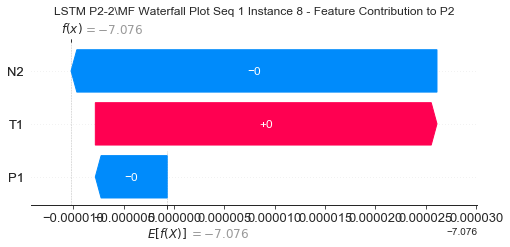

None

Contribution: [-1.38292525e-05  4.26472306e-05 -1.48356375e-05]


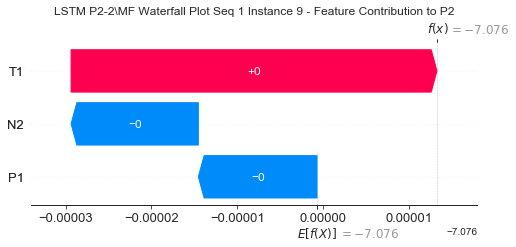

None

Contribution: [-1.59583330e-05  3.58161697e-05 -2.10197308e-06]


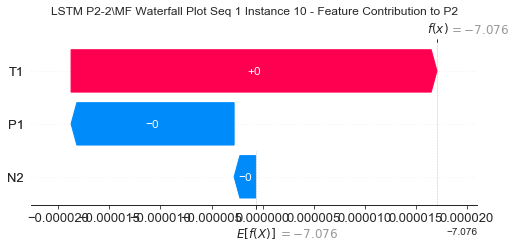

None

Contribution: [-3.11963106e-05  3.09295026e-05 -1.40862802e-05]


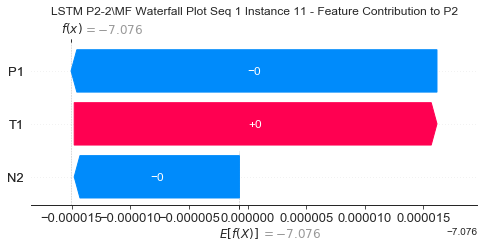

None

Contribution: [-4.47494169e-05  4.93625215e-05 -1.86049416e-05]


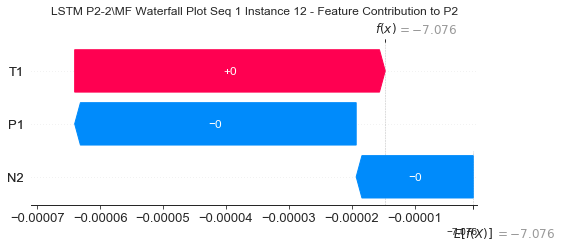

None

Contribution: [-4.00303467e-05  5.01897431e-05 -1.69145529e-05]


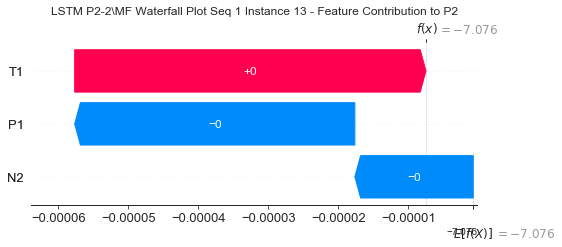

None

Contribution: [-1.35320522e-05  5.30096642e-05 -1.29189701e-05]


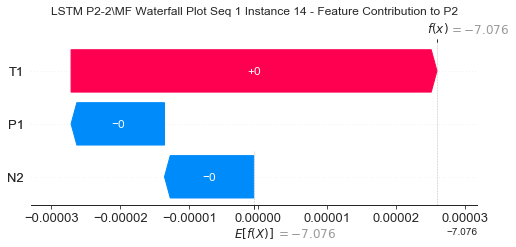

None

Contribution: [-4.31272472e-05  4.35519224e-05 -1.64249458e-05]


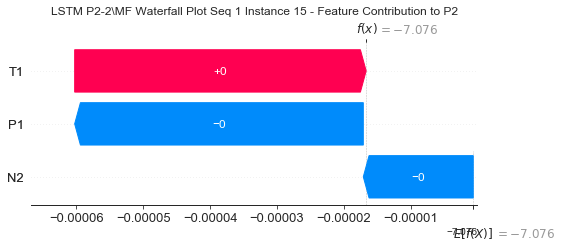

None

Contribution: [-4.50041250e-05  3.46739328e-05 -1.68409559e-05]


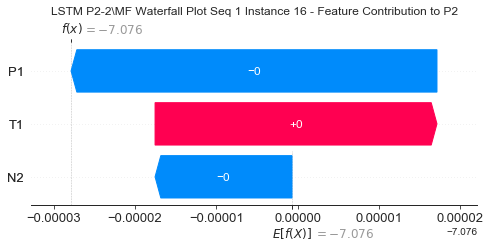

None

Contribution: [-2.78014056e-05  1.87963482e-05 -2.07543418e-05]


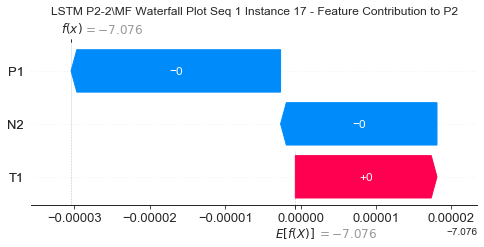

None

Contribution: [-5.19702923e-05  9.08080314e-06 -1.82329592e-05]


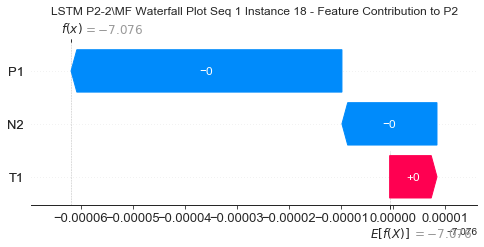

None

Contribution: [-5.44787238e-05 -1.65116047e-07 -1.79769968e-05]


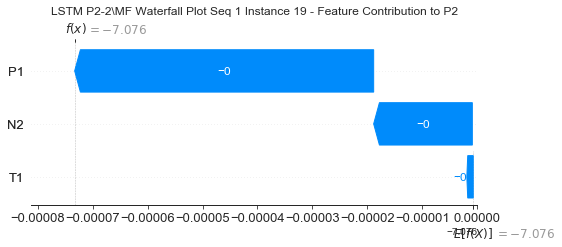

None

Contribution: [-5.65713120e-05 -6.97961651e-06 -1.78484950e-05]


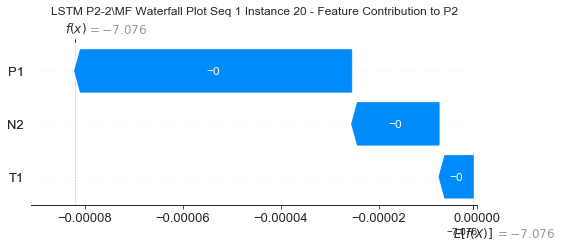

None

Contribution: [-4.09720880e-05 -5.79484209e-05 -1.95130780e-05]


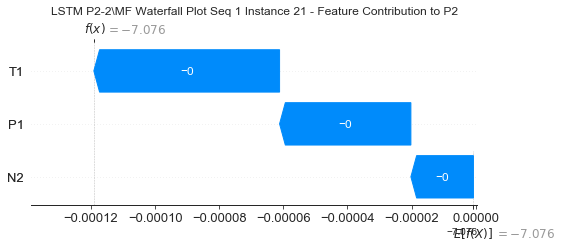

None

Contribution: [ 2.30066665e-05 -6.77150806e-04 -1.09915380e-04]


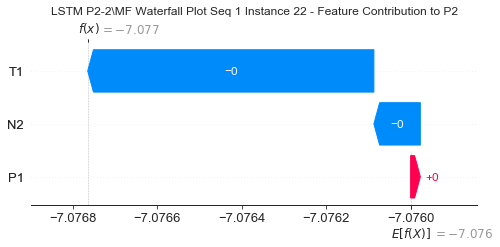

None

Contribution: [-7.84933043e-05  9.83637746e-04 -2.14138636e-03]


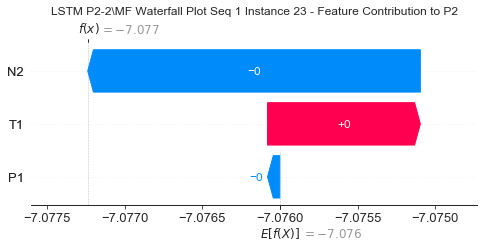

None

Contribution: [-0.00090799  0.01180689 -0.01476038]


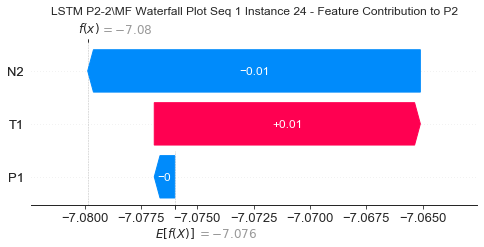

None

Contribution: [ 0.00342484 -0.00943278 -0.07967449]


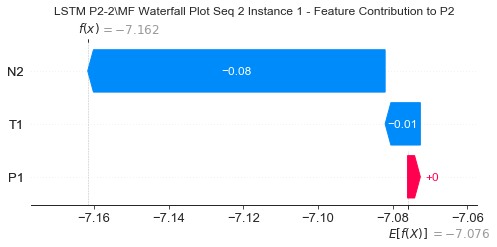

None

Contribution: [-0.00033399 -0.0006015   0.00046396]


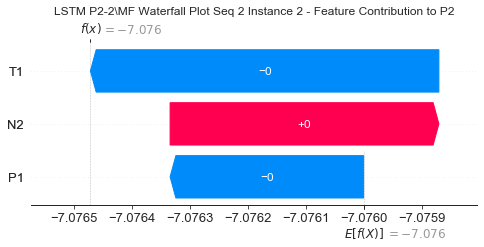

None

Contribution: [ 0.00011938 -0.0001178  -0.00031326]


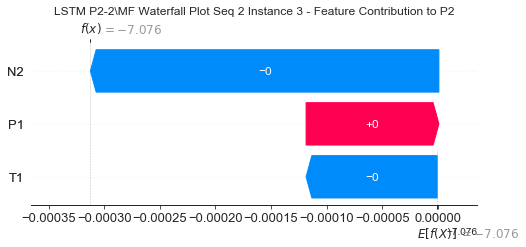

None

Contribution: [ 1.19547102e-04 -6.07481751e-05 -1.80225467e-04]


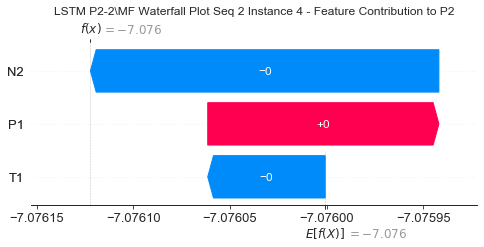

None

Contribution: [ 4.76856293e-06  7.37830031e-06 -3.79923378e-05]


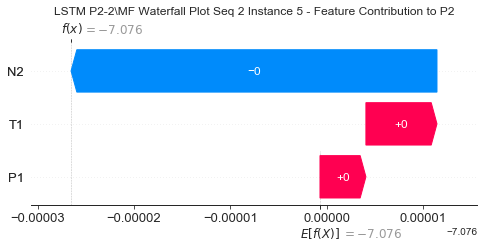

None

Contribution: [-2.53856984e-06  4.26065013e-06 -2.76862622e-05]


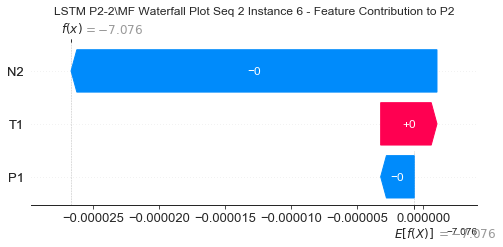

None

Contribution: [-7.49726847e-06  1.11810145e-05 -3.17761009e-05]


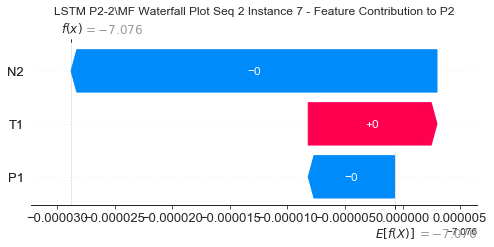

None

Contribution: [-1.30369246e-05  1.24555573e-05 -3.29642894e-05]


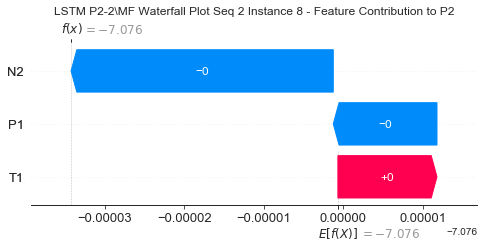

None

Contribution: [-2.40446581e-05  1.52454430e-05 -1.19087602e-05]


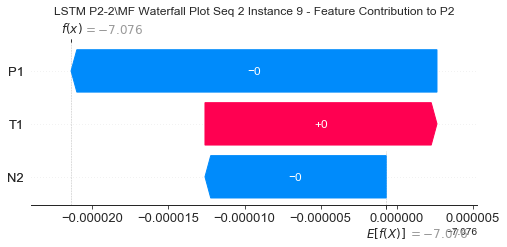

None

Contribution: [-2.93196482e-05  1.47739182e-06 -3.65238772e-06]


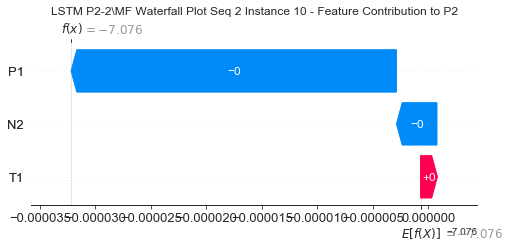

None

Contribution: [-4.28926893e-05 -1.38315356e-05 -1.58198280e-05]


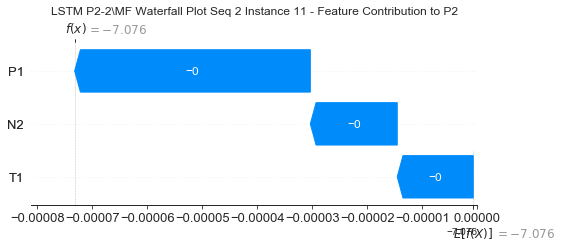

None

Contribution: [-5.05829845e-05 -1.70696289e-05 -1.89595479e-05]


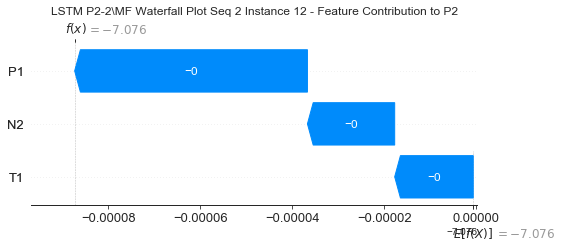

None

Contribution: [-5.06863669e-05 -2.28030389e-05 -1.75540479e-05]


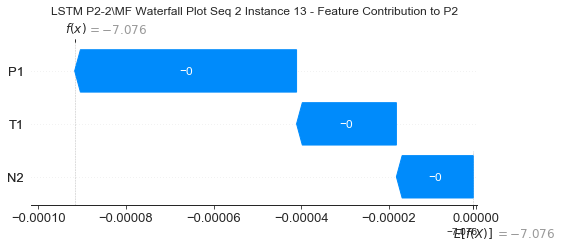

None

Contribution: [-2.73806234e-05 -3.19567619e-05 -1.53124024e-05]


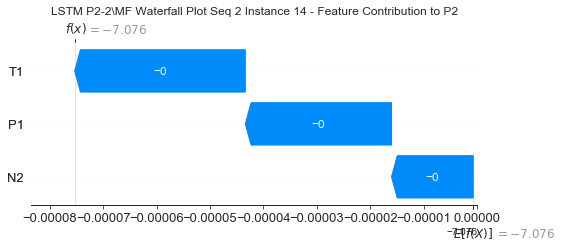

None

Contribution: [-4.91714210e-05 -4.89062456e-05 -1.75880329e-05]


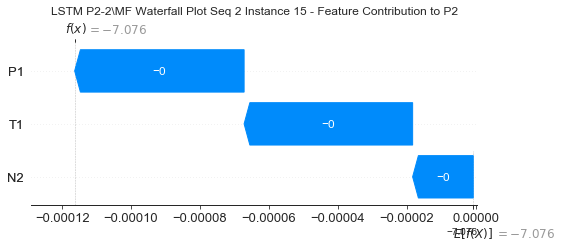

None

Contribution: [-5.10814830e-05 -5.82365041e-05 -2.00174058e-05]


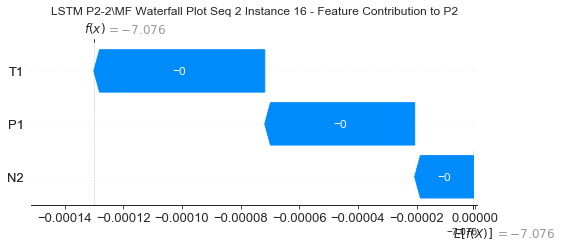

None

Contribution: [-3.09290837e-05 -7.13127031e-05 -2.13984348e-05]


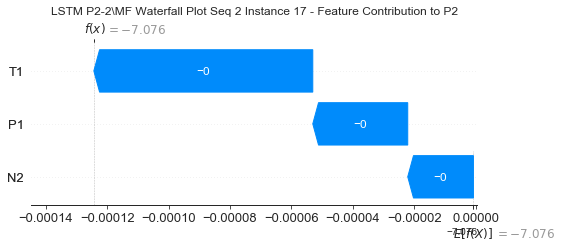

None

Contribution: [-5.50344566e-05 -8.51831076e-05 -2.20324570e-05]


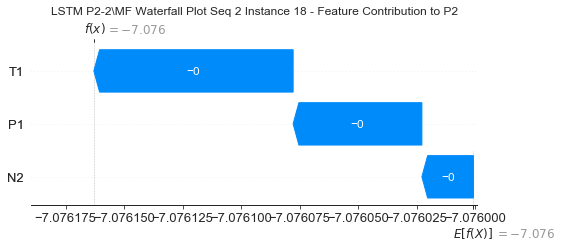

None

Contribution: [-5.78150782e-05 -9.50846436e-05 -2.22724691e-05]


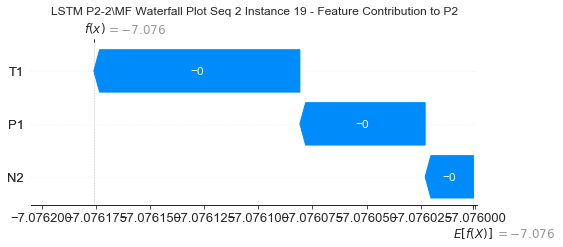

None

Contribution: [-6.07437933e-05 -9.97235384e-05 -2.13579701e-05]


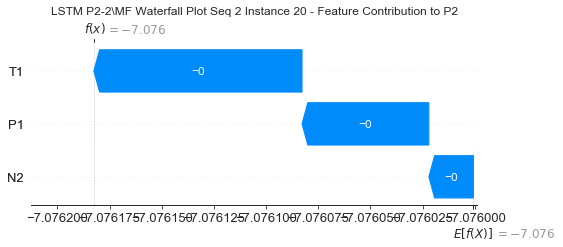

None

Contribution: [-4.75233179e-05 -1.39021612e-04 -2.85172124e-05]


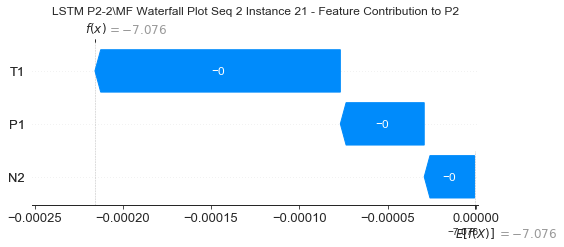

None

Contribution: [ 1.51094719e-05 -6.52353984e-04 -1.80360894e-04]


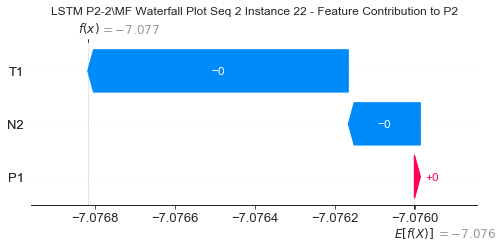

None

Contribution: [-0.0002244   0.0012818  -0.00184958]


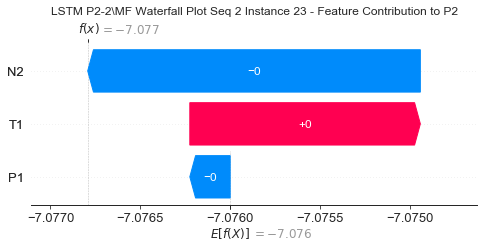

None

Contribution: [-0.0018627   0.02889899 -0.0146405 ]


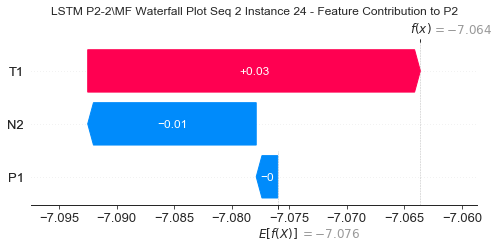

None

Contribution: [ 0.02328098 -0.00613656 -0.07867737]


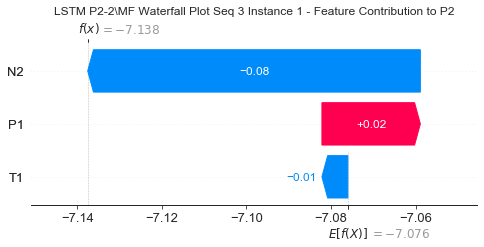

None

Contribution: [-0.00038016  0.00030418  0.00048214]


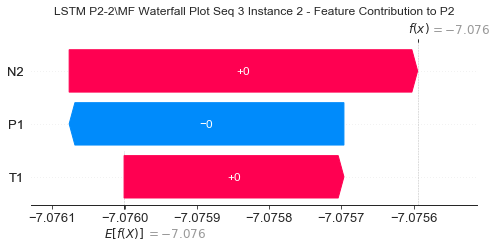

None

Contribution: [ 0.00035195  0.00401869 -0.00024168]


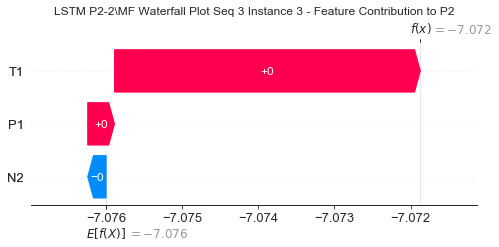

None

Contribution: [ 0.00028766  0.00201998 -0.00012174]


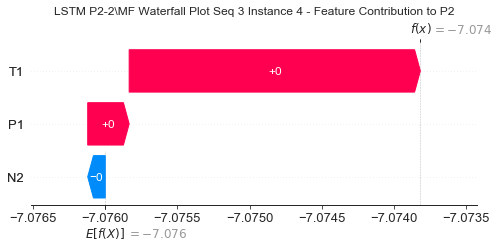

None

Contribution: [ 1.87068849e-05  2.16925913e-04 -4.25226547e-05]


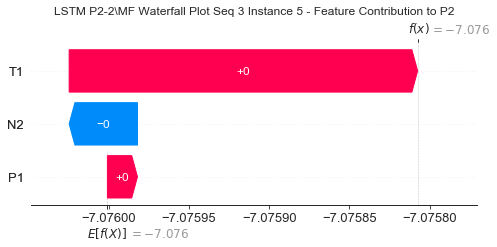

None

Contribution: [ 3.36624990e-06  8.09809971e-05 -2.73502244e-05]


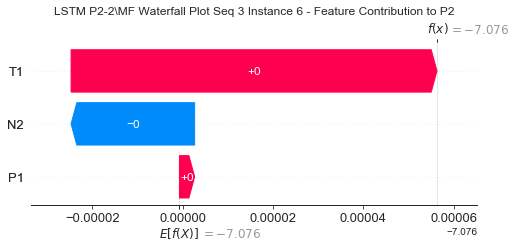

None

Contribution: [ 9.46576114e-07  9.20278399e-05 -3.03928426e-05]


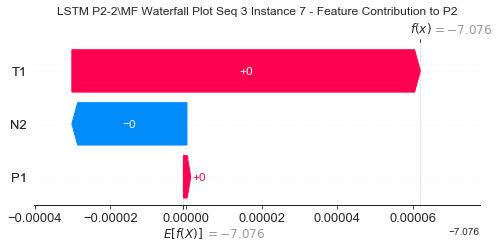

None

Contribution: [-8.84695764e-06  1.09442615e-04 -3.10439995e-05]


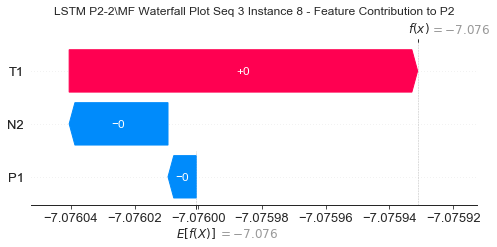

None

Contribution: [-9.21371338e-06  9.34880613e-05 -1.16419578e-05]


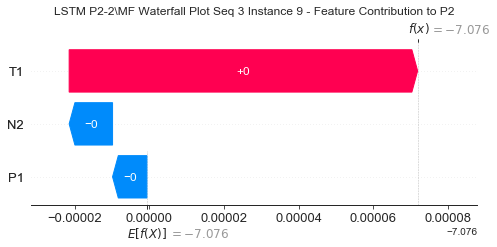

None

Contribution: [-1.27029915e-05  4.67249638e-05 -4.47759742e-06]


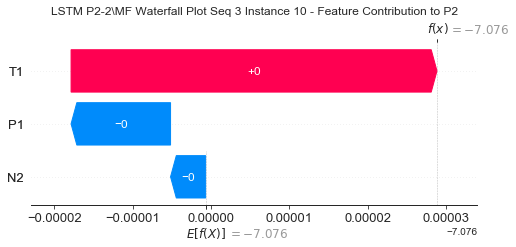

None

Contribution: [-2.45723466e-05  3.89045444e-05 -1.51941569e-05]


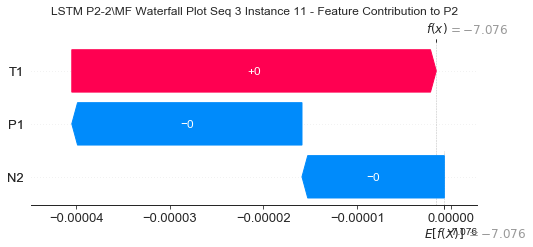

None

Contribution: [-3.05897701e-05  8.02039224e-05 -1.72068900e-05]


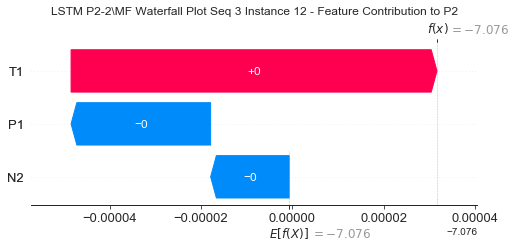

None

Contribution: [-3.10376096e-05  1.03197558e-04 -1.49440725e-05]


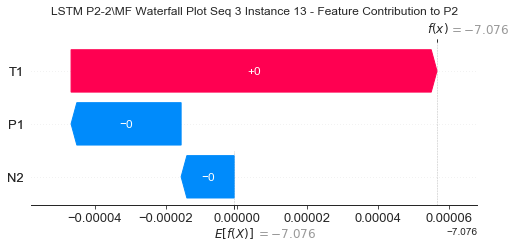

None

Contribution: [-2.24810982e-05  1.17870759e-04 -1.10322781e-05]


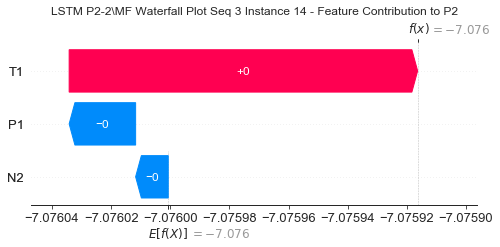

None

Contribution: [-3.03878267e-05  1.21838238e-04 -1.36813533e-05]


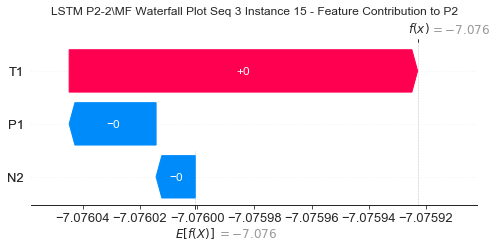

None

Contribution: [-3.33599711e-05  1.17739178e-04 -1.38117297e-05]


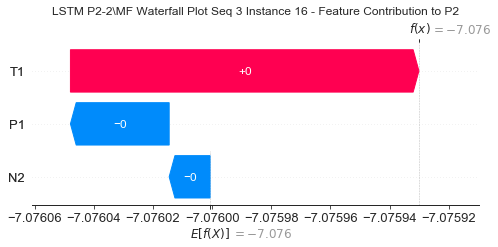

None

Contribution: [-2.84176479e-05  1.02121919e-04 -1.60945077e-05]


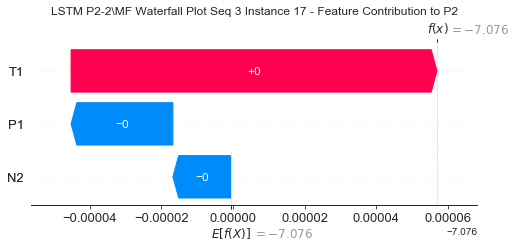

None

Contribution: [-3.55655102e-05  8.73988354e-05 -1.65411187e-05]


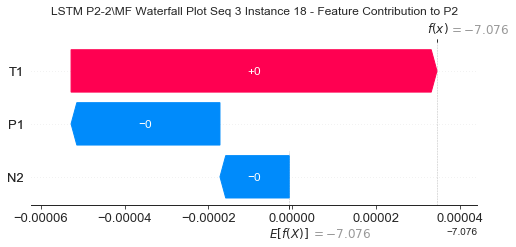

None

Contribution: [-3.83026985e-05  7.56820290e-05 -1.59989070e-05]


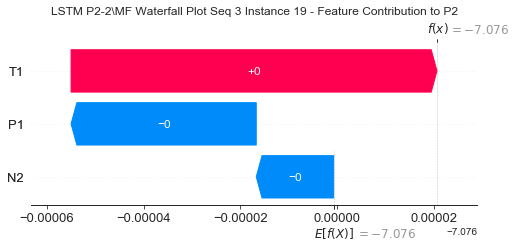

None

Contribution: [-3.96086770e-05  6.17084129e-05 -1.64379526e-05]


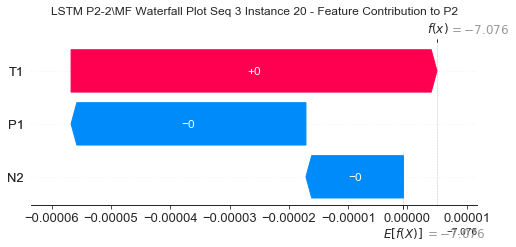

None

Contribution: [-2.22279263e-05 -5.81768992e-05 -2.40914488e-05]


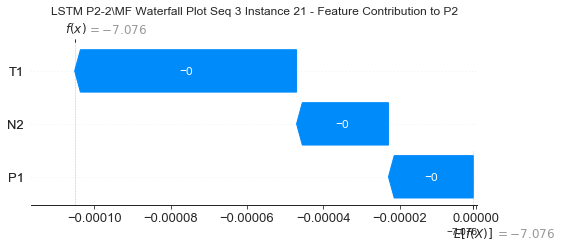

None

Contribution: [ 5.41480289e-05 -1.17828742e-03 -1.64435920e-04]


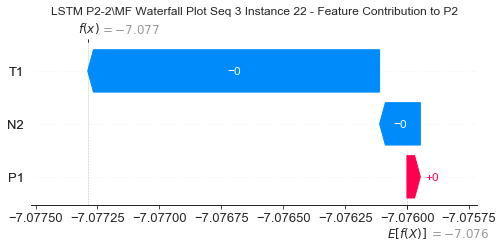

None

Contribution: [-0.00016586  0.00492881 -0.0018234 ]


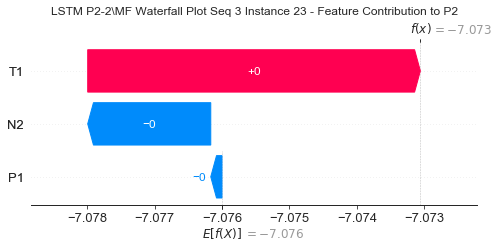

None

Contribution: [-0.00197757  0.04859343 -0.01278391]


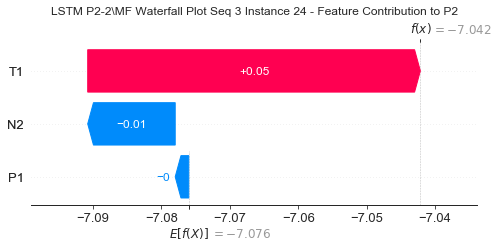

None

Contribution: [ 0.03220016 -0.00279699 -0.06166505]


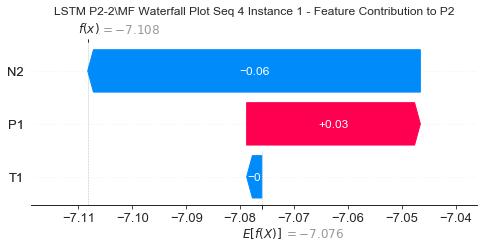

None

Contribution: [-0.00037687  0.00102617  0.00041768]


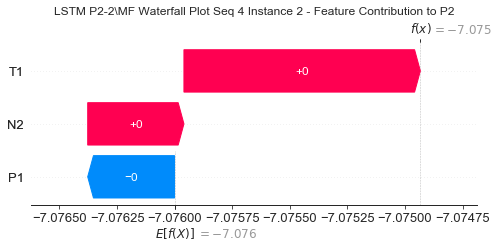

None

Contribution: [ 3.94323308e-04  4.36708470e-03 -9.05620651e-05]


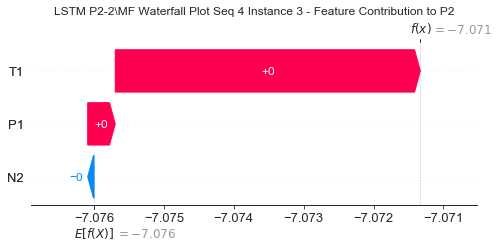

None

Contribution: [ 2.93218293e-04  2.02869649e-03 -5.15816280e-05]


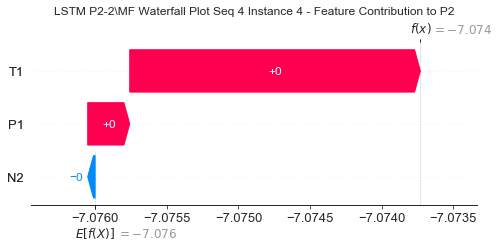

None

Contribution: [ 1.47461164e-05  1.71389135e-04 -3.49046905e-05]


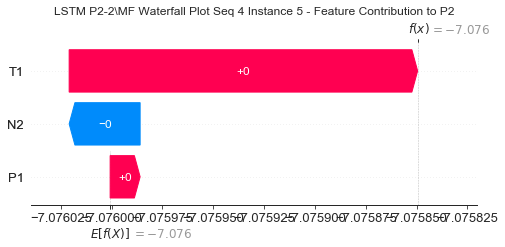

None

Contribution: [ 2.48094028e-06  7.31199579e-05 -2.50761263e-05]


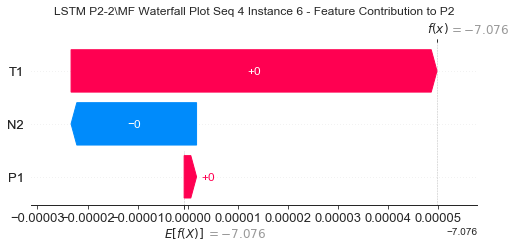

None

Contribution: [-3.00563894e-06  8.71867801e-05 -2.99134339e-05]


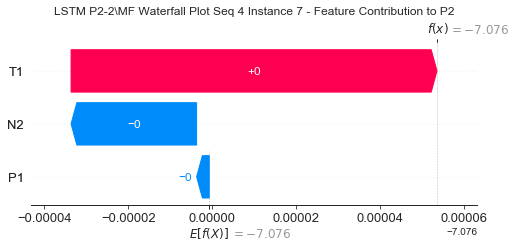

None

Contribution: [-8.17112444e-06  9.57747586e-05 -3.09870053e-05]


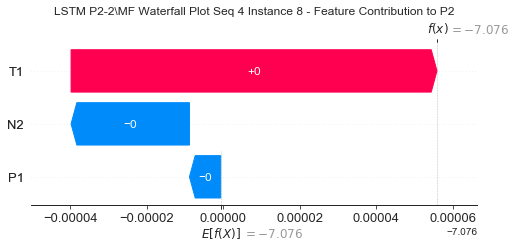

None

Contribution: [-9.52408709e-06  8.01087473e-05 -1.11010213e-05]


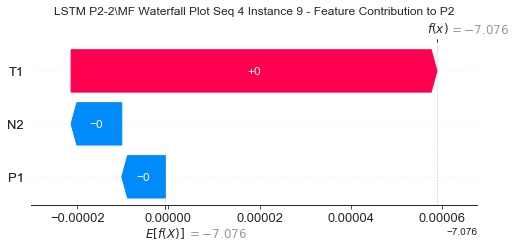

None

Contribution: [-1.43012451e-05  3.17440945e-05 -3.98296507e-06]


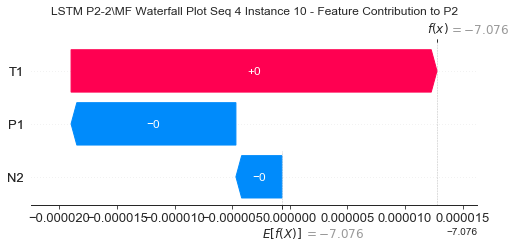

None

Contribution: [-2.94114884e-05  2.17744672e-05 -1.60375808e-05]


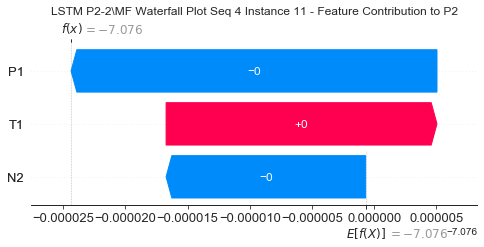

None

Contribution: [-8.11448495e-06  6.32882102e-05 -1.67597889e-05]


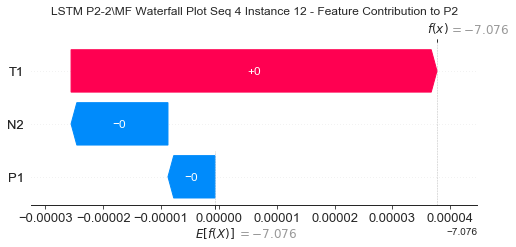

None

Contribution: [-3.43828391e-05  8.98667663e-05 -1.58587664e-05]


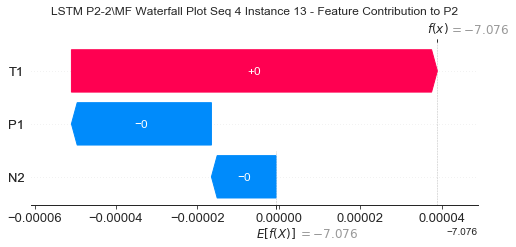

None

Contribution: [-2.98790306e-05  1.14408192e-04 -1.18576904e-05]


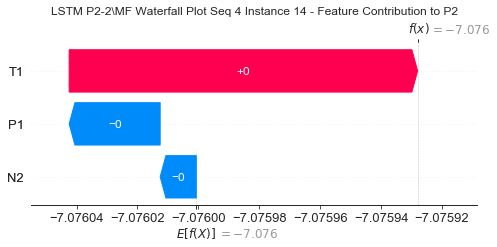

None

Contribution: [-3.74981738e-05  1.19487551e-04 -1.53208797e-05]


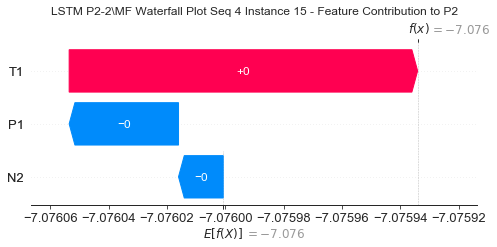

None

Contribution: [-3.79305685e-05  1.17606140e-04 -1.53187543e-05]


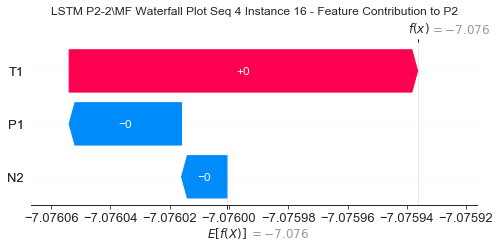

None

Contribution: [-3.92396644e-05  1.06294936e-04 -1.75303851e-05]


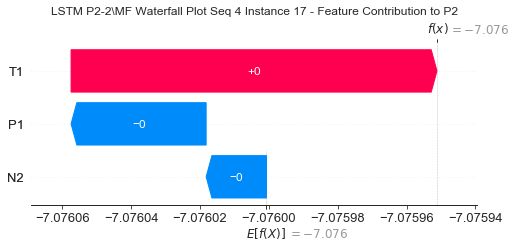

None

Contribution: [-4.35459025e-05  9.63743000e-05 -1.68696694e-05]


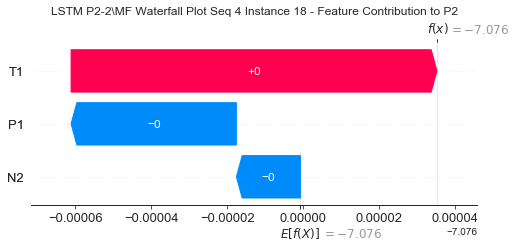

None

Contribution: [-4.40056017e-05  8.39864263e-05 -1.66699715e-05]


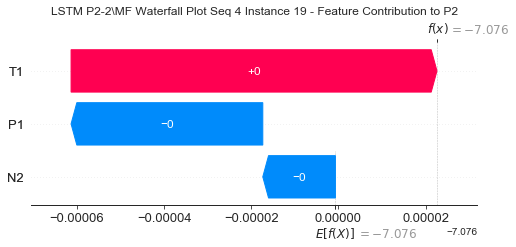

None

Contribution: [-4.32912273e-05  6.90032103e-05 -1.64510762e-05]


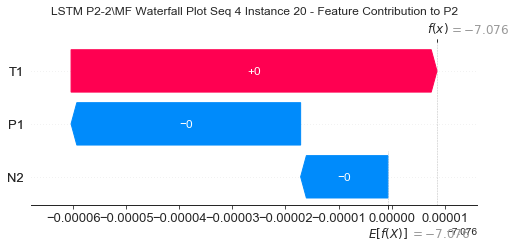

None

Contribution: [-2.14993909e-05 -6.42741803e-05 -2.22627198e-05]


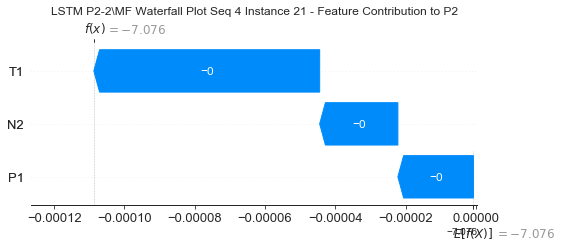

None

Contribution: [ 5.22122394e-05 -1.14319392e-03 -1.53165647e-04]


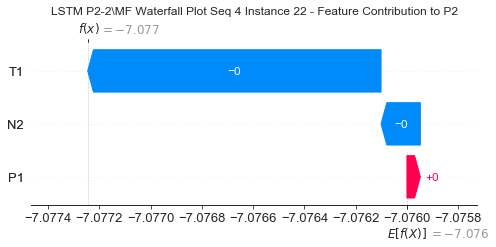

None

Contribution: [-0.00014826  0.00471284 -0.00173772]


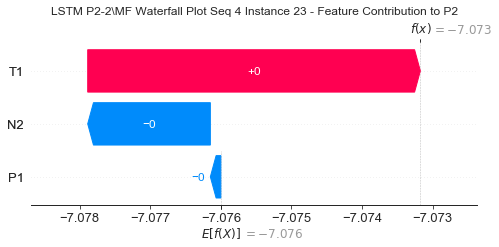

None

Contribution: [-0.00149406  0.04777198 -0.0135843 ]


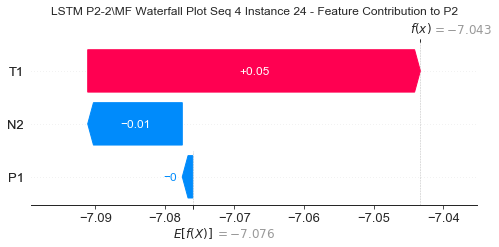

None

Contribution: [ 0.02263914 -0.00312747 -0.06639476]


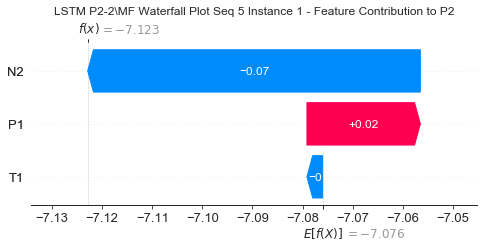

None

Contribution: [-0.00031381  0.00122815  0.00041594]


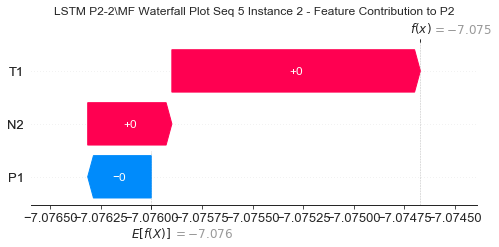

None

Contribution: [ 0.00039998  0.00540027 -0.00017368]


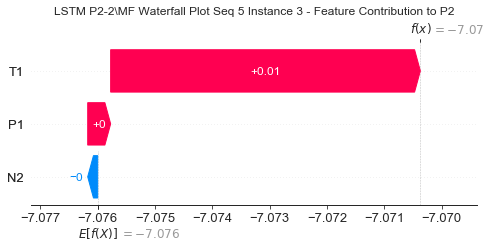

None

Contribution: [ 2.88013992e-04  2.45368057e-03 -8.57257132e-05]


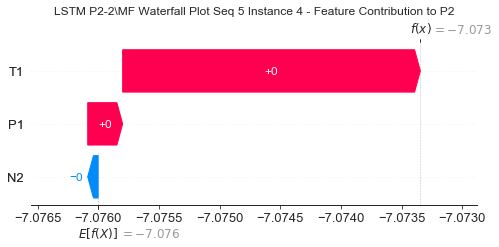

None

Contribution: [ 1.22918710e-05  2.37625000e-04 -3.59708468e-05]


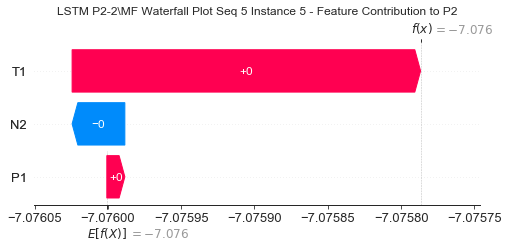

None

Contribution: [ 2.52112759e-06  8.67438107e-05 -2.66702998e-05]


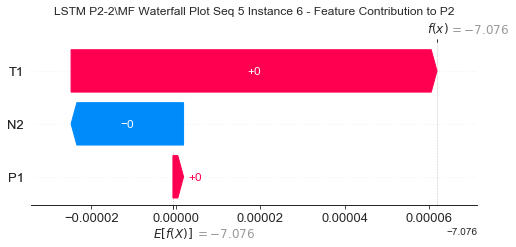

None

Contribution: [-2.12813484e-06  1.00460889e-04 -3.18612156e-05]


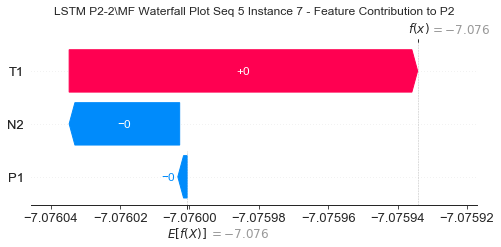

None

Contribution: [-5.32494320e-06  1.07039179e-04 -3.13128333e-05]


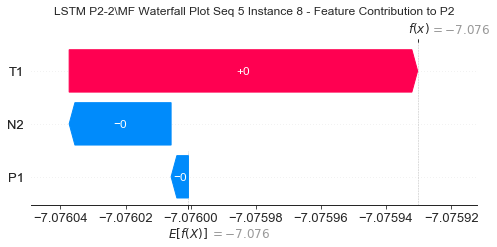

None

Contribution: [-1.13827969e-05  8.90223268e-05 -1.25396738e-05]


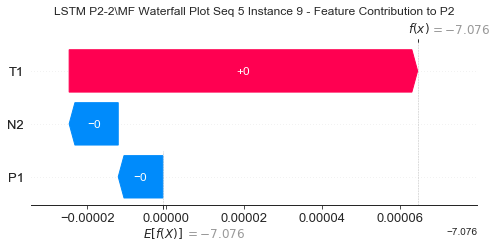

None

Contribution: [-1.75855142e-05  3.49847575e-05 -4.22055223e-06]


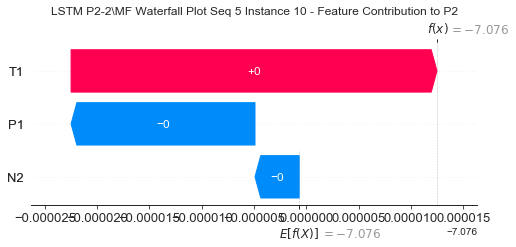

None

Contribution: [-3.14847494e-05  2.40632153e-05 -1.52470182e-05]


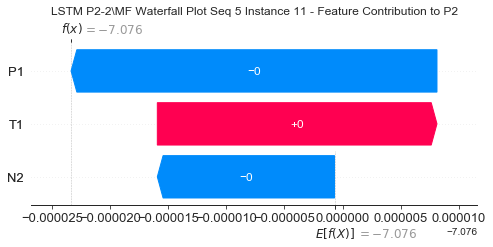

None

Contribution: [-2.14724471e-05  7.02264211e-05 -1.84161183e-05]


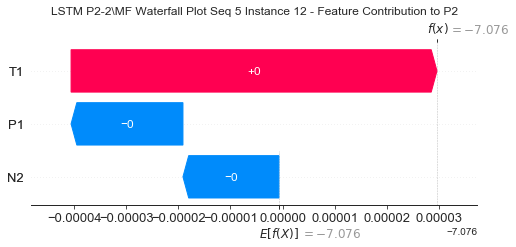

None

Contribution: [-3.84396885e-05  9.85103062e-05 -1.57627316e-05]


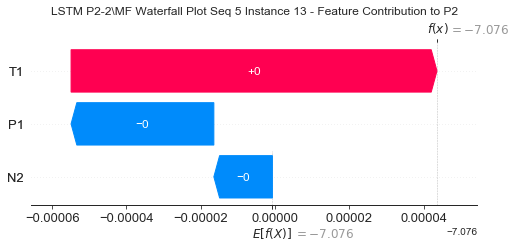

None

Contribution: [-3.30587817e-05  1.19697624e-04 -1.20347272e-05]


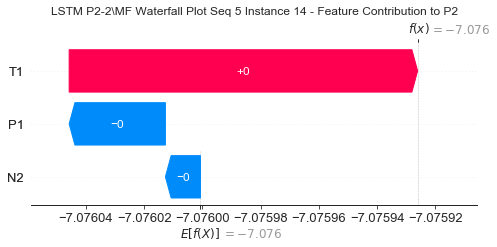

None

Contribution: [-4.01612490e-05  1.28270386e-04 -1.57223150e-05]


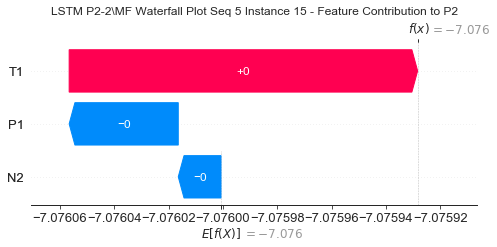

None

Contribution: [-3.88927249e-05  1.26221127e-04 -1.60009872e-05]


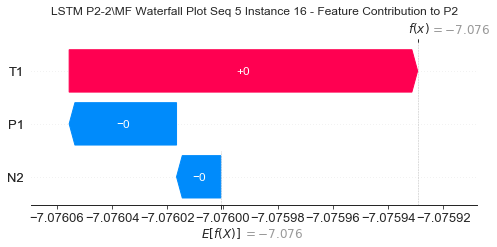

None

Contribution: [-2.00119577e-05  1.17108545e-04 -1.61971404e-05]


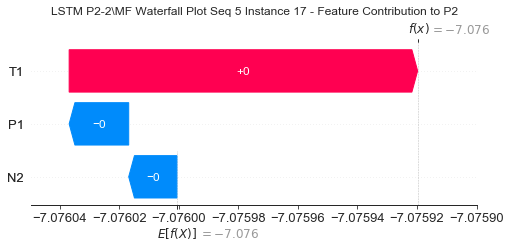

None

Contribution: [-3.86314737e-05  1.04171238e-04 -1.72123207e-05]


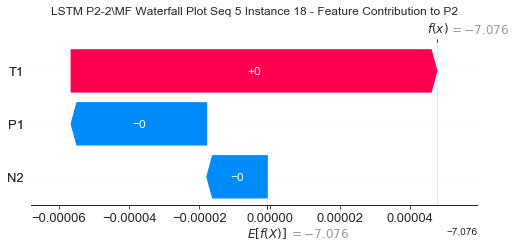

None

Contribution: [-3.91337453e-05  9.07576536e-05 -1.67599777e-05]


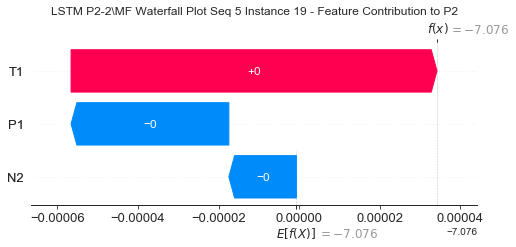

None

Contribution: [-3.86554355e-05  7.38454683e-05 -1.68805125e-05]


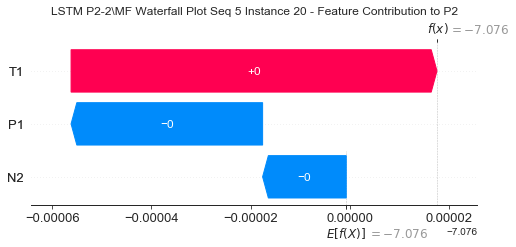

None

Contribution: [-1.98555526e-05 -6.10469849e-05 -2.26422531e-05]


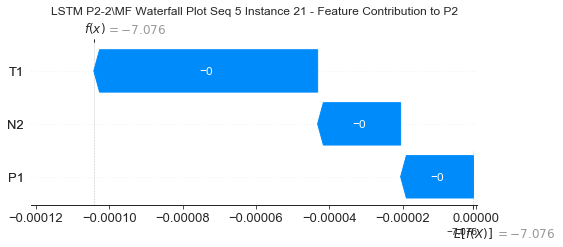

None

Contribution: [ 6.36508052e-05 -1.17692293e-03 -1.52748204e-04]


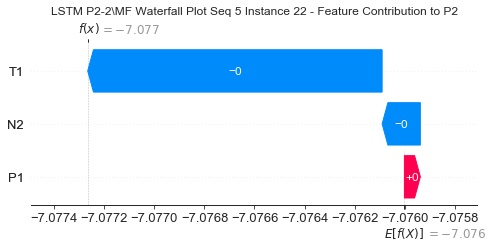

None

Contribution: [-0.00031326  0.00460348 -0.00172264]


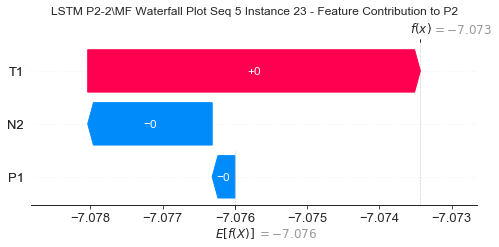

None

Contribution: [-0.00256145  0.04822236 -0.01347606]


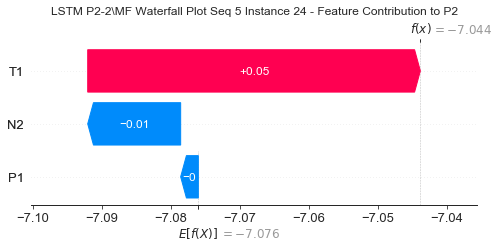

None

Contribution: [ 0.0326354  -0.00297119 -0.06884698]


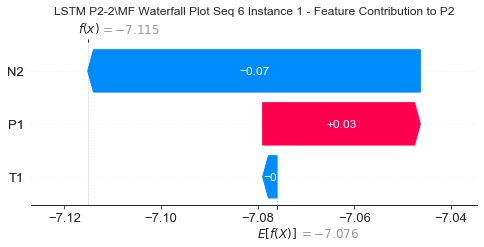

None

Contribution: [-0.00031814  0.00112275  0.00043533]


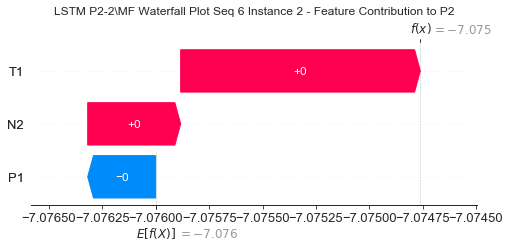

None

Contribution: [ 4.66651264e-04  4.71390989e-03 -5.93960698e-05]


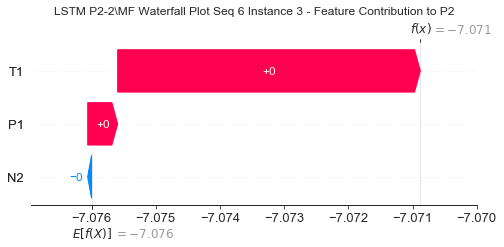

None

Contribution: [ 3.13465945e-04  2.18489774e-03 -4.70116669e-05]


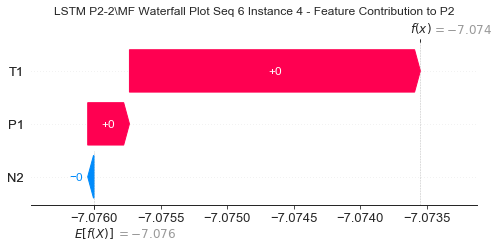

None

Contribution: [ 2.50290372e-05  2.08713260e-04 -3.23477233e-05]


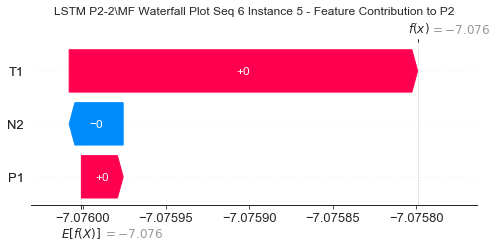

None

Contribution: [ 3.22414757e-06  7.80091407e-05 -2.52858031e-05]


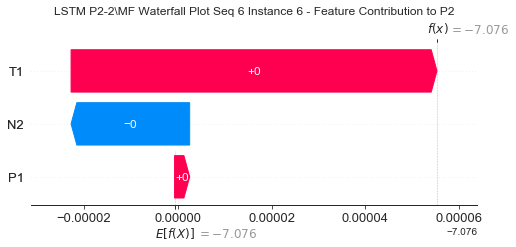

None

Contribution: [-2.37555857e-07  9.16997275e-05 -2.94065193e-05]


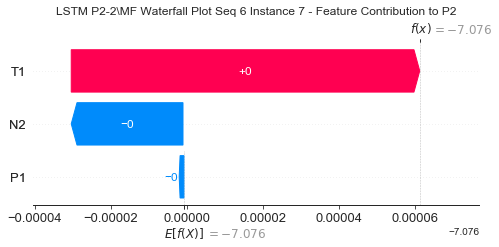

None

Contribution: [-3.88240822e-06  9.41334817e-05 -3.16384019e-05]


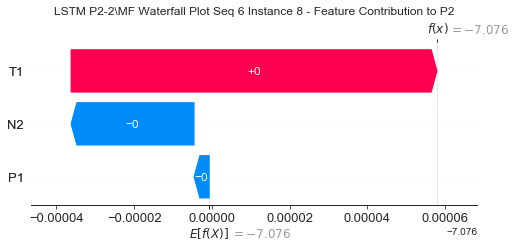

None

Contribution: [-1.04767265e-05  8.49244798e-05 -1.17203858e-05]


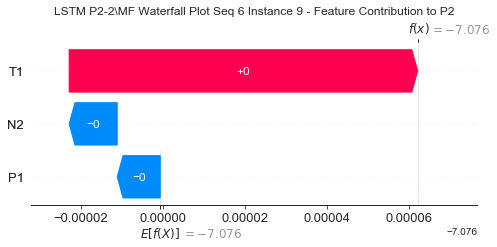

None

Contribution: [-1.36456707e-05  3.51370056e-05 -3.66415954e-06]


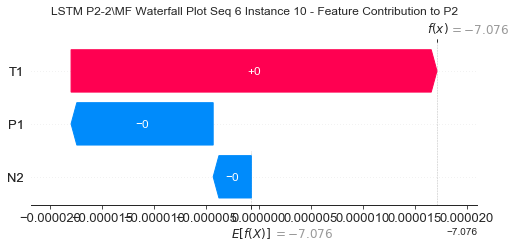

None

Contribution: [-2.67008838e-05  2.67938154e-05 -1.49360743e-05]


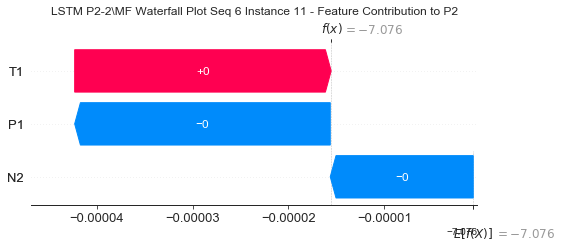

None

Contribution: [-4.30059063e-05  6.93322696e-05 -1.84154744e-05]


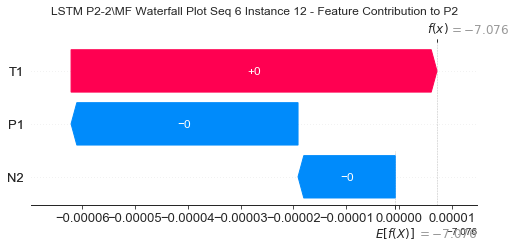

None

Contribution: [-3.44002060e-05  9.50044701e-05 -1.57950144e-05]


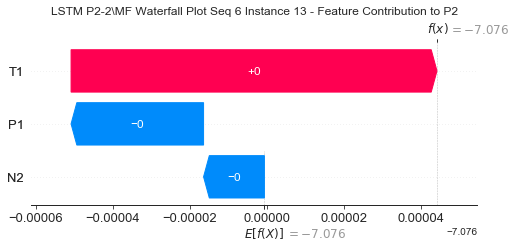

None

Contribution: [-2.67021307e-05  1.17417874e-04 -9.54373929e-06]


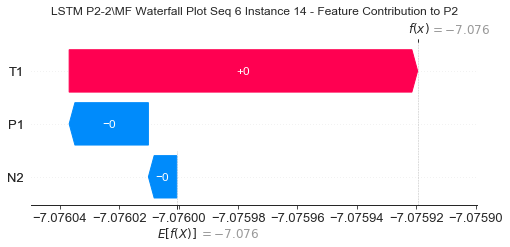

None

Contribution: [-3.72174799e-05  1.22053047e-04 -1.53067694e-05]


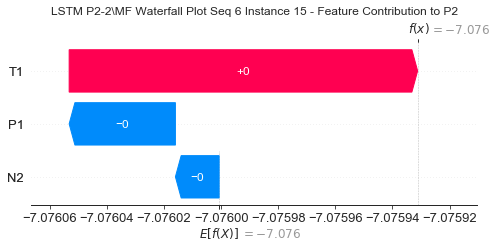

None

Contribution: [-4.23299476e-05  1.19011546e-04 -1.55786445e-05]


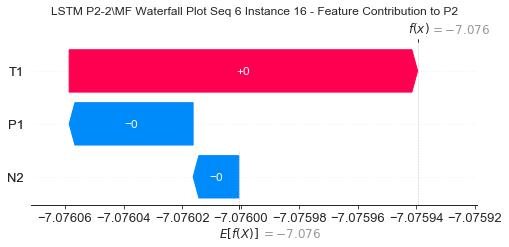

None

Contribution: [-2.48872250e-05  1.04979726e-04 -1.69835765e-05]


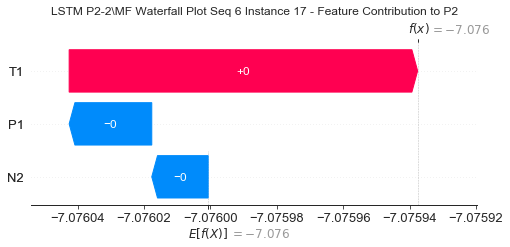

None

Contribution: [-4.41040998e-05  9.45647546e-05 -1.64107618e-05]


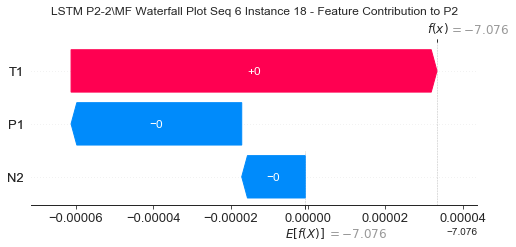

None

Contribution: [-4.84485084e-05  8.17850665e-05 -1.64811057e-05]


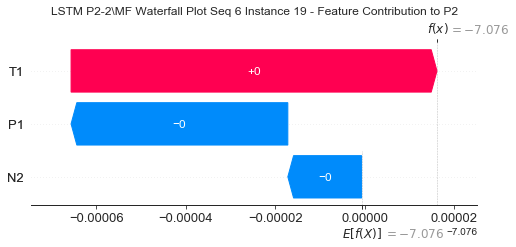

None

Contribution: [-4.85872792e-05  6.63522593e-05 -1.68447678e-05]


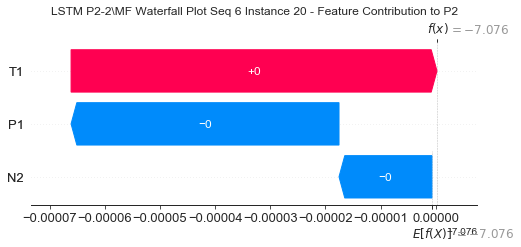

None

Contribution: [-3.55332660e-05 -5.16147104e-05 -2.07815830e-05]


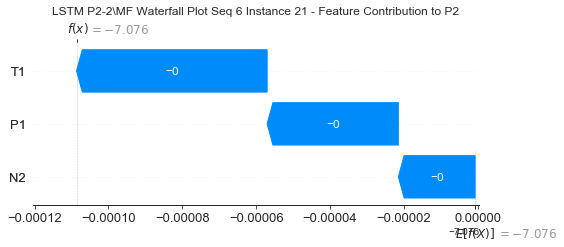

None

Contribution: [ 2.75476383e-05 -1.05320243e-03 -1.38549545e-04]


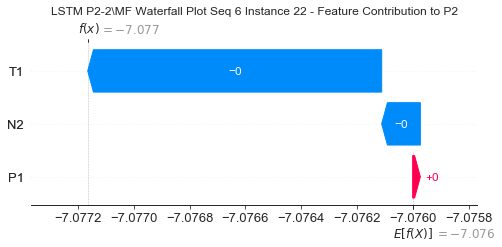

None

Contribution: [-0.00022315  0.00406997 -0.001821  ]


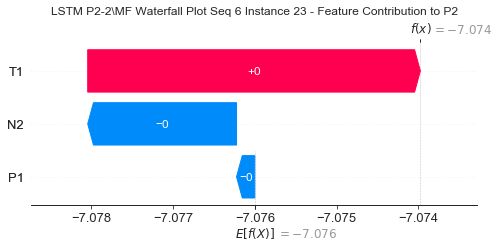

None

Contribution: [-0.00131657  0.04141384 -0.01439276]


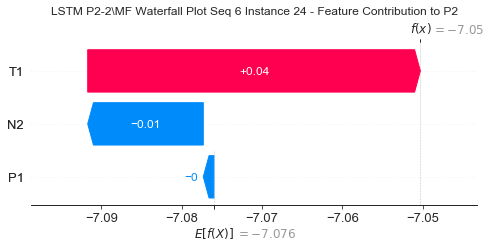

None

Contribution: [ 0.02682145 -0.00450043 -0.07500918]


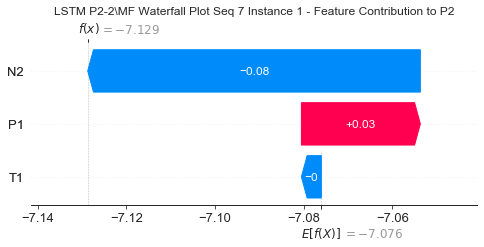

None

Contribution: [-0.00037354  0.00085911  0.00042988]


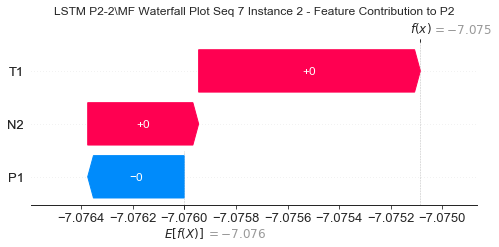

None

Contribution: [ 0.00037416  0.0049519  -0.00012297]


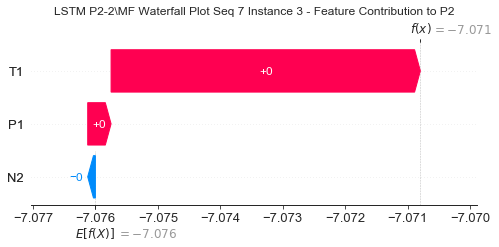

None

Contribution: [ 2.82983619e-04  2.38562327e-03 -7.65719393e-05]


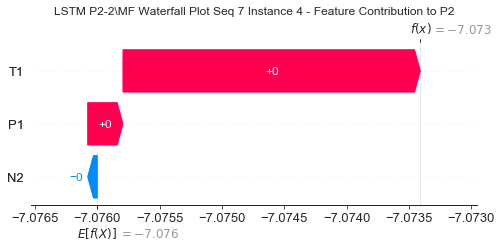

None

Contribution: [ 2.06852904e-05  2.25828023e-04 -3.55574279e-05]


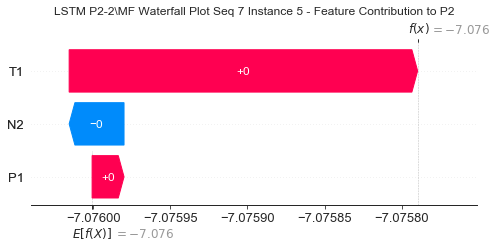

None

Contribution: [ 2.74076347e-06  8.85480631e-05 -2.63119984e-05]


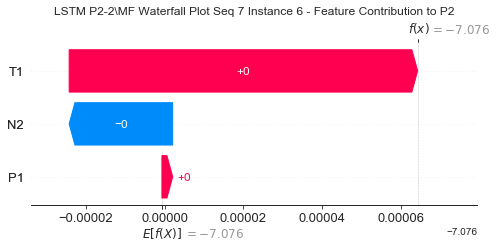

None

Contribution: [-5.18992820e-07  1.08971990e-04 -2.73487173e-05]


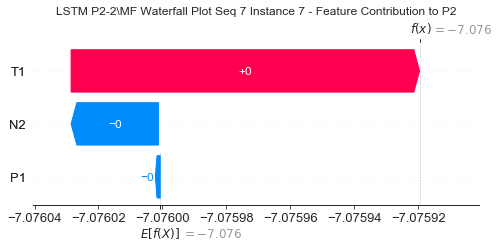

None

Contribution: [-8.28460695e-06  1.04429363e-04 -2.94730860e-05]


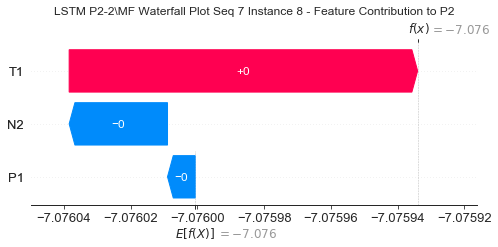

None

Contribution: [-1.02594073e-05  9.45025439e-05 -1.02348351e-05]


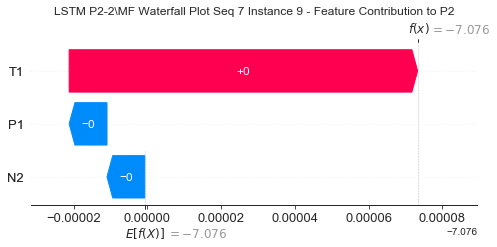

None

Contribution: [-1.52096463e-05  3.83603741e-05 -4.62997887e-06]


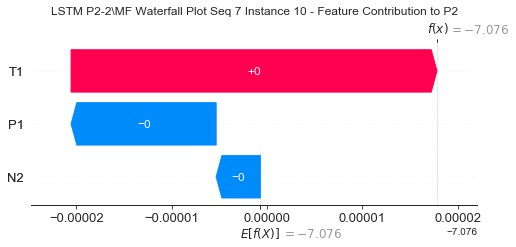

None

Contribution: [-2.80238247e-05  2.38959075e-05 -1.58173989e-05]


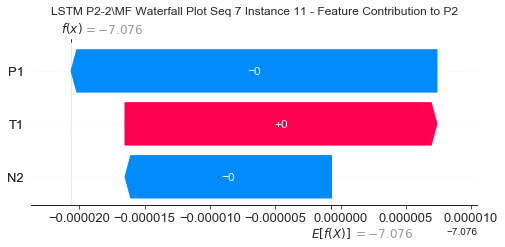

None

Contribution: [-3.50185089e-05  7.25303399e-05 -1.78548859e-05]


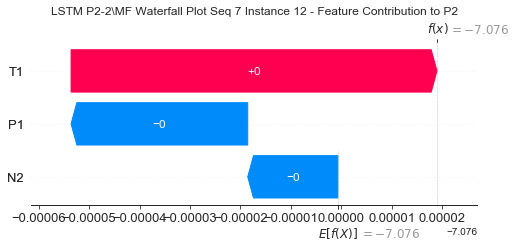

None

Contribution: [-3.36967637e-05  1.05793129e-04 -1.67354952e-05]


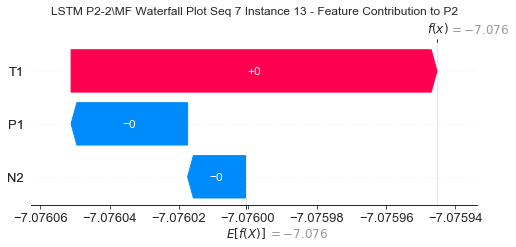

None

Contribution: [-2.61104689e-05  1.35439805e-04 -1.29976345e-05]


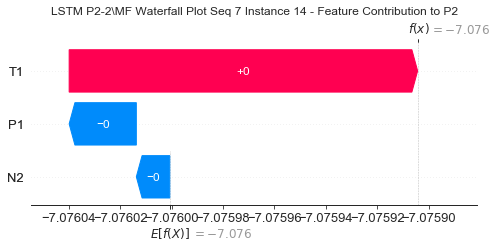

None

Contribution: [-3.30381865e-05  1.42040630e-04 -1.55726642e-05]


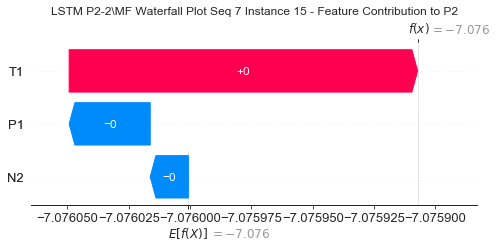

None

Contribution: [-3.56009962e-05  1.39991468e-04 -1.64046073e-05]


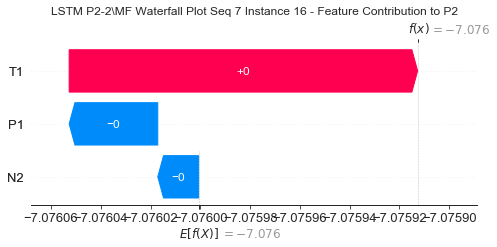

None

Contribution: [-2.94419377e-05  1.29852304e-04 -1.68948203e-05]


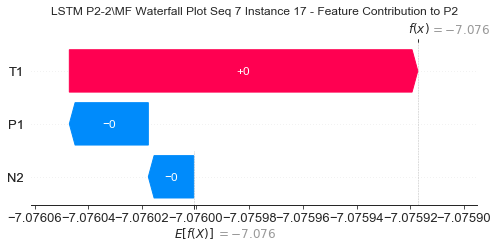

None

Contribution: [-3.45988777e-05  1.15504845e-04 -1.77175571e-05]


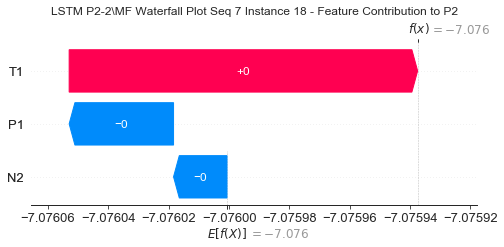

None

Contribution: [-3.73211887e-05  1.01206618e-04 -1.74514073e-05]


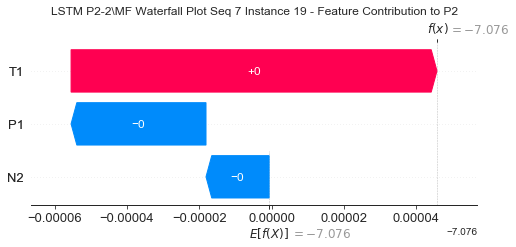

None

Contribution: [-3.73810246e-05  8.31450079e-05 -1.72078832e-05]


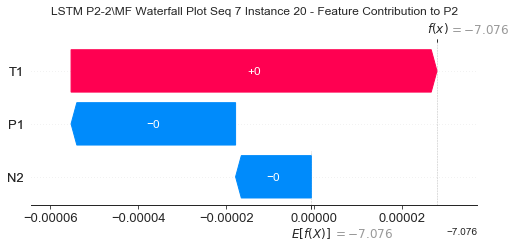

None

Contribution: [-1.99884623e-05 -7.38165002e-05 -2.26736496e-05]


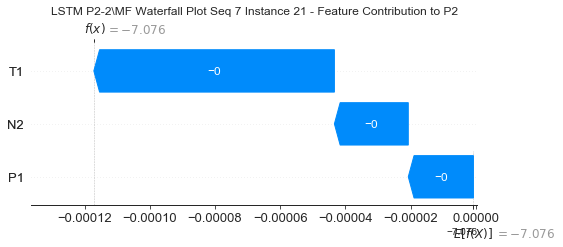

None

Contribution: [ 6.37623837e-05 -1.34262374e-03 -1.51984876e-04]


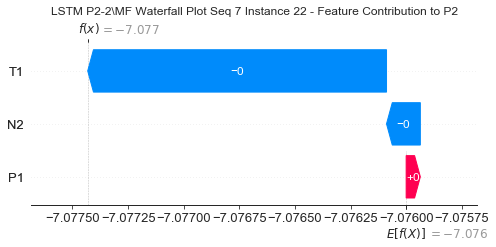

None

Contribution: [-0.00021106  0.00593289 -0.00178883]


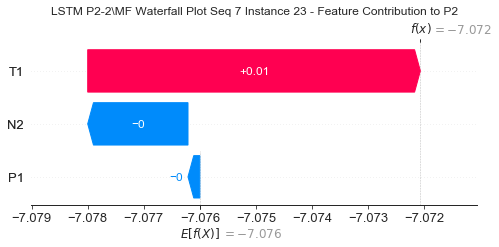

None

Contribution: [-0.00179349  0.05927276 -0.01442818]


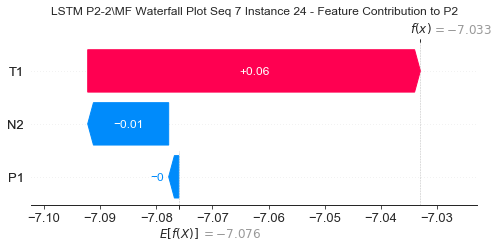

None

Contribution: [ 0.03298951 -0.00269756 -0.06652333]


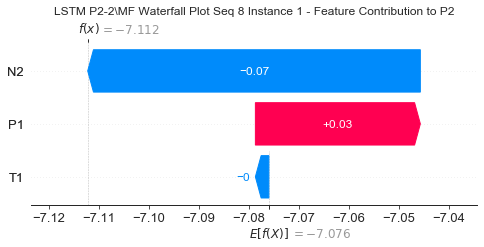

None

Contribution: [-0.00042622  0.00150823  0.00043154]


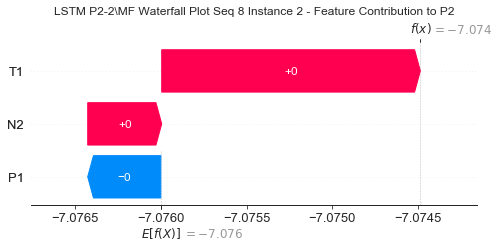

None

Contribution: [3.58122332e-04 6.44868142e-03 3.81742493e-05]


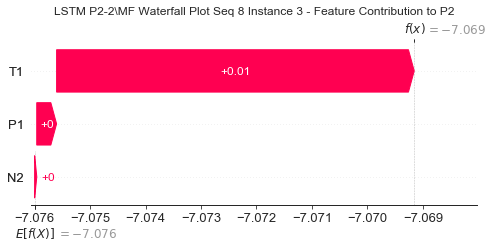

None

Contribution: [3.08471101e-04 2.82137110e-03 8.15967683e-06]


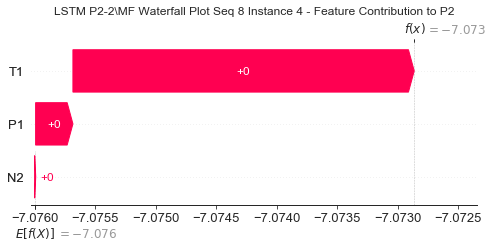

None

Contribution: [ 1.41560169e-05  2.19258509e-04 -3.29028801e-05]


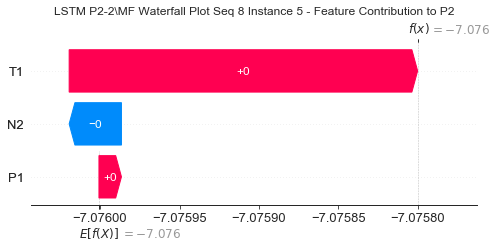

None

Contribution: [ 3.41540888e-06  9.10759507e-05 -2.37343928e-05]


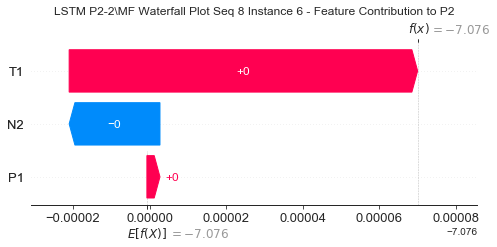

None

Contribution: [-1.19483015e-06  1.00022937e-04 -2.96619221e-05]


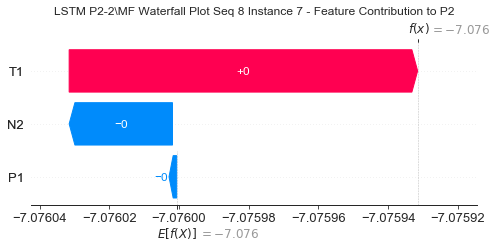

None

Contribution: [-5.92512927e-06  1.12721571e-04 -3.00194328e-05]


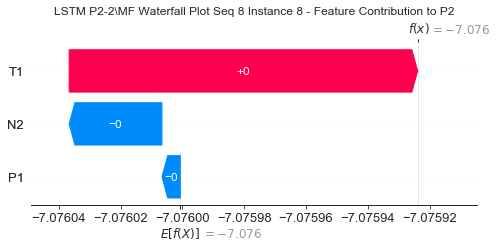

None

Contribution: [-6.60761923e-06  8.18651518e-05 -1.15355950e-05]


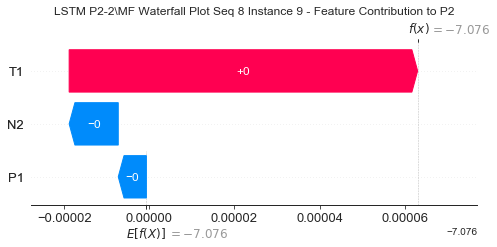

None

Contribution: [-1.20786305e-05  8.38037387e-06 -4.59513203e-06]


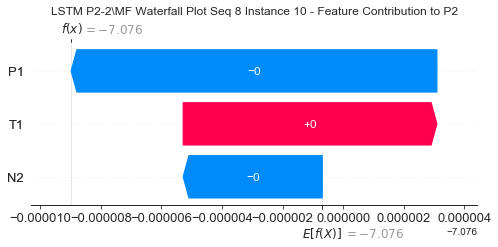

None

Contribution: [-2.43472754e-05 -1.16079770e-05 -1.66627926e-05]


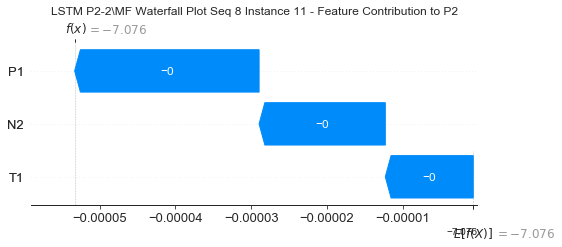

None

Contribution: [-1.76623492e-05  3.91165383e-05 -1.88512221e-05]


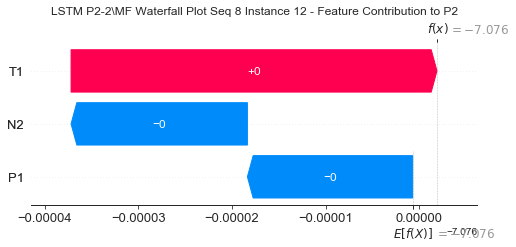

None

Contribution: [-3.70973240e-05  7.62826544e-05 -1.76248421e-05]


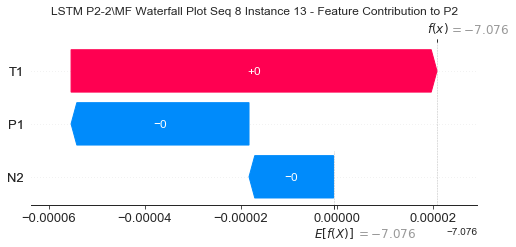

None

Contribution: [-3.11373346e-05  1.07018109e-04 -1.32238977e-05]


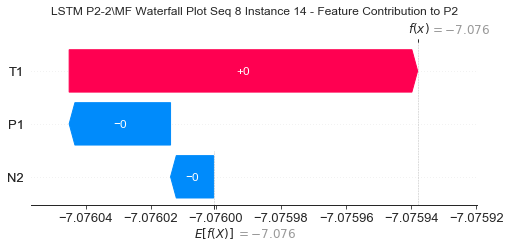

None

Contribution: [-2.99276893e-05  1.17210143e-04 -1.75598602e-05]


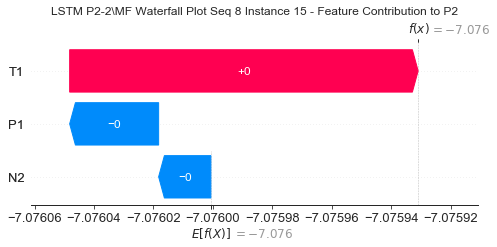

None

Contribution: [-1.75837517e-05  1.18970500e-04 -1.58964394e-05]


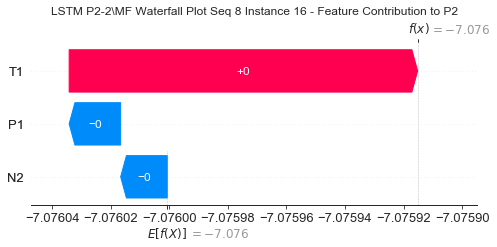

None

Contribution: [-1.08441393e-05  1.08348877e-04 -1.81370656e-05]


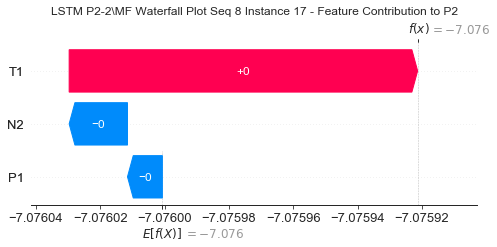

None

Contribution: [-3.19049002e-05  9.82063935e-05 -1.81176059e-05]


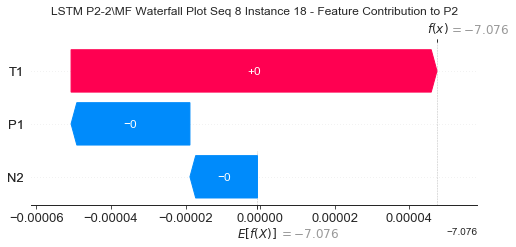

None

Contribution: [-2.89742589e-05  8.46925259e-05 -1.70744173e-05]


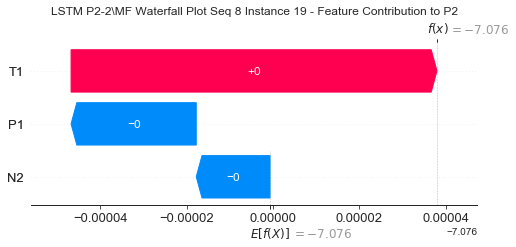

None

Contribution: [-4.45629461e-05  6.59350742e-05 -1.88406967e-05]


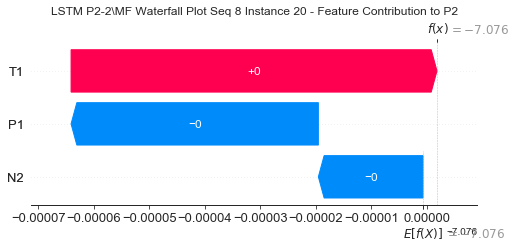

None

Contribution: [-9.88399199e-06 -9.29161069e-05 -2.22802572e-05]


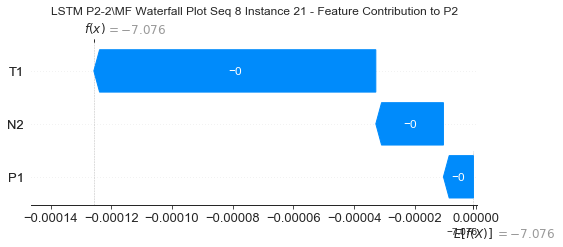

None

Contribution: [ 3.08669199e-05 -1.28306720e-03 -1.19452439e-04]


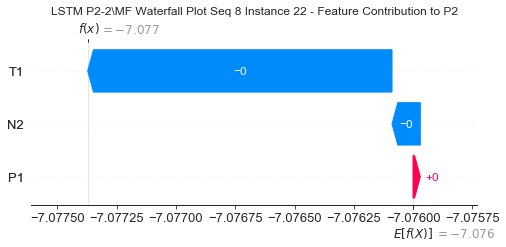

None

Contribution: [-0.00042258  0.00654695 -0.00176004]


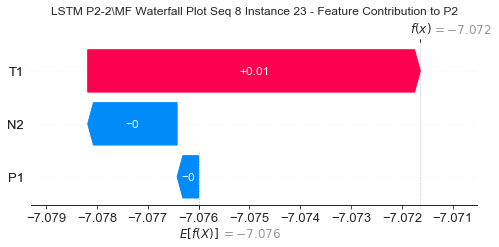

None

Contribution: [-0.00520796  0.05917401 -0.00953159]


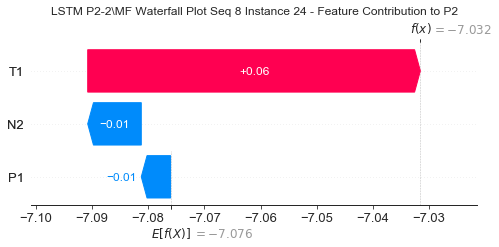

None

Contribution: [ 0.01952806 -0.00228247 -0.0644692 ]


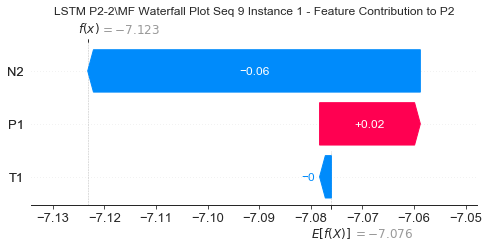

None

Contribution: [-0.00039755  0.00168276  0.00044982]


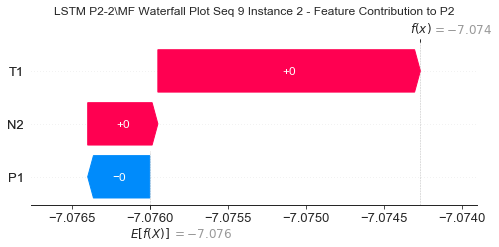

None

Contribution: [ 0.00078481  0.00586721 -0.00029449]


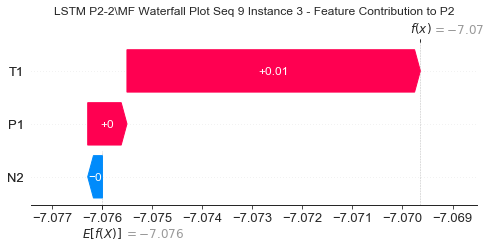

None

Contribution: [ 0.0004469   0.00251948 -0.00014312]


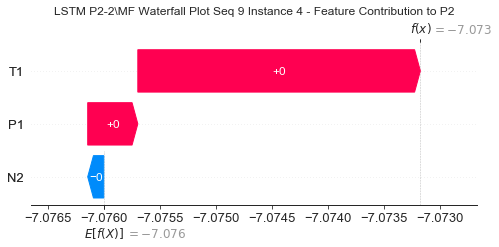

None

Contribution: [ 4.54298381e-05  2.58989344e-04 -3.72565955e-05]


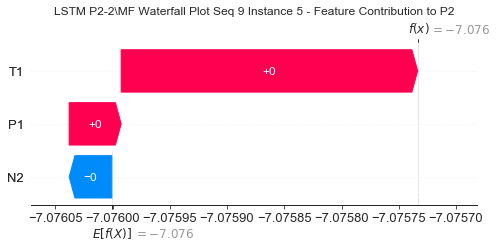

None

Contribution: [ 5.93600916e-06  8.43238794e-05 -2.81093036e-05]


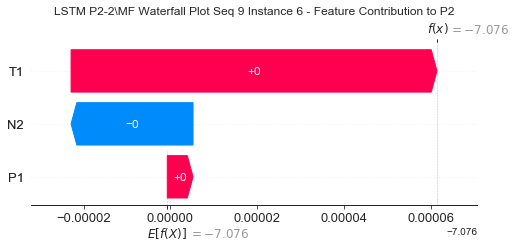

None

Contribution: [-1.09383519e-06  7.73960174e-05 -3.23132091e-05]


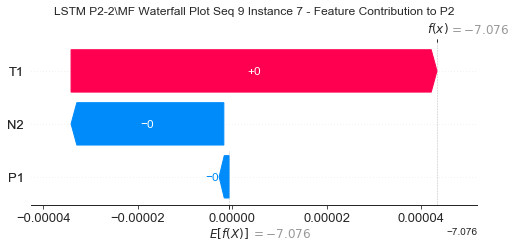

None

Contribution: [-8.46529652e-06  7.42888535e-05 -3.46263154e-05]


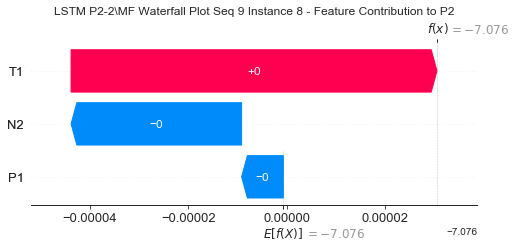

None

Contribution: [-1.51275092e-05  8.01393219e-05 -1.28027317e-05]


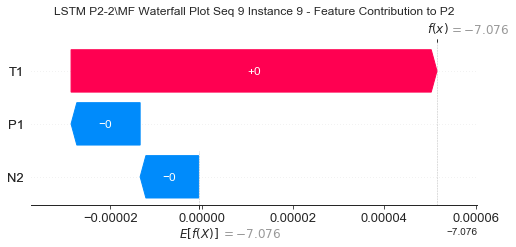

None

Contribution: [-2.11125109e-05  3.63893255e-05 -2.40932735e-06]


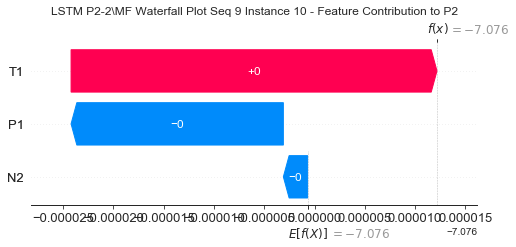

None

Contribution: [-3.57979115e-05  2.97281901e-05 -1.42737191e-05]


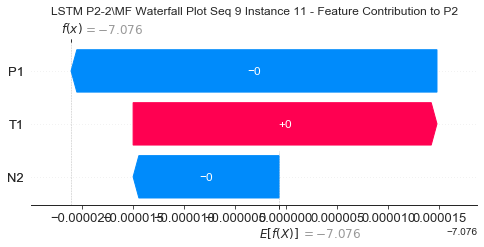

None

Contribution: [-3.19369827e-05  7.11761023e-05 -1.78841874e-05]


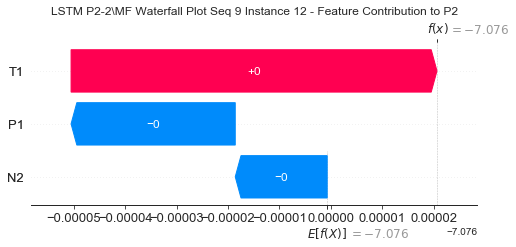

None

Contribution: [-4.56441295e-05  9.49453496e-05 -1.60956646e-05]


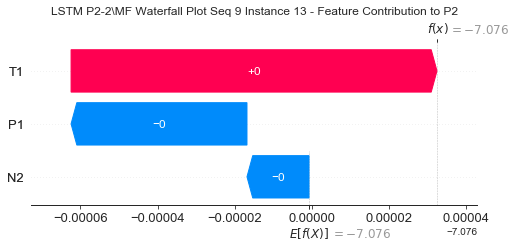

None

Contribution: [-3.95221254e-05  1.17140254e-04 -1.24553045e-05]


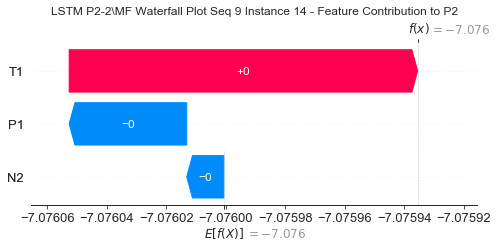

None

Contribution: [-5.30045309e-05  1.14087409e-04 -1.73346684e-05]


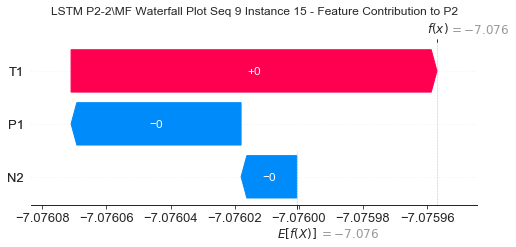

None

Contribution: [-5.91719664e-05  1.08602830e-04 -1.79764344e-05]


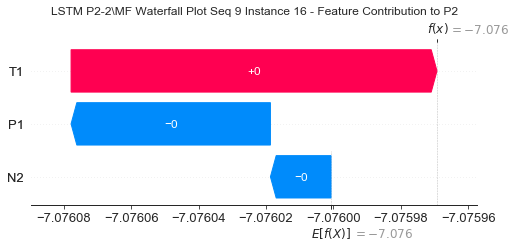

None

Contribution: [-2.61229639e-05  9.19849054e-05 -1.88251259e-05]


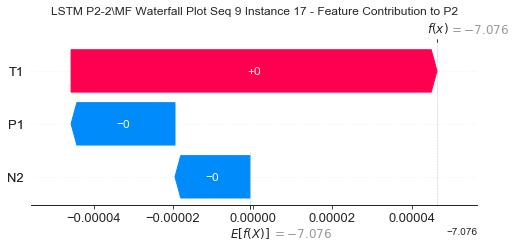

None

Contribution: [-4.90113867e-05  8.68352002e-05 -1.69601265e-05]


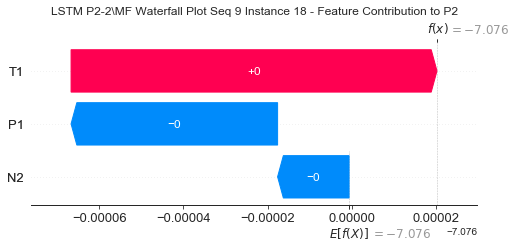

None

Contribution: [-5.54227038e-05  7.44130739e-05 -1.73380018e-05]


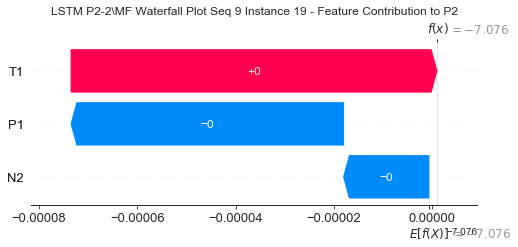

None

Contribution: [-5.40225475e-05  6.24442418e-05 -1.61968756e-05]


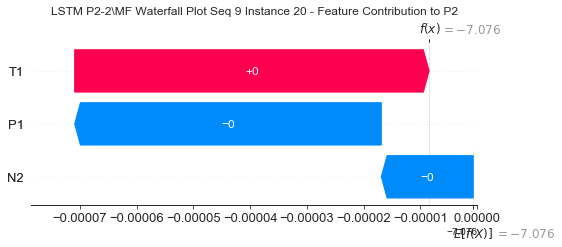

None

Contribution: [-5.43984733e-05 -4.02486313e-05 -2.03927881e-05]


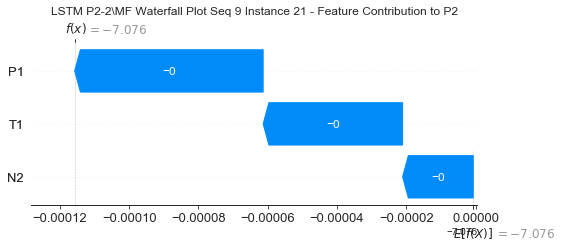

None

Contribution: [ 7.66690906e-06 -9.66091739e-04 -1.33123745e-04]


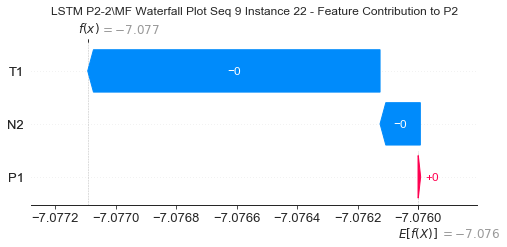

None

Contribution: [-0.00027071  0.00283551 -0.00168305]


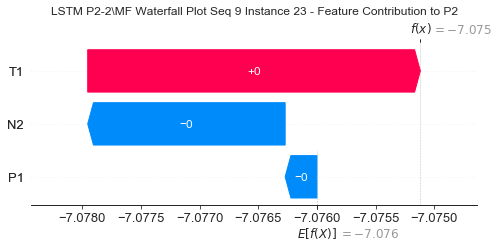

None

Contribution: [-0.0011464   0.03144053 -0.01410948]


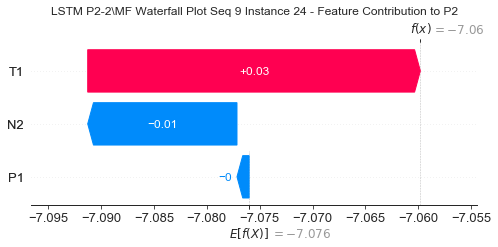

None

Contribution: [ 0.03441726 -0.00374659 -0.06484975]


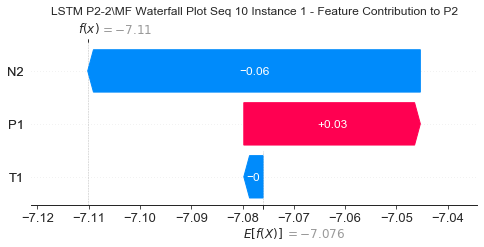

None

Contribution: [-0.0004606   0.00065216  0.00042625]


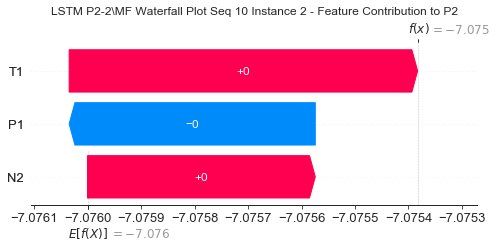

None

Contribution: [ 0.00025447  0.00398434 -0.00011064]


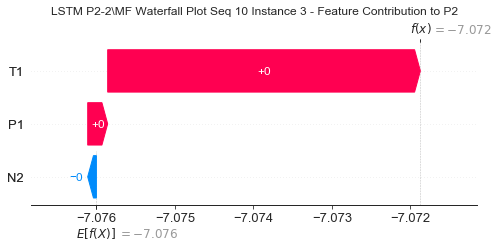

None

Contribution: [ 1.83556553e-04  1.89679800e-03 -7.84434785e-05]


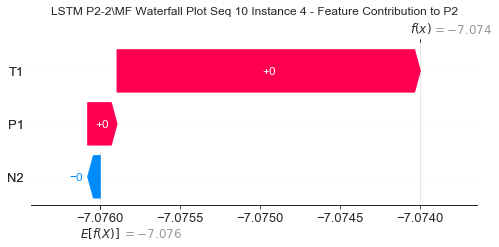

None

Contribution: [ 1.37637170e-05  1.76740225e-04 -3.69240265e-05]


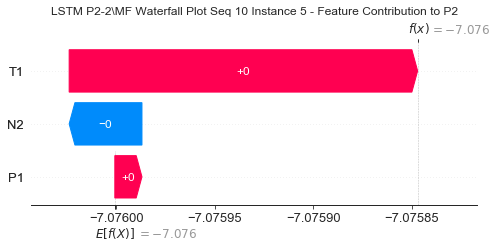

None

Contribution: [-8.05635523e-08  7.21154829e-05 -2.61488877e-05]


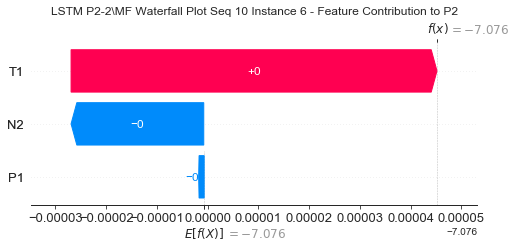

None

Contribution: [-5.37453310e-09  8.57129778e-05 -2.94662650e-05]


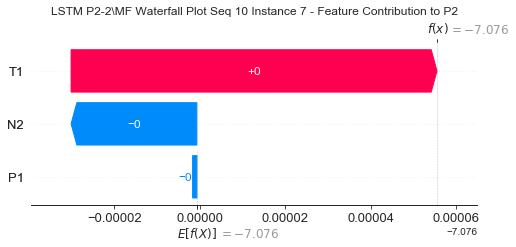

None

Contribution: [-1.40403572e-05  8.78024576e-05 -3.45760488e-05]


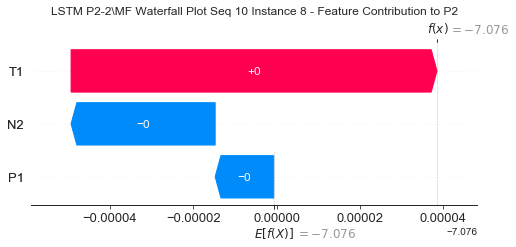

None

Contribution: [-1.43097249e-05  8.24416806e-05 -1.21350820e-05]


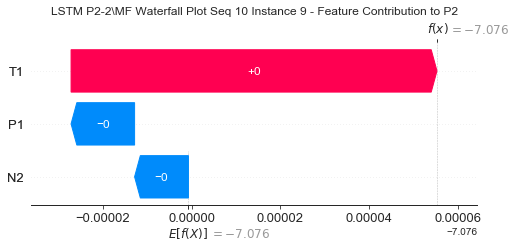

None

Contribution: [-2.80846873e-05  4.12113778e-05 -3.40865807e-06]


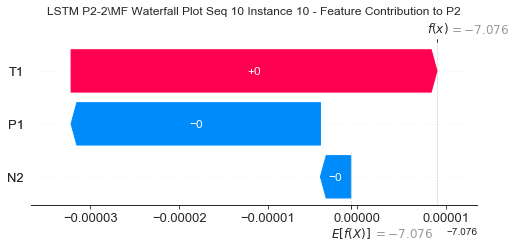

None

Contribution: [-4.36726504e-05  3.37825772e-05 -1.48612501e-05]


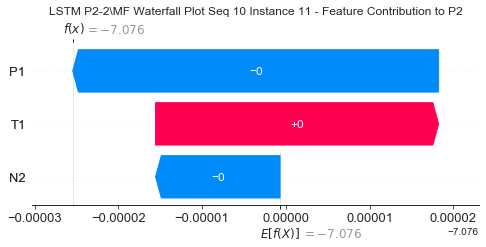

None

Contribution: [-4.21403600e-05  7.47800488e-05 -1.64629887e-05]


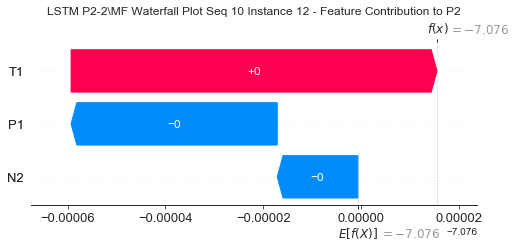

None

Contribution: [-5.46396571e-05  9.81735849e-05 -1.64041054e-05]


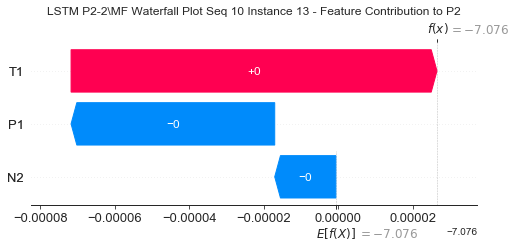

None

Contribution: [-3.86808655e-05  1.13188399e-04 -1.40273628e-05]


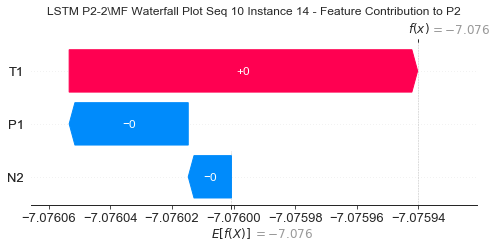

None

Contribution: [-5.59714577e-05  1.21896883e-04 -1.56886585e-05]


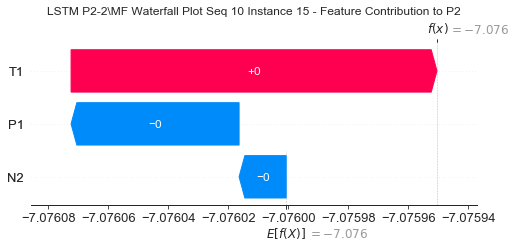

None

Contribution: [-5.90688571e-05  1.17845635e-04 -1.66247720e-05]


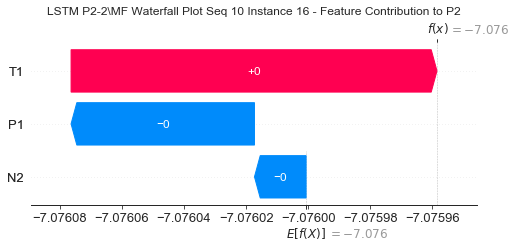

None

Contribution: [-4.42606246e-05  1.07935891e-04 -1.75092468e-05]


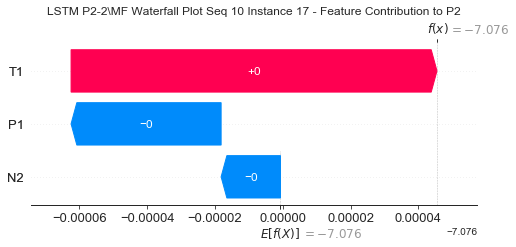

None

Contribution: [-6.05312244e-05  9.54596410e-05 -1.73172661e-05]


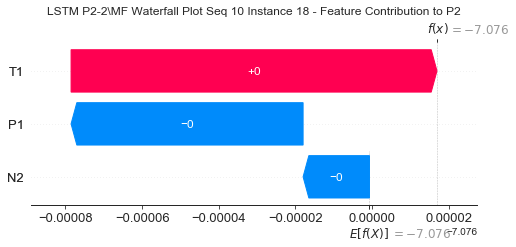

None

Contribution: [-6.41556609e-05  8.39255065e-05 -1.70056439e-05]


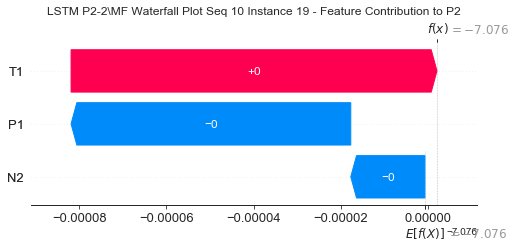

None

Contribution: [-6.73940093e-05  7.10059499e-05 -1.65713972e-05]


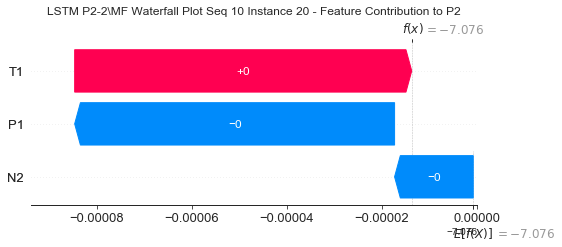

None

Contribution: [-5.92136589e-05 -5.18759376e-05 -1.88176995e-05]


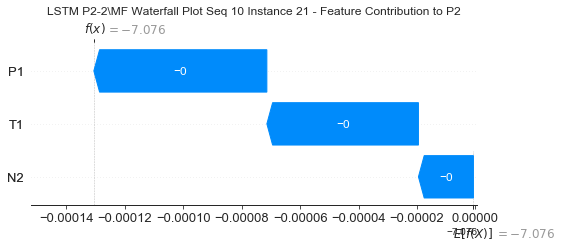

None

Contribution: [-3.65791717e-05 -1.11106670e-03 -1.20822112e-04]


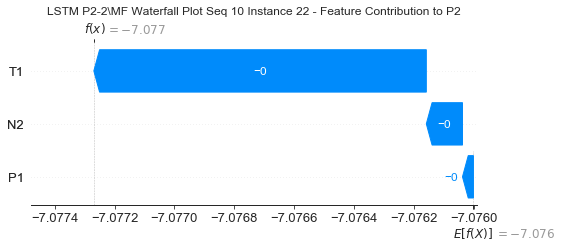

None

Contribution: [ 5.99128415e-06  3.89541664e-03 -1.88080337e-03]


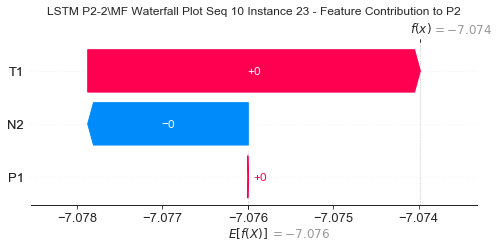

None

Contribution: [ 0.00043647  0.03836565 -0.01505203]


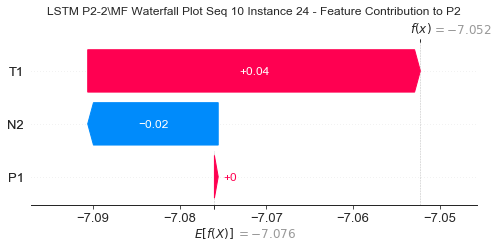

None

Contribution: [-0.01173309 -0.01077398 -0.08077553]


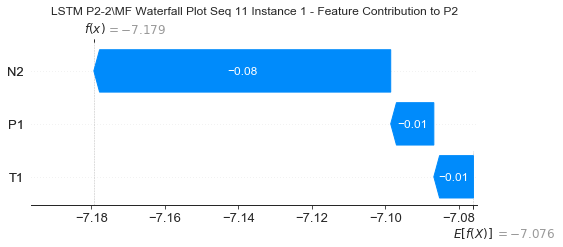

None

Contribution: [ 4.02722504e-05 -7.43585849e-05  4.97515492e-04]


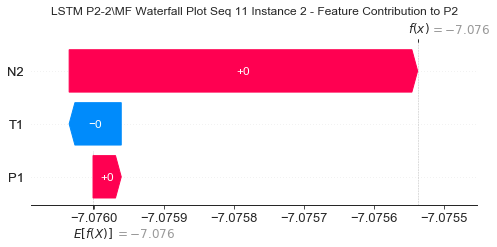

None

Contribution: [-0.0002911   0.00354249 -0.00028217]


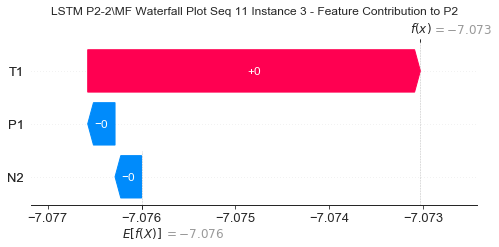

None

Contribution: [-0.00018342  0.00201018 -0.00017846]


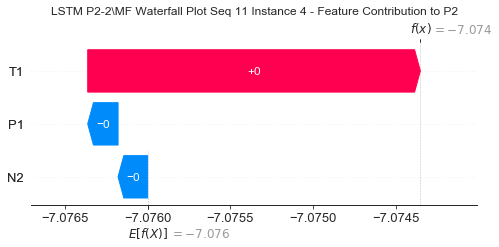

None

Contribution: [-2.00354496e-05  1.57706843e-04 -4.42266773e-05]


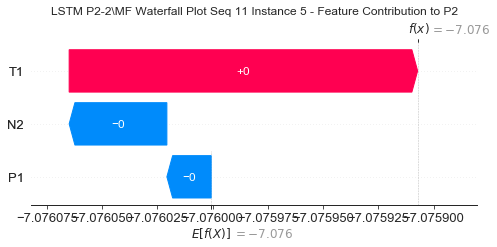

None

Contribution: [-1.15943062e-05  8.24964847e-05 -3.02716184e-05]


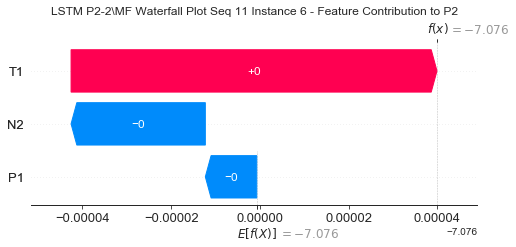

None

Contribution: [-1.37691640e-05  7.08225300e-05 -3.86258432e-05]


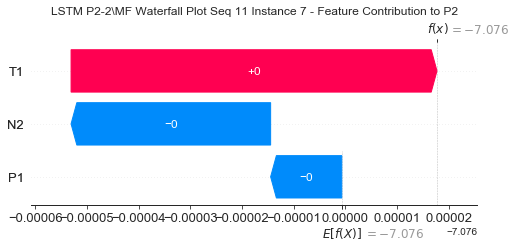

None

Contribution: [-2.06141629e-05  8.14534236e-05 -4.08620425e-05]


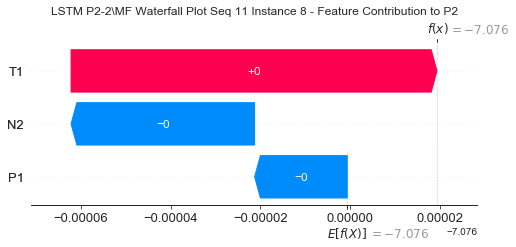

None

Contribution: [-3.34119008e-05  7.18950712e-05 -1.99916400e-05]


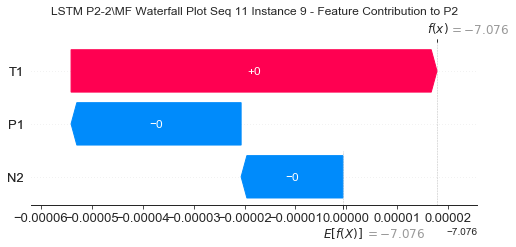

None

Contribution: [-4.55505668e-05  3.77161594e-05 -2.00394717e-06]


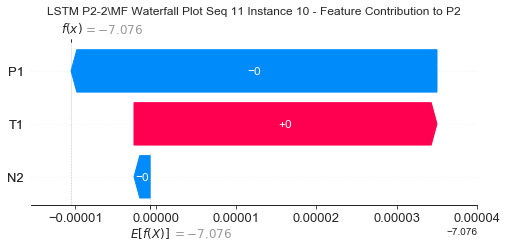

None

Contribution: [-6.83744279e-05  4.73381963e-06 -1.51229564e-05]


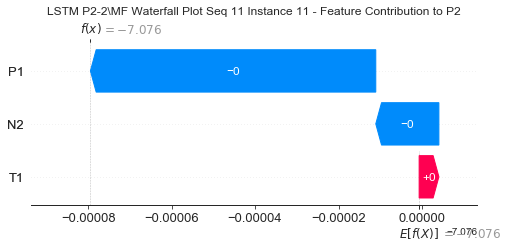

None

Contribution: [-5.84795237e-05  5.16865980e-05 -1.56908213e-05]


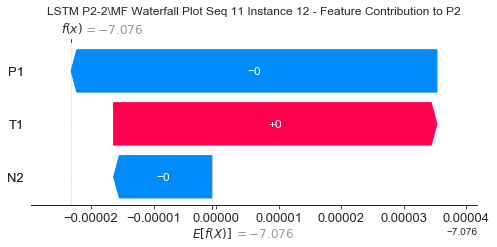

None

Contribution: [-7.61277436e-05  9.10153841e-05 -2.07767040e-05]


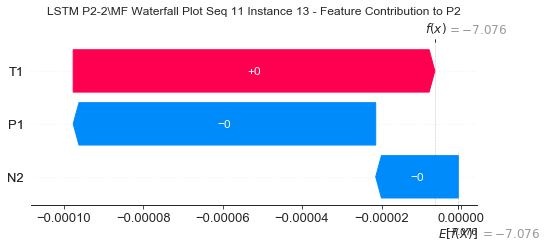

None

Contribution: [-5.72533095e-05  1.32000812e-04 -1.43866858e-05]


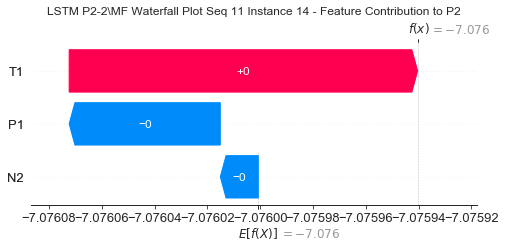

None

Contribution: [-7.54040390e-05  1.15877684e-04 -1.93883965e-05]


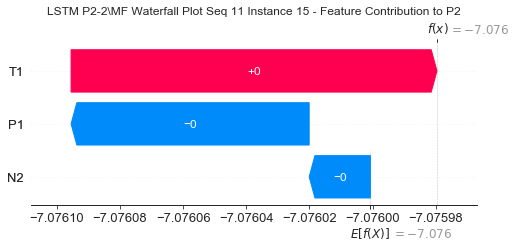

None

Contribution: [-7.88578365e-05  1.05333113e-04 -1.86161015e-05]


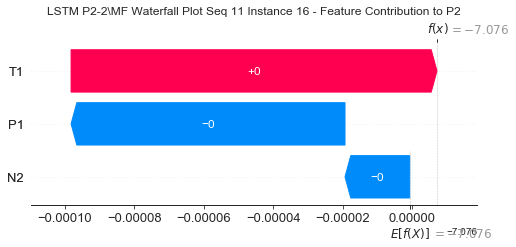

None

Contribution: [-7.85685324e-05  7.25985654e-05 -2.39799218e-05]


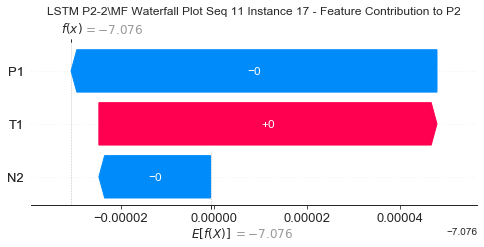

None

Contribution: [-8.57590279e-05  5.05034841e-05 -2.06605588e-05]


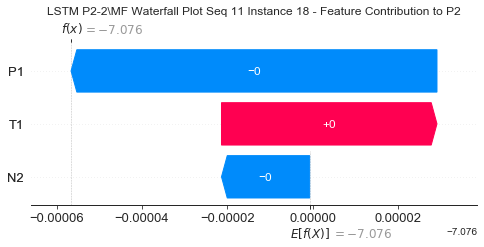

None

Contribution: [-8.89622535e-05  3.42063784e-05 -2.01574514e-05]


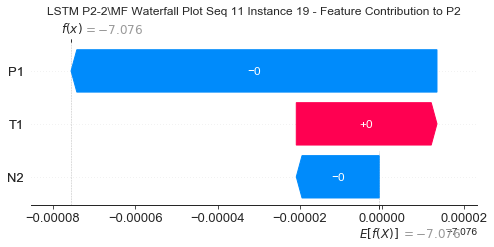

None

Contribution: [-8.98090013e-05  2.04029164e-05 -2.05798713e-05]


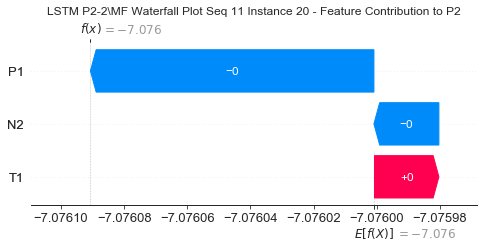

None

Contribution: [-7.98006630e-05 -1.01839400e-04 -2.17723873e-05]


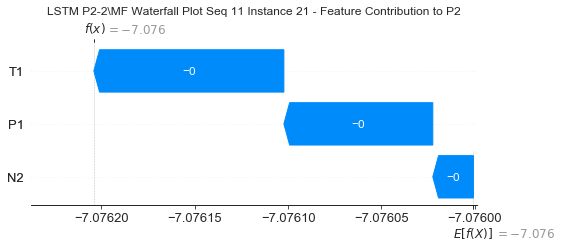

None

Contribution: [-8.84254706e-05 -1.30742117e-03 -1.41696997e-04]


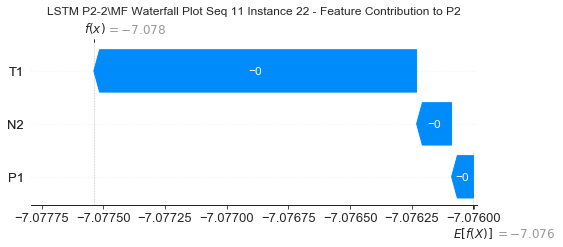

None

Contribution: [ 0.00046951  0.00250448 -0.00214466]


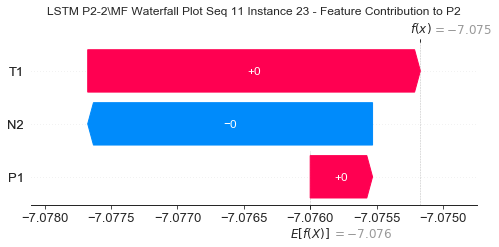

None

Contribution: [ 0.00326724  0.02658432 -0.01644825]


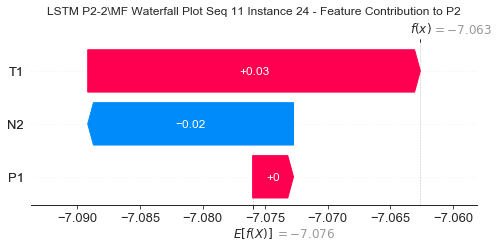

None

Contribution: [-0.03144467 -0.01654604 -0.0855428 ]


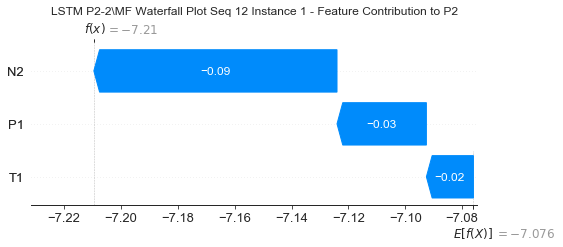

None

Contribution: [ 0.00011082 -0.00060994  0.00055826]


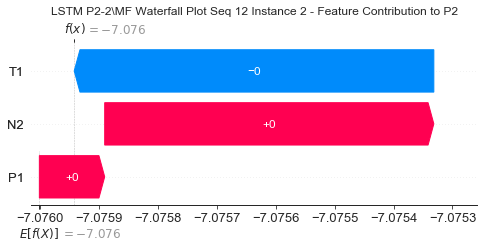

None

Contribution: [-0.00025421  0.00077846 -0.00035525]


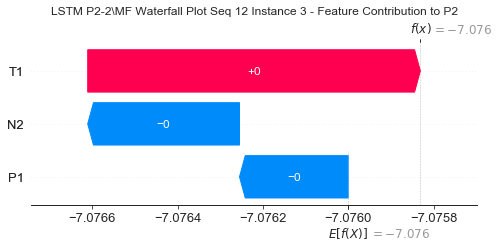

None

Contribution: [-0.00021554  0.00029761 -0.00022868]


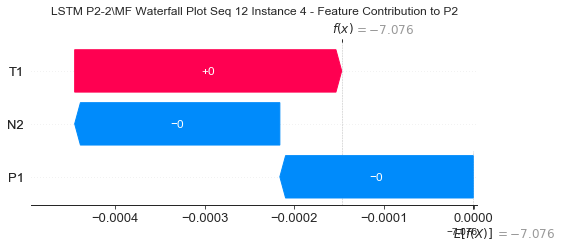

None

Contribution: [-8.35015665e-06  1.08085985e-05 -4.59888139e-05]


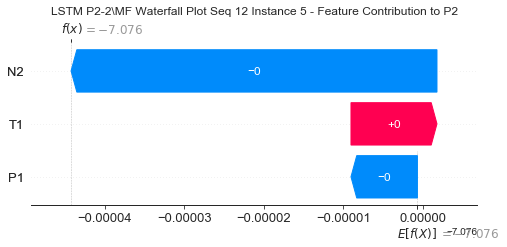

None

Contribution: [-1.22897444e-05  9.29228506e-06 -3.05764297e-05]


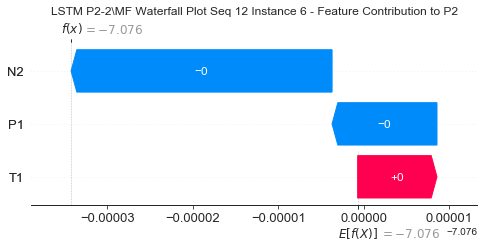

None

Contribution: [-1.78513241e-05  1.14948255e-05 -3.90559980e-05]


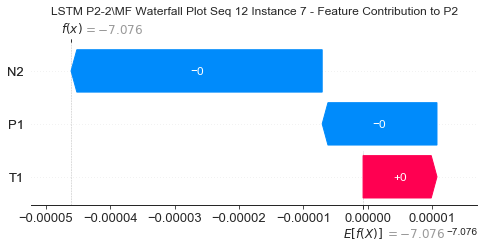

None

Contribution: [-2.26674629e-05  1.67784910e-05 -3.98191939e-05]


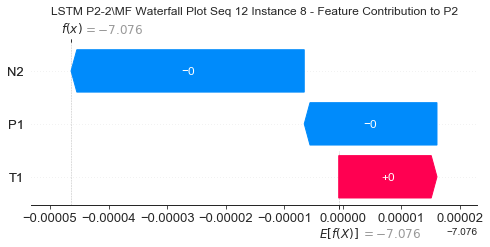

None

Contribution: [-3.78256591e-05  3.06800626e-06 -1.73105124e-05]


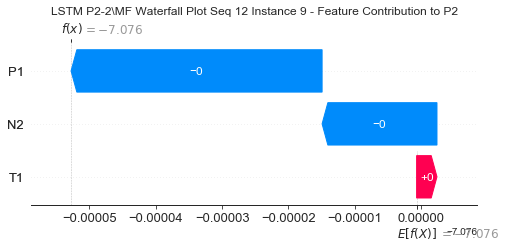

None

Contribution: [-5.96699658e-05 -3.12210512e-05 -3.83235546e-06]


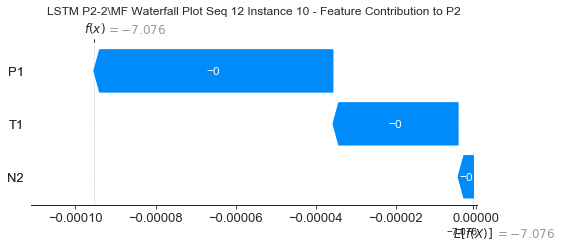

None

Contribution: [-8.45987501e-05 -6.40249106e-05 -1.40930506e-05]


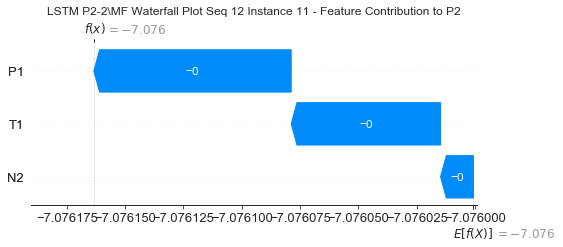

None

Contribution: [-7.47418678e-05 -7.64889009e-05 -2.21493073e-05]


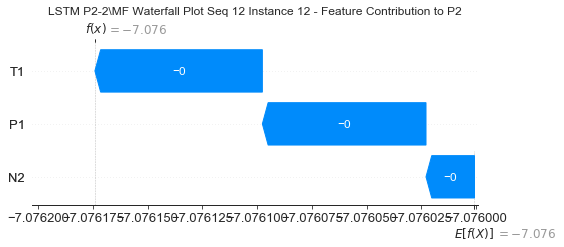

None

Contribution: [-9.48709220e-05 -8.10932051e-05 -1.91246472e-05]


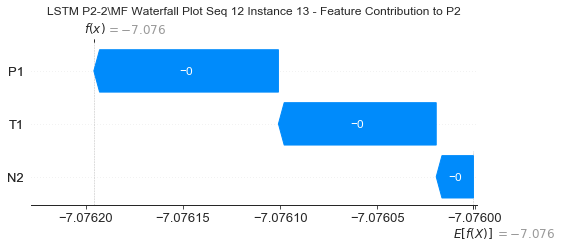

None

Contribution: [-9.64798693e-05 -9.49895921e-05 -1.81916256e-05]


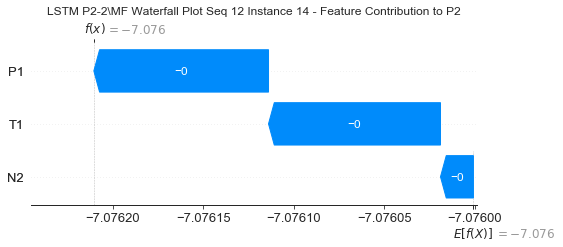

None

Contribution: [-9.90034792e-05 -1.21973066e-04 -2.05126337e-05]


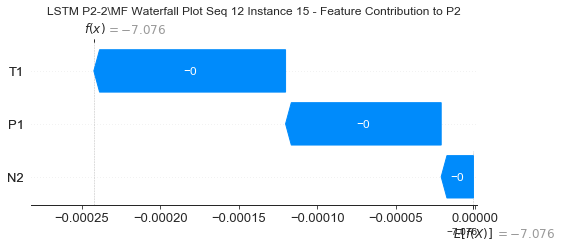

None

Contribution: [-1.00413588e-04 -1.34730725e-04 -2.32824549e-05]


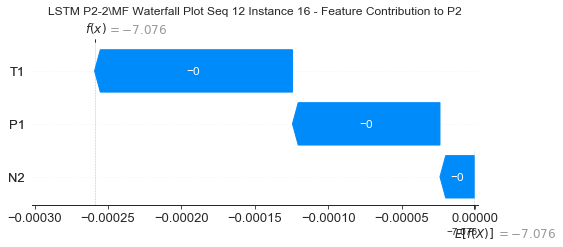

None

Contribution: [-8.37899065e-05 -1.60597107e-04 -2.56289399e-05]


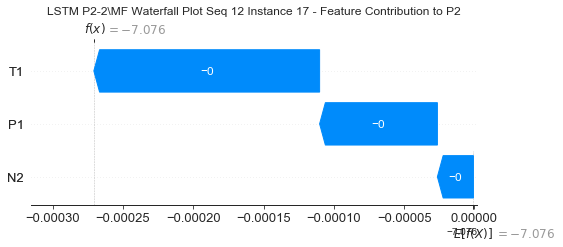

None

Contribution: [-1.05522481e-04 -1.73723216e-04 -2.51169452e-05]


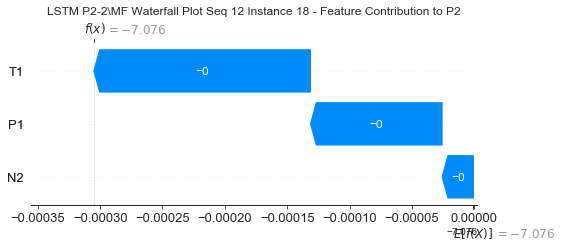

None

Contribution: [-1.07036244e-04 -1.89675896e-04 -2.48087137e-05]


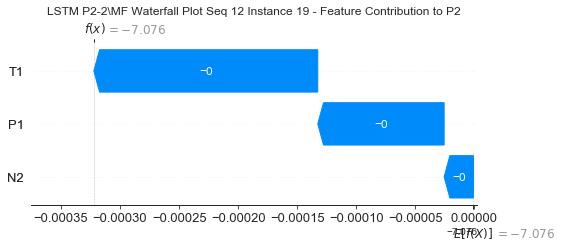

None

Contribution: [-1.06685158e-04 -1.96218987e-04 -2.46358692e-05]


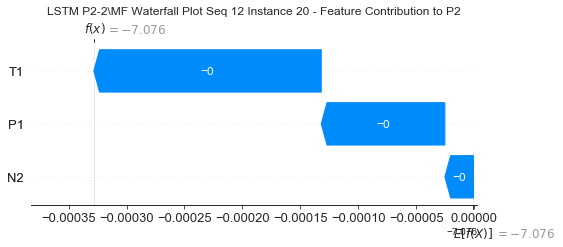

None

Contribution: [-1.02944766e-04 -2.52831199e-04 -2.77785781e-05]


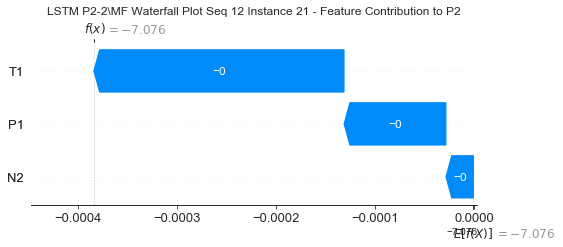

None

Contribution: [-0.00013843 -0.00104794 -0.00016287]


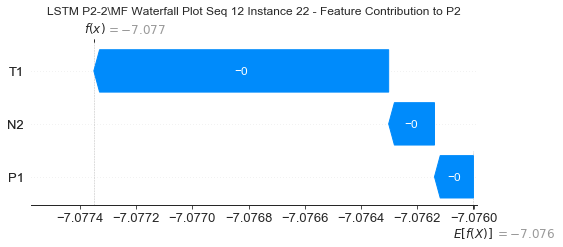

None

Contribution: [ 0.00043746  0.00195019 -0.00200484]


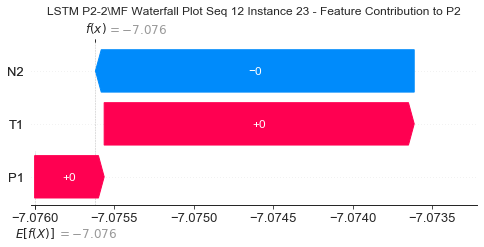

None

Contribution: [ 0.00294984  0.01728969 -0.01575926]


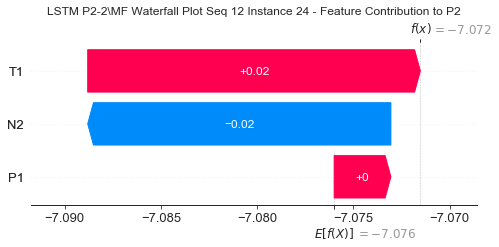

None

Contribution: [-0.03326103 -0.01231858 -0.0799099 ]


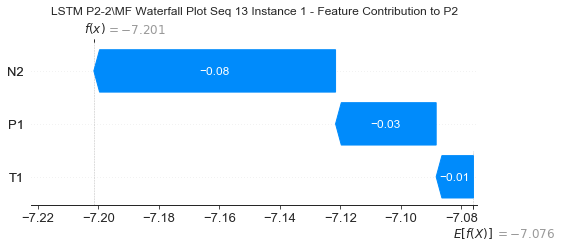

None

Contribution: [ 0.0002816  -0.00062005  0.00053245]


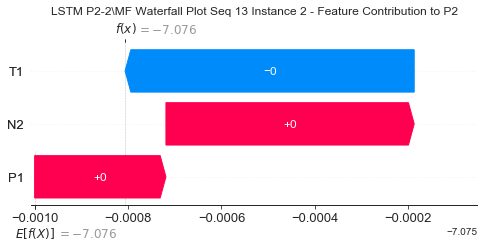

None

Contribution: [-0.00019603  0.00063227 -0.00031183]


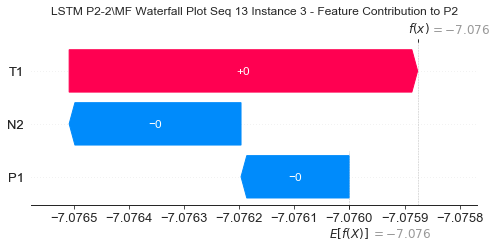

None

Contribution: [-0.00018587  0.00027286 -0.00022253]


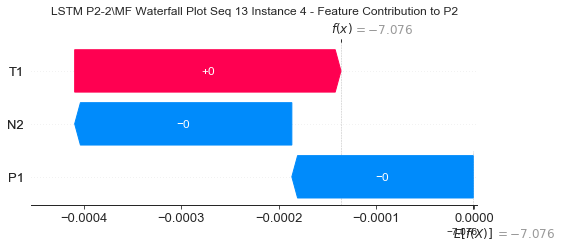

None

Contribution: [-1.64432703e-05  3.63981492e-06 -4.67275146e-05]


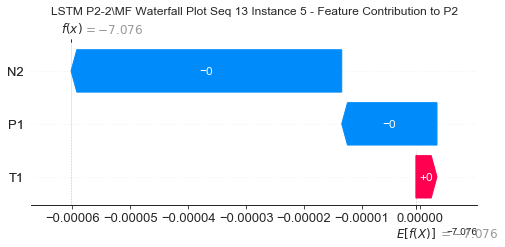

None

Contribution: [-1.08605757e-05  8.45365900e-06 -3.05121508e-05]


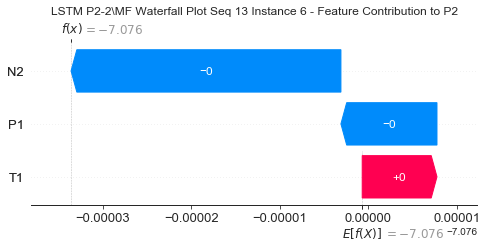

None

Contribution: [-1.24948764e-05  1.67538561e-05 -3.55740222e-05]


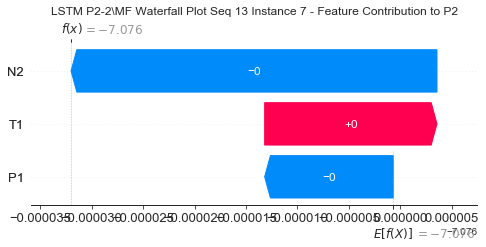

None

Contribution: [-1.95286771e-05  2.17885234e-05 -3.82696486e-05]


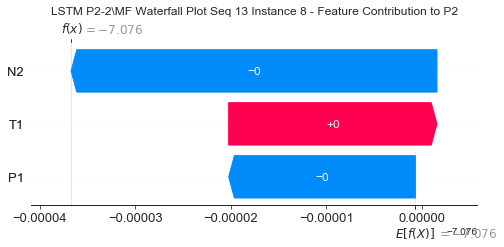

None

Contribution: [-3.35142406e-05  1.77770580e-06 -1.64505096e-05]


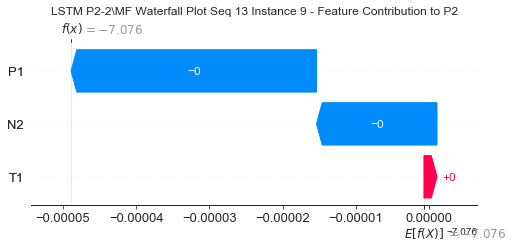

None

Contribution: [-6.00729799e-05 -4.36595514e-05 -3.65692509e-06]


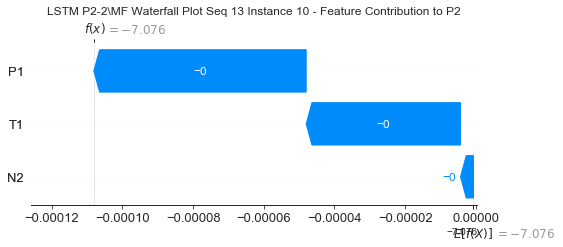

None

Contribution: [-8.09765829e-05 -8.29826580e-05 -1.36067098e-05]


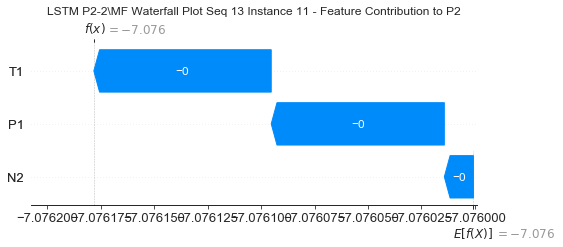

None

Contribution: [-9.00412753e-05 -9.31212643e-05 -2.06199782e-05]


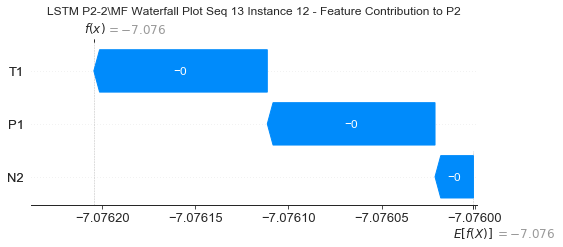

None

Contribution: [-9.30003228e-05 -9.74696674e-05 -1.91536023e-05]


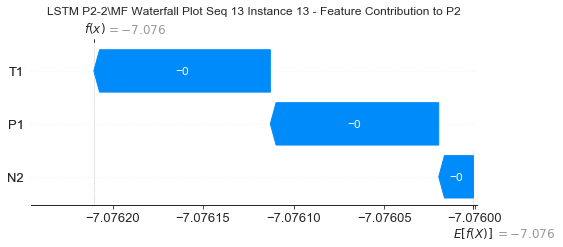

None

Contribution: [-7.32945780e-05 -1.16412063e-04 -1.70430618e-05]


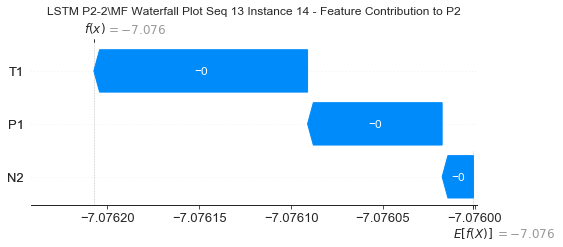

None

Contribution: [-9.24646787e-05 -1.41927241e-04 -1.96257166e-05]


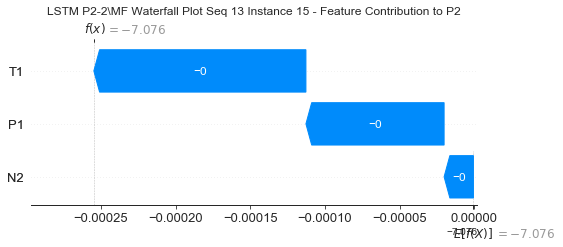

None

Contribution: [-9.36150915e-05 -1.57689549e-04 -2.09517963e-05]


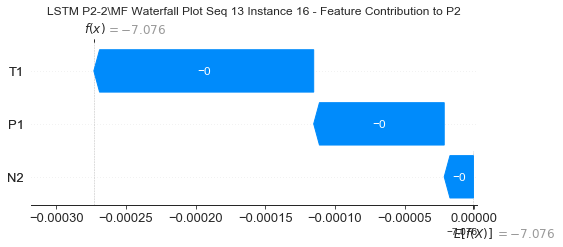

None

Contribution: [-8.52923773e-05 -1.68119874e-04 -2.39740001e-05]


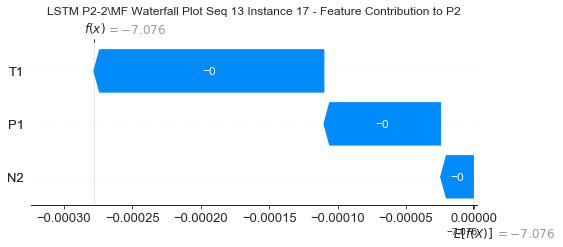

None

Contribution: [-8.84322380e-05 -1.95933476e-04 -2.23955953e-05]


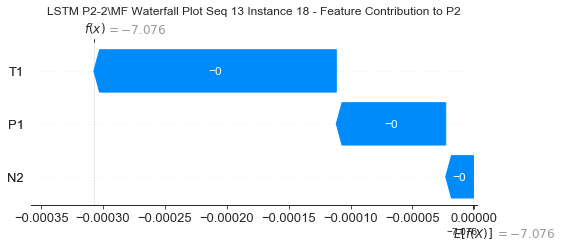

None

Contribution: [-9.18885793e-05 -2.13621490e-04 -2.19811720e-05]


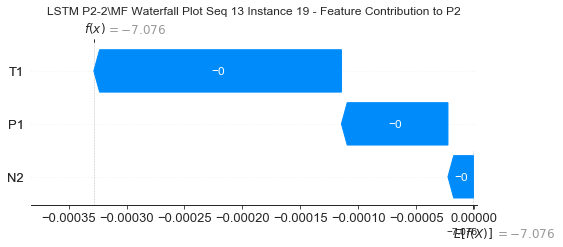

None

Contribution: [-9.42677177e-05 -2.18912577e-04 -2.14366472e-05]


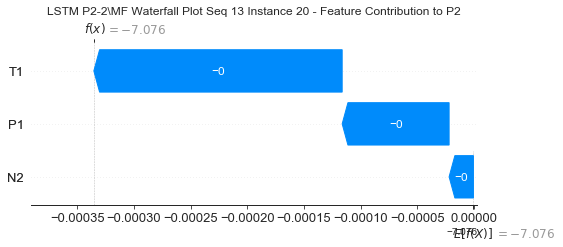

None

Contribution: [-9.62722947e-05 -2.97150021e-04 -1.89643004e-05]


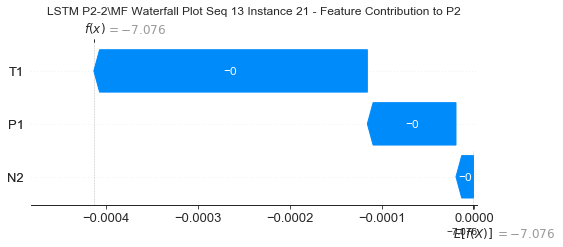

None

Contribution: [-0.00011313 -0.00116682 -0.00011766]


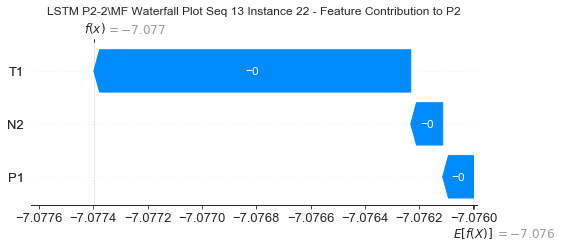

None

Contribution: [ 0.0001487   0.00185537 -0.0020786 ]


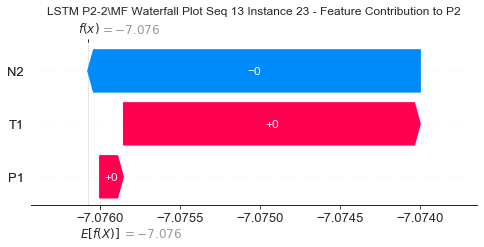

None

Contribution: [ 0.00134901  0.02374574 -0.01587555]


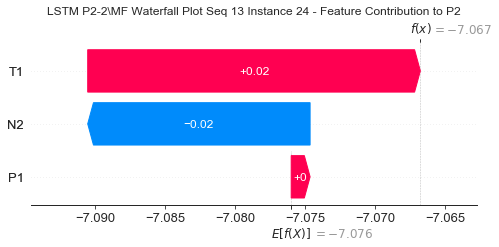

None

Contribution: [-0.01852541 -0.01256633 -0.08089575]


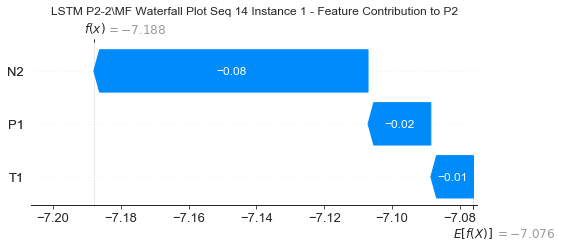

None

Contribution: [-0.0001005  -0.00056023  0.00048926]


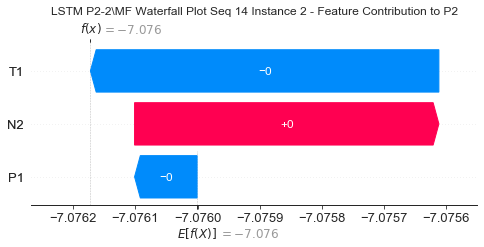

None

Contribution: [-0.0001942   0.00110546 -0.00038229]


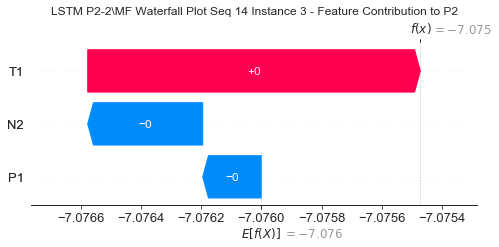

None

Contribution: [-0.00014264  0.0004652  -0.00023715]


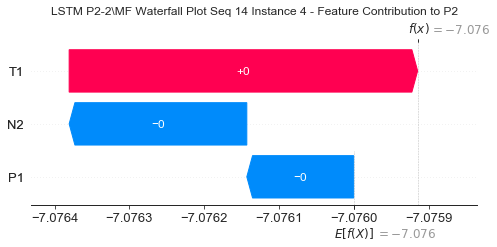

None

Contribution: [-8.20842552e-06  7.18191511e-05 -4.46712103e-05]


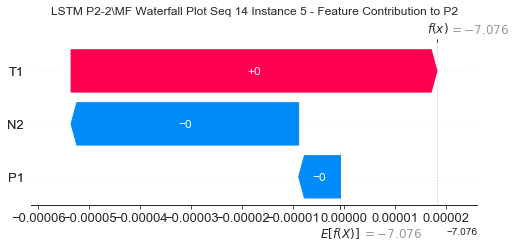

None

Contribution: [-9.96343135e-06  1.81942443e-05 -3.11015952e-05]


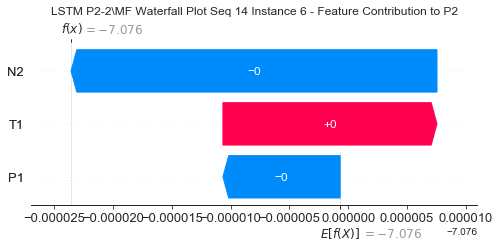

None

Contribution: [-1.24726860e-05  2.17520428e-05 -3.65753429e-05]


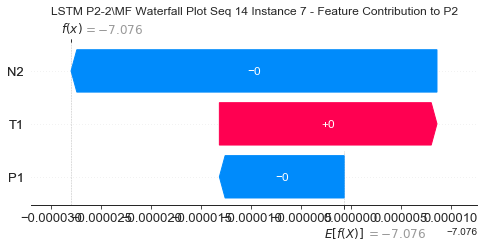

None

Contribution: [-1.88045074e-05  1.71394061e-05 -3.88163203e-05]


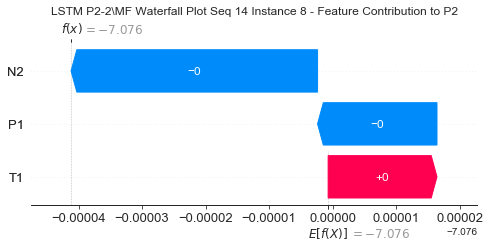

None

Contribution: [-3.22825845e-05  1.12298756e-05 -1.62541030e-05]


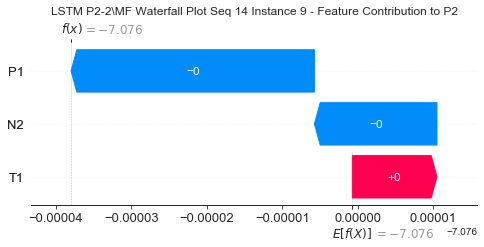

None

Contribution: [-4.88746327e-05 -1.51254243e-05 -2.69066093e-06]


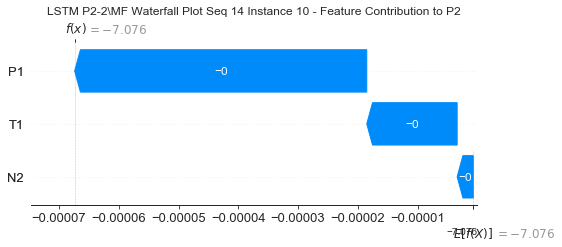

None

Contribution: [-6.80394807e-05 -4.16048229e-05 -1.35855155e-05]


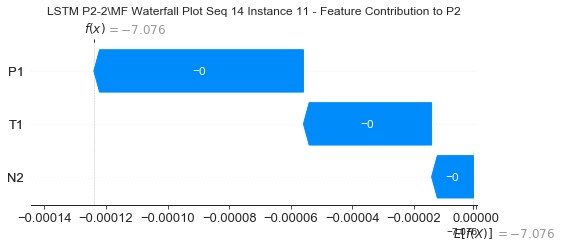

None

Contribution: [-6.82638674e-05 -4.33379442e-05 -1.94033998e-05]


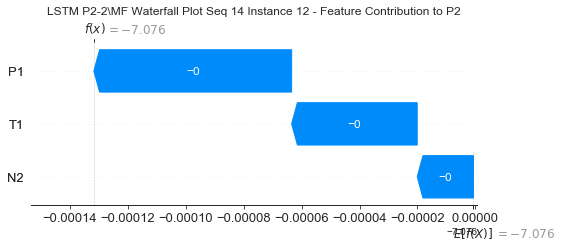

None

Contribution: [-7.60986964e-05 -4.62703335e-05 -1.81876275e-05]


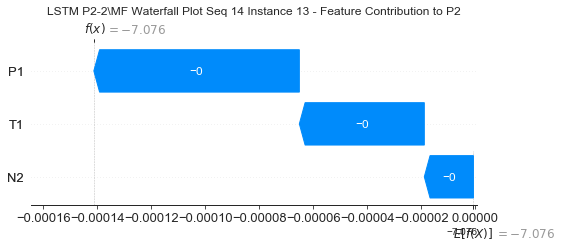

None

Contribution: [-5.46087603e-05 -5.75370280e-05 -1.53860894e-05]


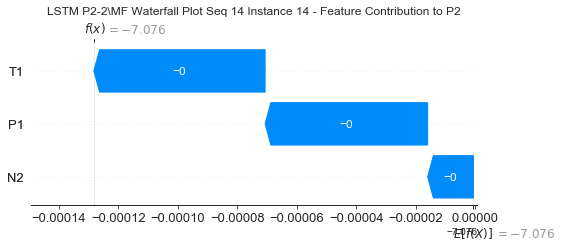

None

Contribution: [-7.45654002e-05 -7.79073380e-05 -1.89694453e-05]


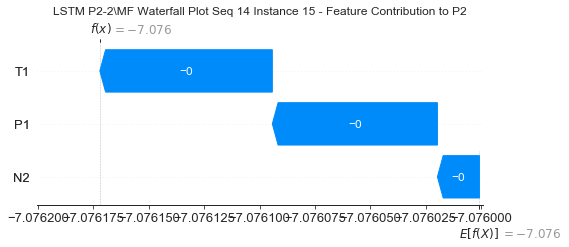

None

Contribution: [-7.66880574e-05 -8.85565204e-05 -2.08730390e-05]


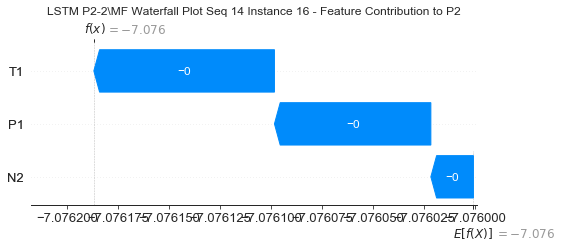

None

Contribution: [-6.64121231e-05 -1.09896151e-04 -1.99242500e-05]


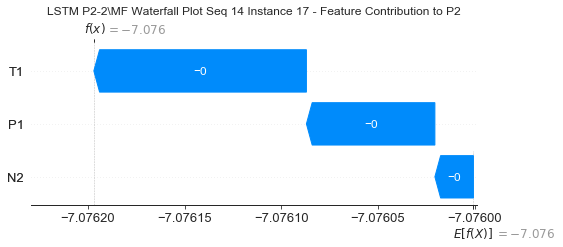

None

Contribution: [-8.00596101e-05 -1.22772552e-04 -2.22588421e-05]


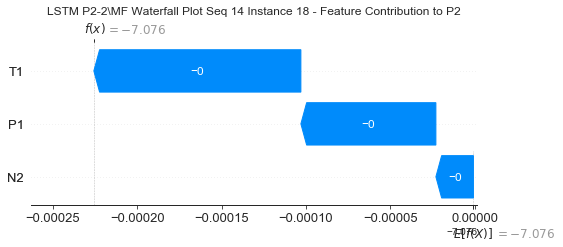

None

Contribution: [-8.26282681e-05 -1.35757672e-04 -2.07733619e-05]


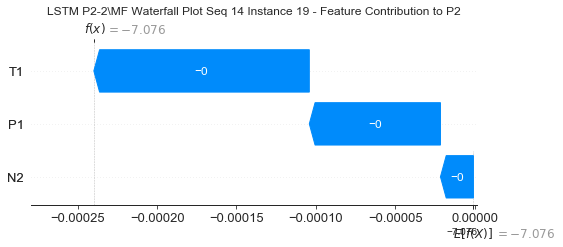

None

Contribution: [-8.49944505e-05 -1.39730007e-04 -1.98190469e-05]


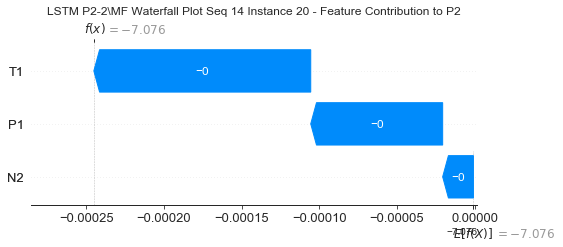

None

Contribution: [-7.67354068e-05 -1.82152115e-04 -1.80391191e-05]


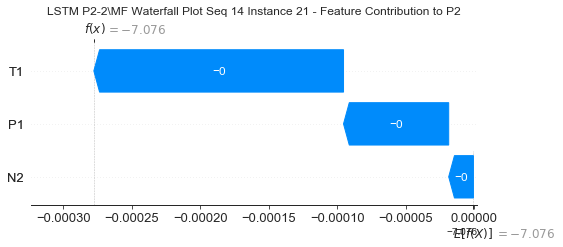

None

Contribution: [-7.37158683e-05 -7.62873747e-04 -9.07171065e-05]


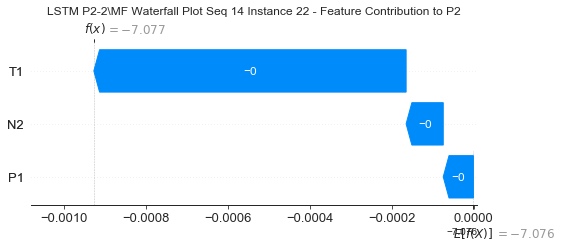

None

Contribution: [ 0.00032953  0.00058189 -0.00219655]


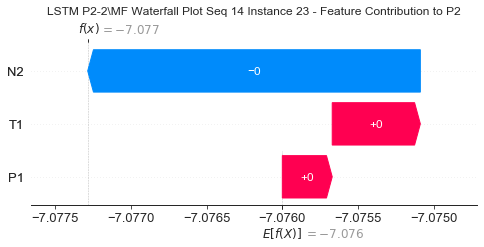

None

Contribution: [ 0.00182401  0.00770619 -0.01573576]


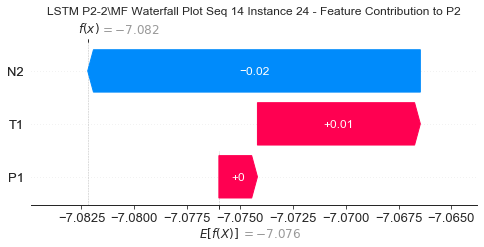

None

Contribution: [-0.02304666 -0.00869147 -0.08102384]


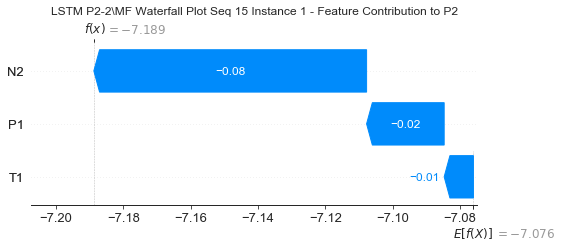

None

Contribution: [ 8.34165944e-05 -5.84204472e-04  5.25688465e-04]


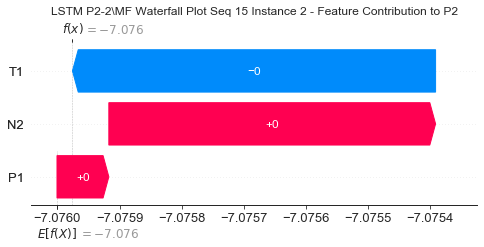

None

Contribution: [-9.89242912e-05 -1.55327858e-04 -2.89823568e-04]


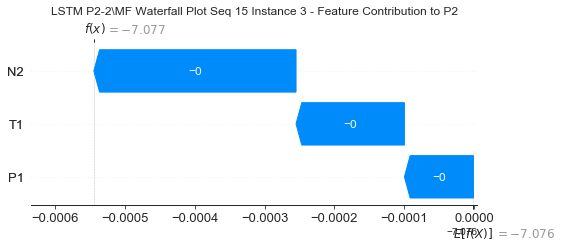

None

Contribution: [-8.81130226e-05 -9.04661383e-05 -2.12525865e-04]


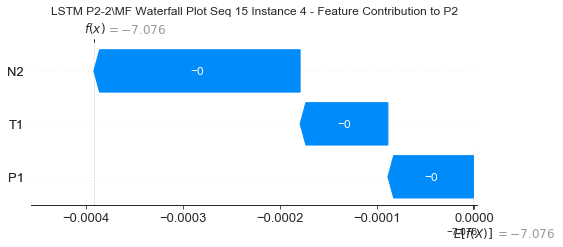

None

Contribution: [-1.00400110e-05 -3.05903368e-05 -4.56409707e-05]


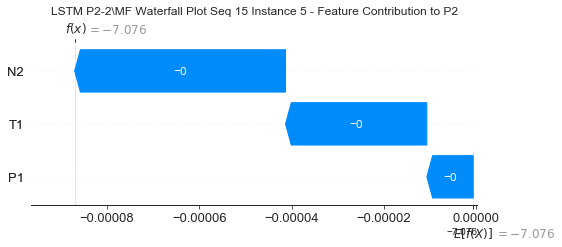

None

Contribution: [-8.56588773e-06 -4.31816751e-06 -2.94962978e-05]


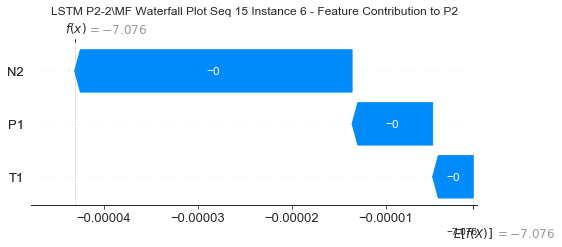

None

Contribution: [-1.16592586e-05  2.99115173e-06 -3.49050881e-05]


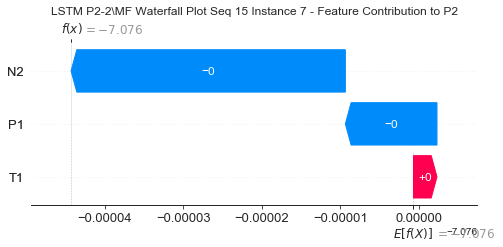

None

Contribution: [-2.02816971e-05  3.44547215e-06 -3.84570480e-05]


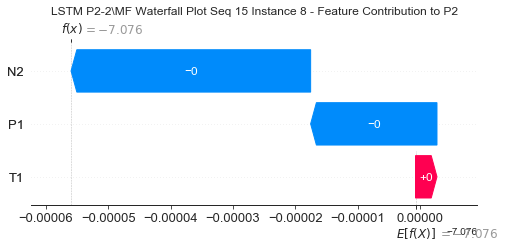

None

Contribution: [-3.14501995e-05 -4.70217668e-06 -1.56239024e-05]


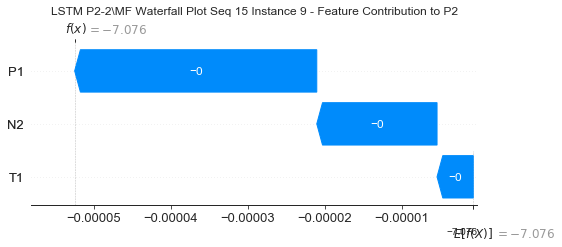

None

Contribution: [-4.97418872e-05 -3.23802996e-05 -2.86892624e-06]


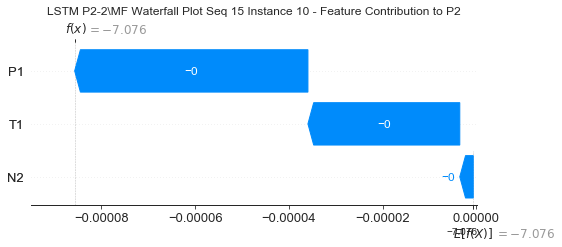

None

Contribution: [-6.75176935e-05 -6.53631085e-05 -1.39753221e-05]


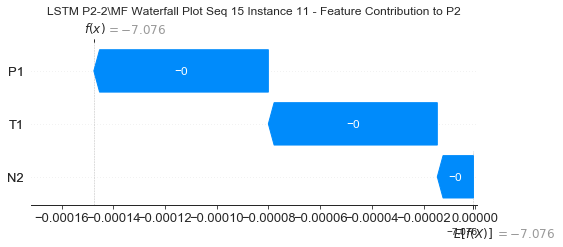

None

Contribution: [-7.33996320e-05 -7.81931496e-05 -2.01141649e-05]


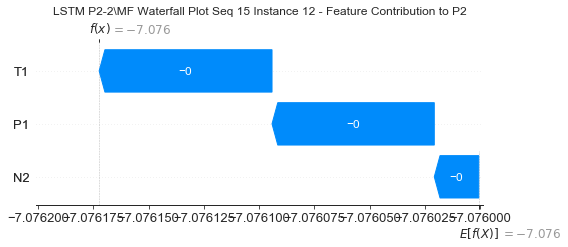

None

Contribution: [-7.76821815e-05 -8.77081182e-05 -1.87730263e-05]


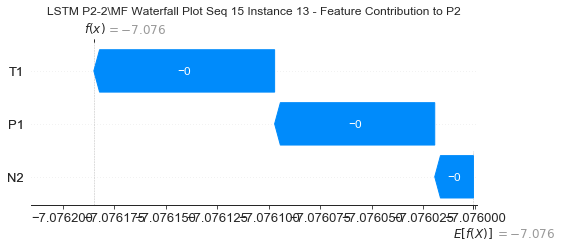

None

Contribution: [-6.98126159e-05 -1.09729875e-04 -1.50005811e-05]


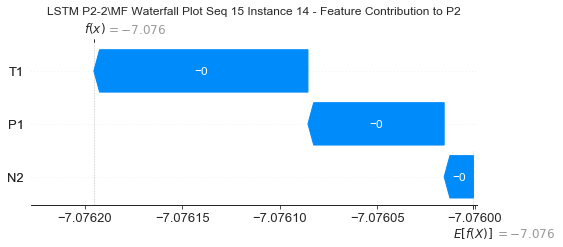

None

Contribution: [-7.79025055e-05 -1.32342999e-04 -1.99460291e-05]


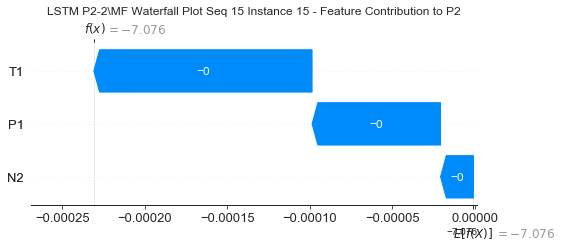

None

Contribution: [-7.99010927e-05 -1.44274480e-04 -2.18543366e-05]


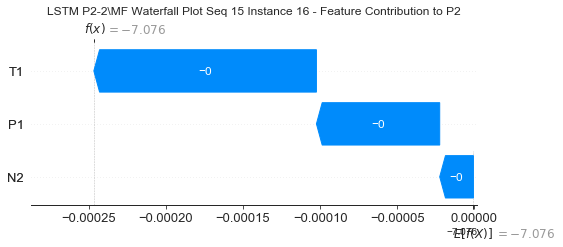

None

Contribution: [-7.35318754e-05 -1.68113151e-04 -2.26675131e-05]


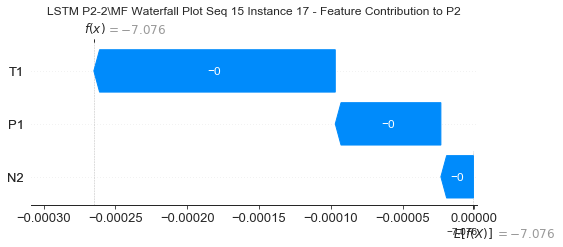

None

Contribution: [-7.99200562e-05 -1.82314183e-04 -2.34267385e-05]


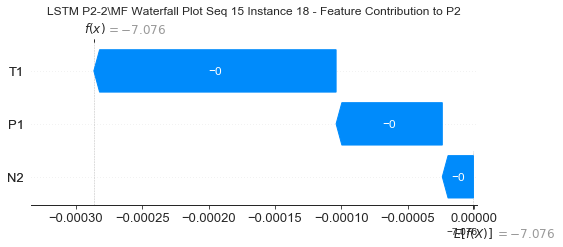

None

Contribution: [-8.26702123e-05 -1.97483281e-04 -2.26113130e-05]


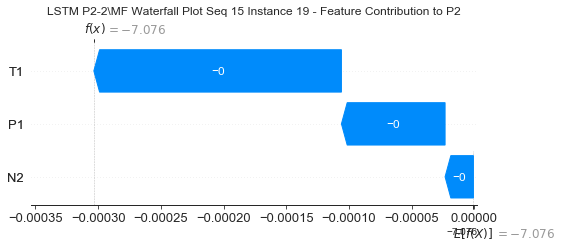

None

Contribution: [-8.47641591e-05 -2.04490378e-04 -2.15910707e-05]


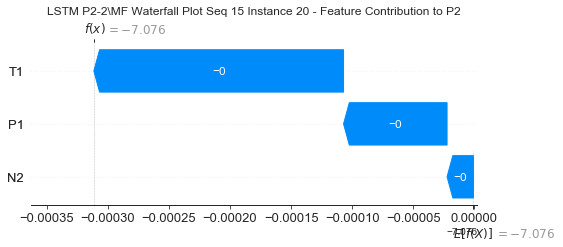

None

Contribution: [-8.18132403e-05 -2.65061620e-04 -2.02387800e-05]


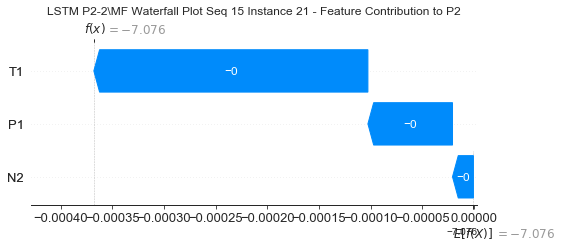

None

Contribution: [-7.05747171e-05 -1.05204801e-03 -1.23500111e-04]


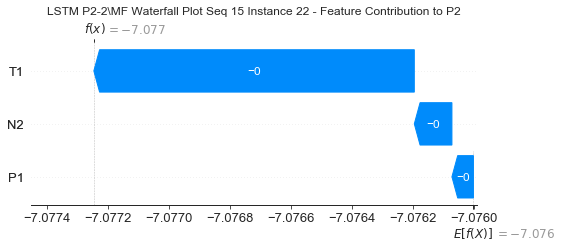

None

Contribution: [ 0.00012455  0.0020092  -0.00212679]


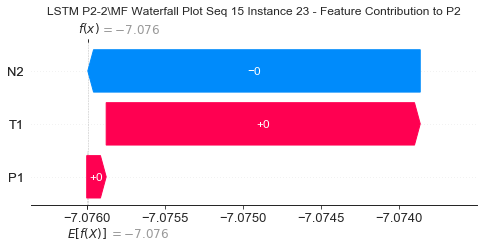

None

Contribution: [ 0.00171511  0.01619302 -0.01652689]


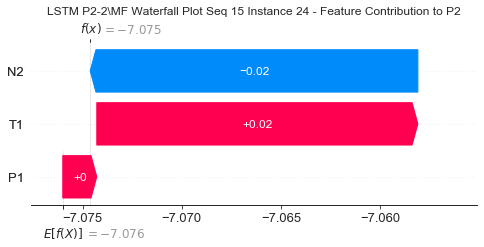

None

Contribution: [-0.02302912 -0.01253752 -0.08489979]


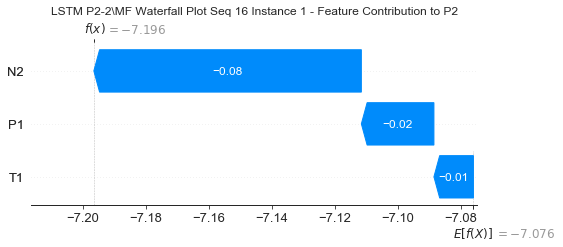

None

Contribution: [ 0.0001939  -0.00060951  0.00059494]


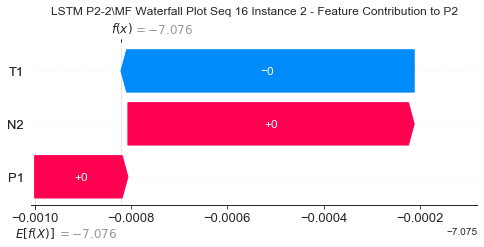

None

Contribution: [-6.43616040e-05  4.29470661e-04 -3.25171659e-04]


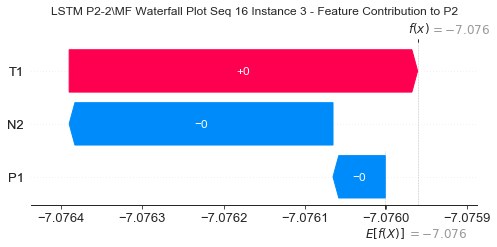

None

Contribution: [-6.12297565e-05  1.43925451e-04 -2.25450679e-04]


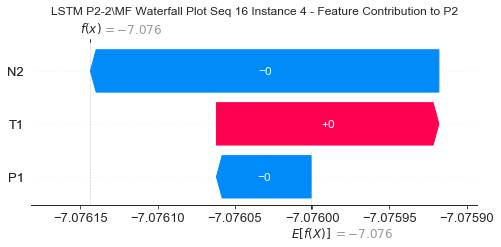

None

Contribution: [-9.99593915e-06 -4.85191759e-06 -4.62617180e-05]


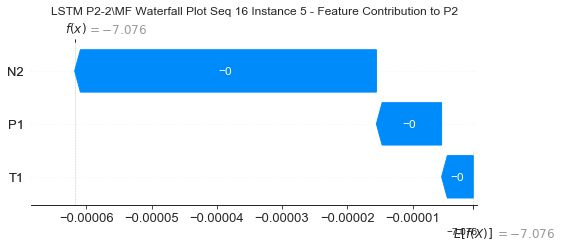

None

Contribution: [-8.12271534e-06  4.00168621e-06 -3.01054850e-05]


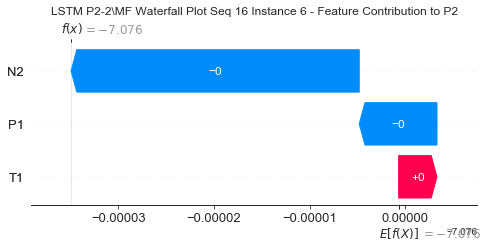

None

Contribution: [-1.24862985e-05  9.14950658e-06 -3.64567840e-05]


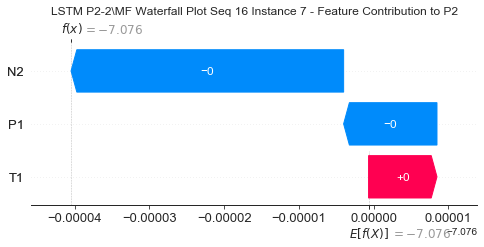

None

Contribution: [-1.86833422e-05  6.17258592e-06 -3.84035837e-05]


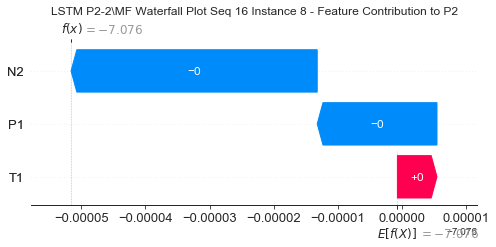

None

Contribution: [-3.29028517e-05  3.36514341e-07 -1.59615906e-05]


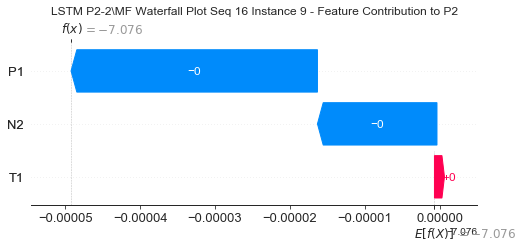

None

Contribution: [-5.02294735e-05 -2.89909166e-05 -2.65905891e-06]


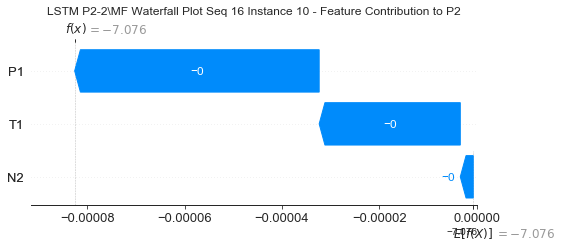

None

Contribution: [-6.79519727e-05 -5.98403422e-05 -1.30130082e-05]


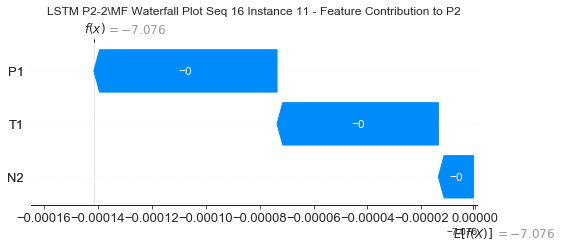

None

Contribution: [-7.30499201e-05 -6.67677147e-05 -2.09491796e-05]


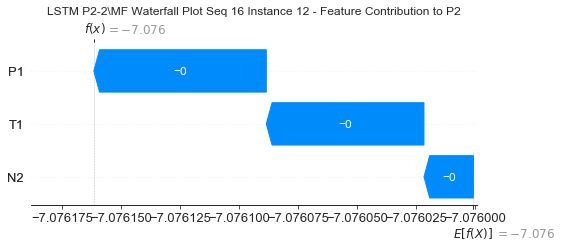

None

Contribution: [-7.84068937e-05 -7.80234217e-05 -1.76123004e-05]


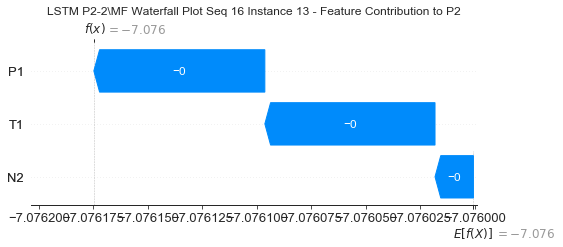

None

Contribution: [-7.05200130e-05 -9.32513766e-05 -1.68399879e-05]


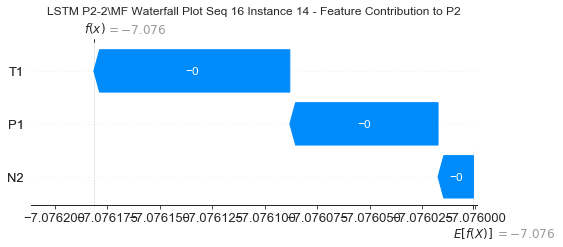

None

Contribution: [-7.84968975e-05 -1.19002838e-04 -1.87230106e-05]


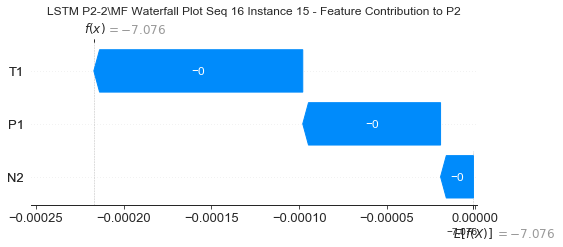

None

Contribution: [-7.90685517e-05 -1.30917074e-04 -2.07399376e-05]


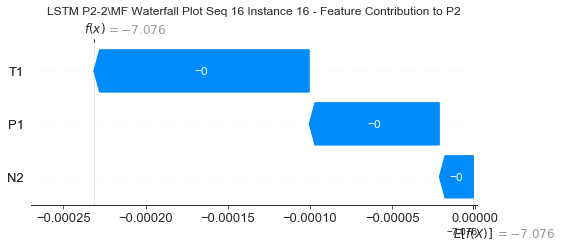

None

Contribution: [-7.38112269e-05 -1.56503919e-04 -2.13829163e-05]


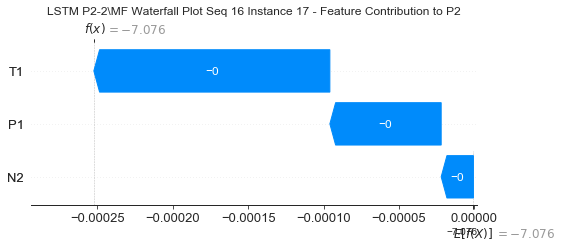

None

Contribution: [-7.66055089e-05 -1.68825681e-04 -2.22576291e-05]


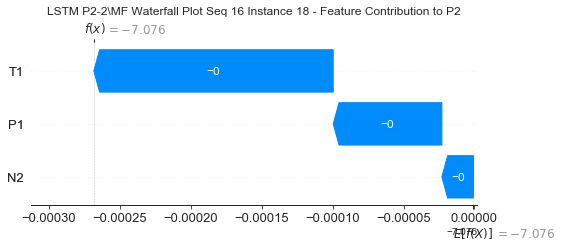

None

Contribution: [-7.87819278e-05 -1.83753903e-04 -2.12618219e-05]


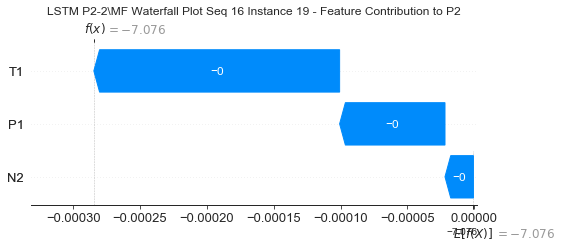

None

Contribution: [-8.07789299e-05 -1.88842872e-04 -2.02069311e-05]


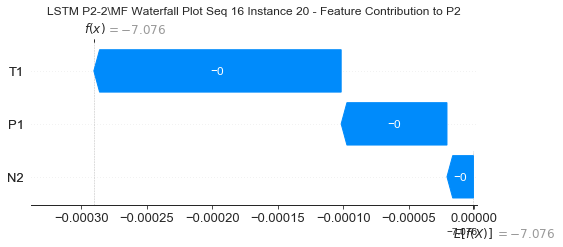

None

Contribution: [-7.78804851e-05 -2.40300679e-04 -1.80778281e-05]


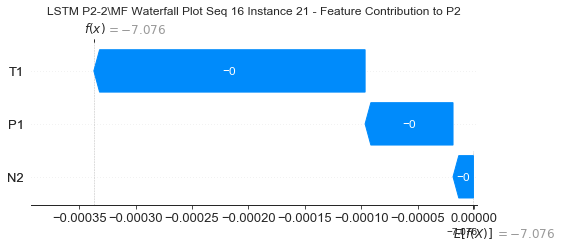

None

Contribution: [-5.73138640e-05 -9.10206619e-04 -1.08677089e-04]


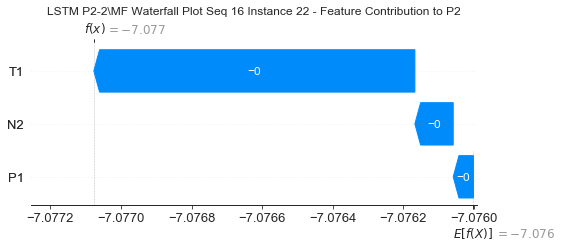

None

Contribution: [ 0.00024874  0.00114017 -0.00212036]


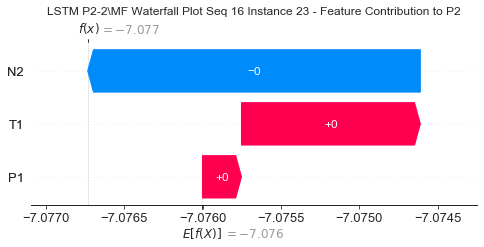

None

Contribution: [ 0.00183151  0.01894702 -0.01588238]


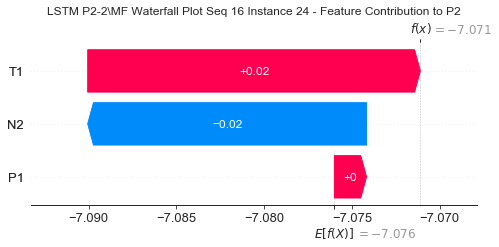

None

Contribution: [-0.02578592 -0.01249335 -0.08362538]


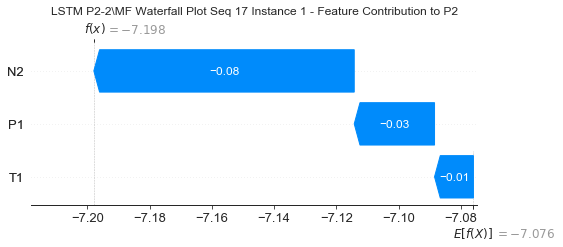

None

Contribution: [ 0.00018006 -0.00061309  0.00063642]


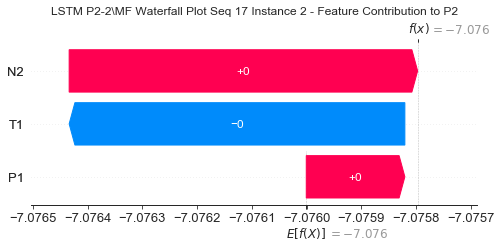

None

Contribution: [-0.00011245  0.00078128 -0.00032601]


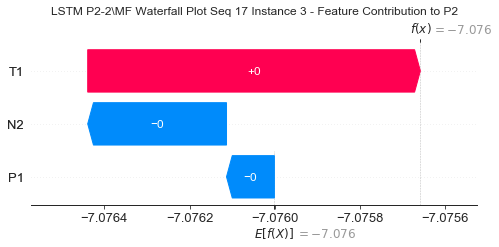

None

Contribution: [-8.44430170e-05  3.24697673e-04 -2.23809519e-04]


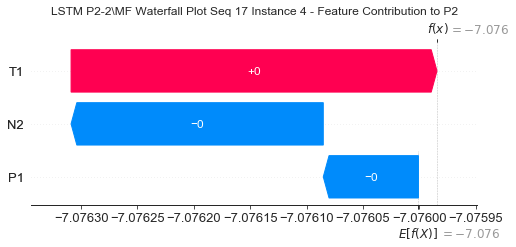

None

Contribution: [-8.95434268e-06  3.61522053e-06 -4.59951677e-05]


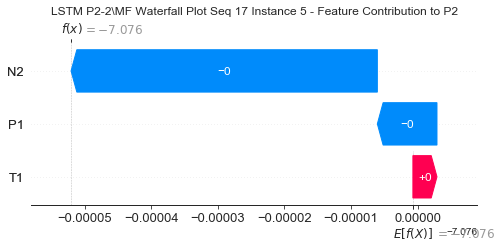

None

Contribution: [-8.51900943e-06  1.01017856e-05 -3.02453310e-05]


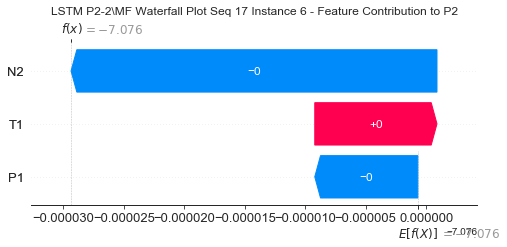

None

Contribution: [-1.26263920e-05  1.09027892e-05 -3.65173859e-05]


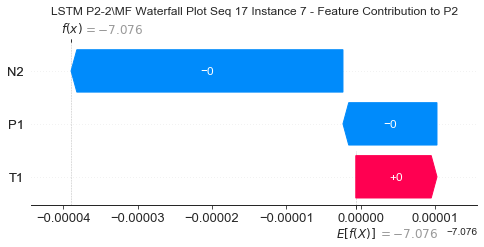

None

Contribution: [-1.90828255e-05  1.38288935e-05 -3.98571577e-05]


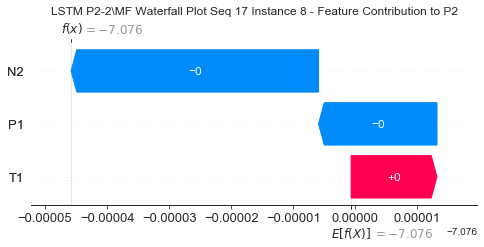

None

Contribution: [-3.05676271e-05  3.03533865e-06 -1.62731138e-05]


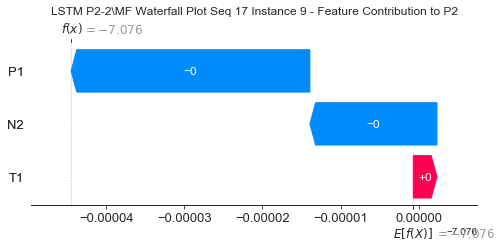

None

Contribution: [-4.63228792e-05 -3.43447617e-05 -2.95190491e-06]


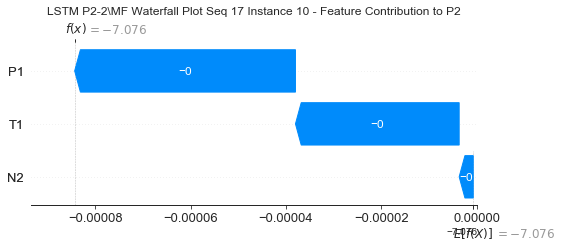

None

Contribution: [-6.48711781e-05 -6.86453991e-05 -1.38729728e-05]


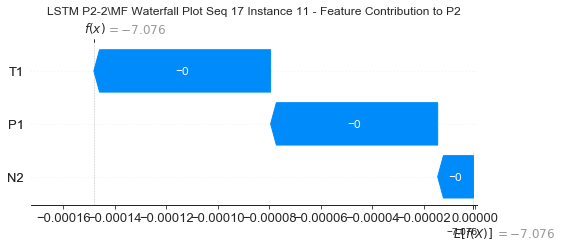

None

Contribution: [-6.98903827e-05 -7.27395125e-05 -2.09705539e-05]


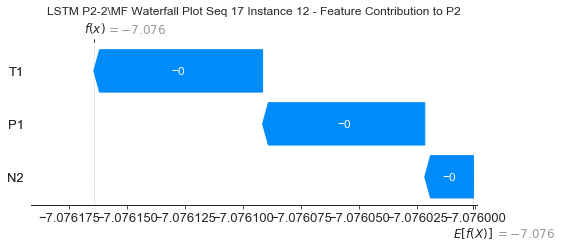

None

Contribution: [-7.38872566e-05 -8.12191609e-05 -1.84718884e-05]


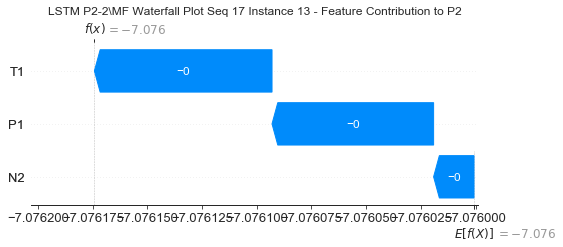

None

Contribution: [-6.94872581e-05 -9.66834811e-05 -1.72473685e-05]


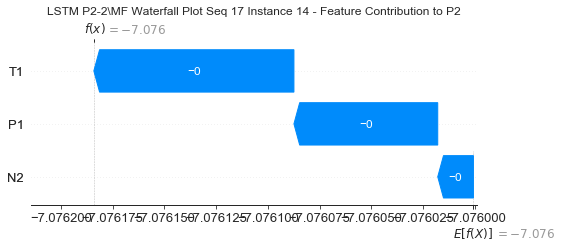

None

Contribution: [-7.44271978e-05 -1.21069048e-04 -2.00846590e-05]


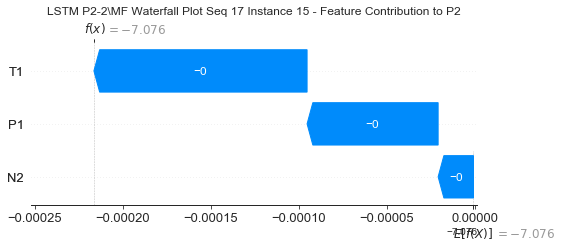

None

Contribution: [-7.61607605e-05 -1.34662763e-04 -2.15432601e-05]


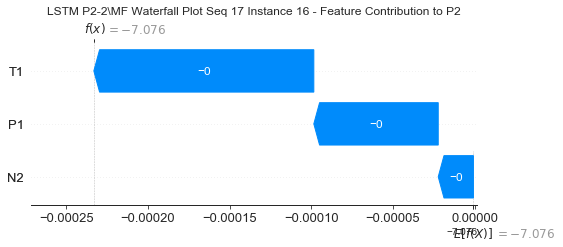

None

Contribution: [-7.18013634e-05 -1.56625712e-04 -2.46365384e-05]


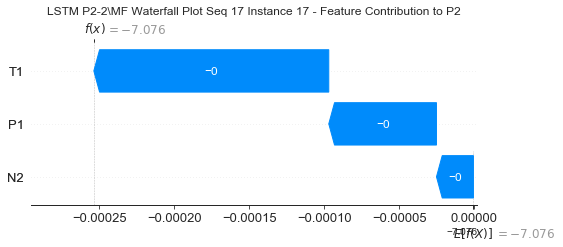

None

Contribution: [-8.15062650e-05 -1.72594854e-04 -2.34559362e-05]


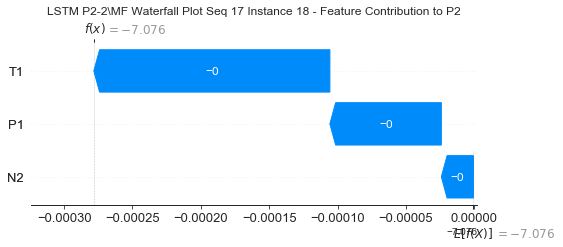

None

Contribution: [-8.36167513e-05 -1.89219741e-04 -2.23898116e-05]


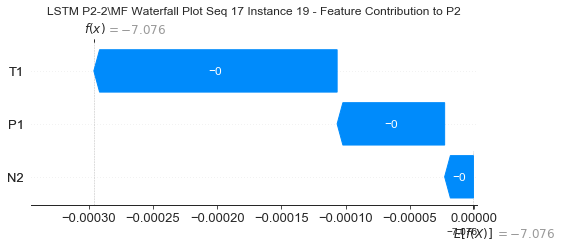

None

Contribution: [-8.59201639e-05 -1.95683261e-04 -2.20236403e-05]


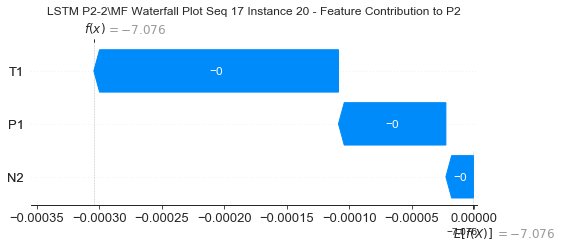

None

Contribution: [-7.82432776e-05 -2.63003833e-04 -2.10255691e-05]


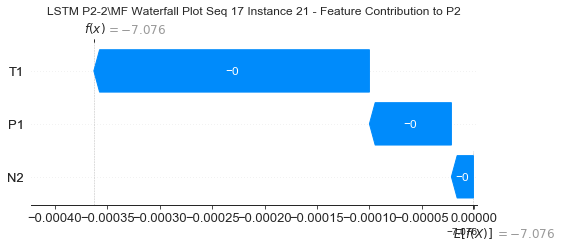

None

Contribution: [-8.88738131e-05 -1.08488766e-03 -1.09249855e-04]


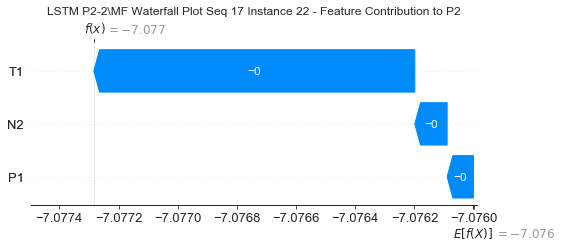

None

Contribution: [ 0.00042701  0.00216924 -0.00227643]


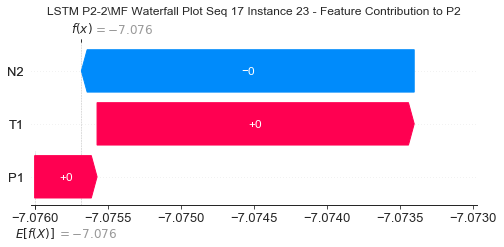

None

Contribution: [ 0.00151829  0.0252666  -0.01549854]


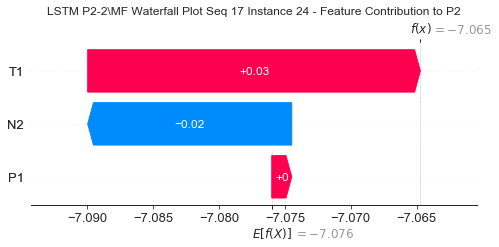

None

Contribution: [-0.02330501 -0.0128826  -0.07753637]


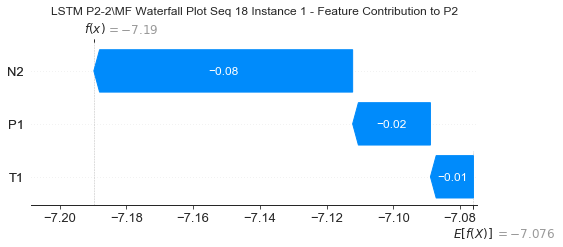

None

Contribution: [ 8.41885866e-05 -5.21393269e-04  4.88361103e-04]


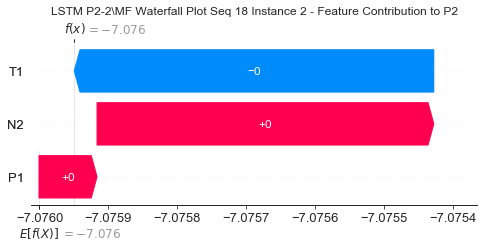

None

Contribution: [-0.00011908  0.00151748 -0.00031122]


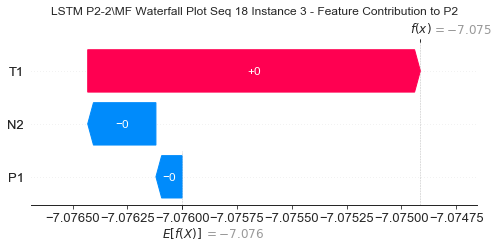

None

Contribution: [-8.51167467e-05  6.99774629e-04 -2.05019287e-04]


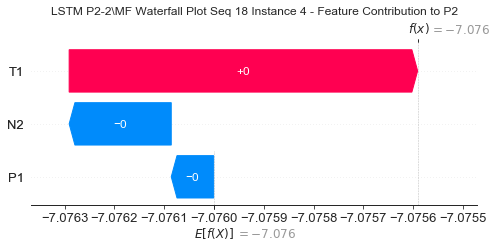

None

Contribution: [-6.79959591e-06  5.55111854e-05 -4.69094875e-05]


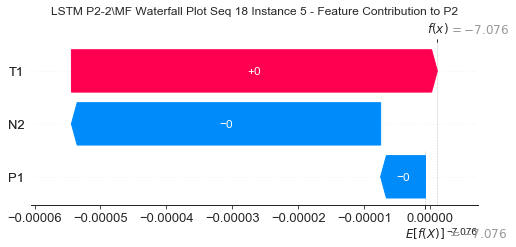

None

Contribution: [-8.30892585e-06  2.90726414e-05 -3.01581402e-05]


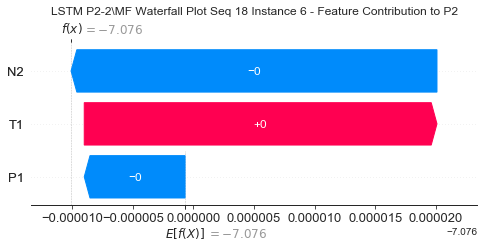

None

Contribution: [-1.03278452e-05  3.68959700e-05 -3.55572370e-05]


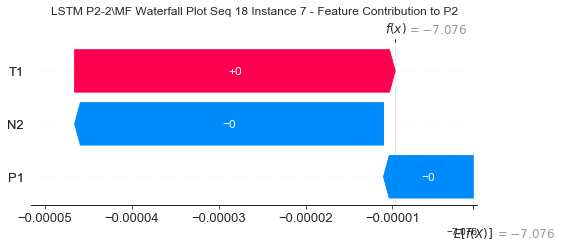

None

Contribution: [-1.87530835e-05  3.82736769e-05 -3.91825493e-05]


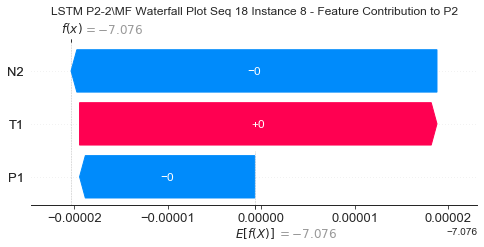

None

Contribution: [-2.79340104e-05  2.58197968e-05 -1.55672997e-05]


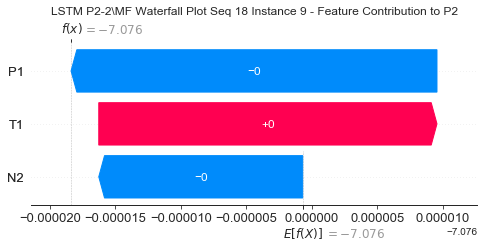

None

Contribution: [-4.73798630e-05 -1.22250245e-05 -3.72280780e-06]


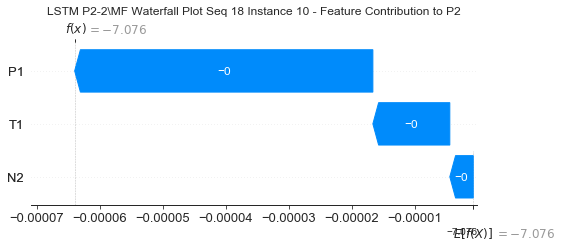

None

Contribution: [-6.68268282e-05 -3.93141917e-05 -1.37944168e-05]


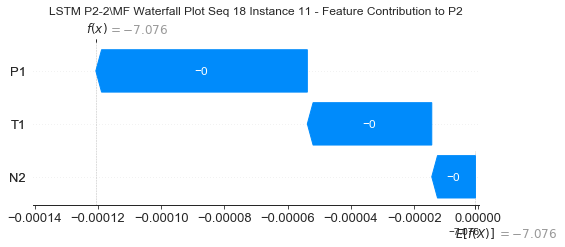

None

Contribution: [-7.00244518e-05 -3.59425109e-05 -2.00854065e-05]


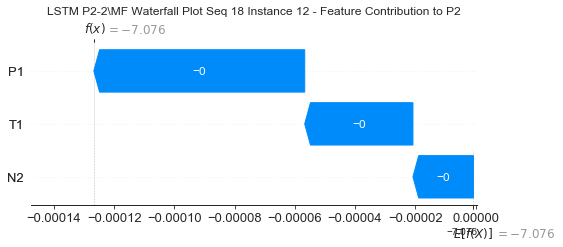

None

Contribution: [-7.73436172e-05 -3.49971366e-05 -1.79053704e-05]


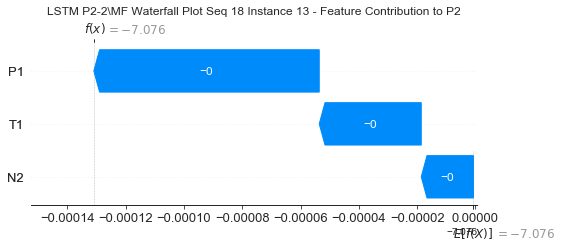

None

Contribution: [-6.83349758e-05 -4.42896474e-05 -1.75364191e-05]


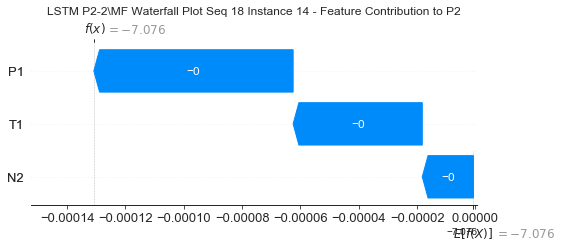

None

Contribution: [-7.86546872e-05 -6.27527637e-05 -1.83354594e-05]


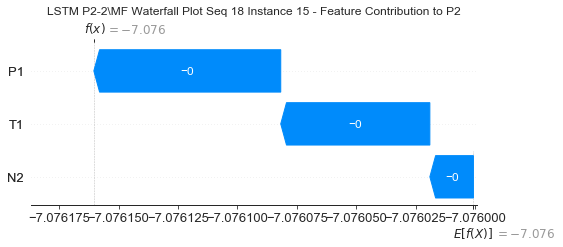

None

Contribution: [-8.09099688e-05 -7.43520574e-05 -2.02888166e-05]


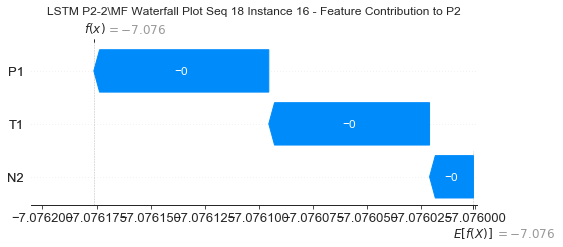

None

Contribution: [-6.80034768e-05 -9.40299282e-05 -2.10093669e-05]


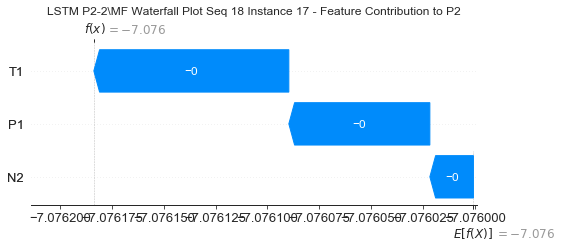

None

Contribution: [-8.62366128e-05 -1.11085223e-04 -2.17898084e-05]


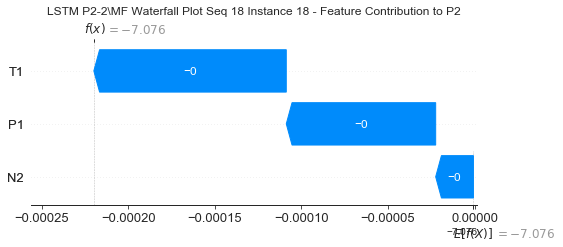

None

Contribution: [-8.87688130e-05 -1.25764172e-04 -2.08196429e-05]


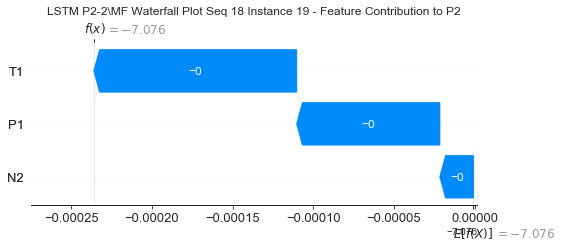

None

Contribution: [-9.14408299e-05 -1.33240189e-04 -1.99414861e-05]


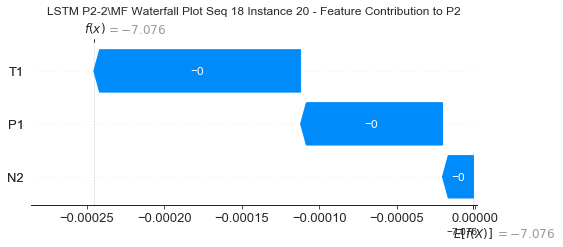

None

Contribution: [-8.58958422e-05 -2.03243540e-04 -1.91538535e-05]


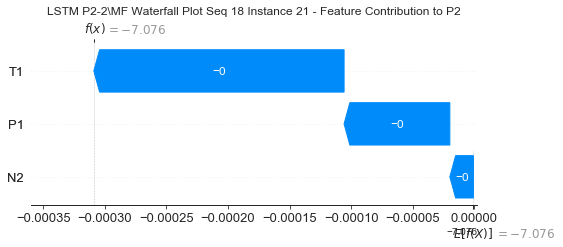

None

Contribution: [-9.98601029e-05 -1.08669150e-03 -1.01891860e-04]


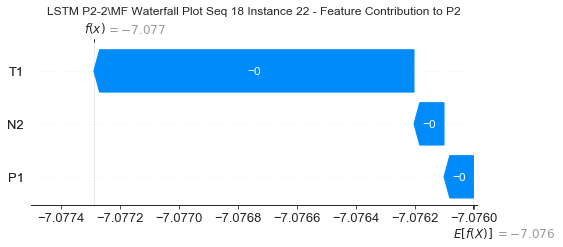

None

Contribution: [ 0.00022471  0.00257718 -0.00216987]


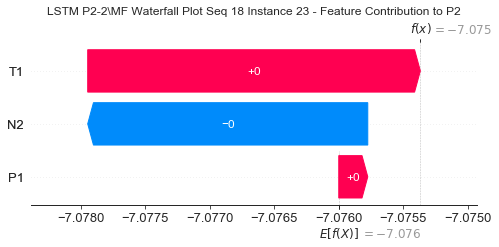

None

Contribution: [ 0.00169377  0.02490739 -0.01647668]


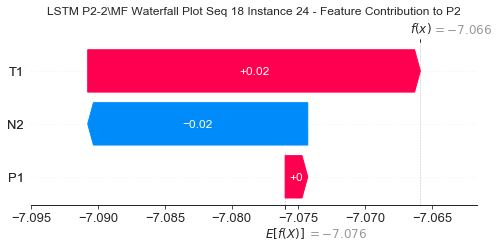

None

Contribution: [-0.02594754 -0.01454184 -0.08883053]


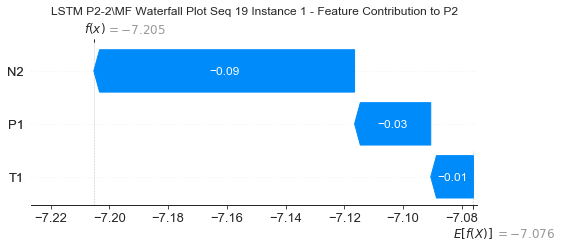

None

Contribution: [ 0.00025691 -0.00062323  0.00066757]


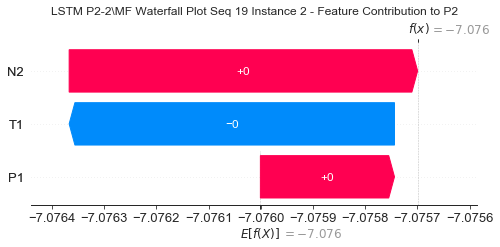

None

Contribution: [-0.00016786  0.00054841 -0.00035857]


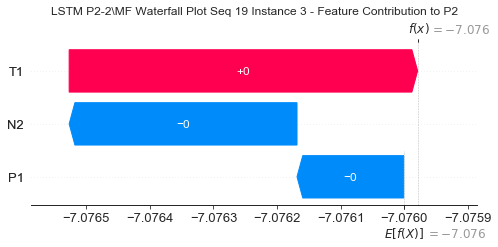

None

Contribution: [-0.00013734  0.00019473 -0.00023807]


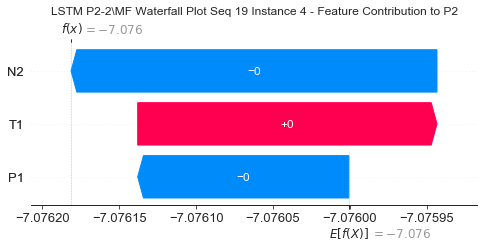

None

Contribution: [-1.30738173e-05  3.46982044e-06 -4.63394601e-05]


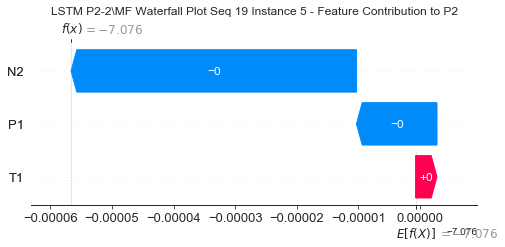

None

Contribution: [-1.01774953e-05  5.47795507e-06 -3.07468100e-05]


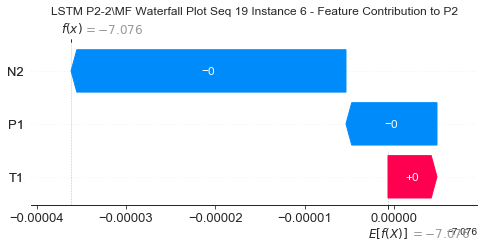

None

Contribution: [-1.49065514e-05  9.36376106e-06 -3.81049884e-05]


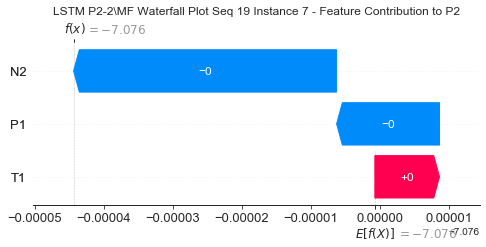

None

Contribution: [-2.20131877e-05  1.19107455e-05 -4.13187377e-05]


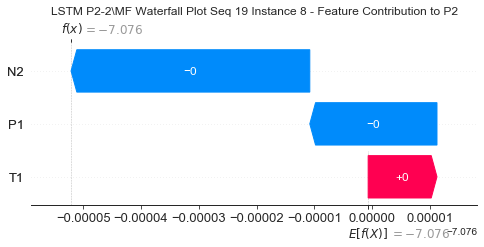

None

Contribution: [-3.45408085e-05 -1.64139461e-06 -1.71942533e-05]


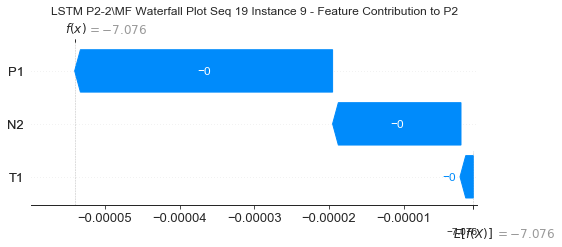

None

Contribution: [-5.31880161e-05 -3.31826962e-05 -2.62883784e-06]


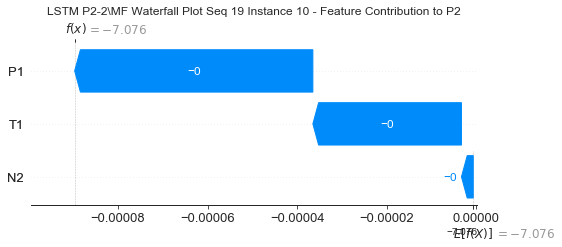

None

Contribution: [-7.39427275e-05 -6.86435771e-05 -1.23750935e-05]


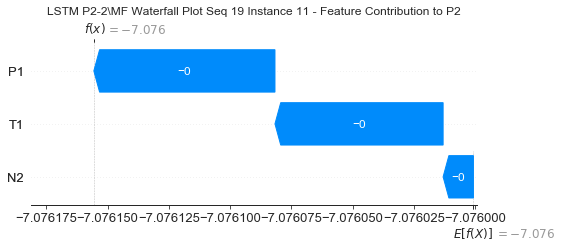

None

Contribution: [-8.63669059e-05 -8.03810539e-05 -1.89663799e-05]


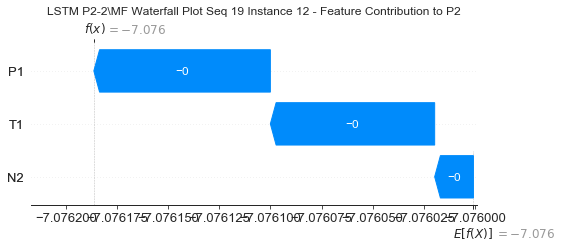

None

Contribution: [-8.41387257e-05 -8.74470608e-05 -1.84311012e-05]


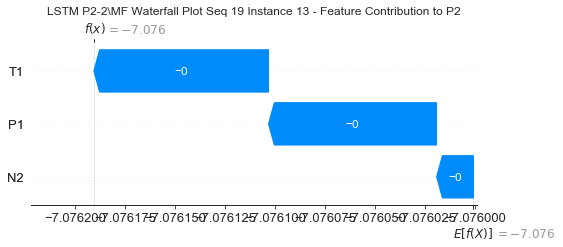

None

Contribution: [-7.72425055e-05 -1.06232004e-04 -1.57473063e-05]


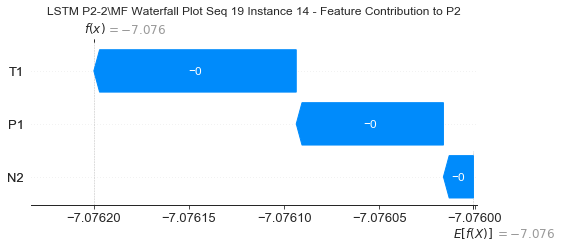

None

Contribution: [-8.40576218e-05 -1.32534758e-04 -1.92112955e-05]


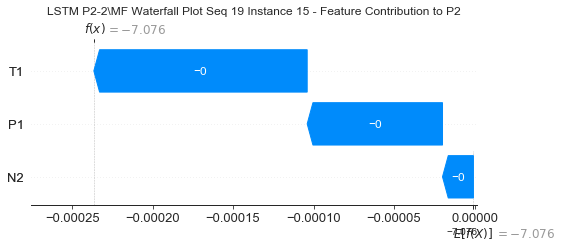

None

Contribution: [-8.43864117e-05 -1.47273270e-04 -2.08464473e-05]


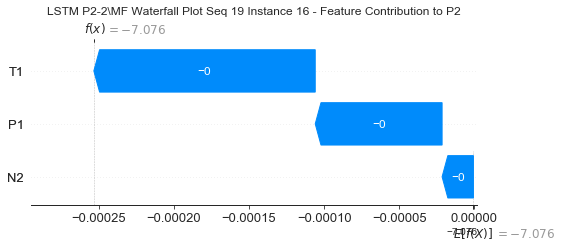

None

Contribution: [-8.03926532e-05 -1.70445332e-04 -1.93329102e-05]


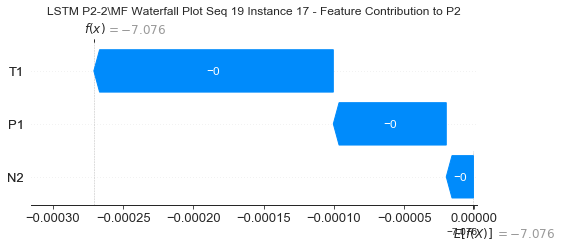

None

Contribution: [-8.69526269e-05 -1.90898346e-04 -2.16917914e-05]


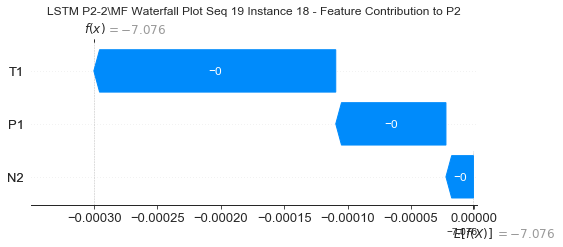

None

Contribution: [-8.91641782e-05 -2.07613224e-04 -2.13999750e-05]


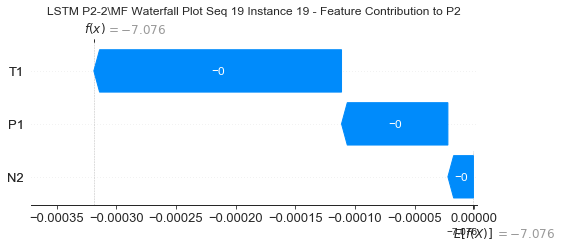

None

Contribution: [-9.17628125e-05 -2.12937788e-04 -2.09707774e-05]


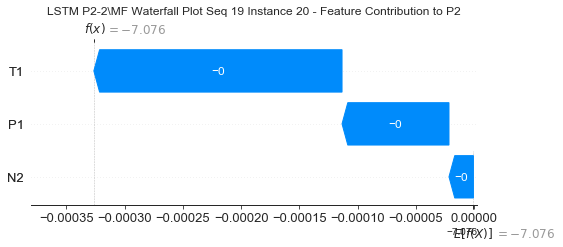

None

Contribution: [-8.58499550e-05 -2.75746601e-04 -2.01812736e-05]


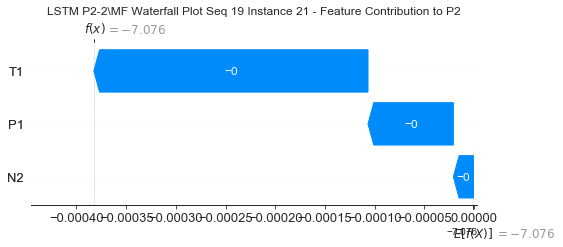

None

Contribution: [-8.52809286e-05 -1.12883207e-03 -1.18204121e-04]


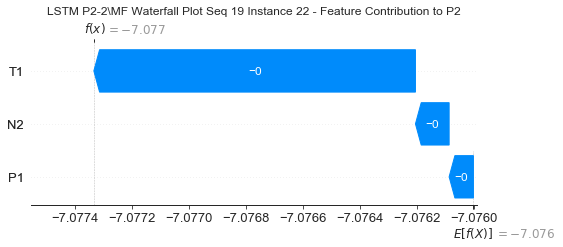

None

Contribution: [ 0.00031909  0.00229836 -0.00225423]


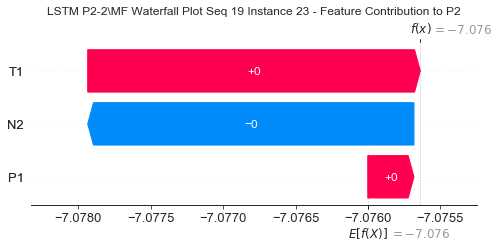

None

Contribution: [ 0.00239391  0.0233096  -0.01684312]


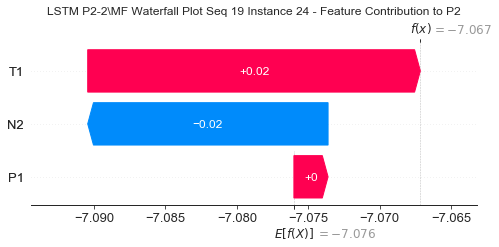

None

Contribution: [-0.03019809 -0.01387213 -0.08509864]


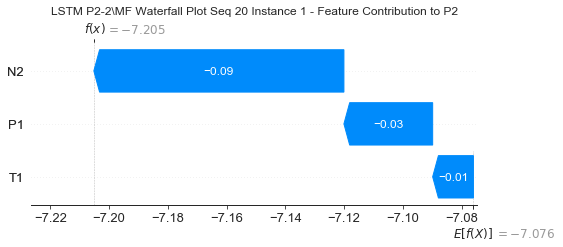

None

Contribution: [ 2.85145937e-05 -6.31627648e-04  5.51435488e-04]


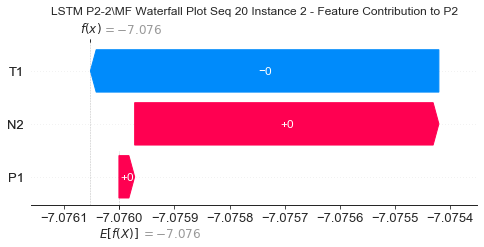

None

Contribution: [-0.000141    0.0007774  -0.00032903]


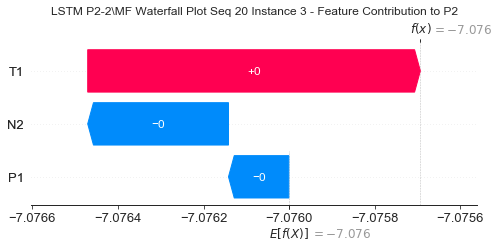

None

Contribution: [-0.0001306   0.00029335 -0.00022886]


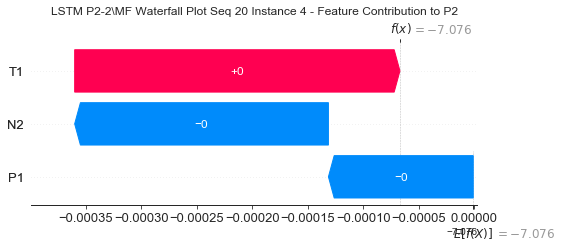

None

Contribution: [-1.16274436e-05  5.90133505e-06 -4.63729664e-05]


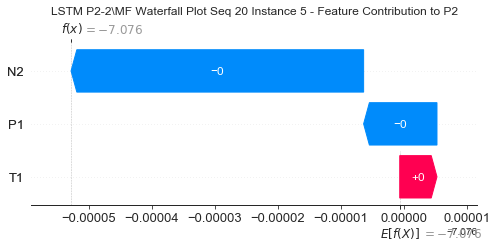

None

Contribution: [-9.87475408e-06  9.05536497e-06 -3.05922035e-05]


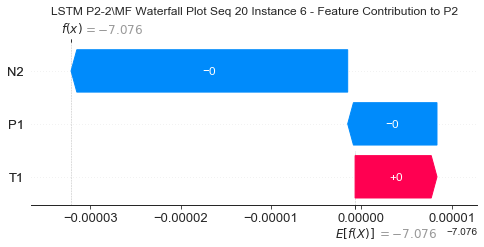

None

Contribution: [-1.40076288e-05  1.52991039e-05 -3.76902468e-05]


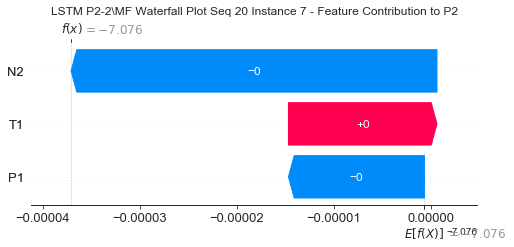

None

Contribution: [-2.06381872e-05  1.47736429e-05 -4.01898828e-05]


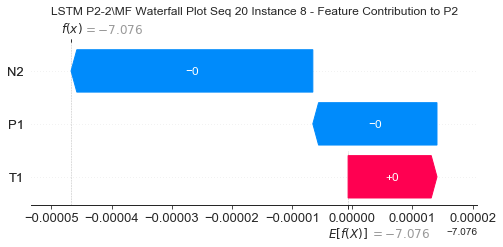

None

Contribution: [-3.45308005e-05  1.37749906e-06 -1.73455130e-05]


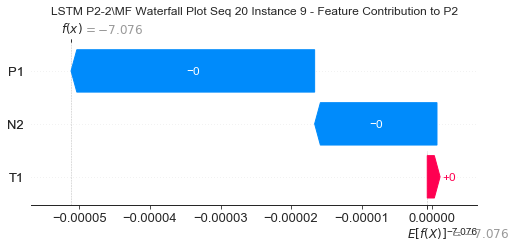

None

Contribution: [-5.19721603e-05 -3.65457414e-05 -3.54141665e-06]


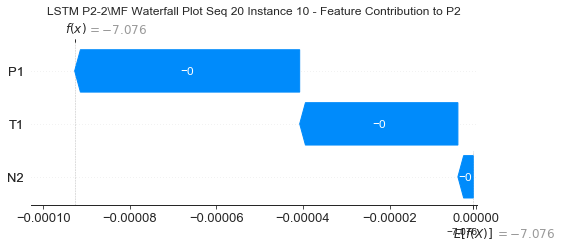

None

Contribution: [-7.18261416e-05 -7.36310993e-05 -1.38047930e-05]


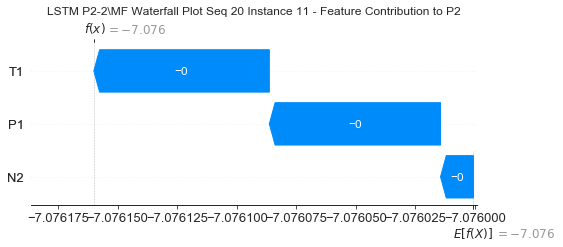

None

Contribution: [-8.27818107e-05 -7.74136825e-05 -2.37356789e-05]


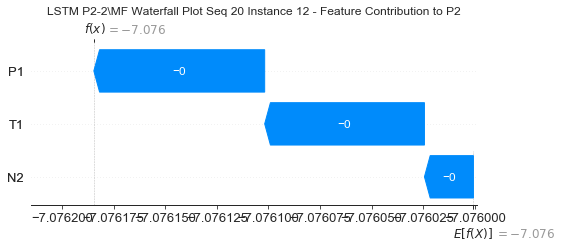

None

Contribution: [-8.20859576e-05 -8.96777039e-05 -1.93853915e-05]


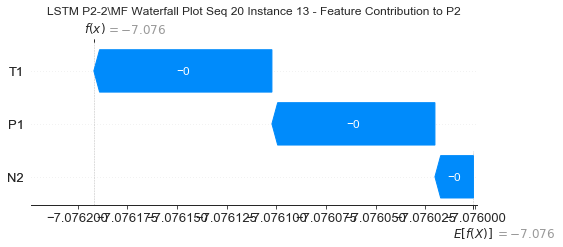

None

Contribution: [-6.86987075e-05 -1.06137646e-04 -1.83394053e-05]


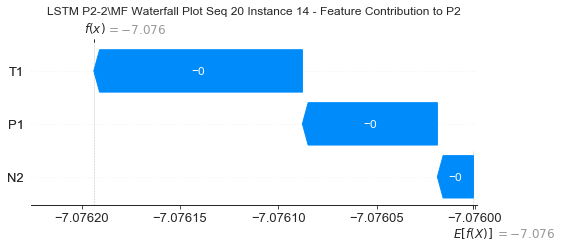

None

Contribution: [-8.49594675e-05 -1.33516679e-04 -2.06812624e-05]


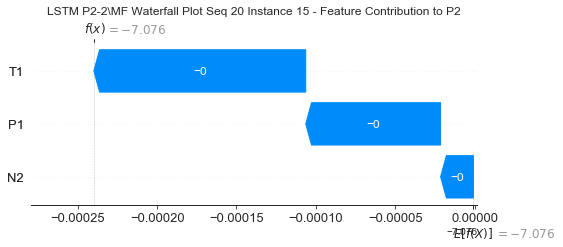

None

Contribution: [-8.80906565e-05 -1.47517305e-04 -2.27450258e-05]


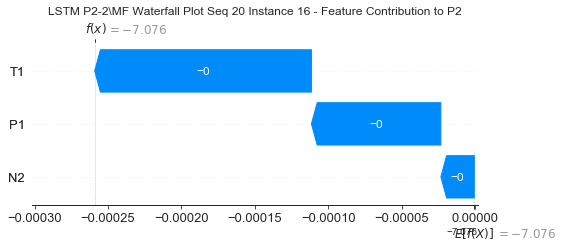

None

Contribution: [-8.60263465e-05 -1.73135704e-04 -2.54380473e-05]


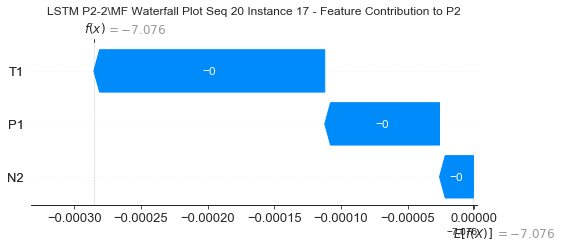

None

Contribution: [-8.95527200e-05 -1.91049659e-04 -2.53784663e-05]


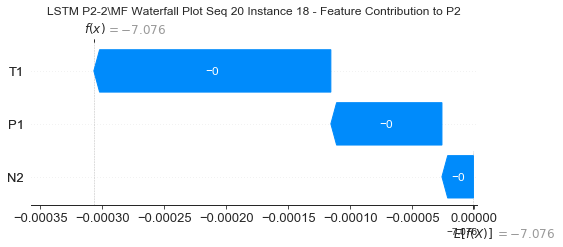

None

Contribution: [-9.19132220e-05 -2.08017923e-04 -2.50413137e-05]


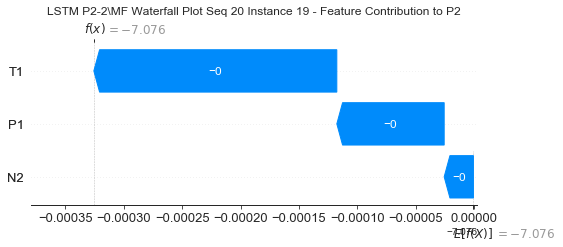

None

Contribution: [-9.14706704e-05 -2.15121212e-04 -2.54462854e-05]


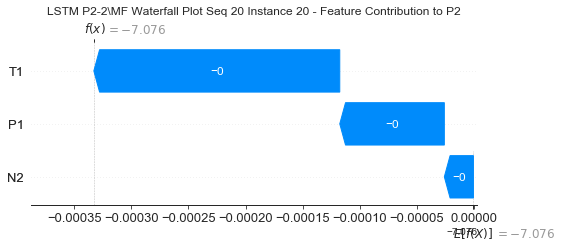

None

Contribution: [-9.01444478e-05 -2.81545938e-04 -2.66369100e-05]


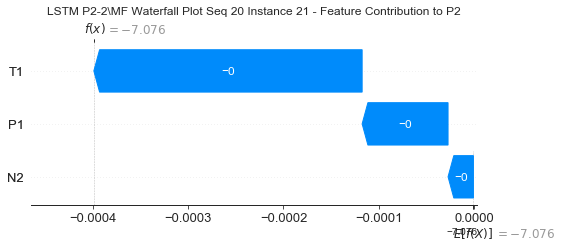

None

Contribution: [-9.72577288e-05 -1.16172127e-03 -1.52959511e-04]


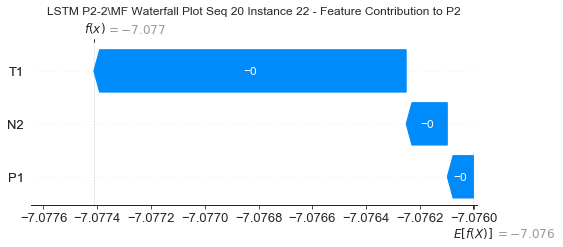

None

Contribution: [ 0.00026307  0.00202429 -0.00207901]


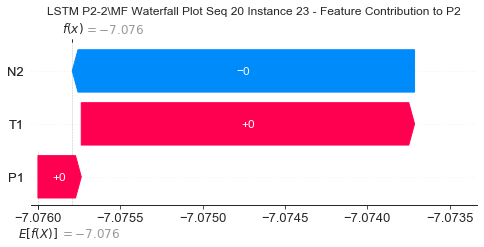

None

Contribution: [ 0.00229865  0.02054077 -0.01611096]


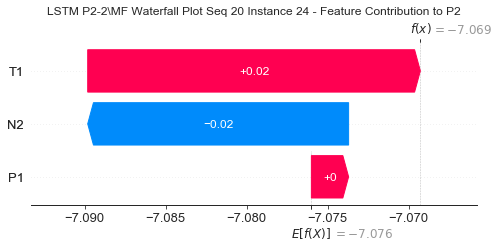

None

Contribution: [-0.02618229 -0.01270065 -0.07875487]


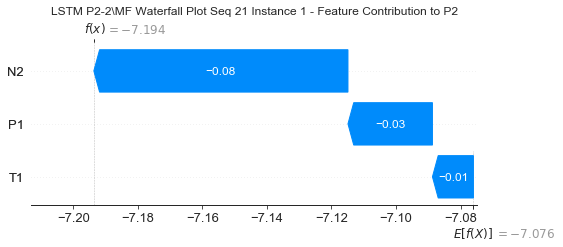

None

Contribution: [ 0.00032358 -0.00058964  0.00059897]


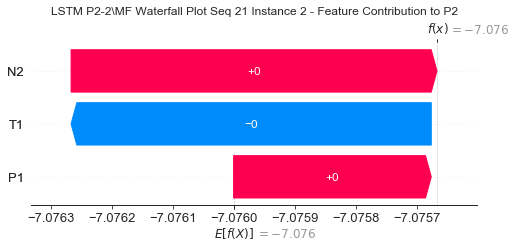

None

Contribution: [-0.00013589  0.0009224  -0.00032235]


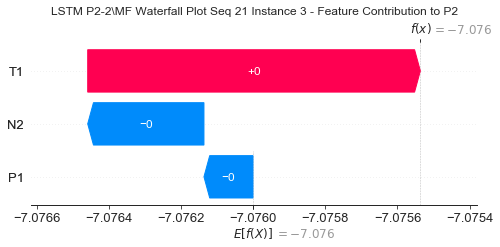

None

Contribution: [-0.00010781  0.00038379 -0.00022107]


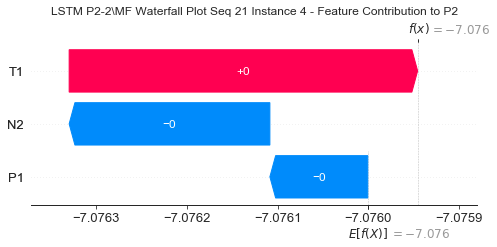

None

Contribution: [-1.42770530e-05  4.32067692e-05 -4.39630337e-05]


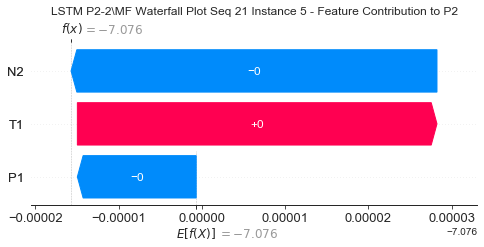

None

Contribution: [-9.70299999e-06  1.42678285e-05 -3.02842936e-05]


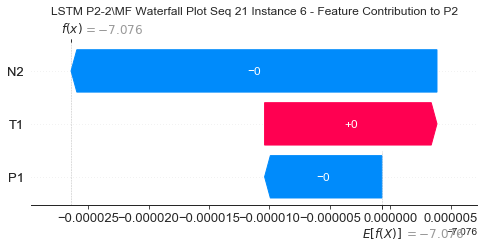

None

Contribution: [-1.48745806e-05  1.63613339e-05 -3.60579988e-05]


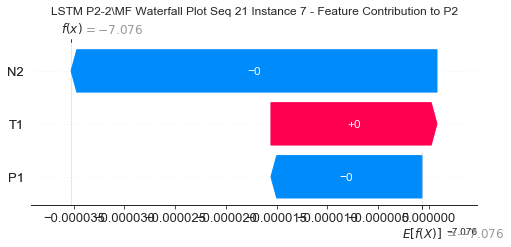

None

Contribution: [-2.11329025e-05  1.29839153e-05 -3.87142348e-05]


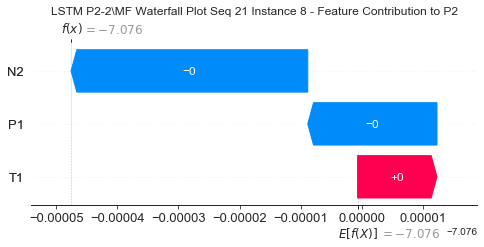

None

Contribution: [-3.44048944e-05  6.86460283e-06 -1.63925221e-05]


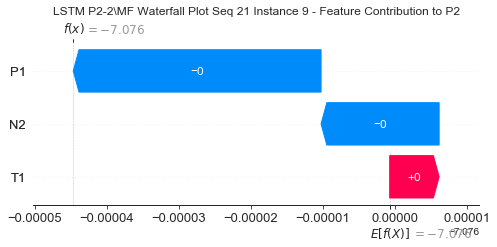

None

Contribution: [-4.75207309e-05 -2.42637446e-05 -2.71954101e-06]


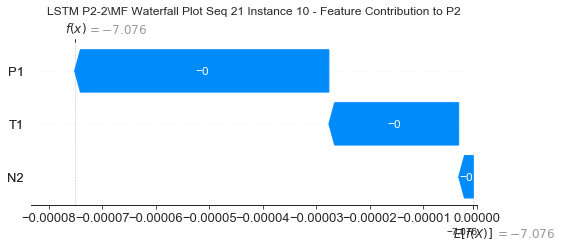

None

Contribution: [-6.80171466e-05 -5.54780099e-05 -1.35000137e-05]


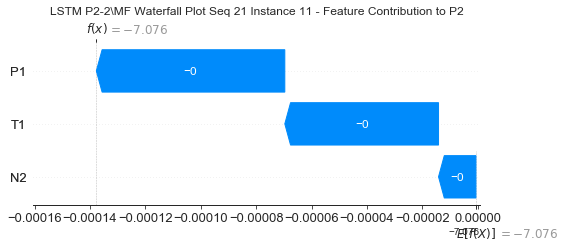

None

Contribution: [-8.74210351e-05 -5.96415029e-05 -1.98382097e-05]


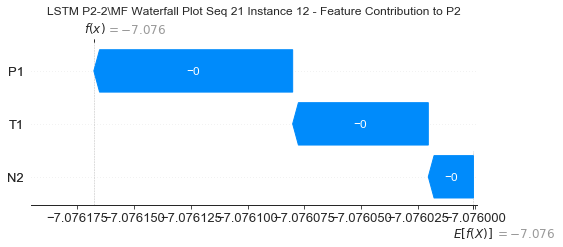

None

Contribution: [-7.88942583e-05 -6.33327947e-05 -1.83548805e-05]


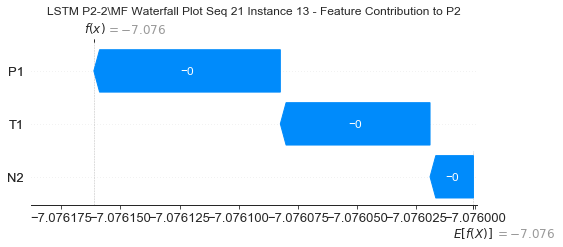

None

Contribution: [-7.78013566e-05 -7.57040405e-05 -1.72998374e-05]


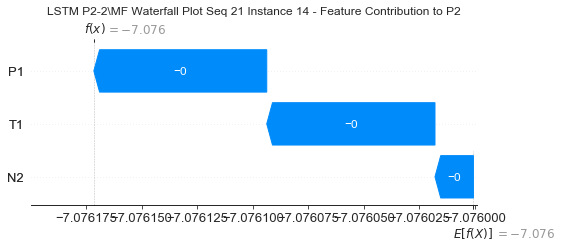

None

Contribution: [-9.18069303e-05 -1.00945321e-04 -1.78619720e-05]


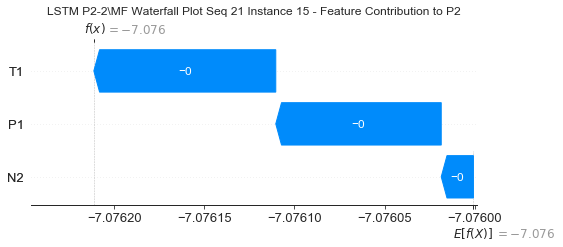

None

Contribution: [-9.06370950e-05 -1.13765121e-04 -1.99576370e-05]


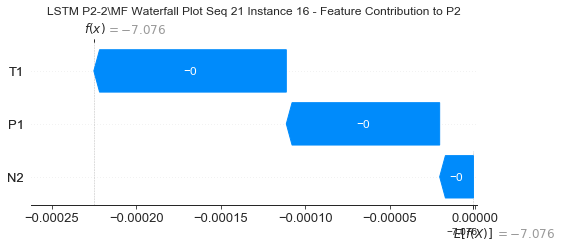

None

Contribution: [-8.24669576e-05 -1.36226058e-04 -2.10300672e-05]


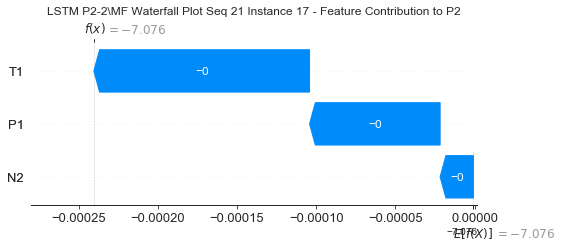

None

Contribution: [-9.68798581e-05 -1.52639475e-04 -2.13306526e-05]


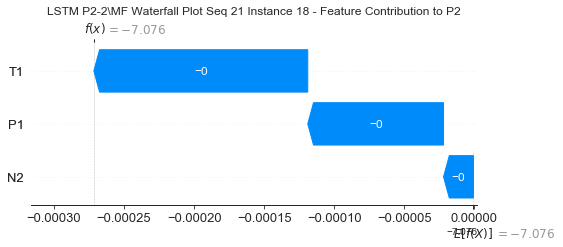

None

Contribution: [-9.14669546e-05 -1.71841084e-04 -2.07775193e-05]


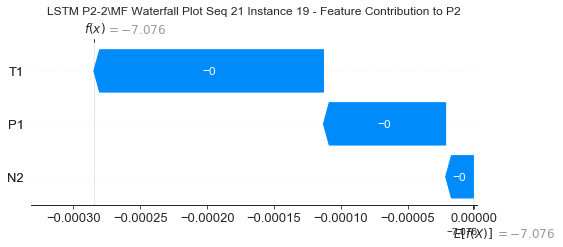

None

Contribution: [-9.17296014e-05 -1.80190740e-04 -1.99028069e-05]


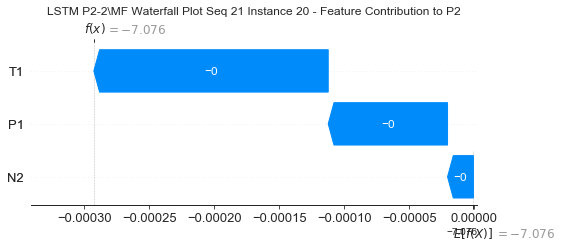

None

Contribution: [-8.40967656e-05 -2.60844668e-04 -2.11155869e-05]


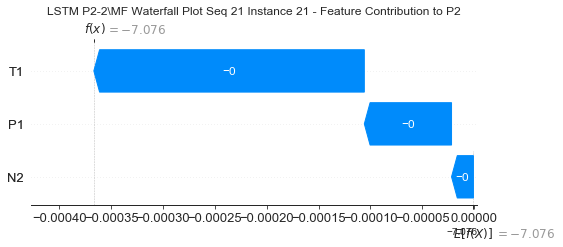

None

Contribution: [-9.10366967e-05 -1.27706555e-03 -1.10532791e-04]


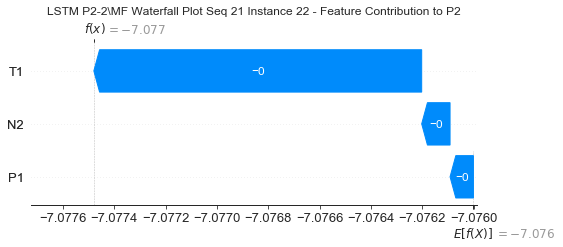

None

Contribution: [ 0.00032812  0.00333336 -0.00220469]


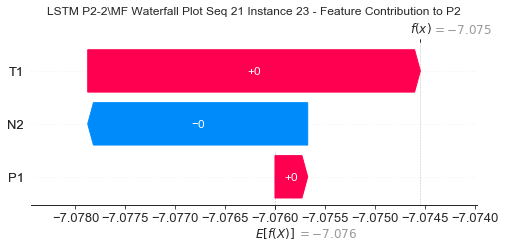

None

Contribution: [ 0.00315118  0.03010086 -0.01711558]


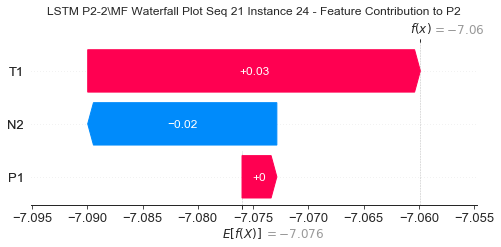

None

Contribution: [-0.02789651 -0.0148903  -0.0813894 ]


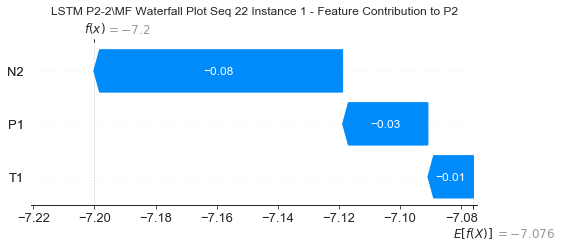

None

Contribution: [ 0.00018967 -0.00048861  0.00047372]


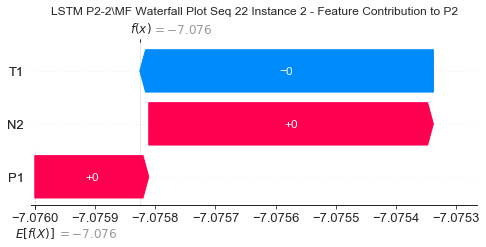

None

Contribution: [-0.00021353  0.00196201 -0.00020706]


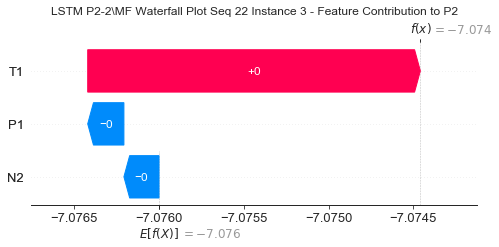

None

Contribution: [-0.00012754  0.00063701 -0.00015235]


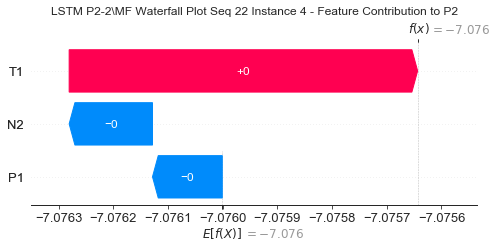

None

Contribution: [-1.03842944e-05  5.70626037e-05 -4.09511351e-05]


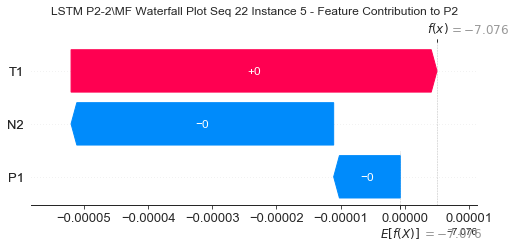

None

Contribution: [-1.12524770e-05  2.20715773e-05 -2.89044093e-05]


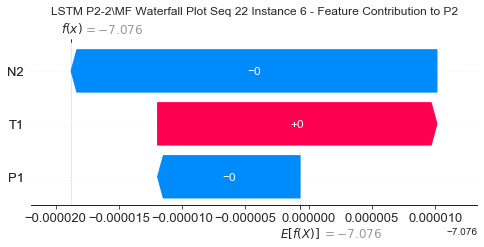

None

Contribution: [-1.37232971e-05  2.79763440e-05 -3.50205773e-05]


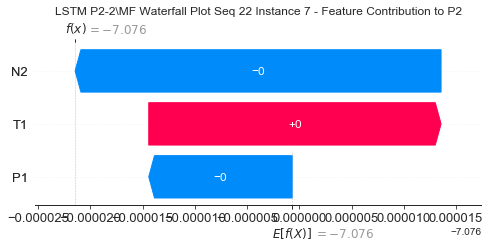

None

Contribution: [-2.13485120e-05  2.05187417e-05 -3.88443031e-05]


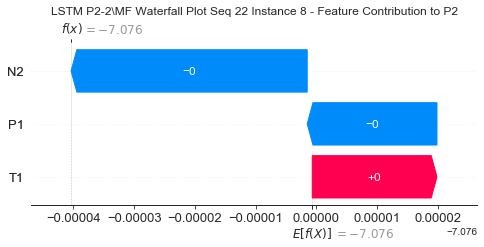

None

Contribution: [-3.65728421e-05  1.67603417e-05 -1.61546165e-05]


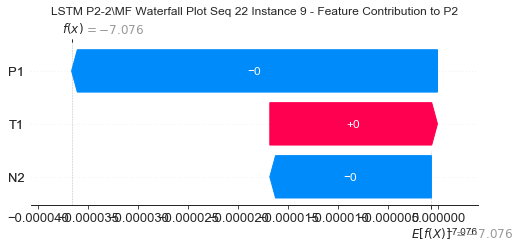

None

Contribution: [-5.02189743e-05 -1.36377174e-05 -3.83618241e-06]


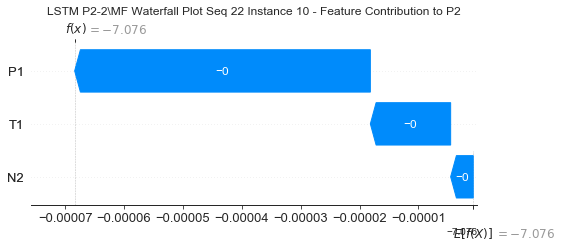

None

Contribution: [-6.90031402e-05 -4.28120396e-05 -1.39587001e-05]


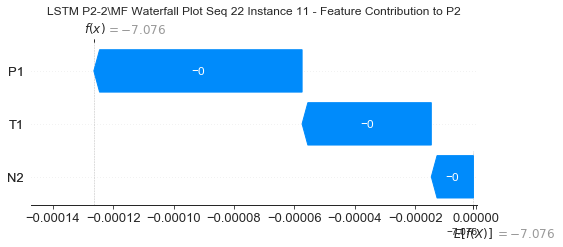

None

Contribution: [-7.74099213e-05 -4.32374894e-05 -1.99017136e-05]


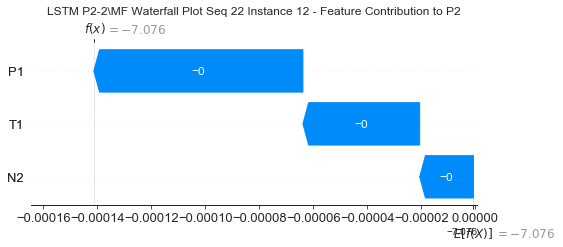

None

Contribution: [-9.24118391e-05 -4.48420002e-05 -1.84167989e-05]


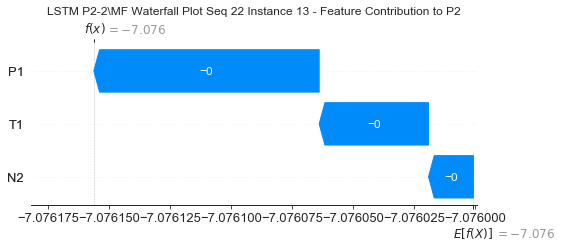

None

Contribution: [-7.03335987e-05 -5.55671164e-05 -1.69732920e-05]


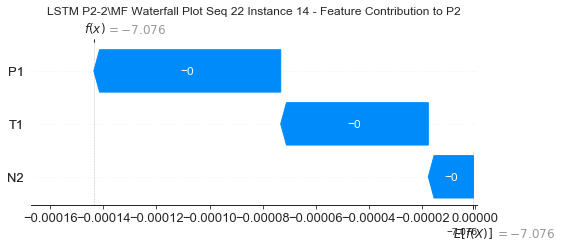

None

Contribution: [-8.01885047e-05 -7.63918253e-05 -1.87315524e-05]


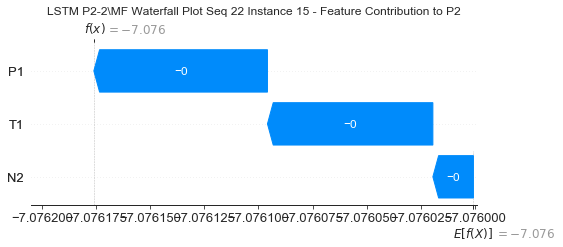

None

Contribution: [-8.79047929e-05 -8.83760843e-05 -2.04280545e-05]


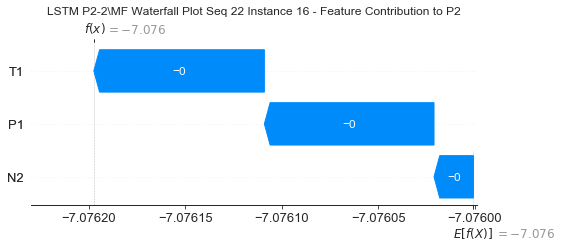

None

Contribution: [-8.07679992e-05 -1.07885222e-04 -2.18006476e-05]


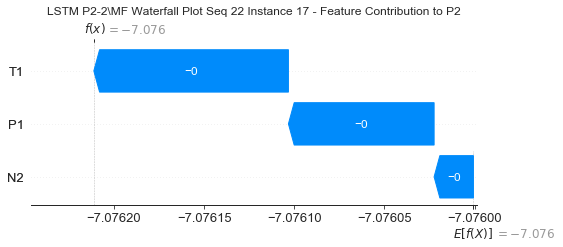

None

Contribution: [-1.04050718e-04 -1.24609786e-04 -2.23714780e-05]


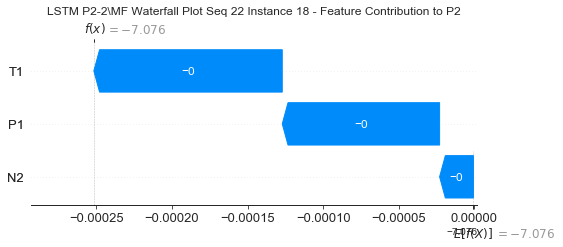

None

Contribution: [-9.59158499e-05 -1.39588026e-04 -2.11917917e-05]


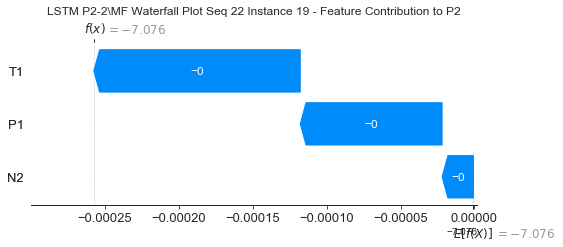

None

Contribution: [-9.59111333e-05 -1.46592126e-04 -2.01455435e-05]


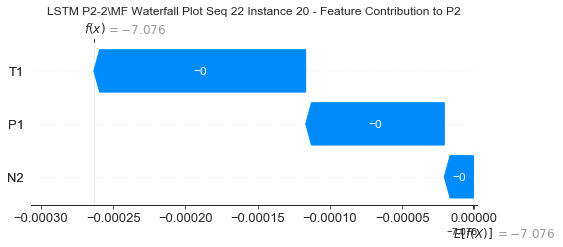

None

Contribution: [-8.70961863e-05 -2.10440443e-04 -2.00212479e-05]


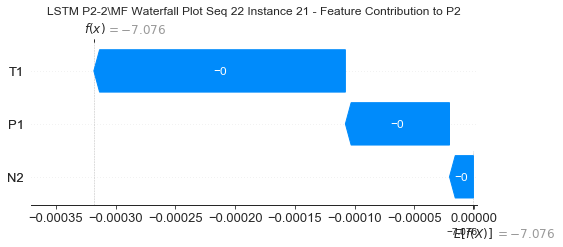

None

Contribution: [-0.00010054 -0.00104613 -0.00010355]


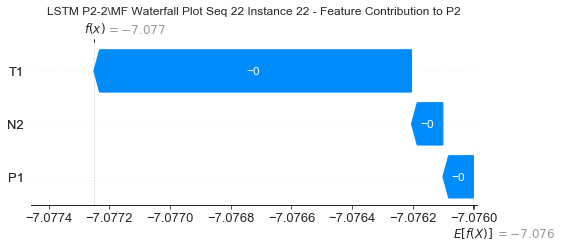

None

Contribution: [ 0.00025086  0.00256852 -0.00215757]


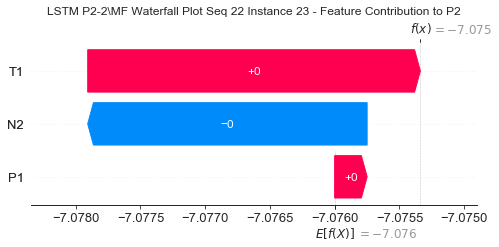

None

Contribution: [ 0.00035693  0.02956133 -0.0154891 ]


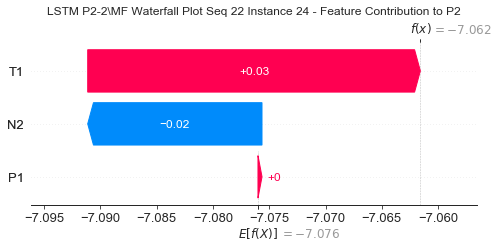

None

Contribution: [-0.03054458 -0.01470519 -0.08550794]


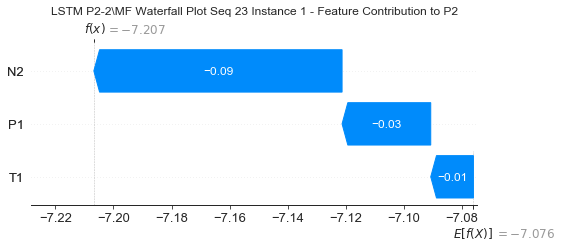

None

Contribution: [ 0.00024482 -0.00062857  0.00061682]


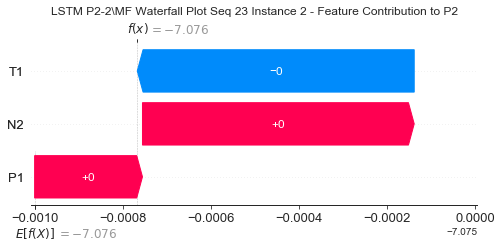

None

Contribution: [-0.00021475  0.00087231 -0.00034844]


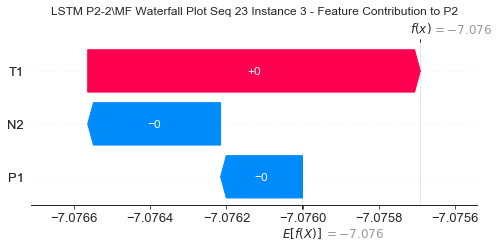

None

Contribution: [-0.00014269  0.00028884 -0.000237  ]


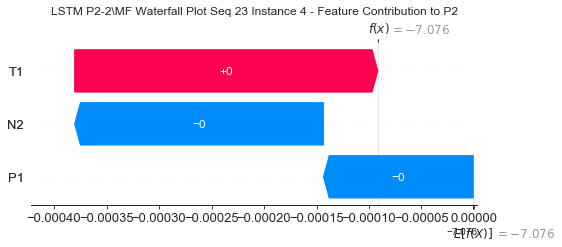

None

Contribution: [-1.08421788e-05  7.63546613e-06 -4.62520603e-05]


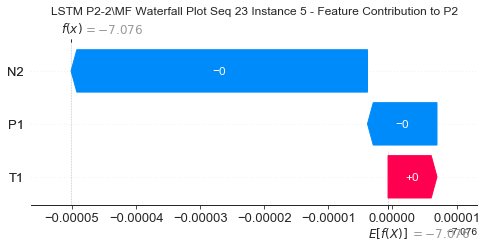

None

Contribution: [-1.20222460e-05  7.59222566e-06 -3.11416776e-05]


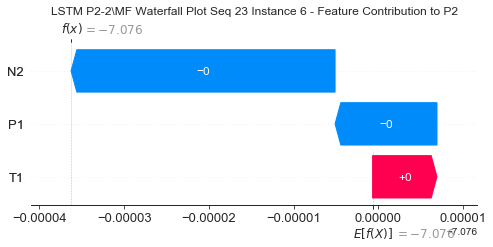

None

Contribution: [-1.45094298e-05  1.16871452e-05 -3.76854641e-05]


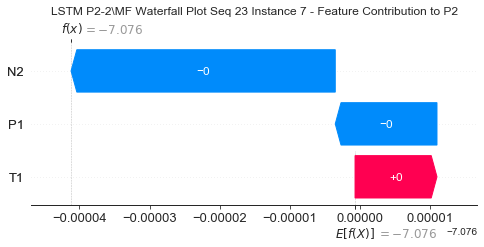

None

Contribution: [-2.18138652e-05  1.33357382e-05 -4.04331462e-05]


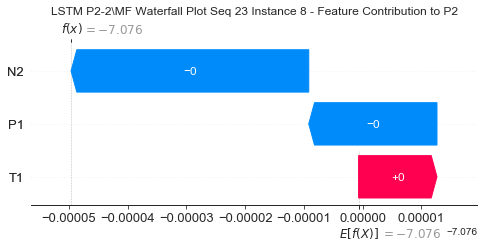

None

Contribution: [-3.58556527e-05 -7.39818076e-07 -1.72409819e-05]


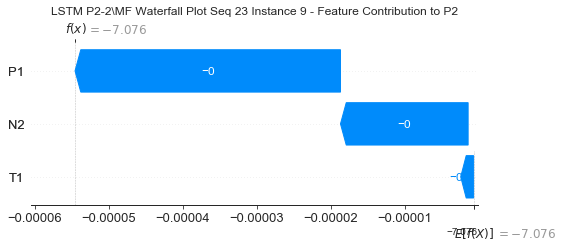

None

Contribution: [-5.49717124e-05 -3.44215720e-05 -2.09820035e-06]


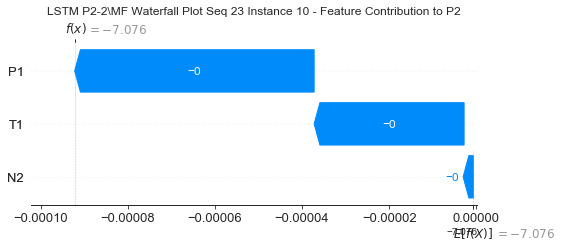

None

Contribution: [-7.32827436e-05 -7.04078409e-05 -1.21201761e-05]


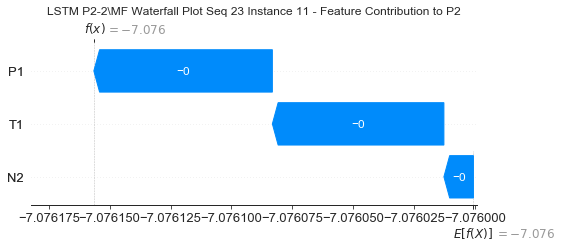

None

Contribution: [-8.11992708e-05 -8.25814586e-05 -1.87859457e-05]


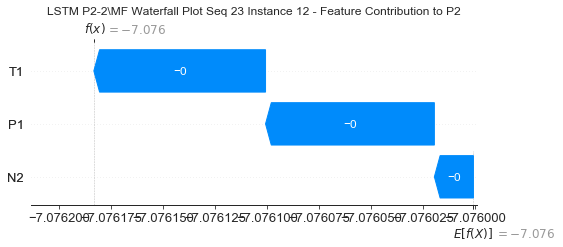

None

Contribution: [-8.81586505e-05 -8.86396585e-05 -1.80981207e-05]


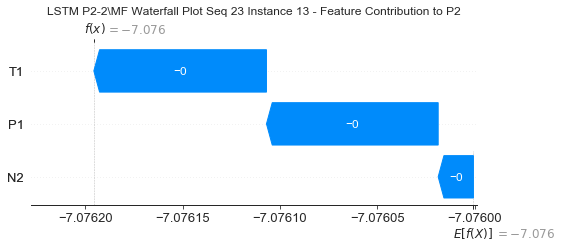

None

Contribution: [-7.65334237e-05 -1.05699312e-04 -1.59527430e-05]


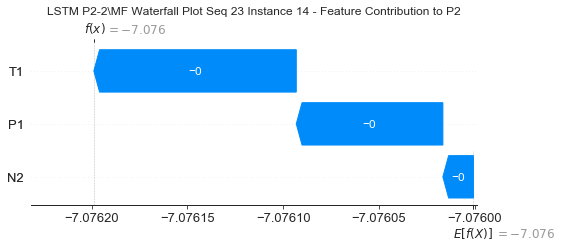

None

Contribution: [-8.79134355e-05 -1.34948335e-04 -1.95635189e-05]


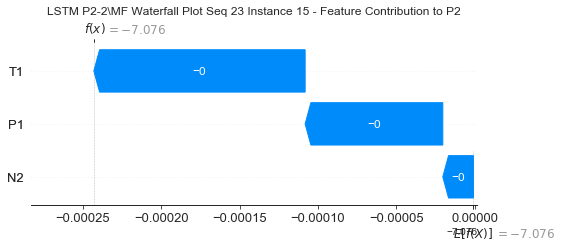

None

Contribution: [-9.10561217e-05 -1.46950488e-04 -1.97477358e-05]


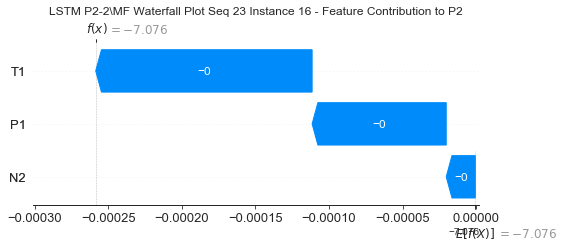

None

Contribution: [-8.40270807e-05 -1.70424308e-04 -2.09512430e-05]


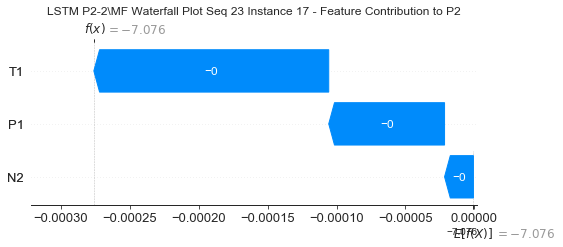

None

Contribution: [-8.99524820e-05 -1.91878034e-04 -2.16572295e-05]


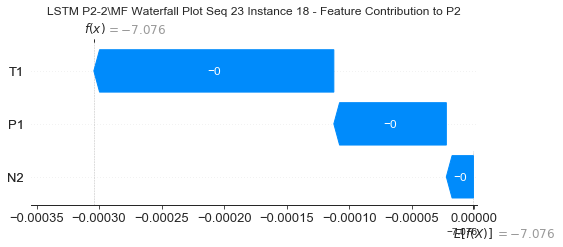

None

Contribution: [-9.80161200e-05 -2.08602365e-04 -1.99971487e-05]


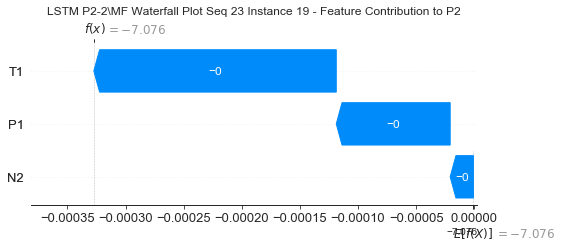

None

Contribution: [-9.93813193e-05 -2.15055930e-04 -1.84083671e-05]


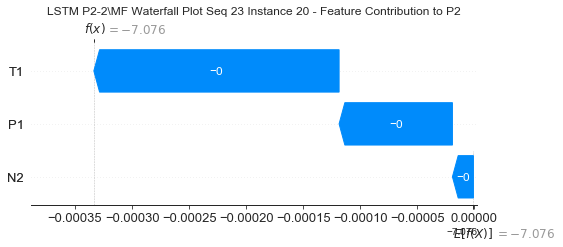

None

Contribution: [-9.62381426e-05 -2.79826880e-04 -1.71219065e-05]


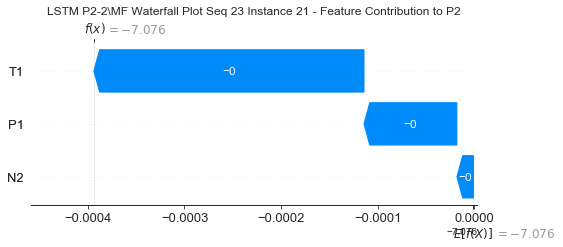

None

Contribution: [-1.26112363e-04 -1.13599728e-03 -9.64792147e-05]


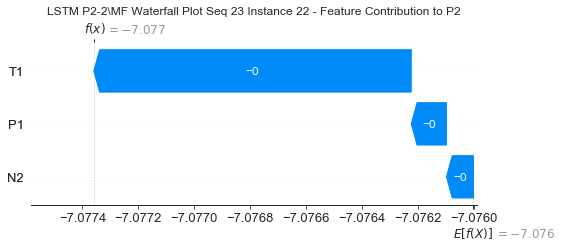

None

Contribution: [ 0.00046509  0.00255242 -0.00225413]


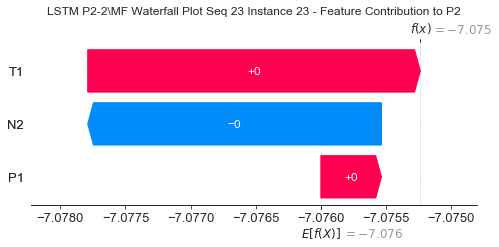

None

Contribution: [ 0.00365928  0.02651615 -0.01699797]


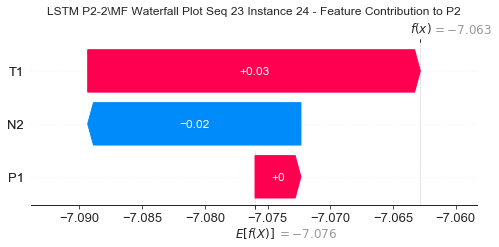

None

Contribution: [-0.03346669 -0.01515823 -0.0843783 ]


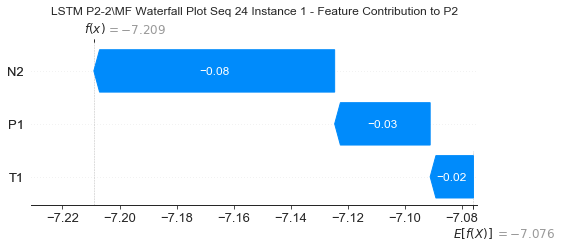

None

Contribution: [ 0.00037733 -0.00063388  0.00061138]


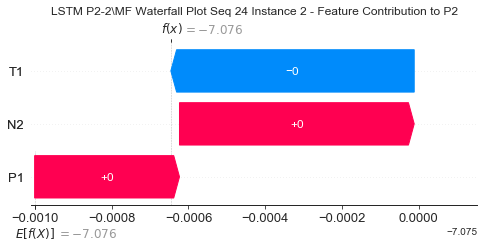

None

Contribution: [-0.0001746   0.00097872 -0.00033208]


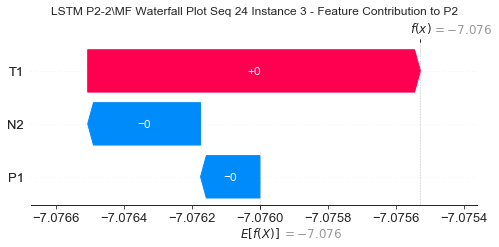

None

Contribution: [-0.00015664  0.0003992  -0.00024571]


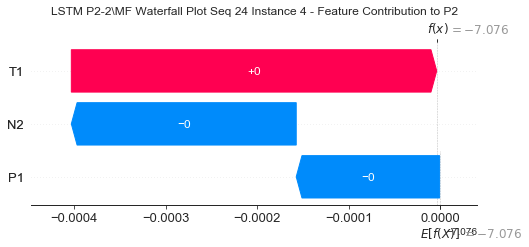

None

Contribution: [-1.12012832e-05  1.24075329e-05 -4.65021040e-05]


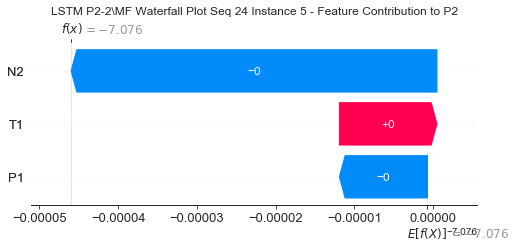

None

Contribution: [-1.10498266e-05  1.09403673e-05 -3.11098059e-05]


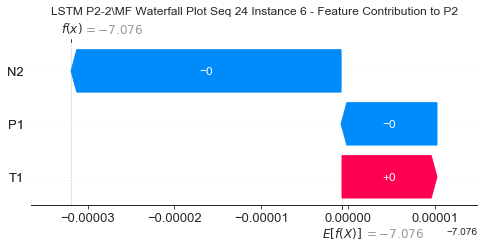

None

Contribution: [-1.45716736e-05  1.37934961e-05 -3.80265464e-05]


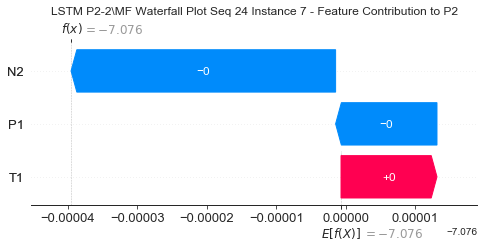

None

Contribution: [-2.10910676e-05  1.69045781e-05 -4.06786191e-05]


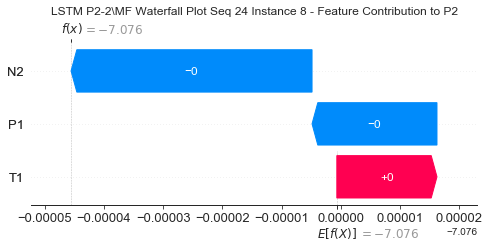

None

Contribution: [-3.41958335e-05  4.22870980e-07 -1.69755040e-05]


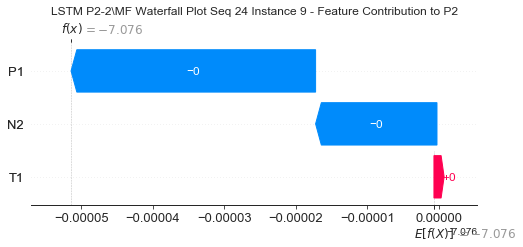

None

Contribution: [-5.47910128e-05 -4.18365916e-05 -2.11533313e-06]


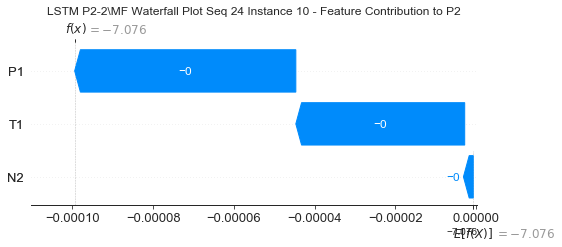

None

Contribution: [-7.53890456e-05 -7.30288662e-05 -1.23195039e-05]


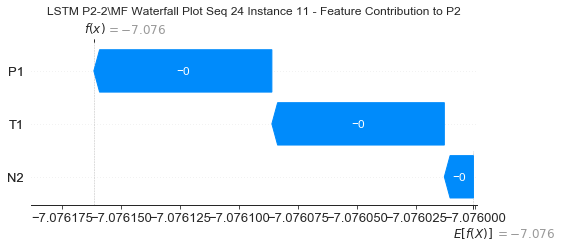

None

Contribution: [-8.28421055e-05 -8.48177472e-05 -1.84370902e-05]


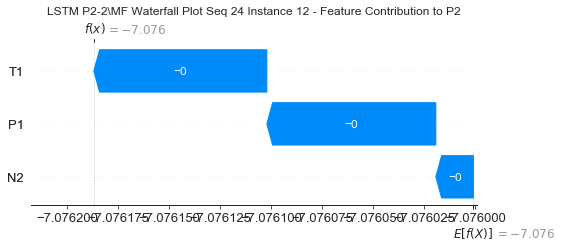

None

Contribution: [-8.66718120e-05 -8.90047903e-05 -1.81484170e-05]


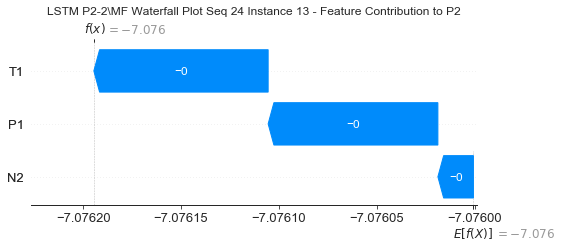

None

Contribution: [-8.02112101e-05 -1.07567235e-04 -1.49560027e-05]


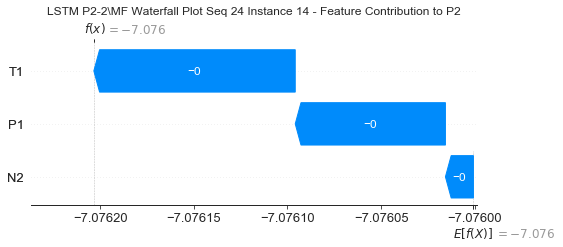

None

Contribution: [-8.78759014e-05 -1.32797448e-04 -1.58479002e-05]


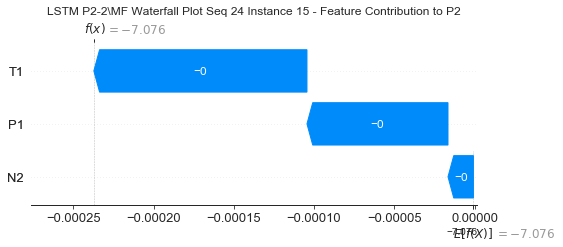

None

Contribution: [-9.36514190e-05 -1.46519221e-04 -1.81771613e-05]


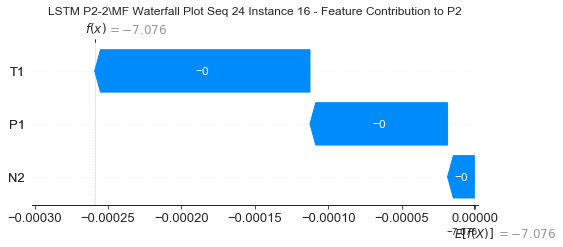

None

Contribution: [-8.53878668e-05 -1.68271616e-04 -2.04017701e-05]


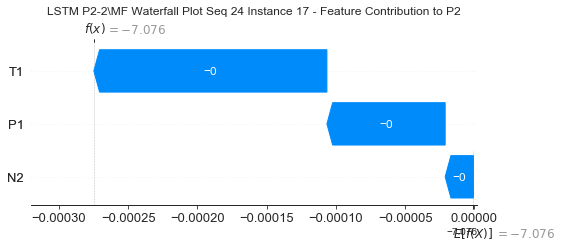

None

Contribution: [-9.92772630e-05 -1.79787338e-04 -2.29524160e-05]


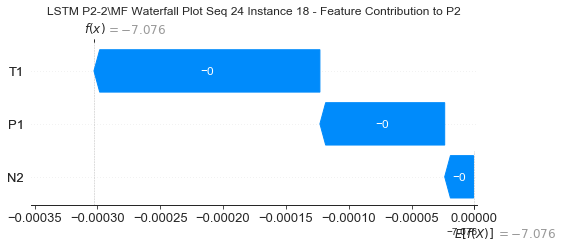

None

Contribution: [-1.00285620e-04 -2.01823968e-04 -1.91306291e-05]


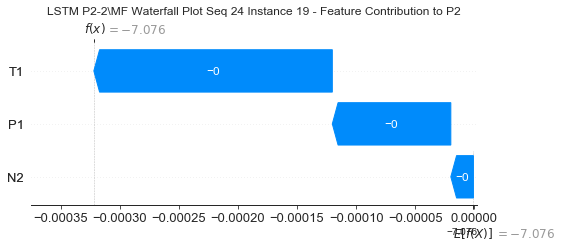

None

Contribution: [-1.00849768e-04 -2.06050435e-04 -1.83879168e-05]


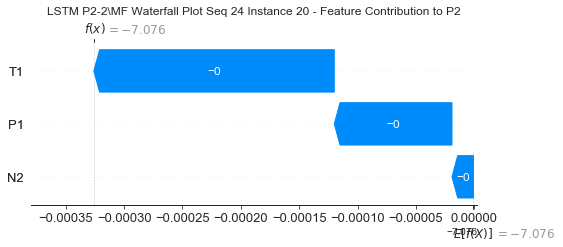

None

Contribution: [-1.01709359e-04 -2.57032663e-04 -1.65679719e-05]


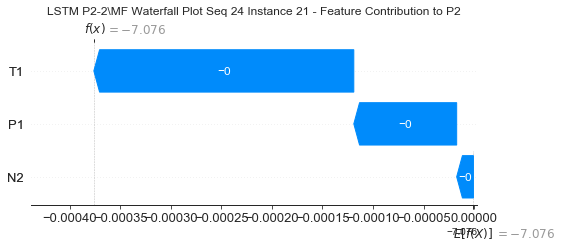

None

Contribution: [-0.00014208 -0.0009697  -0.00010104]


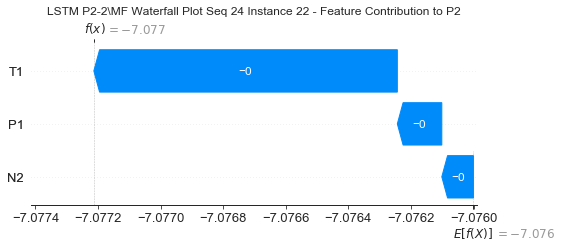

None

Contribution: [ 0.00051813  0.0019291  -0.00225271]


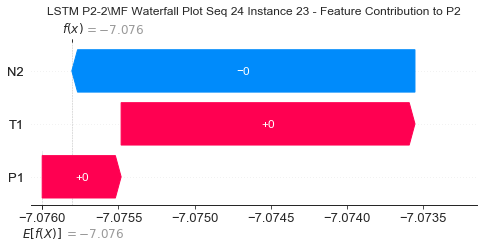

None

Contribution: [ 0.00134666  0.02490263 -0.01591287]


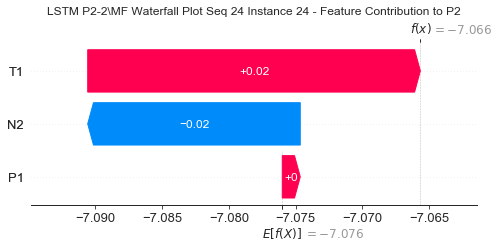

None

Contribution: [-0.01544163 -0.01155066 -0.07504597]


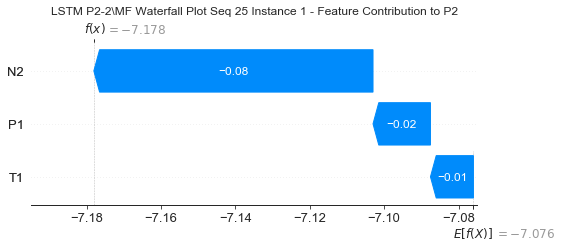

None

Contribution: [ 0.00018981 -0.00052154  0.00054707]


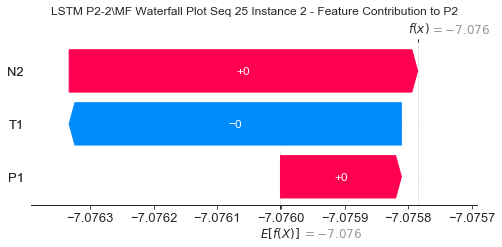

None

Contribution: [-0.0001887   0.00104753 -0.00037644]


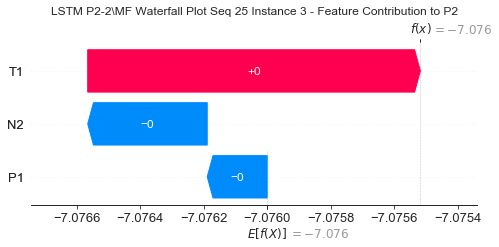

None

Contribution: [-0.00019033  0.00052131 -0.00025837]


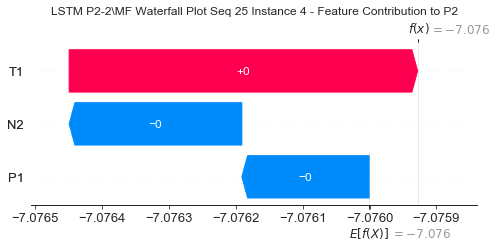

None

Contribution: [-1.34516884e-05  5.34125598e-05 -4.73106639e-05]


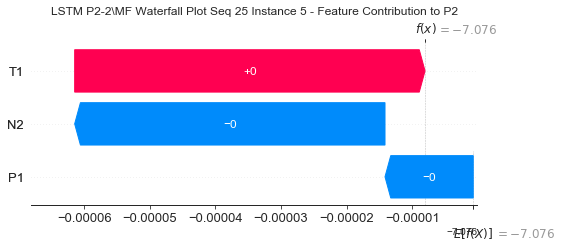

None

Contribution: [-6.64598520e-06  2.70298476e-05 -2.98971223e-05]


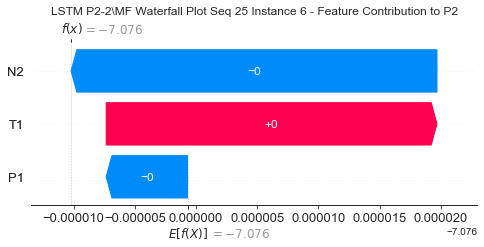

None

Contribution: [-1.43241259e-05  2.59361349e-05 -3.76169703e-05]


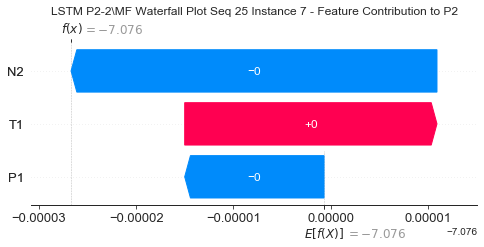

None

Contribution: [-2.06317057e-05  2.86703835e-05 -3.94137873e-05]


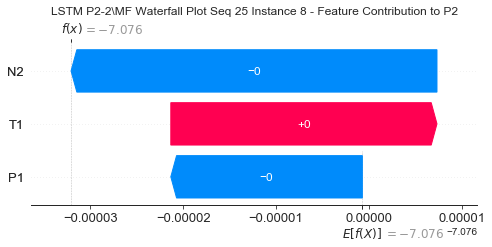

None

Contribution: [-3.41087498e-05  2.11782519e-05 -1.60035444e-05]


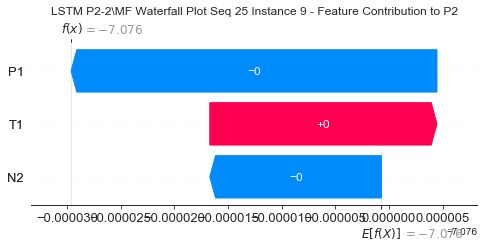

None

Contribution: [-5.65250333e-05 -6.58182645e-06 -3.06765062e-06]


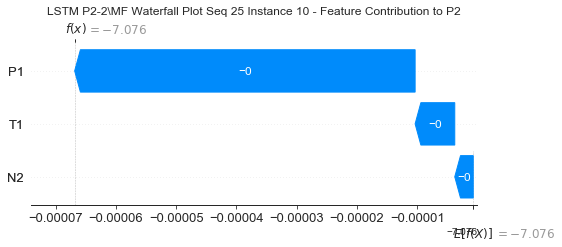

None

Contribution: [-7.04687567e-05 -2.92950478e-05 -1.33448072e-05]


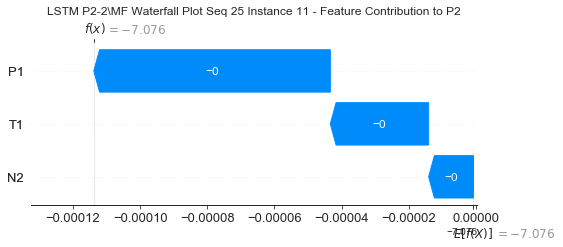

None

Contribution: [-7.67408488e-05 -2.73070160e-05 -1.91450485e-05]


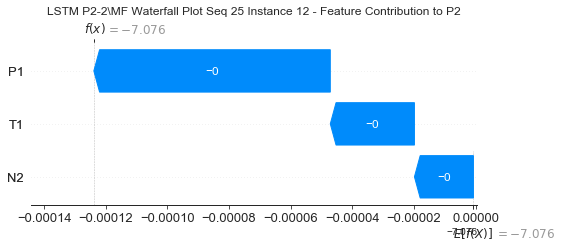

None

Contribution: [-7.23356360e-05 -2.79537210e-05 -1.67104462e-05]


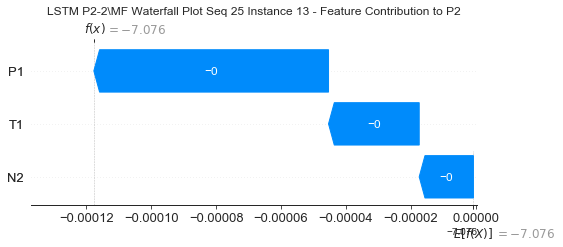

None

Contribution: [-7.00693208e-05 -3.70912590e-05 -1.58798679e-05]


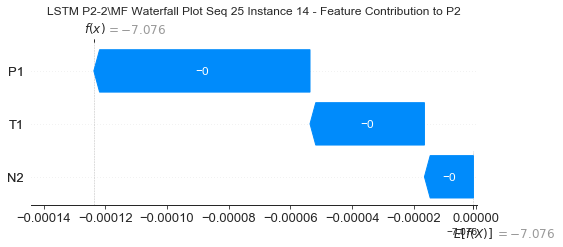

None

Contribution: [-9.53247305e-05 -5.54943801e-05 -1.84868846e-05]


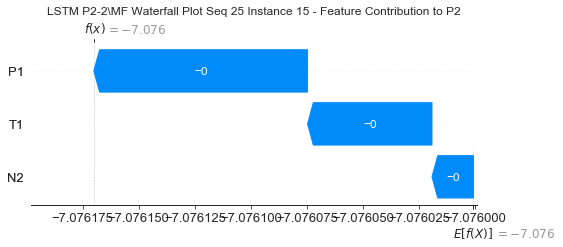

None

Contribution: [-8.33578570e-05 -6.60821400e-05 -1.90902687e-05]


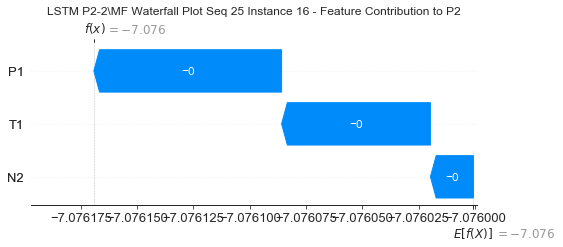

None

Contribution: [-7.76700011e-05 -8.36393463e-05 -2.07066106e-05]


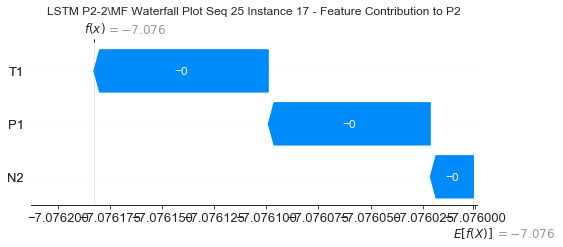

None

Contribution: [-1.00251717e-04 -9.92004058e-05 -2.11633176e-05]


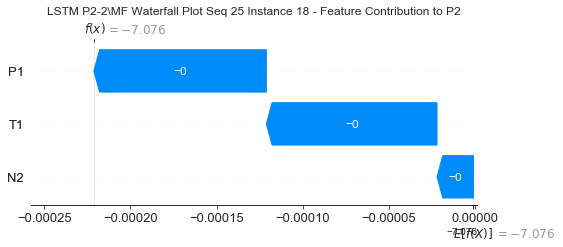

None

Contribution: [-9.61824818e-05 -1.11397082e-04 -1.90450252e-05]


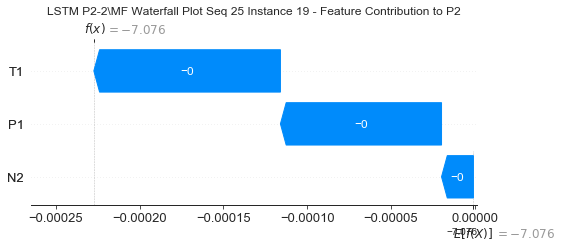

None

Contribution: [-9.88359886e-05 -1.16703641e-04 -1.83974534e-05]


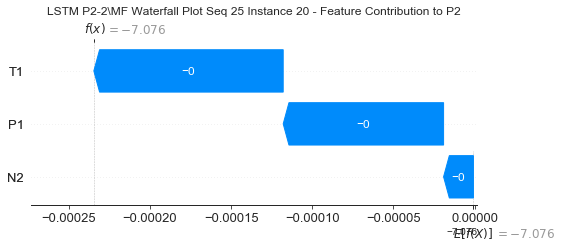

None

Contribution: [-9.70014241e-05 -1.63136455e-04 -1.63615219e-05]


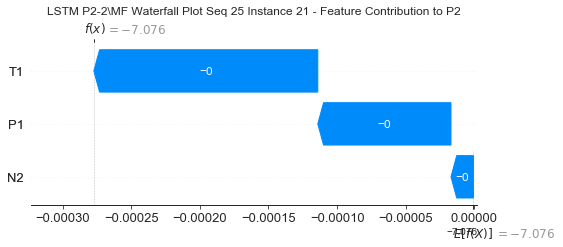

None

Contribution: [-1.28023769e-04 -8.01951136e-04 -9.05232724e-05]


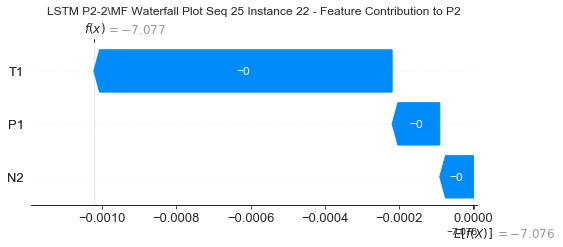

None

Contribution: [ 0.00044885  0.00133796 -0.00226584]


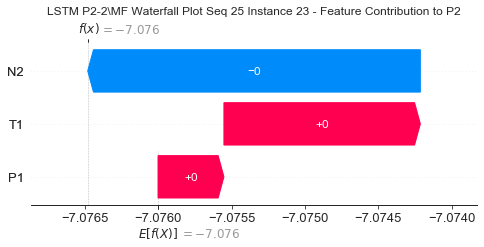

None

Contribution: [ 0.00262979  0.01557503 -0.01716369]


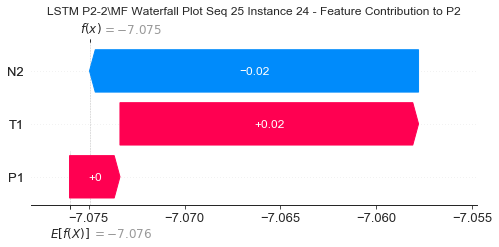

None

Contribution: [-0.03219574 -0.01157612 -0.08529402]


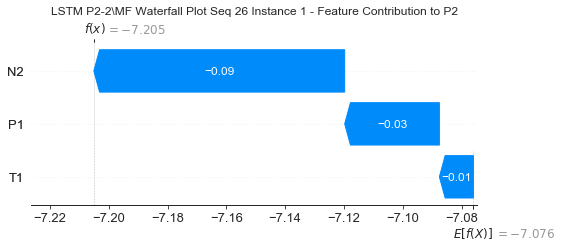

None

Contribution: [ 0.00034878 -0.00060536  0.00066686]


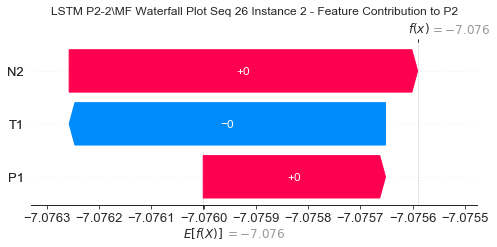

None

Contribution: [-0.00016461  0.00012938 -0.00035506]


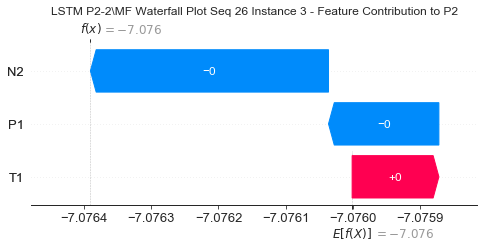

None

Contribution: [-8.02617115e-05  5.31617035e-05 -2.38153581e-04]


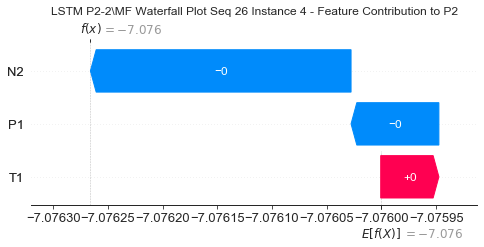

None

Contribution: [-8.67397264e-06 -2.14106391e-05 -4.63245675e-05]


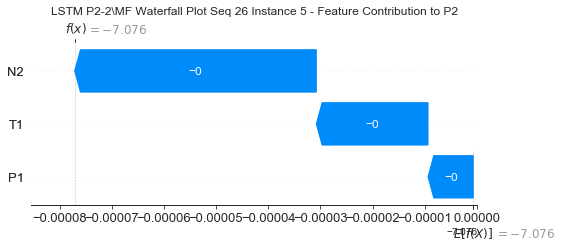

None

Contribution: [-9.69091746e-06 -2.64584194e-06 -3.06591114e-05]


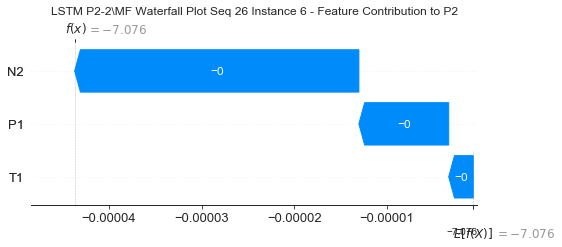

None

Contribution: [-1.38342453e-05  8.87241480e-07 -3.73632965e-05]


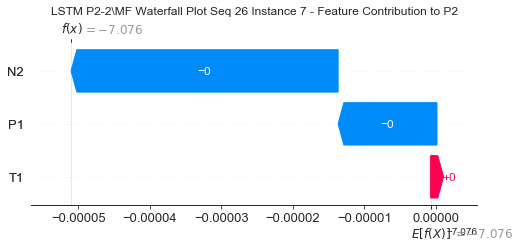

None

Contribution: [-2.06953230e-05  2.80110655e-06 -4.03540993e-05]


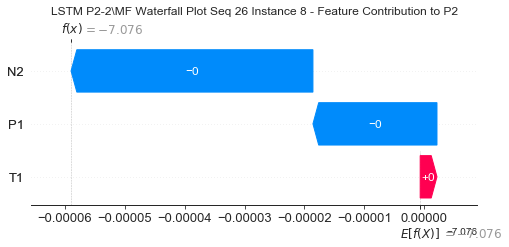

None

Contribution: [-3.81976520e-05 -8.35554649e-06 -1.71338602e-05]


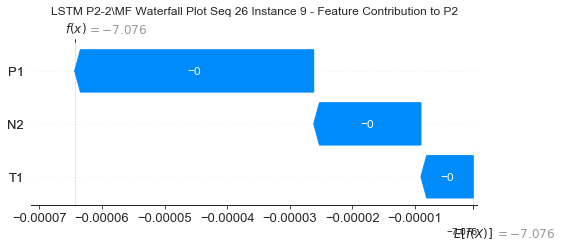

None

Contribution: [-5.63754605e-05 -3.99845300e-05 -1.82701637e-06]


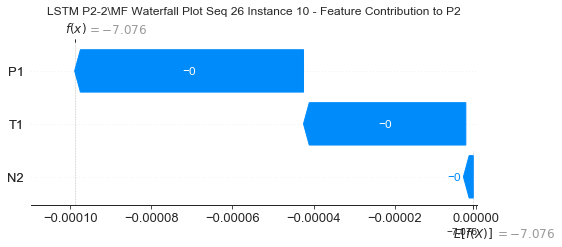

None

Contribution: [-6.94040002e-05 -7.73554911e-05 -1.20482242e-05]


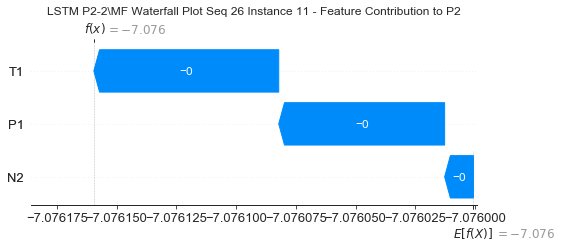

None

Contribution: [-7.59633573e-05 -9.51711514e-05 -1.84160027e-05]


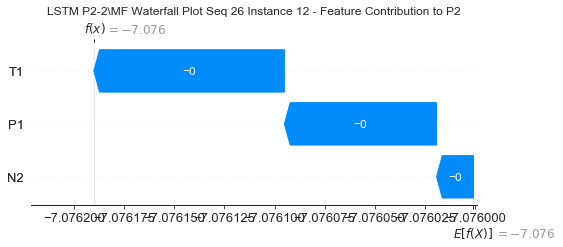

None

Contribution: [-8.74794965e-05 -9.80153821e-05 -1.79704874e-05]


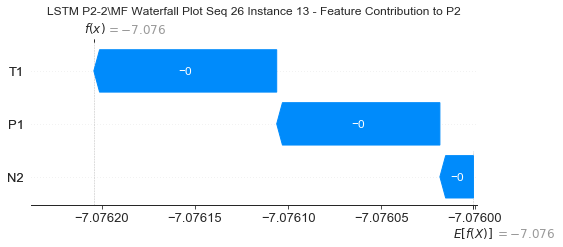

None

Contribution: [-7.31109667e-05 -1.23534943e-04 -1.46521177e-05]


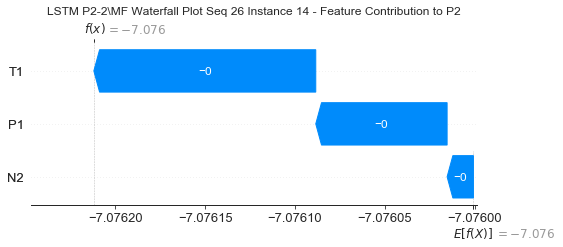

None

Contribution: [-8.65367274e-05 -1.49546415e-04 -1.87481132e-05]


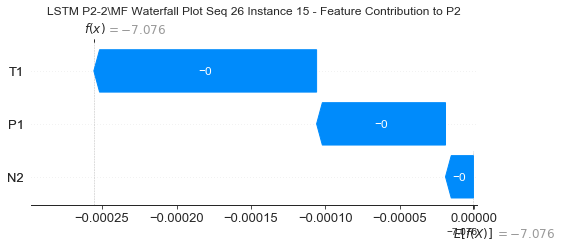

None

Contribution: [-8.68555507e-05 -1.66480561e-04 -1.84868130e-05]


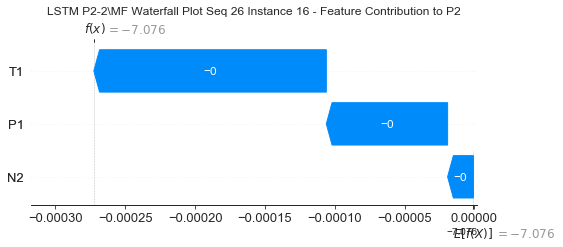

None

Contribution: [-8.22407841e-05 -1.91097921e-04 -2.00995333e-05]


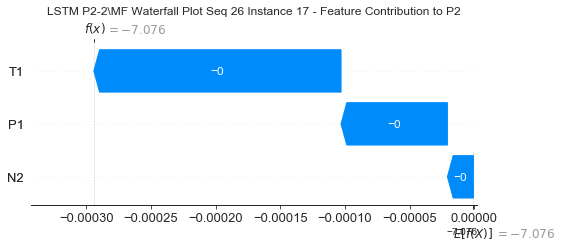

None

Contribution: [-9.20168417e-05 -2.05556332e-04 -2.18433832e-05]


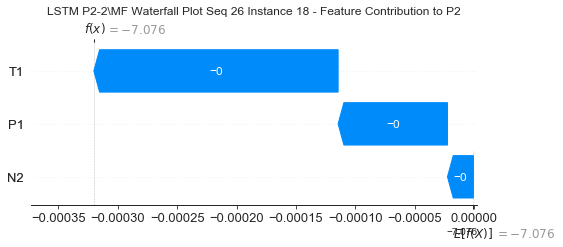

None

Contribution: [-9.40788560e-05 -2.24403431e-04 -1.90323542e-05]


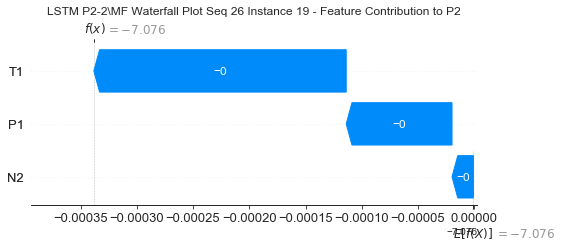

None

Contribution: [-9.64173218e-05 -2.30131144e-04 -1.75182606e-05]


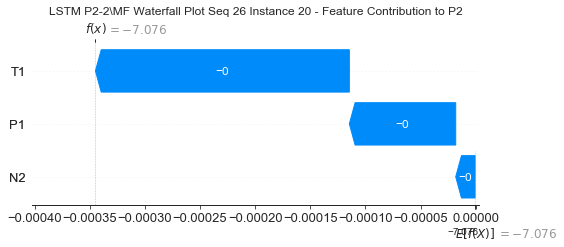

None

Contribution: [-9.41600885e-05 -2.82026814e-04 -1.58162314e-05]


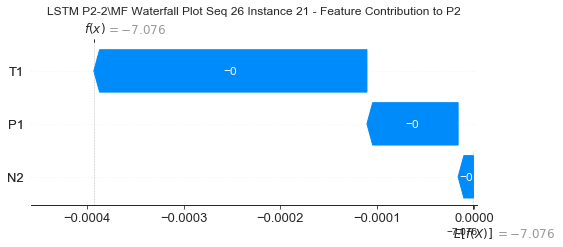

None

Contribution: [-1.33764971e-04 -1.02987712e-03 -9.79170146e-05]


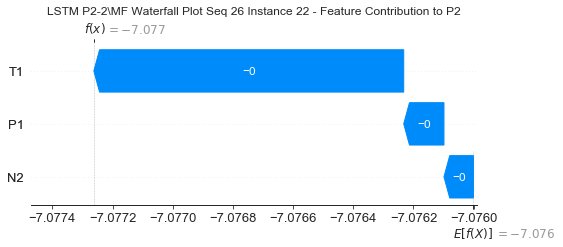

None

Contribution: [ 0.00052802  0.00179905 -0.00229665]


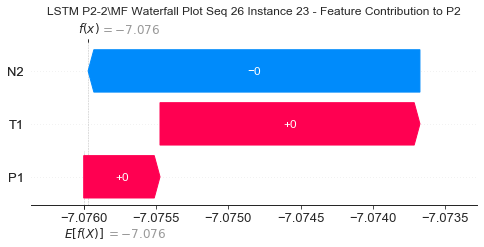

None

Contribution: [ 0.00269165  0.0187588  -0.01709377]


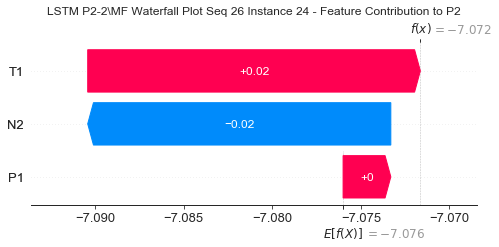

None

Contribution: [-0.02105699 -0.01307736 -0.07873823]


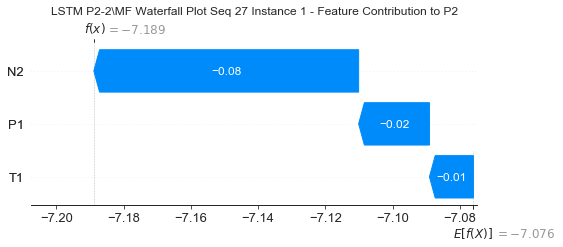

None

Contribution: [ 0.00012666 -0.00055652  0.0005625 ]


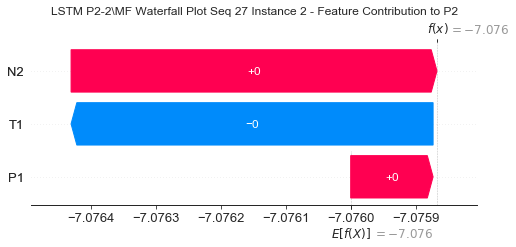

None

Contribution: [-0.00016242  0.00066537 -0.00038019]


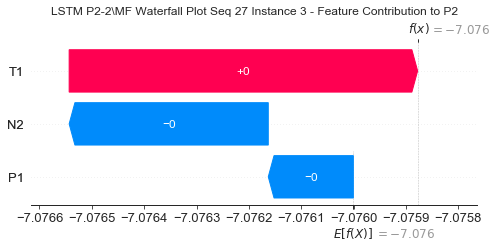

None

Contribution: [-0.00014734  0.00035425 -0.000231  ]


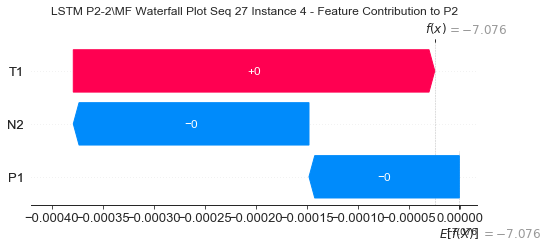

None

Contribution: [-1.13841507e-05  2.92906930e-05 -4.56648701e-05]


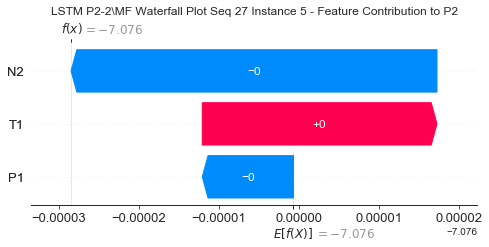

None

Contribution: [-9.69329655e-06  1.58533880e-05 -3.03444859e-05]


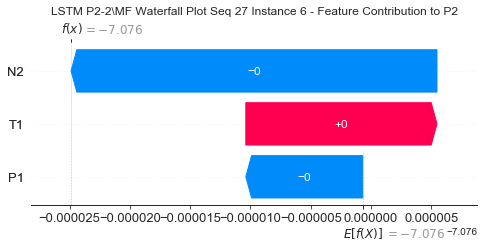

None

Contribution: [-1.36781180e-05  1.81826230e-05 -3.67551648e-05]


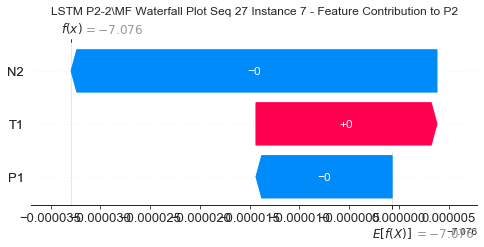

None

Contribution: [-1.97067165e-05  2.21958198e-05 -3.89122353e-05]


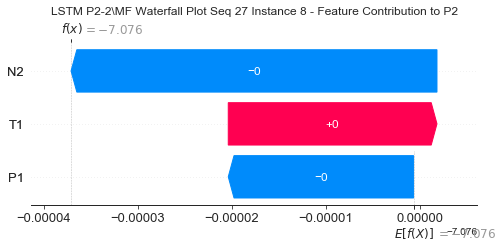

None

Contribution: [-2.92846191e-05  1.86947647e-05 -1.44125298e-05]


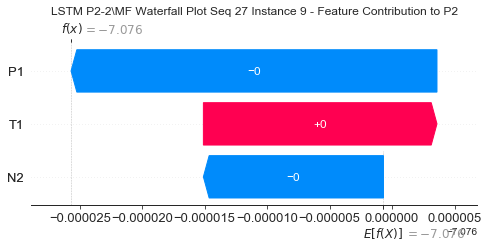

None

Contribution: [-4.67340667e-05 -1.72671982e-05 -3.50297744e-06]


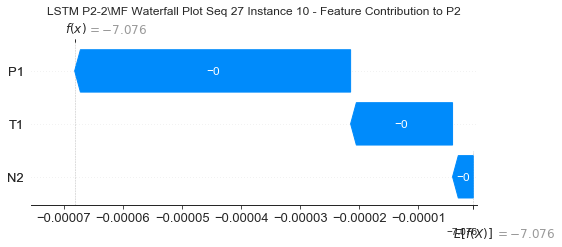

None

Contribution: [-7.36725862e-05 -4.01527055e-05 -1.41932801e-05]


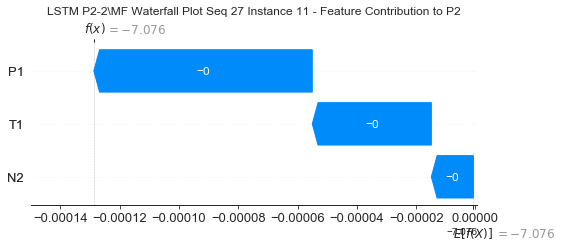

None

Contribution: [-8.05220115e-05 -4.43841673e-05 -1.96581576e-05]


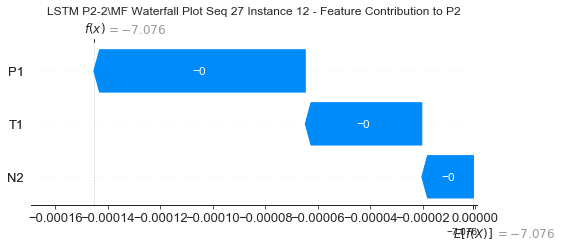

None

Contribution: [-7.86458534e-05 -4.81248590e-05 -1.82252766e-05]


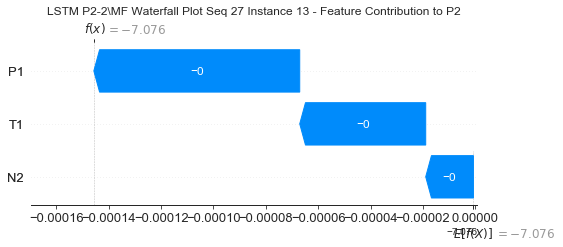

None

Contribution: [-7.18526151e-05 -6.01341763e-05 -1.66192761e-05]


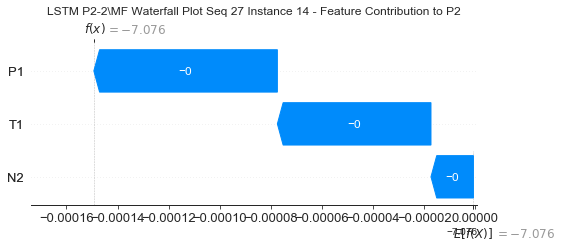

None

Contribution: [-8.52093836e-05 -8.08984393e-05 -1.88691428e-05]


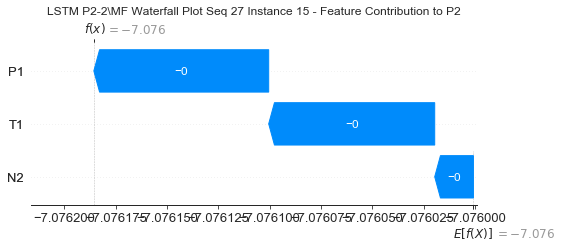

None

Contribution: [-8.53447791e-05 -9.18795985e-05 -2.02512671e-05]


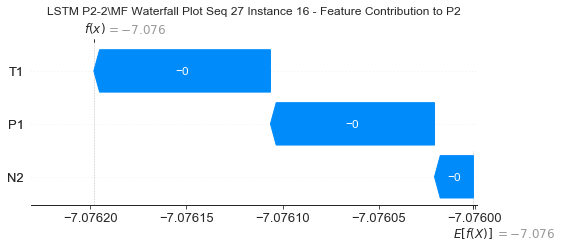

None

Contribution: [-7.60194205e-05 -1.10621431e-04 -2.17280287e-05]


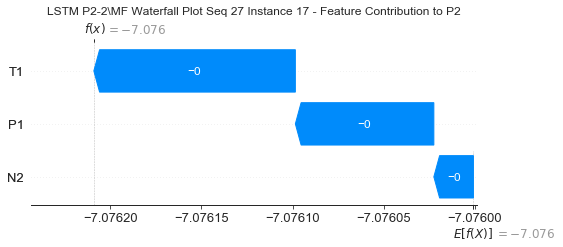

None

Contribution: [-9.70952755e-05 -1.23876101e-04 -2.18217770e-05]


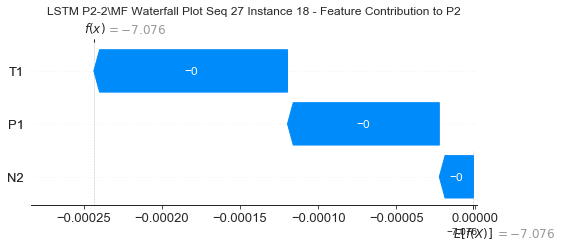

None

Contribution: [-8.47141406e-05 -1.39417494e-04 -2.11330106e-05]


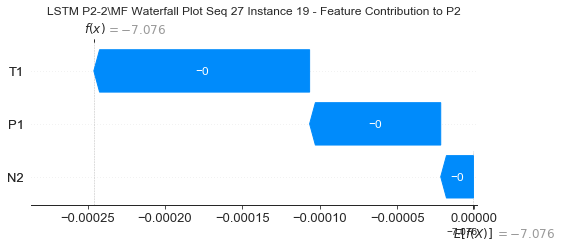

None

Contribution: [-8.50895987e-05 -1.44765983e-04 -2.10198753e-05]


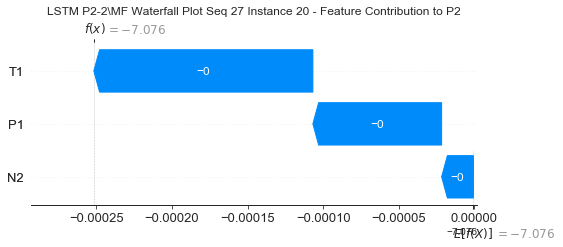

None

Contribution: [-7.50201939e-05 -1.94197919e-04 -2.29038406e-05]


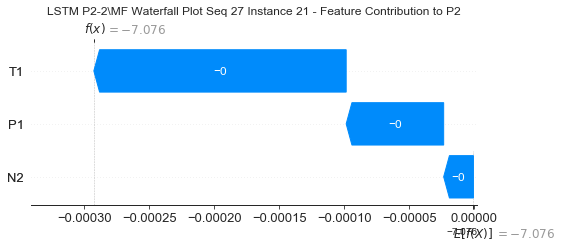

None

Contribution: [-6.22028902e-05 -8.77885427e-04 -1.29727996e-04]


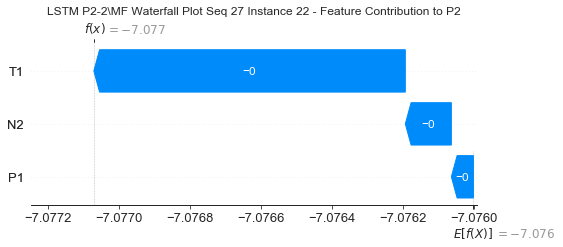

None

Contribution: [ 0.00012942  0.00165199 -0.00205265]


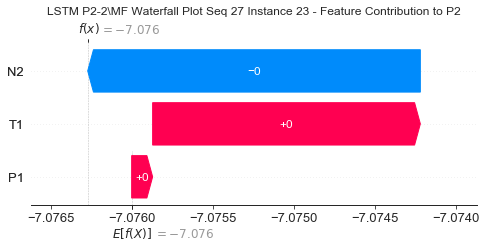

None

Contribution: [ 0.00274822  0.0180259  -0.01606756]


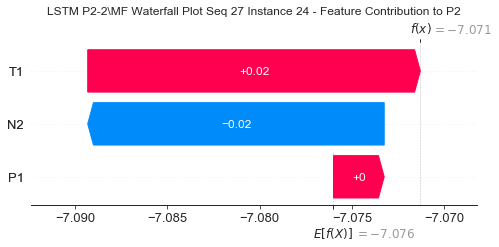

None

Contribution: [-0.04153042 -0.01294232 -0.08267145]


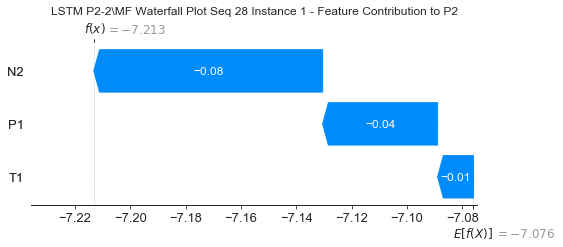

None

Contribution: [ 0.00054443 -0.00060672  0.00064325]


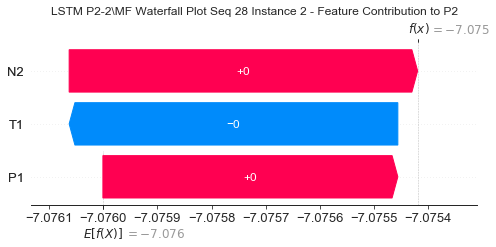

None

Contribution: [-0.00019127  0.00011378 -0.00034799]


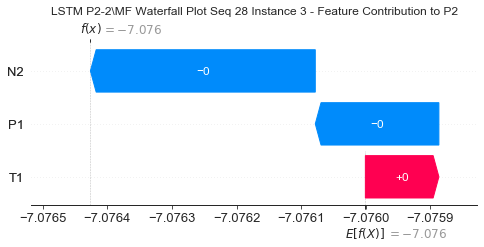

None

Contribution: [-0.00016298 -0.00014672 -0.00025114]


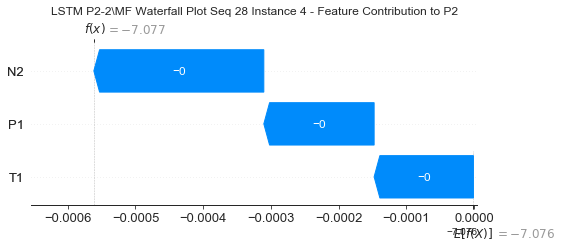

None

Contribution: [-1.00910953e-05 -3.50872376e-05 -4.60536175e-05]


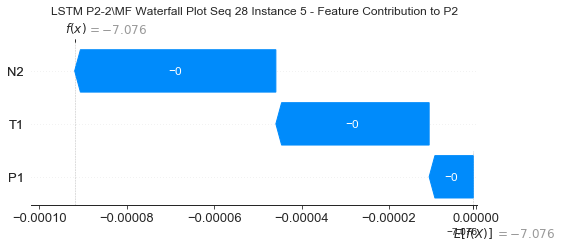

None

Contribution: [-1.19208819e-05 -1.00002333e-05 -3.07425121e-05]


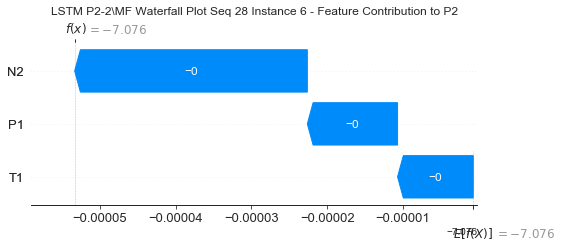

None

Contribution: [-1.47566591e-05 -1.69307114e-06 -3.72635524e-05]


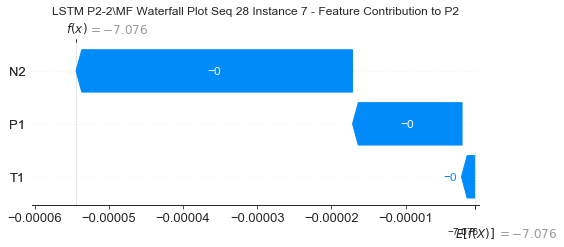

None

Contribution: [-2.10521069e-05  2.60318195e-06 -3.98917055e-05]


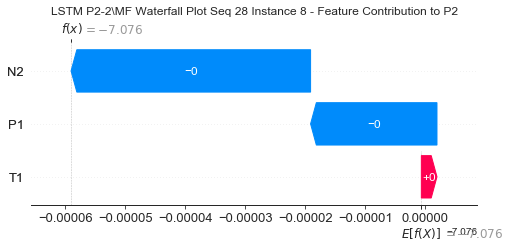

None

Contribution: [-3.50389733e-05 -8.69010849e-06 -1.70730553e-05]


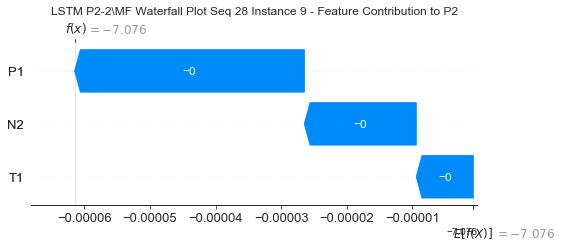

None

Contribution: [-5.08475568e-05 -4.59953006e-05 -1.95409535e-06]


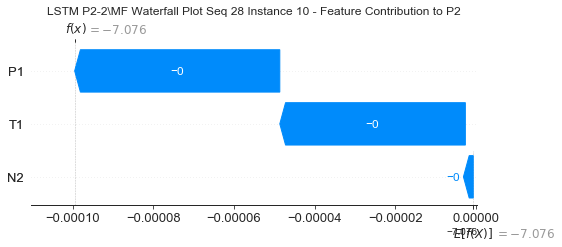

None

Contribution: [-7.70388995e-05 -7.75226135e-05 -1.19775763e-05]


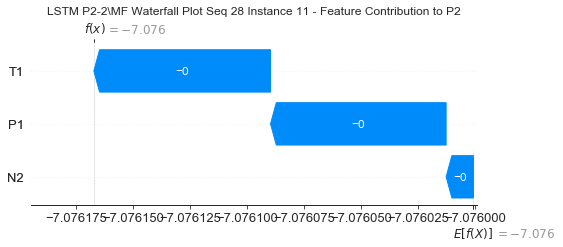

None

Contribution: [-8.84846768e-05 -1.01775682e-04 -1.84754677e-05]


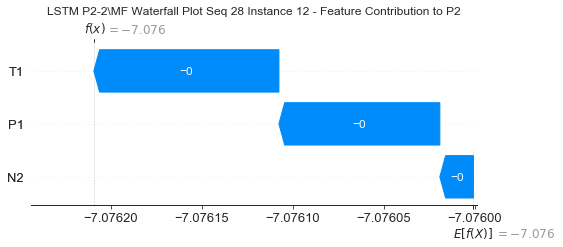

None

Contribution: [-7.15988112e-05 -1.12374210e-04 -1.92484267e-05]


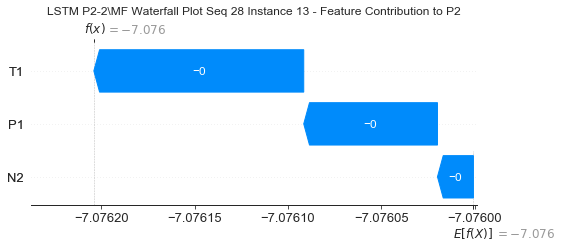

None

Contribution: [-9.42095631e-05 -1.45435140e-04 -1.30395799e-05]


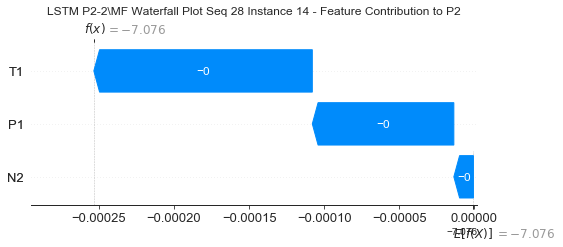

None

Contribution: [-8.48443042e-05 -1.87357670e-04 -1.71720990e-05]


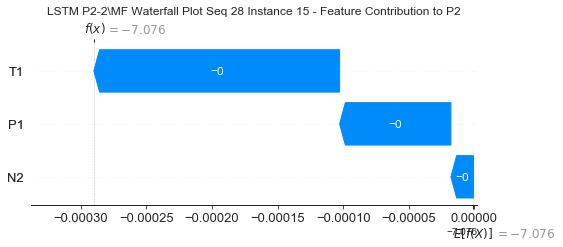

None

Contribution: [-1.15726583e-04 -2.11320729e-04 -1.60437140e-05]


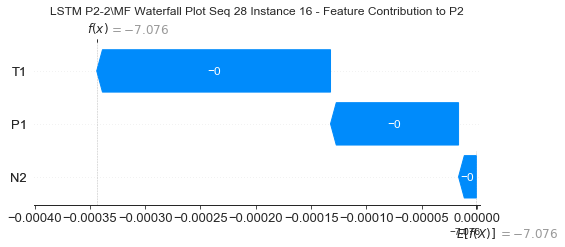

None

Contribution: [-1.10716796e-04 -2.58754930e-04 -1.71540203e-05]


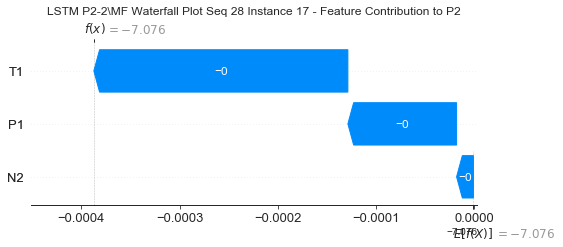

None

Contribution: [-7.22225540e-05 -2.35300023e-04 -2.85809836e-05]


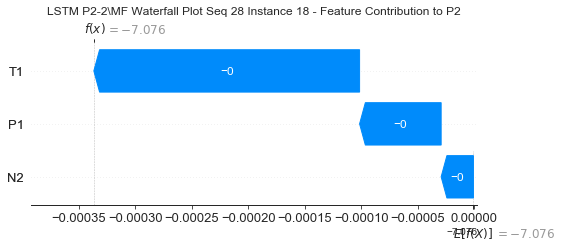

None

Contribution: [-1.49226333e-04 -3.41089519e-04 -8.07294757e-06]


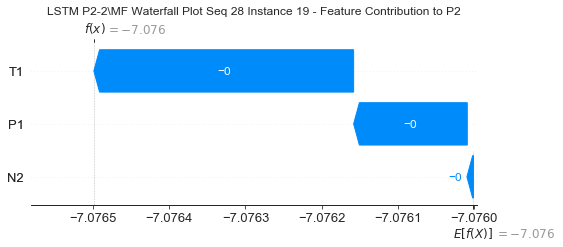

None

Contribution: [-1.54288188e-04 -3.58301587e-04 -9.93902981e-06]


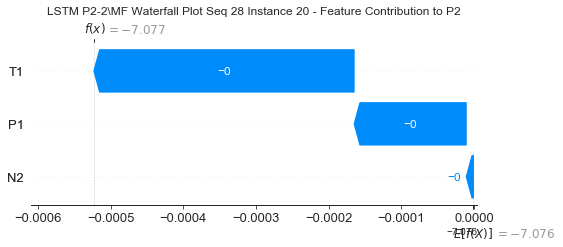

None

Contribution: [-1.84093636e-04 -5.12415312e-04 -3.17259427e-06]


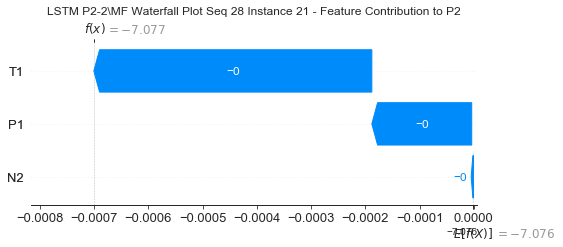

None

Contribution: [-3.70735723e-04 -2.09201093e-03 -6.71808704e-05]


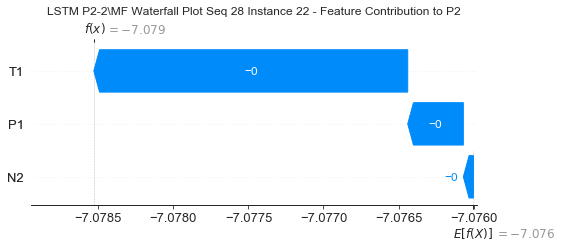

None

Contribution: [ 0.00161029  0.00678333 -0.00260345]


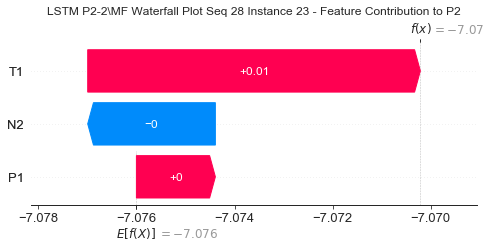

None

Contribution: [ 0.01036557  0.06551195 -0.02002121]


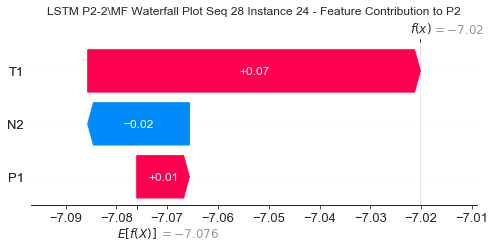

None

Contribution: [-0.07925415 -0.03290284 -0.08833742]


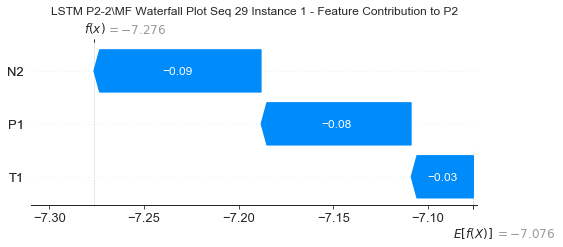

None

Contribution: [ 0.00208027 -0.0010023   0.00092828]


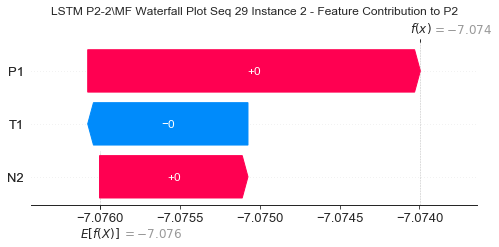

None

Contribution: [-0.00053933  0.00222363 -0.00045643]


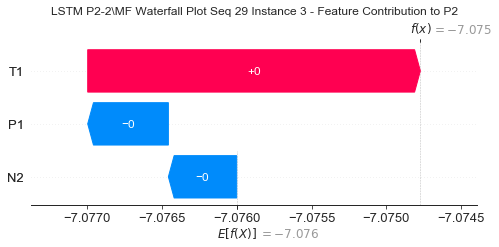

None

Contribution: [-0.00054747  0.00104812 -0.00029636]


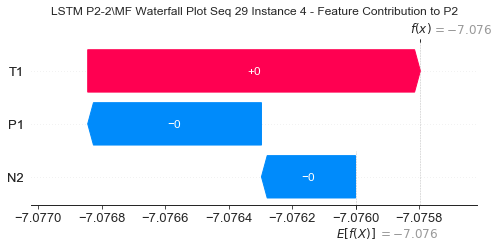

None

Contribution: [-1.91929869e-05  3.11180713e-05 -4.86180543e-05]


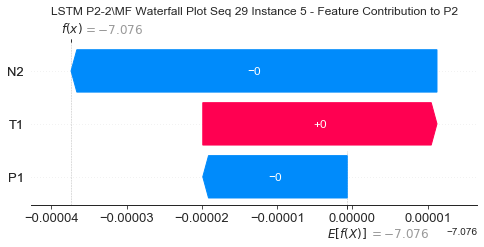

None

Contribution: [-1.26505031e-05  2.56220592e-05 -3.27988168e-05]


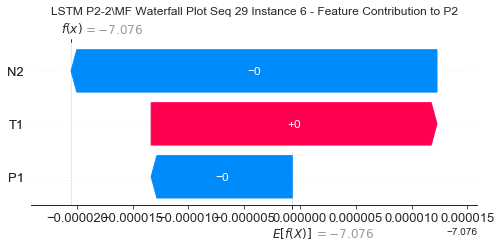

None

Contribution: [-2.00975587e-05  3.35453707e-05 -4.39361258e-05]


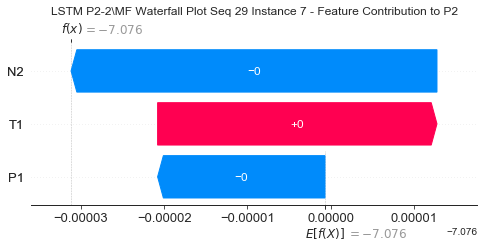

None

Contribution: [-2.52946069e-05  3.81634248e-05 -4.62651754e-05]


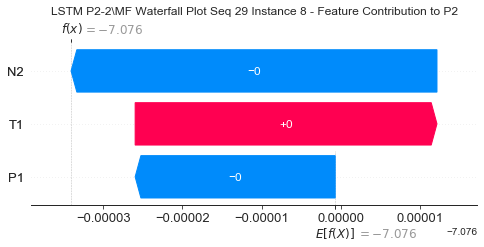

None

Contribution: [-5.05525896e-05 -9.30281688e-06 -2.30601574e-05]


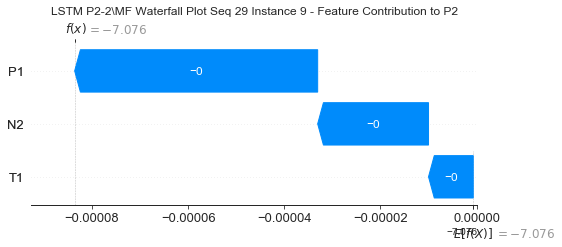

None

Contribution: [-9.01080045e-05 -1.14162041e-04 -1.71396770e-06]


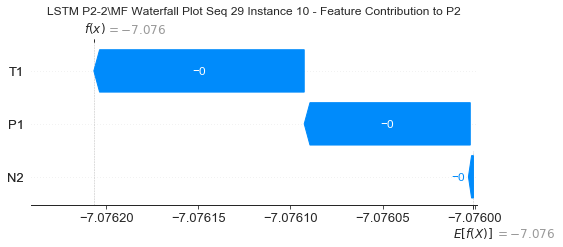

None

Contribution: [-1.14066711e-04 -1.91588086e-04 -6.89194285e-06]


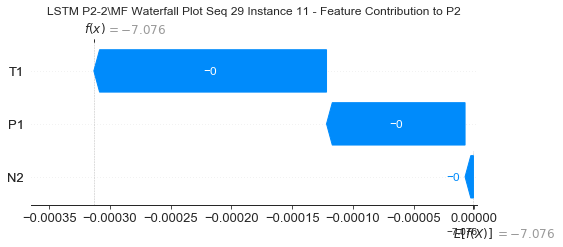

None

Contribution: [-1.22484269e-04 -2.06651514e-04 -1.49531229e-05]


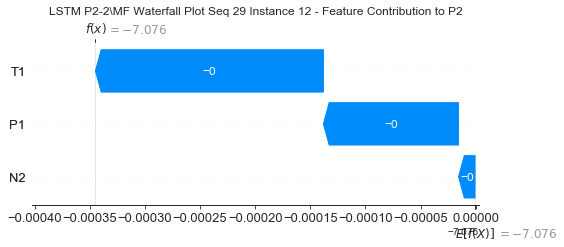

None

Contribution: [-1.39978995e-04 -2.28262430e-04 -1.12922347e-05]


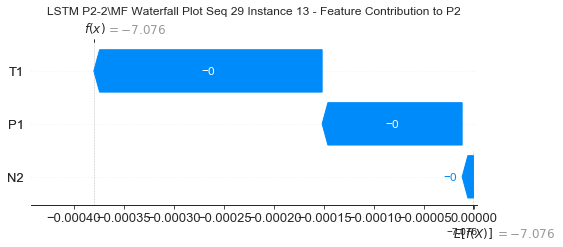

None

Contribution: [-1.21735856e-04 -2.36593300e-04 -1.22338046e-05]


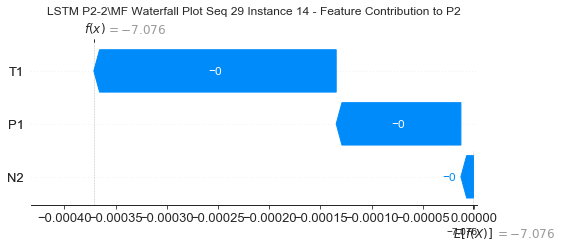

None

Contribution: [-1.03768639e-04 -2.35429376e-04 -2.30625810e-05]


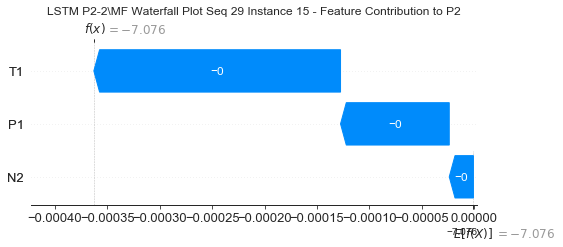

None

Contribution: [-1.21534774e-04 -2.92752758e-04 -1.32404783e-05]


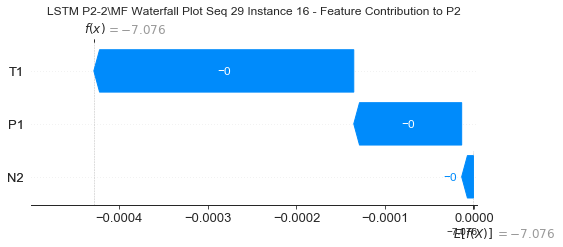

None

Contribution: [-1.08840156e-04 -3.12722186e-04 -1.70028499e-05]


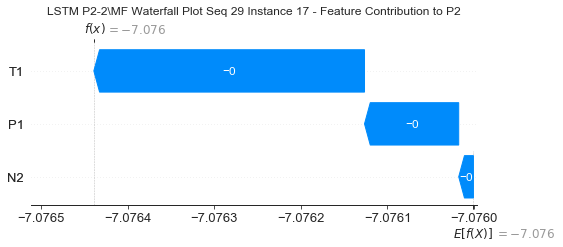

None

Contribution: [-6.37173804e-05 -2.95039427e-04 -2.79889185e-05]


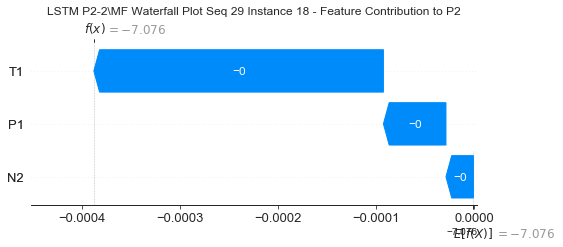

None

Contribution: [-8.96666605e-05 -3.38856128e-04 -1.56566935e-05]


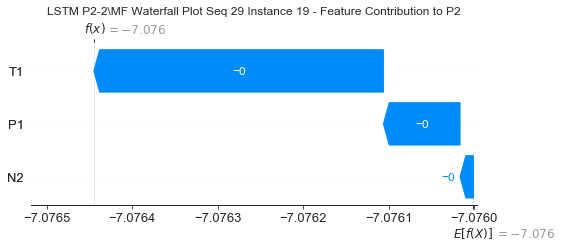

None

Contribution: [-8.91244290e-05 -3.35970990e-04 -1.38509215e-05]


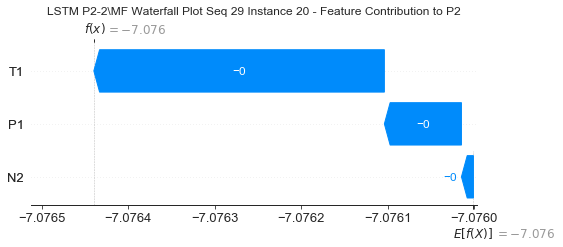

None

Contribution: [-8.47790151e-05 -3.93685576e-04 -9.51687201e-06]


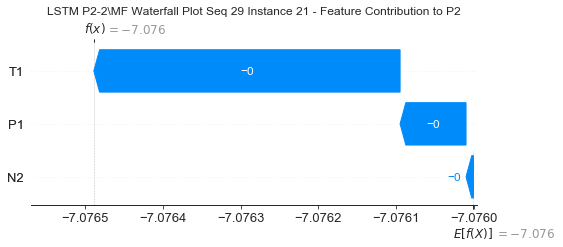

None

Contribution: [-1.10476393e-04 -1.29713277e-03 -7.69633562e-05]


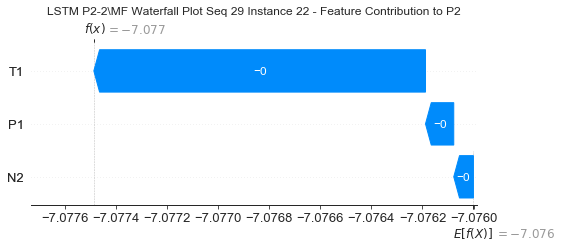

None

Contribution: [ 0.00015032  0.00294783 -0.00227718]


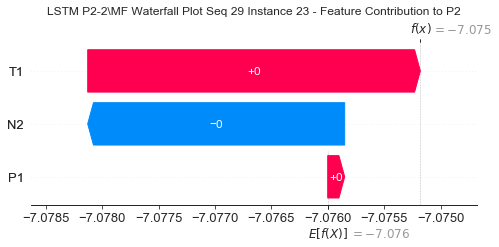

None

Contribution: [-0.00135735  0.03822028 -0.01567276]


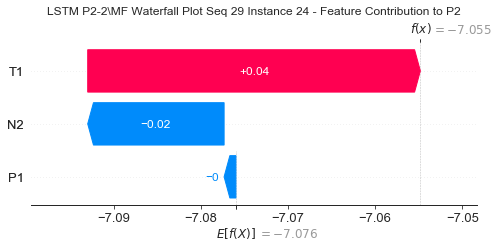

None

Contribution: [-0.02373032 -0.0133642  -0.08573978]


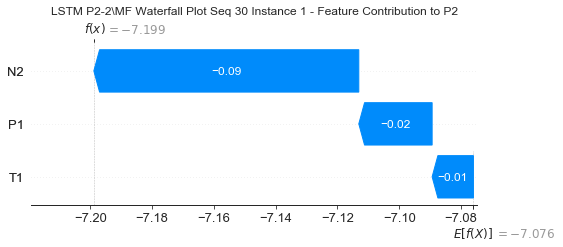

None

Contribution: [ 0.00034225 -0.00061614  0.00066948]


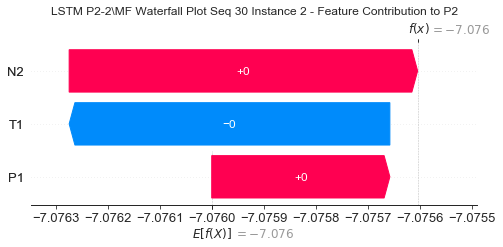

None

Contribution: [-0.00022533  0.00024281 -0.00038485]


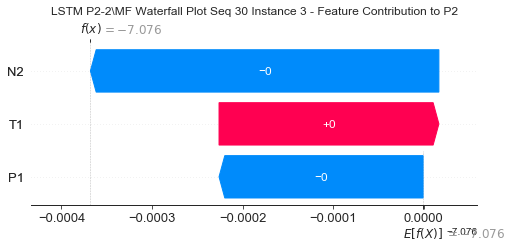

None

Contribution: [-1.06231300e-04  7.87682557e-05 -2.40210730e-04]


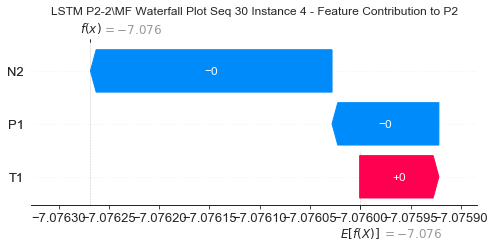

None

Contribution: [-9.17948314e-06 -3.86924656e-06 -4.61078162e-05]


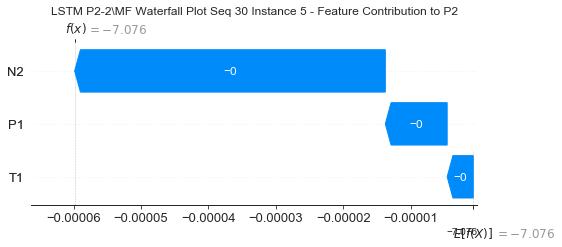

None

Contribution: [-1.05361811e-05  6.53585299e-06 -3.08160818e-05]


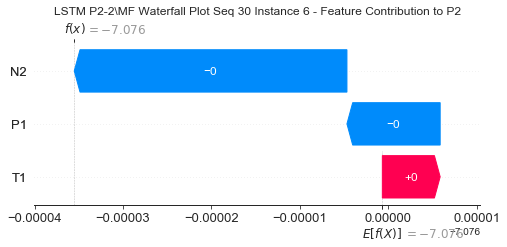

None

Contribution: [-1.36719502e-05  7.07592250e-06 -3.73897437e-05]


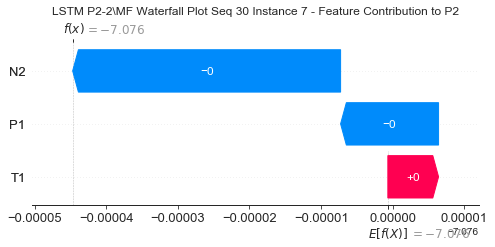

None

Contribution: [-1.97981197e-05  1.40065445e-05 -3.94320013e-05]


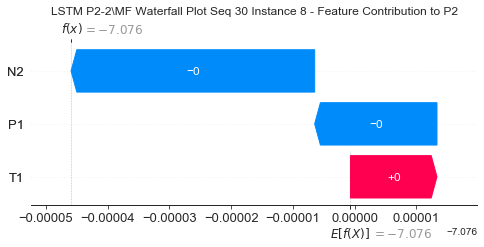

None

Contribution: [-3.09942303e-05  2.85894184e-06 -1.61336524e-05]


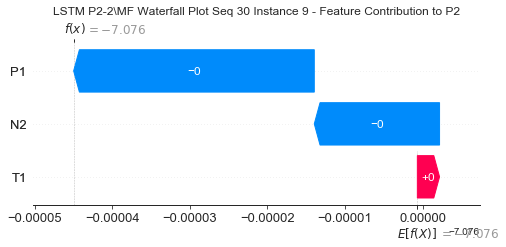

None

Contribution: [-4.93595037e-05 -3.66376623e-05 -2.82793134e-06]


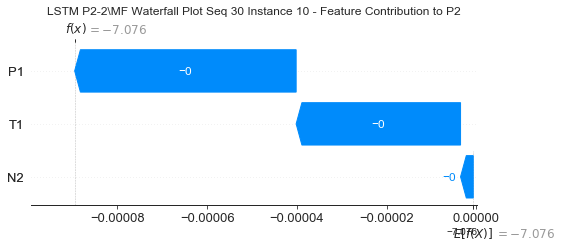

None

Contribution: [-6.74822412e-05 -6.74584094e-05 -1.37441626e-05]


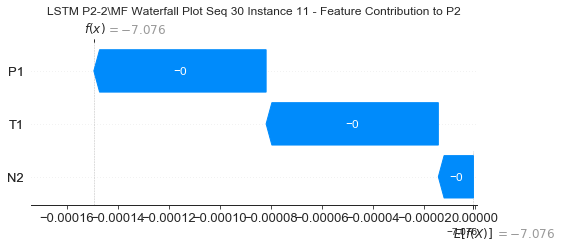

None

Contribution: [-7.42280249e-05 -7.62903592e-05 -1.99127948e-05]


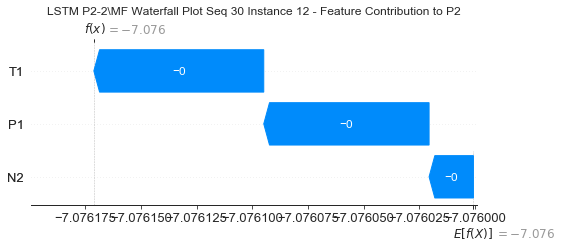

None

Contribution: [-7.42726765e-05 -8.47836926e-05 -1.81856685e-05]


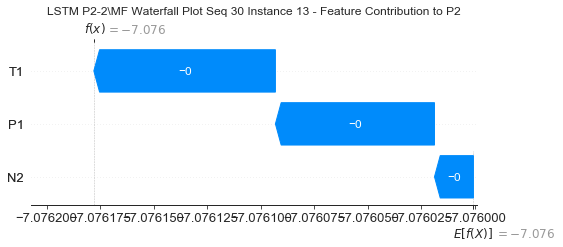

None

Contribution: [-6.79771749e-05 -9.83683655e-05 -1.63012200e-05]


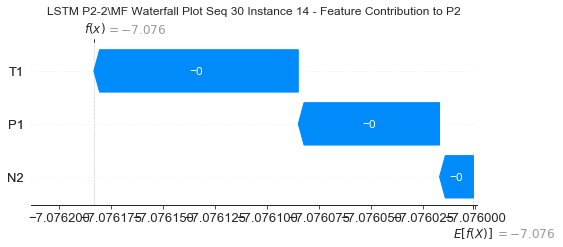

None

Contribution: [-8.55607644e-05 -1.19614726e-04 -2.00736842e-05]


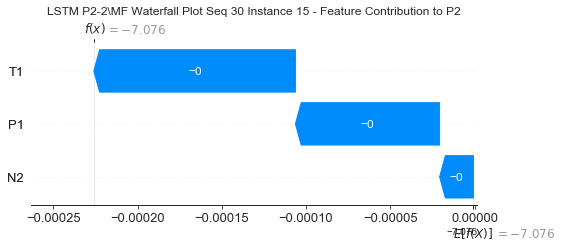

None

Contribution: [-8.07822761e-05 -1.36759210e-04 -1.96776444e-05]


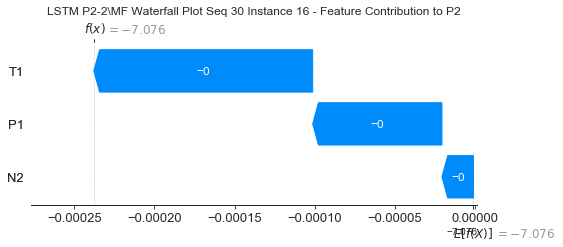

None

Contribution: [-7.61961321e-05 -1.57244075e-04 -2.16031088e-05]


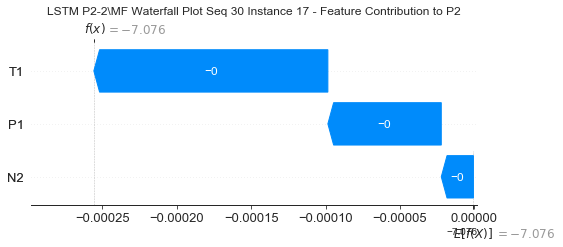

None

Contribution: [-8.99140441e-05 -1.78752969e-04 -2.22262568e-05]


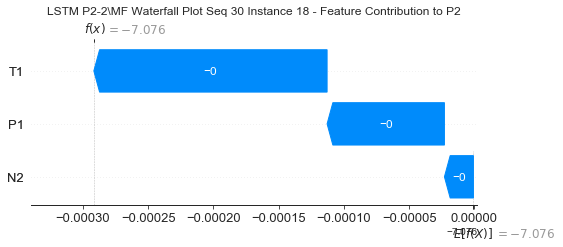

None

Contribution: [-9.06123816e-05 -1.85234331e-04 -1.99963175e-05]


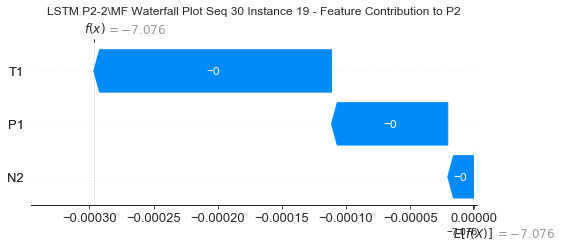

None

Contribution: [-9.31874198e-05 -1.91289312e-04 -1.70519005e-05]


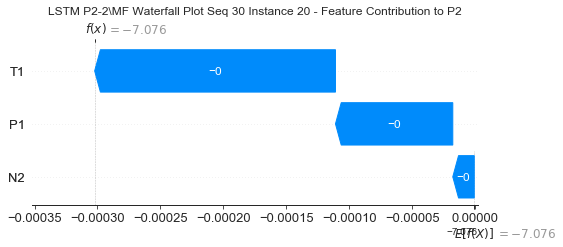

None

Contribution: [-8.76708755e-05 -2.42201865e-04 -1.33604347e-05]


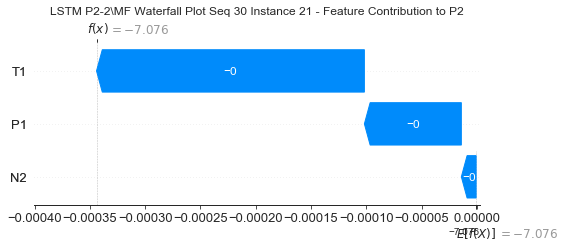

None

Contribution: [-1.01821698e-04 -1.01068230e-03 -8.48759375e-05]


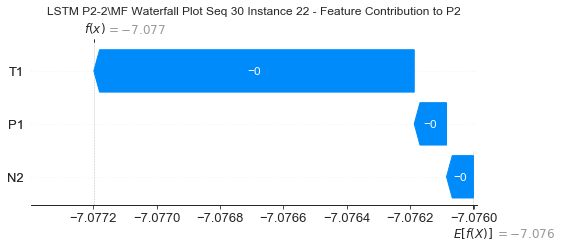

None

Contribution: [ 0.00028945  0.00177372 -0.00226528]


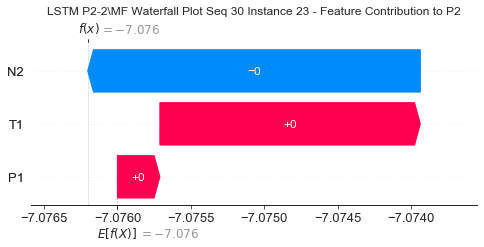

None

Contribution: [ 0.00094032  0.01760746 -0.01719172]


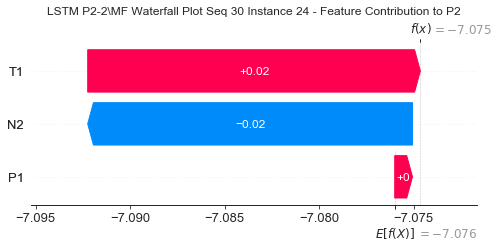

None

Contribution: [-0.02856071 -0.01388353 -0.09365382]


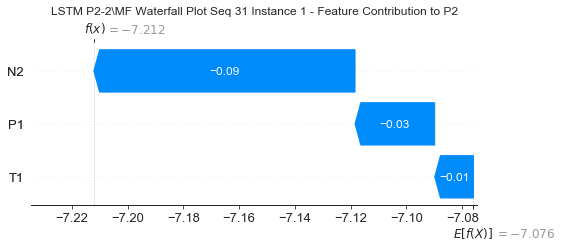

None

Contribution: [ 0.00013348 -0.00064336  0.00076434]


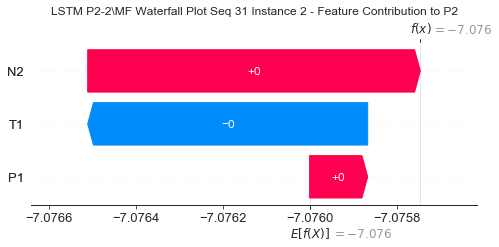

None

Contribution: [-5.20814347e-05  2.87753727e-04 -3.46668773e-04]


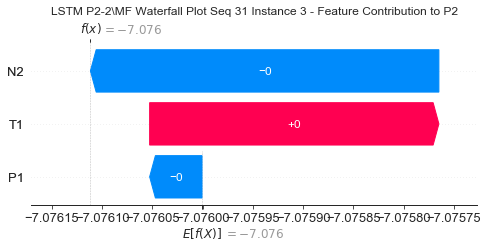

None

Contribution: [-1.68144301e-04  2.06869487e-05 -2.87453976e-04]


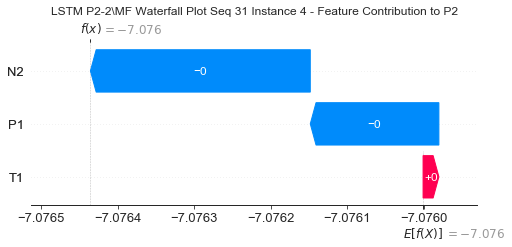

None

Contribution: [-1.10814269e-05 -2.34369895e-05 -4.81398498e-05]


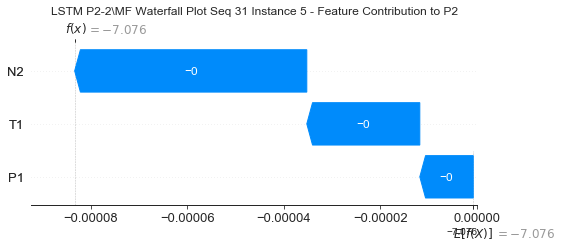

None

Contribution: [-1.04375866e-05 -3.18748489e-06 -3.09076386e-05]


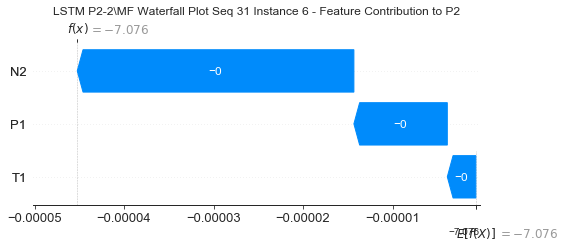

None

Contribution: [-1.45873984e-05  5.54967078e-07 -3.87836688e-05]


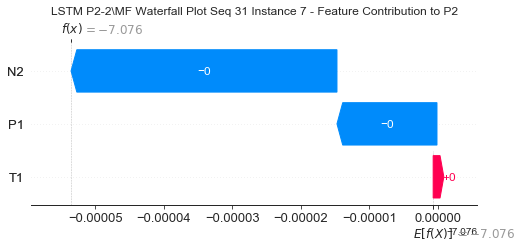

None

Contribution: [-1.95212576e-05  6.21469340e-06 -4.00359409e-05]


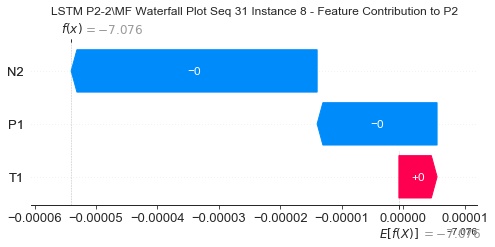

None

Contribution: [-3.00867042e-05 -7.56413518e-06 -1.65488891e-05]


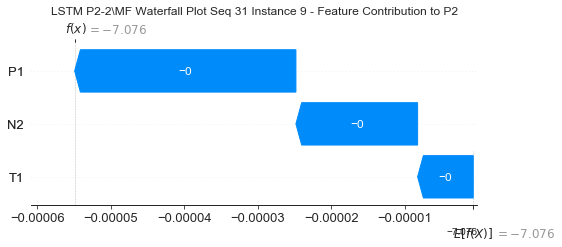

None

Contribution: [-4.75631374e-05 -4.73312159e-05 -1.44520752e-06]


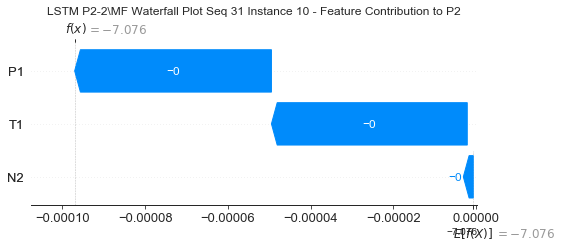

None

Contribution: [-7.40642493e-05 -7.85678586e-05 -1.12972439e-05]


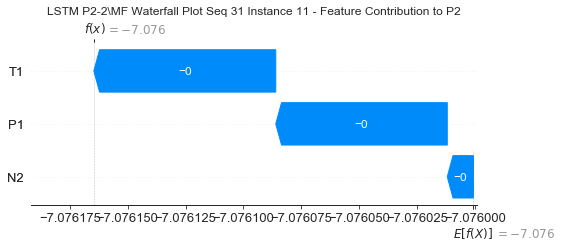

None

Contribution: [-8.13288167e-05 -9.65308585e-05 -1.81495907e-05]


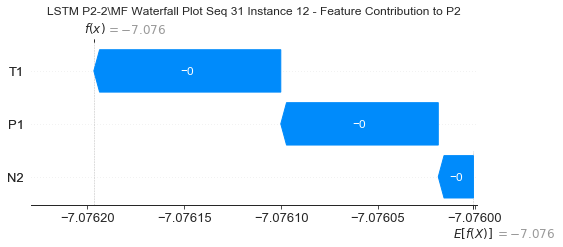

None

Contribution: [-8.42214031e-05 -1.08908104e-04 -1.67916065e-05]


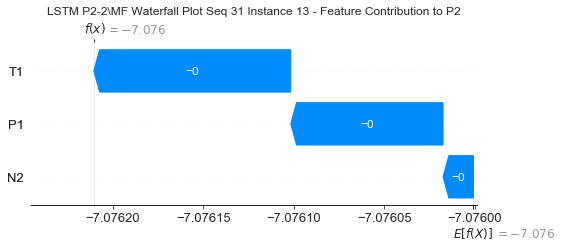

None

Contribution: [-7.61731508e-05 -1.28900339e-04 -1.45381097e-05]


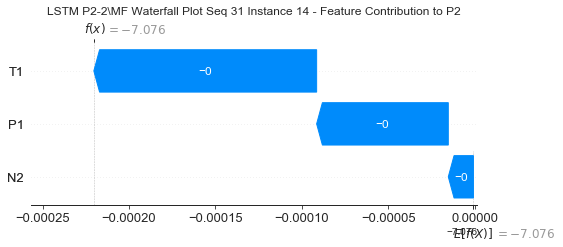

None

Contribution: [-7.84628682e-05 -1.60258298e-04 -1.63707626e-05]


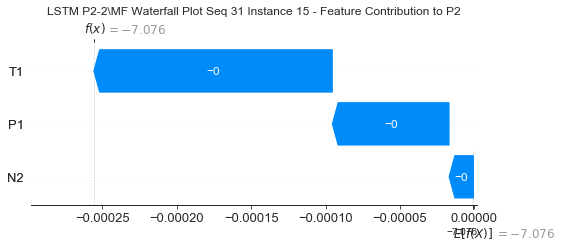

None

Contribution: [-8.66568916e-05 -1.75612278e-04 -1.85901111e-05]


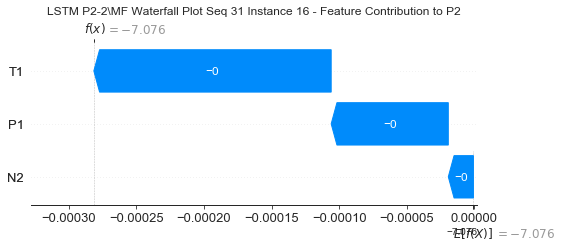

None

Contribution: [-7.94885470e-05 -2.00628680e-04 -2.02602028e-05]


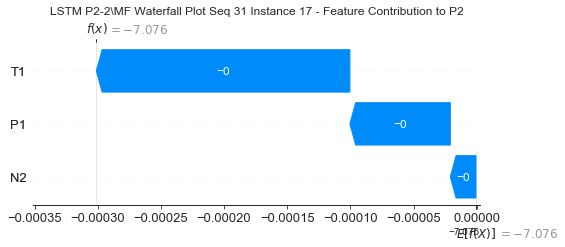

None

Contribution: [-1.01372721e-04 -2.06198400e-04 -1.86745026e-05]


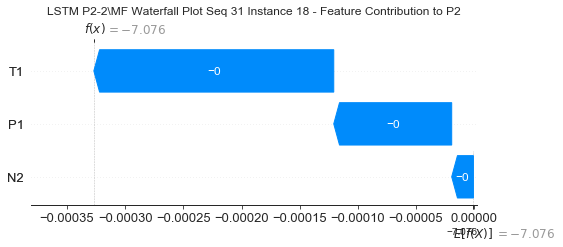

None

Contribution: [-8.84421662e-05 -2.39203611e-04 -1.85987869e-05]


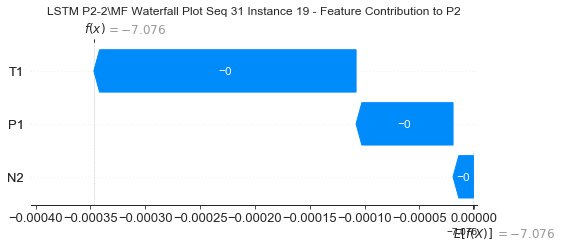

None

Contribution: [-8.93820446e-05 -2.43965162e-04 -1.76773656e-05]


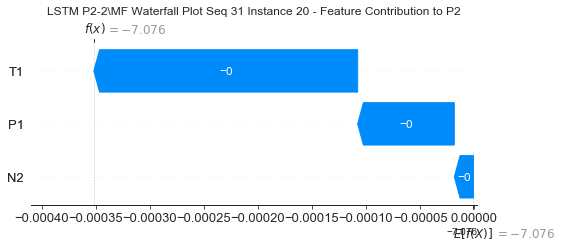

None

Contribution: [-8.43788668e-05 -3.04878754e-04 -1.42813515e-05]


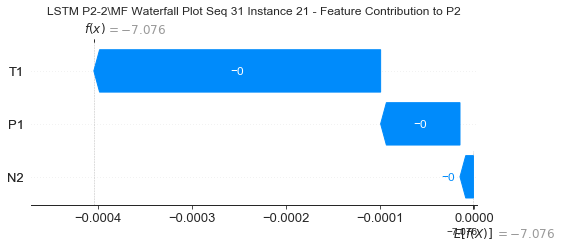

None

Contribution: [-8.57598983e-05 -1.12877071e-03 -1.00908649e-04]


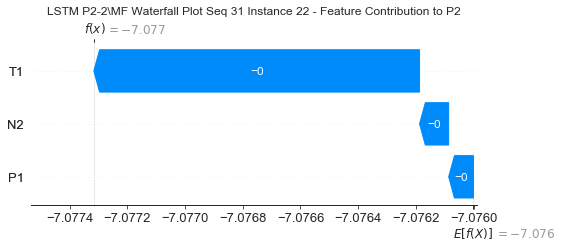

None

Contribution: [ 0.00022899  0.00243994 -0.00223899]


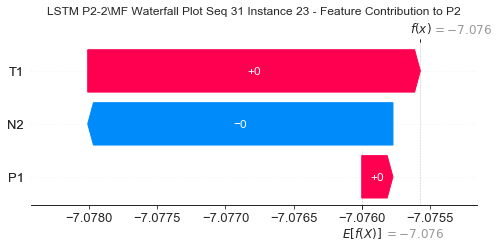

None

Contribution: [ 0.00226407  0.01954302 -0.02011291]


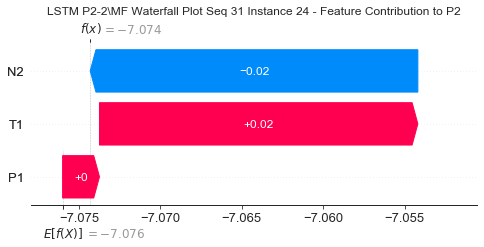

None

Contribution: [-0.03815652 -0.01386859 -0.10161357]


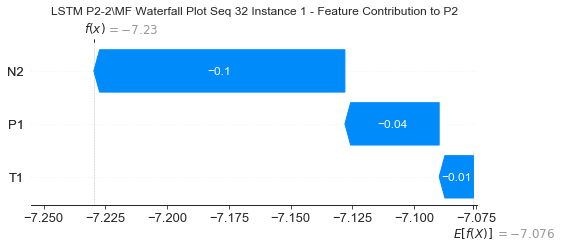

None

Contribution: [ 0.00061814 -0.00068712  0.00109862]


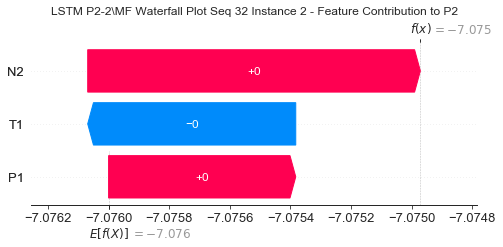

None

Contribution: [-0.00017372  0.00047563 -0.00050073]


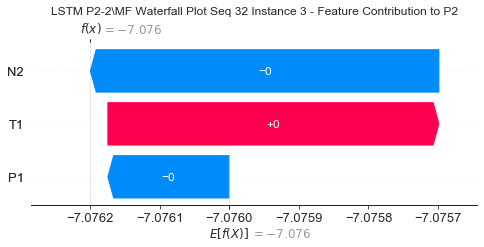

None

Contribution: [-1.04504293e-04  4.62684036e-07 -2.77614191e-04]


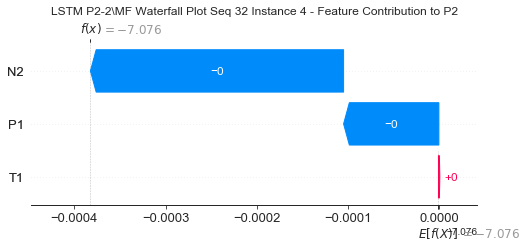

None

Contribution: [-8.78868788e-06 -3.70783889e-05 -4.74305707e-05]


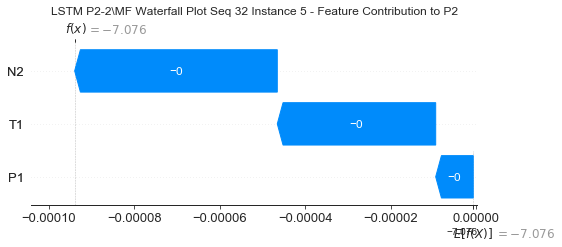

None

Contribution: [-7.21428075e-06 -6.02554700e-06 -2.93639416e-05]


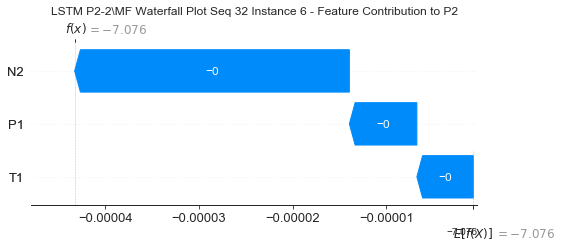

None

Contribution: [-1.41173959e-05 -2.61589750e-06 -3.93828382e-05]


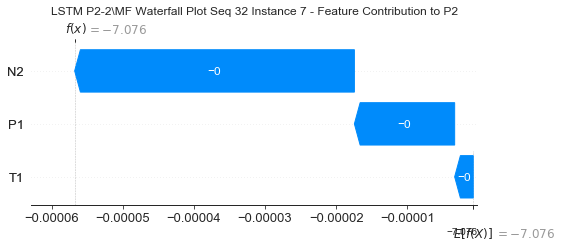

None

Contribution: [-2.05766690e-05 -1.67480672e-06 -4.29315921e-05]


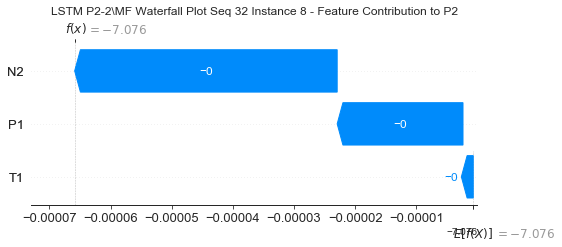

None

Contribution: [-3.50175343e-05 -1.38951023e-05 -1.85692963e-05]


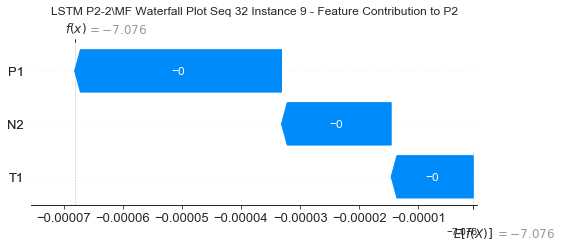

None

Contribution: [-5.08646546e-05 -4.60536697e-05  1.00162081e-06]


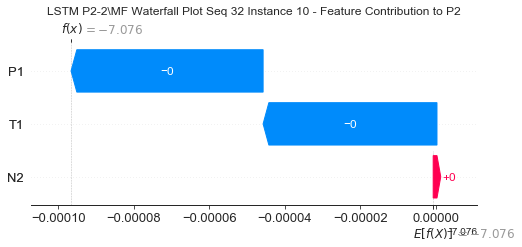

None

Contribution: [-6.84175181e-05 -9.65337876e-05 -6.20436075e-06]


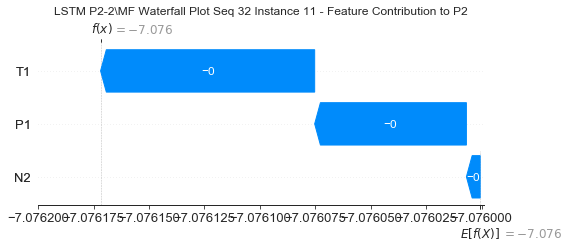

None

Contribution: [-7.68849656e-05 -1.23892709e-04 -1.40188417e-05]


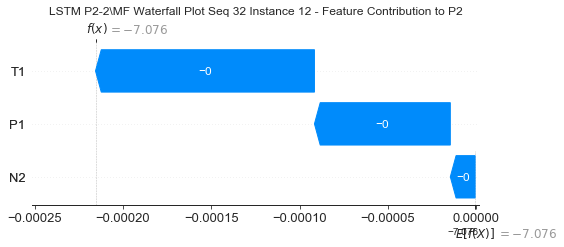

None

Contribution: [-7.46974088e-05 -1.42536203e-04 -1.41151948e-05]


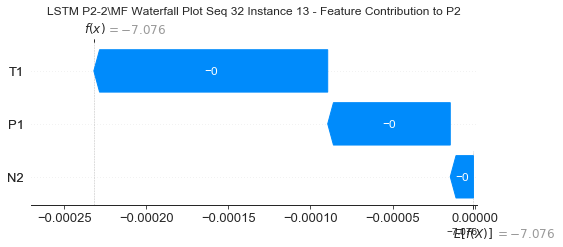

None

Contribution: [-7.25861923e-05 -1.65388828e-04 -9.55409500e-06]


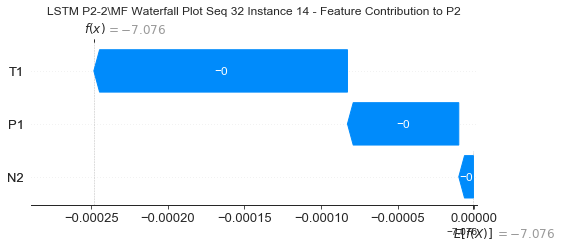

None

Contribution: [-6.12889228e-05 -2.25260864e-04 -1.52988926e-05]


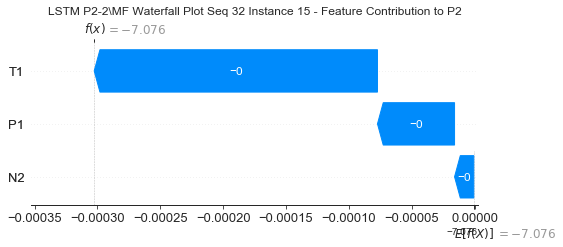

None

Contribution: [-8.39138188e-05 -2.24818043e-04 -1.05164833e-05]


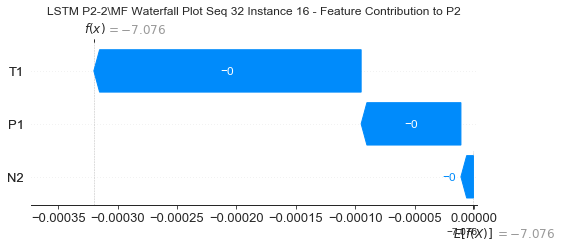

None

Contribution: [-7.79425819e-05 -2.56071222e-04 -9.24500714e-06]


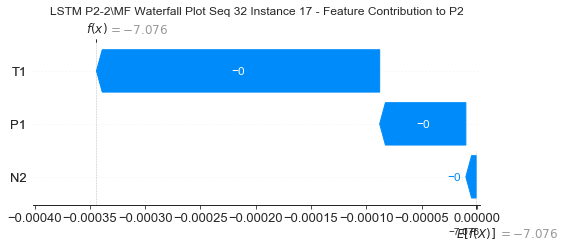

None

Contribution: [-8.64987899e-05 -2.85646932e-04 -3.15879109e-06]


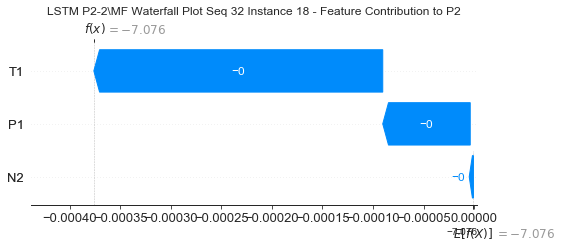

None

Contribution: [-8.93408906e-05 -3.05050197e-04 -3.19934318e-06]


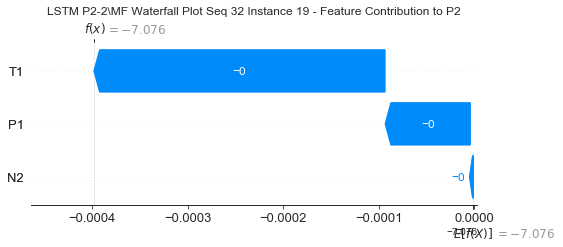

None

Contribution: [-9.05712790e-05 -3.11023988e-04 -8.89732702e-08]


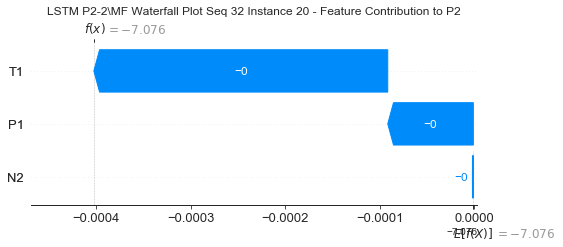

None

Contribution: [-8.75614720e-05 -3.78064969e-04  1.05838228e-05]


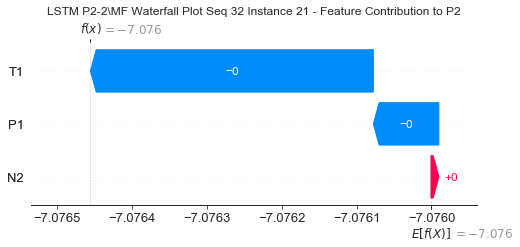

None

Contribution: [-9.32026935e-05 -1.29519579e-03 -1.11522605e-05]


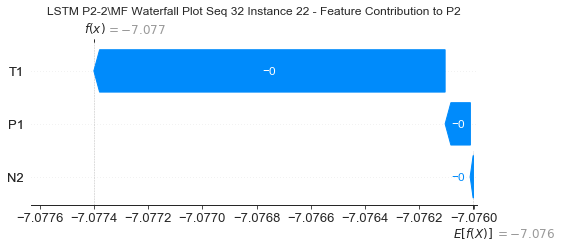

None

Contribution: [ 0.00033585  0.0028525  -0.00263595]


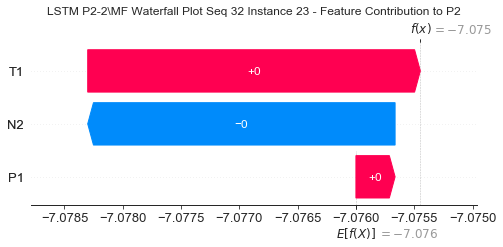

None

Contribution: [ 0.00220655  0.01826538 -0.02006712]


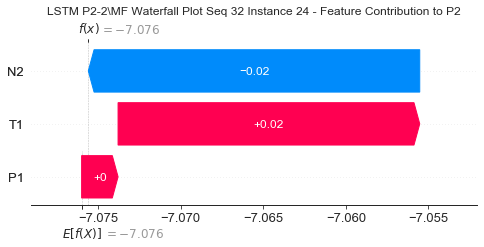

None

Contribution: [-0.02616758 -0.01459049 -0.09929743]


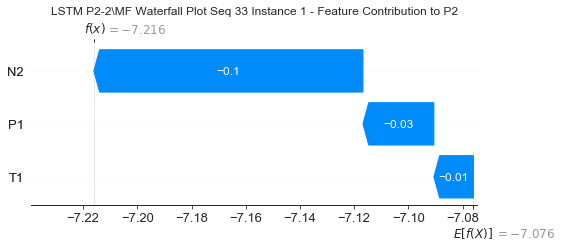

None

Contribution: [ 0.00029497 -0.00066357  0.00094573]


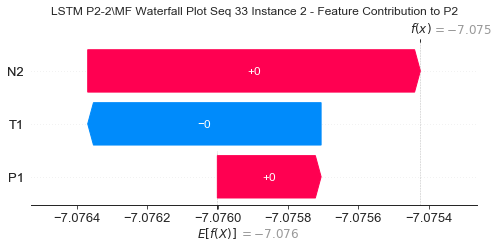

None

Contribution: [-0.00012747  0.00061382 -0.0004984 ]


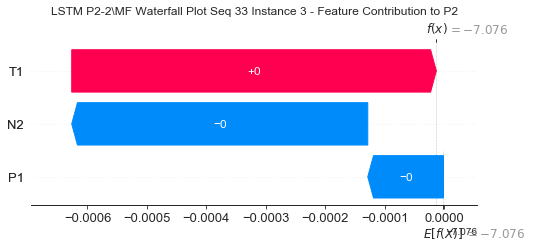

None

Contribution: [-3.02882110e-05  2.51879843e-04 -2.76016978e-04]


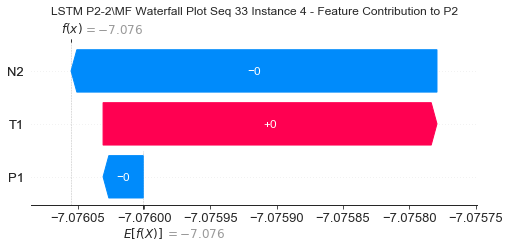

None

Contribution: [-6.14476145e-06 -2.14112653e-06 -4.76532428e-05]


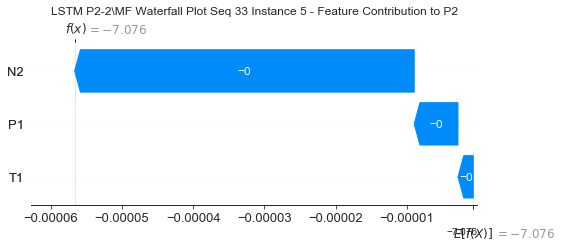

None

Contribution: [-7.24211005e-06  3.18985044e-06 -3.01827364e-05]


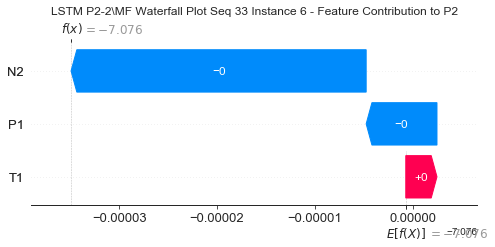

None

Contribution: [-1.24285101e-05  1.07357014e-05 -3.86459566e-05]


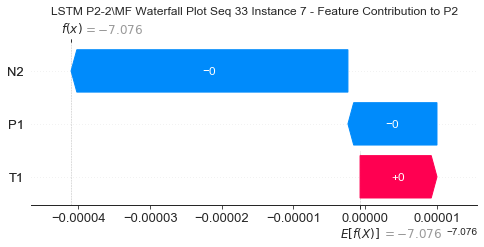

None

Contribution: [-1.99230298e-05  1.60866376e-05 -4.07182989e-05]


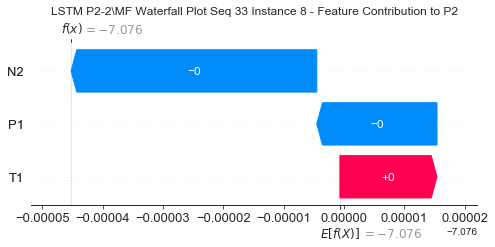

None

Contribution: [-3.31318060e-05 -5.22814416e-06 -1.82314500e-05]


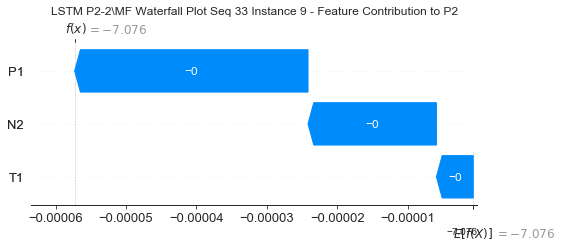

None

Contribution: [-4.79425134e-05 -5.61014764e-05 -2.38671943e-06]


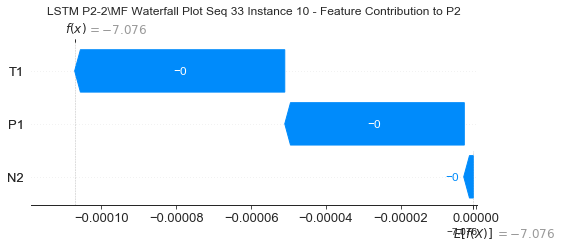

None

Contribution: [-6.11825737e-05 -9.63403774e-05 -1.32020937e-05]


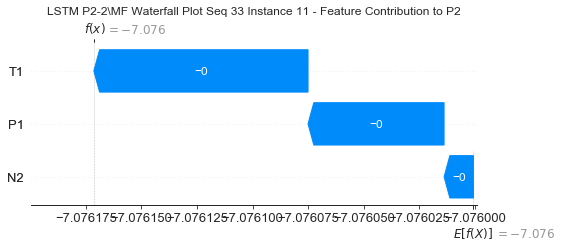

None

Contribution: [-6.78367159e-05 -1.10990187e-04 -1.97726041e-05]


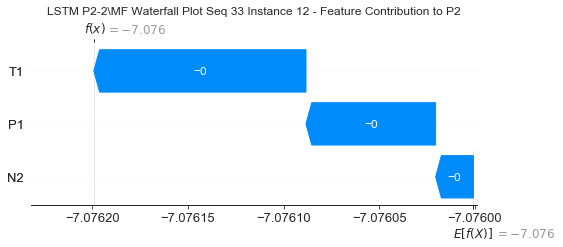

None

Contribution: [-8.21503014e-05 -1.18003990e-04 -1.97058065e-05]


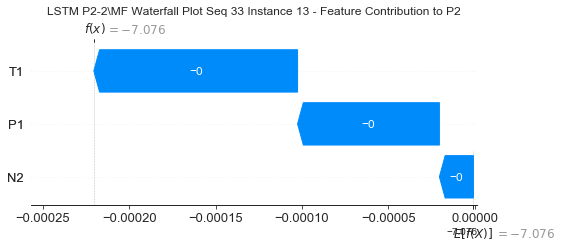

None

Contribution: [-6.34542261e-05 -1.40519657e-04 -1.71869686e-05]


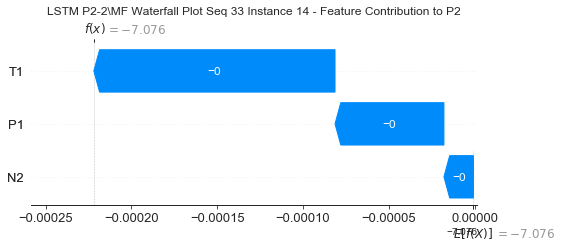

None

Contribution: [-6.52653144e-05 -1.73986349e-04 -2.24790591e-05]


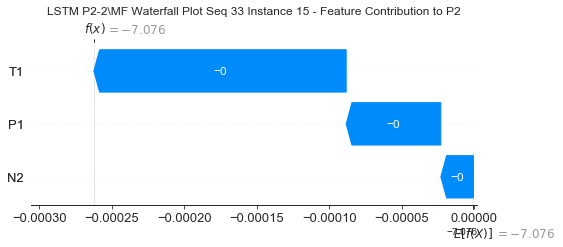

None

Contribution: [-7.31265705e-05 -1.91131657e-04 -2.25710552e-05]


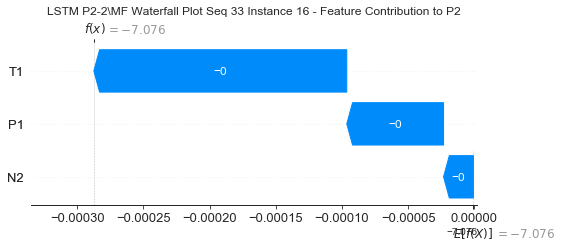

None

Contribution: [-6.30565883e-05 -2.19877213e-04 -2.42505655e-05]


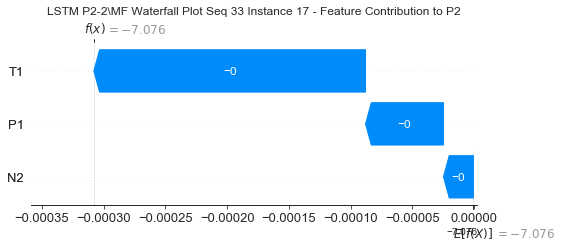

None

Contribution: [-8.97999325e-05 -2.44750332e-04 -2.15261749e-05]


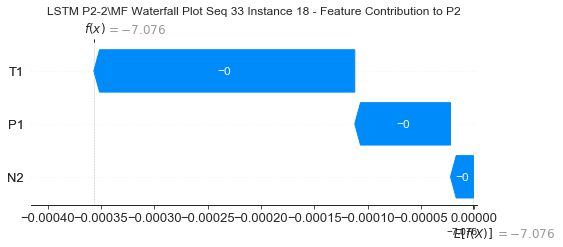

None

Contribution: [-7.60286704e-05 -2.64120032e-04 -2.30795288e-05]


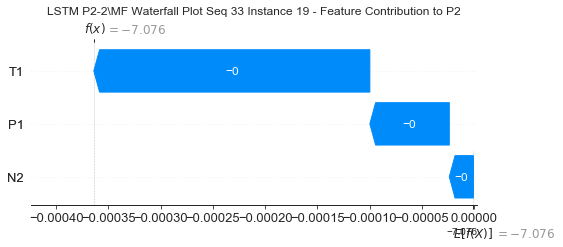

None

Contribution: [-7.58011219e-05 -2.73804650e-04 -2.17818137e-05]


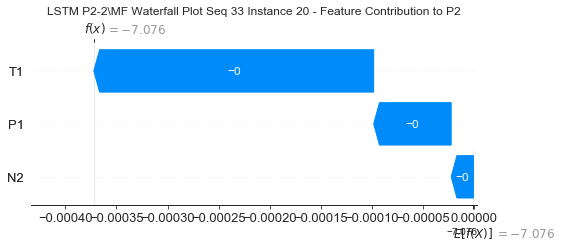

None

Contribution: [-7.19281649e-05 -3.59229975e-04 -2.05693082e-05]


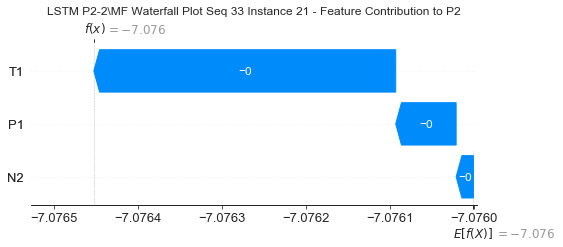

None

Contribution: [-3.88974714e-05 -1.45211087e-03 -1.30140294e-04]


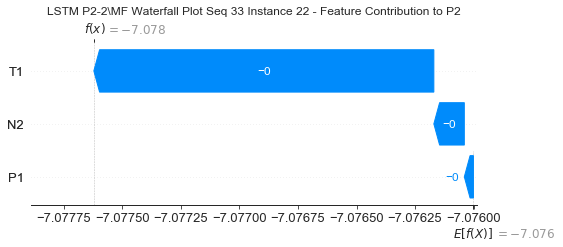

None

Contribution: [ 0.00016954  0.00373869 -0.00219501]


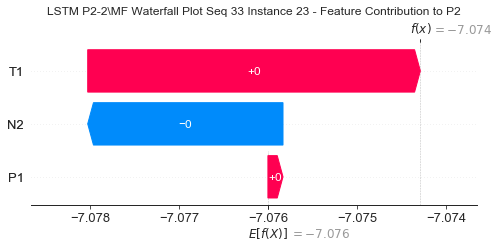

None

Contribution: [ 0.0005384   0.03538355 -0.01600746]


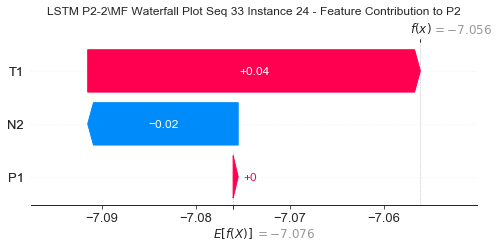

None

Contribution: [ 0.00121866 -0.00863092 -0.0756304 ]


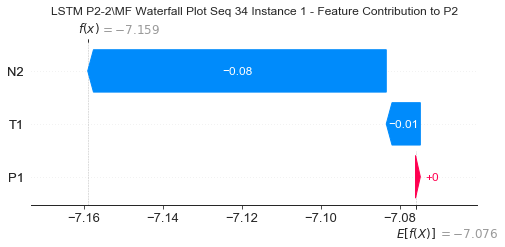

None

Contribution: [3.21560762e-05 1.26034926e-04 5.08219908e-04]


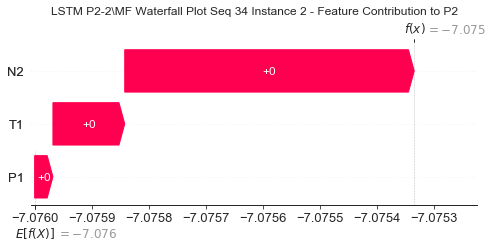

None

Contribution: [ 3.97326136e-05  3.42525043e-03 -1.86440712e-04]


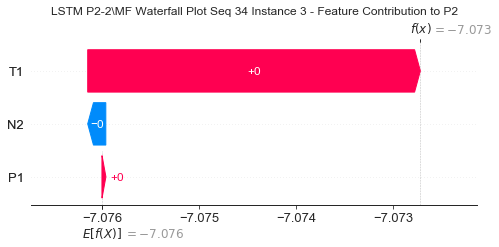

None

Contribution: [ 7.72674669e-05  1.59135337e-03 -2.39159364e-04]


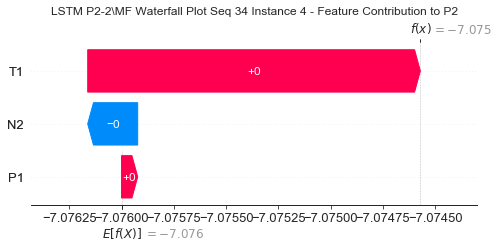

None

Contribution: [ 7.03836927e-06  1.84558998e-04 -4.56939890e-05]


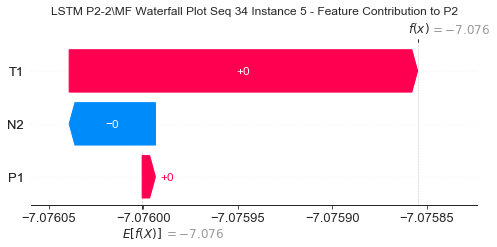

None

Contribution: [ 2.60364273e-06  7.31861462e-05 -3.04661440e-05]


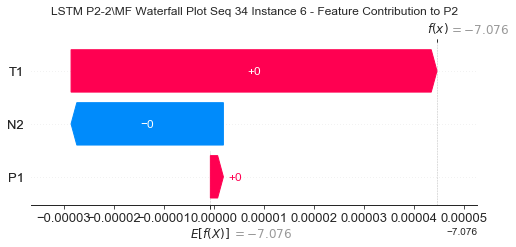

None

Contribution: [-5.01965632e-06  7.64137317e-05 -3.70075394e-05]


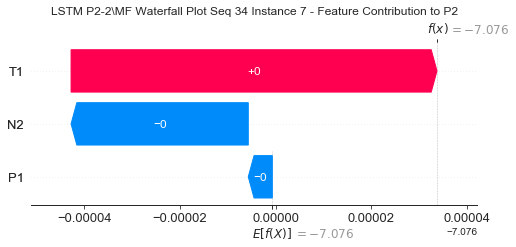

None

Contribution: [-8.90530045e-06  8.02158693e-05 -3.94749629e-05]


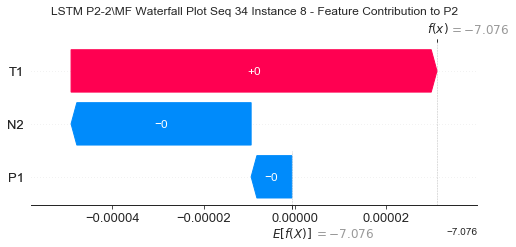

None

Contribution: [-3.40586460e-06  7.86725259e-05 -1.48633647e-05]


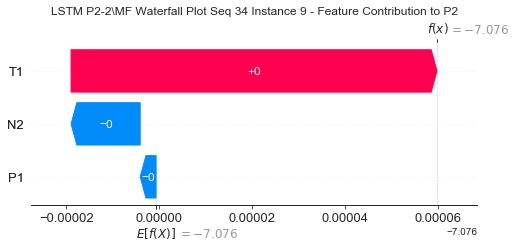

None

Contribution: [-7.63987737e-06  4.30561320e-05 -3.11894304e-06]


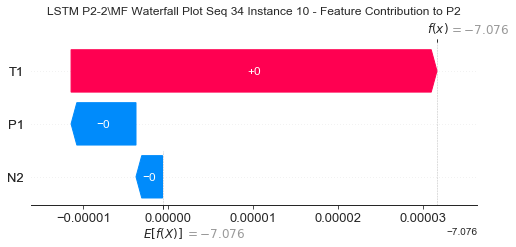

None

Contribution: [-4.29767695e-05  3.38158285e-05 -1.40083747e-05]


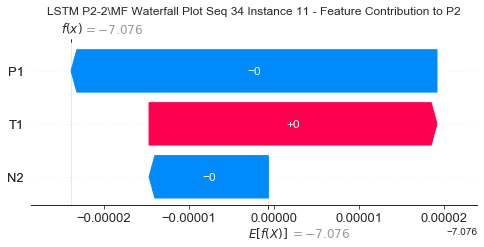

None

Contribution: [-5.10455196e-05  6.49158812e-05 -1.97464732e-05]


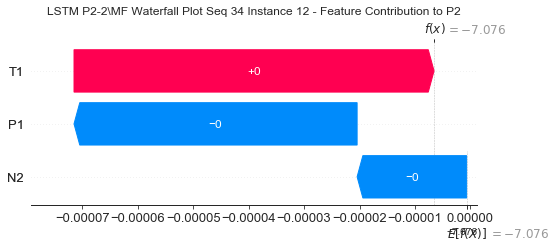

None

Contribution: [-4.69773908e-05  7.62006509e-05 -1.83708810e-05]


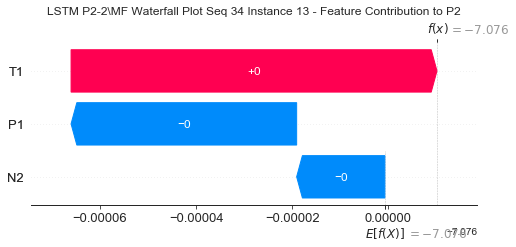

None

Contribution: [-4.27452709e-05  8.85408462e-05 -1.64076972e-05]


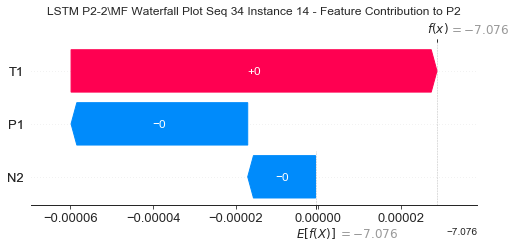

None

Contribution: [-4.01005895e-05  8.86290565e-05 -1.56114070e-05]


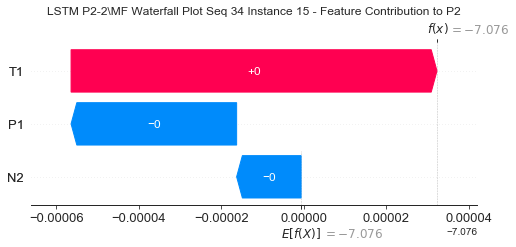

None

Contribution: [-5.89953787e-05  7.62774007e-05 -1.93931117e-05]


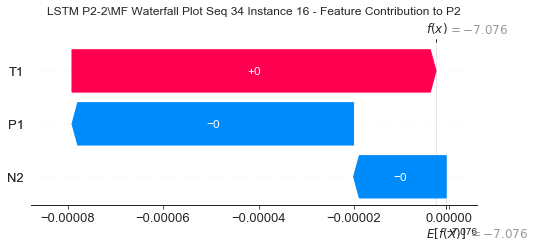

None

Contribution: [-4.73766589e-05  6.31314021e-05 -1.99589926e-05]


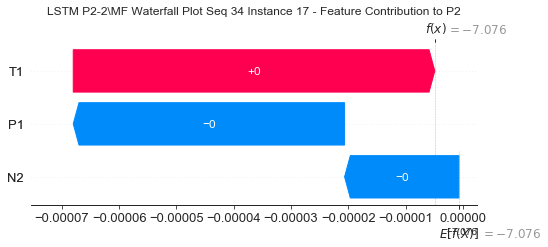

None

Contribution: [-7.12538311e-05  4.08901835e-05 -2.15703316e-05]


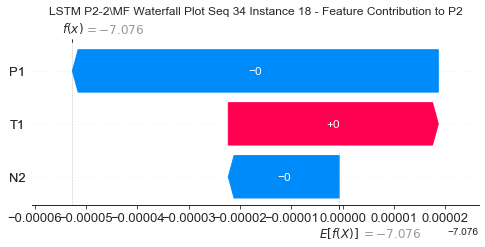

None

Contribution: [-7.05827508e-05  3.31867146e-05 -1.92259242e-05]


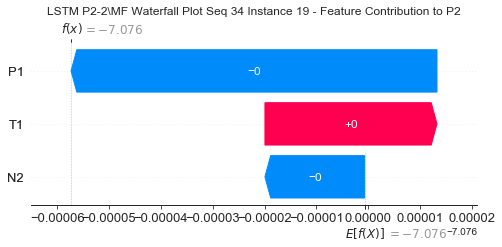

None

Contribution: [-7.02203894e-05  2.20813678e-05 -1.92782742e-05]


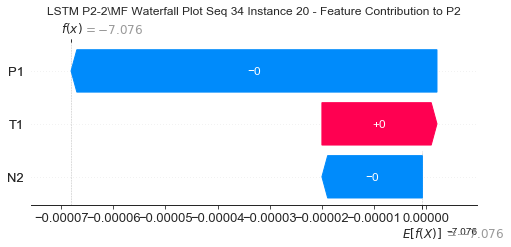

None

Contribution: [-6.09530990e-05 -7.20561471e-05 -2.14272994e-05]


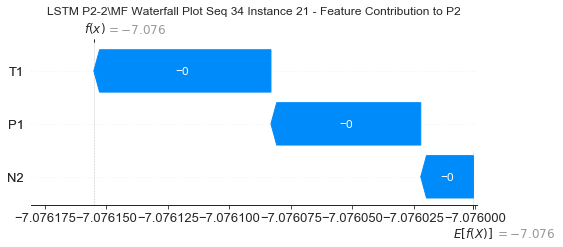

None

Contribution: [-1.17537443e-05 -1.08267511e-03 -1.24862212e-04]


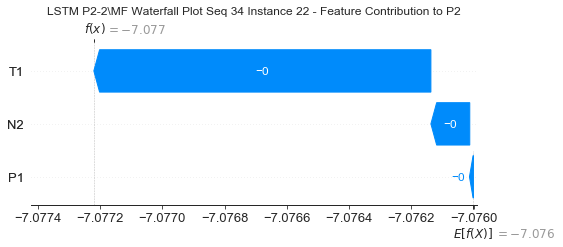

None

Contribution: [ 7.94594805e-05  3.42494818e-03 -2.07852319e-03]


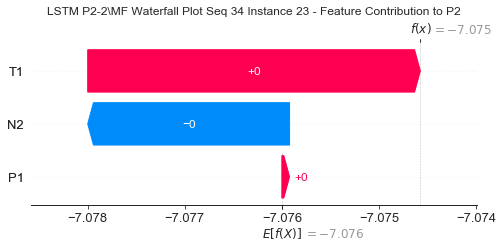

None

Contribution: [ 0.00032823  0.03679164 -0.01610229]


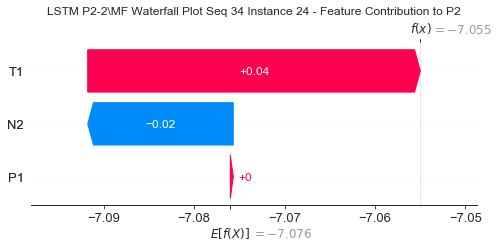

None

In [47]:
#Waterfall Plot for Consistency metric

instance = xtrain
instance2 = xtest
explainer = shap.DeepExplainer(model3,instance)
    
for s in range(0,34):
    instance=xtest[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(24):
        print("Contribution:",shap_values[0][0][j])
        plt.title("LSTM P2-2\MF Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution to P2" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)

In [1]:
#Consistency

P2_tot1' = -10.405+7.132
P2_tot1'

-3.2729999999999997

In [ ]:
#MF contribution instance 1

MF_P2_1' = -0.04628381